In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Penetración-poblacion.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre        Provincia  Accesos por cada 100 hab
0  2024          2     Buenos Aires                     27.43
1  2024          2  Capital Federal                     47.44
2  2024          2        Catamarca                     17.50
3  2024          2            Chaco                     11.78
4  2024          2           Chubut                     26.46


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Año                       1000 non-null   int64  
 1   Trimestre                 1000 non-null   int64  
 2   Provincia                 1000 non-null   object 
 3   Accesos por cada 100 hab  1000 non-null   float64
dtypes: float64(1), int64(2), object(1)
memory usage: 31.4+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

      Año  Trimestre Año_Trimestre meses_periodo
0    2024          2       Q2-2024     abr - jun
1    2024          2       Q2-2024     abr - jun
2    2024          2       Q2-2024     abr - jun
3    2024          2       Q2-2024     abr - jun
4    2024          2       Q2-2024     abr - jun
..    ...        ...           ...           ...
995  2014          1       Q1-2014     ene - mar
996  2014          1       Q1-2014     ene - mar
997  2014          1       Q1-2014     ene - mar
998  2014          1       Q1-2014     ene - mar
999  2014          1       Q1-2014     ene - mar

[1000 rows x 4 columns]


In [5]:
print(df.head())

    Año  Trimestre        Provincia  Accesos por cada 100 hab Año_Trimestre  \
0  2024          2     Buenos Aires                     27.43       Q2-2024   
1  2024          2  Capital Federal                     47.44       Q2-2024   
2  2024          2        Catamarca                     17.50       Q2-2024   
3  2024          2            Chaco                     11.78       Q2-2024   
4  2024          2           Chubut                     26.46       Q2-2024   

      Periodo meses_periodo  
0  01-03-2024     abr - jun  
1  01-03-2024     abr - jun  
2  01-03-2024     abr - jun  
3  01-03-2024     abr - jun  
4  01-03-2024     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                           int64
Trimestre                     int64
Provincia                    object
Accesos por cada 100 hab    float64
Año_Trimestre                object
Periodo                      object
meses_periodo                object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Año                       1000 non-null   int64  
 1   Trimestre                 1000 non-null   int64  
 2   Provincia                 1000 non-null   object 
 3   Accesos por cada 100 hab  1000 non-null   float64
 4   Año_Trimestre             1000 non-null   object 
 5   Periodo                   1000 non-null   object 
 6   meses_periodo             1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Año                       1000 non-null   int64  
 1   Trimestre                 1000 non-null   int64  
 2   Provincia                 1000 non-null   object 
 3   Accesos por cada 100 hab  1000 non-null   float64
 4   Año_Trimestre             1000 non-null   object 
 5   Periodo                   1000 non-null   object 
 6   meses_periodo             1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Año                       1000 non-null   int64  
 1   Trimestre                 1000 non-null   int64  
 2   Provincia                 1000 non-null   object 
 3   Accesos por cada 100 hab  1000 non-null   float64
 4   Año_Trimestre             1000 non-null   object 
 5   Periodo                   1000 non-null   object 
 6   meses_periodo             1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                         0
Trimestre                   0
Provincia                   0
Accesos por cada 100 hab    0
Año_Trimestre               0
Periodo                     0
meses_periodo               0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                         0
Trimestre                   0
Provincia                   0
Accesos por cada 100 hab    0
Año_Trimestre               0
Periodo                     0
meses_periodo               0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                         0
Trimestre                   0
Provincia                   0
Accesos por cada 100 hab    0
Año_Trimestre               0
Periodo                     0
meses_periodo               0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Año                       1000 non-null   int64  
 1   Trimestre                 1000 non-null   int64  
 2   Provincia                 1000 non-null   object 
 3   Accesos por cada 100 hab  1000 non-null   float64
 4   Año_Trimestre             1000 non-null   object 
 5   Periodo                   1000 non-null   object 
 6   meses_periodo             1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia  Accesos por cada 100 hab  \
count   1000.000000  1000.000000          1000               1000.000000   
unique          NaN          NaN            23                       NaN   
top             NaN          NaN  BUENOS AIRES                       NaN   
freq            NaN          NaN            84                       NaN   
mean    2018.800000     2.464000           NaN                 15.727248   
std        3.021445     1.114426           NaN                  9.240063   
min     2014.000000     1.000000           NaN                  2.723000   
25%     2016.000000     1.000000           NaN                  9.018188   
50%     2019.000000     2.000000           NaN                 13.674812   
75%     2021.000000     3.000000           NaN                 20.323973   
max     2024.000000     4.000000           NaN                 52.236739   

       Año_Tr

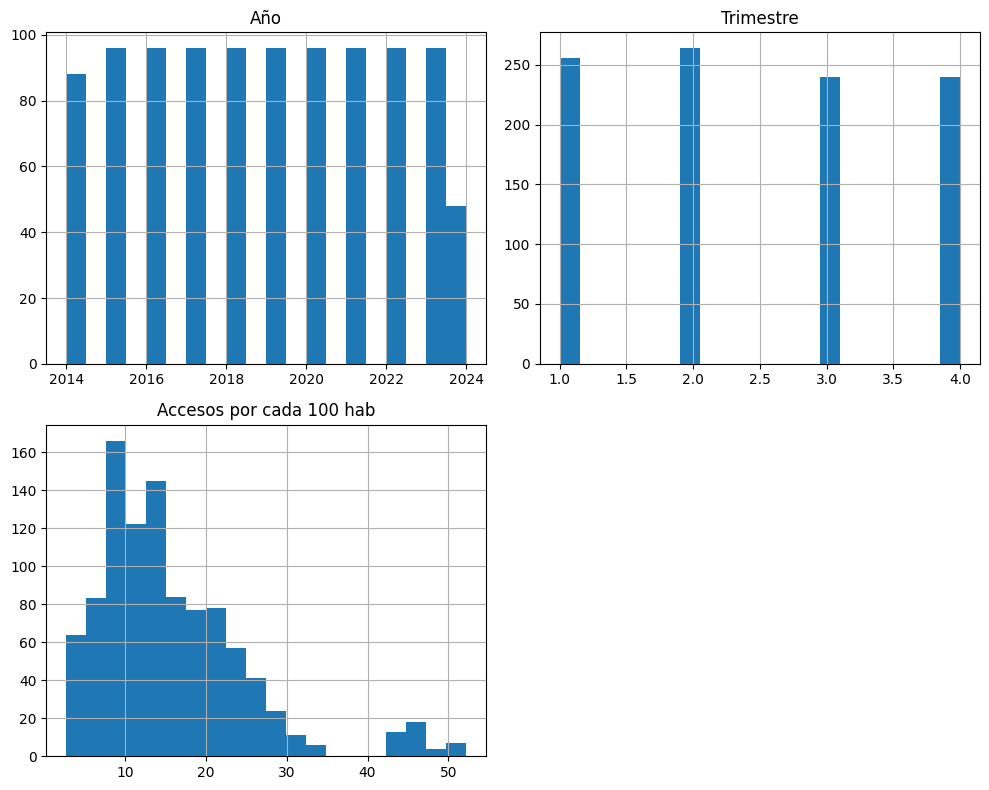

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                               Año  Trimestre  Accesos por cada 100 hab
Año                       1.000000  -0.091325                  0.370234
Trimestre                -0.091325   1.000000                  0.003637
Accesos por cada 100 hab  0.370234   0.003637                  1.000000

Correlaciones fuertes:
                          Año  Trimestre  Accesos por cada 100 hab
Año                       1.0        NaN                       NaN
Trimestre                 NaN        1.0                       NaN
Accesos por cada 100 hab  NaN        NaN                       1.0


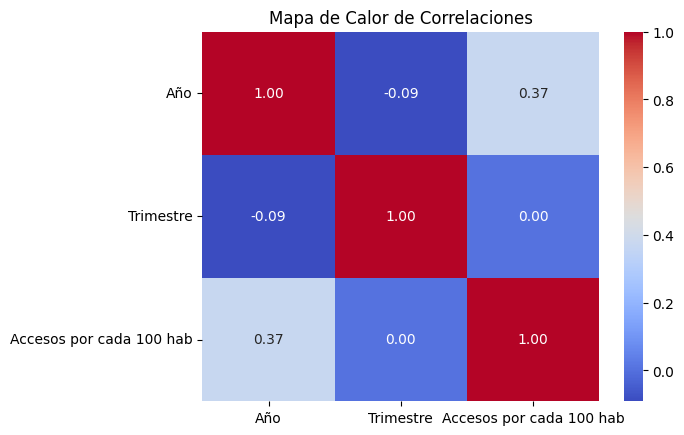

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               2        2        2        2        2        2   
CATAMARCA                  1        1        1        1        1        1   
CHACO                      1        1        1        1        1        1   
CHUBUT                     1        1        1        1        1        1   
CORRIENTES                 1        1        1        1        1        1   
CÓRDOBA                    1        1        1        1        1        1   
ENTRE RÍOS                 1        1        1        1        1        1   
FORMOSA                    1        1        1        1        1        1   
JUJUY                      1        1        1        1        1        1   
LA PAMPA                   1        1        1        1        1        1   
LA RIOJA            

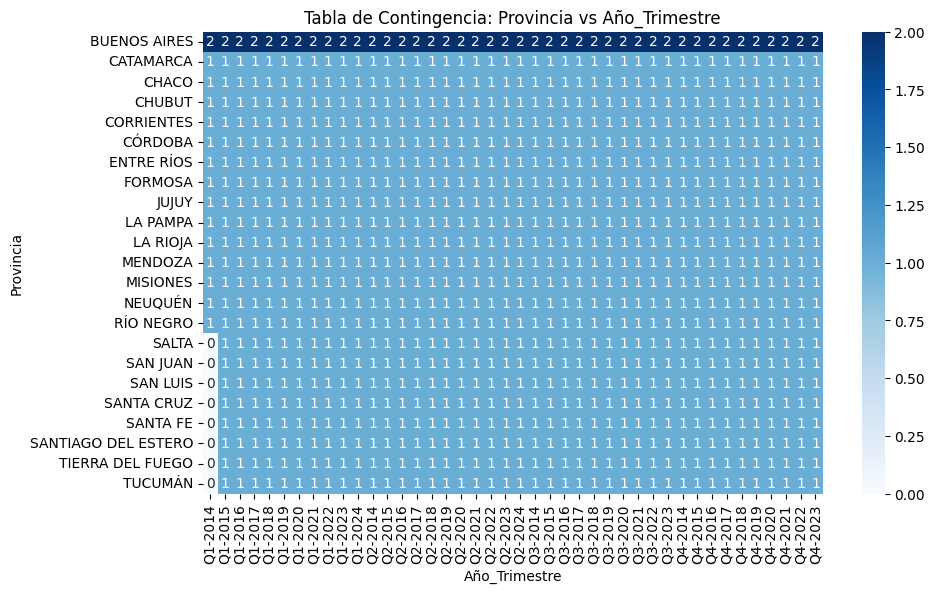


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                 84
CATAMARCA                    42
CHACO                        42
CHUBUT                       42
CORRIENTES                   42
CÓRDOBA                      42
ENTRE RÍOS                   42
FORMOSA                      42
JUJUY                        42
LA PAMPA                     42
LA RIOJA                     42
MENDOZA                      42
MISIONES                     42
NEUQUÉN                      42
RÍO NEGRO                    42
SALTA                        41
SAN JUAN                     41
SAN LUIS                     41
SANTA CRUZ                   41
SANTA FE                     41
SANTIAGO DEL ESTERO          41
TIERRA DEL FUEGO             41
TUCUMÁN                      41


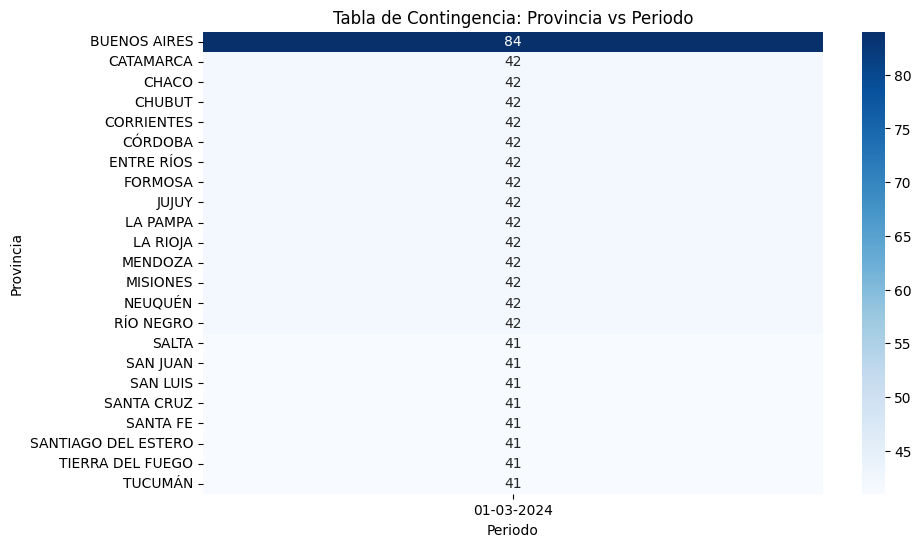


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                22         22         20         20
CATAMARCA                   11         11         10         10
CHACO                       11         11         10         10
CHUBUT                      11         11         10         10
CORRIENTES                  11         11         10         10
CÓRDOBA                     11         11         10         10
ENTRE RÍOS                  11         11         10         10
FORMOSA                     11         11         10         10
JUJUY                       11         11         10         10
LA PAMPA                    11         11         10         10
LA RIOJA                    11         11         10         10
MENDOZA                     11         11         10         10
MISIONES                    11         11       

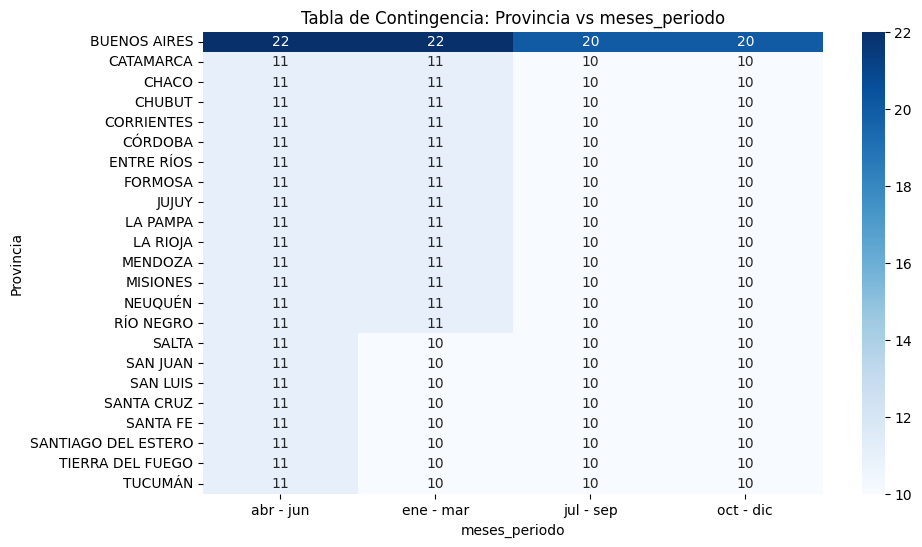


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                16
Q1-2015                24
Q1-2016                24
Q1-2017                24
Q1-2018                24
Q1-2019                24
Q1-2020                24
Q1-2021                24
Q1-2022                24
Q1-2023                24
Q1-2024                24
Q2-2014                24
Q2-2015                24
Q2-2016                24
Q2-2017                24
Q2-2018                24
Q2-2019                24
Q2-2020                24
Q2-2021                24
Q2-2022                24
Q2-2023                24
Q2-2024                24
Q3-2014                24
Q3-2015                24
Q3-2016                24
Q3-2017                24
Q3-2018                24
Q3-2019                24
Q3-2020                24
Q3-2021                24
Q3-2022                24
Q3-2023                24
Q4-2014                24
Q4-2015                24
Q4-2016   

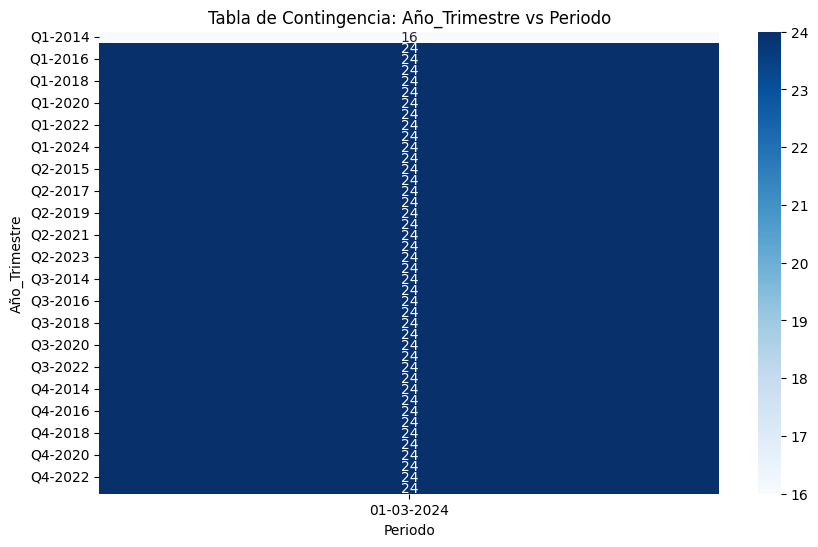


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         16          0          0
Q1-2015                0         24          0          0
Q1-2016                0         24          0          0
Q1-2017                0         24          0          0
Q1-2018                0         24          0          0
Q1-2019                0         24          0          0
Q1-2020                0         24          0          0
Q1-2021                0         24          0          0
Q1-2022                0         24          0          0
Q1-2023                0         24          0          0
Q1-2024                0         24          0          0
Q2-2014               24          0          0          0
Q2-2015               24          0          0          0
Q2-2016               24          0          0          0
Q2-2017     

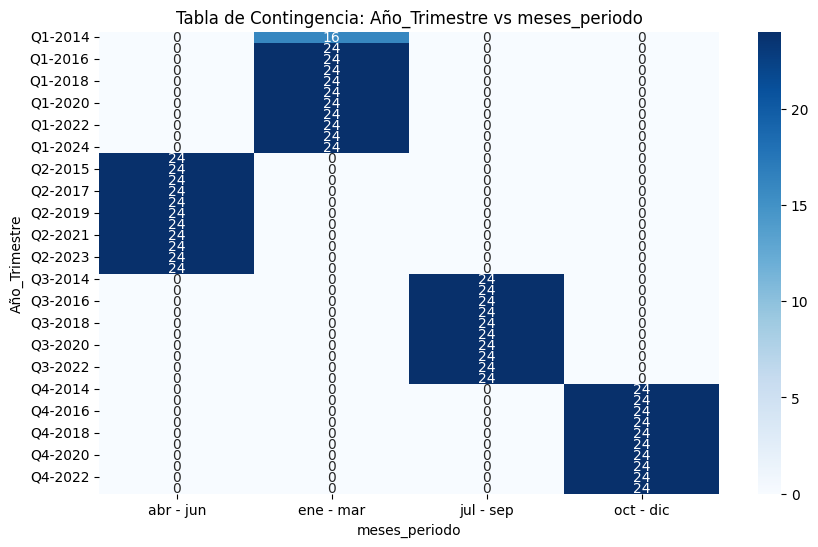


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           264        256        240        240


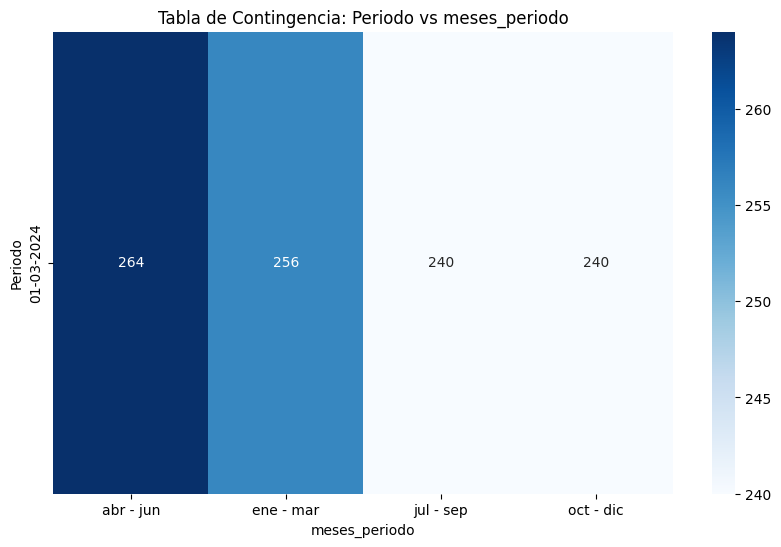

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES          84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA             42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA RIOJA     

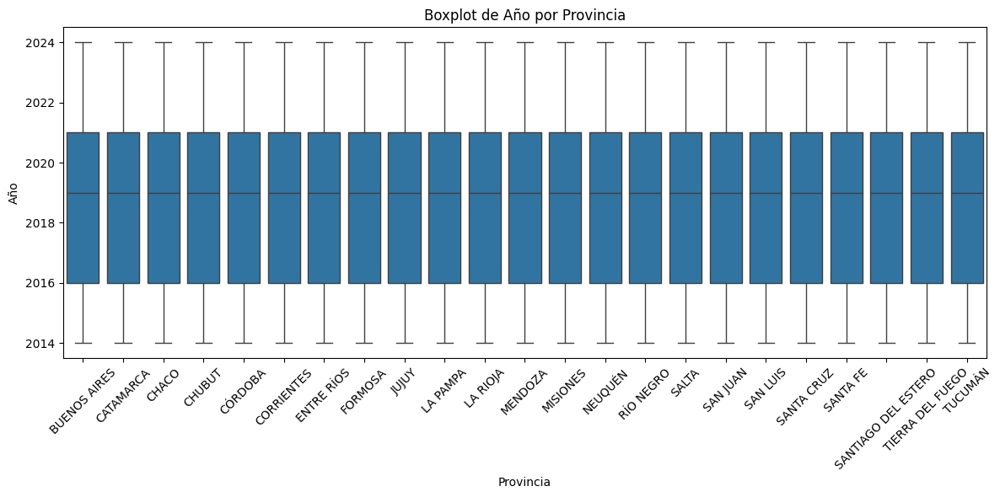


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min   25%  50%  75%  max
Provincia                                                               
BUENOS AIRES          84.0  2.452381  1.123728  1.0  1.00  2.0  3.0  4.0
CATAMARCA             42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHACO                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHUBUT                42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CORRIENTES            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CÓRDOBA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
ENTRE RÍOS            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
FORMOSA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
JUJUY                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA PAMPA              42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA RIOJA              42.0  2.452381  1.130560  1.0  1.

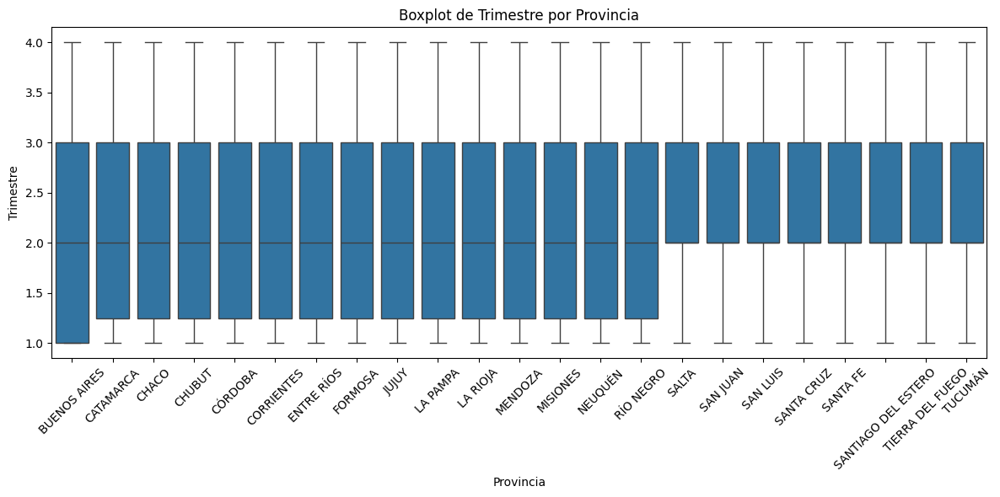


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'Provincia':
                     count       mean        std        min        25%  \
Provincia                                                                
BUENOS AIRES          84.0  33.885378  12.762946  16.692346  21.189833   
CATAMARCA             42.0  10.481248   4.193670   6.184615   6.635584   
CHACO                 42.0   9.345624   2.110977   5.553671   7.650979   
CHUBUT                42.0  17.661180   6.028180  10.897115  12.264725   
CORRIENTES            42.0   9.995111   2.450868   5.891708   8.126869   
CÓRDOBA               42.0  21.517570   4.103432  16.125183  17.628322   
ENTRE RÍOS            42.0  15.997565   3.122856  10.302247  13.433571   
FORMOSA               42.0   7.218121   2.162080   4.444468   4.955151   
JUJUY                 42.0   9.985461   4.285429   4.683394   5.736764   
LA PAMPA              42.0  24.794736   5.207377  15.994062  20.383384   
LA RIOJA              42.0  

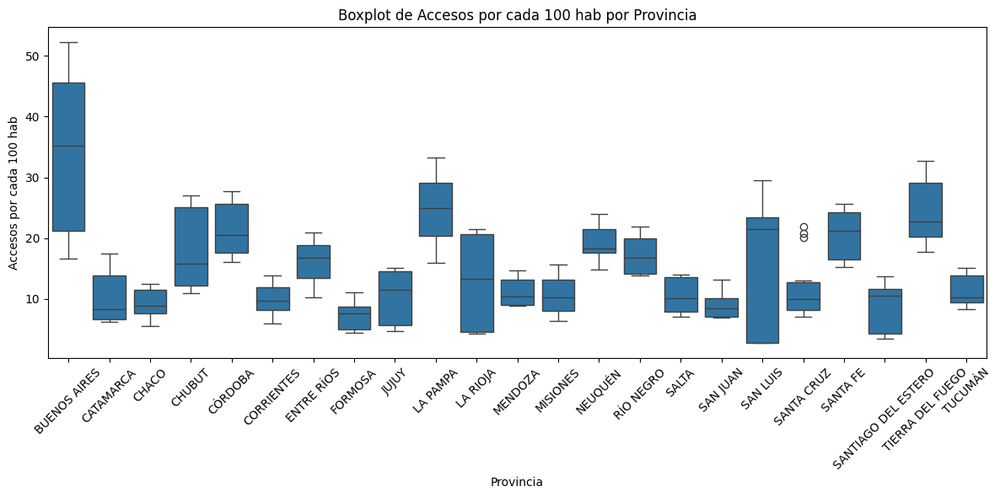


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         16.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         24.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         24.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         24.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         24.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         24.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         24.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         24.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         24.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         24.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         24.0  2024.0  0.0  2024.0  20

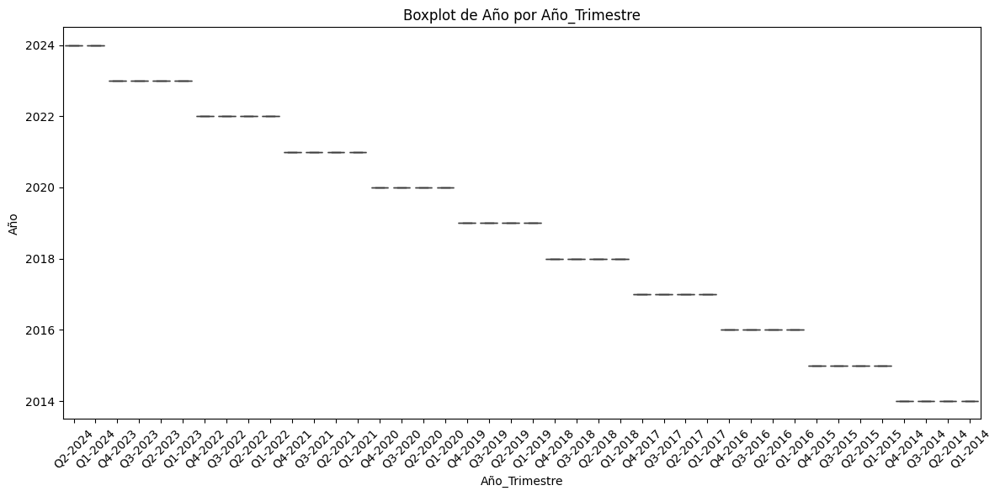


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         16.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

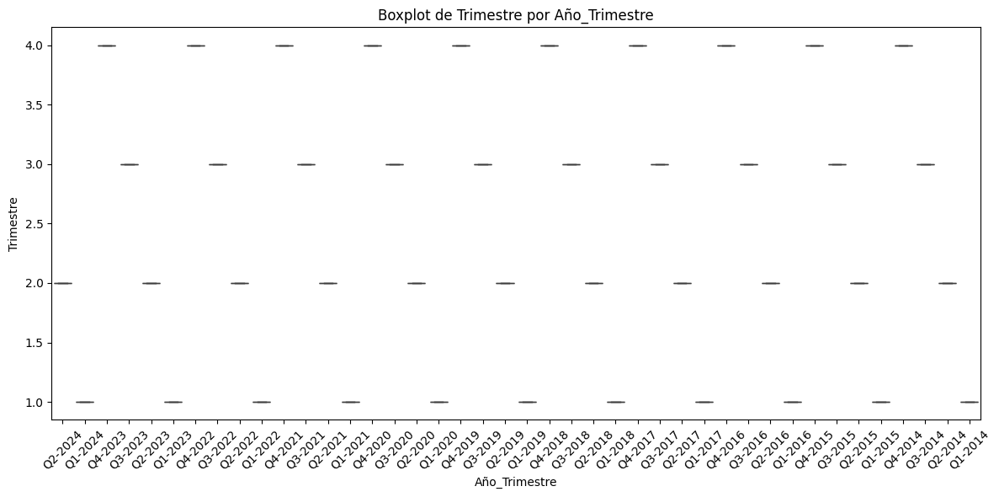


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'Año_Trimestre':
               count       mean        std        min        25%        50%  \
Año_Trimestre                                                                 
Q1-2014         16.0  11.851939   9.424635   4.353175   5.807199   9.617783   
Q1-2015         24.0  11.574764   8.607913   2.790401   6.880441   8.555253   
Q1-2016         24.0  11.686046   8.536127   2.752950   6.888511   8.520994   
Q1-2017         24.0  12.047223   9.042803   2.731984   6.797378   8.517247   
Q1-2018         24.0  13.819501   8.502557   4.335615   8.409733  10.273010   
Q1-2019         24.0  15.351482   8.755119   7.042692   9.296710  12.524109   
Q1-2020         24.0  15.872215   8.016977   7.693633  10.453957  12.174560   
Q1-2021         24.0  17.504511   7.998163   8.330895  11.701333  13.902505   
Q1-2022         24.0  19.483505   8.520720   8.896427  13.241729  16.946524   
Q1-2023         24.0  20.460833   9.131746 

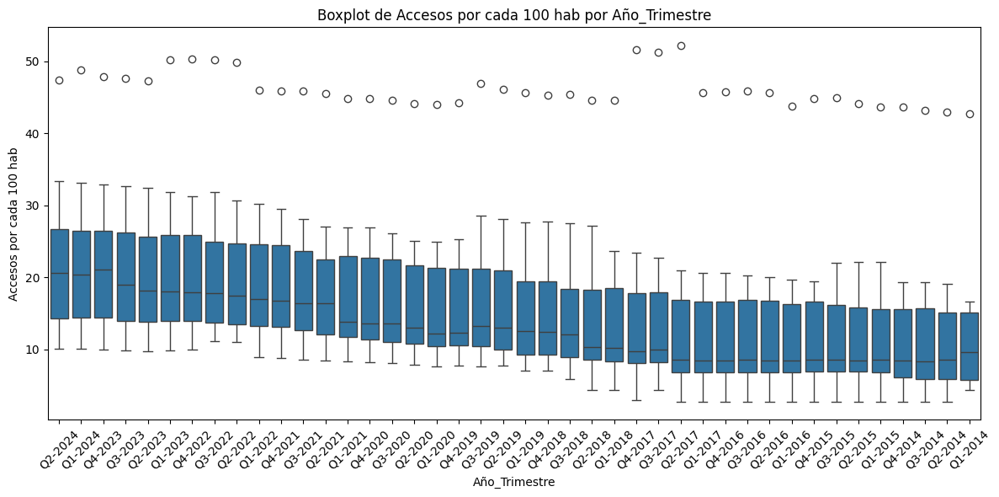


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count    mean       std     min     25%     50%     75%     max
Periodo                                                                     
01-03-2024  1000.0  2018.8  3.021445  2014.0  2016.0  2019.0  2021.0  2024.0


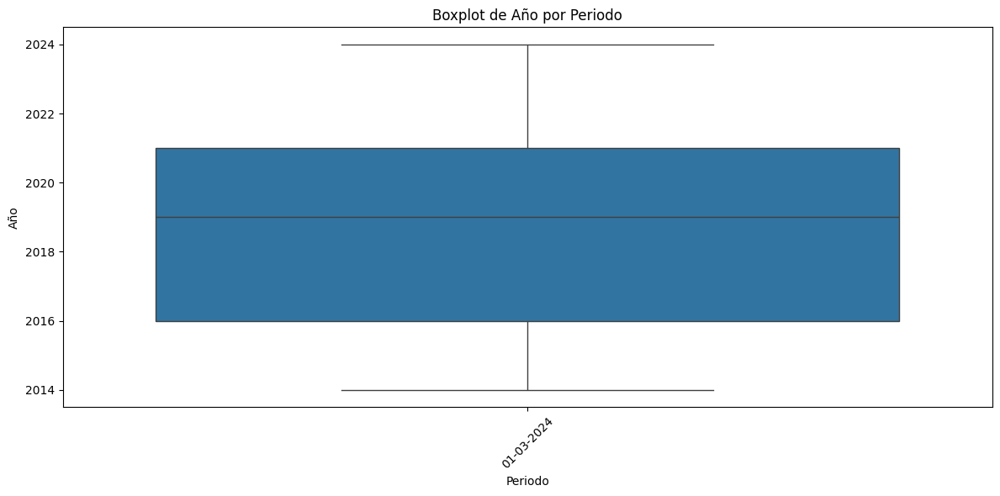


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count   mean       std  min  25%  50%  75%  max
Periodo                                                     
01-03-2024  1000.0  2.464  1.114426  1.0  1.0  2.0  3.0  4.0


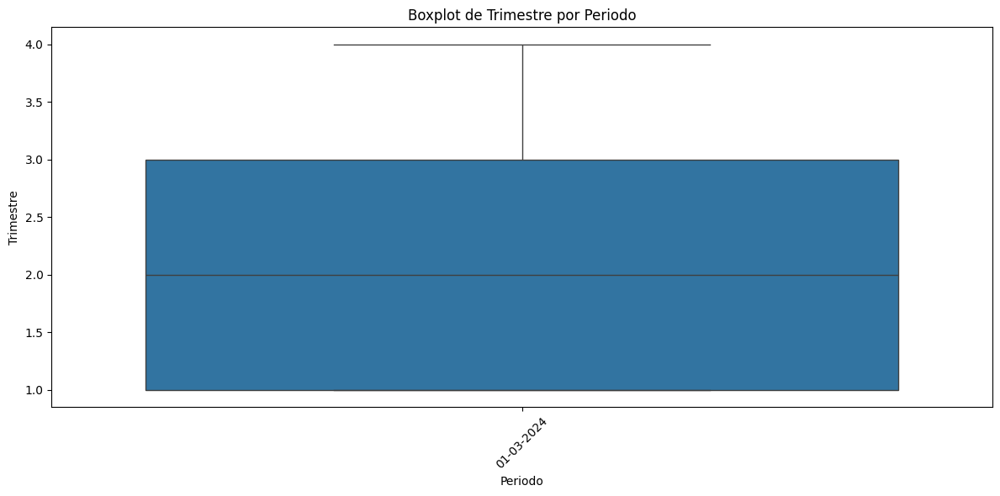


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'Periodo':
             count       mean       std    min       25%        50%  \
Periodo                                                               
01-03-2024  1000.0  15.727248  9.240063  2.723  9.018188  13.674812   

                  75%        max  
Periodo                           
01-03-2024  20.323973  52.236739  


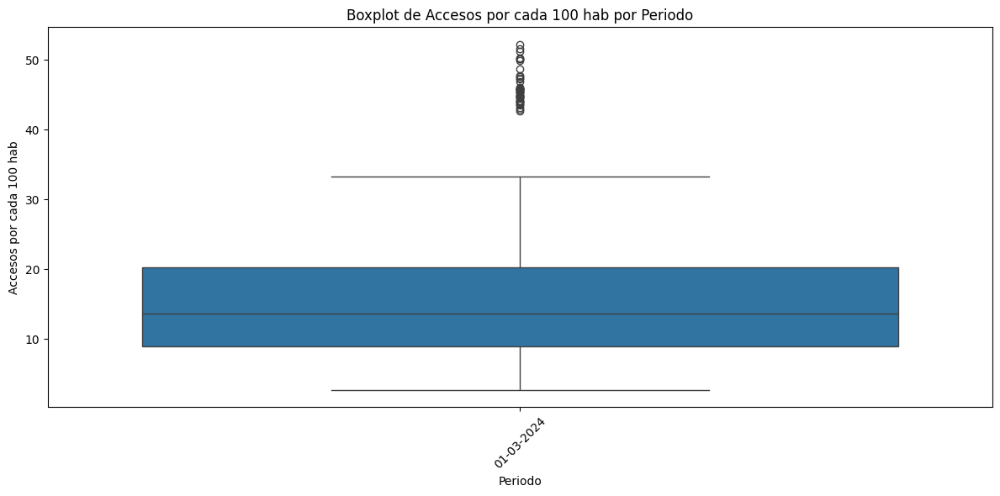


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count        mean       std     min      25%     50%     75%  \
meses_periodo                                                                 
abr - jun      264.0  2019.00000  3.168284  2014.0  2016.00  2019.0  2022.0   
ene - mar      256.0  2019.15625  3.089356  2014.0  2016.75  2019.0  2022.0   
jul - sep      240.0  2018.50000  2.878284  2014.0  2016.00  2018.5  2021.0   
oct - dic      240.0  2018.50000  2.878284  2014.0  2016.00  2018.5  2021.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


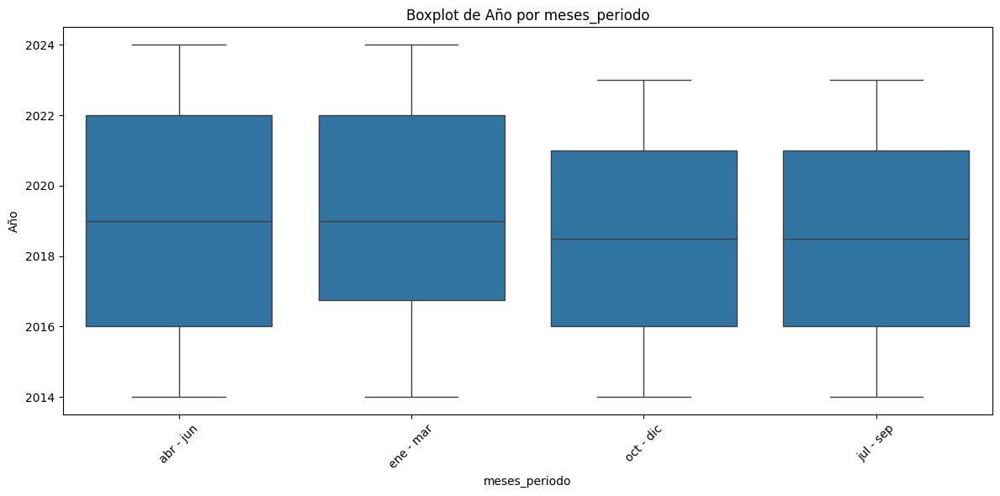


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      264.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      256.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      240.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      240.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


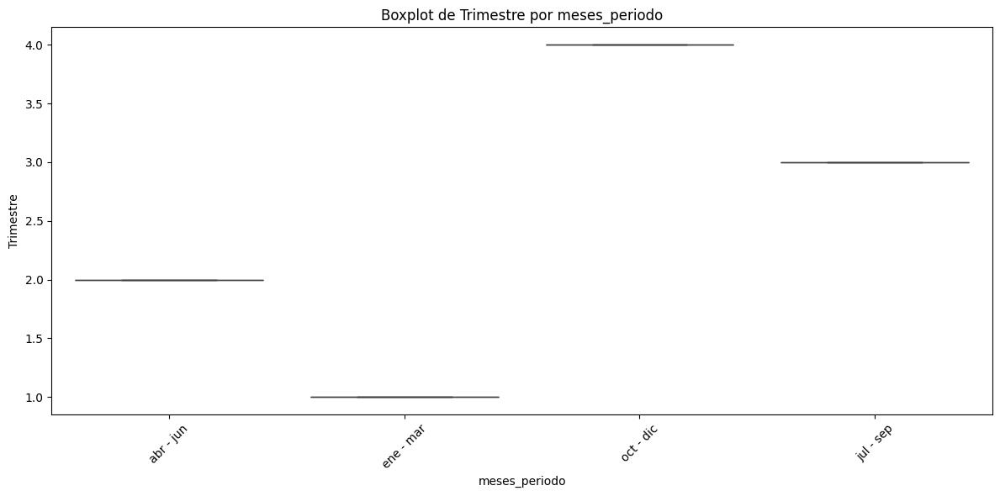


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'meses_periodo':
               count       mean       std       min       25%        50%  \
meses_periodo                                                              
abr - jun      264.0  15.782078  9.324339  2.723000  8.953897  13.694199   
ene - mar      256.0  15.655519  9.197823  2.731984  8.976255  13.614738   
jul - sep      240.0  15.680263  9.230951  2.747243  9.035089  13.627089   
oct - dic      240.0  15.790428  9.258132  2.741027  9.117508  13.743652   

                     75%        max  
meses_periodo                        
abr - jun      20.498689  52.236739  
ene - mar      20.144913  50.230000  
jul - sep      20.028038  51.244450  
oct - dic      20.584427  51.616721  


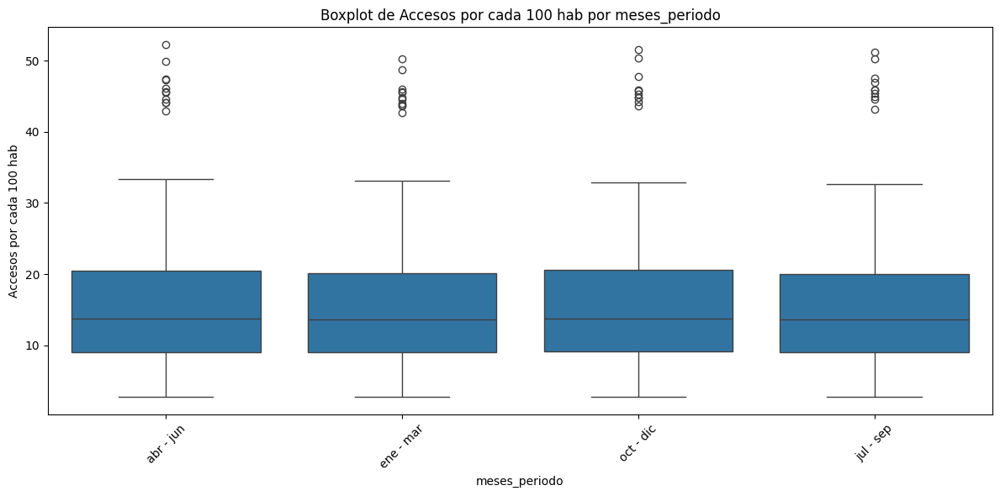

In [26]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [27]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
          Año  Trimestre  Accesos por cada 100 hab
0    1.721892  -0.416566                  1.267157
1    1.721892  -0.416566                  3.433810
2    1.721892  -0.416566                  0.191951
3    1.721892  -0.416566                 -0.427402
4    1.721892  -0.416566                  1.162127
..        ...        ...                       ...
995 -1.589439  -1.314338                 -1.231568
996 -1.589439  -1.314338                 -0.735637
997 -1.589439  -1.314338                 -1.018261
998 -1.589439  -1.314338                 -0.091493
999 -1.589439  -1.314338                 -0.201334

[1000 rows x 3 columns]


In [28]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           84
CATAMARCA              42
CHACO                  42
CHUBUT                 42
CÓRDOBA                42
CORRIENTES             42
ENTRE RÍOS             42
FORMOSA                42
JUJUY                  42
LA PAMPA               42
LA RIOJA               42
MENDOZA                42
MISIONES               42
NEUQUÉN                42
RÍO NEGRO              42
SALTA                  41
SAN JUAN               41
SAN LUIS               41
SANTA CRUZ             41
SANTA FE               41
SANTIAGO DEL ESTERO    41
TIERRA DEL FUEGO       41
TUCUMÁN                41
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    24
Q1-2024    24
Q4-2023    24
Q3-2023    24
Q2-2023    24
Q1-2023    24
Q4-2022    24
Q3-2022    24
Q2-2022    24
Q1-2022    24
Q4-2021    24
Q3-2021    24
Q2-2021    24
Q1-2021    24
Q4-2020    24
Q3-2020    24
Q2-2020    24
Q1-2020    2

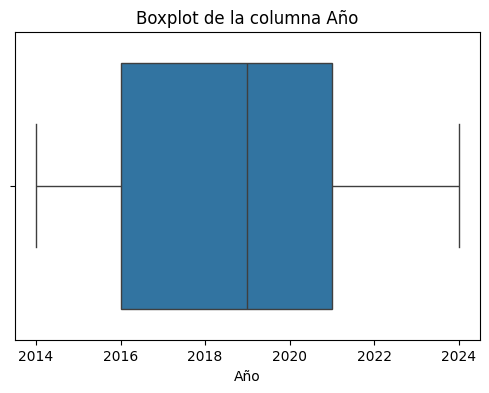

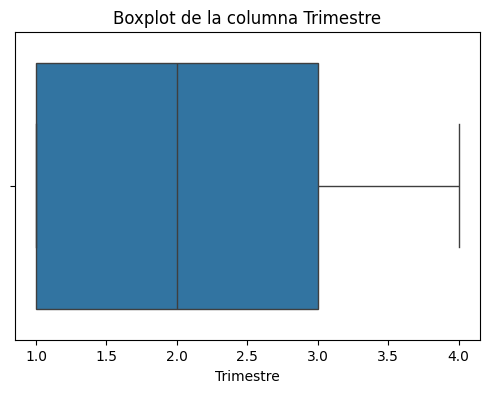

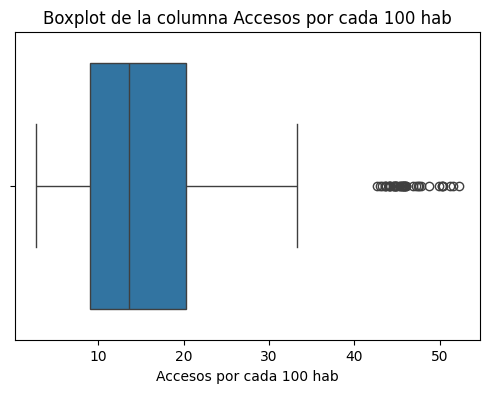

In [29]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [30]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Penetración-poblacion.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Penetración-poblacion.csv


In [31]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [32]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                         0.017454
Trimestre                   0.055832
Accesos por cada 100 hab    1.510943
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                        -1.182505
Trimestre                  -1.348124
Accesos por cada 100 hab    2.859164
dtype: float64


In [33]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                   Variable            VIF
0                     const  522414.718064
1                       Año       1.170497
2                 Trimestre       1.010066
3  Accesos por cada 100 hab       1.160750


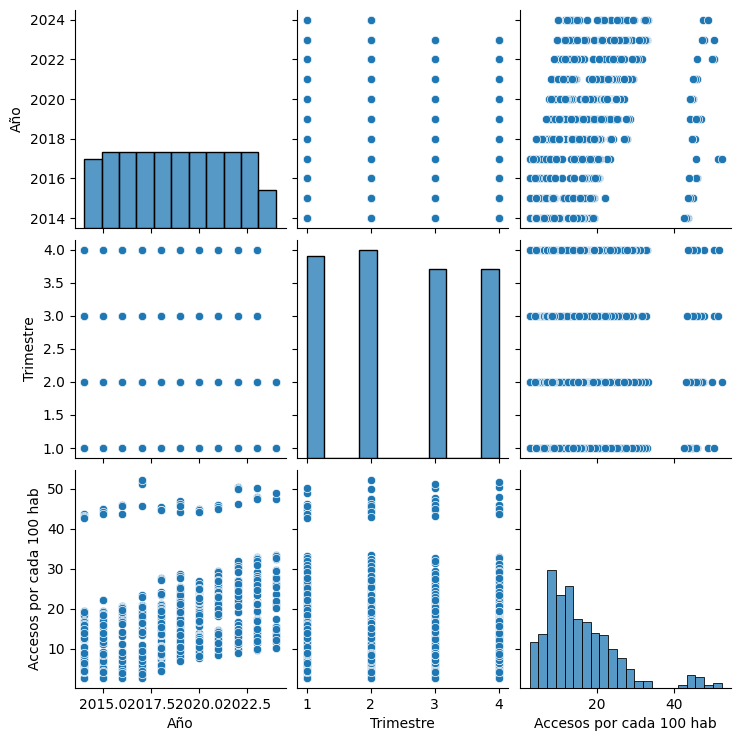

In [34]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [35]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                      Año                                                 \
                    count         mean       std     min     25%     50%   
Provincia                                                                  
BUENOS AIRES         84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA             42.0  2018.761905  3.074756

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Penetracion-totales.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre  Accesos por cada 100 hogares  Accesos por cada 100 hab  \
0  2024          2                         78.13                     24.57   
1  2024          1                         78.89                     24.79   
2  2023          4                         78.56                     24.66   
3  2023          3                         77.84                     24.41   
4  2023          2                         77.02                     24.14   

         Periodo  
0   Abr-Jun 2024  
1   Ene-Mar 2024  
2   Oct-Dic 2023  
3  Jul-Sept 2023  
4   Abr-Jun 2023  


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 5 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           42 non-null     int64  
 1   Trimestre                     42 non-null     int64  
 2   Accesos por cada 100 hogares  42 non-null     float64
 3   Accesos por cada 100 hab      42 non-null     float64
 4   Periodo                       42 non-null     object 
dtypes: float64(2), int64(2), object(1)
memory usage: 1.8+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2023          1       Q1-2023     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre  Accesos por cada 100 hogares  Accesos por cada 100 hab  \
0  2024          2                         78.13                     24.57   
1  2024          1                         78.89                     24.79   
2  2023          4                         78.56                     24.66   
3  2023          3                         77.84                     24.41   
4  2023          2                         77.02                     24.14   

         Periodo Año_Trimestre meses_periodo  
0   Abr-Jun 2024       Q2-2024     abr - jun  
1   Ene-Mar 2024       Q1-2024     ene - mar  
2   Oct-Dic 2023       Q4-2023     oct - dic  
3  Jul-Sept 2023       Q3-2023     jul - sep  
4   Abr-Jun 2023       Q2-2023     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                               int64
Trimestre                         int64
Accesos por cada 100 hogares    float64
Accesos por cada 100 hab        float64
Periodo                          object
Año_Trimestre                    object
meses_periodo                    object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           42 non-null     int64  
 1   Trimestre                     42 non-null     int64  
 2   Accesos por cada 100 hogares  42 non-null     float64
 3   Accesos por cada 100 hab      42 non-null     float64
 4   Periodo                       42 non-null     object 
 5   Año_Trimestre                 42 non-null     object 
 6   meses_periodo                 42 non-null     object 
dtypes: float64(2), int64(2), object(3)
memory usage: 2.4+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           42 non-null     int64  
 1   Trimestre                     42 non-null     int64  
 2   Accesos por cada 100 hogares  42 non-null     float64
 3   Accesos por cada 100 hab      42 non-null     float64
 4   Periodo                       42 non-null     object 
 5   Año_Trimestre                 42 non-null     object 
 6   meses_periodo                 42 non-null     object 
dtypes: float64(2), int64(2), object(3)
memory usage: 2.4+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           42 non-null     int64  
 1   Trimestre                     42 non-null     int64  
 2   Accesos por cada 100 hogares  42 non-null     float64
 3   Accesos por cada 100 hab      42 non-null     float64
 4   Periodo                       42 non-null     object 
 5   Año_Trimestre                 42 non-null     object 
 6   meses_periodo                 42 non-null     object 
dtypes: float64(2), int64(2), object(3)
memory usage: 2.4+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                             0
Trimestre                       0
Accesos por cada 100 hogares    0
Accesos por cada 100 hab        0
Periodo                         0
Año_Trimestre                   0
meses_periodo                   0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                             0
Trimestre                       0
Accesos por cada 100 hogares    0
Accesos por cada 100 hab        0
Periodo                         0
Año_Trimestre                   0
meses_periodo                   0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                             0
Trimestre                       0
Accesos por cada 100 hogares    0
Accesos por cada 100 hab        0
Periodo                         0
Año_Trimestre                   0
meses_periodo                   0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           42 non-null     int64  
 1   Trimestre                     42 non-null     int64  
 2   Accesos por cada 100 hogares  42 non-null     float64
 3   Accesos por cada 100 hab      42 non-null     float64
 4   Periodo                       42 non-null     object 
 5   Año_Trimestre                 42 non-null     object 
 6   meses_periodo                 42 non-null     object 
dtypes: float64(2), int64(2), object(3)
memory usage: 2.4+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre  Accesos por cada 100 hogares  \
count     42.000000  42.000000                     42.000000   
unique          NaN        NaN                           NaN   
top             NaN        NaN                           NaN   
freq            NaN        NaN                           NaN   
mean    2018.761905   2.452381                     63.201813   
std        3.074756   1.130560                      9.950321   
min     2014.000000   1.000000                     49.545821   
25%     2016.000000   1.250000                     53.784644   
50%     2019.000000   2.000000                     62.667764   
75%     2021.000000   3.000000                     72.527011   
max     2024.000000   4.000000                     78.890000   

        Accesos por cada 100 hab       Periodo Año_Trimestre meses_periodo  
count                  42.000000            42            42            42  
uni

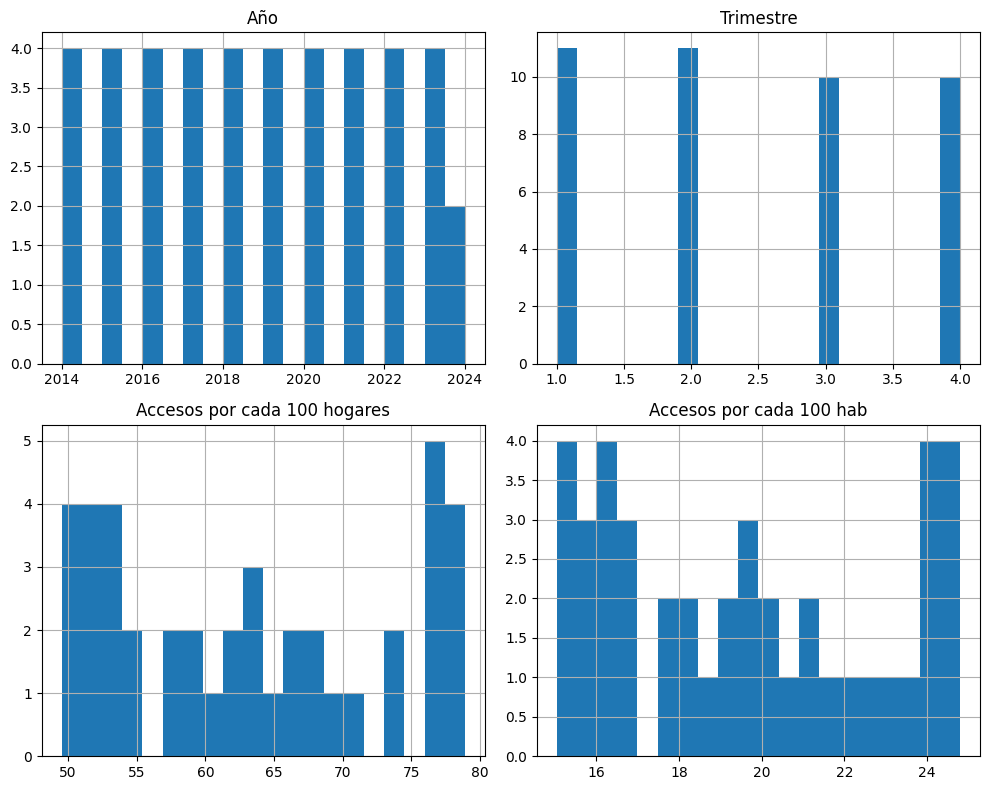

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                                   Año  Trimestre  \
Año                           1.000000  -0.073505   
Trimestre                    -0.073505   1.000000   
Accesos por cada 100 hogares  0.981878   0.028828   
Accesos por cada 100 hab      0.982888   0.027740   

                              Accesos por cada 100 hogares  \
Año                                               0.981878   
Trimestre                                         0.028828   
Accesos por cada 100 hogares                      1.000000   
Accesos por cada 100 hab                          0.999947   

                              Accesos por cada 100 hab  
Año                                           0.982888  
Trimestre                                     0.027740  
Accesos por cada 100 hogares                  0.999947  
Accesos por cada 100 hab                      1.000000  

Correlaciones fuertes:
                                   Año  Trimestre  \
Año                   

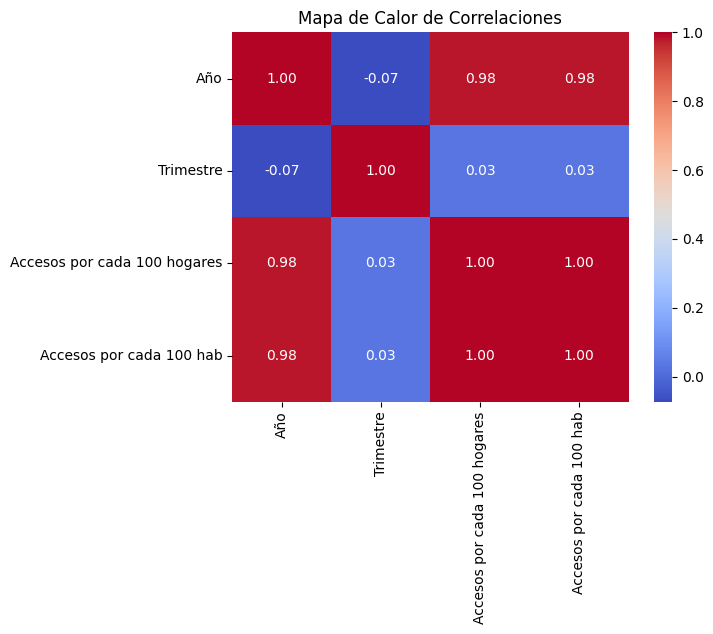

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Periodo y Año_Trimestre:
Año_Trimestre  Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  Q1-2020  \
Periodo                                                                        
Abr-Jun 2014         0        0        0        0        0        0        0   
Abr-Jun 2015         0        0        0        0        0        0        0   
Abr-Jun 2016         0        0        0        0        0        0        0   
Abr-Jun 2017         0        0        0        0        0        0        0   
Abr-Jun 2018         0        0        0        0        0        0        0   
Abr-Jun 2019         0        0        0        0        0        0        0   
Abr-Jun 2020         0        0        0        0        0        0        0   
Abr-Jun 2021         0        0        0        0        0        0        0   
Abr-Jun 2022         0        0        0        0        0        0        0   
Abr-Jun 2023         0        0        0        0        0        

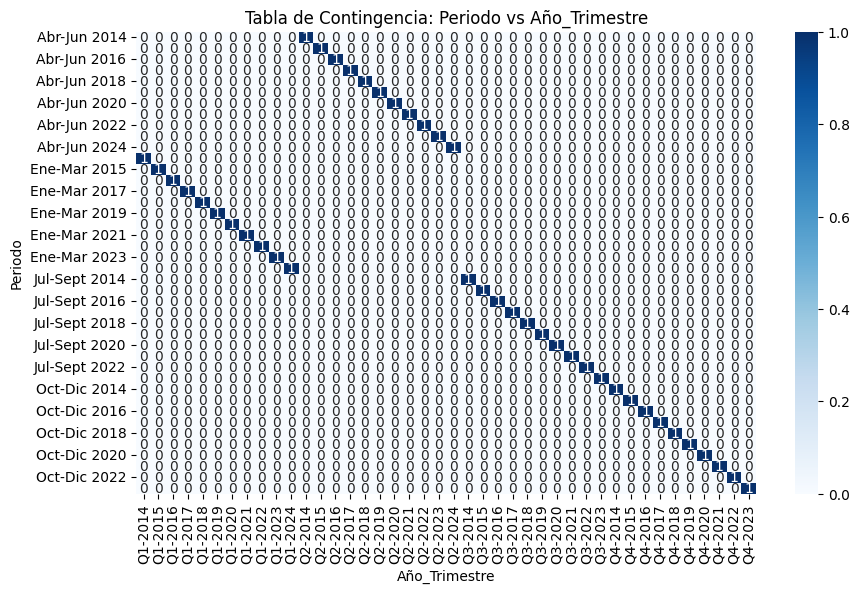


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
Abr-Jun 2014           1          0          0          0
Abr-Jun 2015           1          0          0          0
Abr-Jun 2016           1          0          0          0
Abr-Jun 2017           1          0          0          0
Abr-Jun 2018           1          0          0          0
Abr-Jun 2019           1          0          0          0
Abr-Jun 2020           1          0          0          0
Abr-Jun 2021           1          0          0          0
Abr-Jun 2022           1          0          0          0
Abr-Jun 2023           1          0          0          0
Abr-Jun 2024           1          0          0          0
Ene-Mar 2014           0          1          0          0
Ene-Mar 2015           0          1          0          0
Ene-Mar 2016           0          1          0          0
Ene-Mar 2017      

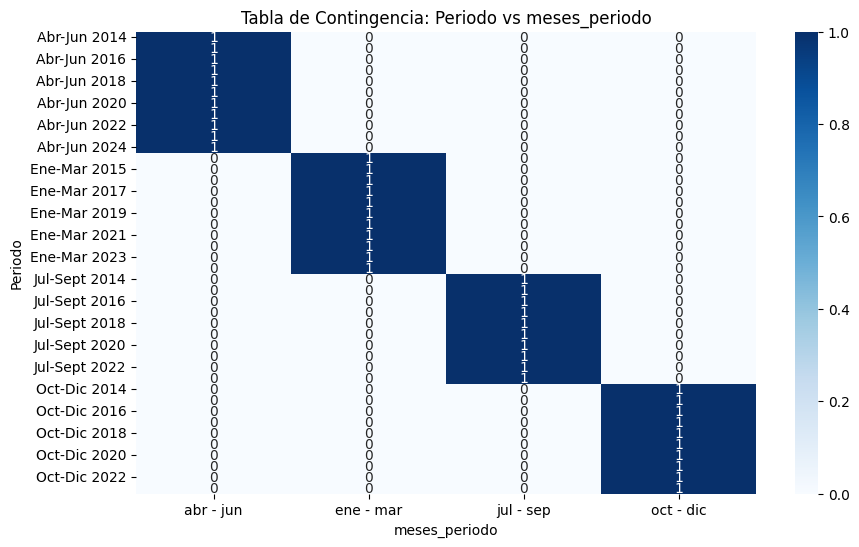


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2023                0          1          0          0
Q1-2024                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

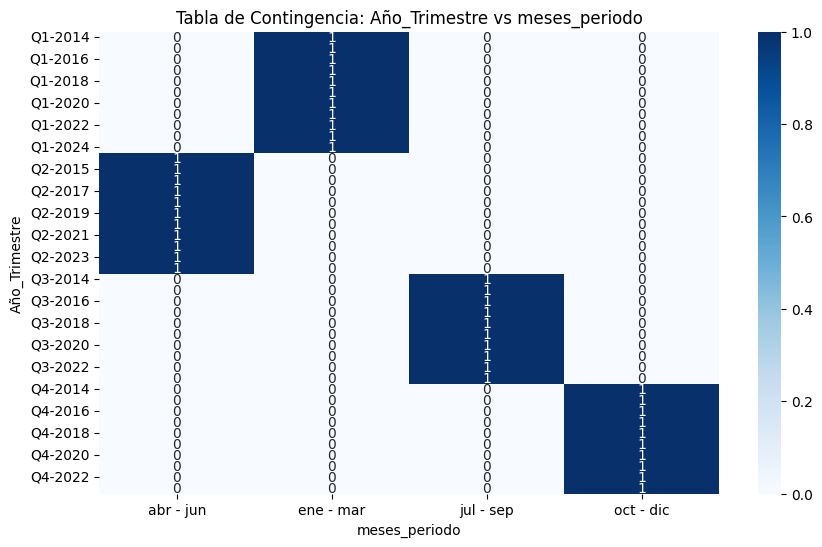

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
               count    mean  std     min     25%     50%     75%     max
Periodo                                                                  
Abr-Jun 2014     1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Abr-Jun 2015     1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Abr-Jun 2016     1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Abr-Jun 2017     1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Abr-Jun 2018     1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Abr-Jun 2019     1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Abr-Jun 2020     1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Abr-Jun 2021     1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Abr-Jun 2022     1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Abr-Jun 2023     1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Abr-Jun 2024     1.0  2024.0  NaN  2024.0  2024.0  

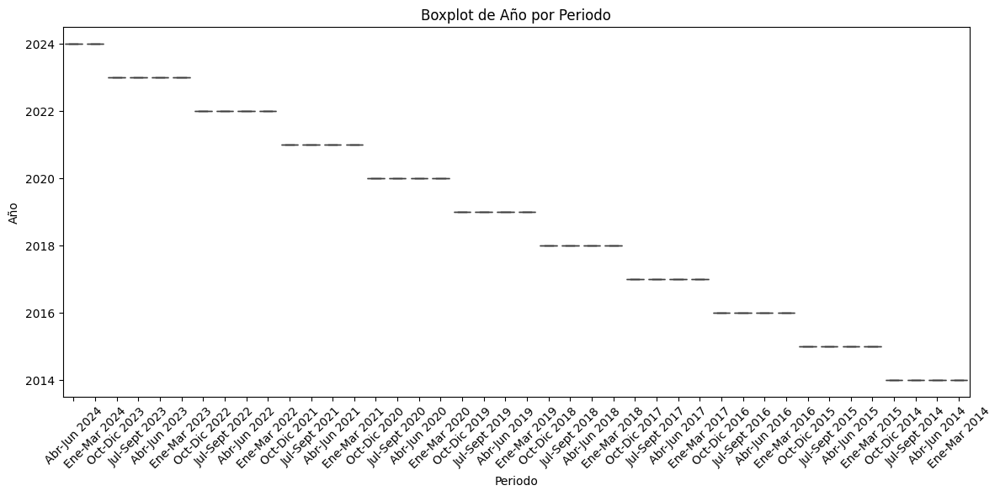


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
               count  mean  std  min  25%  50%  75%  max
Periodo                                                 
Abr-Jun 2014     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2015     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2016     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2017     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2018     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2019     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2020     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2021     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2022     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2023     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2024     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Ene-Mar 2014     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2015     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2016     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2017     1.0 

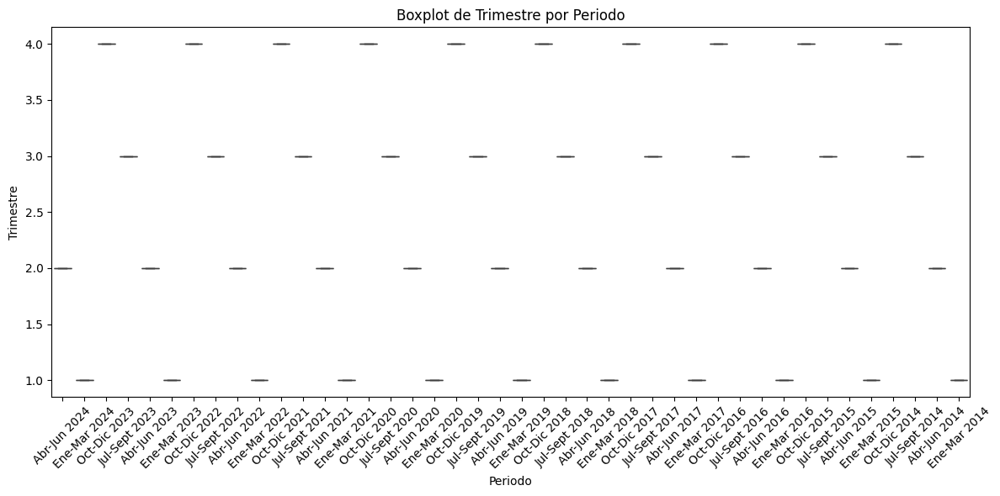


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'Periodo':
               count       mean  std        min        25%        50%  \
Periodo                                                                 
Abr-Jun 2014     1.0  49.861428  NaN  49.861428  49.861428  49.861428   
Abr-Jun 2015     1.0  51.760266  NaN  51.760266  51.760266  51.760266   
Abr-Jun 2016     1.0  53.342201  NaN  53.342201  53.342201  53.342201   
Abr-Jun 2017     1.0  54.901191  NaN  54.901191  54.901191  54.901191   
Abr-Jun 2018     1.0  59.162069  NaN  59.162069  59.162069  59.162069   
Abr-Jun 2019     1.0  64.530000  NaN  64.530000  64.530000  64.530000   
Abr-Jun 2020     1.0  64.210003  NaN  64.210003  64.210003  64.210003   
Abr-Jun 2021     1.0  69.240183  NaN  69.240183  69.240183  69.240183   
Abr-Jun 2022     1.0  75.965424  NaN  75.965424  75.965424  75.965424   
Abr-Jun 2023     1.0  77.020000  NaN  77.020000  77.020000  77.020000   
Abr-Jun 2024     1.0  78.130000  NaN  

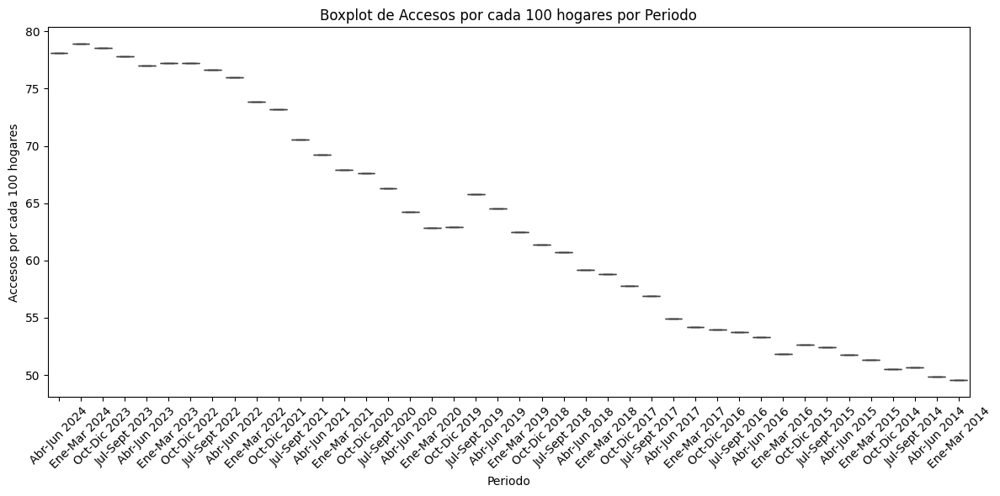


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'Periodo':
               count       mean  std        min        25%        50%  \
Periodo                                                                 
Abr-Jun 2014     1.0  15.163908  NaN  15.163908  15.163908  15.163908   
Abr-Jun 2015     1.0  15.817234  NaN  15.817234  15.817234  15.817234   
Abr-Jun 2016     1.0  16.371351  NaN  16.371351  16.371351  16.371351   
Abr-Jun 2017     1.0  16.882937  NaN  16.882937  16.882937  16.882937   
Abr-Jun 2018     1.0  18.240000  NaN  18.240000  18.240000  18.240000   
Abr-Jun 2019     1.0  19.960000  NaN  19.960000  19.960000  19.960000   
Abr-Jun 2020     1.0  19.918403  NaN  19.918403  19.918403  19.918403   
Abr-Jun 2021     1.0  21.547939  NaN  21.547939  21.547939  21.547939   
Abr-Jun 2022     1.0  23.720442  NaN  23.720442  23.720442  23.720442   
Abr-Jun 2023     1.0  24.140000  NaN  24.140000  24.140000  24.140000   
Abr-Jun 2024     1.0  24.570000  NaN  24.5

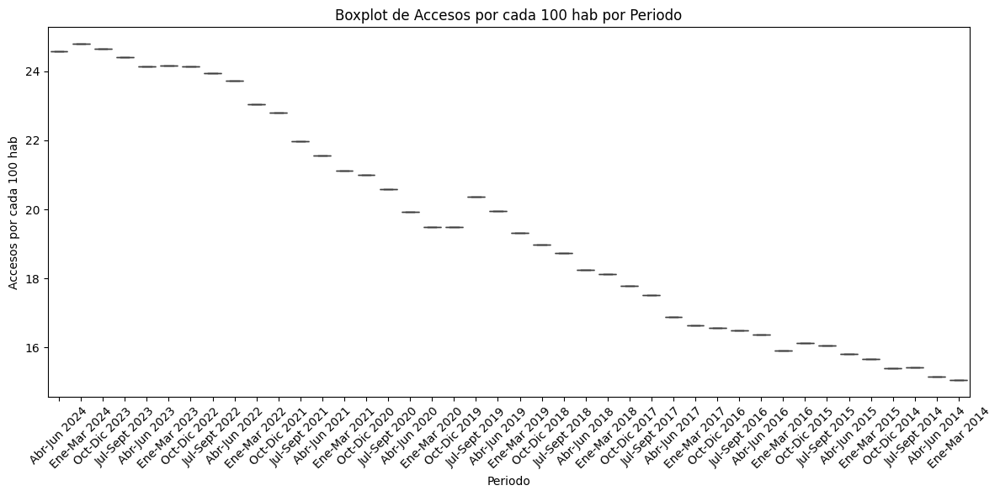


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023          1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024          1.0  2024.0  NaN  2024.0  20

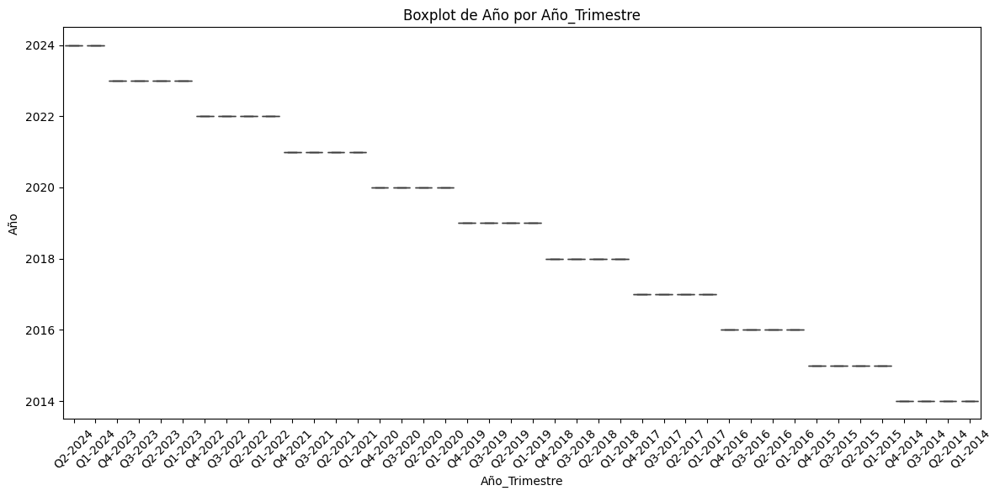


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2023          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

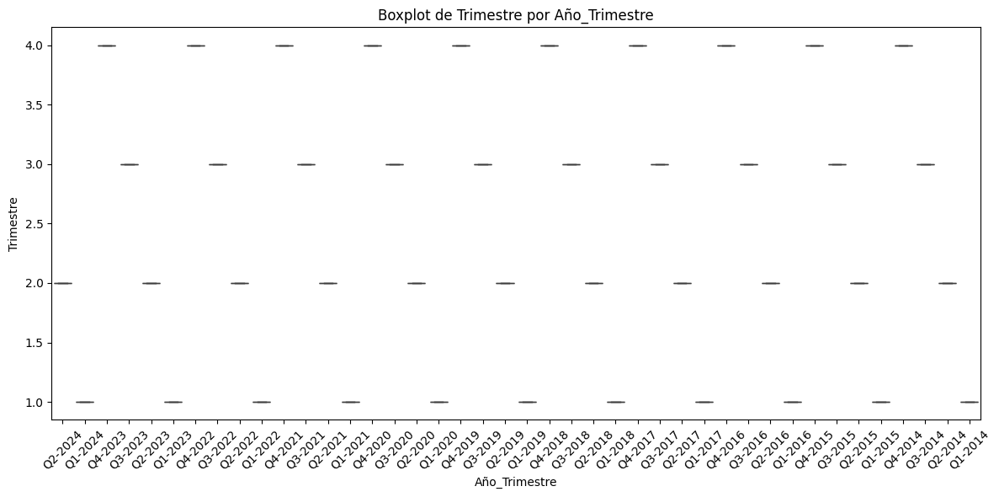


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0  49.545821  NaN  49.545821  49.545821  49.545821   
Q1-2015          1.0  51.364586  NaN  51.364586  51.364586  51.364586   
Q1-2016          1.0  51.845452  NaN  51.845452  51.845452  51.845452   
Q1-2017          1.0  54.162116  NaN  54.162116  54.162116  54.162116   
Q1-2018          1.0  58.820000  NaN  58.820000  58.820000  58.820000   
Q1-2019          1.0  62.479166  NaN  62.479166  62.479166  62.479166   
Q1-2020          1.0  62.856361  NaN  62.856361  62.856361  62.856361   
Q1-2021          1.0  67.945876  NaN  67.945876  67.945876  67.945876   
Q1-2022          1.0  73.878803  NaN  73.878803  73.878803  73.878803   
Q1-2023          1.0  77.200000  NaN  77.200000  77.200000  77.200000   
Q1-2024          1.0  78.890000 

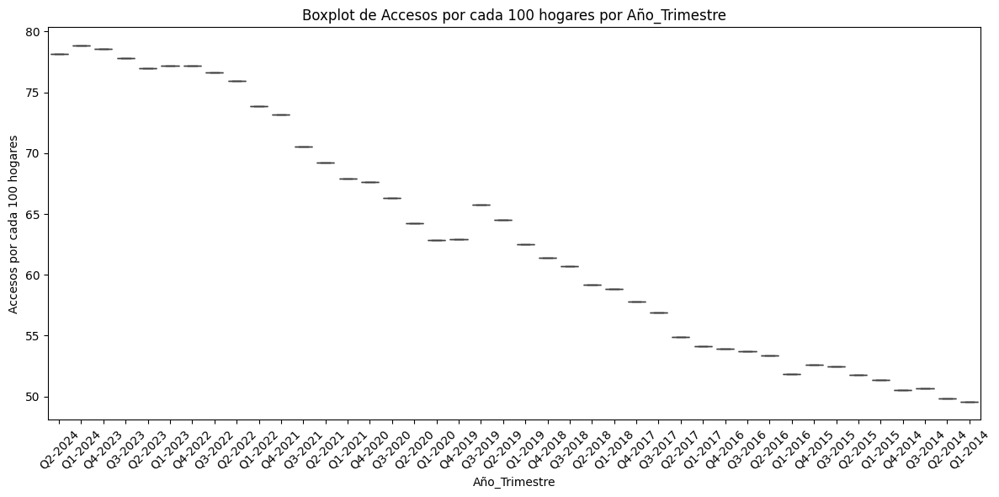


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0  15.050104  NaN  15.050104  15.050104  15.050104   
Q1-2015          1.0  15.677234  NaN  15.677234  15.677234  15.677234   
Q1-2016          1.0  15.901802  NaN  15.901802  15.901802  15.901802   
Q1-2017          1.0  16.644565  NaN  16.644565  16.644565  16.644565   
Q1-2018          1.0  18.120000  NaN  18.120000  18.120000  18.120000   
Q1-2019          1.0  19.307907  NaN  19.307907  19.307907  19.307907   
Q1-2020          1.0  19.483265  NaN  19.483265  19.483265  19.483265   
Q1-2021          1.0  21.127832  NaN  21.127832  21.127832  21.127832   
Q1-2022          1.0  23.049171  NaN  23.049171  23.049171  23.049171   
Q1-2023          1.0  24.170000  NaN  24.170000  24.170000  24.170000   
Q1-2024          1.0  24.790000  NaN

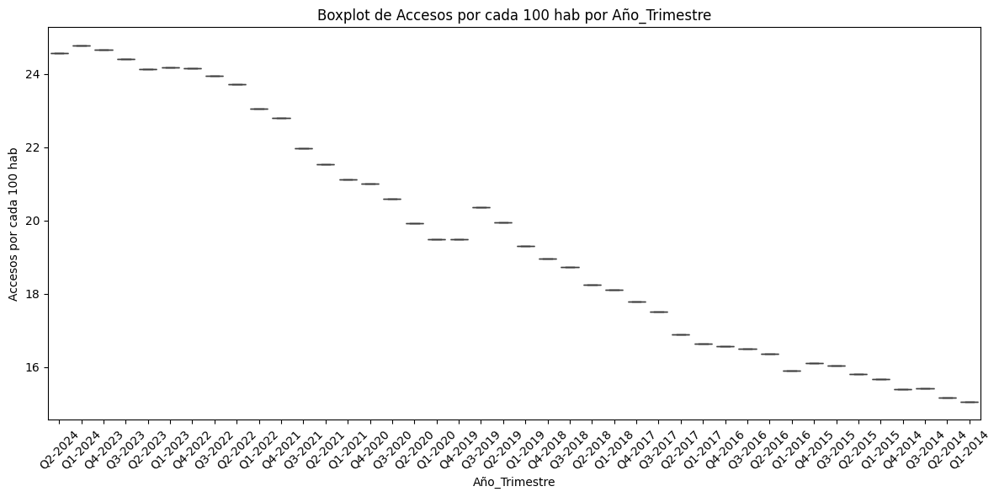


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min      25%     50%      75%  \
meses_periodo                                                              
abr - jun       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


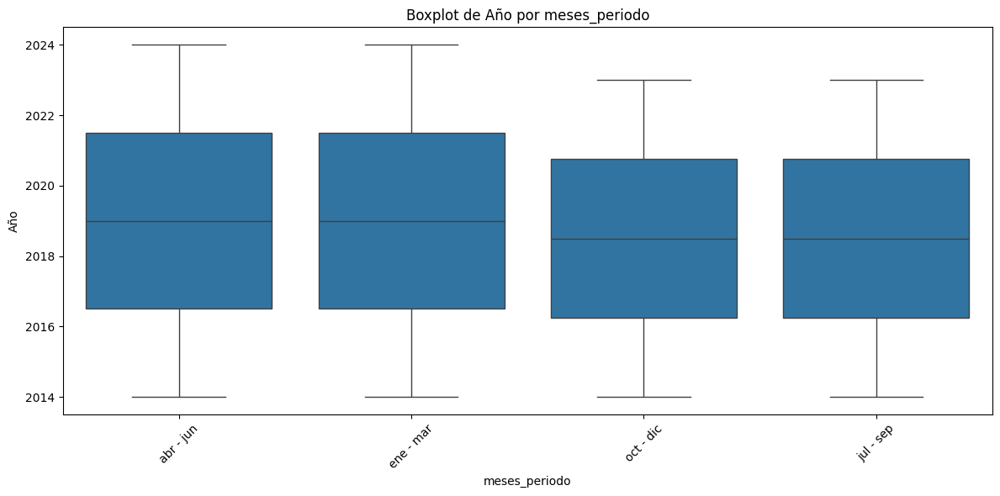


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


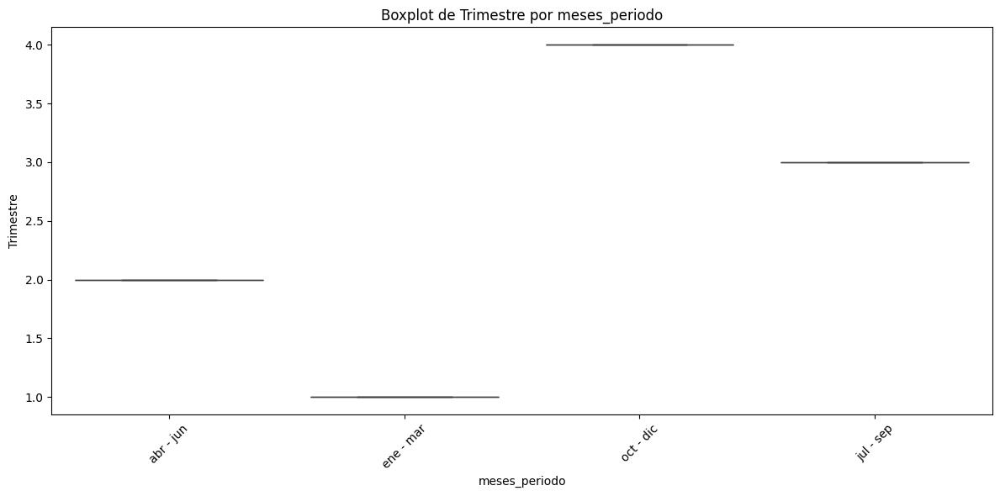


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'meses_periodo':
               count       mean        std        min        25%        50%  \
meses_periodo                                                                 
abr - jun       11.0  63.465706  10.518963  49.861428  54.121696  64.210003   
ene - mar       11.0  62.635289  10.640363  49.545821  53.003784  62.479166   
jul - sep       10.0  63.161172   9.852666  50.672368  54.525445  63.238992   
oct - dic       10.0  63.575350  10.226990  50.499788  54.897602  62.167860   

                     75%    max  
meses_periodo                    
abr - jun      72.602804  78.13  
ene - mar      70.912340  78.89  
jul - sep      69.511640  77.84  
oct - dic      71.787882  78.56  


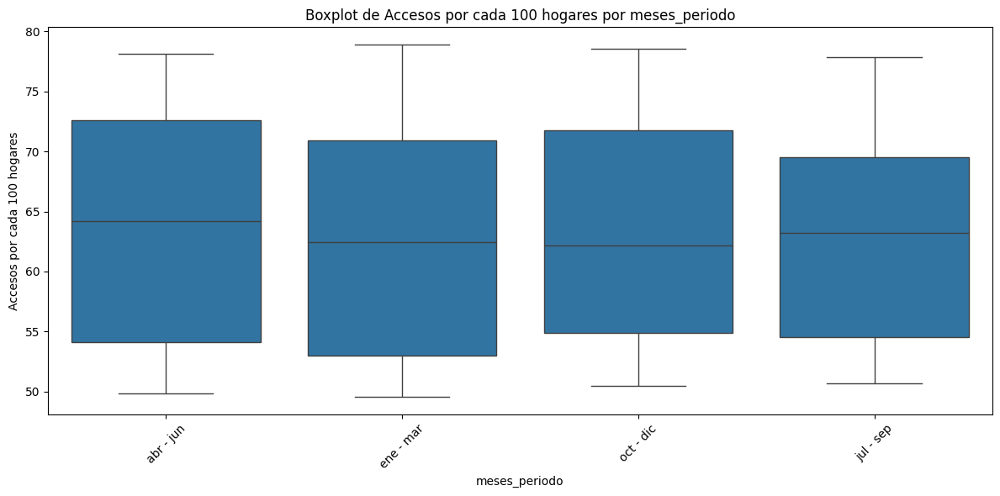


Estadísticas descriptivas de 'Accesos por cada 100 hab' agrupadas por 'meses_periodo':
               count       mean       std        min        25%        50%  \
meses_periodo                                                                
abr - jun       11.0  19.666565  3.462827  15.163908  16.627144  19.918403   
ene - mar       11.0  19.392898  3.498150  15.050104  16.273184  19.307907   
jul - sep       10.0  19.551598  3.231445  15.428769  16.755765  19.545330   
oct - dic       10.0  19.696314  3.352927  15.394677  16.871244  19.228950   

                     75%    max  
meses_periodo                    
abr - jun      22.634191  24.57  
ene - mar      22.088501  24.79  
jul - sep      21.634413  24.41  
oct - dic      22.360574  24.66  


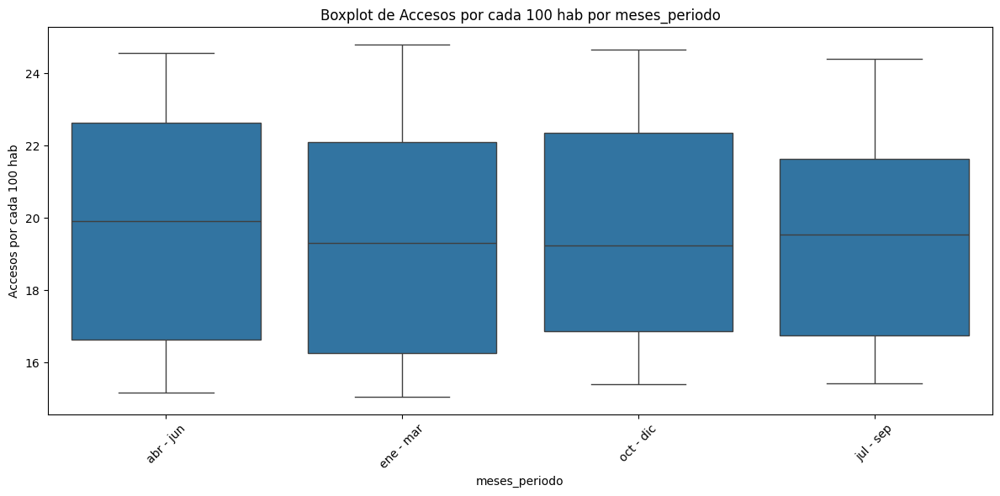

In [26]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [ ]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)

In [ ]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())

In [ ]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [ ]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Penetracion-totales.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")

In [100]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [ ]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())

In [ ]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)


In [ ]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [ ]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Ingresos .csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre  Ingresos (miles de pesos)        Periodo
0  2024          2               4.420322e+08   Abr-Jun 2024
1  2024          1               3.461990e+08   Ene-Mar 2024
2  2023          4               1.673760e+08   Oct-Dic 2023
3  2023          3               1.331066e+08  Jul-Sept 2023
4  2023          2               1.180603e+08   Jun-Mar 2023


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 4 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Año                        42 non-null     int64  
 1   Trimestre                  42 non-null     int64  
 2   Ingresos (miles de pesos)  42 non-null     float64
 3   Periodo                    42 non-null     object 
dtypes: float64(1), int64(2), object(1)
memory usage: 1.4+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2033          1       Q1-2033     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre  Ingresos (miles de pesos)        Periodo Año_Trimestre  \
0  2024          2               4.420322e+08   Abr-Jun 2024       Q2-2024   
1  2024          1               3.461990e+08   Ene-Mar 2024       Q1-2024   
2  2023          4               1.673760e+08   Oct-Dic 2023       Q4-2023   
3  2023          3               1.331066e+08  Jul-Sept 2023       Q3-2023   
4  2023          2               1.180603e+08   Jun-Mar 2023       Q2-2023   

  meses_periodo  
0     abr - jun  
1     ene - mar  
2     oct - dic  
3     jul - sep  
4     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                            int64
Trimestre                      int64
Ingresos (miles de pesos)    float64
Periodo                       object
Año_Trimestre                 object
meses_periodo                 object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Año                        42 non-null     int64  
 1   Trimestre                  42 non-null     int64  
 2   Ingresos (miles de pesos)  42 non-null     float64
 3   Periodo                    42 non-null     object 
 4   Año_Trimestre              42 non-null     object 
 5   meses_periodo              42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Año                        42 non-null     int64  
 1   Trimestre                  42 non-null     int64  
 2   Ingresos (miles de pesos)  42 non-null     float64
 3   Periodo                    42 non-null     object 
 4   Año_Trimestre              42 non-null     object 
 5   meses_periodo              42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Año                        42 non-null     int64  
 1   Trimestre                  42 non-null     int64  
 2   Ingresos (miles de pesos)  42 non-null     float64
 3   Periodo                    42 non-null     object 
 4   Año_Trimestre              42 non-null     object 
 5   meses_periodo              42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                          0
Trimestre                    0
Ingresos (miles de pesos)    0
Periodo                      0
Año_Trimestre                0
meses_periodo                0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                          0
Trimestre                    0
Ingresos (miles de pesos)    0
Periodo                      0
Año_Trimestre                0
meses_periodo                0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                          0
Trimestre                    0
Ingresos (miles de pesos)    0
Periodo                      0
Año_Trimestre                0
meses_periodo                0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Año                        42 non-null     int64  
 1   Trimestre                  42 non-null     int64  
 2   Ingresos (miles de pesos)  42 non-null     float64
 3   Periodo                    42 non-null     object 
 4   Año_Trimestre              42 non-null     object 
 5   meses_periodo              42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre  Ingresos (miles de pesos)       Periodo  \
count     42.000000  42.000000               4.200000e+01            42   
unique          NaN        NaN                        NaN            42   
top             NaN        NaN                        NaN  Abr-Jun 2024   
freq            NaN        NaN                        NaN             1   
mean    2019.000000   2.452381               5.001648e+07           NaN   
std        3.728597   1.130560               8.710208e+07           NaN   
min     2014.000000   1.000000               2.984054e+06           NaN   
25%     2016.000000   1.250000               7.055326e+06           NaN   
50%     2019.000000   2.000000               2.047527e+07           NaN   
75%     2021.000000   3.000000               4.485090e+07           NaN   
max     2033.000000   4.000000               4.420322e+08           NaN   

       Año_Trimestre mese

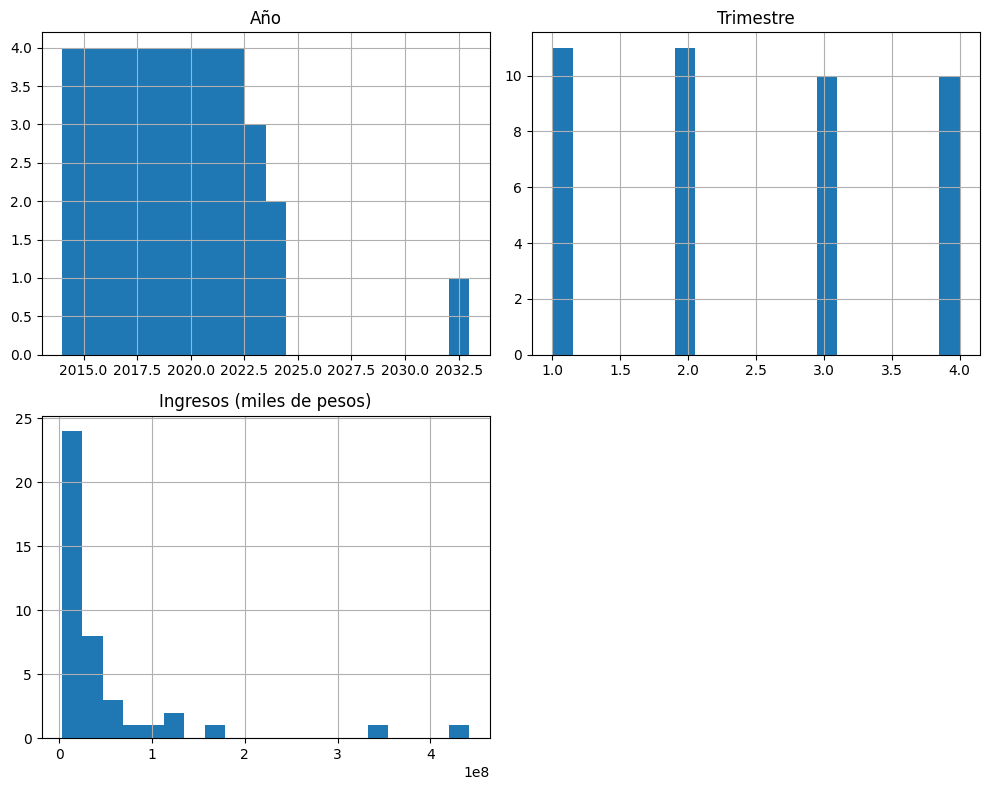

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                                Año  Trimestre  Ingresos (miles de pesos)
Año                        1.000000  -0.144650                   0.594475
Trimestre                 -0.144650   1.000000                  -0.115954
Ingresos (miles de pesos)  0.594475  -0.115954                   1.000000

Correlaciones fuertes:
                           Año  Trimestre  Ingresos (miles de pesos)
Año                        1.0        NaN                        NaN
Trimestre                  NaN        1.0                        NaN
Ingresos (miles de pesos)  NaN        NaN                        1.0


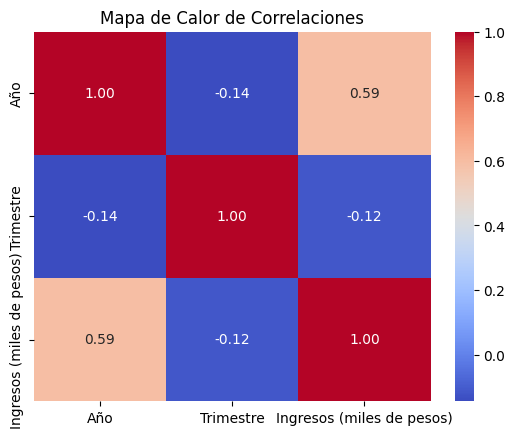

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Periodo y Año_Trimestre:
Año_Trimestre  Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  Q1-2020  \
Periodo                                                                        
Abr-Jun 2014         0        0        0        0        0        0        0   
Abr-Jun 2015         0        0        0        0        0        0        0   
Abr-Jun 2016         0        0        0        0        0        0        0   
Abr-Jun 2017         0        0        0        0        0        0        0   
Abr-Jun 2018         0        0        0        0        0        0        0   
Abr-Jun 2019         0        0        0        0        0        0        0   
Abr-Jun 2020         0        0        0        0        0        0        0   
Abr-Jun 2021         0        0        0        0        0        0        0   
Abr-Jun 2022         0        0        0        0        0        0        0   
Abr-Jun 2024         0        0        0        0        0        

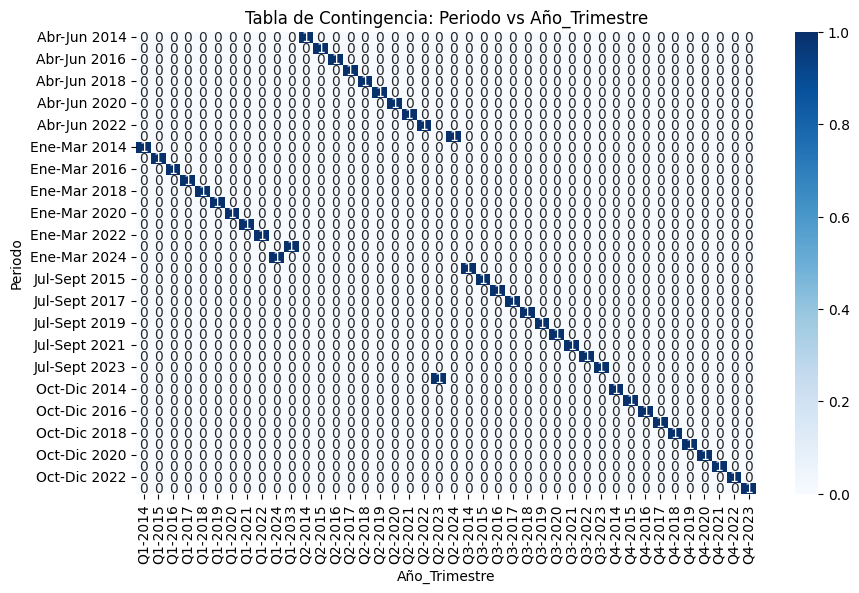


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
Abr-Jun 2014           1          0          0          0
Abr-Jun 2015           1          0          0          0
Abr-Jun 2016           1          0          0          0
Abr-Jun 2017           1          0          0          0
Abr-Jun 2018           1          0          0          0
Abr-Jun 2019           1          0          0          0
Abr-Jun 2020           1          0          0          0
Abr-Jun 2021           1          0          0          0
Abr-Jun 2022           1          0          0          0
Abr-Jun 2024           1          0          0          0
Ene-Mar 2014           0          1          0          0
Ene-Mar 2015           0          1          0          0
Ene-Mar 2016           0          1          0          0
Ene-Mar 2017           0          1          0          0
Ene-Mar 2018      

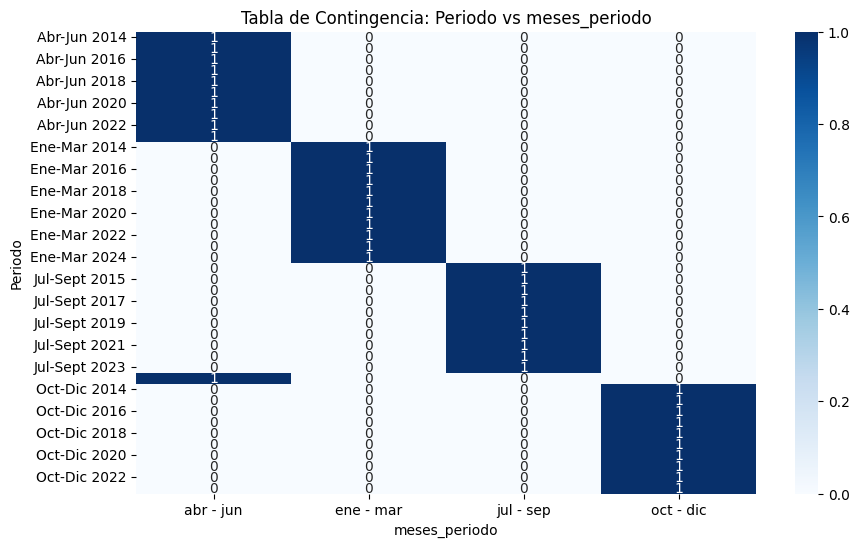


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2024                0          1          0          0
Q1-2033                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

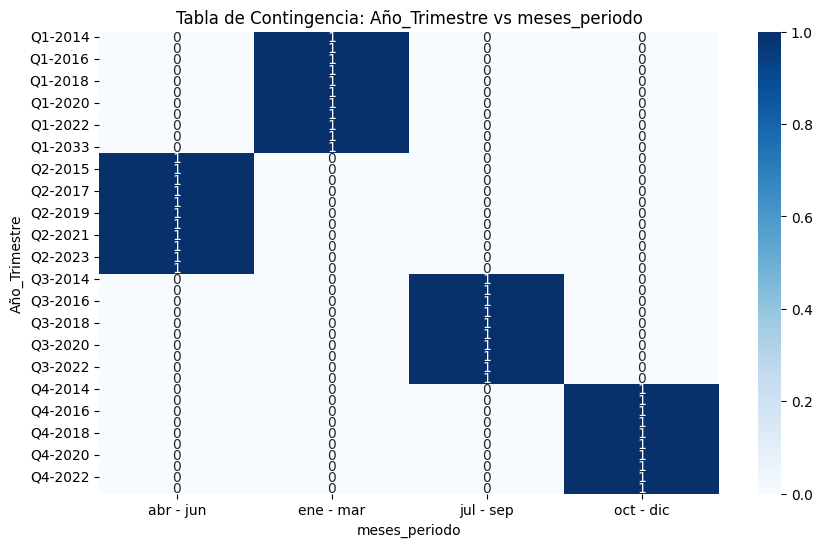

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
               count    mean  std     min     25%     50%     75%     max
Periodo                                                                  
Abr-Jun 2014     1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Abr-Jun 2015     1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Abr-Jun 2016     1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Abr-Jun 2017     1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Abr-Jun 2018     1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Abr-Jun 2019     1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Abr-Jun 2020     1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Abr-Jun 2021     1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Abr-Jun 2022     1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Abr-Jun 2024     1.0  2024.0  NaN  2024.0  2024.0  2024.0  2024.0  2024.0
Ene-Mar 2014     1.0  2014.0  NaN  2014.0  2014.0  

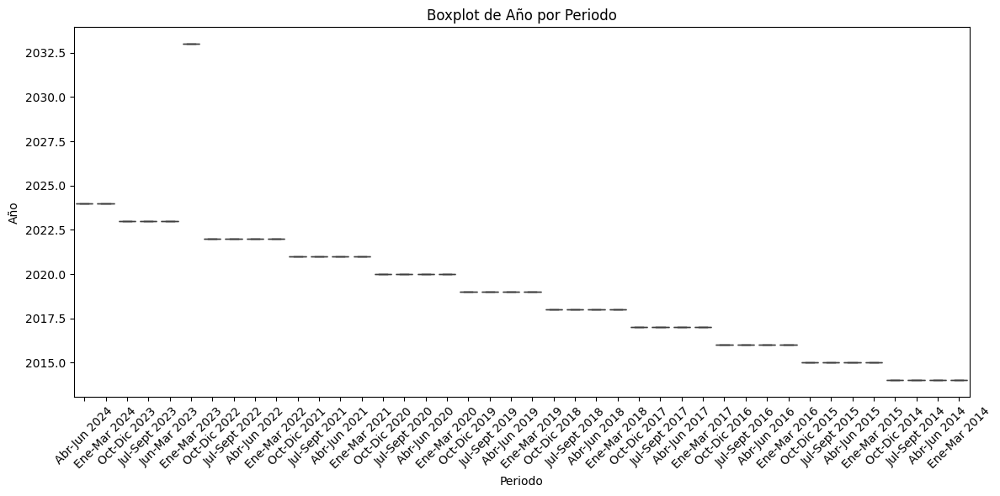


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
               count  mean  std  min  25%  50%  75%  max
Periodo                                                 
Abr-Jun 2014     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2015     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2016     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2017     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2018     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2019     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2020     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2021     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2022     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2024     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Ene-Mar 2014     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2015     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2016     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2017     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2018     1.0 

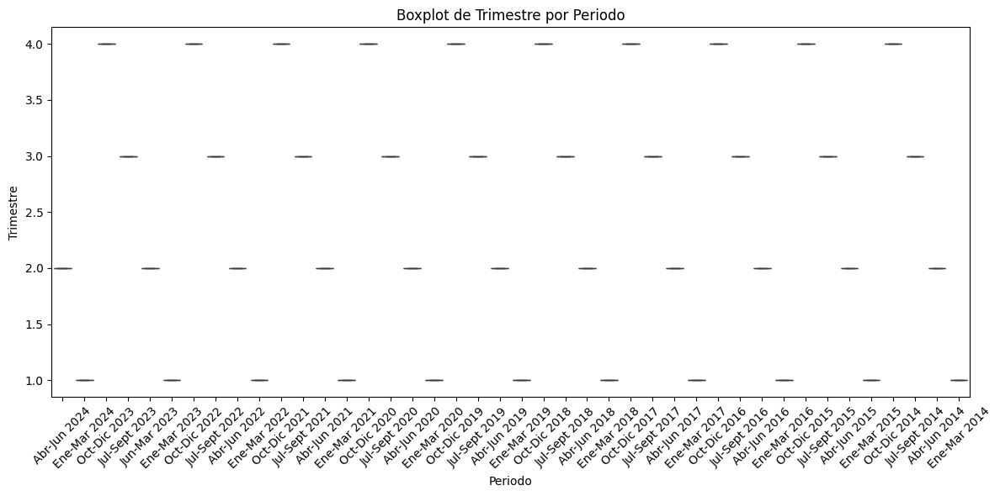


Estadísticas descriptivas de 'Ingresos (miles de pesos)' agrupadas por 'Periodo':
               count          mean  std           min           25%  \
Periodo                                                               
Abr-Jun 2014     1.0  3.270816e+06  NaN  3.270816e+06  3.270816e+06   
Abr-Jun 2015     1.0  4.701791e+06  NaN  4.701791e+06  4.701791e+06   
Abr-Jun 2016     1.0  6.534241e+06  NaN  6.534241e+06  6.534241e+06   
Abr-Jun 2017     1.0  9.678647e+06  NaN  9.678647e+06  9.678647e+06   
Abr-Jun 2018     1.0  1.431947e+07  NaN  1.431947e+07  1.431947e+07   
Abr-Jun 2019     1.0  2.074312e+07  NaN  2.074312e+07  2.074312e+07   
Abr-Jun 2020     1.0  3.210248e+07  NaN  3.210248e+07  3.210248e+07   
Abr-Jun 2021     1.0  3.823967e+07  NaN  3.823967e+07  3.823967e+07   
Abr-Jun 2022     1.0  6.041950e+07  NaN  6.041950e+07  6.041950e+07   
Abr-Jun 2024     1.0  4.420322e+08  NaN  4.420322e+08  4.420322e+08   
Ene-Mar 2014     1.0  2.984054e+06  NaN  2.984054e+06  2.984054e+

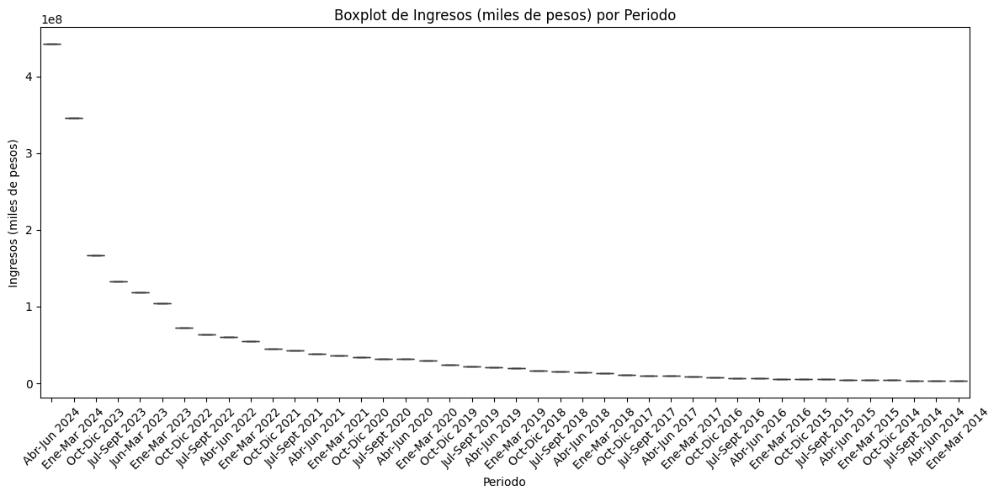


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2024          1.0  2024.0  NaN  2024.0  2024.0  2024.0  2024.0  2024.0
Q1-2033          1.0  2033.0  NaN  2033.0  20

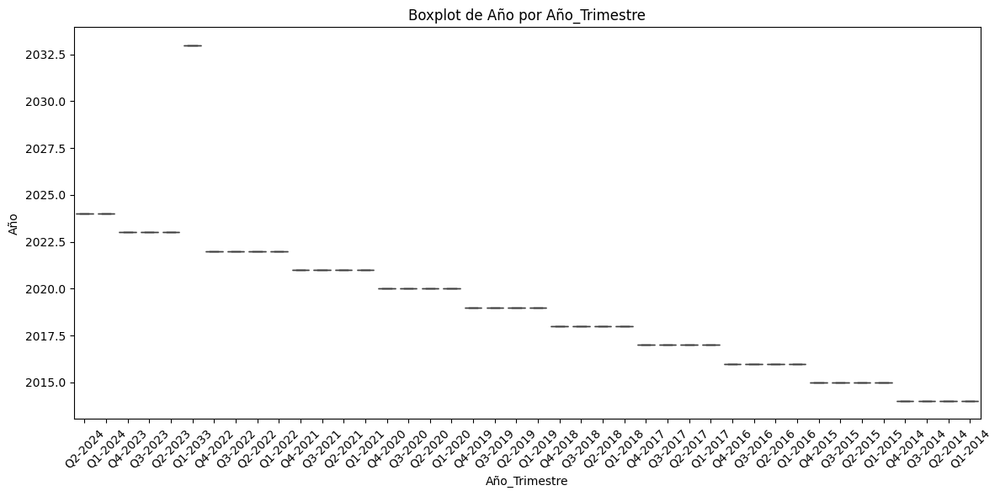


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2033          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

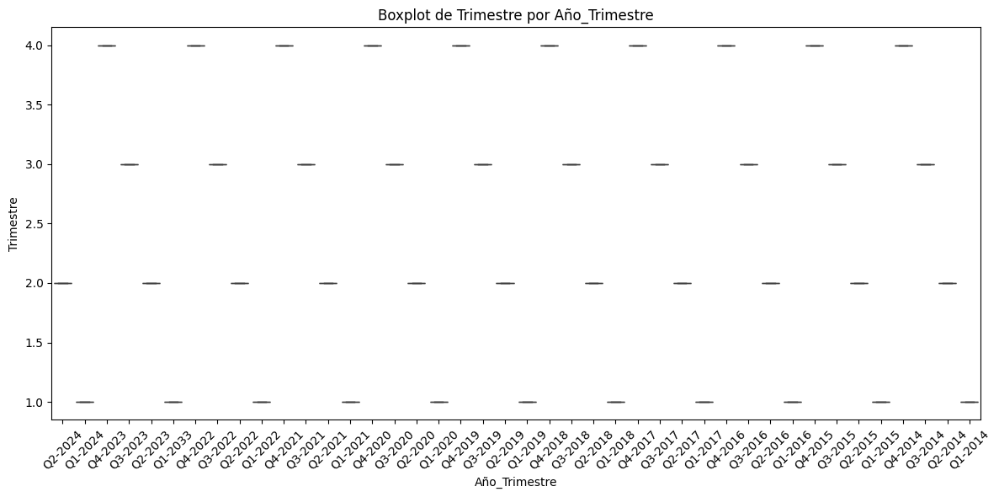


Estadísticas descriptivas de 'Ingresos (miles de pesos)' agrupadas por 'Año_Trimestre':
               count          mean  std           min           25%  \
Año_Trimestre                                                         
Q1-2014          1.0  2.984054e+06  NaN  2.984054e+06  2.984054e+06   
Q1-2015          1.0  4.876385e+06  NaN  4.876385e+06  4.876385e+06   
Q1-2016          1.0  5.936845e+06  NaN  5.936845e+06  5.936845e+06   
Q1-2017          1.0  8.701201e+06  NaN  8.701201e+06  8.701201e+06   
Q1-2018          1.0  1.317146e+07  NaN  1.317146e+07  1.317146e+07   
Q1-2019          1.0  2.020741e+07  NaN  2.020741e+07  2.020741e+07   
Q1-2020          1.0  2.994622e+07  NaN  2.994622e+07  2.994622e+07   
Q1-2021          1.0  3.667637e+07  NaN  3.667637e+07  3.667637e+07   
Q1-2022          1.0  5.521931e+07  NaN  5.521931e+07  5.521931e+07   
Q1-2024          1.0  3.461990e+08  NaN  3.461990e+08  3.461990e+08   
Q1-2033          1.0  1.041350e+08  NaN  1.041350e+08  1.04

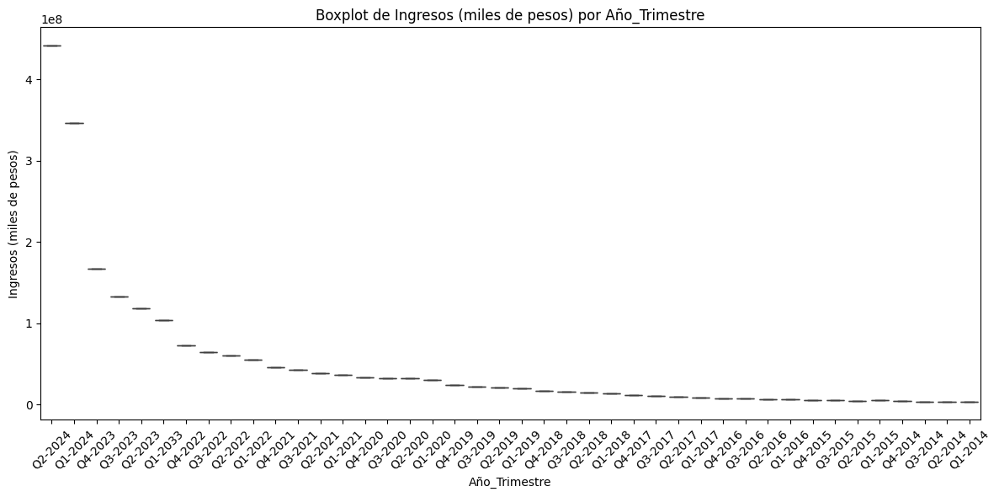


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count         mean       std     min      25%     50%      75%  \
meses_periodo                                                                   
abr - jun       11.0  2019.000000  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.909091  5.300086  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.500000  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.500000  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2033.0  
jul - sep      2023.0  
oct - dic      2023.0  


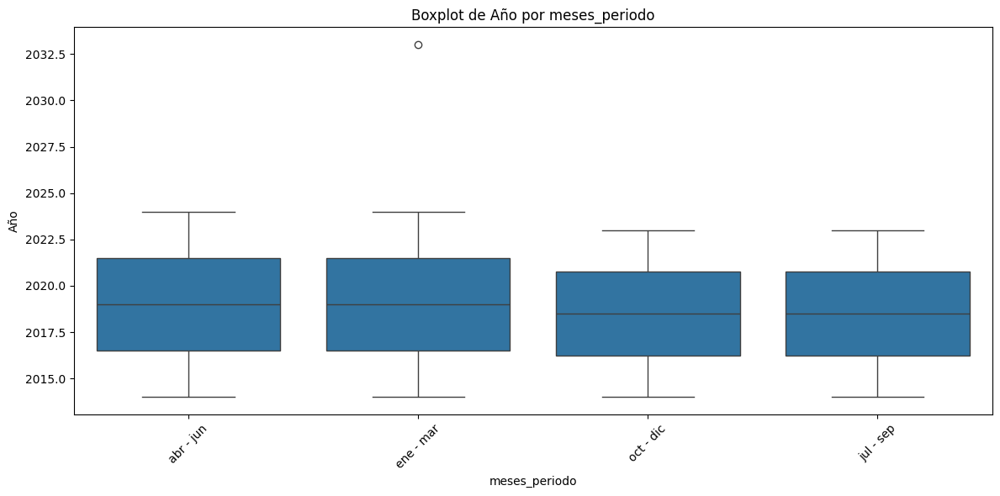


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


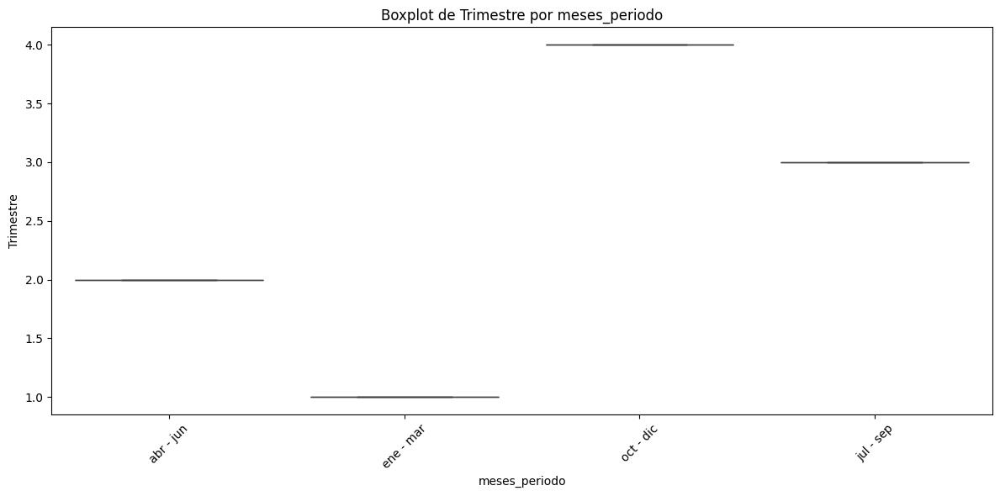


Estadísticas descriptivas de 'Ingresos (miles de pesos)' agrupadas por 'meses_periodo':
               count          mean           std           min           25%  \
meses_periodo                                                                  
abr - jun       11.0  6.819111e+07  1.285022e+08  3.270816e+06  8.106444e+06   
ene - mar       11.0  5.709575e+07  1.004267e+08  2.984054e+06  7.319023e+06   
jul - sep       10.0  3.348653e+07  3.996935e+07  3.478638e+06  7.700831e+06   
oct - dic       10.0  3.876715e+07  5.001514e+07  3.950441e+06  8.419517e+06   

                        50%           75%           max  
meses_periodo                                            
abr - jun      2.074312e+07  4.932958e+07  4.420322e+08  
ene - mar      2.020741e+07  4.594784e+07  3.461990e+08  
jul - sep      1.853186e+07  4.024932e+07  1.331066e+08  
oct - dic      2.040347e+07  4.248584e+07  1.673760e+08  


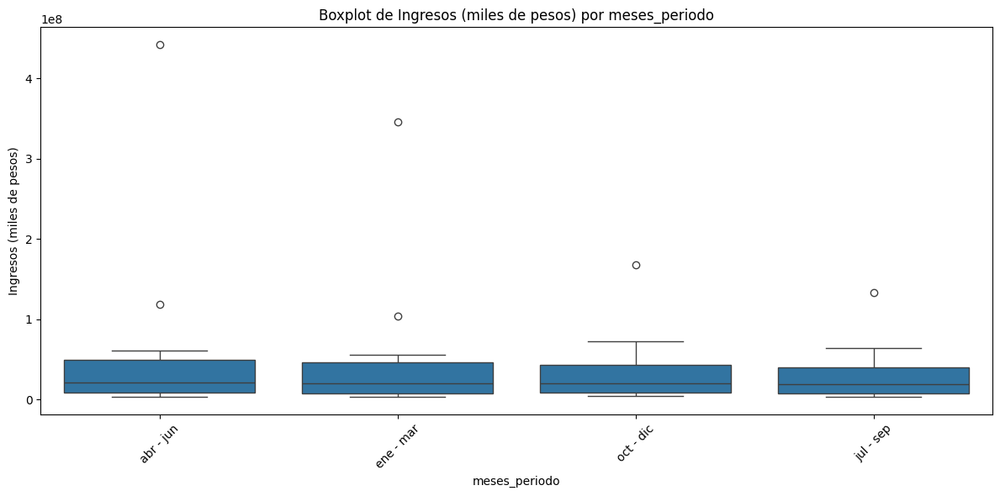

In [27]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [28]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
         Año  Trimestre  Ingresos (miles de pesos)
0   1.357242  -0.404989                   4.555202
1   1.357242  -1.300229                   3.441625
2   1.085793   1.385490                   1.363712
3   1.085793   0.490250                   0.965503
4   1.085793  -0.404989                   0.790665
5   3.800277  -1.300229                   0.628854
6   0.814345   1.385490                   0.260601
7   0.814345   0.490250                   0.163496
8   0.814345  -0.404989                   0.120883
9   0.814345  -1.300229                   0.060457
10  0.542897   1.385490                  -0.052854
11  0.542897   0.490250                  -0.081532
12  0.542897  -0.404989                  -0.136846
13  0.542897  -1.300229                  -0.155011
14  0.271448   1.385490                  -0.191459
15  0.271448   0.490250                  -0.209380
16  0.271448  -0.404989                  -0.208160
17  0.271448  -1.300229                  -0.2

In [29]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Periodo':
Periodo
Abr-Jun 2024     1
Ene-Mar 2024     1
Oct-Dic 2023     1
Jul-Sept 2023    1
Jun-Mar 2023     1
Ene-Mar 2023     1
Oct-Dic 2022     1
Jul-Sept 2022    1
Abr-Jun 2022     1
Ene-Mar 2022     1
Oct-Dic 2021     1
Jul-Sept 2021    1
Abr-Jun 2021     1
Ene-Mar 2021     1
Oct-Dic 2020     1
Jul-Sept 2020    1
Abr-Jun 2020     1
Ene-Mar 2020     1
Oct-Dic 2019     1
Jul-Sept 2019    1
Abr-Jun 2019     1
Ene-Mar 2019     1
Oct-Dic 2018     1
Jul-Sept 2018    1
Abr-Jun 2018     1
Ene-Mar 2018     1
Oct-Dic 2017     1
Jul-Sept 2017    1
Abr-Jun 2017     1
Ene-Mar 2017     1
Oct-Dic 2016     1
Jul-Sept 2016    1
Abr-Jun 2016     1
Ene-Mar 2016     1
Oct-Dic 2015     1
Jul-Sept 2015    1
Abr-Jun 2015     1
Ene-Mar 2015     1
Oct-Dic 2014     1
Jul-Sept 2014    1
Abr-Jun 2014     1
Ene-Mar 2014     1
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    1
Q1-2024    1
Q4-2023    1
Q3-2023    1
Q2

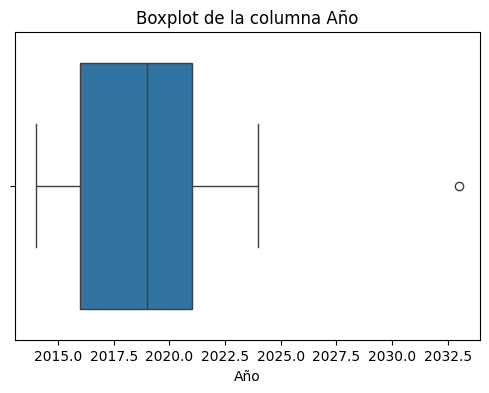

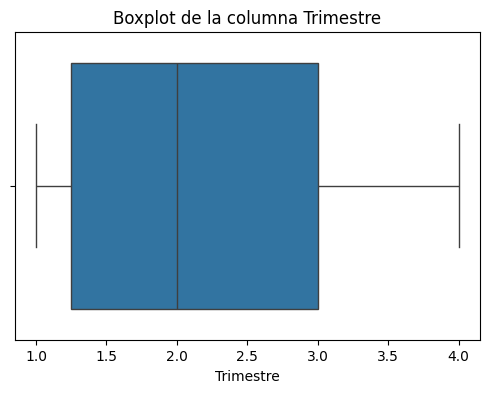

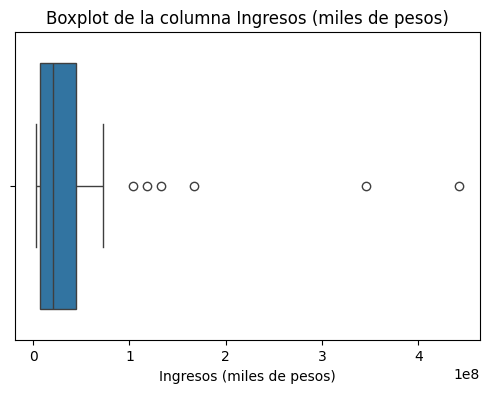

In [30]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [31]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Ingresos .csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Ingresos .csv


In [32]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [33]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                          1.200536
Trimestre                    0.070729
Ingresos (miles de pesos)    3.381631
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                           3.303769
Trimestre                    -1.371727
Ingresos (miles de pesos)    12.292935
dtype: float64


In [34]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                    Variable            VIF
0                      const  468453.119116
1                        Año       1.560578
2                  Trimestre       1.022821
3  Ingresos (miles de pesos)       1.548748


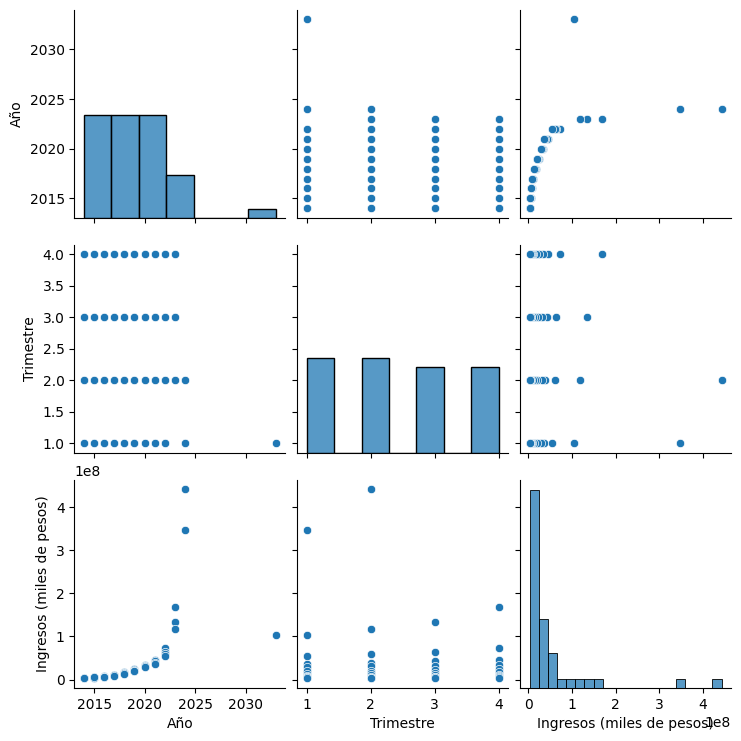

In [35]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [36]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Periodo':
                Año                                                      \
              count    mean std     min     25%     50%     75%     max   
Periodo                                                                   
Abr-Jun 2014    1.0  2014.0 NaN  2014.0  2014.0  2014.0  2014.0  2014.0   
Abr-Jun 2015    1.0  2015.0 NaN  2015.0  2015.0  2015.0  2015.0  2015.0   
Abr-Jun 2016    1.0  2016.0 NaN  2016.0  2016.0  2016.0  2016.0  2016.0   
Abr-Jun 2017    1.0  2017.0 NaN  2017.0  2017.0  2017.0  2017.0  2017.0   
Abr-Jun 2018    1.0  2018.0 NaN  2018.0  2018.0  2018.0  2018.0  2018.0   
Abr-Jun 2019    1.0  2019.0 NaN  2019.0  2019.0  2019.0  2019.0  2019.0   
Abr-Jun 2020    1.0  2020.0 NaN  2020.0  2020.0  2020.0  2020.0  2020.0   
Abr-Jun 2021    1.0  2021.0 NaN  2021.0  2021.0  2021.0  2021.0  2021.0   
Abr-Jun 2022    1.0  2022.0 NaN  2022.0  2022.0  2022.0  2022.0  2022.0   
Abr-Jun 2024    1.0  2024.0 NaN  2024.0  2024.0  2024.0  2024.

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Velocidad % por prov.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre        Provincia  Mbps (Media de bajada)
0  2024          2     Buenos Aires                  157.41
1  2024          2  Capital Federal                  233.01
2  2024          2        Catamarca                   97.38
3  2024          2            Chaco                  107.76
4  2024          2           Chubut                   21.67


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1008 entries, 0 to 1007
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     1008 non-null   int64  
 1   Trimestre               1008 non-null   int64  
 2   Provincia               1008 non-null   object 
 3   Mbps (Media de bajada)  1008 non-null   float64
dtypes: float64(1), int64(2), object(1)
memory usage: 31.6+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

       Año  Trimestre Año_Trimestre meses_periodo
0     2024          2       Q2-2024     abr - jun
1     2024          2       Q2-2024     abr - jun
2     2024          2       Q2-2024     abr - jun
3     2024          2       Q2-2024     abr - jun
4     2024          2       Q2-2024     abr - jun
...    ...        ...           ...           ...
1003  2014          1       Q1-2014     ene - mar
1004  2014          1       Q1-2014     ene - mar
1005  2014          1       Q1-2014     ene - mar
1006  2014          1       Q1-2014     ene - mar
1007  2014          1       Q1-2014     ene - mar

[1008 rows x 4 columns]


In [5]:
print(df.head())

    Año  Trimestre        Provincia  Mbps (Media de bajada) Año_Trimestre  \
0  2024          2     Buenos Aires                  157.41       Q2-2024   
1  2024          2  Capital Federal                  233.01       Q2-2024   
2  2024          2        Catamarca                   97.38       Q2-2024   
3  2024          2            Chaco                  107.76       Q2-2024   
4  2024          2           Chubut                   21.67       Q2-2024   

      Periodo meses_periodo  
0  01-03-2024     abr - jun  
1  01-03-2024     abr - jun  
2  01-03-2024     abr - jun  
3  01-03-2024     abr - jun  
4  01-03-2024     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                         int64
Trimestre                   int64
Provincia                  object
Mbps (Media de bajada)    float64
Año_Trimestre              object
Periodo                    object
meses_periodo              object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1008 entries, 0 to 1007
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     1008 non-null   int64  
 1   Trimestre               1008 non-null   int64  
 2   Provincia               1008 non-null   object 
 3   Mbps (Media de bajada)  1008 non-null   float64
 4   Año_Trimestre           1008 non-null   object 
 5   Periodo                 1008 non-null   object 
 6   meses_periodo           1008 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 55.3+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1008 entries, 0 to 1007
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     1008 non-null   int64  
 1   Trimestre               1008 non-null   int64  
 2   Provincia               1008 non-null   object 
 3   Mbps (Media de bajada)  1008 non-null   float64
 4   Año_Trimestre           1008 non-null   object 
 5   Periodo                 1008 non-null   object 
 6   meses_periodo           1008 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 55.3+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1008 entries, 0 to 1007
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     1008 non-null   int64  
 1   Trimestre               1008 non-null   int64  
 2   Provincia               1008 non-null   object 
 3   Mbps (Media de bajada)  1008 non-null   float64
 4   Año_Trimestre           1008 non-null   object 
 5   Periodo                 1008 non-null   object 
 6   meses_periodo           1008 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 55.3+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                       0
Trimestre                 0
Provincia                 0
Mbps (Media de bajada)    0
Año_Trimestre             0
Periodo                   0
meses_periodo             0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                       0
Trimestre                 0
Provincia                 0
Mbps (Media de bajada)    0
Año_Trimestre             0
Periodo                   0
meses_periodo             0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                       0
Trimestre                 0
Provincia                 0
Mbps (Media de bajada)    0
Año_Trimestre             0
Periodo                   0
meses_periodo             0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1008 entries, 0 to 1007
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     1008 non-null   int64  
 1   Trimestre               1008 non-null   int64  
 2   Provincia               1008 non-null   object 
 3   Mbps (Media de bajada)  1008 non-null   float64
 4   Año_Trimestre           1008 non-null   object 
 5   Periodo                 1008 non-null   object 
 6   meses_periodo           1008 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 55.3+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia  Mbps (Media de bajada)  \
count   1008.000000  1008.000000          1008             1008.000000   
unique          NaN          NaN            23                     NaN   
top             NaN          NaN  BUENOS AIRES                     NaN   
freq            NaN          NaN            84                     NaN   
mean    2018.761905     2.452381           NaN               24.720245   
std        3.039439     1.117574           NaN               33.660764   
min     2014.000000     1.000000           NaN                2.573729   
25%     2016.000000     1.000000           NaN                4.866698   
50%     2019.000000     2.000000           NaN               10.089315   
75%     2021.000000     3.000000           NaN               29.875292   
max     2024.000000     4.000000           NaN              234.440000   

       Año_Trimestre     Periodo mese

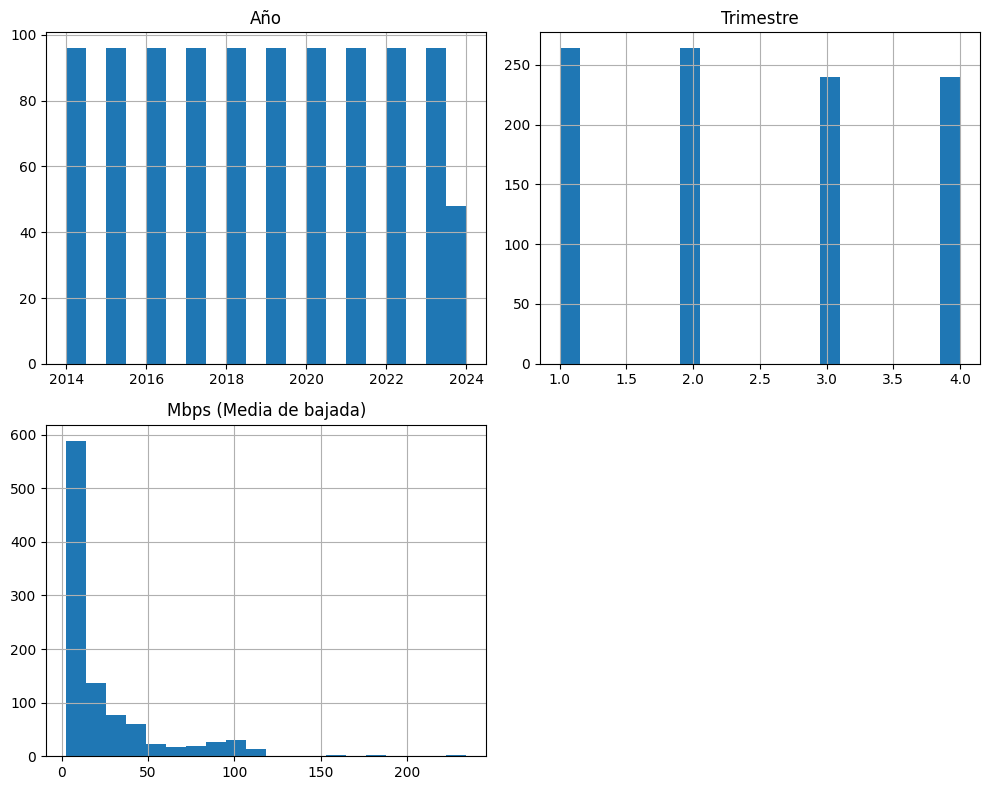

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                             Año  Trimestre  Mbps (Media de bajada)
Año                     1.000000  -0.073505                0.684354
Trimestre              -0.073505   1.000000               -0.005655
Mbps (Media de bajada)  0.684354  -0.005655                1.000000

Correlaciones fuertes:
                        Año  Trimestre  Mbps (Media de bajada)
Año                     1.0        NaN                     NaN
Trimestre               NaN        1.0                     NaN
Mbps (Media de bajada)  NaN        NaN                     1.0


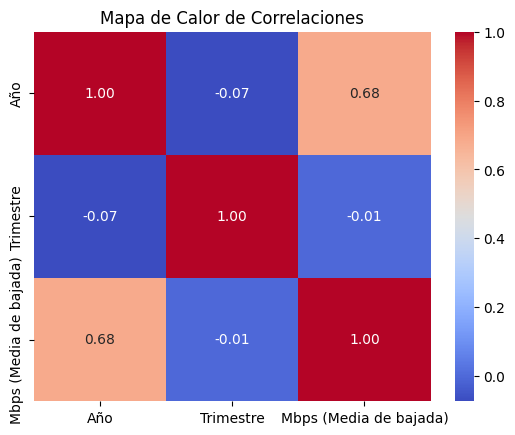

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               2        2        2        2        2        2   
CATAMARCA                  1        1        1        1        1        1   
CHACO                      1        1        1        1        1        1   
CHUBUT                     1        1        1        1        1        1   
CORRIENTES                 1        1        1        1        1        1   
CÓRDOBA                    1        1        1        1        1        1   
ENTRE RÍOS                 1        1        1        1        1        1   
FORMOSA                    1        1        1        1        1        1   
JUJUY                      1        1        1        1        1        1   
LA PAMPA                   1        1        1        1        1        1   
LA RIOJA            

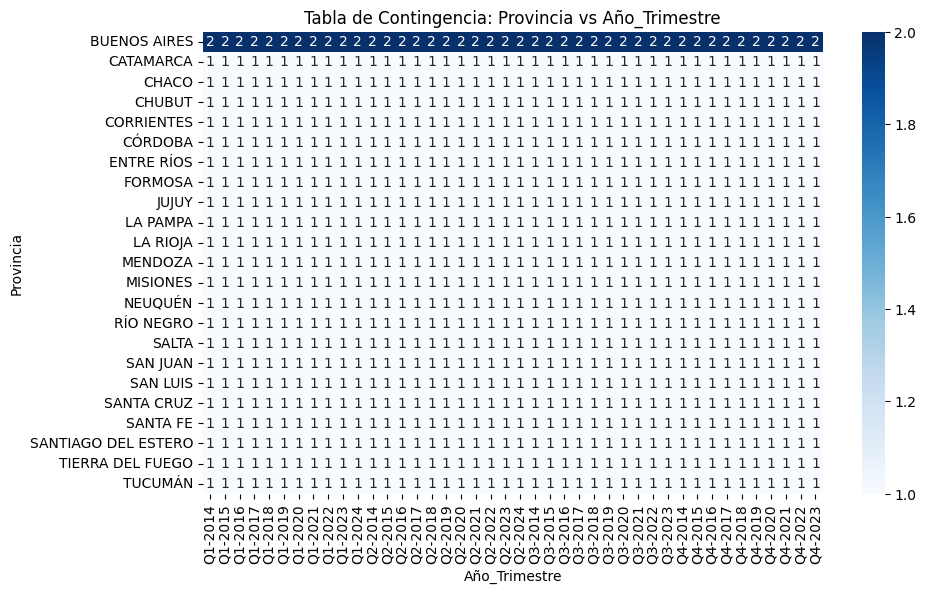


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                 84
CATAMARCA                    42
CHACO                        42
CHUBUT                       42
CORRIENTES                   42
CÓRDOBA                      42
ENTRE RÍOS                   42
FORMOSA                      42
JUJUY                        42
LA PAMPA                     42
LA RIOJA                     42
MENDOZA                      42
MISIONES                     42
NEUQUÉN                      42
RÍO NEGRO                    42
SALTA                        42
SAN JUAN                     42
SAN LUIS                     42
SANTA CRUZ                   42
SANTA FE                     42
SANTIAGO DEL ESTERO          42
TIERRA DEL FUEGO             42
TUCUMÁN                      42


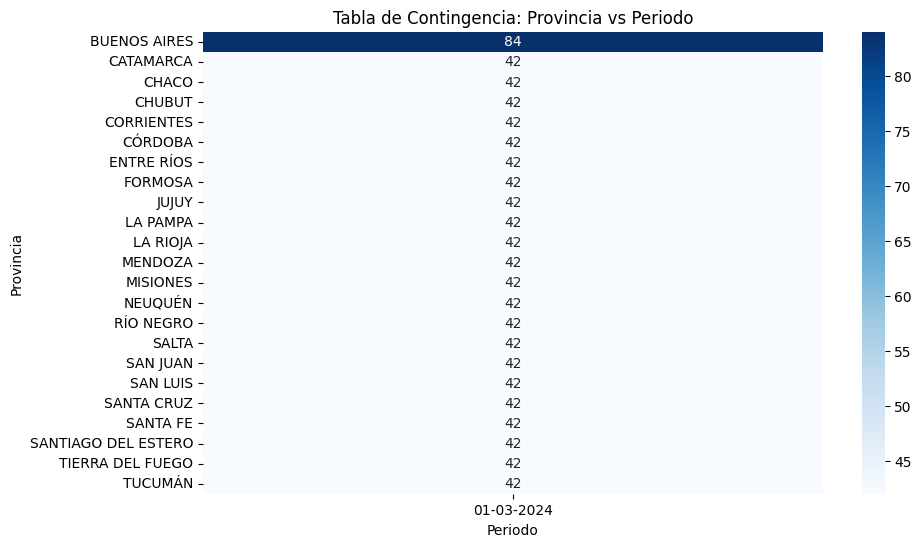


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                22         22         20         20
CATAMARCA                   11         11         10         10
CHACO                       11         11         10         10
CHUBUT                      11         11         10         10
CORRIENTES                  11         11         10         10
CÓRDOBA                     11         11         10         10
ENTRE RÍOS                  11         11         10         10
FORMOSA                     11         11         10         10
JUJUY                       11         11         10         10
LA PAMPA                    11         11         10         10
LA RIOJA                    11         11         10         10
MENDOZA                     11         11         10         10
MISIONES                    11         11       

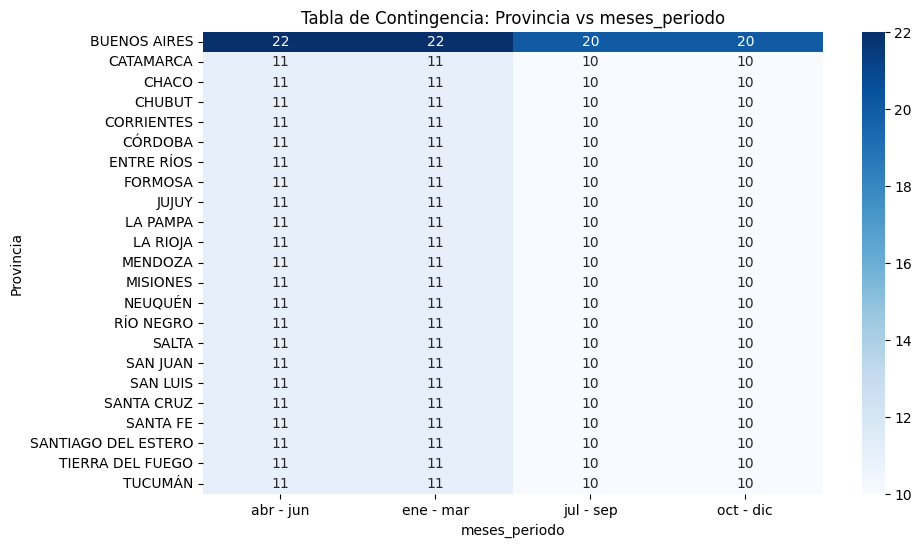


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                24
Q1-2015                24
Q1-2016                24
Q1-2017                24
Q1-2018                24
Q1-2019                24
Q1-2020                24
Q1-2021                24
Q1-2022                24
Q1-2023                24
Q1-2024                24
Q2-2014                24
Q2-2015                24
Q2-2016                24
Q2-2017                24
Q2-2018                24
Q2-2019                24
Q2-2020                24
Q2-2021                24
Q2-2022                24
Q2-2023                24
Q2-2024                24
Q3-2014                24
Q3-2015                24
Q3-2016                24
Q3-2017                24
Q3-2018                24
Q3-2019                24
Q3-2020                24
Q3-2021                24
Q3-2022                24
Q3-2023                24
Q4-2014                24
Q4-2015                24
Q4-2016   

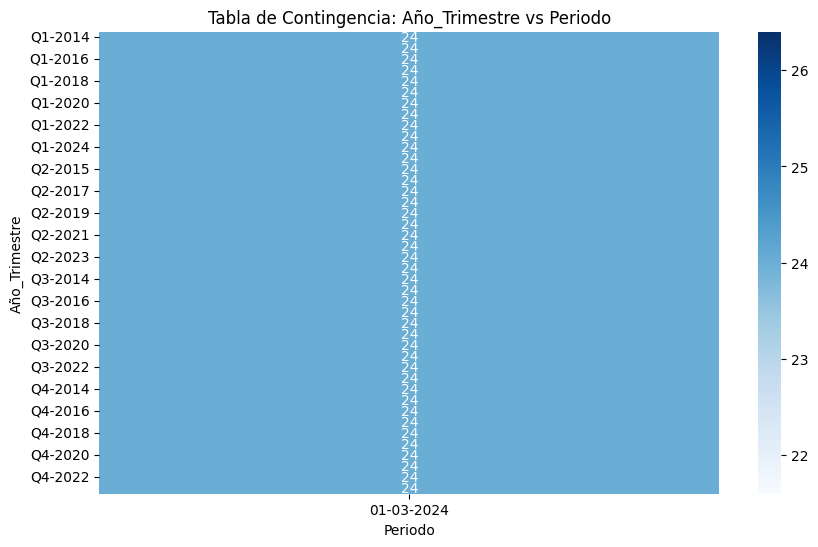


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         24          0          0
Q1-2015                0         24          0          0
Q1-2016                0         24          0          0
Q1-2017                0         24          0          0
Q1-2018                0         24          0          0
Q1-2019                0         24          0          0
Q1-2020                0         24          0          0
Q1-2021                0         24          0          0
Q1-2022                0         24          0          0
Q1-2023                0         24          0          0
Q1-2024                0         24          0          0
Q2-2014               24          0          0          0
Q2-2015               24          0          0          0
Q2-2016               24          0          0          0
Q2-2017     

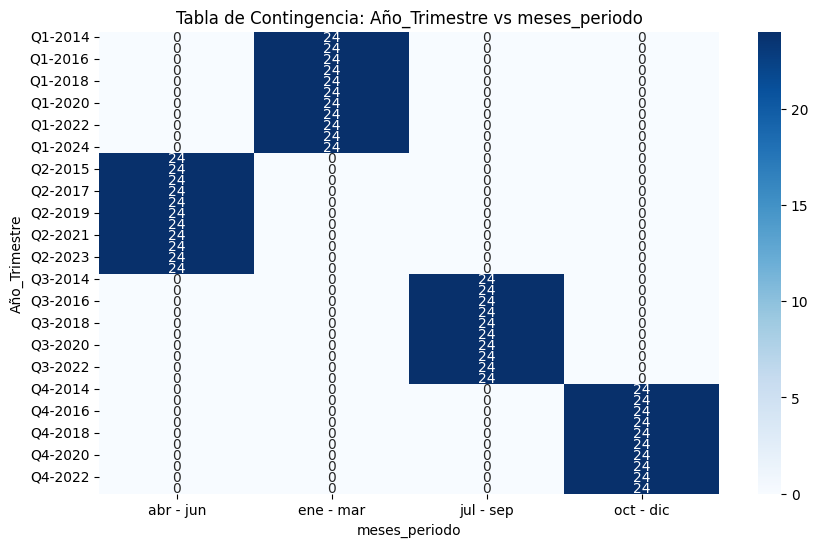


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           264        264        240        240


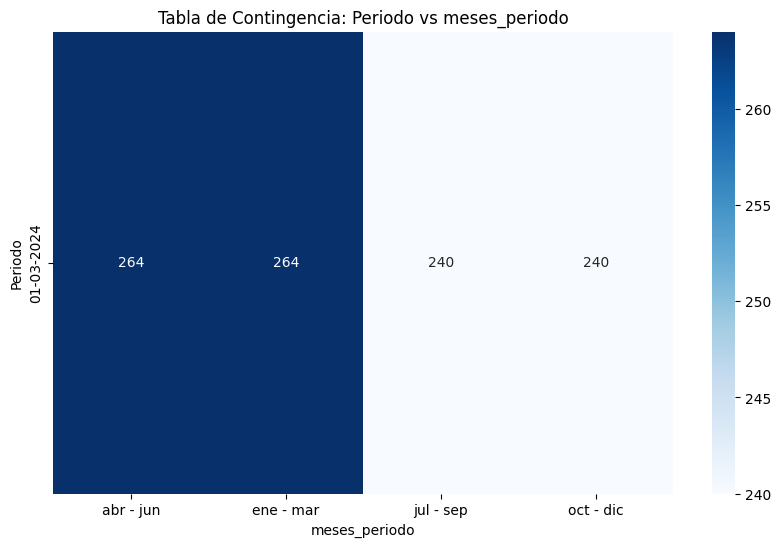

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES          84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA             42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA RIOJA     

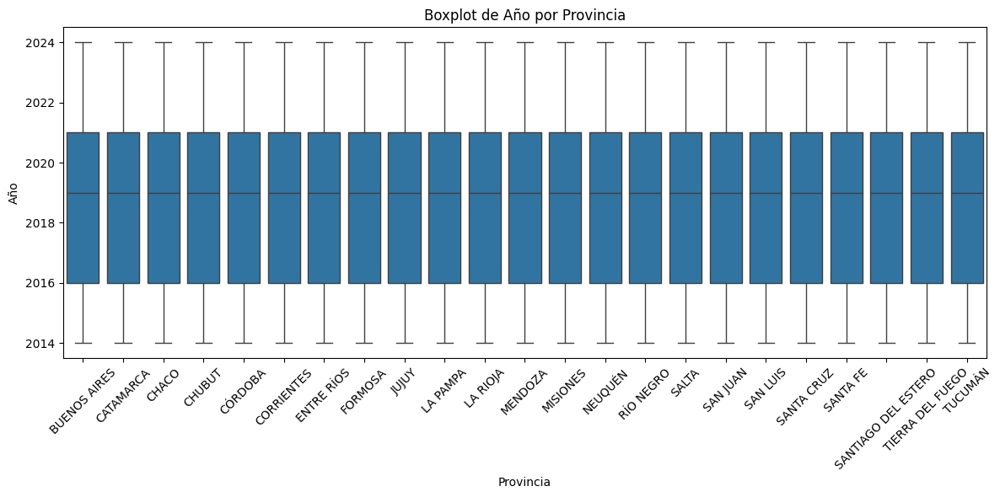


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min   25%  50%  75%  max
Provincia                                                               
BUENOS AIRES          84.0  2.452381  1.123728  1.0  1.00  2.0  3.0  4.0
CATAMARCA             42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHACO                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHUBUT                42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CORRIENTES            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CÓRDOBA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
ENTRE RÍOS            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
FORMOSA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
JUJUY                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA PAMPA              42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA RIOJA              42.0  2.452381  1.130560  1.0  1.

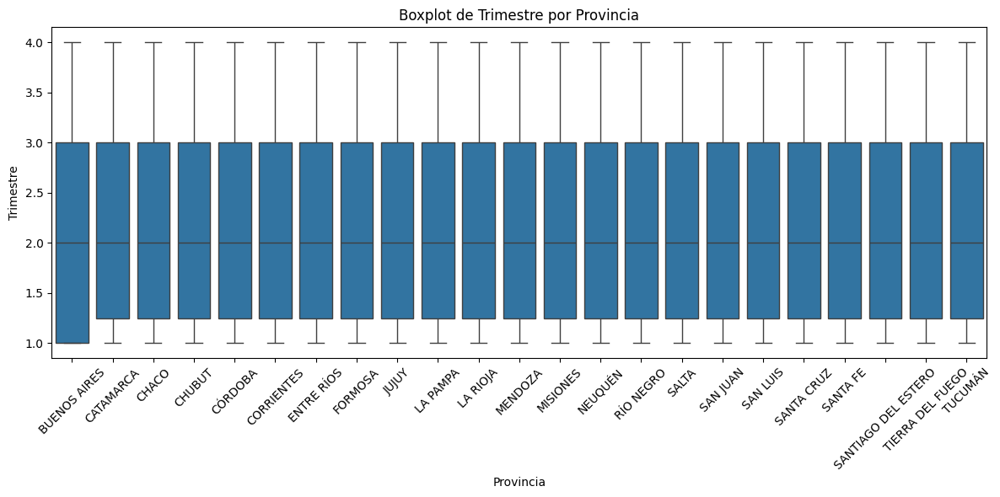


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'Provincia':
                     count       mean        std       min       25%  \
Provincia                                                              
BUENOS AIRES          84.0  53.666755  63.350391  3.733133  6.520051   
CATAMARCA             42.0  29.836084  31.765751  2.802734  4.765359   
CHACO                 42.0  32.950653  35.930573  3.255837  6.808048   
CHUBUT                42.0   8.194332   5.861151  3.156405  3.386546   
CORRIENTES            42.0  29.335323  33.563845  3.218625  6.027706   
CÓRDOBA               42.0  35.077366  38.190639  3.387405  6.168080   
ENTRE RÍOS            42.0  27.630180  32.228293  3.167290  5.641658   
FORMOSA               42.0  23.286574  26.586645  2.573729  5.469767   
JUJUY                 42.0  17.209240  15.414495  2.690263  4.242459   
LA PAMPA              42.0   9.291688   7.883285  2.647210  3.156941   
LA RIOJA              42.0  20.795860  22.883301  2.96

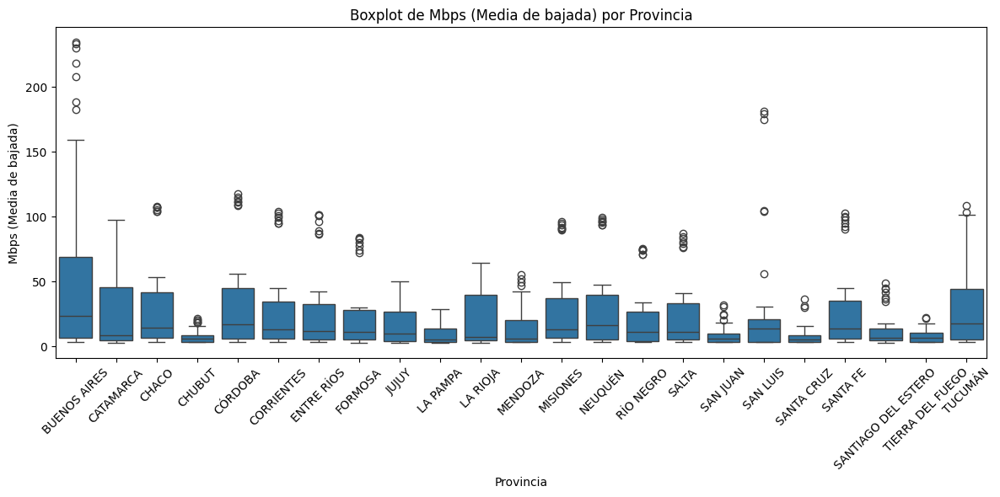


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         24.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         24.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         24.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         24.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         24.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         24.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         24.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         24.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         24.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         24.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         24.0  2024.0  0.0  2024.0  20

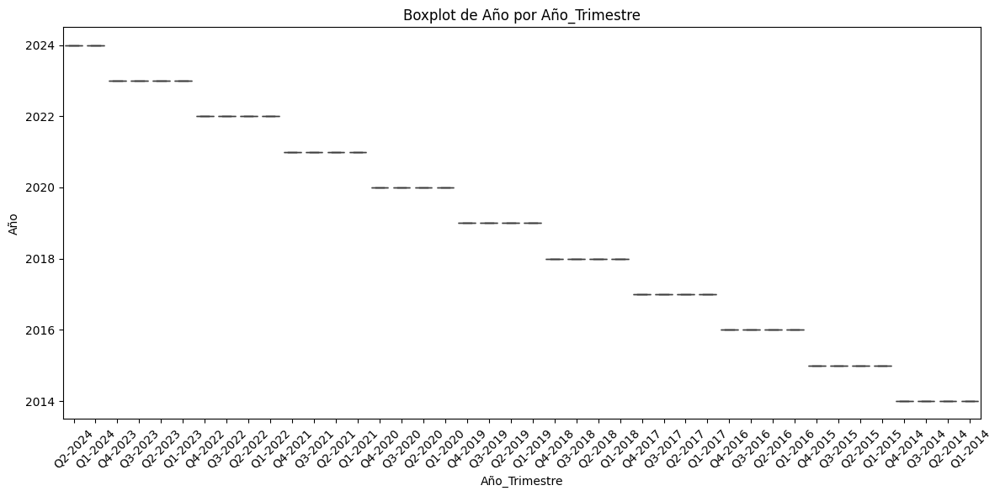


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

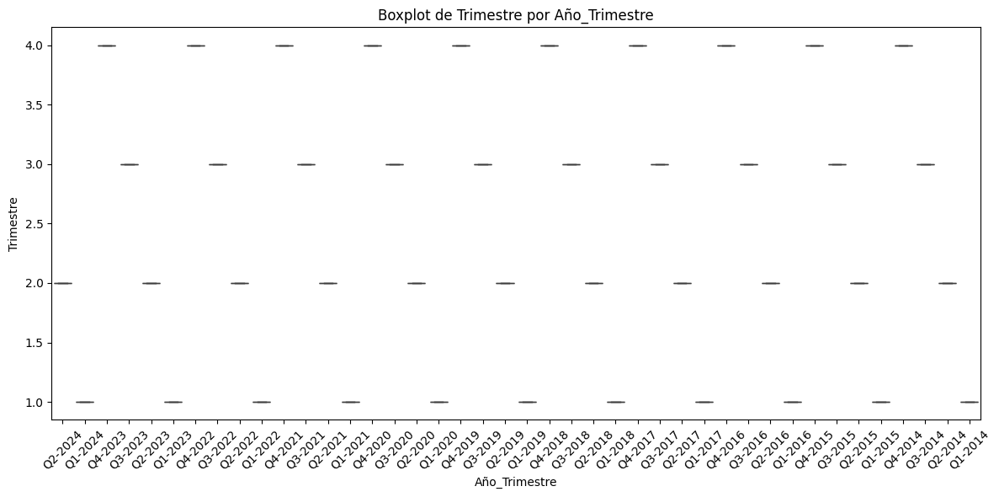


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'Año_Trimestre':
               count       mean        std        min        25%        50%  \
Año_Trimestre                                                                 
Q1-2014         24.0   3.241284   0.344290   2.573729   3.101740   3.278370   
Q1-2015         24.0   3.876675   0.592553   2.834100   3.476296   3.682850   
Q1-2016         24.0   4.460451   0.906107   3.047642   3.502893   4.518734   
Q1-2017         24.0   5.273347   1.487307   3.220814   3.570771   5.381276   
Q1-2018         24.0   9.043488   3.473166   3.995131   5.888522   9.082842   
Q1-2019         24.0  10.762038   5.002597   5.057862   6.396578  10.101095   
Q1-2020         24.0  20.187731  12.956415   6.036985   8.321256  19.799650   
Q1-2021         24.0  25.041744  14.986392   6.910090  12.345565  24.474080   
Q1-2022         24.0  34.711250  18.508294  10.730000  19.422500  36.150000   
Q1-2023         24.0  71.260833  41.245015  1

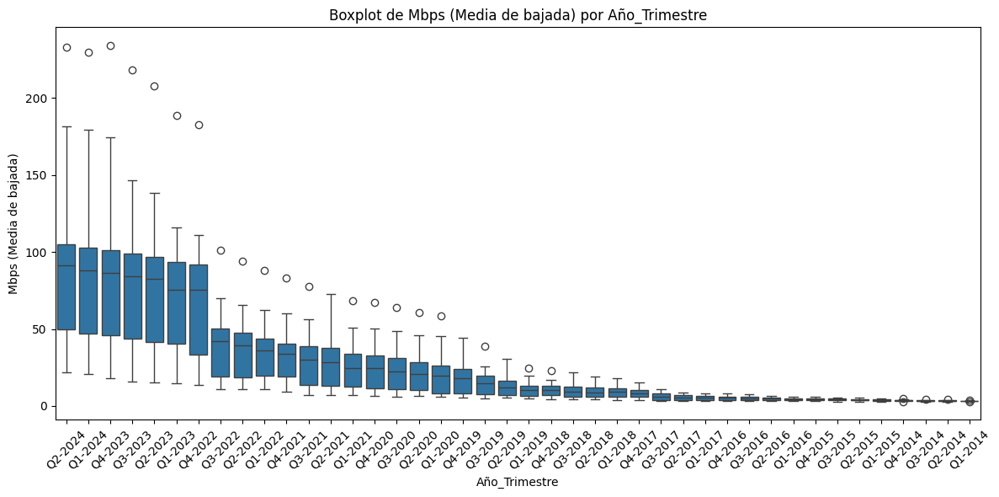


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count         mean       std     min     25%     50%     75%  \
Periodo                                                                     
01-03-2024  1008.0  2018.761905  3.039439  2014.0  2016.0  2019.0  2021.0   

               max  
Periodo             
01-03-2024  2024.0  


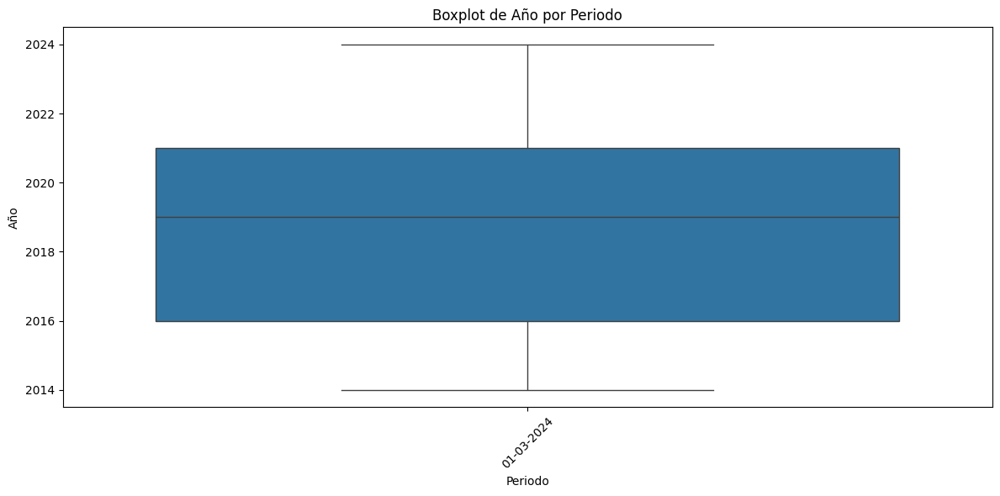


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count      mean       std  min  25%  50%  75%  max
Periodo                                                        
01-03-2024  1008.0  2.452381  1.117574  1.0  1.0  2.0  3.0  4.0


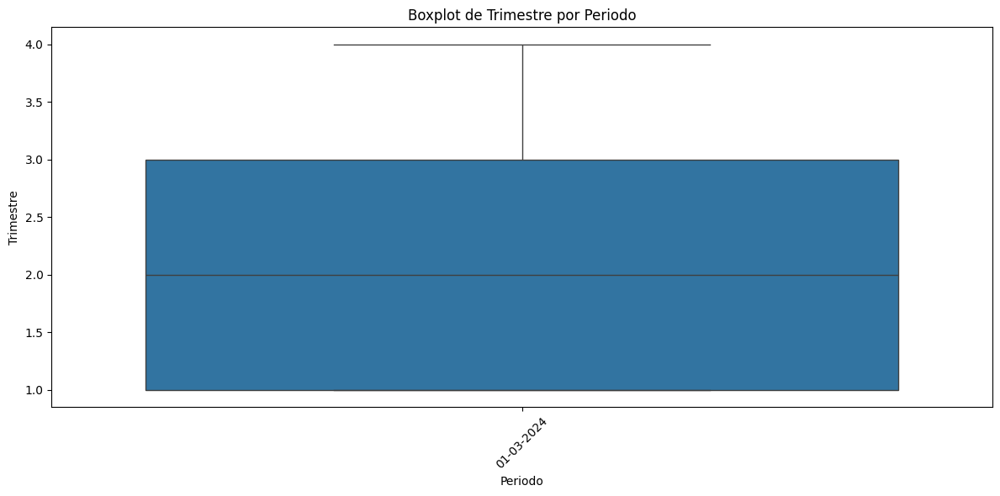


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'Periodo':
             count       mean        std       min       25%        50%  \
Periodo                                                                   
01-03-2024  1008.0  24.720245  33.660764  2.573729  4.866698  10.089315   

                  75%     max  
Periodo                        
01-03-2024  29.875292  234.44  


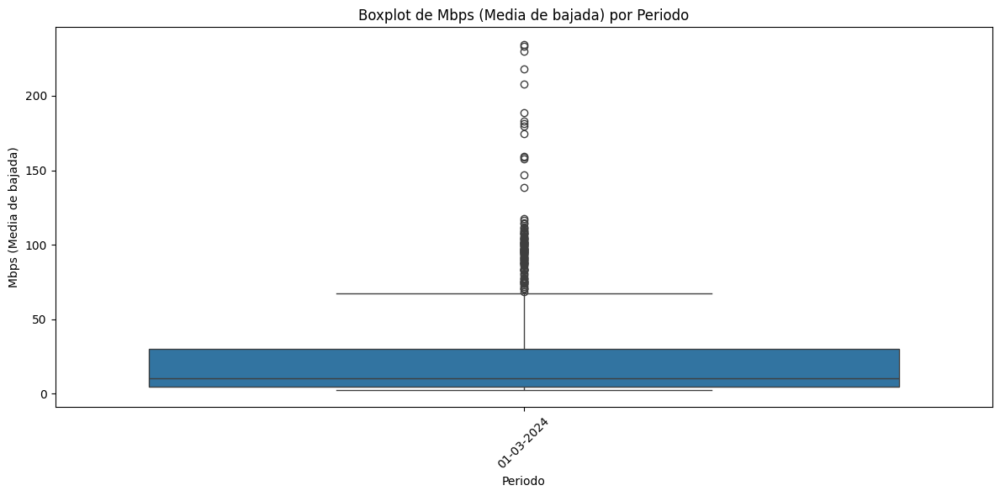


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min     25%     50%     75%     max
meses_periodo                                                                 
abr - jun      264.0  2019.0  3.168284  2014.0  2016.0  2019.0  2022.0  2024.0
ene - mar      264.0  2019.0  3.168284  2014.0  2016.0  2019.0  2022.0  2024.0
jul - sep      240.0  2018.5  2.878284  2014.0  2016.0  2018.5  2021.0  2023.0
oct - dic      240.0  2018.5  2.878284  2014.0  2016.0  2018.5  2021.0  2023.0


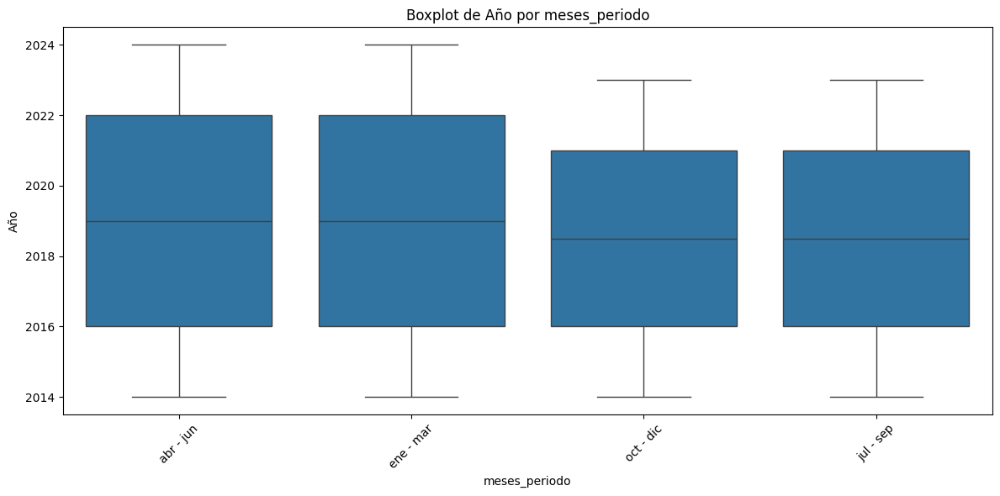


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      264.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      264.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      240.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      240.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


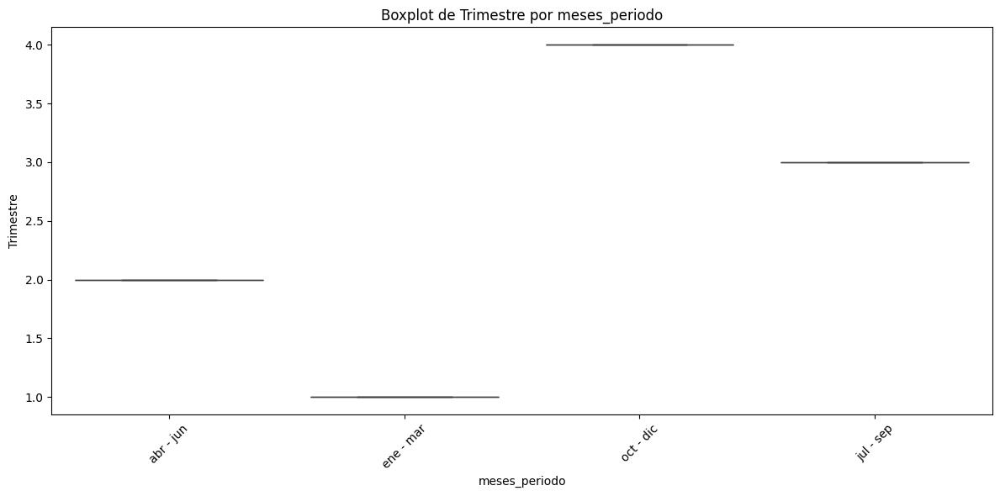


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'meses_periodo':
               count       mean        std       min       25%        50%  \
meses_periodo                                                               
abr - jun      264.0  26.350862  35.854019  2.652351  4.767727  10.857132   
ene - mar      264.0  24.899478  34.520522  2.573729  4.575093   9.590361   
jul - sep      240.0  21.434072  28.390991  2.656283  4.697700   9.190711   
oct - dic      240.0  26.015585  35.021232  2.754209  5.207590  10.707928   

                     75%     max  
meses_periodo                     
abr - jun      30.773307  233.01  
ene - mar      29.197866  229.94  
jul - sep      25.682270  218.13  
oct - dic      30.694924  234.44  


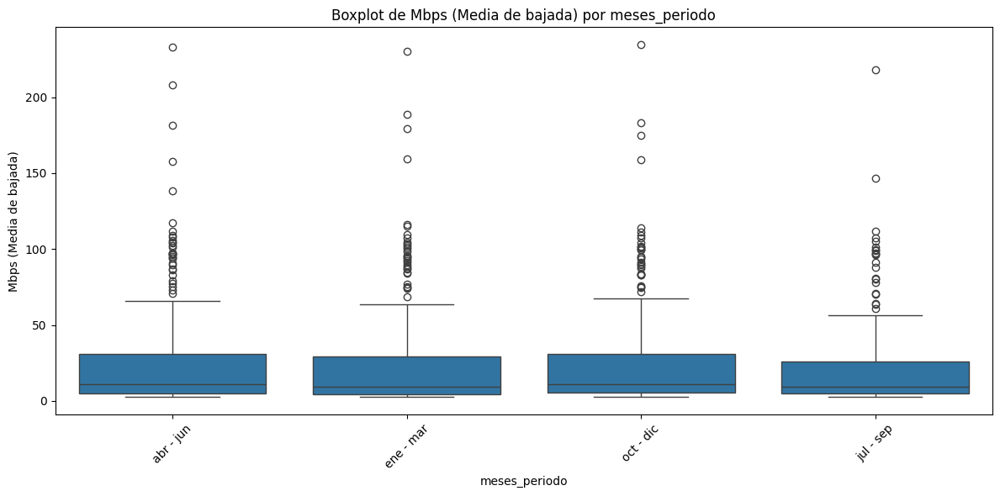

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

Este gráfico ""Mbps (Media de bajada)' agrupadas por 'Provincia'"" refleja una desigualdad significativa en las velocidades de internet entre las provincias argentinas.
Algunas provincias como Buenos Aires tienen velocidades más altas y más variables, posiblemente debido a una mayor densidad de población y opciones de proveedores.
Provincias con velocidades bajas y menos dispersión, como Formosa o Santiago del Estero, podrían reflejar limitaciones en la infraestructura o acceso a tecnología de internet de alta velocidad.


Observaciones principales 'Mbps (Media de bajada)' agrupadas por 'Año_Trimestre':
Tendencia decreciente:

Se aprecia una disminución consistente en las velocidades de bajada desde el Q2 de 2014 hasta aproximadamente el Q4 de 2023.
Los valores máximos, la mediana y la dispersión de los datos decrecen gradualmente, indicando una posible pérdida de calidad promedio del servicio de internet a lo largo del tiempo.
Mayor dispersión en los primeros trimestres:

En los años iniciales (2014-2018), los datos presentan una mayor variabilidad, con numerosos valores atípicos (outliers) por encima del límite superior de los bigotes. Esto podría indicar que había áreas con velocidades significativamente mejores que el promedio.
Homogeneización reciente:

A partir de 2020, los boxplots muestran cajas más compactas y menos dispersión, lo que sugiere una cierta uniformidad en las velocidades ofrecidas, aunque estas son más bajas en comparación con los años iniciales.
Outliers (valores atípicos):

Hasta 2023, todavía hay valores atípicos que superan los 50 Mbps en algunos trimestres, lo que podría representar casos excepcionales de proveedores o regiones con mejor infraestructura.
Velocidades bajas constantes:

En los últimos trimestres (2024), la mediana se mantiene muy baja, y casi no hay valores atípicos elevados, lo que indica un estancamiento o caída generalizada en la calidad del servicio.
Hipótesis y posibles explicaciones:
La disminución en las velocidades podría estar relacionada con factores como:
Sobrecarga de redes: Incremento en la cantidad de usuarios sin una expansión proporcional de la infraestructura.
Limitaciones tecnológicas: Falta de actualizaciones en equipos y servicios ofrecidos.
Políticas comerciales: Cambios en los planes ofrecidos por los proveedores.
Es posible que la reducción en la dispersión indique una estandarización de servicios hacia velocidades más accesibles y uniformes


In [96]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
            Año  Trimestre  Velocidad   Accesos
0      1.553843  -0.423858  -0.055770 -0.190503
1      1.553843  -0.423858  -0.097919 -0.205132
2      1.553843  -0.423858   1.011108 -0.205920
3      1.553843  -0.423858  -0.244121  0.402726
4      1.553843  -0.423858  -0.205924 -0.190795
...         ...        ...        ...       ...
18879 -2.092580   1.350896  -0.226734  0.453862
18880 -2.092580   1.350896  -0.211192 -0.204884
18881 -2.092580   1.350896  -0.199338  0.147585
18882 -2.092580   1.350896  -0.171678 -0.186988
18883 -2.092580   1.350896   0.154971 -0.142299

[18884 rows x 4 columns]


In [97]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           3046
CÓRDOBA                1292
SANTA FE               1122
MENDOZA                 833
RÍO NEGRO               820
LA PAMPA                810
MISIONES                780
ENTRE RÍOS              760
TUCUMÁN                 731
CHACO                   721
NEUQUÉN                 707
CHUBUT                  685
SALTA                   673
SANTA CRUZ              658
JUJUY                   647
CORRIENTES              644
TIERRA DEL FUEGO        628
SANTIAGO DEL ESTERO     605
FORMOSA                 596
SAN JUAN                577
SAN LUIS                559
CATAMARCA               517
LA RIOJA                473
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q4-2023    878
Q2-2024    874
Q1-2024    864
Q3-2023    862
Q1-2023    862
Q2-2023    855
Q3-2022    845
Q4-2022    839
Q2-2022    779
Q3-2021    778
Q2-2021    766
Q1-2022    764
Q4-2021    752
Q1-2021  

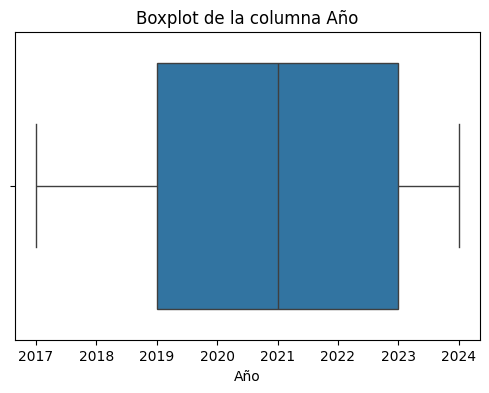

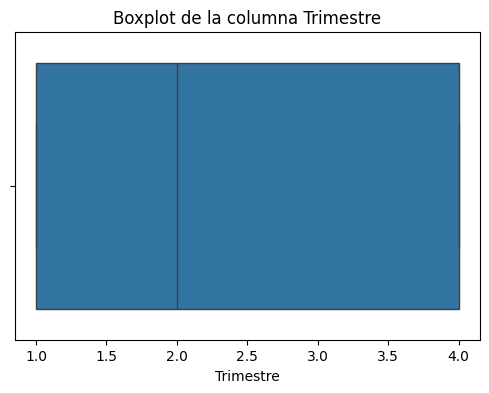

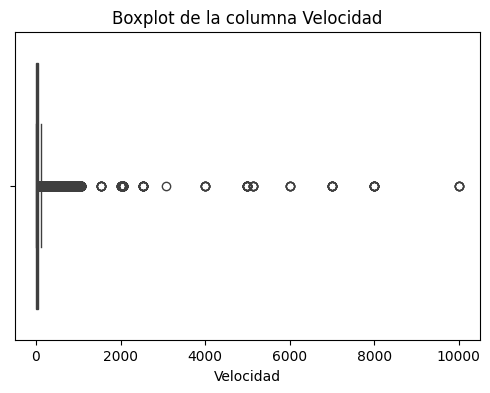

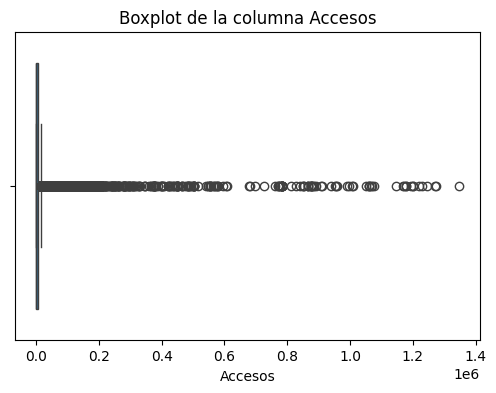

In [98]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [26]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Velocidad % por prov.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Velocidad % por prov.csv


In [100]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [27]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                       0.023335
Trimestre                 0.068279
Mbps (Media de bajada)    2.637143
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                      -1.189623
Trimestre                -1.354076
Mbps (Media de bajada)    8.748819
dtype: float64


In [28]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                 Variable            VIF
0                   const  837347.979200
1                     Año       1.898215
2               Trimestre       1.009237
3  Mbps (Media de bajada)       1.888020


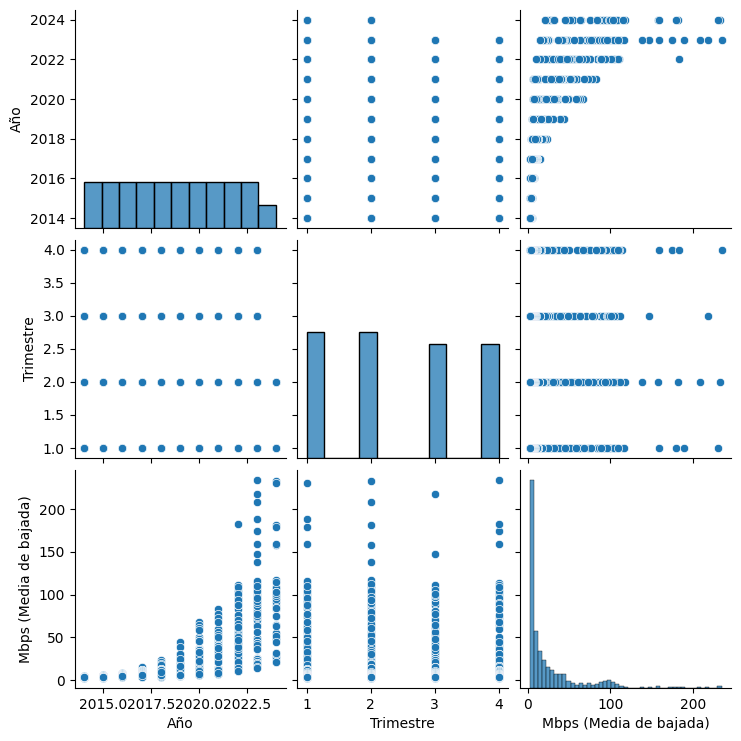

In [29]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [30]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                      Año                                                 \
                    count         mean       std     min     25%     50%   
Provincia                                                                  
BUENOS AIRES         84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA             42.0  2018.761905  3.074756

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Totales Accesos Por Tecnología.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre     ADSL  Cablemodem  Fibra óptica  Wireless   Otros  \
0  2024          2   733491     5867504       4169958    593197  191957   
1  2024          1   774475     5986957       4015101    598682  257941   
2  2023          4   836390     6022532       3908183    585760  194796   
3  2023          3   897895     6018832       3708718    581436  200027   
4  2023          2  1006509     5997149       3463988    581823  202428   

      Total        Periodo  
0  11556107   Abr-Jun 2024  
1  11633156   Ene-Mar 2024  
2  11547661   Oct-Dic 2023  
3  11406908  Jul-Sept 2023  
4  11251897   Abr-Jun 2023  


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Año           42 non-null     int64 
 1   Trimestre     42 non-null     int64 
 2   ADSL          42 non-null     int64 
 3   Cablemodem    42 non-null     int64 
 4   Fibra óptica  42 non-null     int64 
 5   Wireless      42 non-null     int64 
 6   Otros         42 non-null     int64 
 7   Total         42 non-null     int64 
 8   Periodo       42 non-null     object
dtypes: int64(8), object(1)
memory usage: 3.1+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2023          1       Q1-2023     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre     ADSL  Cablemodem  Fibra óptica  Wireless   Otros  \
0  2024          2   733491     5867504       4169958    593197  191957   
1  2024          1   774475     5986957       4015101    598682  257941   
2  2023          4   836390     6022532       3908183    585760  194796   
3  2023          3   897895     6018832       3708718    581436  200027   
4  2023          2  1006509     5997149       3463988    581823  202428   

      Total        Periodo Año_Trimestre meses_periodo  
0  11556107   Abr-Jun 2024       Q2-2024     abr - jun  
1  11633156   Ene-Mar 2024       Q1-2024     ene - mar  
2  11547661   Oct-Dic 2023       Q4-2023     oct - dic  
3  11406908  Jul-Sept 2023       Q3-2023     jul - sep  
4  11251897   Abr-Jun 2023       Q2-2023     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año               int64
Trimestre         int64
ADSL              int64
Cablemodem        int64
Fibra óptica      int64
Wireless          int64
Otros             int64
Total             int64
Periodo          object
Año_Trimestre    object
meses_periodo    object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            42 non-null     int64 
 1   Trimestre      42 non-null     int64 
 2   ADSL           42 non-null     int64 
 3   Cablemodem     42 non-null     int64 
 4   Fibra óptica   42 non-null     int64 
 5   Wireless       42 non-null     int64 
 6   Otros          42 non-null     int64 
 7   Total          42 non-null     int64 
 8   Periodo        42 non-null     object
 9   Año_Trimestre  42 non-null     object
 10  meses_periodo  42 non-null     object
dtypes: int64(8), object(3)
memory usage: 3.7+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            42 non-null     int64 
 1   Trimestre      42 non-null     int64 
 2   ADSL           42 non-null     int64 
 3   Cablemodem     42 non-null     int64 
 4   Fibra óptica   42 non-null     int64 
 5   Wireless       42 non-null     int64 
 6   Otros          42 non-null     int64 
 7   Total          42 non-null     int64 
 8   Periodo        42 non-null     object
 9   Año_Trimestre  42 non-null     object
 10  meses_periodo  42 non-null     object
dtypes: int64(8), object(3)
memory usage: 3.7+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            42 non-null     int64 
 1   Trimestre      42 non-null     int64 
 2   ADSL           42 non-null     int64 
 3   Cablemodem     42 non-null     int64 
 4   Fibra óptica   42 non-null     int64 
 5   Wireless       42 non-null     int64 
 6   Otros          42 non-null     int64 
 7   Total          42 non-null     int64 
 8   Periodo        42 non-null     object
 9   Año_Trimestre  42 non-null     object
 10  meses_periodo  42 non-null     object
dtypes: int64(8), object(3)
memory usage: 3.7+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año              0
Trimestre        0
ADSL             0
Cablemodem       0
Fibra óptica     0
Wireless         0
Otros            0
Total            0
Periodo          0
Año_Trimestre    0
meses_periodo    0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año              0
Trimestre        0
ADSL             0
Cablemodem       0
Fibra óptica     0
Wireless         0
Otros            0
Total            0
Periodo          0
Año_Trimestre    0
meses_periodo    0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año              0
Trimestre        0
ADSL             0
Cablemodem       0
Fibra óptica     0
Wireless         0
Otros            0
Total            0
Periodo          0
Año_Trimestre    0
meses_periodo    0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            42 non-null     int64 
 1   Trimestre      42 non-null     int64 
 2   ADSL           42 non-null     int64 
 3   Cablemodem     42 non-null     int64 
 4   Fibra óptica   42 non-null     int64 
 5   Wireless       42 non-null     int64 
 6   Otros          42 non-null     int64 
 7   Total          42 non-null     int64 
 8   Periodo        42 non-null     object
 9   Año_Trimestre  42 non-null     object
 10  meses_periodo  42 non-null     object
dtypes: int64(8), object(3)
memory usage: 3.7+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre          ADSL    Cablemodem  Fibra óptica  \
count     42.000000  42.000000  4.200000e+01  4.200000e+01  4.200000e+01   
unique          NaN        NaN           NaN           NaN           NaN   
top             NaN        NaN           NaN           NaN           NaN   
freq            NaN        NaN           NaN           NaN           NaN   
mean    2018.761905   2.452381  2.694844e+06  4.433906e+06  1.224694e+06   
std        3.074756   1.130560  1.094347e+06  1.319783e+06  1.321136e+06   
min     2014.000000   1.000000  7.334910e+05  2.407330e+06  1.391870e+05   
25%     2016.000000   1.250000  1.730869e+06  3.146292e+06  1.719410e+05   
50%     2019.000000   2.000000  3.061623e+06  4.535507e+06  6.989465e+05   
75%     2021.000000   3.000000  3.713298e+06  5.857192e+06  1.945689e+06   
max     2024.000000   4.000000  3.803024e+06  6.073426e+06  4.169958e+06   

             

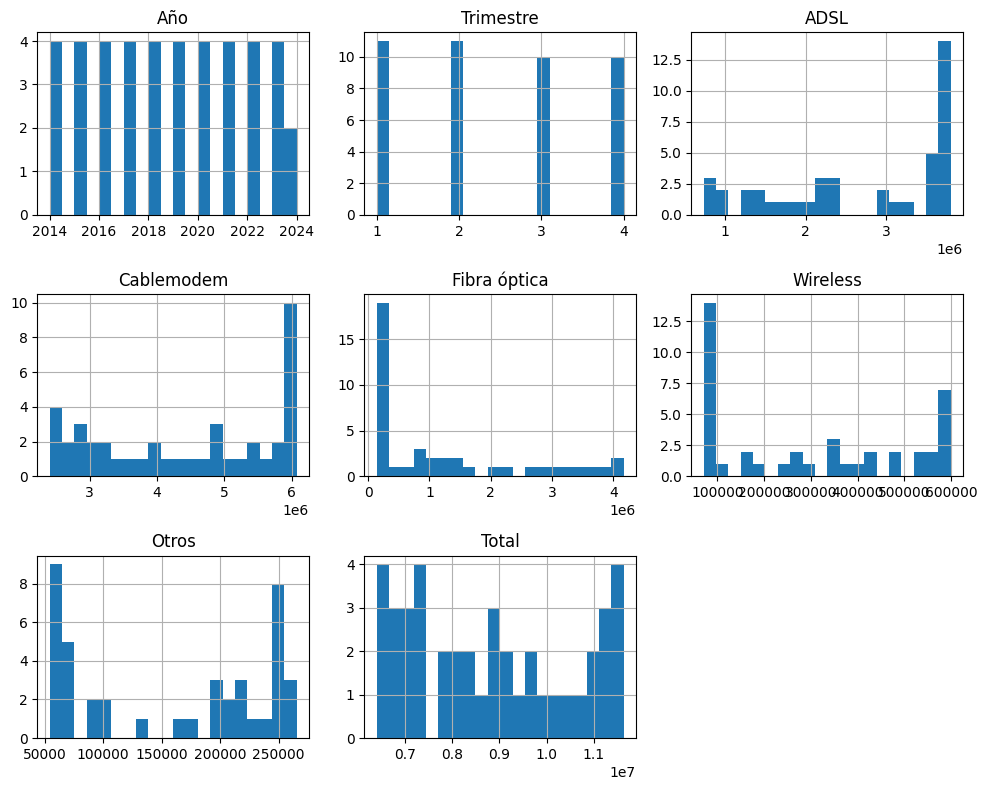

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                   Año  Trimestre      ADSL  Cablemodem  Fibra óptica  \
Año           1.000000  -0.073505 -0.951631    0.976749      0.903746   
Trimestre    -0.073505   1.000000  0.005384    0.037978     -0.013996   
ADSL         -0.951631   0.005384  1.000000   -0.935436     -0.967687   
Cablemodem    0.976749   0.037978 -0.935436    1.000000      0.850233   
Fibra óptica  0.903746  -0.013996 -0.967687    0.850233      1.000000   
Wireless      0.968878   0.016742 -0.979094    0.979382      0.918549   
Otros         0.831267   0.025812 -0.803222    0.897399      0.660437   
Total         0.984889   0.024840 -0.971494    0.976403      0.937763   

              Wireless     Otros     Total  
Año           0.968878  0.831267  0.984889  
Trimestre     0.016742  0.025812  0.024840  
ADSL         -0.979094 -0.803222 -0.971494  
Cablemodem    0.979382  0.897399  0.976403  
Fibra óptica  0.918549  0.660437  0.937763  
Wireless      1.000000  0.873744 

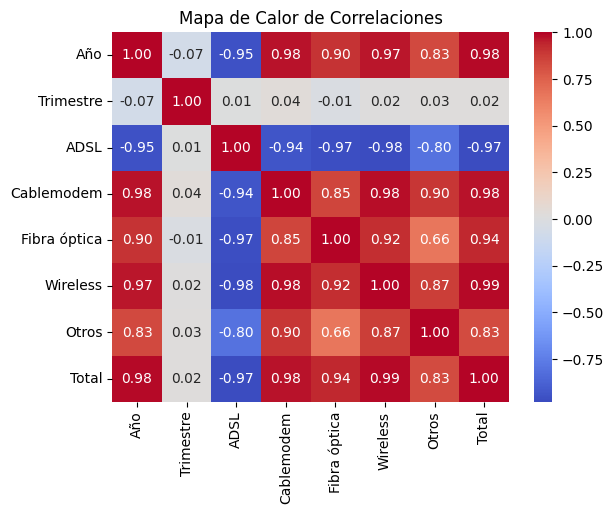

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Periodo y Año_Trimestre:
Año_Trimestre  Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  Q1-2020  \
Periodo                                                                        
Abr-Jun 2014         0        0        0        0        0        0        0   
Abr-Jun 2015         0        0        0        0        0        0        0   
Abr-Jun 2016         0        0        0        0        0        0        0   
Abr-Jun 2017         0        0        0        0        0        0        0   
Abr-Jun 2018         0        0        0        0        0        0        0   
Abr-Jun 2019         0        0        0        0        0        0        0   
Abr-Jun 2020         0        0        0        0        0        0        0   
Abr-Jun 2021         0        0        0        0        0        0        0   
Abr-Jun 2022         0        0        0        0        0        0        0   
Abr-Jun 2023         0        0        0        0        0        

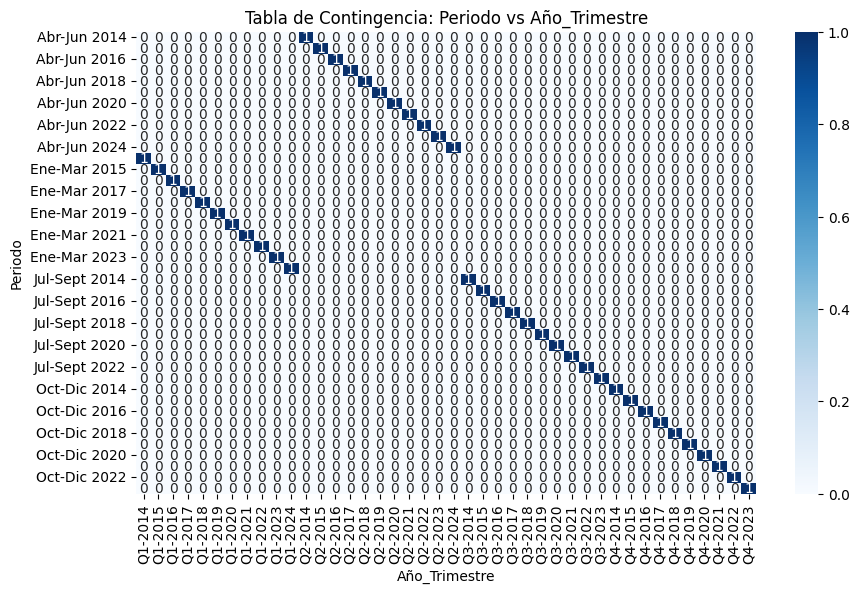


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
Abr-Jun 2014           1          0          0          0
Abr-Jun 2015           1          0          0          0
Abr-Jun 2016           1          0          0          0
Abr-Jun 2017           1          0          0          0
Abr-Jun 2018           1          0          0          0
Abr-Jun 2019           1          0          0          0
Abr-Jun 2020           1          0          0          0
Abr-Jun 2021           1          0          0          0
Abr-Jun 2022           1          0          0          0
Abr-Jun 2023           1          0          0          0
Abr-Jun 2024           1          0          0          0
Ene-Mar 2014           0          1          0          0
Ene-Mar 2015           0          1          0          0
Ene-Mar 2016           0          1          0          0
Ene-Mar 2017      

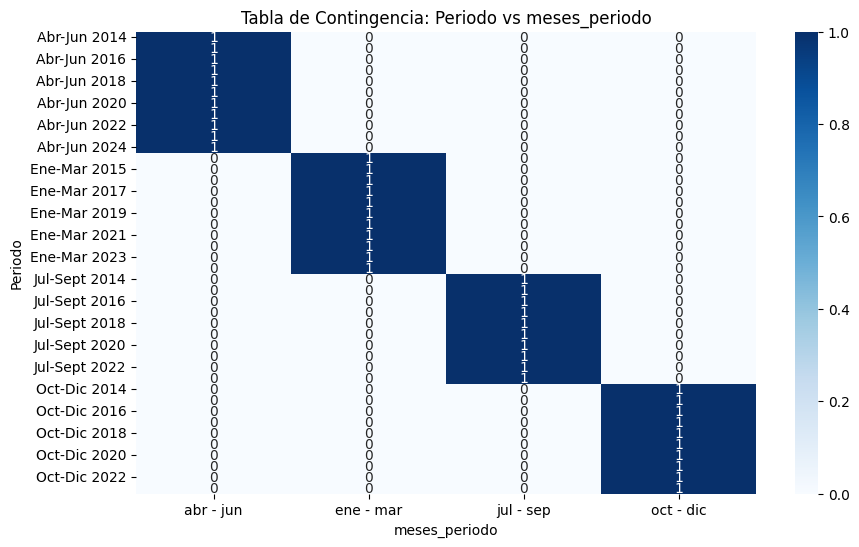


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2023                0          1          0          0
Q1-2024                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

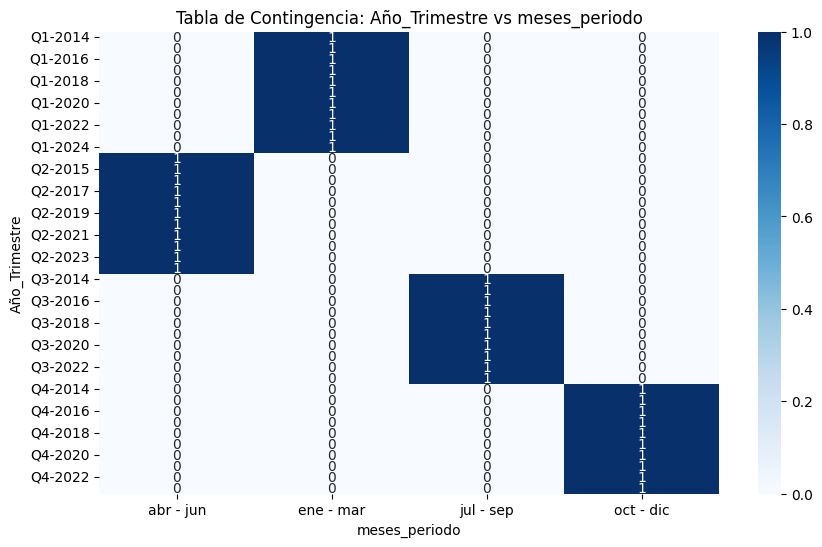

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
               count    mean  std     min     25%     50%     75%     max
Periodo                                                                  
Abr-Jun 2014     1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Abr-Jun 2015     1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Abr-Jun 2016     1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Abr-Jun 2017     1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Abr-Jun 2018     1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Abr-Jun 2019     1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Abr-Jun 2020     1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Abr-Jun 2021     1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Abr-Jun 2022     1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Abr-Jun 2023     1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Abr-Jun 2024     1.0  2024.0  NaN  2024.0  2024.0  

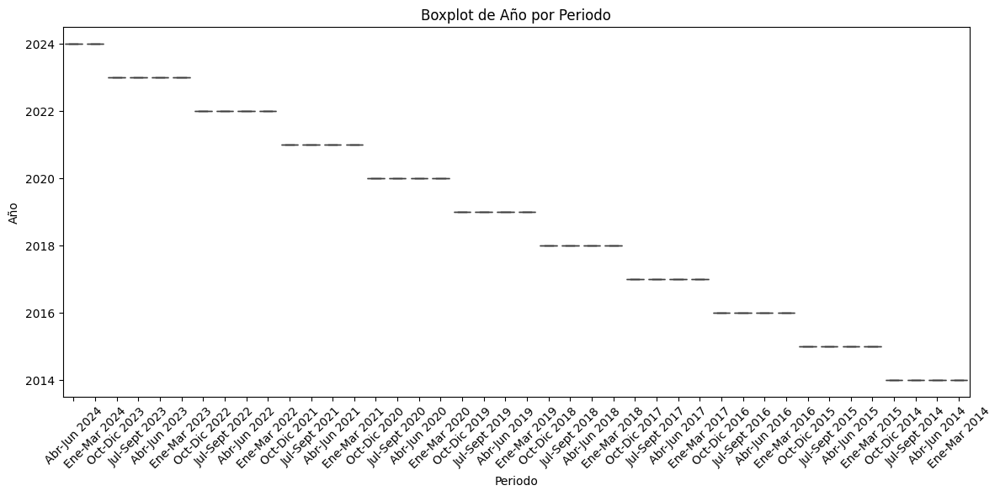


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
               count  mean  std  min  25%  50%  75%  max
Periodo                                                 
Abr-Jun 2014     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2015     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2016     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2017     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2018     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2019     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2020     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2021     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2022     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2023     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2024     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Ene-Mar 2014     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2015     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2016     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2017     1.0 

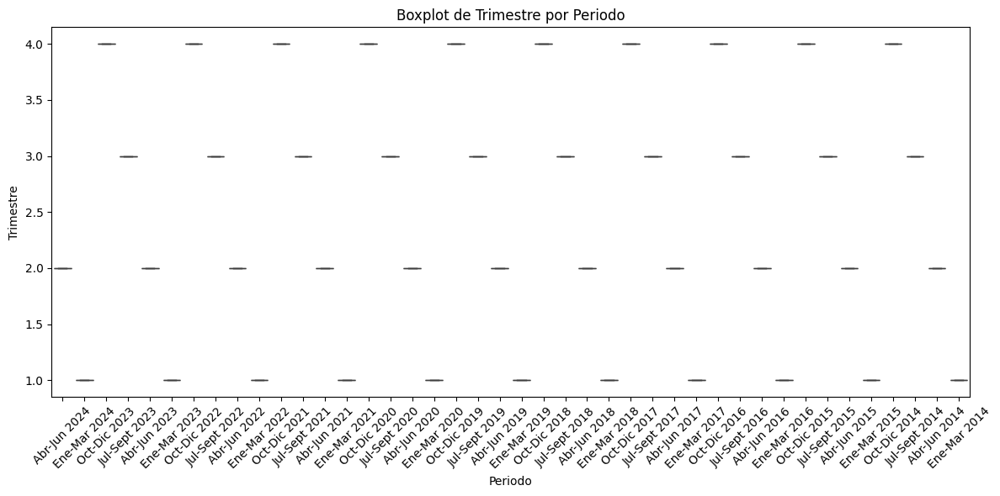


Estadísticas descriptivas de 'ADSL' agrupadas por 'Periodo':
               count       mean  std        min        25%        50%  \
Periodo                                                                 
Abr-Jun 2014     1.0  3708882.0  NaN  3708882.0  3708882.0  3708882.0   
Abr-Jun 2015     1.0  3767821.0  NaN  3767821.0  3767821.0  3767821.0   
Abr-Jun 2016     1.0  3782085.0  NaN  3782085.0  3782085.0  3782085.0   
Abr-Jun 2017     1.0  3723518.0  NaN  3723518.0  3723518.0  3723518.0   
Abr-Jun 2018     1.0  3557216.0  NaN  3557216.0  3557216.0  3557216.0   
Abr-Jun 2019     1.0  2990457.0  NaN  2990457.0  2990457.0  2990457.0   
Abr-Jun 2020     1.0  2295533.0  NaN  2295533.0  2295533.0  2295533.0   
Abr-Jun 2021     1.0  2018587.0  NaN  2018587.0  2018587.0  2018587.0   
Abr-Jun 2022     1.0  1468333.0  NaN  1468333.0  1468333.0  1468333.0   
Abr-Jun 2023     1.0  1006509.0  NaN  1006509.0  1006509.0  1006509.0   
Abr-Jun 2024     1.0   733491.0  NaN   733491.0   733491.0   7

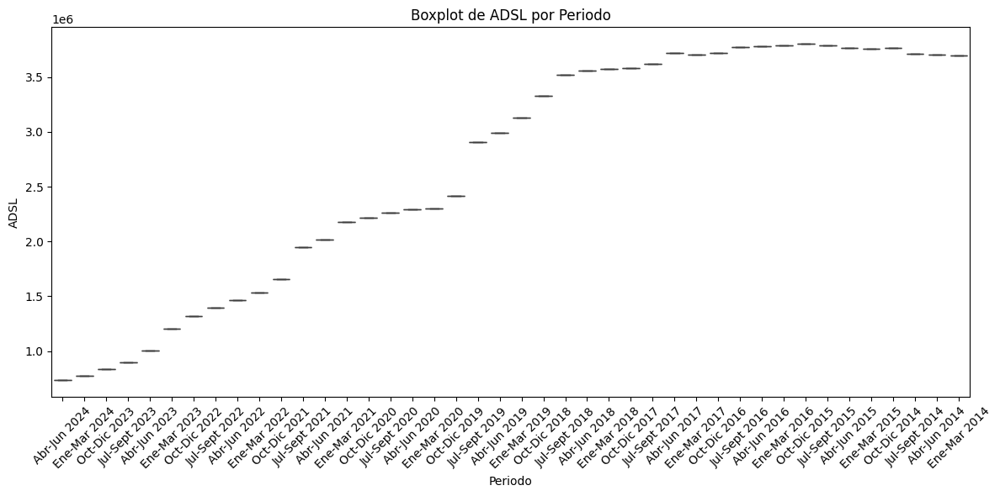


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'Periodo':
               count       mean  std        min        25%        50%  \
Periodo                                                                 
Abr-Jun 2014     1.0  2461670.0  NaN  2461670.0  2461670.0  2461670.0   
Abr-Jun 2015     1.0  2756294.0  NaN  2756294.0  2756294.0  2756294.0   
Abr-Jun 2016     1.0  3035272.0  NaN  3035272.0  3035272.0  3035272.0   
Abr-Jun 2017     1.0  3383434.0  NaN  3383434.0  3383434.0  3383434.0   
Abr-Jun 2018     1.0  4038141.0  NaN  4038141.0  4038141.0  4038141.0   
Abr-Jun 2019     1.0  4635575.0  NaN  4635575.0  4635575.0  4635575.0   
Abr-Jun 2020     1.0  5005115.0  NaN  5005115.0  5005115.0  5005115.0   
Abr-Jun 2021     1.0  5641731.0  NaN  5641731.0  5641731.0  5641731.0   
Abr-Jun 2022     1.0  5979214.0  NaN  5979214.0  5979214.0  5979214.0   
Abr-Jun 2023     1.0  5997149.0  NaN  5997149.0  5997149.0  5997149.0   
Abr-Jun 2024     1.0  5867504.0  NaN  5867504.0  5867504

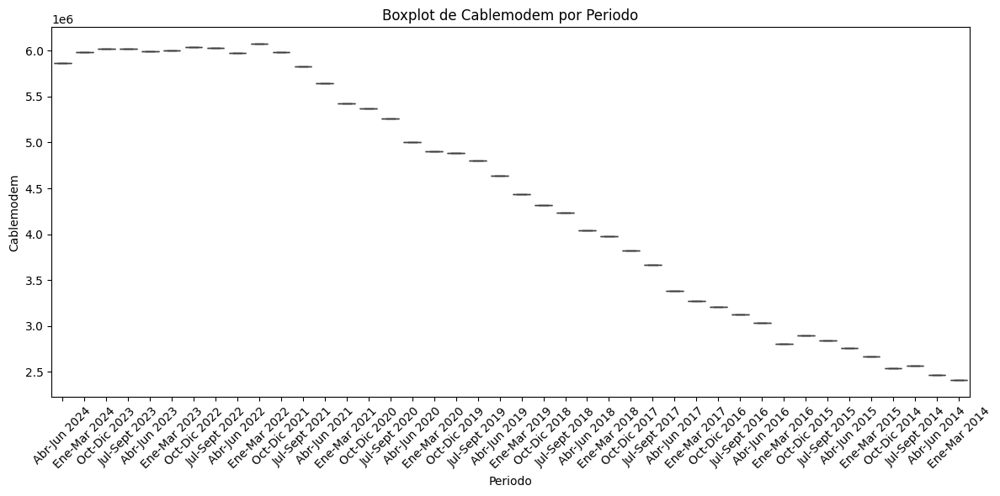


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'Periodo':
               count       mean  std        min        25%        50%  \
Periodo                                                                 
Abr-Jun 2014     1.0   149363.0  NaN   149363.0   149363.0   149363.0   
Abr-Jun 2015     1.0   150839.0  NaN   150839.0   150839.0   150839.0   
Abr-Jun 2016     1.0   167788.0  NaN   167788.0   167788.0   167788.0   
Abr-Jun 2017     1.0   180777.0  NaN   180777.0   180777.0   180777.0   
Abr-Jun 2018     1.0   226285.0  NaN   226285.0   226285.0   226285.0   
Abr-Jun 2019     1.0   760794.0  NaN   760794.0   760794.0   760794.0   
Abr-Jun 2020     1.0  1106725.0  NaN  1106725.0  1106725.0  1106725.0   
Abr-Jun 2021     1.0  1472246.0  NaN  1472246.0  1472246.0  1472246.0   
Abr-Jun 2022     1.0  2723285.0  NaN  2723285.0  2723285.0  2723285.0   
Abr-Jun 2023     1.0  3463988.0  NaN  3463988.0  3463988.0  3463988.0   
Abr-Jun 2024     1.0  4169958.0  NaN  4169958.0  41699

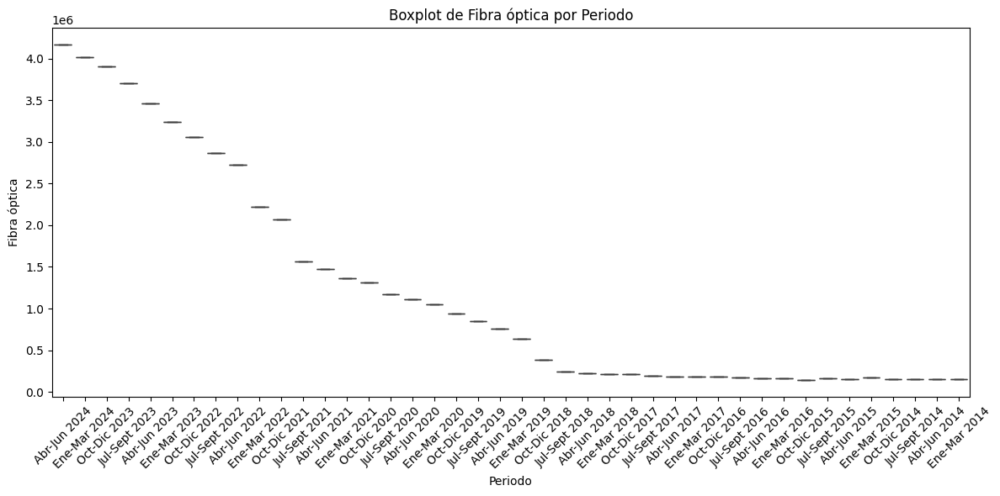


Estadísticas descriptivas de 'Wireless' agrupadas por 'Periodo':
               count      mean  std       min       25%       50%       75%  \
Periodo                                                                       
Abr-Jun 2014     1.0   72405.0  NaN   72405.0   72405.0   72405.0   72405.0   
Abr-Jun 2015     1.0   82077.0  NaN   82077.0   82077.0   82077.0   82077.0   
Abr-Jun 2016     1.0   85452.0  NaN   85452.0   85452.0   85452.0   85452.0   
Abr-Jun 2017     1.0   85813.0  NaN   85813.0   85813.0   85813.0   85813.0   
Abr-Jun 2018     1.0  194267.0  NaN  194267.0  194267.0  194267.0  194267.0   
Abr-Jun 2019     1.0  308027.0  NaN  308027.0  308027.0  308027.0  308027.0   
Abr-Jun 2020     1.0  376667.0  NaN  376667.0  376667.0  376667.0  376667.0   
Abr-Jun 2021     1.0  476968.0  NaN  476968.0  476968.0  476968.0  476968.0   
Abr-Jun 2022     1.0  556243.0  NaN  556243.0  556243.0  556243.0  556243.0   
Abr-Jun 2023     1.0  581823.0  NaN  581823.0  581823.0  581823.0

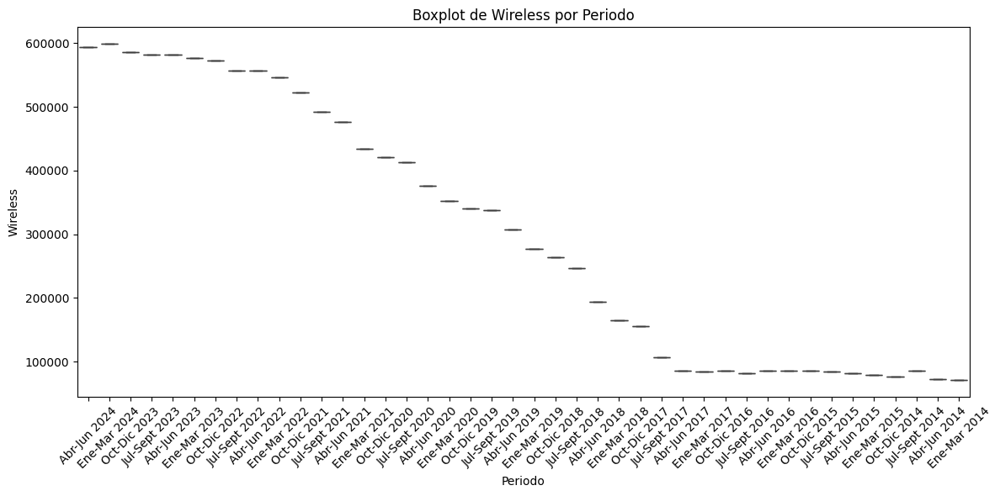


Estadísticas descriptivas de 'Otros' agrupadas por 'Periodo':
               count      mean  std       min       25%       50%       75%  \
Periodo                                                                       
Abr-Jun 2014     1.0   72148.0  NaN   72148.0   72148.0   72148.0   72148.0   
Abr-Jun 2015     1.0   59157.0  NaN   59157.0   59157.0   59157.0   59157.0   
Abr-Jun 2016     1.0   59482.0  NaN   59482.0   59482.0   59482.0   59482.0   
Abr-Jun 2017     1.0   56122.0  NaN   56122.0   56122.0   56122.0   56122.0   
Abr-Jun 2018     1.0   94535.0  NaN   94535.0   94535.0   94535.0   94535.0   
Abr-Jun 2019     1.0  265328.0  NaN  265328.0  265328.0  265328.0  265328.0   
Abr-Jun 2020     1.0  247016.0  NaN  247016.0  247016.0  247016.0  247016.0   
Abr-Jun 2021     1.0  253552.0  NaN  253552.0  253552.0  253552.0  253552.0   
Abr-Jun 2022     1.0  231609.0  NaN  231609.0  231609.0  231609.0  231609.0   
Abr-Jun 2023     1.0  202428.0  NaN  202428.0  202428.0  202428.0  2

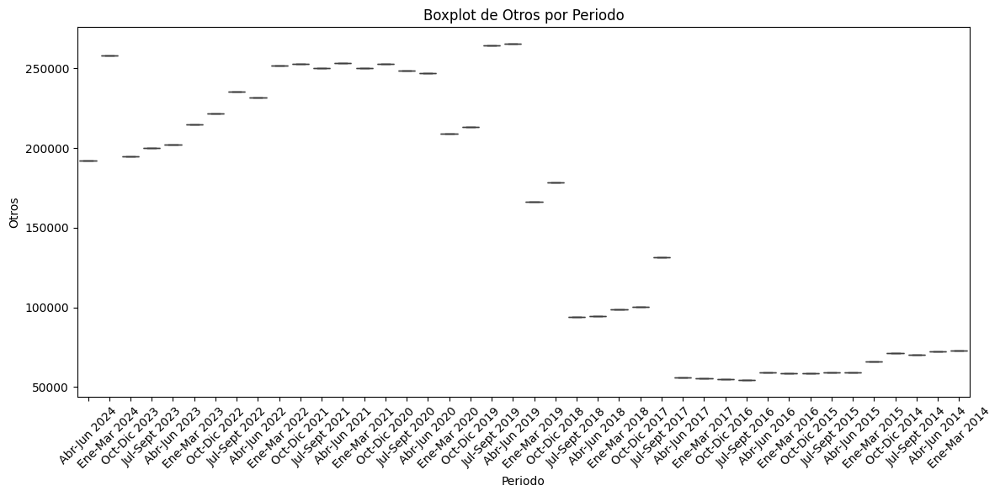


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
               count        mean  std         min         25%         50%  \
Periodo                                                                     
Abr-Jun 2014     1.0   6464468.0  NaN   6464468.0   6464468.0   6464468.0   
Abr-Jun 2015     1.0   6816188.0  NaN   6816188.0   6816188.0   6816188.0   
Abr-Jun 2016     1.0   7130079.0  NaN   7130079.0   7130079.0   7130079.0   
Abr-Jun 2017     1.0   7429664.0  NaN   7429664.0   7429664.0   7429664.0   
Abr-Jun 2018     1.0   8110444.0  NaN   8110444.0   8110444.0   8110444.0   
Abr-Jun 2019     1.0   8960181.0  NaN   8960181.0   8960181.0   8960181.0   
Abr-Jun 2020     1.0   9031056.0  NaN   9031056.0   9031056.0   9031056.0   
Abr-Jun 2021     1.0   9863084.0  NaN   9863084.0   9863084.0   9863084.0   
Abr-Jun 2022     1.0  10958684.0  NaN  10958684.0  10958684.0  10958684.0   
Abr-Jun 2023     1.0  11251897.0  NaN  11251897.0  11251897.0  11251897.0   
Abr-Jun 2024 

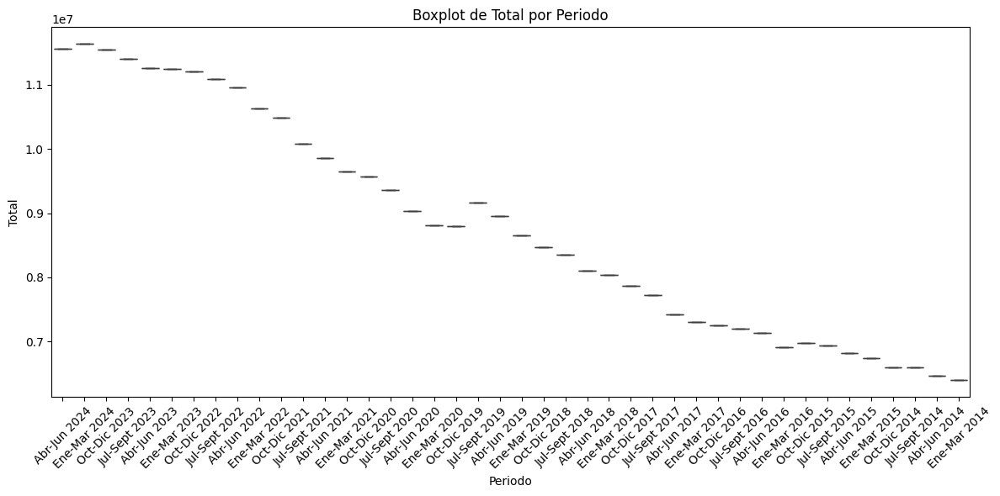


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023          1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024          1.0  2024.0  NaN  2024.0  20

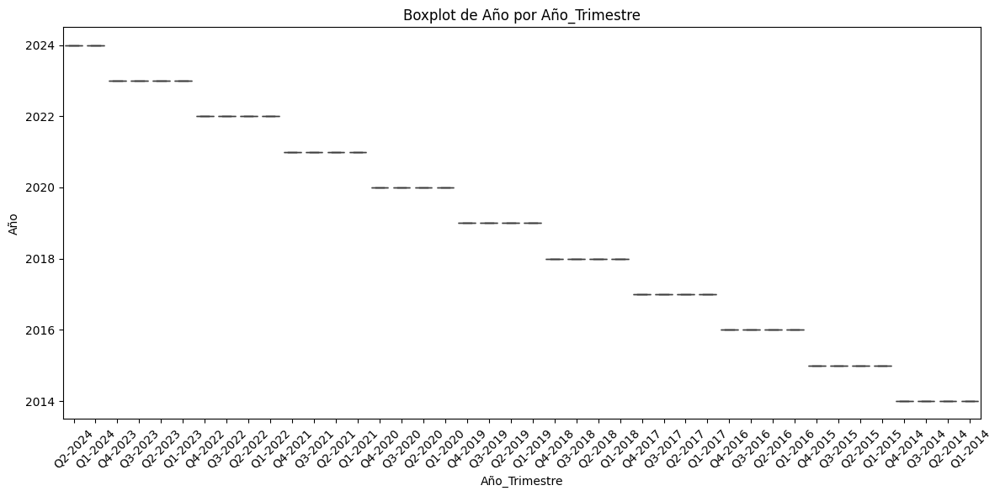


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2023          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

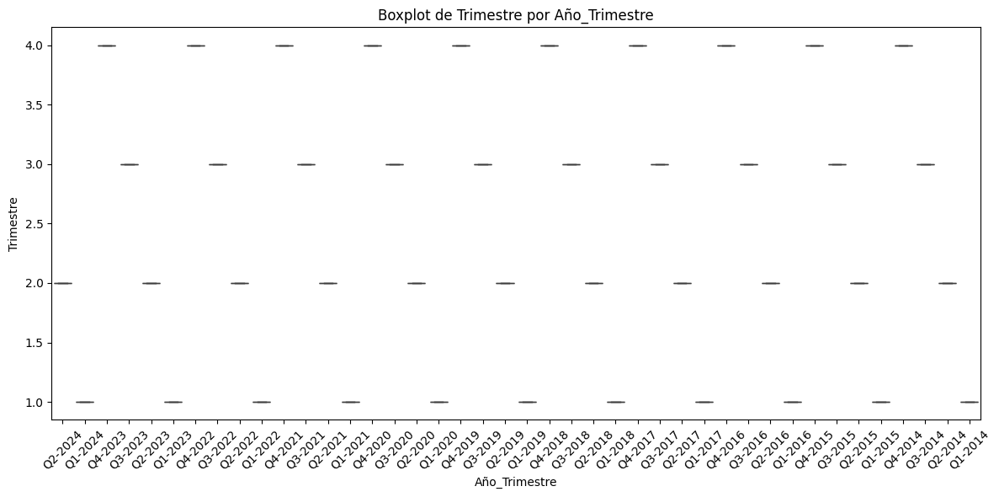


Estadísticas descriptivas de 'ADSL' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0  3697066.0  NaN  3697066.0  3697066.0  3697066.0   
Q1-2015          1.0  3756153.0  NaN  3756153.0  3756153.0  3756153.0   
Q1-2016          1.0  3792493.0  NaN  3792493.0  3792493.0  3792493.0   
Q1-2017          1.0  3708898.0  NaN  3708898.0  3708898.0  3708898.0   
Q1-2018          1.0  3574294.0  NaN  3574294.0  3574294.0  3574294.0   
Q1-2019          1.0  3132789.0  NaN  3132789.0  3132789.0  3132789.0   
Q1-2020          1.0  2299457.0  NaN  2299457.0  2299457.0  2299457.0   
Q1-2021          1.0  2175211.0  NaN  2175211.0  2175211.0  2175211.0   
Q1-2022          1.0  1533240.0  NaN  1533240.0  1533240.0  1533240.0   
Q1-2023          1.0  1204417.0  NaN  1204417.0  1204417.0  1204417.0   
Q1-2024          1.0   774475.0  NaN   774475.0   774475

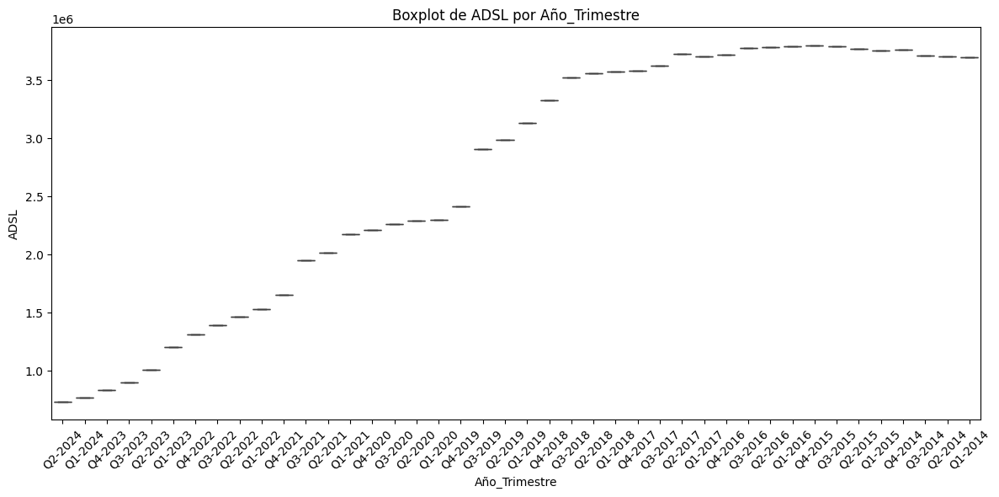


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0  2407330.0  NaN  2407330.0  2407330.0  2407330.0   
Q1-2015          1.0  2668248.0  NaN  2668248.0  2668248.0  2668248.0   
Q1-2016          1.0  2806359.0  NaN  2806359.0  2806359.0  2806359.0   
Q1-2017          1.0  3276251.0  NaN  3276251.0  3276251.0  3276251.0   
Q1-2018          1.0  3981129.0  NaN  3981129.0  3981129.0  3981129.0   
Q1-2019          1.0  4435439.0  NaN  4435439.0  4435439.0  4435439.0   
Q1-2020          1.0  4903674.0  NaN  4903674.0  4903674.0  4903674.0   
Q1-2021          1.0  5424782.0  NaN  5424782.0  5424782.0  5424782.0   
Q1-2022          1.0  6073426.0  NaN  6073426.0  6073426.0  6073426.0   
Q1-2023          1.0  6002582.0  NaN  6002582.0  6002582.0  6002582.0   
Q1-2024          1.0  5986957.0  NaN  5986957.0  5

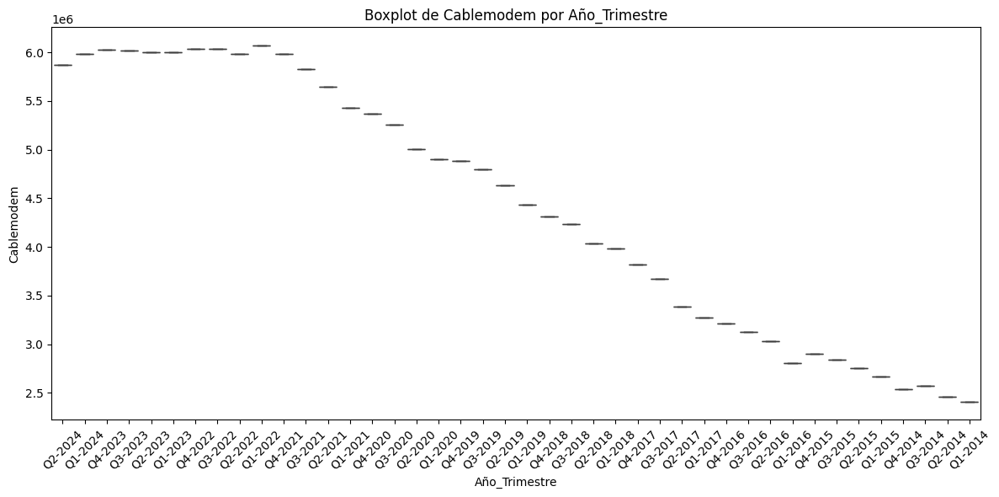


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0   150323.0  NaN   150323.0   150323.0   150323.0   
Q1-2015          1.0   168188.0  NaN   168188.0   168188.0   168188.0   
Q1-2016          1.0   164371.0  NaN   164371.0   164371.0   164371.0   
Q1-2017          1.0   180146.0  NaN   180146.0   180146.0   180146.0   
Q1-2018          1.0   217460.0  NaN   217460.0   217460.0   217460.0   
Q1-2019          1.0   637099.0  NaN   637099.0   637099.0   637099.0   
Q1-2020          1.0  1047817.0  NaN  1047817.0  1047817.0  1047817.0   
Q1-2021          1.0  1362976.0  NaN  1362976.0  1362976.0  1362976.0   
Q1-2022          1.0  2219533.0  NaN  2219533.0  2219533.0  2219533.0   
Q1-2023          1.0  3243411.0  NaN  3243411.0  3243411.0  3243411.0   
Q1-2024          1.0  4015101.0  NaN  4015101.0 

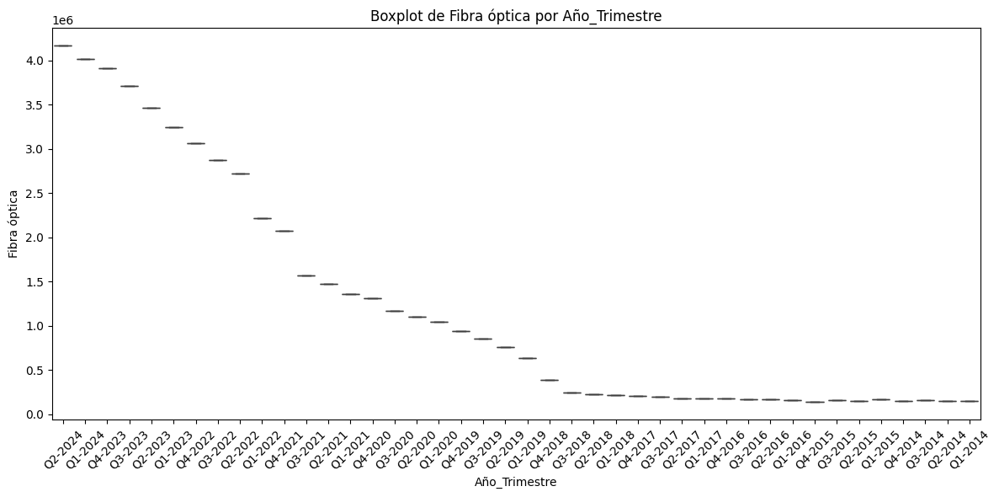


Estadísticas descriptivas de 'Wireless' agrupadas por 'Año_Trimestre':
               count      mean  std       min       25%       50%       75%  \
Año_Trimestre                                                                 
Q1-2014          1.0   70749.0  NaN   70749.0   70749.0   70749.0   70749.0   
Q1-2015          1.0   79098.0  NaN   79098.0   79098.0   79098.0   79098.0   
Q1-2016          1.0   85370.0  NaN   85370.0   85370.0   85370.0   85370.0   
Q1-2017          1.0   84813.0  NaN   84813.0   84813.0   84813.0   84813.0   
Q1-2018          1.0  165300.0  NaN  165300.0  165300.0  165300.0  165300.0   
Q1-2019          1.0  276419.0  NaN  276419.0  276419.0  276419.0  276419.0   
Q1-2020          1.0  352333.0  NaN  352333.0  352333.0  352333.0  352333.0   
Q1-2021          1.0  434548.0  NaN  434548.0  434548.0  434548.0  434548.0   
Q1-2022          1.0  545814.0  NaN  545814.0  545814.0  545814.0  545814.0   
Q1-2023          1.0  576647.0  NaN  576647.0  576647.0  57

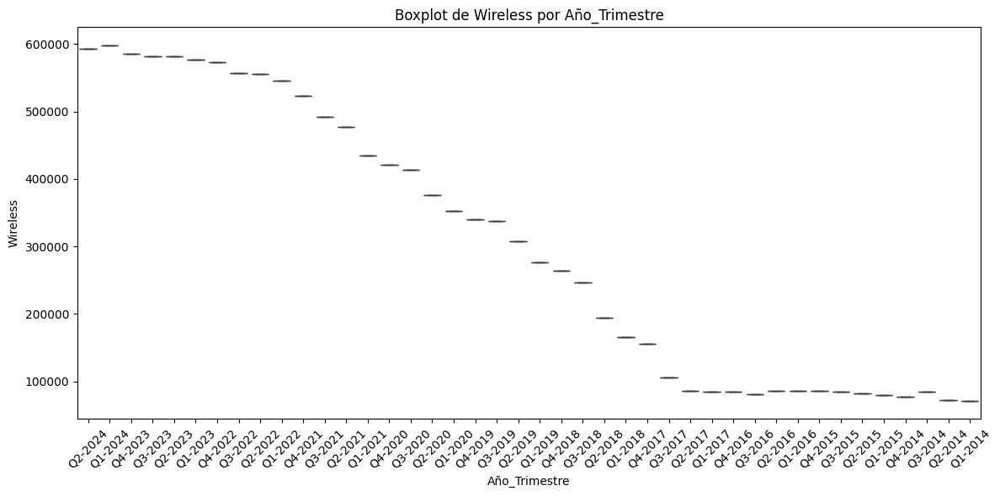


Estadísticas descriptivas de 'Otros' agrupadas por 'Año_Trimestre':
               count      mean  std       min       25%       50%       75%  \
Año_Trimestre                                                                 
Q1-2014          1.0   72930.0  NaN   72930.0   72930.0   72930.0   72930.0   
Q1-2015          1.0   66045.0  NaN   66045.0   66045.0   66045.0   66045.0   
Q1-2016          1.0   58763.0  NaN   58763.0   58763.0   58763.0   58763.0   
Q1-2017          1.0   55746.0  NaN   55746.0   55746.0   55746.0   55746.0   
Q1-2018          1.0   98870.0  NaN   98870.0   98870.0   98870.0   98870.0   
Q1-2019          1.0  166389.0  NaN  166389.0  166389.0  166389.0  166389.0   
Q1-2020          1.0  209145.0  NaN  209145.0  209145.0  209145.0  209145.0   
Q1-2021          1.0  250455.0  NaN  250455.0  250455.0  250455.0  250455.0   
Q1-2022          1.0  251996.0  NaN  251996.0  251996.0  251996.0  251996.0   
Q1-2023          1.0  214838.0  NaN  214838.0  214838.0  21483

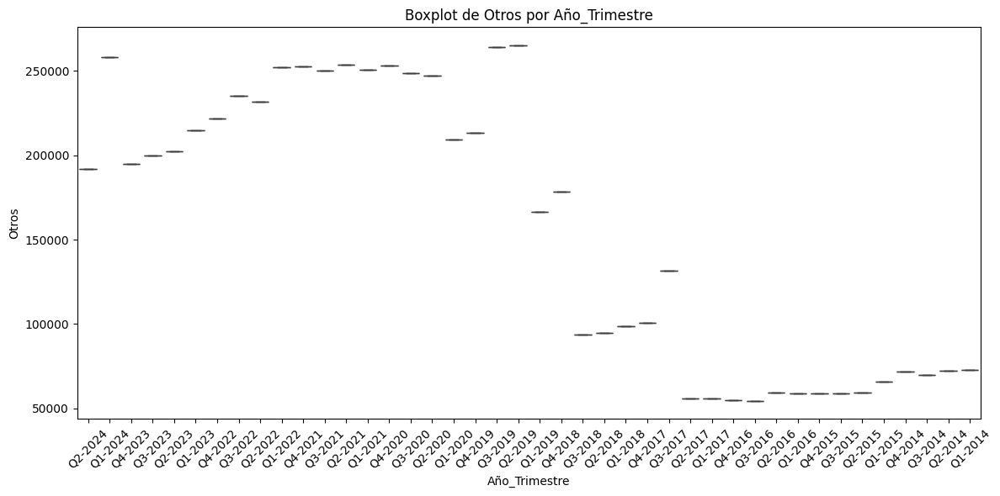


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count        mean  std         min         25%         50%  \
Año_Trimestre                                                               
Q1-2014          1.0   6398398.0  NaN   6398398.0   6398398.0   6398398.0   
Q1-2015          1.0   6737732.0  NaN   6737732.0   6737732.0   6737732.0   
Q1-2016          1.0   6907356.0  NaN   6907356.0   6907356.0   6907356.0   
Q1-2017          1.0   7305854.0  NaN   7305854.0   7305854.0   7305854.0   
Q1-2018          1.0   8037053.0  NaN   8037053.0   8037053.0   8037053.0   
Q1-2019          1.0   8648135.0  NaN   8648135.0   8648135.0   8648135.0   
Q1-2020          1.0   8812426.0  NaN   8812426.0   8812426.0   8812426.0   
Q1-2021          1.0   9647972.0  NaN   9647972.0   9647972.0   9647972.0   
Q1-2022          1.0  10624009.0  NaN  10624009.0  10624009.0  10624009.0   
Q1-2023          1.0  11241895.0  NaN  11241895.0  11241895.0  11241895.0   
Q1-2024

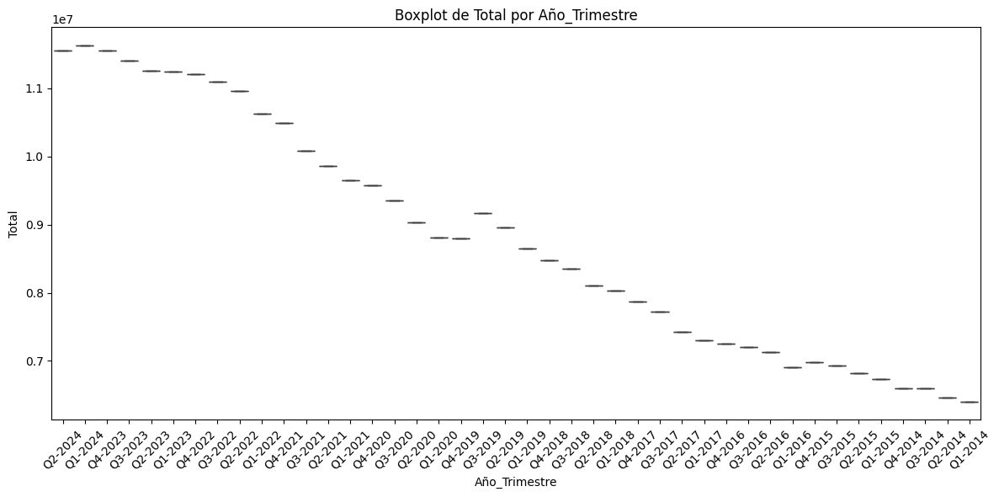


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min      25%     50%      75%  \
meses_periodo                                                              
abr - jun       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


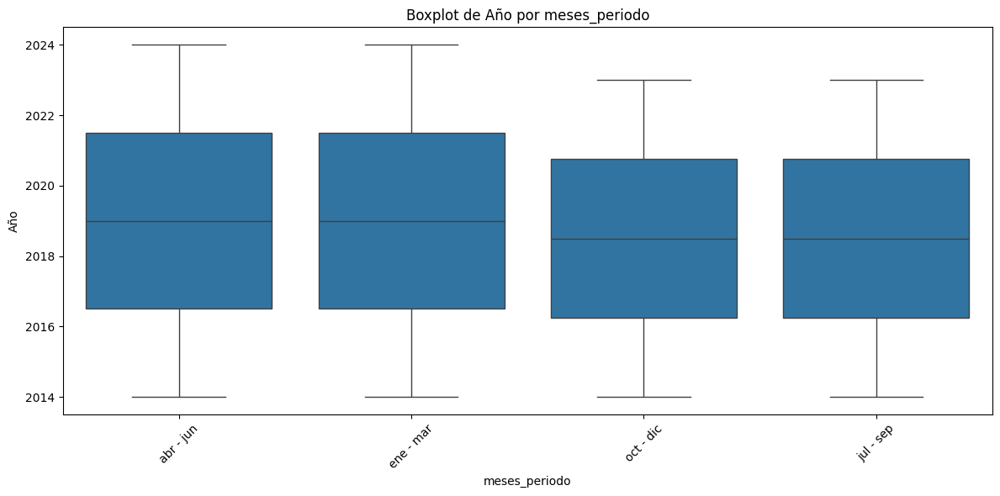


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


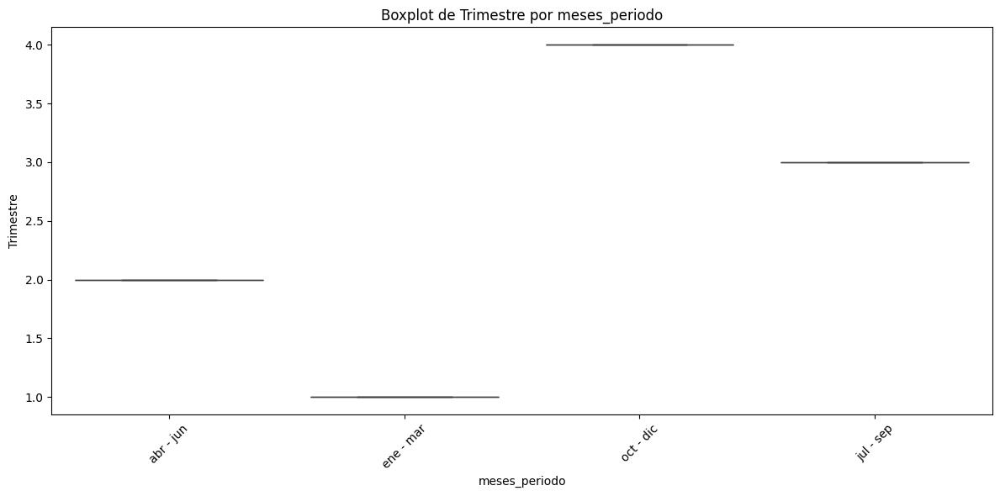


Estadísticas descriptivas de 'ADSL' agrupadas por 'meses_periodo':
               count          mean           std       min        25%  \
meses_periodo                                                           
abr - jun       11.0  2.641130e+06  1.184805e+06  733491.0  1743460.0   
ene - mar       11.0  2.695318e+06  1.140792e+06  774475.0  1854225.5   
jul - sep       10.0  2.784142e+06  1.083949e+06  897895.0  2028945.5   
oct - dic       10.0  2.664110e+06  1.123203e+06  836390.0  1796698.5   

                     50%         75%        max  
meses_periodo                                    
abr - jun      2990457.0  3716200.00  3782085.0  
ene - mar      3132789.0  3702982.00  3792493.0  
jul - sep      3215626.0  3691716.75  3788696.0  
oct - dic      2871801.0  3688173.25  3803024.0  


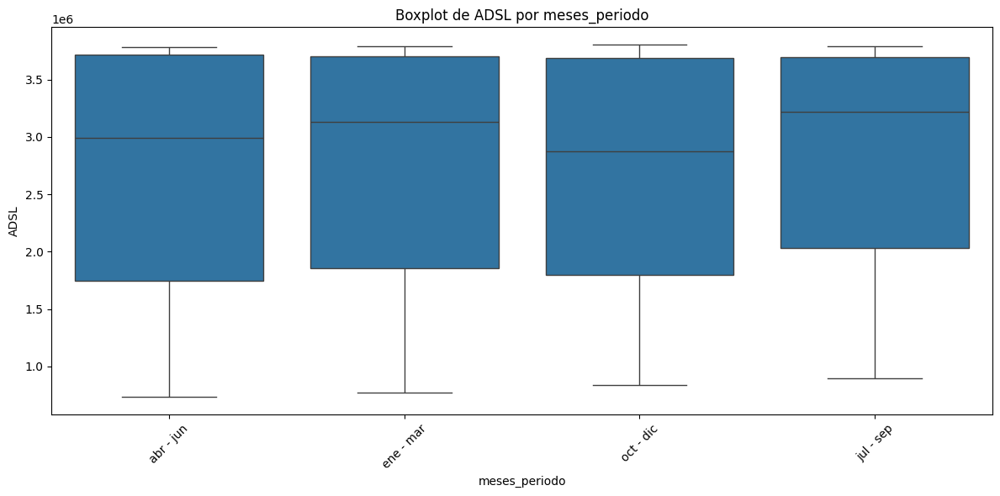


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'meses_periodo':
               count          mean           std        min         25%  \
meses_periodo                                                             
abr - jun       11.0  4.436464e+06  1.365028e+06  2461670.0  3209353.00   
ene - mar       11.0  4.360562e+06  1.418546e+06  2407330.0  3041305.00   
jul - sep       10.0  4.437982e+06  1.340373e+06  2569868.0  3261196.50   
oct - dic       10.0  4.507696e+06  1.348906e+06  2536219.0  3362490.75   

                     50%        75%        max  
meses_periodo                                   
abr - jun      4635575.0  5754617.5  5997149.0  
ene - mar      4435439.0  5705869.5  6073426.0  
jul - sep      4519131.0  5684530.5  6031970.0  
oct - dic      4598850.0  5831136.0  6037457.0  


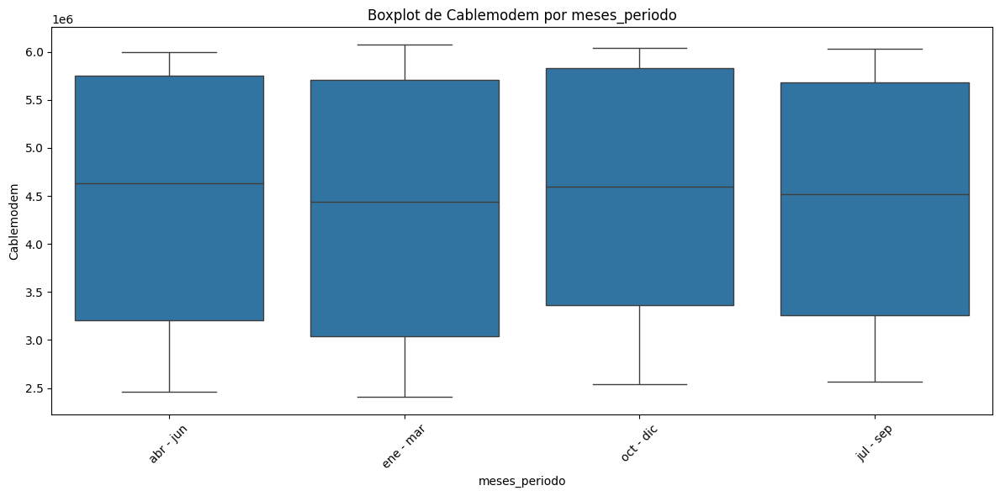


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'meses_periodo':
               count          mean           std       min        25%  \
meses_periodo                                                           
abr - jun       11.0  1.324732e+06  1.470654e+06  149363.0  174282.50   
ene - mar       11.0  1.218766e+06  1.369195e+06  150323.0  174167.00   
jul - sep       10.0  1.109879e+06  1.265354e+06  155494.0  175914.50   
oct - dic       10.0  1.235986e+06  1.355342e+06  139187.0  186408.75   

                    50%         75%        max  
meses_periodo                                   
abr - jun      760794.0  2097765.50  4169958.0  
ene - mar      637099.0  1791254.50  4015101.0  
jul - sep      549793.5  1467255.75  3708718.0  
oct - dic      664654.0  1881976.75  3908183.0  


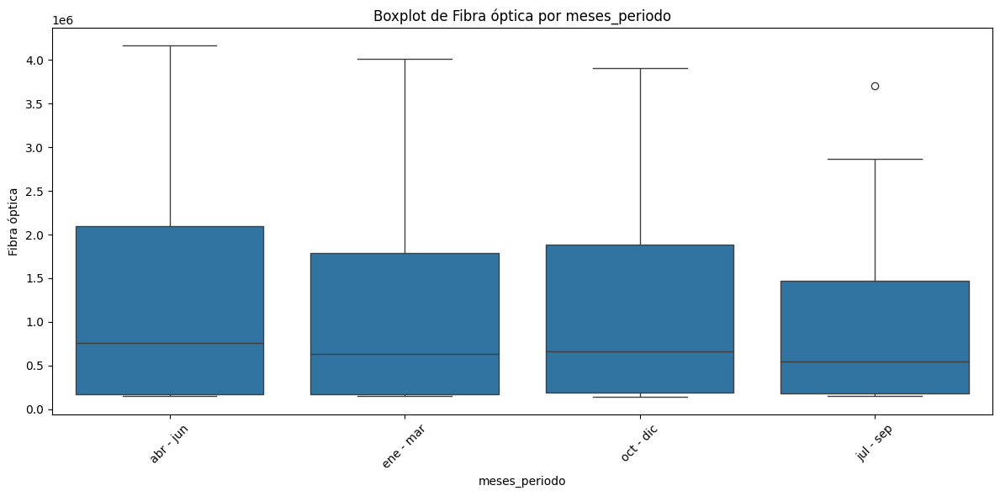


Estadísticas descriptivas de 'Wireless' agrupadas por 'meses_periodo':
               count           mean            std      min        25%  \
meses_periodo                                                            
abr - jun       11.0  310267.181818  216685.446927  72405.0   85632.50   
ene - mar       11.0  297252.090909  214325.271144  70749.0   85091.50   
jul - sep       10.0  298616.600000  204759.997118  81455.0   90432.75   
oct - dic       10.0  311143.700000  206825.589617  76984.0  103238.25   

                    50%        75%       max  
meses_periodo                                 
abr - jun      308027.0  516605.50  593197.0  
ene - mar      276419.0  490181.00  598682.0  
jul - sep      292211.0  472626.00  581436.0  
oct - dic      302221.5  497718.75  585760.0  


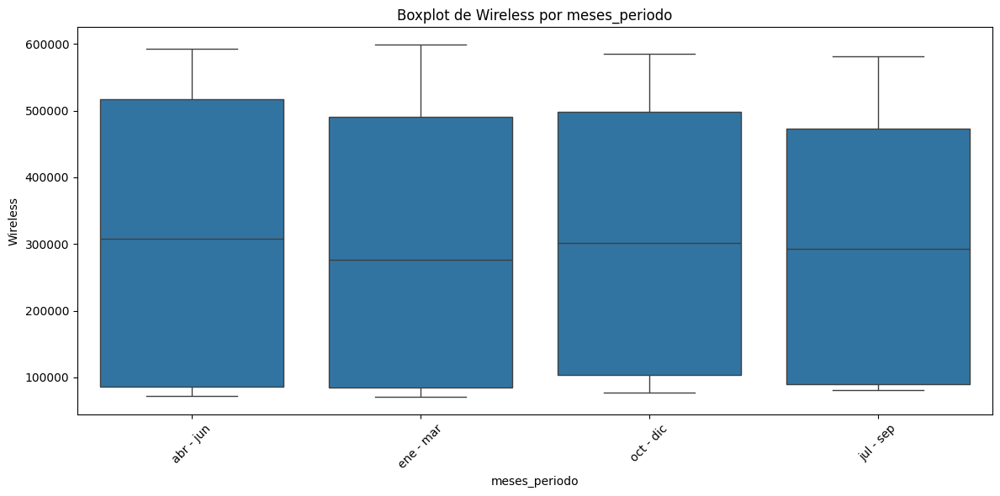


Estadísticas descriptivas de 'Otros' agrupadas por 'meses_periodo':
               count           mean           std      min       25%  \
meses_periodo                                                          
abr - jun       11.0  157575.818182  88526.717556  56122.0  65815.00   
ene - mar       11.0  154828.909091  85246.909404  55746.0  69487.50   
jul - sep       10.0  160752.900000  87435.494279  54300.0  76004.25   
oct - dic       10.0  159983.400000  80320.564832  55088.0  78818.25   

                    50%        75%       max  
meses_periodo                                 
abr - jun      191957.0  239312.50  265328.0  
ene - mar      166389.0  232646.50  257941.0  
jul - sep      165883.5  245423.25  264326.0  
oct - dic      186640.5  219629.50  253036.0  


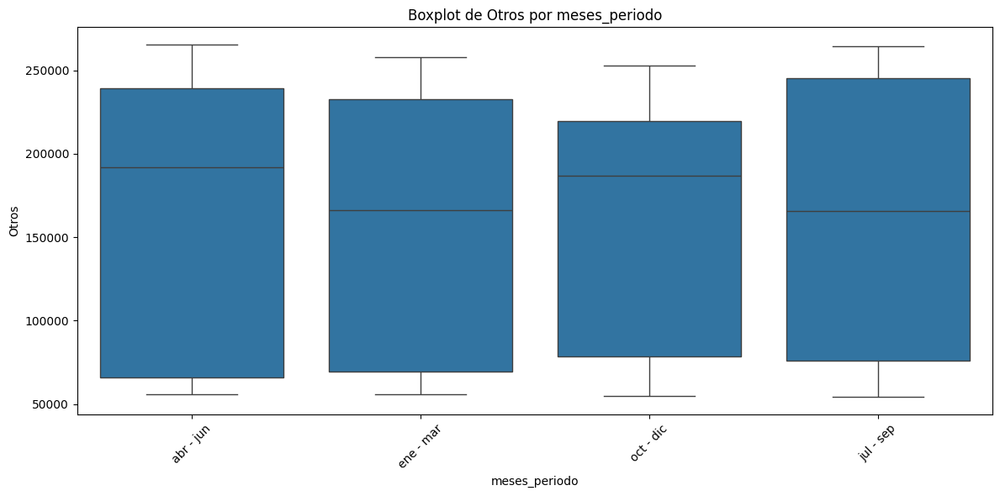


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count          mean           std        min         25%  \
meses_periodo                                                             
abr - jun       11.0  8.870168e+06  1.842689e+06  6464468.0  7279871.50   
ene - mar       11.0  8.726726e+06  1.855186e+06  6398398.0  7106605.00   
jul - sep       10.0  8.791373e+06  1.711951e+06  6595271.0  7336448.25   
oct - dic       10.0  8.878919e+06  1.771594e+06  6598496.0  7406310.25   

                     50%         75%         max  
meses_periodo                                     
abr - jun      8960181.0  10410884.0  11556107.0  
ene - mar      8648135.0  10135990.5  11633156.0  
jul - sep      8755859.5   9903205.5  11406908.0  
oct - dic      8633418.0  10260236.0  11547661.0  


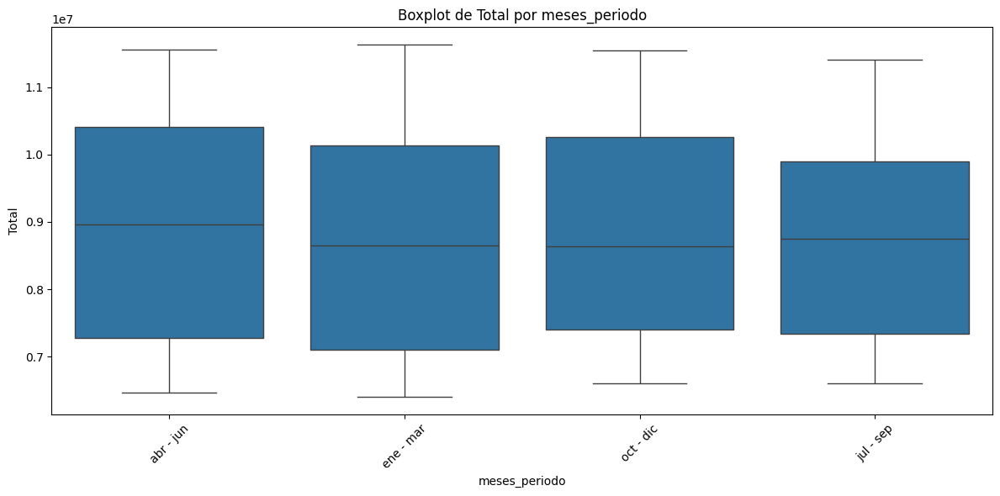

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [26]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
         Año  Trimestre      ADSL  Cablemodem  Fibra óptica  Wireless  \
0   1.724231  -0.404989 -1.813984    1.099405      2.256366  1.438988   
1   1.724231  -1.300229 -1.776080    1.191011      2.137730  1.466308   
2   1.395060   1.385490 -1.718817    1.218293      2.055820  1.401945   
3   1.395060   0.490250 -1.661933    1.215456      1.903010  1.380408   
4   1.395060  -0.404989 -1.561480    1.198827      1.715522  1.382336   
5   1.395060  -1.300229 -1.378442    1.202994      1.546538  1.356555   
6   1.065888   1.385490 -1.275823    1.229739      1.406468  1.338235   
7   1.065888   0.490250 -1.201922    1.225531      1.261649  1.259244   
8   1.065888  -0.404989 -1.134356    1.185073      1.148070  1.254925   
9   1.065888  -1.300229 -1.074325    1.257323      0.762146  1.202980   
10  0.736717   1.385490 -0.959295    1.188928      0.649302  1.089880   
11  0.736717   0.490250 -0.688296    1.067773      0.261511  0.937007   
12  0.736717  

In [27]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Periodo':
Periodo
Abr-Jun 2024     1
Ene-Mar 2024     1
Oct-Dic 2023     1
Jul-Sept 2023    1
Abr-Jun 2023     1
Ene-Mar 2023     1
Oct-Dic 2022     1
Jul-Sept 2022    1
Abr-Jun 2022     1
Ene-Mar 2022     1
Oct-Dic 2021     1
Jul-Sept 2021    1
Abr-Jun 2021     1
Ene-Mar 2021     1
Oct-Dic 2020     1
Jul-Sept 2020    1
Abr-Jun 2020     1
Ene-Mar 2020     1
Oct-Dic 2019     1
Jul-Sept 2019    1
Abr-Jun 2019     1
Ene-Mar 2019     1
Oct-Dic 2018     1
Jul-Sept 2018    1
Abr-Jun 2018     1
Ene-Mar 2018     1
Oct-Dic 2017     1
Jul-Sept 2017    1
Abr-Jun 2017     1
Ene-Mar 2017     1
Oct-Dic 2016     1
Jul-Sept 2016    1
Abr-Jun 2016     1
Ene-Mar 2016     1
Oct-Dic 2015     1
Jul-Sept 2015    1
Abr-Jun 2015     1
Ene-Mar 2015     1
Oct-Dic 2014     1
Jul-Sept 2014    1
Abr-Jun 2014     1
Ene-Mar 2014     1
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    1
Q1-2024    1
Q4-2023    1
Q3-2023    1
Q2

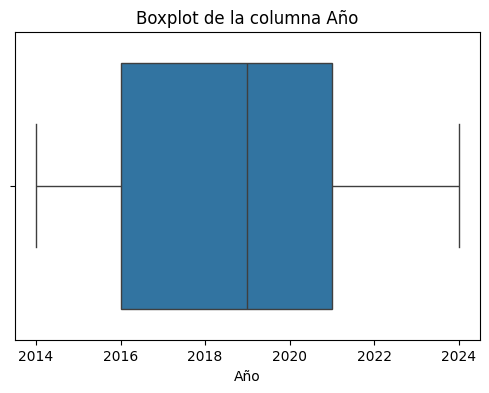

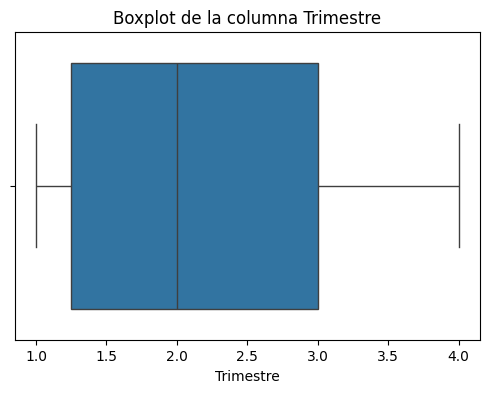

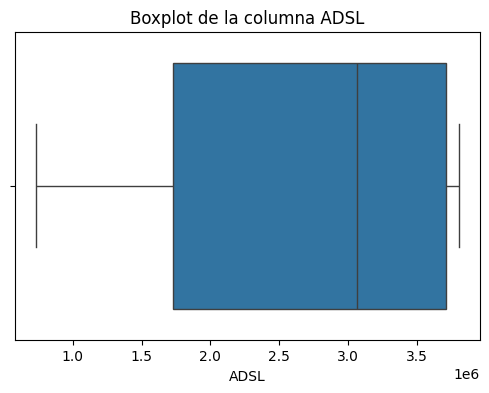

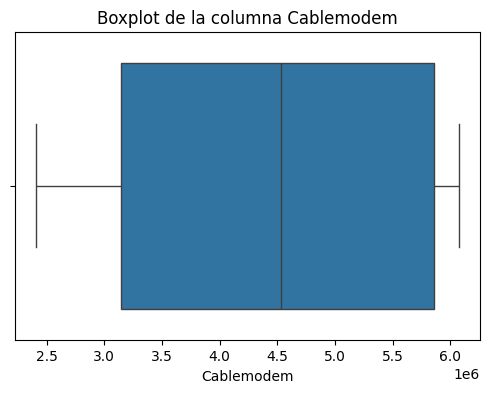

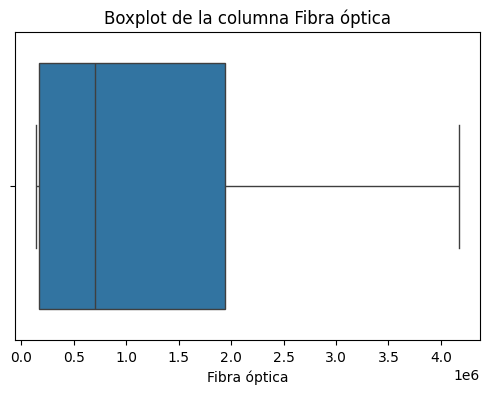

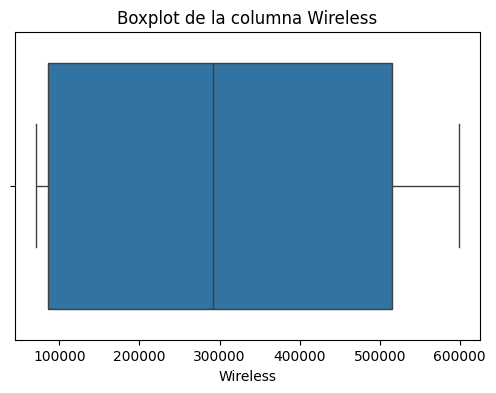

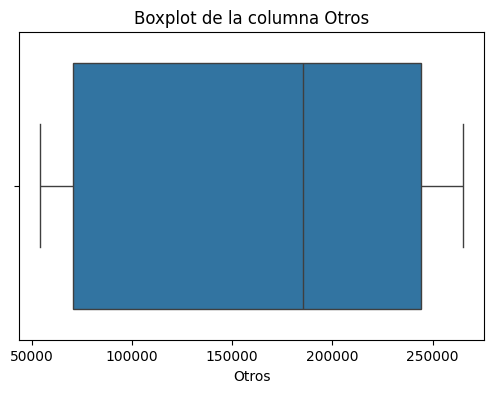

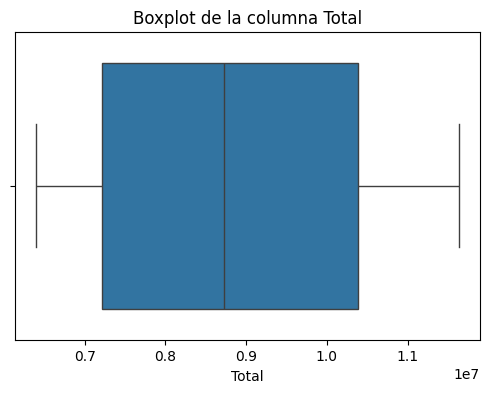

In [28]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [29]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Accesos Por Tecnología.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Accesos Por Tecnología.csv


In [30]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [31]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año             0.024172
Trimestre       0.070729
ADSL           -0.493080
Cablemodem     -0.136182
Fibra óptica    1.046036
Wireless        0.178800
Otros          -0.086408
Total           0.256071
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año            -1.186795
Trimestre      -1.371727
ADSL           -1.323894
Cablemodem     -1.546603
Fibra óptica   -0.299087
Wireless       -1.628079
Otros          -1.787841
Total          -1.319854
dtype: float64


In [32]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
       Variable           VIF
0         const  5.441139e+07
1           Año  1.247411e+02
2     Trimestre  2.394504e+00
3          ADSL           inf
4    Cablemodem           inf
5  Fibra óptica           inf
6      Wireless           inf
7         Otros           inf
8         Total           inf


c:\Program Files\Python313\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


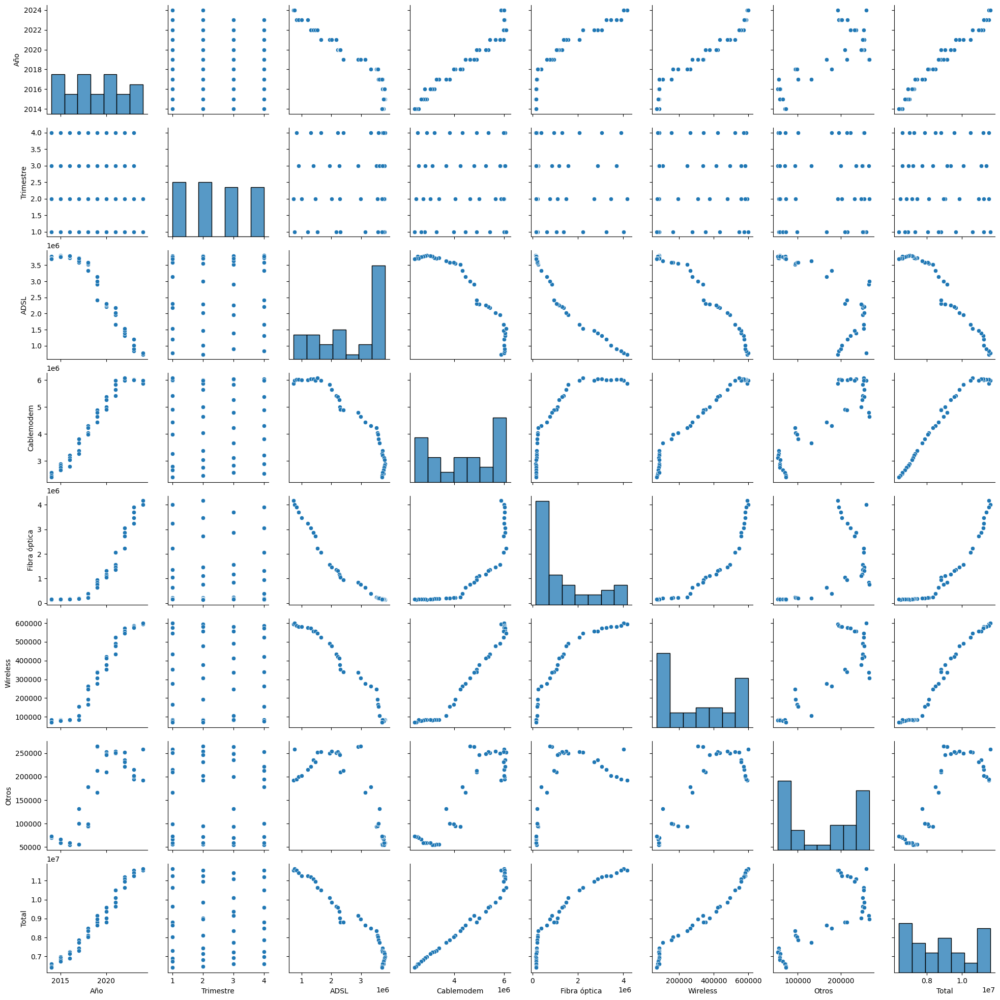

In [33]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [34]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Periodo':
                Año                                                      \
              count    mean std     min     25%     50%     75%     max   
Periodo                                                                   
Abr-Jun 2014    1.0  2014.0 NaN  2014.0  2014.0  2014.0  2014.0  2014.0   
Abr-Jun 2015    1.0  2015.0 NaN  2015.0  2015.0  2015.0  2015.0  2015.0   
Abr-Jun 2016    1.0  2016.0 NaN  2016.0  2016.0  2016.0  2016.0  2016.0   
Abr-Jun 2017    1.0  2017.0 NaN  2017.0  2017.0  2017.0  2017.0  2017.0   
Abr-Jun 2018    1.0  2018.0 NaN  2018.0  2018.0  2018.0  2018.0  2018.0   
Abr-Jun 2019    1.0  2019.0 NaN  2019.0  2019.0  2019.0  2019.0  2019.0   
Abr-Jun 2020    1.0  2020.0 NaN  2020.0  2020.0  2020.0  2020.0  2020.0   
Abr-Jun 2021    1.0  2021.0 NaN  2021.0  2021.0  2021.0  2021.0  2021.0   
Abr-Jun 2022    1.0  2022.0 NaN  2022.0  2022.0  2022.0  2022.0  2022.0   
Abr-Jun 2023    1.0  2023.0 NaN  2023.0  2023.0  2023.0  2023.

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Totales Dial-BAf.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre  Banda ancha fija  Dial up     Total        Periodo
0  2024          2          11544314    11793  11556107   Abr-Jun 2024
1  2024          1          11621363    11793  11633156   Ene-Mar 2024
2  2023          4          11535868    11793  11547661   Oct-Dic 2023
3  2023          3          11395115    11793  11406908  Jul-Sept 2023
4  2023          2          11239781    12116  11251897   Abr-Jun 2023


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Año               42 non-null     int64 
 1   Trimestre         42 non-null     int64 
 2   Banda ancha fija  42 non-null     int64 
 3   Dial up           42 non-null     int64 
 4   Total             42 non-null     int64 
 5   Periodo           42 non-null     object
dtypes: int64(5), object(1)
memory usage: 2.1+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2023          1       Q1-2023     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre  Banda ancha fija  Dial up     Total        Periodo  \
0  2024          2          11544314    11793  11556107   Abr-Jun 2024   
1  2024          1          11621363    11793  11633156   Ene-Mar 2024   
2  2023          4          11535868    11793  11547661   Oct-Dic 2023   
3  2023          3          11395115    11793  11406908  Jul-Sept 2023   
4  2023          2          11239781    12116  11251897   Abr-Jun 2023   

  Año_Trimestre meses_periodo  
0       Q2-2024     abr - jun  
1       Q1-2024     ene - mar  
2       Q4-2023     oct - dic  
3       Q3-2023     jul - sep  
4       Q2-2023     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                   int64
Trimestre             int64
Banda ancha fija      int64
Dial up             float64
Total                 int64
Periodo              object
Año_Trimestre        object
meses_periodo        object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               42 non-null     int64  
 1   Trimestre         42 non-null     int64  
 2   Banda ancha fija  42 non-null     int64  
 3   Dial up           42 non-null     float64
 4   Total             42 non-null     int64  
 5   Periodo           42 non-null     object 
 6   Año_Trimestre     42 non-null     object 
 7   meses_periodo     42 non-null     object 
dtypes: float64(1), int64(4), object(3)
memory usage: 2.8+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               42 non-null     int64  
 1   Trimestre         42 non-null     int64  
 2   Banda ancha fija  42 non-null     int64  
 3   Dial up           42 non-null     float64
 4   Total             42 non-null     int64  
 5   Periodo           42 non-null     object 
 6   Año_Trimestre     42 non-null     object 
 7   meses_periodo     42 non-null     object 
dtypes: float64(1), int64(4), object(3)
memory usage: 2.8+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               42 non-null     int64  
 1   Trimestre         42 non-null     int64  
 2   Banda ancha fija  42 non-null     int64  
 3   Dial up           42 non-null     float64
 4   Total             42 non-null     int64  
 5   Periodo           42 non-null     object 
 6   Año_Trimestre     42 non-null     object 
 7   meses_periodo     42 non-null     object 
dtypes: float64(1), int64(4), object(3)
memory usage: 2.8+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                 0
Trimestre           0
Banda ancha fija    0
Dial up             0
Total               0
Periodo             0
Año_Trimestre       0
meses_periodo       0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                 0
Trimestre           0
Banda ancha fija    0
Dial up             0
Total               0
Periodo             0
Año_Trimestre       0
meses_periodo       0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                 0
Trimestre           0
Banda ancha fija    0
Dial up             0
Total               0
Periodo             0
Año_Trimestre       0
meses_periodo       0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               42 non-null     int64  
 1   Trimestre         42 non-null     int64  
 2   Banda ancha fija  42 non-null     int64  
 3   Dial up           42 non-null     float64
 4   Total             42 non-null     int64  
 5   Periodo           42 non-null     object 
 6   Año_Trimestre     42 non-null     object 
 7   meses_periodo     42 non-null     object 
dtypes: float64(1), int64(4), object(3)
memory usage: 2.8+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre  Banda ancha fija       Dial up         Total  \
count     42.000000  42.000000      4.200000e+01     42.000000  4.200000e+01   
unique          NaN        NaN               NaN           NaN           NaN   
top             NaN        NaN               NaN           NaN           NaN   
freq            NaN        NaN               NaN           NaN           NaN   
mean    2018.761905   2.452381      8.794433e+06  21490.190476  8.815923e+06   
std        3.074756   1.130560      1.742229e+06  10136.781243  1.733189e+06   
min     2014.000000   1.000000      6.362108e+06   9991.000000  6.398398e+06   
25%     2016.000000   1.250000      7.189537e+06  11793.000000  7.218131e+06   
50%     2019.000000   2.000000      8.704688e+06  21802.500000  8.720658e+06   
75%     2021.000000   3.000000      1.037650e+07  28593.750000  1.038873e+07   
max     2024.000000   4.000000      1.162136e+

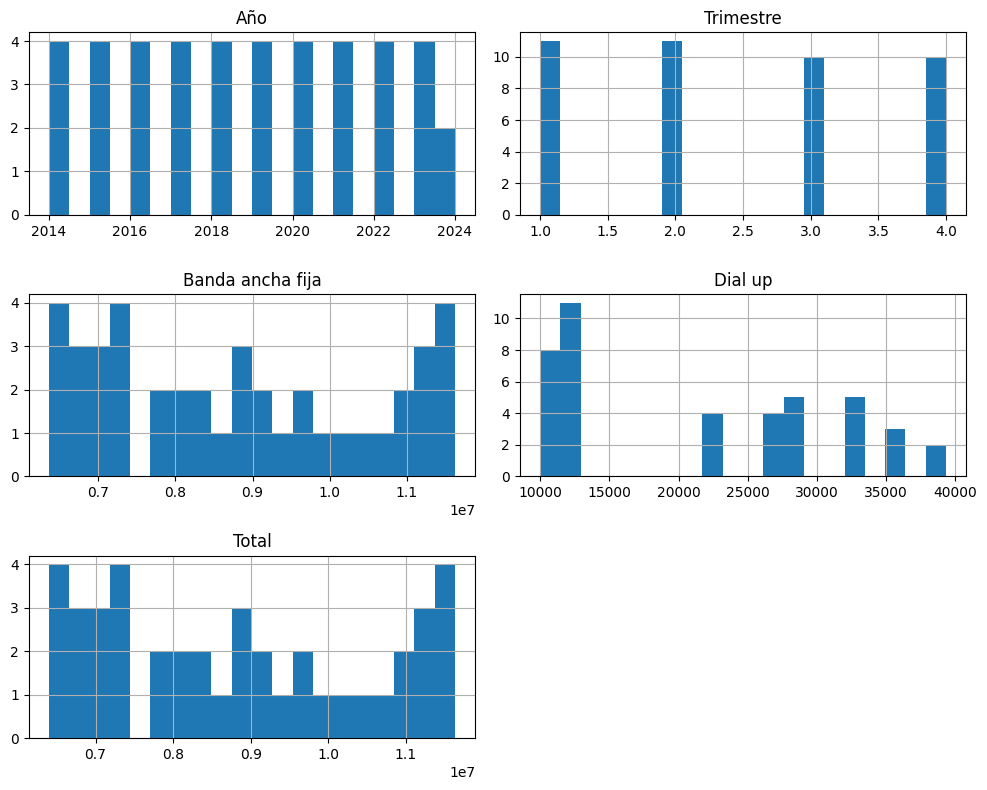

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                       Año  Trimestre  Banda ancha fija   Dial up     Total
Año               1.000000  -0.073505          0.985135 -0.920728  0.984889
Trimestre        -0.073505   1.000000          0.024918 -0.035652  0.024840
Banda ancha fija  0.985135   0.024918          1.000000 -0.892453  0.999997
Dial up          -0.920728  -0.035652         -0.892453  1.000000 -0.891260
Total             0.984889   0.024840          0.999997 -0.891260  1.000000

Correlaciones fuertes:
                       Año  Trimestre  Banda ancha fija   Dial up     Total
Año               1.000000        NaN          0.985135 -0.920728  0.984889
Trimestre              NaN        1.0               NaN       NaN       NaN
Banda ancha fija  0.985135        NaN          1.000000 -0.892453  0.999997
Dial up          -0.920728        NaN         -0.892453  1.000000 -0.891260
Total             0.984889        NaN          0.999997 -0.891260  1.000000


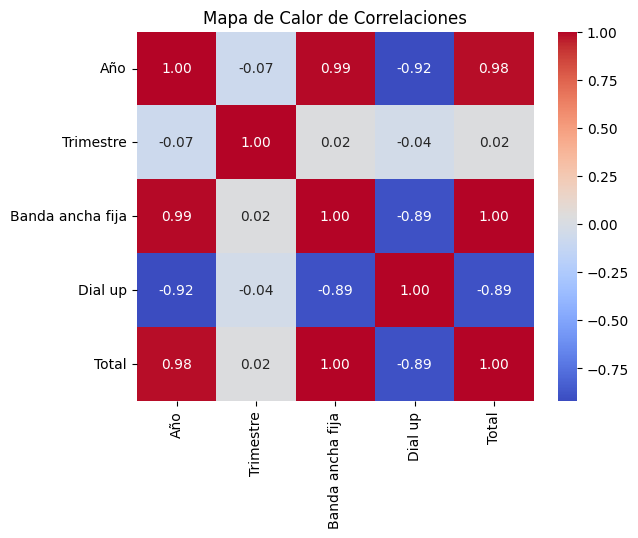

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Periodo y Año_Trimestre:
Año_Trimestre  Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  Q1-2020  \
Periodo                                                                        
Abr-Jun 2014         0        0        0        0        0        0        0   
Abr-Jun 2015         0        0        0        0        0        0        0   
Abr-Jun 2016         0        0        0        0        0        0        0   
Abr-Jun 2017         0        0        0        0        0        0        0   
Abr-Jun 2018         0        0        0        0        0        0        0   
Abr-Jun 2019         0        0        0        0        0        0        0   
Abr-Jun 2020         0        0        0        0        0        0        0   
Abr-Jun 2021         0        0        0        0        0        0        0   
Abr-Jun 2022         0        0        0        0        0        0        0   
Abr-Jun 2023         0        0        0        0        0        

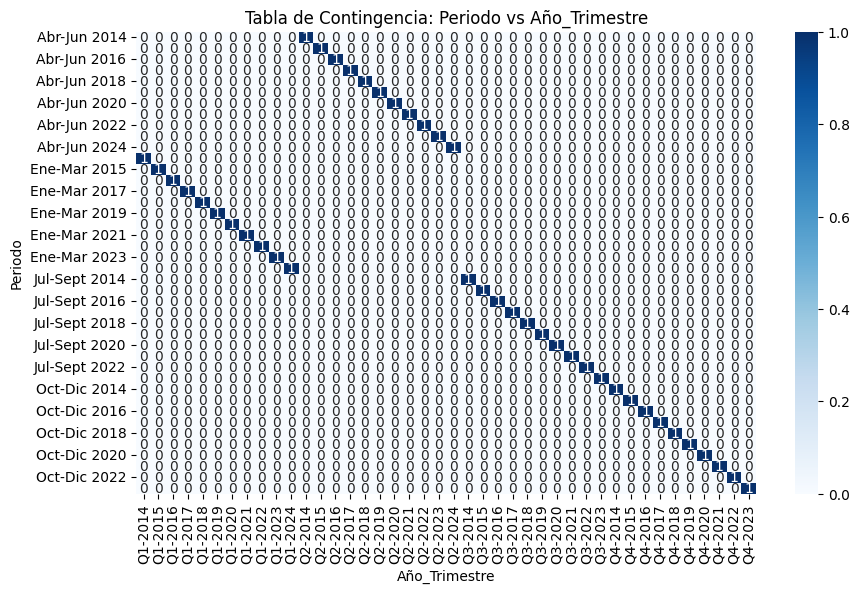


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
Abr-Jun 2014           1          0          0          0
Abr-Jun 2015           1          0          0          0
Abr-Jun 2016           1          0          0          0
Abr-Jun 2017           1          0          0          0
Abr-Jun 2018           1          0          0          0
Abr-Jun 2019           1          0          0          0
Abr-Jun 2020           1          0          0          0
Abr-Jun 2021           1          0          0          0
Abr-Jun 2022           1          0          0          0
Abr-Jun 2023           1          0          0          0
Abr-Jun 2024           1          0          0          0
Ene-Mar 2014           0          1          0          0
Ene-Mar 2015           0          1          0          0
Ene-Mar 2016           0          1          0          0
Ene-Mar 2017      

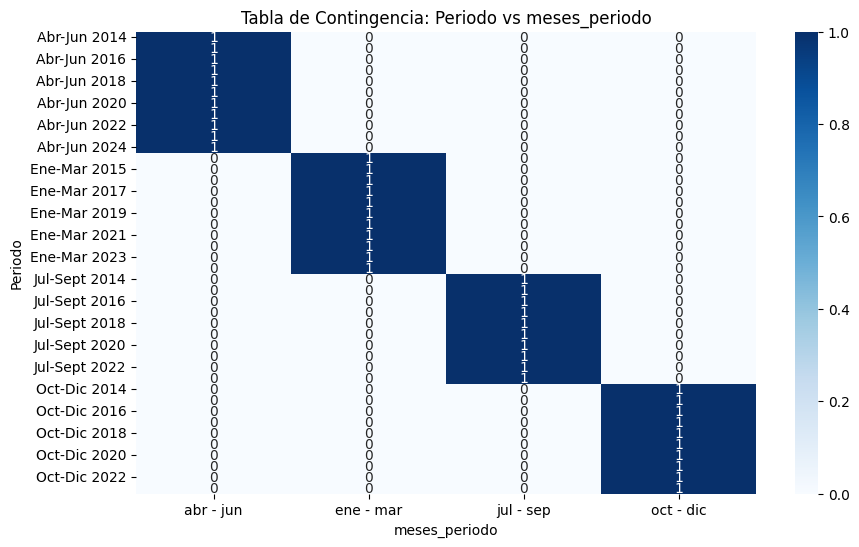


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2023                0          1          0          0
Q1-2024                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

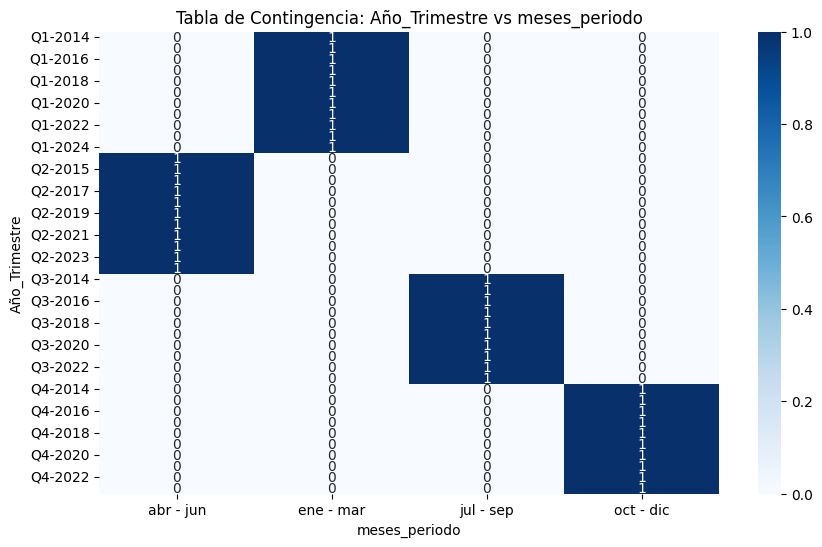

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
               count    mean  std     min     25%     50%     75%     max
Periodo                                                                  
Abr-Jun 2014     1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Abr-Jun 2015     1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Abr-Jun 2016     1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Abr-Jun 2017     1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Abr-Jun 2018     1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Abr-Jun 2019     1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Abr-Jun 2020     1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Abr-Jun 2021     1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Abr-Jun 2022     1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Abr-Jun 2023     1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Abr-Jun 2024     1.0  2024.0  NaN  2024.0  2024.0  

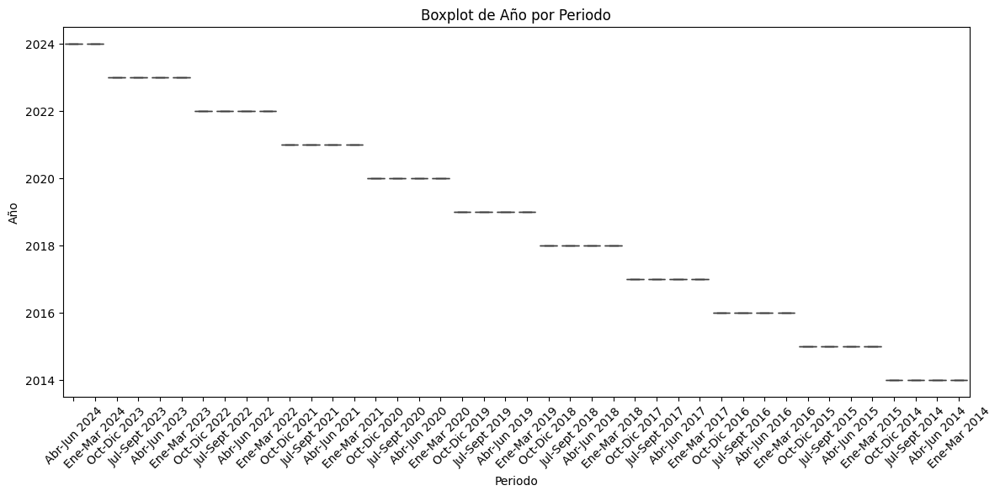


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
               count  mean  std  min  25%  50%  75%  max
Periodo                                                 
Abr-Jun 2014     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2015     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2016     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2017     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2018     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2019     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2020     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2021     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2022     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2023     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2024     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Ene-Mar 2014     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2015     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2016     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2017     1.0 

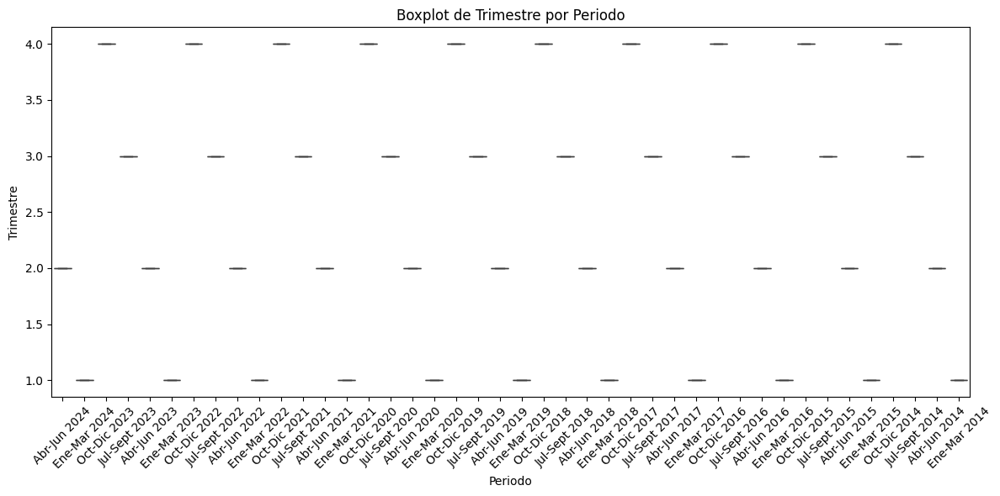


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'Periodo':
               count        mean  std         min         25%         50%  \
Periodo                                                                     
Abr-Jun 2014     1.0   6428329.0  NaN   6428329.0   6428329.0   6428329.0   
Abr-Jun 2015     1.0   6783279.0  NaN   6783279.0   6783279.0   6783279.0   
Abr-Jun 2016     1.0   7097604.0  NaN   7097604.0   7097604.0   7097604.0   
Abr-Jun 2017     1.0   7401134.0  NaN   7401134.0   7401134.0   7401134.0   
Abr-Jun 2018     1.0   8083533.0  NaN   8083533.0   8083533.0   8083533.0   
Abr-Jun 2019     1.0   8938427.0  NaN   8938427.0   8938427.0   8938427.0   
Abr-Jun 2020     1.0   9021040.0  NaN   9021040.0   9021040.0   9021040.0   
Abr-Jun 2021     1.0   9852702.0  NaN   9852702.0   9852702.0   9852702.0   
Abr-Jun 2022     1.0  10946248.0  NaN  10946248.0  10946248.0  10946248.0   
Abr-Jun 2023     1.0  11239781.0  NaN  11239781.0  11239781.0  11239781.0   
Ab

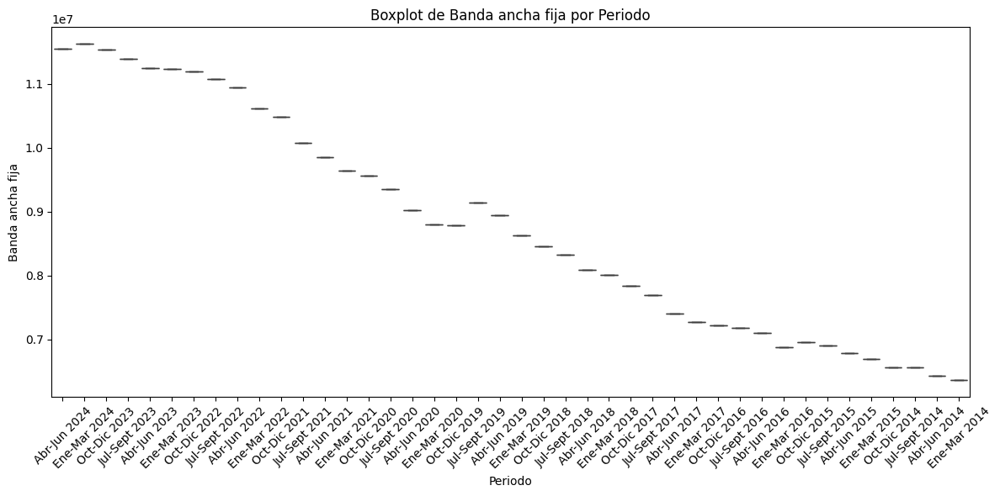


Estadísticas descriptivas de 'Dial up' agrupadas por 'Periodo':
               count     mean  std      min      25%      50%      75%  \
Periodo                                                                  
Abr-Jun 2014     1.0  36139.0  NaN  36139.0  36139.0  36139.0  36139.0   
Abr-Jun 2015     1.0  32909.0  NaN  32909.0  32909.0  32909.0  32909.0   
Abr-Jun 2016     1.0  32475.0  NaN  32475.0  32475.0  32475.0  32475.0   
Abr-Jun 2017     1.0  28530.0  NaN  28530.0  28530.0  28530.0  28530.0   
Abr-Jun 2018     1.0  26911.0  NaN  26911.0  26911.0  26911.0  26911.0   
Abr-Jun 2019     1.0  21754.0  NaN  21754.0  21754.0  21754.0  21754.0   
Abr-Jun 2020     1.0  10016.0  NaN  10016.0  10016.0  10016.0  10016.0   
Abr-Jun 2021     1.0  10382.0  NaN  10382.0  10382.0  10382.0  10382.0   
Abr-Jun 2022     1.0  12436.0  NaN  12436.0  12436.0  12436.0  12436.0   
Abr-Jun 2023     1.0  12116.0  NaN  12116.0  12116.0  12116.0  12116.0   
Abr-Jun 2024     1.0  11793.0  NaN  11793.0  11

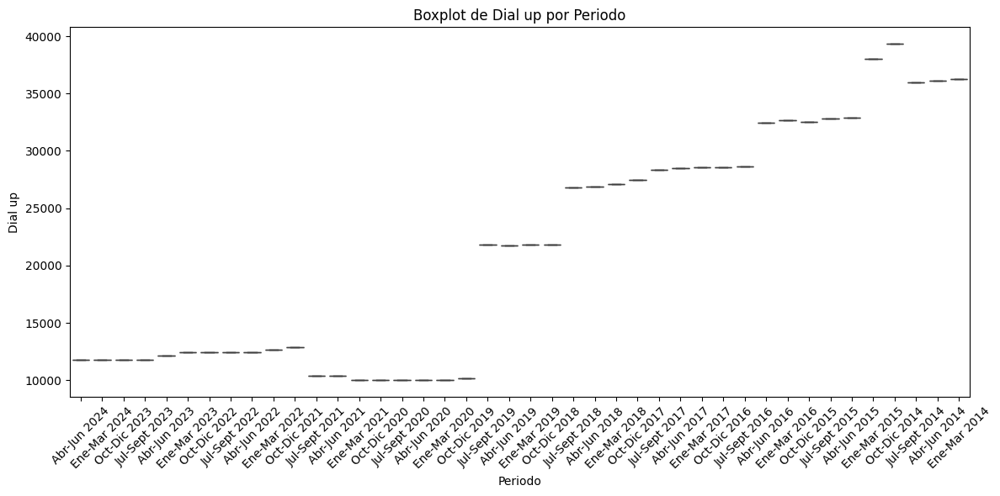


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
               count        mean  std         min         25%         50%  \
Periodo                                                                     
Abr-Jun 2014     1.0   6464468.0  NaN   6464468.0   6464468.0   6464468.0   
Abr-Jun 2015     1.0   6816188.0  NaN   6816188.0   6816188.0   6816188.0   
Abr-Jun 2016     1.0   7130079.0  NaN   7130079.0   7130079.0   7130079.0   
Abr-Jun 2017     1.0   7429664.0  NaN   7429664.0   7429664.0   7429664.0   
Abr-Jun 2018     1.0   8110444.0  NaN   8110444.0   8110444.0   8110444.0   
Abr-Jun 2019     1.0   8960181.0  NaN   8960181.0   8960181.0   8960181.0   
Abr-Jun 2020     1.0   9031056.0  NaN   9031056.0   9031056.0   9031056.0   
Abr-Jun 2021     1.0   9863084.0  NaN   9863084.0   9863084.0   9863084.0   
Abr-Jun 2022     1.0  10958684.0  NaN  10958684.0  10958684.0  10958684.0   
Abr-Jun 2023     1.0  11251897.0  NaN  11251897.0  11251897.0  11251897.0   
Abr-Jun 2024 

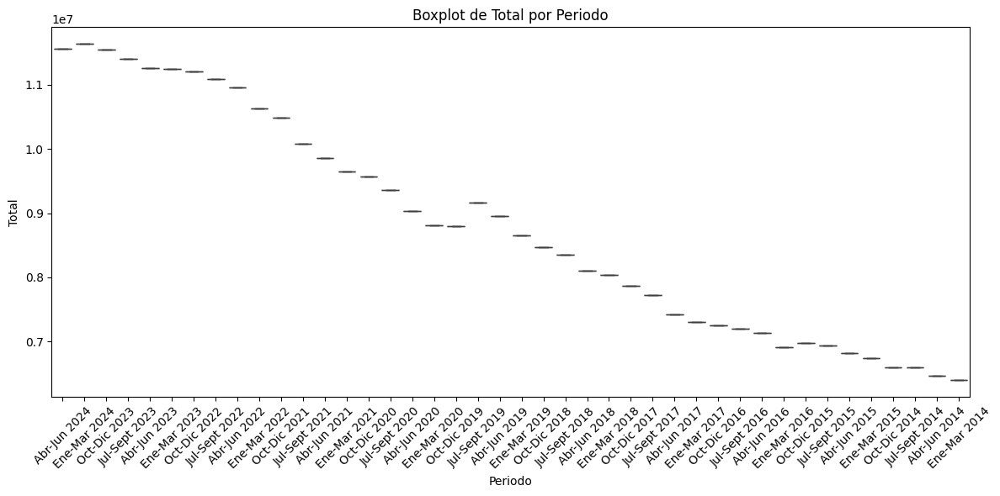


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023          1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024          1.0  2024.0  NaN  2024.0  20

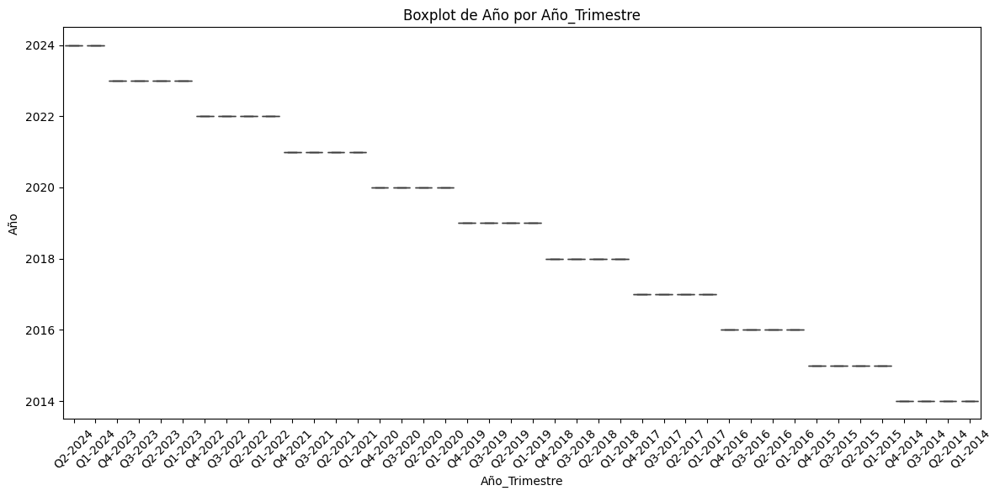


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2023          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

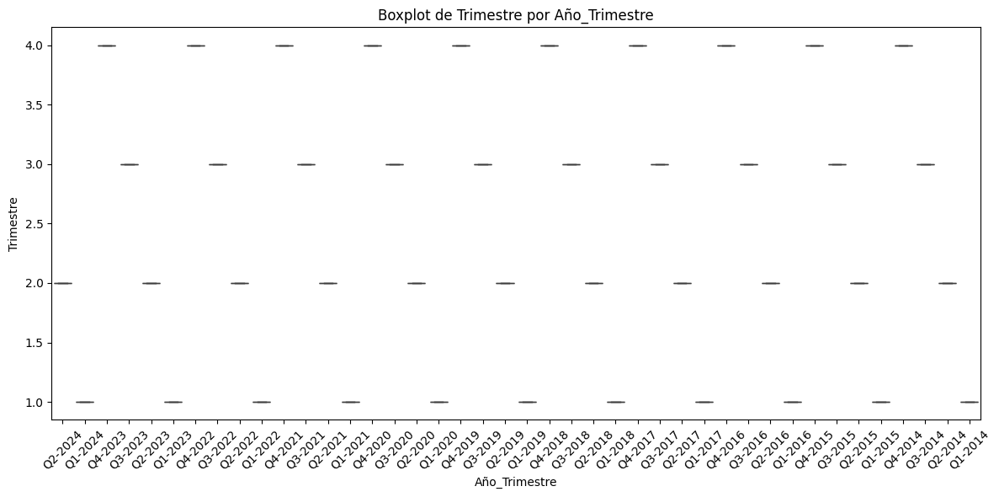


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'Año_Trimestre':
               count        mean  std         min         25%         50%  \
Año_Trimestre                                                               
Q1-2014          1.0   6362108.0  NaN   6362108.0   6362108.0   6362108.0   
Q1-2015          1.0   6699714.0  NaN   6699714.0   6699714.0   6699714.0   
Q1-2016          1.0   6874704.0  NaN   6874704.0   6874704.0   6874704.0   
Q1-2017          1.0   7277314.0  NaN   7277314.0   7277314.0   7277314.0   
Q1-2018          1.0   8009981.0  NaN   8009981.0   8009981.0   8009981.0   
Q1-2019          1.0   8626323.0  NaN   8626323.0   8626323.0   8626323.0   
Q1-2020          1.0   8802435.0  NaN   8802435.0   8802435.0   8802435.0   
Q1-2021          1.0   9637956.0  NaN   9637956.0   9637956.0   9637956.0   
Q1-2022          1.0  10611390.0  NaN  10611390.0  10611390.0  10611390.0   
Q1-2023          1.0  11229459.0  NaN  11229459.0  11229459.0  11229459.0

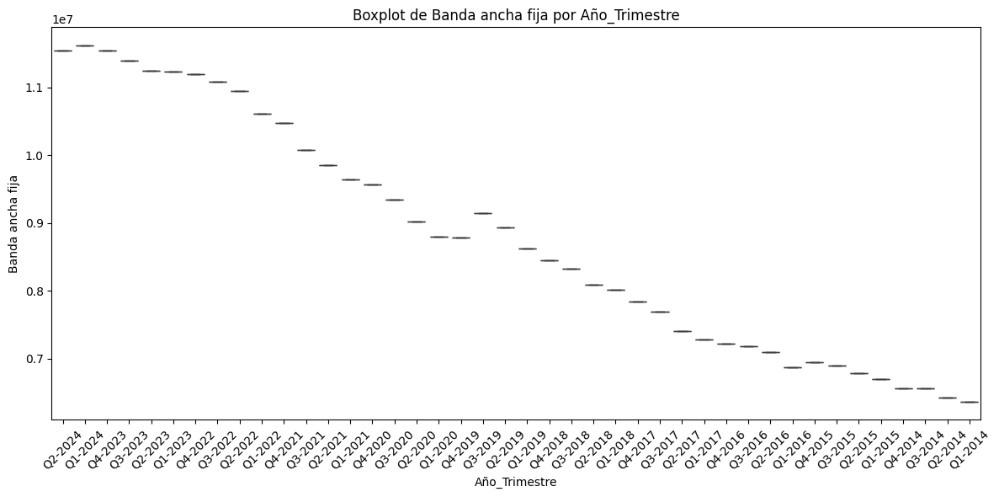


Estadísticas descriptivas de 'Dial up' agrupadas por 'Año_Trimestre':
               count     mean  std      min      25%      50%      75%  \
Año_Trimestre                                                            
Q1-2014          1.0  36290.0  NaN  36290.0  36290.0  36290.0  36290.0   
Q1-2015          1.0  38018.0  NaN  38018.0  38018.0  38018.0  38018.0   
Q1-2016          1.0  32652.0  NaN  32652.0  32652.0  32652.0  32652.0   
Q1-2017          1.0  28540.0  NaN  28540.0  28540.0  28540.0  28540.0   
Q1-2018          1.0  27072.0  NaN  27072.0  27072.0  27072.0  27072.0   
Q1-2019          1.0  21812.0  NaN  21812.0  21812.0  21812.0  21812.0   
Q1-2020          1.0   9991.0  NaN   9991.0   9991.0   9991.0   9991.0   
Q1-2021          1.0  10016.0  NaN  10016.0  10016.0  10016.0  10016.0   
Q1-2022          1.0  12619.0  NaN  12619.0  12619.0  12619.0  12619.0   
Q1-2023          1.0  12436.0  NaN  12436.0  12436.0  12436.0  12436.0   
Q1-2024          1.0  11793.0  NaN  11793

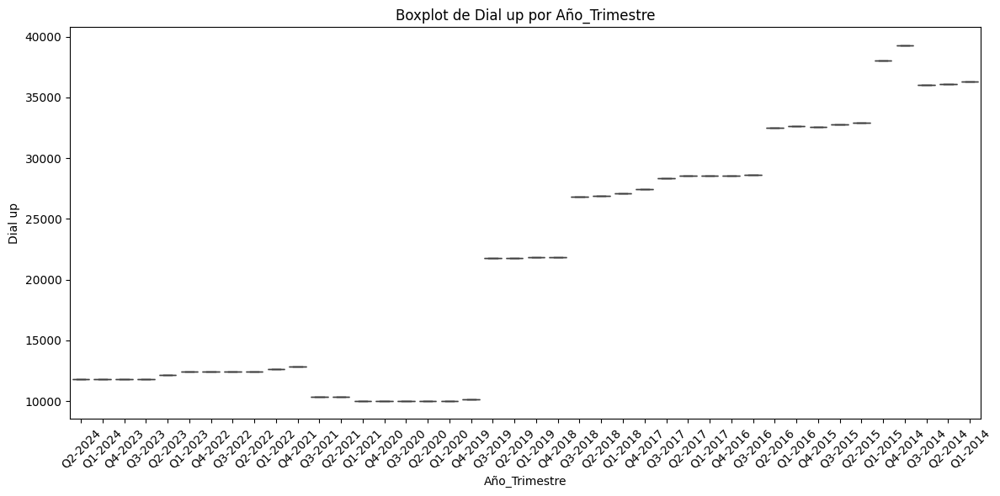


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count        mean  std         min         25%         50%  \
Año_Trimestre                                                               
Q1-2014          1.0   6398398.0  NaN   6398398.0   6398398.0   6398398.0   
Q1-2015          1.0   6737732.0  NaN   6737732.0   6737732.0   6737732.0   
Q1-2016          1.0   6907356.0  NaN   6907356.0   6907356.0   6907356.0   
Q1-2017          1.0   7305854.0  NaN   7305854.0   7305854.0   7305854.0   
Q1-2018          1.0   8037053.0  NaN   8037053.0   8037053.0   8037053.0   
Q1-2019          1.0   8648135.0  NaN   8648135.0   8648135.0   8648135.0   
Q1-2020          1.0   8812426.0  NaN   8812426.0   8812426.0   8812426.0   
Q1-2021          1.0   9647972.0  NaN   9647972.0   9647972.0   9647972.0   
Q1-2022          1.0  10624009.0  NaN  10624009.0  10624009.0  10624009.0   
Q1-2023          1.0  11241895.0  NaN  11241895.0  11241895.0  11241895.0   
Q1-2024

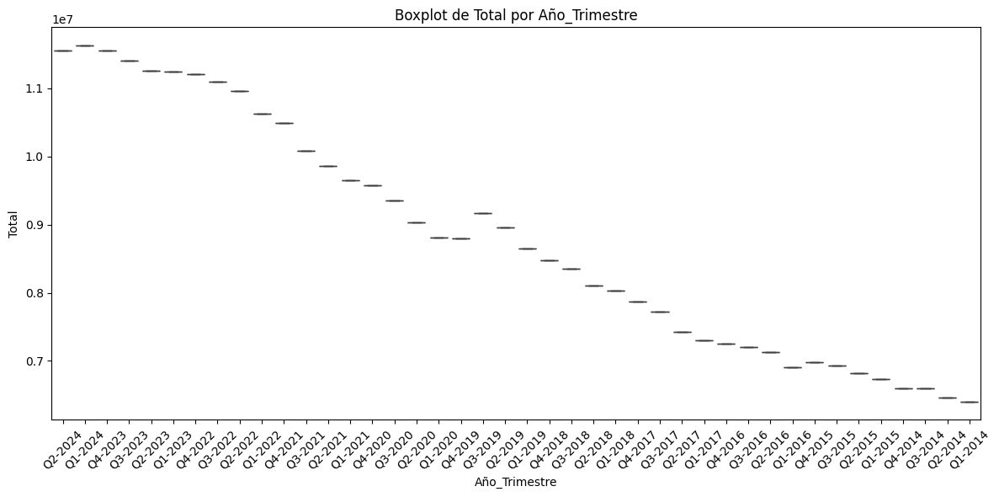


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min      25%     50%      75%  \
meses_periodo                                                              
abr - jun       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


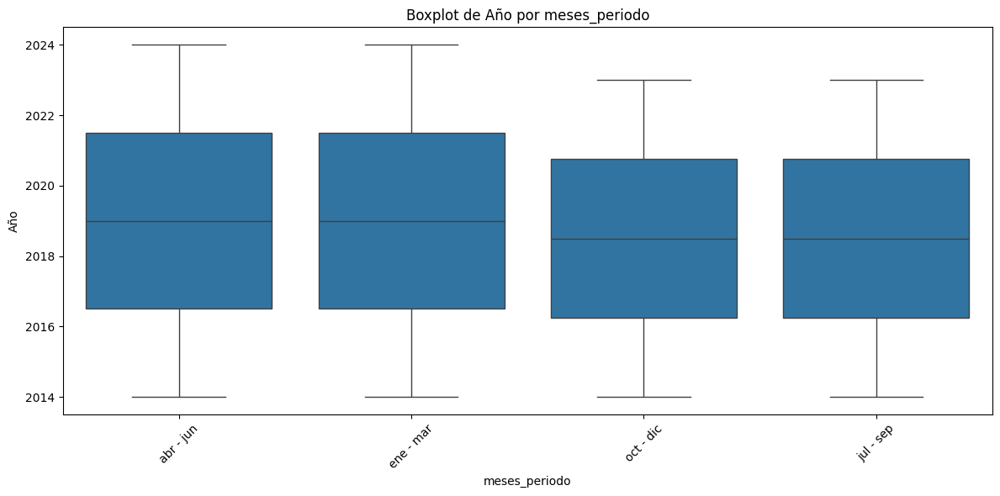


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


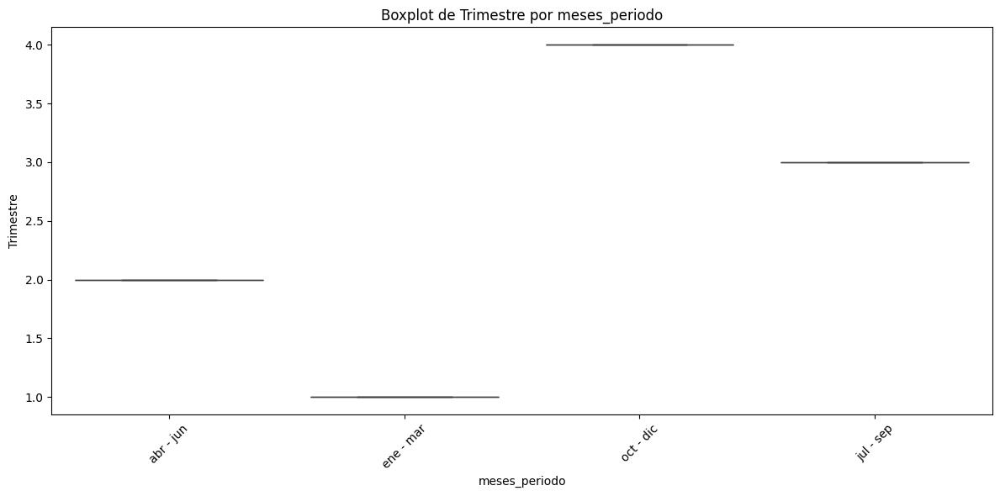


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'meses_periodo':
               count          mean           std        min        25%  \
meses_periodo                                                            
abr - jun       11.0  8.848763e+06  1.852040e+06  6428329.0  7249369.0   
ene - mar       11.0  8.704795e+06  1.864943e+06  6362108.0  7076009.0   
jul - sep       10.0  8.769475e+06  1.721094e+06  6559264.0  7307903.5   
oct - dic       10.0  8.858228e+06  1.780824e+06  6559172.0  7378040.5   

                     50%          75%         max  
meses_periodo                                      
abr - jun      8938427.0  10399475.00  11544314.0  
ene - mar      8626323.0  10124673.00  11621363.0  
jul - sep      8731557.0   9892933.75  11395115.0  
oct - dic      8617447.0  10248086.25  11535868.0  


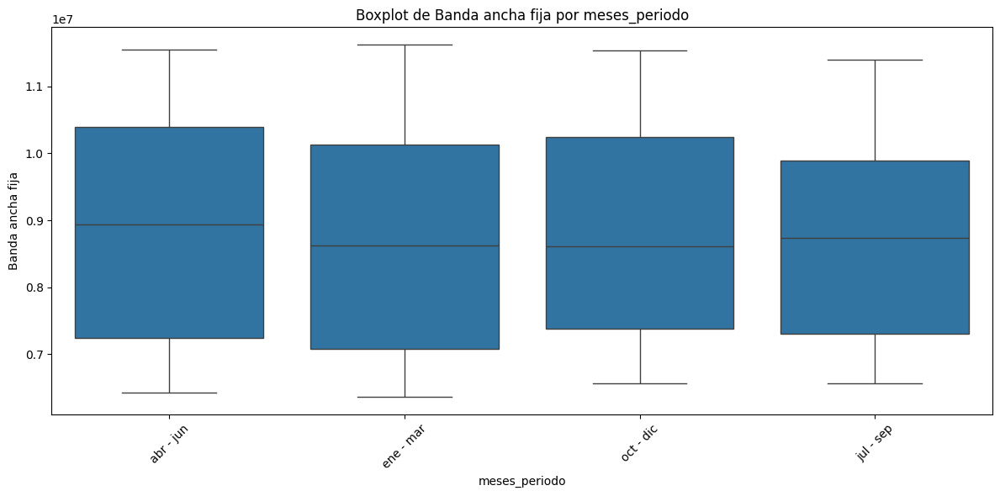


Estadísticas descriptivas de 'Dial up' agrupadas por 'meses_periodo':
               count          mean           std      min       25%      50%  \
meses_periodo                                                                  
abr - jun       11.0  21405.545455  10312.691243  10016.0  11954.50  21754.0   
ene - mar       11.0  21930.818182  11019.135409   9991.0  12114.50  21812.0   
jul - sep       10.0  21897.500000   9970.858675  10016.0  11954.00  24302.5   
oct - dic       10.0  20691.300000  10698.807130  10016.0  11956.25  17337.5   

                    75%      max  
meses_periodo                     
abr - jun      30502.50  36139.0  
ene - mar      30596.00  38018.0  
jul - sep      28544.75  36007.0  
oct - dic      28269.75  39324.0  


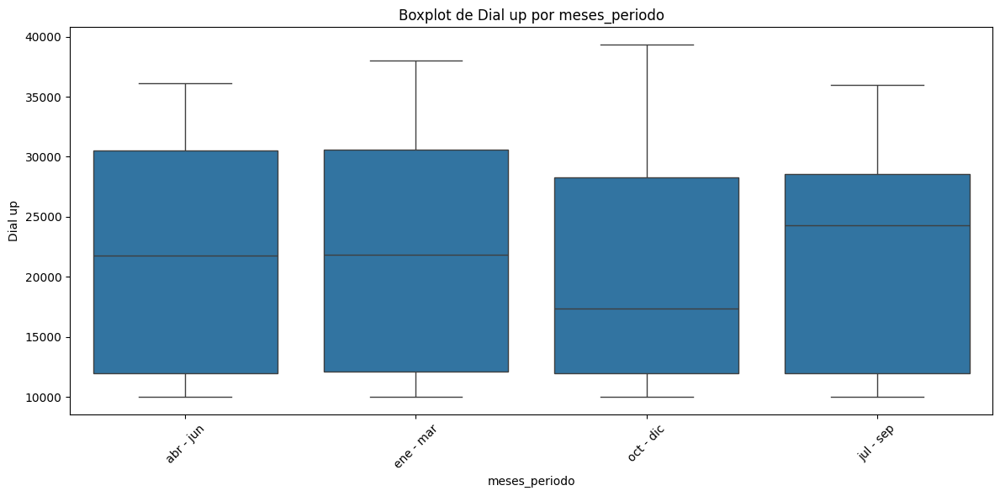


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count          mean           std        min         25%  \
meses_periodo                                                             
abr - jun       11.0  8.870168e+06  1.842689e+06  6464468.0  7279871.50   
ene - mar       11.0  8.726726e+06  1.855186e+06  6398398.0  7106605.00   
jul - sep       10.0  8.791373e+06  1.711951e+06  6595271.0  7336448.25   
oct - dic       10.0  8.878919e+06  1.771594e+06  6598496.0  7406310.25   

                     50%         75%         max  
meses_periodo                                     
abr - jun      8960181.0  10410884.0  11556107.0  
ene - mar      8648135.0  10135990.5  11633156.0  
jul - sep      8755859.5   9903205.5  11406908.0  
oct - dic      8633418.0  10260236.0  11547661.0  


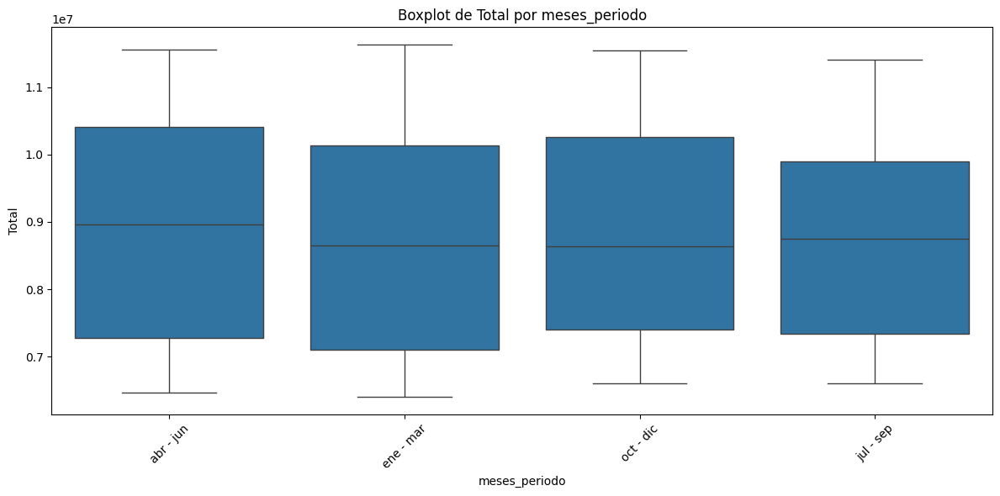

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [26]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
         Año  Trimestre  Banda ancha fija   Dial up     Total
0   1.724231  -0.404989          1.597502 -0.968230  1.600172
1   1.724231  -1.300229          1.642262 -0.968230  1.645166
2   1.395060   1.385490          1.592595 -0.968230  1.595240
3   1.395060   0.490250          1.510827 -0.968230  1.513045
4   1.395060  -0.404989          1.420588 -0.935980  1.422524
5   1.395060  -1.300229          1.414592 -0.904029  1.416683
6   1.065888   1.385490          1.394961 -0.903030  1.396956
7   1.065888   0.490250          1.327005 -0.903929  1.328640
8   1.065888  -0.404989          1.250065 -0.904029  1.251298
9   1.065888  -1.300229          1.055534 -0.885757  1.055859
10  0.736717   1.385490          0.977423 -0.861594  0.977482
11  0.736717   0.490250          0.744033 -1.111610  0.741413
12  0.736717  -0.404989          0.614786 -1.109113  0.611506
13  0.736717  -1.300229          0.490032 -1.145657  0.485888
14  0.407546   1.385490          

In [27]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Periodo':
Periodo
Abr-Jun 2024     1
Ene-Mar 2024     1
Oct-Dic 2023     1
Jul-Sept 2023    1
Abr-Jun 2023     1
Ene-Mar 2023     1
Oct-Dic 2022     1
Jul-Sept 2022    1
Abr-Jun 2022     1
Ene-Mar 2022     1
Oct-Dic 2021     1
Jul-Sept 2021    1
Abr-Jun 2021     1
Ene-Mar 2021     1
Oct-Dic 2020     1
Jul-Sept 2020    1
Abr-Jun 2020     1
Ene-Mar 2020     1
Oct-Dic 2019     1
Jul-Sept 2019    1
Abr-Jun 2019     1
Ene-Mar 2019     1
Oct-Dic 2018     1
Jul-Sept 2018    1
Abr-Jun 2018     1
Ene-Mar 2018     1
Oct-Dic 2017     1
Jul-Sept 2017    1
Abr-Jun 2017     1
Ene-Mar 2017     1
Oct-Dic 2016     1
Jul-Sept 2016    1
Abr-Jun 2016     1
Ene-Mar 2016     1
Oct-Dic 2015     1
Jul-Sept 2015    1
Abr-Jun 2015     1
Ene-Mar 2015     1
Oct-Dic 2014     1
Jul-Sept 2014    1
Abr-Jun 2014     1
Ene-Mar 2014     1
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    1
Q1-2024    1
Q4-2023    1
Q3-2023    1
Q2

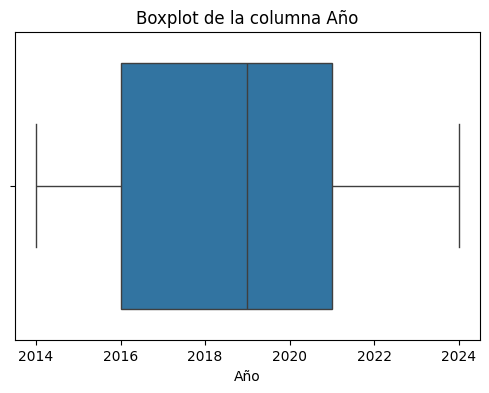

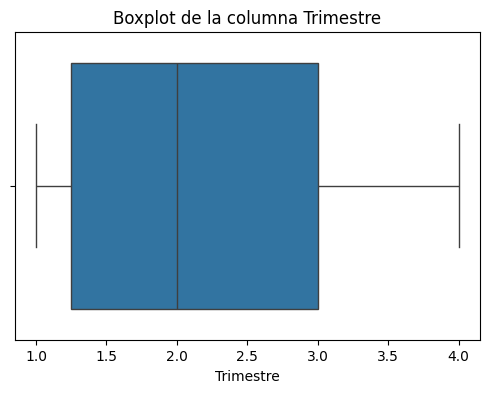

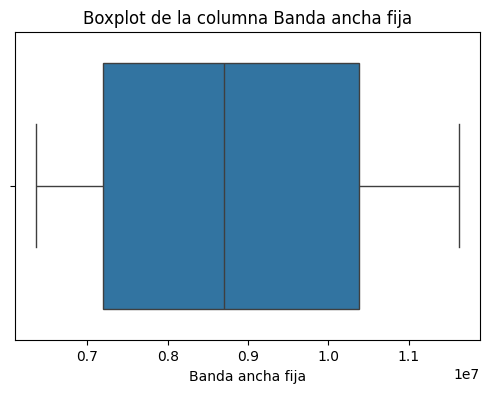

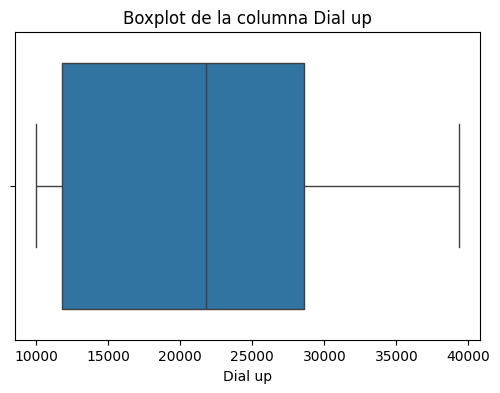

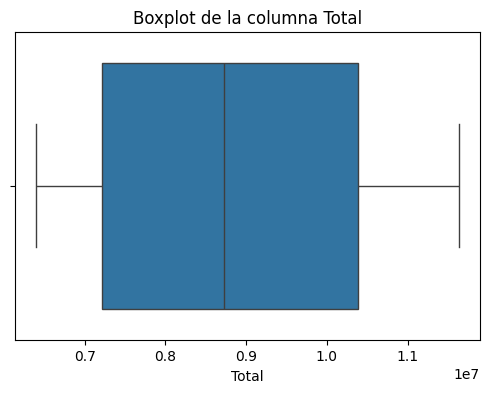

In [28]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [29]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Dial-BAf.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Dial-BAf.csv


In [30]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [31]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                 0.024172
Trimestre           0.070729
Banda ancha fija    0.251490
Dial up             0.209069
Total               0.256071
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                -1.186795
Trimestre          -1.371727
Banda ancha fija   -1.323499
Dial up            -1.562835
Total              -1.319854
dtype: float64


In [32]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
           Variable           VIF
0             const  4.025931e+07
1               Año  9.211265e+01
2         Trimestre  1.940075e+00
3  Banda ancha fija           inf
4           Dial up           inf
5             Total           inf


c:\Program Files\Python313\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


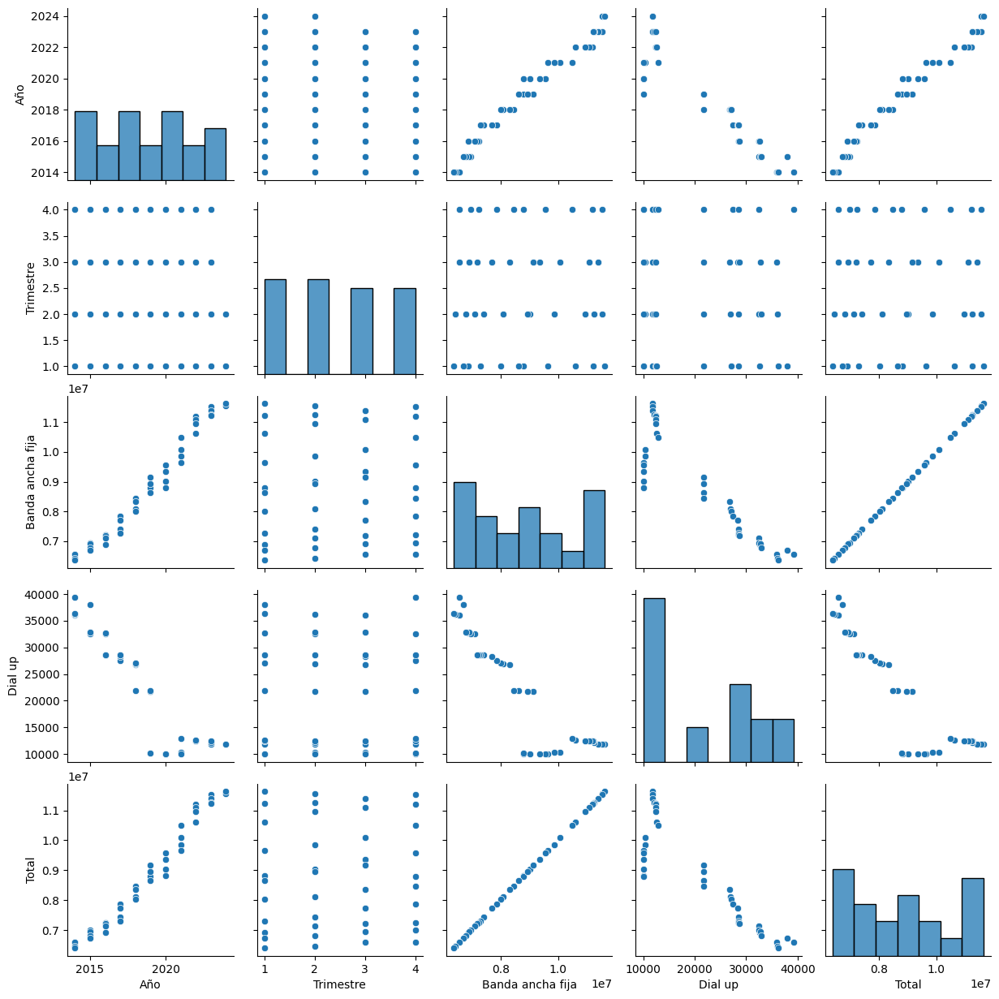

In [33]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [34]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Periodo':
                Año                                                      \
              count    mean std     min     25%     50%     75%     max   
Periodo                                                                   
Abr-Jun 2014    1.0  2014.0 NaN  2014.0  2014.0  2014.0  2014.0  2014.0   
Abr-Jun 2015    1.0  2015.0 NaN  2015.0  2015.0  2015.0  2015.0  2015.0   
Abr-Jun 2016    1.0  2016.0 NaN  2016.0  2016.0  2016.0  2016.0  2016.0   
Abr-Jun 2017    1.0  2017.0 NaN  2017.0  2017.0  2017.0  2017.0  2017.0   
Abr-Jun 2018    1.0  2018.0 NaN  2018.0  2018.0  2018.0  2018.0  2018.0   
Abr-Jun 2019    1.0  2019.0 NaN  2019.0  2019.0  2019.0  2019.0  2019.0   
Abr-Jun 2020    1.0  2020.0 NaN  2020.0  2020.0  2020.0  2020.0  2020.0   
Abr-Jun 2021    1.0  2021.0 NaN  2021.0  2021.0  2021.0  2021.0  2021.0   
Abr-Jun 2022    1.0  2022.0 NaN  2022.0  2022.0  2022.0  2022.0  2022.0   
Abr-Jun 2023    1.0  2023.0 NaN  2023.0  2023.0  2023.0  2023.

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Dial-BAf.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre        Provincia  Banda ancha fija  Dial up    Total
0  2024          2     Buenos Aires           4983480   5900.0  4989380
1  2024          2  Capital Federal           1461549   2050.0  1463599
2  2024          2        Catamarca             75073      1.0    75074
3  2024          2            Chaco            147087      5.0   147092
4  2024          2           Chubut            173366    857.0   174223


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1992 entries, 0 to 1991
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               1992 non-null   int64  
 1   Trimestre         1992 non-null   int64  
 2   Provincia         1992 non-null   object 
 3   Banda ancha fija  1992 non-null   int64  
 4   Dial up           1988 non-null   float64
 5   Total             1992 non-null   int64  
dtypes: float64(1), int64(4), object(1)
memory usage: 93.5+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

       Año  Trimestre Año_Trimestre meses_periodo
0     2024          2       Q2-2024     abr - jun
1     2024          2       Q2-2024     abr - jun
2     2024          2       Q2-2024     abr - jun
3     2024          2       Q2-2024     abr - jun
4     2024          2       Q2-2024     abr - jun
...    ...        ...           ...           ...
1987  2014          1       Q1-2014     ene - mar
1988  2014          1       Q1-2014     ene - mar
1989  2014          1       Q1-2014     ene - mar
1990  2014          1       Q1-2014     ene - mar
1991  2014          1       Q1-2014     ene - mar

[1992 rows x 4 columns]


In [5]:
print(df.head())

    Año  Trimestre        Provincia  Banda ancha fija  Dial up    Total  \
0  2024          2     Buenos Aires           4983480   5900.0  4989380   
1  2024          2  Capital Federal           1461549   2050.0  1463599   
2  2024          2        Catamarca             75073      1.0    75074   
3  2024          2            Chaco            147087      5.0   147092   
4  2024          2           Chubut            173366    857.0   174223   

  Año_Trimestre     Periodo meses_periodo  
0       Q2-2024  01-03-2024     abr - jun  
1       Q2-2024  01-03-2024     abr - jun  
2       Q2-2024  01-03-2024     abr - jun  
3       Q2-2024  01-03-2024     abr - jun  
4       Q2-2024  01-03-2024     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                   int64
Trimestre             int64
Provincia            object
Banda ancha fija      int64
Dial up             float64
Total                 int64
Año_Trimestre        object
Periodo              object
meses_periodo        object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1992 entries, 0 to 1991
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               1992 non-null   int64  
 1   Trimestre         1992 non-null   int64  
 2   Provincia         1992 non-null   object 
 3   Banda ancha fija  1992 non-null   int64  
 4   Dial up           1988 non-null   float64
 5   Total             1992 non-null   int64  
 6   Año_Trimestre     1992 non-null   object 
 7   Periodo           1992 non-null   object 
 8   meses_periodo     1992 non-null   object 
dtypes: float64(1), int64(4), object(4)
memory usage: 140.2+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
984


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1992 entries, 0 to 1991
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               1992 non-null   int64  
 1   Trimestre         1992 non-null   int64  
 2   Provincia         1992 non-null   object 
 3   Banda ancha fija  1992 non-null   int64  
 4   Dial up           1988 non-null   float64
 5   Total             1992 non-null   int64  
 6   Año_Trimestre     1992 non-null   object 
 7   Periodo           1992 non-null   object 
 8   meses_periodo     1992 non-null   object 
dtypes: float64(1), int64(4), object(4)
memory usage: 140.2+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1992 entries, 0 to 1991
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               1992 non-null   int64  
 1   Trimestre         1992 non-null   int64  
 2   Provincia         1992 non-null   object 
 3   Banda ancha fija  1992 non-null   int64  
 4   Dial up           1988 non-null   float64
 5   Total             1992 non-null   int64  
 6   Año_Trimestre     1992 non-null   object 
 7   Periodo           1992 non-null   object 
 8   meses_periodo     1992 non-null   object 
dtypes: float64(1), int64(4), object(4)
memory usage: 140.2+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                 0
Trimestre           0
Provincia           0
Banda ancha fija    0
Dial up             4
Total               0
Año_Trimestre       0
Periodo             0
meses_periodo       0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                 0
Trimestre           0
Provincia           0
Banda ancha fija    0
Dial up             4
Total               0
Año_Trimestre       0
Periodo             0
meses_periodo       0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                 0
Trimestre           0
Provincia           0
Banda ancha fija    0
Dial up             4
Total               0
Año_Trimestre       0
Periodo             0
meses_periodo       0
dtype: int64

Columna 'Dial up' tiene 4 valores nulos (0.20%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_6228\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1992 entries, 0 to 1991
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Año               1992 non-null   int64  
 1   Trimestre         1992 non-null   int64  
 2   Provincia         1992 non-null   object 
 3   Banda ancha fija  1992 non-null   int64  
 4   Dial up           1992 non-null   float64
 5   Total             1992 non-null   int64  
 6   Año_Trimestre     1992 non-null   object 
 7   Periodo           1992 non-null   object 
 8   meses_periodo     1992 non-null   object 
dtypes: float64(1), int64(4), object(4)
memory usage: 140.2+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia  Banda ancha fija  \
count   1992.000000  1992.000000          1992      1.992000e+03   
unique          NaN          NaN            23               NaN   
top             NaN          NaN  BUENOS AIRES               NaN   
freq            NaN          NaN           166               NaN   
mean    2018.698795     2.457831           NaN      3.650542e+05   
std        3.001697     1.122899           NaN      7.858852e+05   
min     2014.000000     1.000000           NaN      1.219300e+04   
25%     2016.000000     1.000000           NaN      6.183400e+04   
50%     2019.000000     2.000000           NaN      1.123150e+05   
75%     2021.000000     3.000000           NaN      1.954710e+05   
max     2024.000000     4.000000           NaN      5.038657e+06   

             Dial up         Total Año_Trimestre     Periodo meses_periodo  
count    1992.000000  1.992000e+

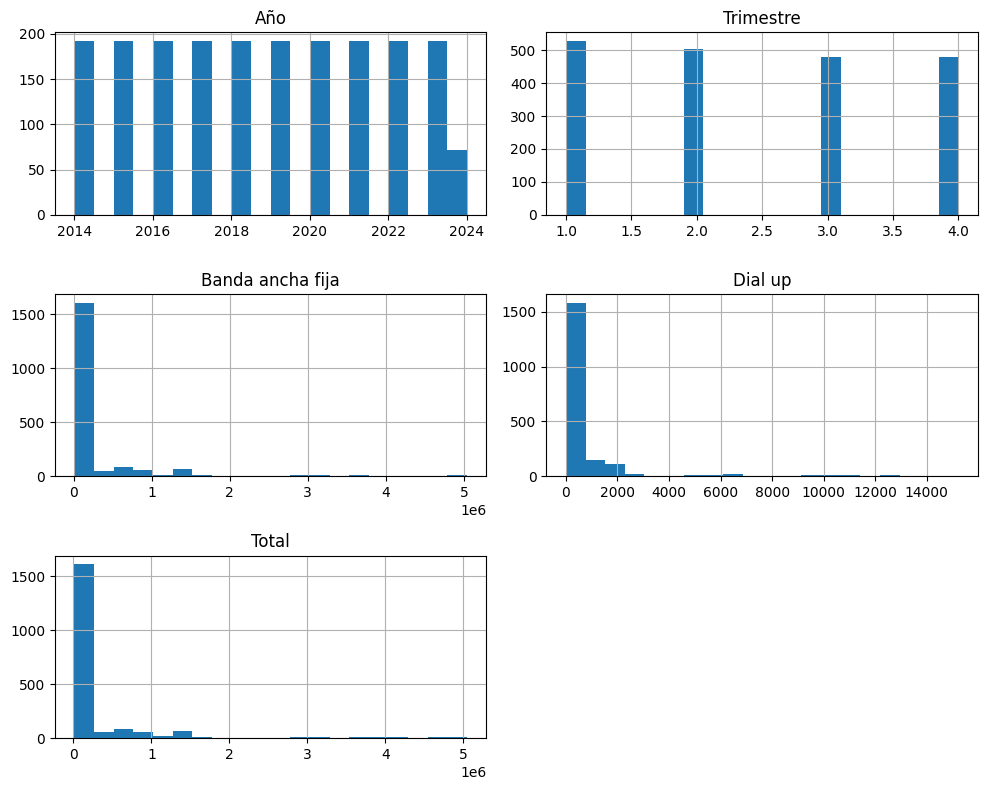

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                       Año  Trimestre  Banda ancha fija   Dial up     Total
Año               1.000000  -0.066355          0.089032 -0.169153  0.088348
Trimestre        -0.066355   1.000000          0.003007 -0.007770  0.002979
Banda ancha fija  0.089032   0.003007          1.000000  0.755208  0.999998
Dial up          -0.169153  -0.007770          0.755208  1.000000  0.756449
Total             0.088348   0.002979          0.999998  0.756449  1.000000

Correlaciones fuertes:
                  Año  Trimestre  Banda ancha fija   Dial up     Total
Año               1.0        NaN               NaN       NaN       NaN
Trimestre         NaN        1.0               NaN       NaN       NaN
Banda ancha fija  NaN        NaN          1.000000  0.755208  0.999998
Dial up           NaN        NaN          0.755208  1.000000  0.756449
Total             NaN        NaN          0.999998  0.756449  1.000000


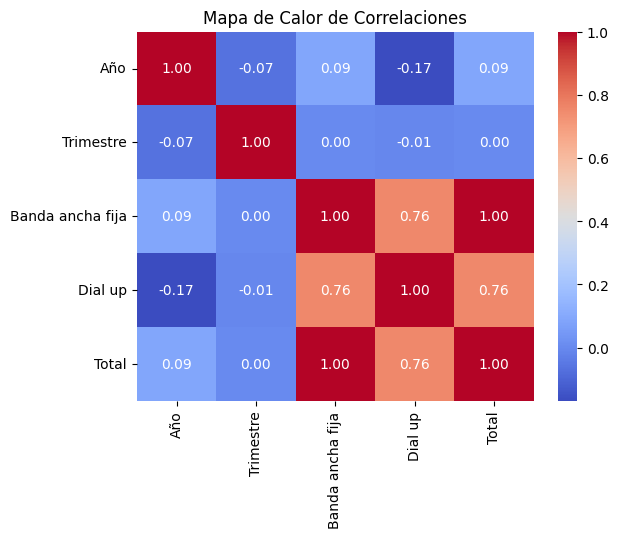

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               4        4        4        4        4        4   
CATAMARCA                  2        2        2        2        2        2   
CHACO                      2        2        2        2        2        2   
CHUBUT                     2        2        2        2        2        2   
CORRIENTES                 2        2        2        2        2        2   
CÓRDOBA                    2        2        2        2        2        2   
ENTRE RÍOS                 2        2        2        2        2        2   
FORMOSA                    2        2        2        2        2        2   
JUJUY                      2        2        2        2        2        2   
LA PAMPA                   2        2        2        2        2        2   
LA RIOJA            

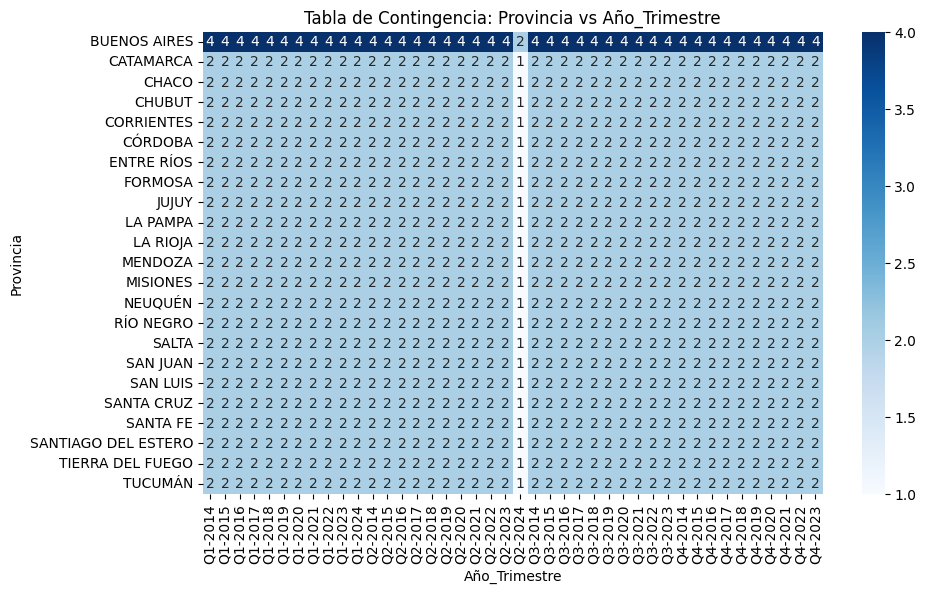


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                166
CATAMARCA                    83
CHACO                        83
CHUBUT                       83
CORRIENTES                   83
CÓRDOBA                      83
ENTRE RÍOS                   83
FORMOSA                      83
JUJUY                        83
LA PAMPA                     83
LA RIOJA                     83
MENDOZA                      83
MISIONES                     83
NEUQUÉN                      83
RÍO NEGRO                    83
SALTA                        83
SAN JUAN                     83
SAN LUIS                     83
SANTA CRUZ                   83
SANTA FE                     83
SANTIAGO DEL ESTERO          83
TIERRA DEL FUEGO             83
TUCUMÁN                      83


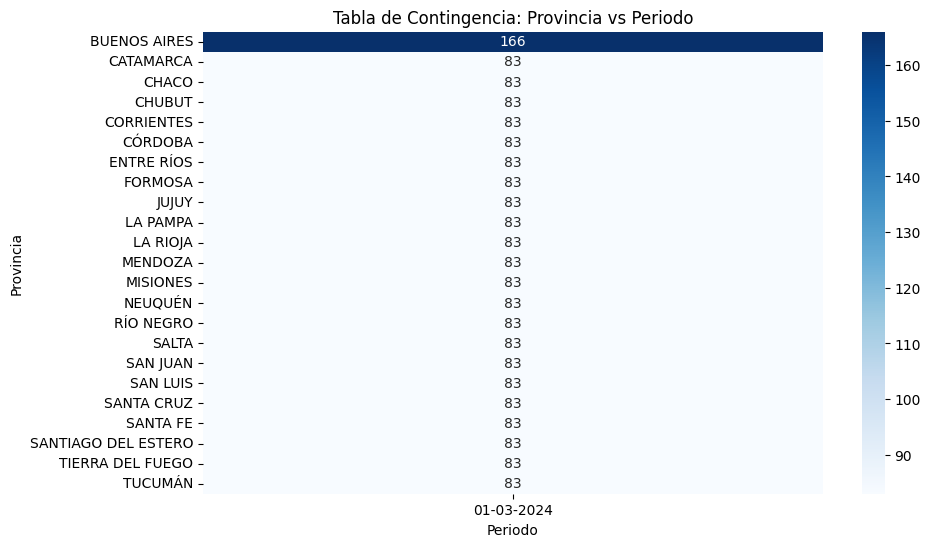


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                42         44         40         40
CATAMARCA                   21         22         20         20
CHACO                       21         22         20         20
CHUBUT                      21         22         20         20
CORRIENTES                  21         22         20         20
CÓRDOBA                     21         22         20         20
ENTRE RÍOS                  21         22         20         20
FORMOSA                     21         22         20         20
JUJUY                       21         22         20         20
LA PAMPA                    21         22         20         20
LA RIOJA                    21         22         20         20
MENDOZA                     21         22         20         20
MISIONES                    21         22       

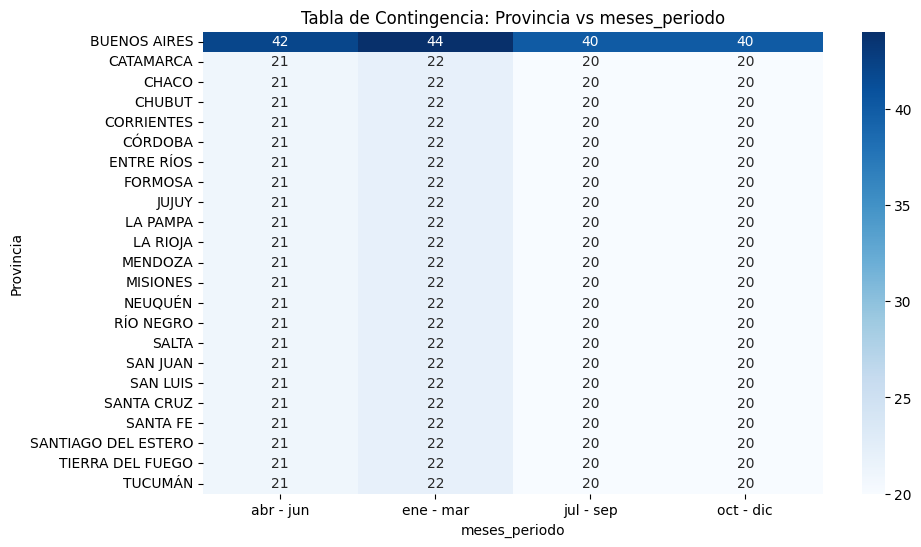


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                48
Q1-2015                48
Q1-2016                48
Q1-2017                48
Q1-2018                48
Q1-2019                48
Q1-2020                48
Q1-2021                48
Q1-2022                48
Q1-2023                48
Q1-2024                48
Q2-2014                48
Q2-2015                48
Q2-2016                48
Q2-2017                48
Q2-2018                48
Q2-2019                48
Q2-2020                48
Q2-2021                48
Q2-2022                48
Q2-2023                48
Q2-2024                24
Q3-2014                48
Q3-2015                48
Q3-2016                48
Q3-2017                48
Q3-2018                48
Q3-2019                48
Q3-2020                48
Q3-2021                48
Q3-2022                48
Q3-2023                48
Q4-2014                48
Q4-2015                48
Q4-2016   

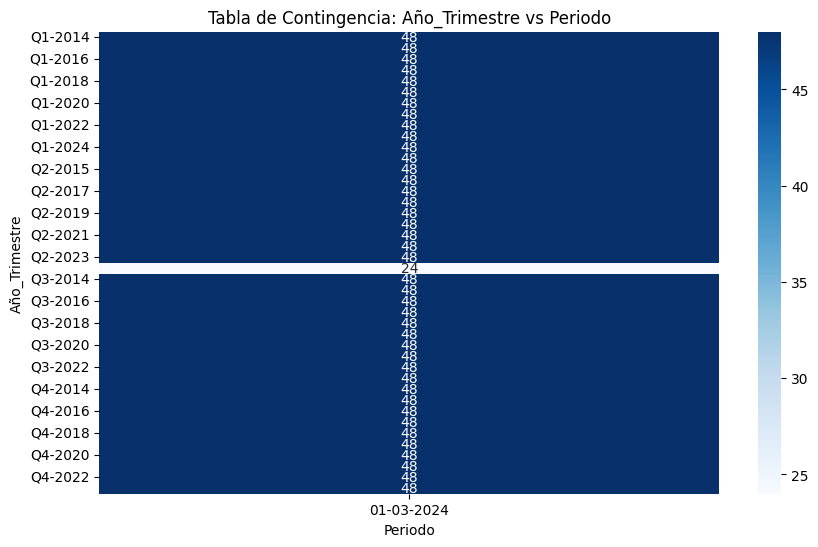


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         48          0          0
Q1-2015                0         48          0          0
Q1-2016                0         48          0          0
Q1-2017                0         48          0          0
Q1-2018                0         48          0          0
Q1-2019                0         48          0          0
Q1-2020                0         48          0          0
Q1-2021                0         48          0          0
Q1-2022                0         48          0          0
Q1-2023                0         48          0          0
Q1-2024                0         48          0          0
Q2-2014               48          0          0          0
Q2-2015               48          0          0          0
Q2-2016               48          0          0          0
Q2-2017     

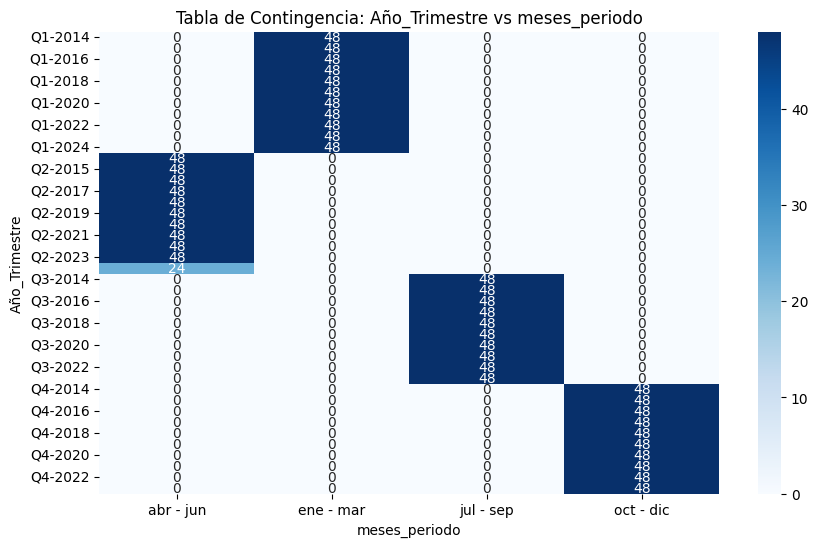


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           504        528        480        480


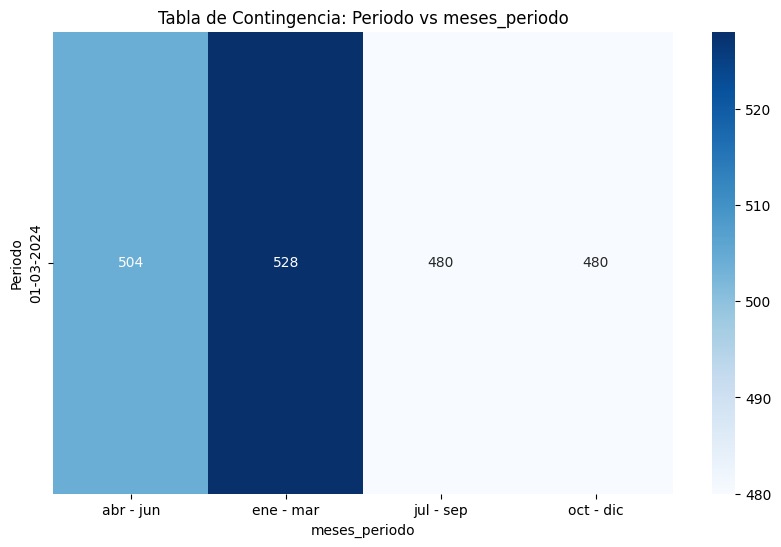

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES         166.0  2018.698795  3.010023  2014.0  2016.0  2019.0   
CATAMARCA             83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CHACO                 83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CHUBUT                83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CORRIENTES            83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CÓRDOBA               83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
ENTRE RÍOS            83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
FORMOSA               83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
JUJUY                 83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
LA PAMPA              83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
LA RIOJA     

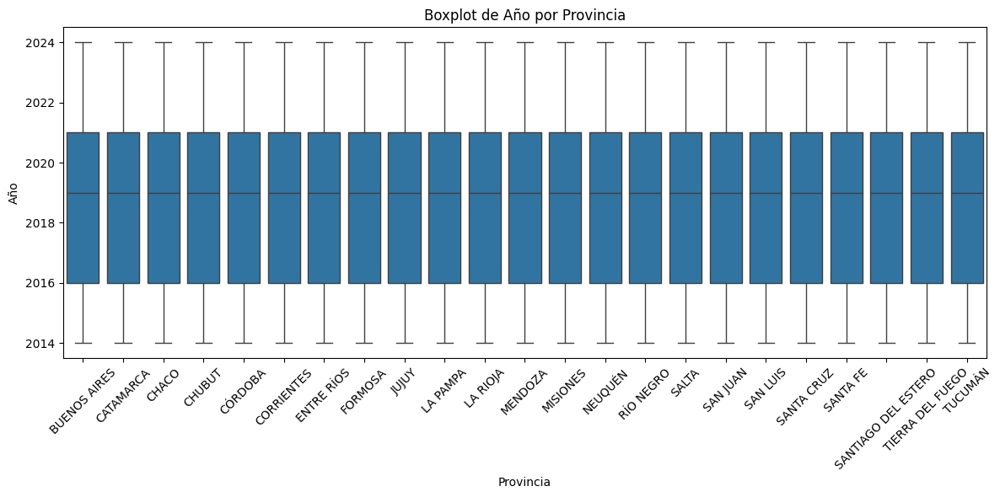


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min  25%  50%  75%  max
Provincia                                                              
BUENOS AIRES         166.0  2.457831  1.126014  1.0  1.0  2.0  3.0  4.0
CATAMARCA             83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
CHACO                 83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
CHUBUT                83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
CORRIENTES            83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
CÓRDOBA               83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
ENTRE RÍOS            83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
FORMOSA               83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
JUJUY                 83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
LA PAMPA              83.0  2.457831  1.129442  1.0  1.0  2.0  3.0  4.0
LA RIOJA              83.0  2.457831  1.129442  1.0  1.0  2.0  3.0 

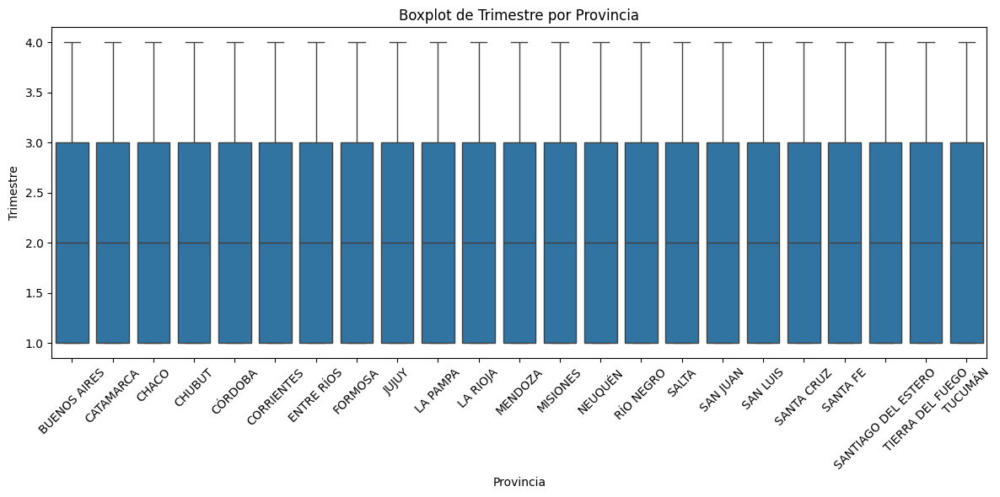


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'Provincia':
                     count          mean           std        min         25%  \
Provincia                                                                       
BUENOS AIRES         166.0  2.573322e+06  1.280869e+06  1289204.0  1391633.25   
CATAMARCA             83.0  4.309888e+04  1.819347e+04    24209.0    26543.00   
CHACO                 83.0  1.114401e+05  2.809171e+04    62520.0    88833.00   
CHUBUT                83.0  1.065525e+05  4.210004e+04    61745.0    66557.00   
CORRIENTES            83.0  1.109045e+05  2.977669e+04    62203.0    88084.00   
CÓRDOBA               83.0  8.000524e+05  1.753862e+05   566705.0   636422.00   
ENTRE RÍOS            83.0  2.193900e+05  4.816417e+04   134216.0   180188.00   
FORMOSA               83.0  4.327894e+04  1.387039e+04    25335.0    28801.00   
JUJUY                 83.0  7.642005e+04  3.468570e+04    33739.0    42537.00   
LA PAMPA              83.0  8.767

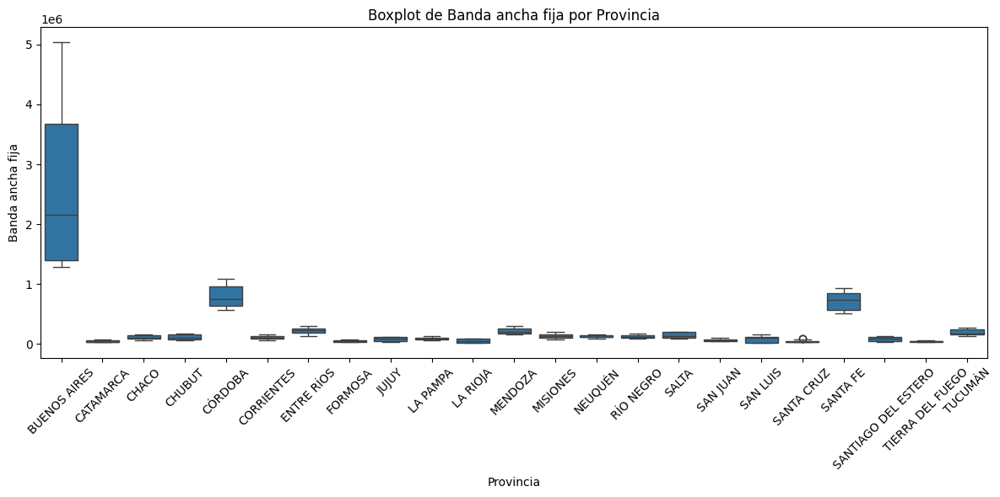


Estadísticas descriptivas de 'Dial up' agrupadas por 'Provincia':
                     count         mean          std     min     25%     50%  \
Provincia                                                                      
BUENOS AIRES         166.0  7202.759036  4014.741292  1390.0  3443.0  6686.0   
CATAMARCA             83.0     8.036145     7.169457     1.0     1.0     9.0   
CHACO                 83.0    12.060241     9.848052     3.0     5.0    12.0   
CHUBUT                83.0  1439.939759   575.671641   800.0   857.0  1518.0   
CORRIENTES            83.0    12.879518    12.555630     3.0     3.0    10.0   
CÓRDOBA               83.0   120.903614    73.569714    55.0    63.0   101.0   
ENTRE RÍOS            83.0    65.132530    66.149087    13.0    20.0    44.0   
FORMOSA               83.0    30.219376   139.477038     0.0     0.0     0.0   
JUJUY                 83.0     0.843373     0.903677     0.0     0.0     1.0   
LA PAMPA              83.0   298.915663   163.986258 

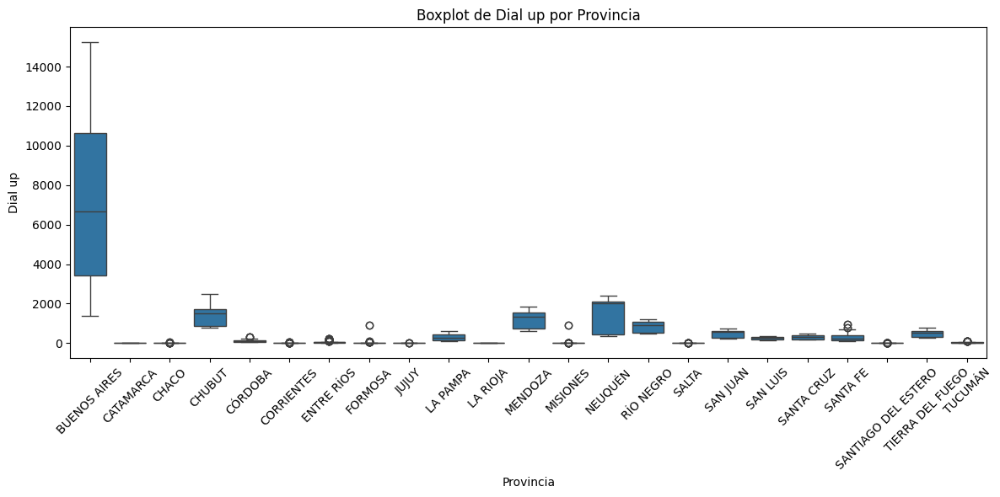


Estadísticas descriptivas de 'Total' agrupadas por 'Provincia':
                     count          mean           std        min        25%  \
Provincia                                                                      
BUENOS AIRES         166.0  2.580524e+06  1.281761e+06  1299918.0  1399184.5   
CATAMARCA             83.0  4.310692e+04  1.818746e+04    24232.0    26556.0   
CHACO                 83.0  1.114522e+05  2.808315e+04    62556.0    88847.0   
CHUBUT                83.0  1.079924e+05  4.167923e+04    63485.0    68542.0   
CORRIENTES            83.0  1.109173e+05  2.976678e+04    62236.0    88096.0   
CÓRDOBA               83.0  8.001733e+05  1.753293e+05   566910.0   636555.0   
ENTRE RÍOS            83.0  2.194551e+05  4.811444e+04   134331.0   180245.0   
FORMOSA               83.0  4.328742e+04  1.385976e+04    25422.0    28802.0   
JUJUY                 83.0  7.642089e+04  3.468492e+04    33741.0    42538.0   
LA PAMPA              83.0  8.797560e+04  2.041310e+04 

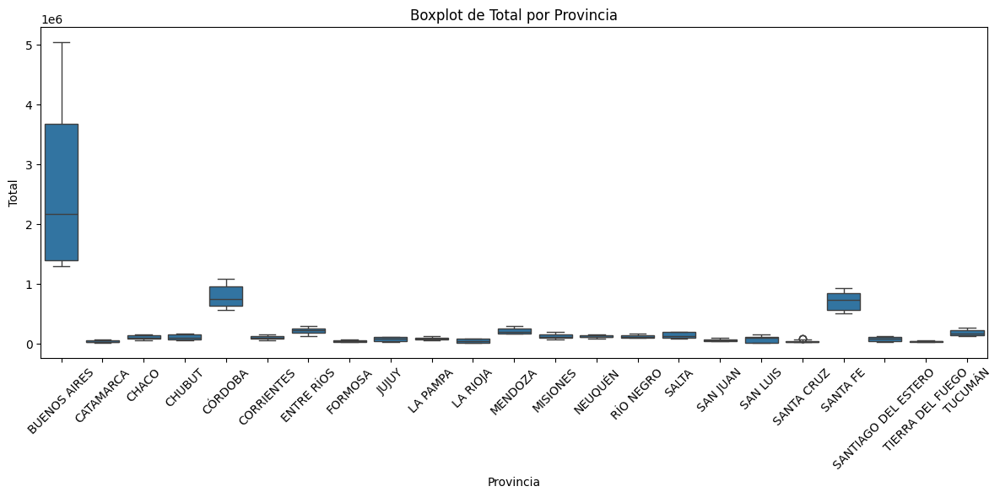


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         48.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         48.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         48.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         48.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         48.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         48.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         48.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         48.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         48.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         48.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         48.0  2024.0  0.0  2024.0  20

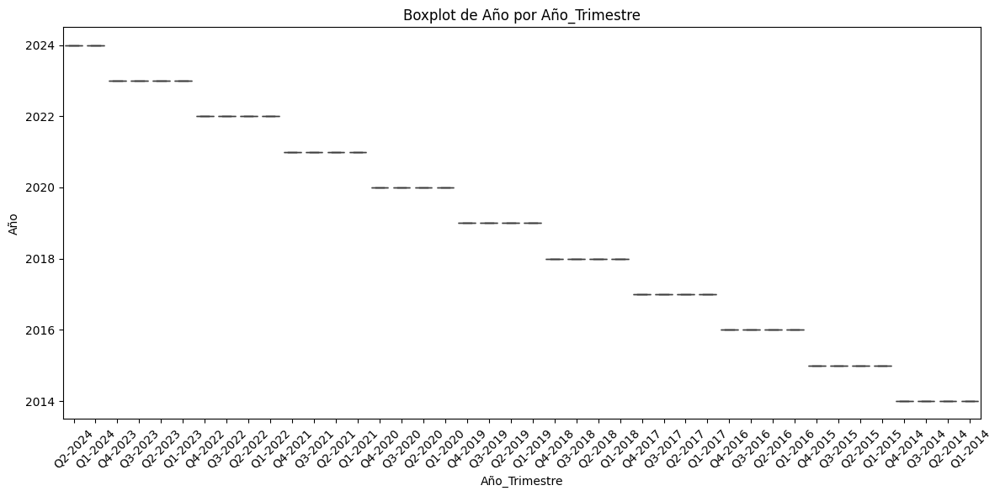


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         48.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         48.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         48.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         48.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

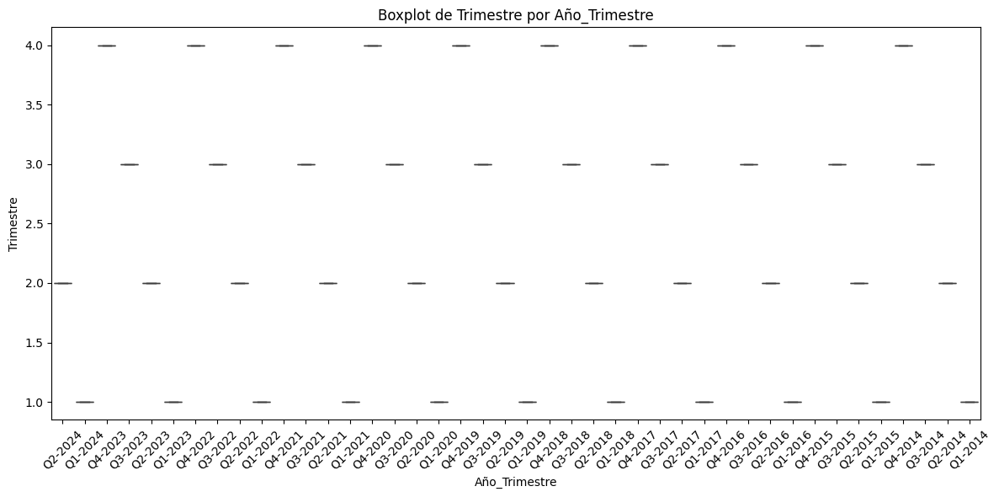


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'Año_Trimestre':
               count           mean           std      min        25%  \
Año_Trimestre                                                           
Q1-2014         48.0  265087.833333  5.870217e+05  12193.0   32186.75   
Q1-2015         48.0  279154.750000  6.106708e+05  12878.0   35637.50   
Q1-2016         48.0  286446.000000  6.259186e+05  12915.0   35738.00   
Q1-2017         48.0  303221.416667  6.753764e+05  12992.0   33839.25   
Q1-2018         48.0  333749.208333  7.254763e+05  21096.0   50272.25   
Q1-2019         48.0  359430.125000  7.764183e+05  24580.0   74165.25   
Q1-2020         48.0  366768.125000  7.679068e+05  38505.0   82826.25   
Q1-2021         48.0  401581.500000  8.344292e+05  40133.0   92244.50   
Q1-2022         48.0  442141.250000  9.281490e+05  48898.0  104142.00   
Q1-2023         48.0  467894.125000  9.835390e+05  50163.0  112621.25   
Q1-2024         48.0  484223.458333  1.02325

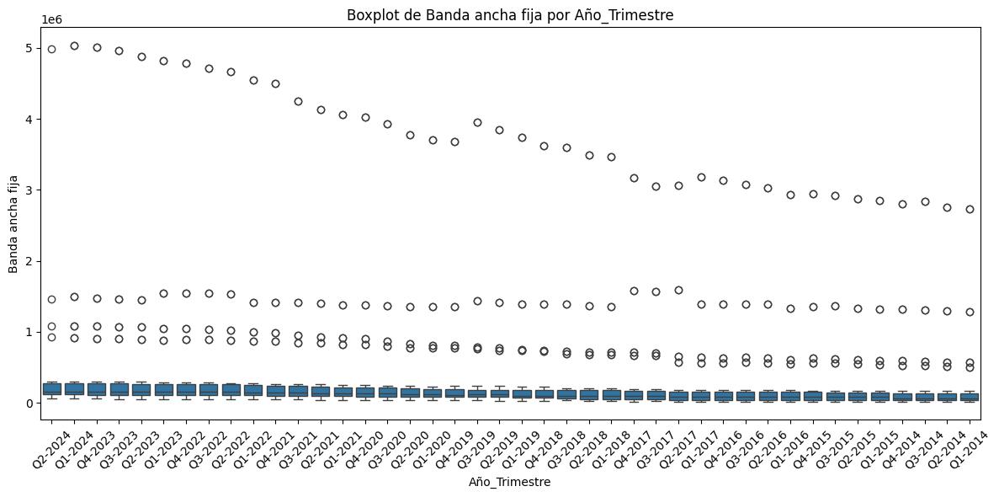


Estadísticas descriptivas de 'Dial up' agrupadas por 'Año_Trimestre':
               count         mean          std  min    25%    50%  \
Año_Trimestre                                                       
Q1-2014         48.0  1512.083333  3427.532230  0.0  31.00  284.5   
Q1-2015         48.0  1584.083333  3622.837197  3.0  29.00  324.0   
Q1-2016         48.0  1360.500000  3091.310292  1.0  15.25  275.5   
Q1-2017         48.0  1189.166667  2671.568105  0.0  12.75  224.0   
Q1-2018         48.0  1128.000000  2443.152707  0.0  11.00  200.5   
Q1-2019         48.0   908.833333  2105.517749  0.0   9.75  166.0   
Q1-2020         48.0   416.291667  1033.303872  0.0   2.75   85.5   
Q1-2021         48.0   417.333333  1033.711169  0.0   2.75   85.5   
Q1-2022         48.0   525.791667  1303.969291  0.0   4.00   94.5   
Q1-2023         48.0   518.166667  1285.285751  0.0   4.00   89.0   
Q1-2024         48.0   491.375000  1223.908904  0.0   3.75   84.5   
Q2-2014         48.0  1505.79166

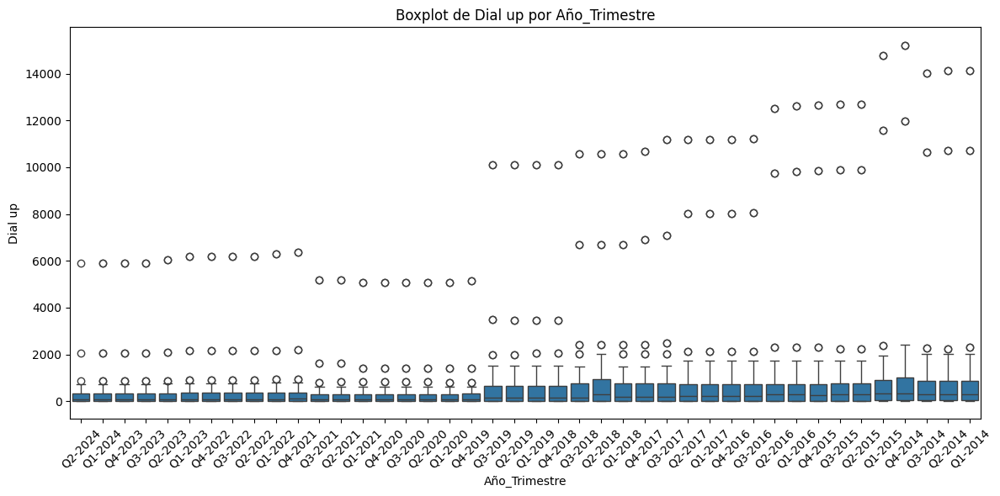


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count           mean           std      min        25%  \
Año_Trimestre                                                           
Q1-2014         48.0  266599.916667  5.902165e+05  12557.0   32379.75   
Q1-2015         48.0  280738.833333  6.140355e+05  13232.0   35822.25   
Q1-2016         48.0  287806.500000  6.287730e+05  13232.0   35895.00   
Q1-2017         48.0  304410.583333  6.778468e+05  13307.0   33995.50   
Q1-2018         48.0  334877.208333  7.277030e+05  21396.0   50285.25   
Q1-2019         48.0  360338.958333  7.783827e+05  24905.0   75444.75   
Q1-2020         48.0  367184.416667  7.688762e+05  38794.0   82977.25   
Q1-2021         48.0  401998.833333  8.354003e+05  40422.0   92395.50   
Q1-2022         48.0  442667.041667  9.293835e+05  49102.0  104343.50   
Q1-2023         48.0  468412.291667  9.847581e+05  50361.0  112819.75   
Q1-2024         48.0  484714.833333  1.024418e+06  6155

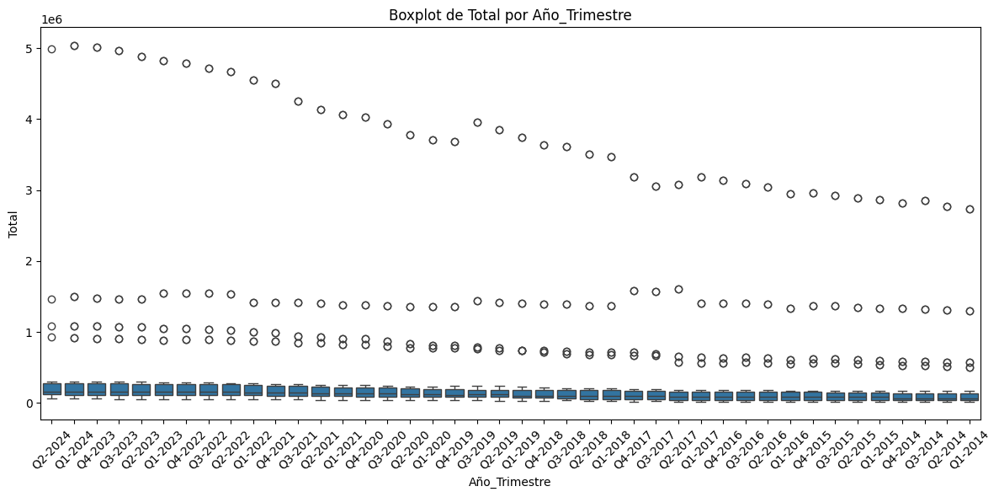


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count         mean       std     min     25%     50%     75%  \
Periodo                                                                     
01-03-2024  1992.0  2018.698795  3.001697  2014.0  2016.0  2019.0  2021.0   

               max  
Periodo             
01-03-2024  2024.0  


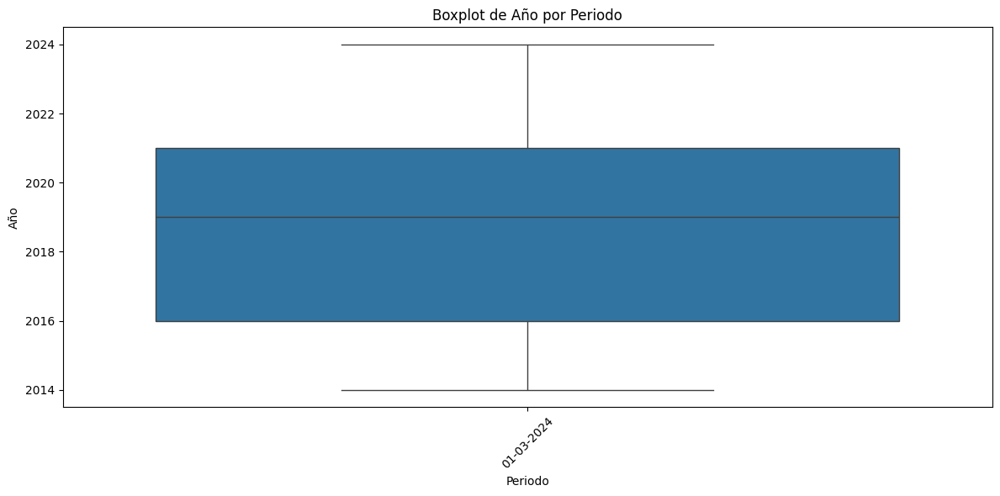


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count      mean       std  min  25%  50%  75%  max
Periodo                                                        
01-03-2024  1992.0  2.457831  1.122899  1.0  1.0  2.0  3.0  4.0


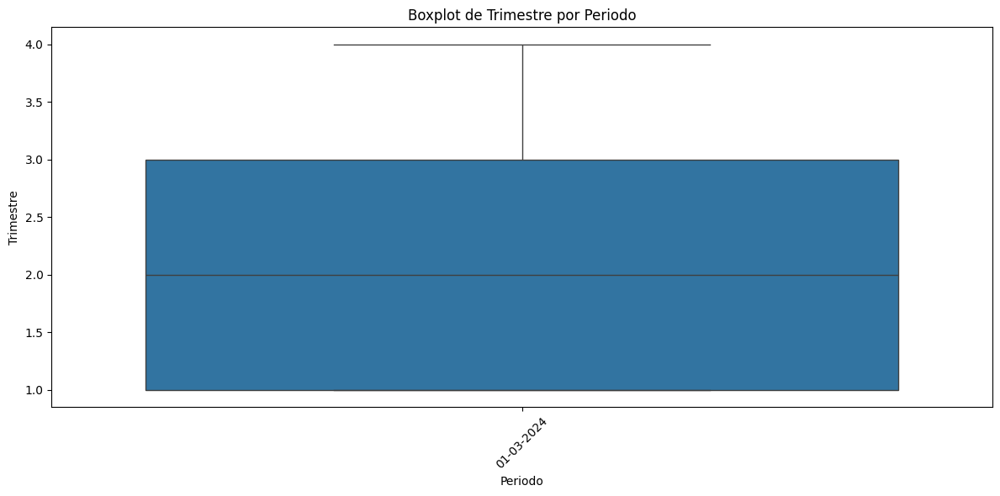


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'Periodo':
             count           mean            std      min      25%       50%  \
Periodo                                                                        
01-03-2024  1992.0  365054.225904  785885.249874  12193.0  61834.0  112315.0   

                 75%        max  
Periodo                          
01-03-2024  195471.0  5038657.0  


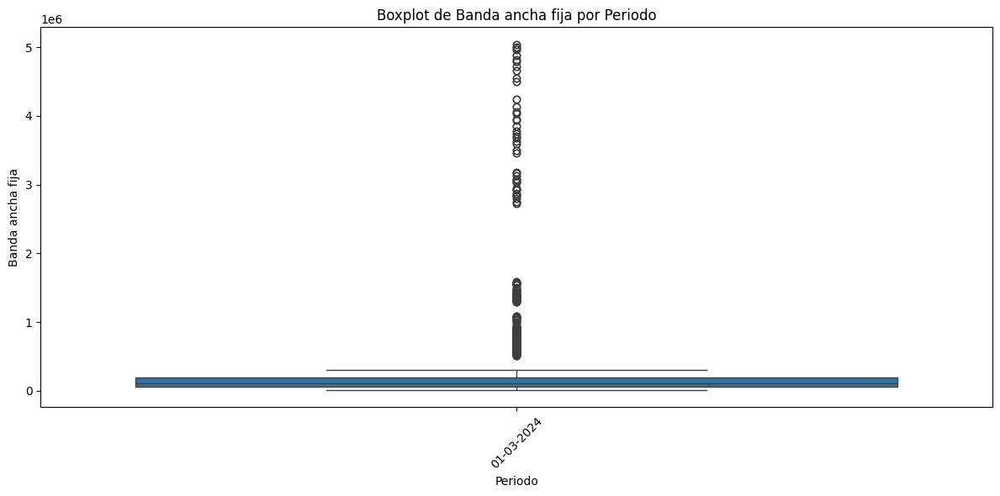


Estadísticas descriptivas de 'Dial up' agrupadas por 'Periodo':
             count        mean          std  min  25%    50%     75%      max
Periodo                                                                      
01-03-2024  1992.0  902.104125  2279.397876  0.0  5.0  137.0  615.75  15229.0


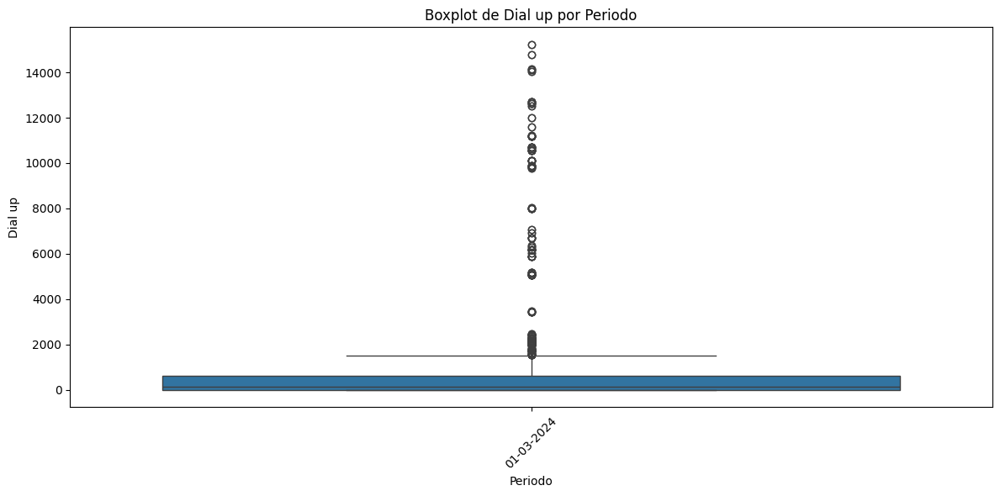


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
             count           mean            std      min      25%       50%  \
Periodo                                                                        
01-03-2024  1992.0  365954.518574  787608.754181  12557.0  62236.0  113663.0   

                 75%        max  
Periodo                          
01-03-2024  195471.0  5044557.0  


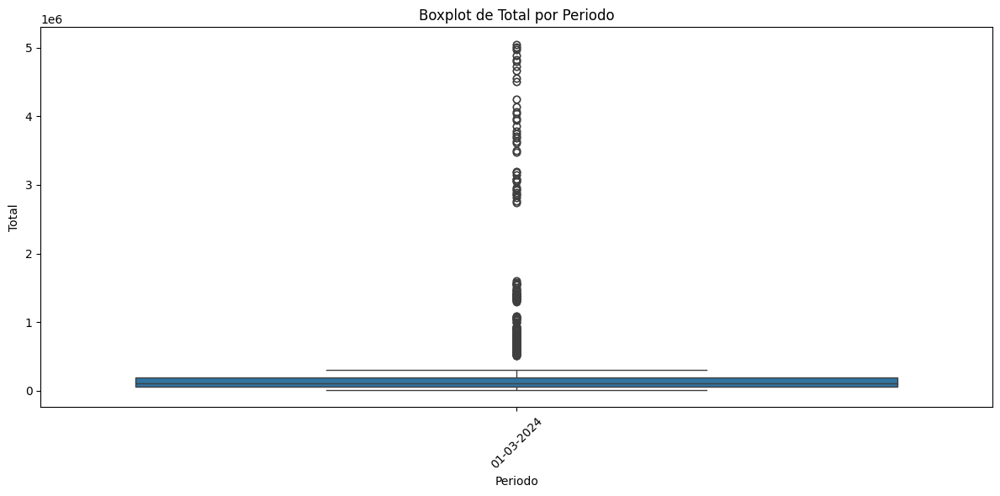


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count         mean       std     min     25%     50%     75%  \
meses_periodo                                                                 
abr - jun      504.0  2018.761905  3.040949  2014.0  2016.0  2019.0  2021.0   
ene - mar      528.0  2019.000000  3.165277  2014.0  2016.0  2019.0  2022.0   
jul - sep      480.0  2018.500000  2.875278  2014.0  2016.0  2018.5  2021.0   
oct - dic      480.0  2018.500000  2.875278  2014.0  2016.0  2018.5  2021.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


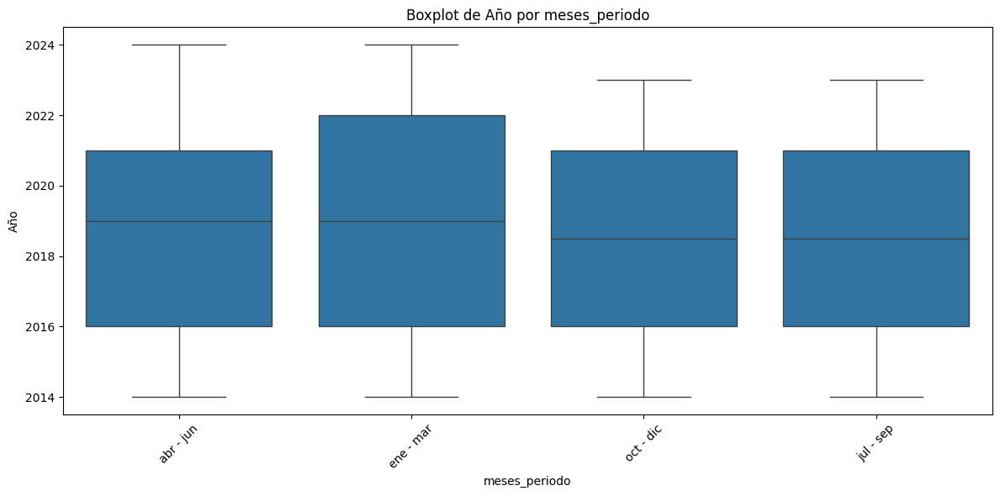


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      504.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      528.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      480.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      480.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


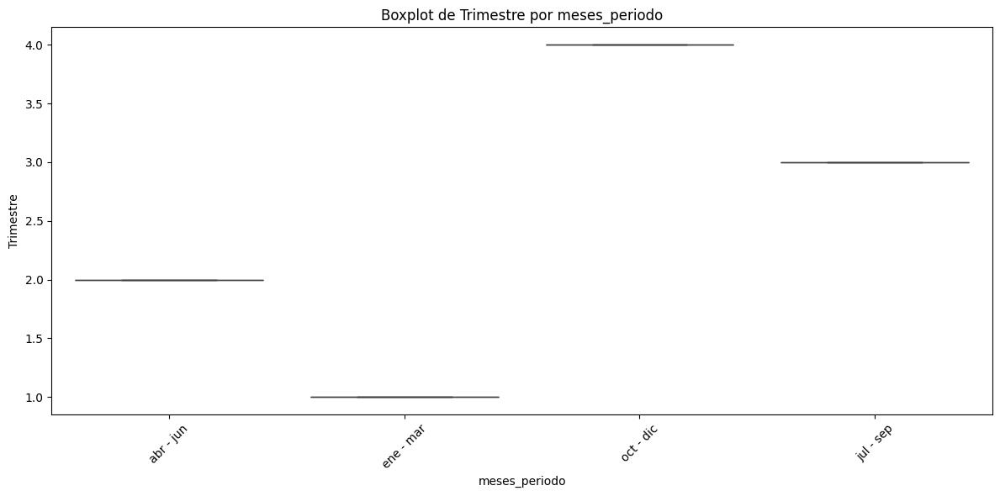


Estadísticas descriptivas de 'Banda ancha fija' agrupadas por 'meses_periodo':
               count           mean            std      min       25%  \
meses_periodo                                                           
abr - jun      504.0  363350.134921  782823.187625  12691.0  60915.50   
ene - mar      528.0  362699.799242  785480.362816  12193.0  61723.25   
jul - sep      480.0  365394.800000  784802.961044  12683.0  61843.00   
oct - dic      480.0  369092.816667  793033.564008  12788.0  61961.50   

                    50%        75%        max  
meses_periodo                                  
abr - jun      111693.5  195471.00  4983480.0  
ene - mar      110430.0  192350.25  5038657.0  
jul - sep      113252.0  192176.25  4962337.0  
oct - dic      113873.0  194895.75  5005720.0  


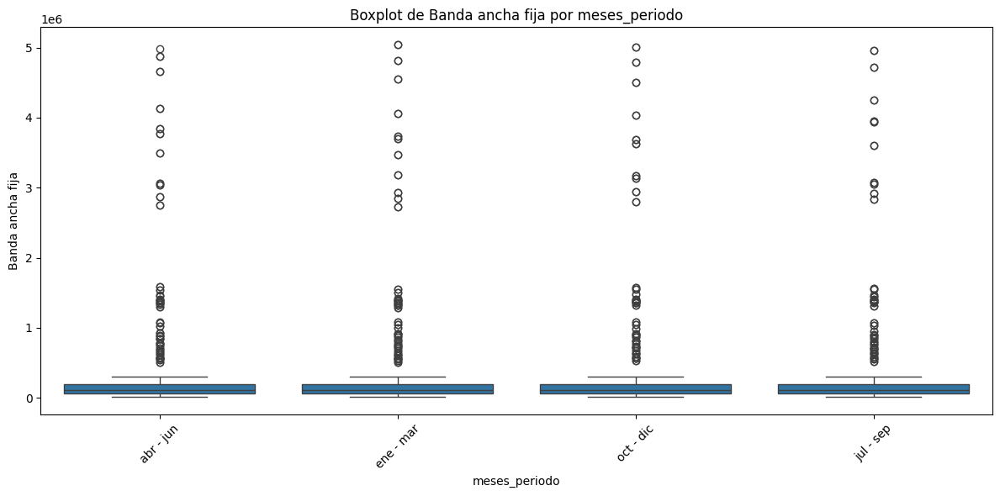


Estadísticas descriptivas de 'Dial up' agrupadas por 'meses_periodo':
               count        mean          std  min  25%    50%     75%  \
meses_periodo                                                            
abr - jun      504.0  918.129795  2293.306782  0.0  7.0  148.0  619.00   
ene - mar      528.0  913.784091  2334.493182  0.0  5.0  135.0  615.00   
jul - sep      480.0  912.395833  2268.427144  0.0  5.0  124.5  619.00   
oct - dic      480.0  862.137500  2220.246756  0.0  5.0  135.0  564.75   

                   max  
meses_periodo           
abr - jun      14116.0  
ene - mar      14766.0  
jul - sep      14028.0  
oct - dic      15229.0  


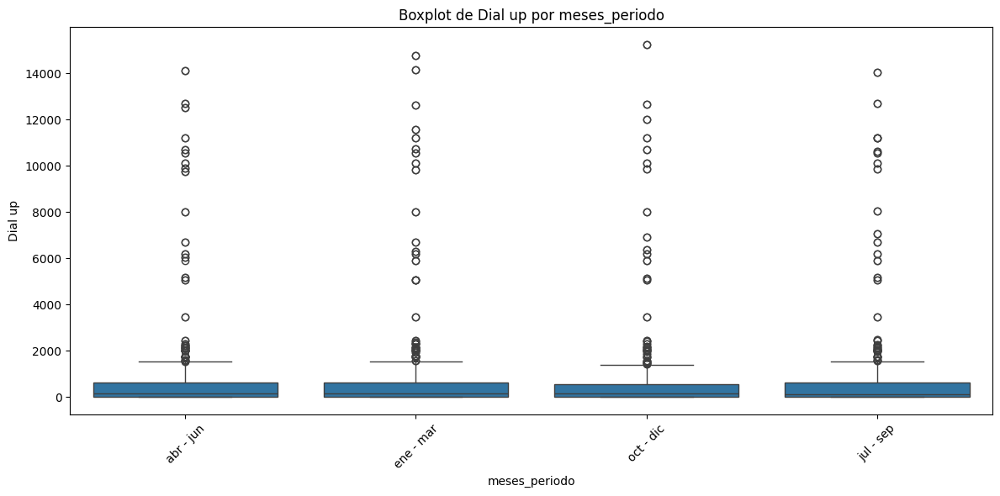


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count           mean            std      min       25%  \
meses_periodo                                                           
abr - jun      504.0  364261.105159  784570.478532  13055.0  61144.25   
ene - mar      528.0  363613.583333  787217.536638  12557.0  62065.75   
jul - sep      480.0  366307.195833  786552.579103  13046.0  62443.00   
oct - dic      480.0  369954.954167  794697.393916  13147.0  62299.00   

                    50%        75%        max  
meses_periodo                                  
abr - jun      112041.5  195471.00  4989380.0  
ene - mar      110835.5  192362.25  5044557.0  
jul - sep      113971.5  193326.50  4968237.0  
oct - dic      114039.5  194938.25  5011620.0  


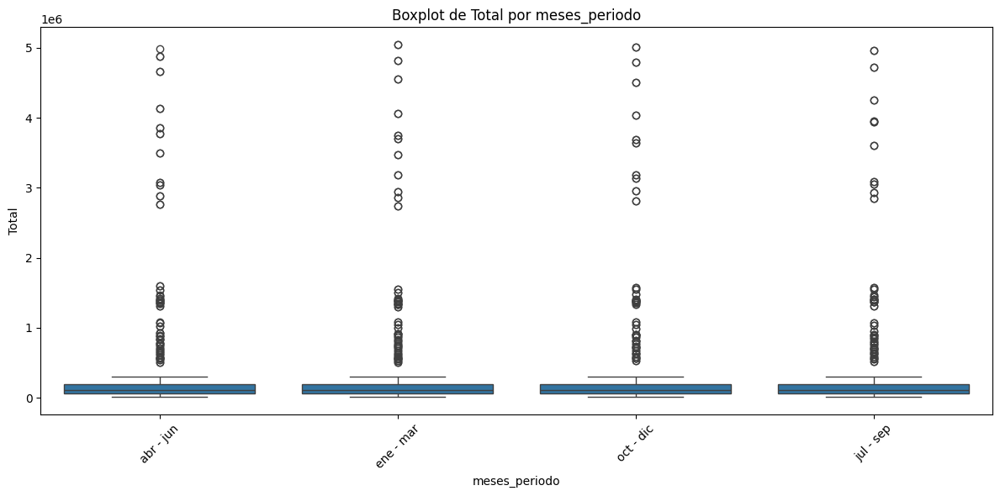

In [26]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [27]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
           Año  Trimestre  Banda ancha fija   Dial up     Total
0     1.766513  -0.407825          5.878193  2.193189  5.871680
1     1.766513  -0.407825          1.395586  0.503723  1.393992
2     1.766513  -0.407825         -0.369079 -0.395425 -0.369414
3     1.766513  -0.407825         -0.277422 -0.393669 -0.277952
4     1.766513  -0.407825         -0.243975 -0.019793 -0.243496
...        ...        ...               ...       ...       ...
1987 -1.565773  -1.298600         -0.431151 -0.194005 -0.430767
1988 -1.565773  -1.298600          0.179392 -0.127304  0.178633
1989 -1.565773  -1.298600         -0.417380 -0.391914 -0.417598
1990 -1.565773  -1.298600         -0.429919 -0.059726 -0.429149
1991 -1.565773  -1.298600         -0.299241 -0.357247 -0.299618

[1992 rows x 5 columns]


In [28]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           166
CATAMARCA               83
CHACO                   83
CHUBUT                  83
CÓRDOBA                 83
CORRIENTES              83
ENTRE RÍOS              83
FORMOSA                 83
JUJUY                   83
LA PAMPA                83
LA RIOJA                83
MENDOZA                 83
MISIONES                83
NEUQUÉN                 83
RÍO NEGRO               83
SALTA                   83
SAN JUAN                83
SAN LUIS                83
SANTA CRUZ              83
SANTA FE                83
SANTIAGO DEL ESTERO     83
TIERRA DEL FUEGO        83
TUCUMÁN                 83
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q1-2024    48
Q4-2023    48
Q4-2022    48
Q3-2023    48
Q2-2023    48
Q1-2023    48
Q2-2022    48
Q3-2022    48
Q1-2022    48
Q4-2021    48
Q4-2017    48
Q3-2021    48
Q2-2021    48
Q1-2021    48
Q4-2020    48
Q3-2020    48
Q2-

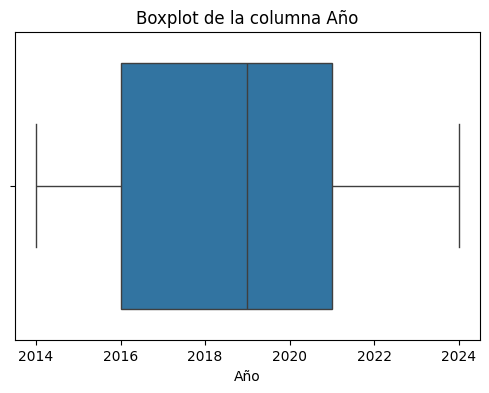

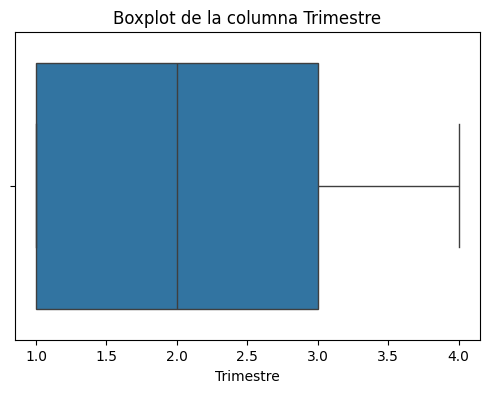

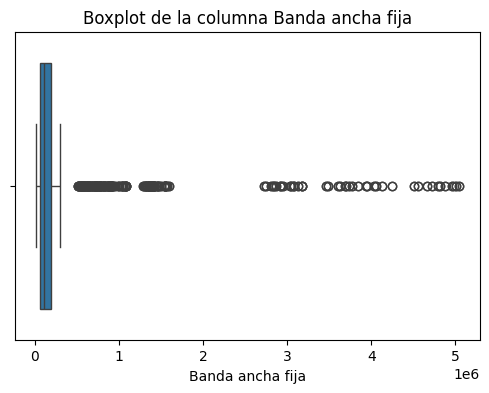

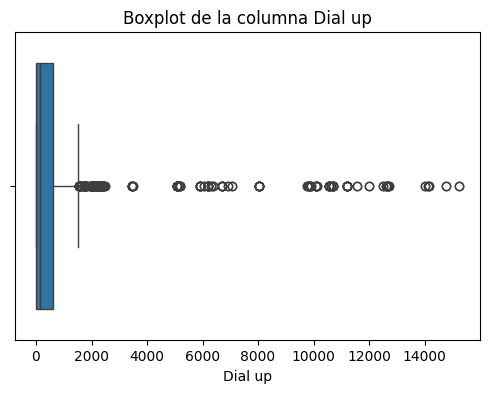

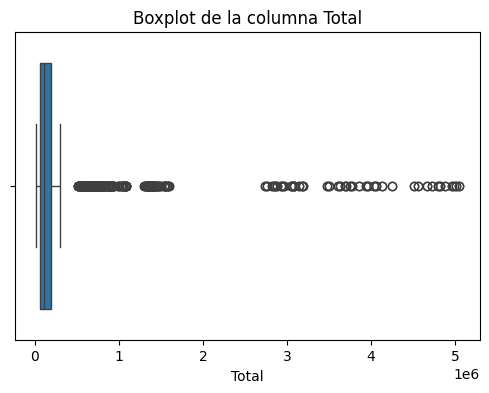

In [29]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [30]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Dial-BAf.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Dial-BAf.csv


In [31]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [32]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                 0.023509
Trimestre           0.054236
Banda ancha fija    3.866781
Dial up             3.913794
Total               3.863886
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                 -1.188340
Trimestre           -1.368402
Banda ancha fija    15.714694
Dial up             15.654855
Total               15.679363
dtype: float64


In [33]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
           Variable           VIF
0             const  5.283687e+05
1               Año  1.167137e+00
2         Trimestre  1.006655e+00
3  Banda ancha fija  3.788902e+08
4           Dial up  3.187074e+03
5             Total  3.805524e+08


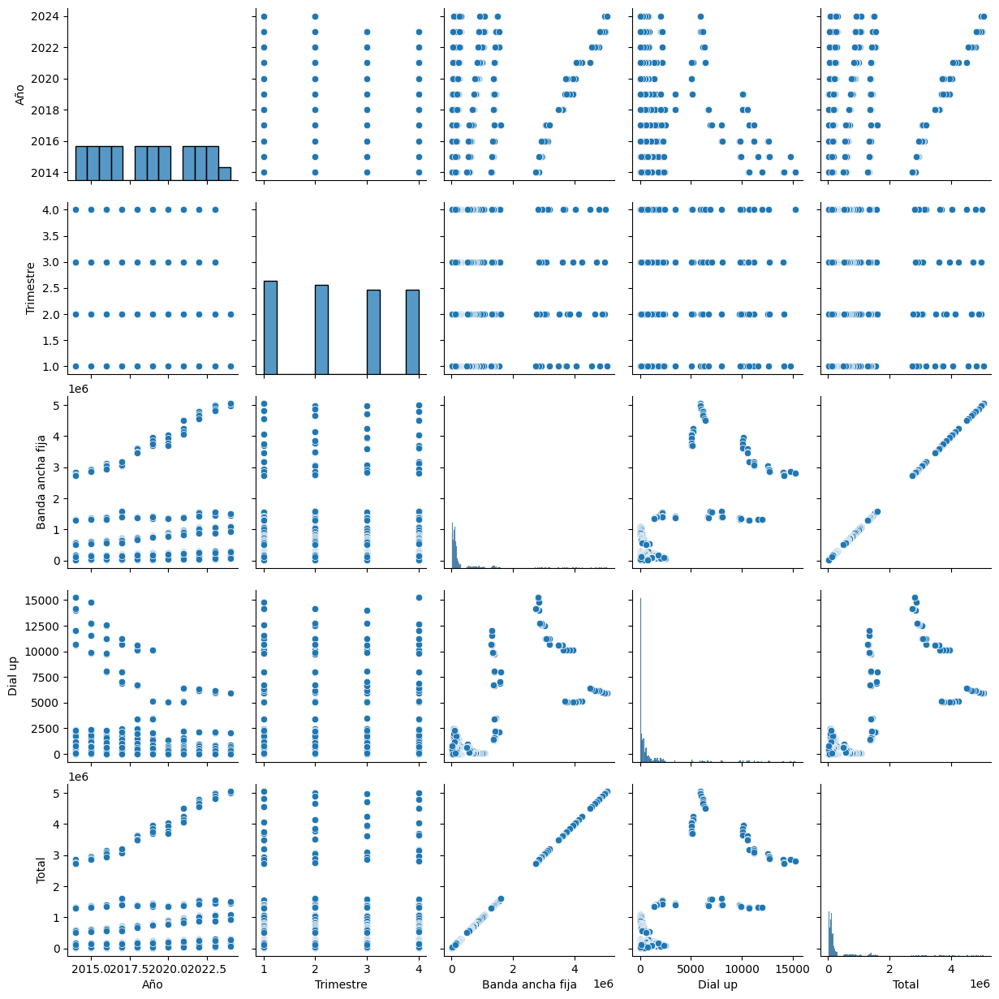

In [34]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [35]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                       Año                                                 \
                     count         mean       std     min     25%     50%   
Provincia                                                                   
BUENOS AIRES         166.0  2018.698795  3.010023  2014.0  2016.0  2019.0   
CATAMARCA             83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CHACO                 83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CHUBUT                83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CORRIENTES            83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CÓRDOBA               83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
ENTRE RÍOS            83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
FORMOSA               83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
JUJUY                 83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
LA PAMPA              83.0  2018.698

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Totales VMD.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre  Mbps (Media de bajada)        Periodo
0  2024          2                  139.25   Abr-Jun 2024
1  2024          1                  139.15   Ene-Mar 2024
2  2023          4                  139.04   Oct-Dic 2023
3  2023          3                  129.67  Jul-Sept 2023
4  2023          2                  123.95   Abr-Jun 2023


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     42 non-null     int64  
 1   Trimestre               42 non-null     int64  
 2   Mbps (Media de bajada)  42 non-null     float64
 3   Periodo                 42 non-null     object 
dtypes: float64(1), int64(2), object(1)
memory usage: 1.4+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2023          1       Q1-2023     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre  Mbps (Media de bajada)        Periodo Año_Trimestre  \
0  2024          2                  139.25   Abr-Jun 2024       Q2-2024   
1  2024          1                  139.15   Ene-Mar 2024       Q1-2024   
2  2023          4                  139.04   Oct-Dic 2023       Q4-2023   
3  2023          3                  129.67  Jul-Sept 2023       Q3-2023   
4  2023          2                  123.95   Abr-Jun 2023       Q2-2023   

  meses_periodo  
0     abr - jun  
1     ene - mar  
2     oct - dic  
3     jul - sep  
4     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                         int64
Trimestre                   int64
Mbps (Media de bajada)    float64
Periodo                    object
Año_Trimestre              object
meses_periodo              object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     42 non-null     int64  
 1   Trimestre               42 non-null     int64  
 2   Mbps (Media de bajada)  42 non-null     float64
 3   Periodo                 42 non-null     object 
 4   Año_Trimestre           42 non-null     object 
 5   meses_periodo           42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     42 non-null     int64  
 1   Trimestre               42 non-null     int64  
 2   Mbps (Media de bajada)  42 non-null     float64
 3   Periodo                 42 non-null     object 
 4   Año_Trimestre           42 non-null     object 
 5   meses_periodo           42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     42 non-null     int64  
 1   Trimestre               42 non-null     int64  
 2   Mbps (Media de bajada)  42 non-null     float64
 3   Periodo                 42 non-null     object 
 4   Año_Trimestre           42 non-null     object 
 5   meses_periodo           42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                       0
Trimestre                 0
Mbps (Media de bajada)    0
Periodo                   0
Año_Trimestre             0
meses_periodo             0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                       0
Trimestre                 0
Mbps (Media de bajada)    0
Periodo                   0
Año_Trimestre             0
meses_periodo             0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                       0
Trimestre                 0
Mbps (Media de bajada)    0
Periodo                   0
Año_Trimestre             0
meses_periodo             0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Año                     42 non-null     int64  
 1   Trimestre               42 non-null     int64  
 2   Mbps (Media de bajada)  42 non-null     float64
 3   Periodo                 42 non-null     object 
 4   Año_Trimestre           42 non-null     object 
 5   meses_periodo           42 non-null     object 
dtypes: float64(1), int64(2), object(3)
memory usage: 2.1+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre  Mbps (Media de bajada)       Periodo  \
count     42.000000  42.000000               42.000000            42   
unique          NaN        NaN                     NaN            42   
top             NaN        NaN                     NaN  Abr-Jun 2024   
freq            NaN        NaN                     NaN             1   
mean    2018.761905   2.452381               39.334762           NaN   
std        3.074756   1.130560               43.643195           NaN   
min     2014.000000   1.000000                3.617127           NaN   
25%     2016.000000   1.250000                6.038428           NaN   
50%     2019.000000   2.000000               18.855000           NaN   
75%     2021.000000   3.000000               51.370000           NaN   
max     2024.000000   4.000000              139.250000           NaN   

       Año_Trimestre meses_periodo  
count             42    

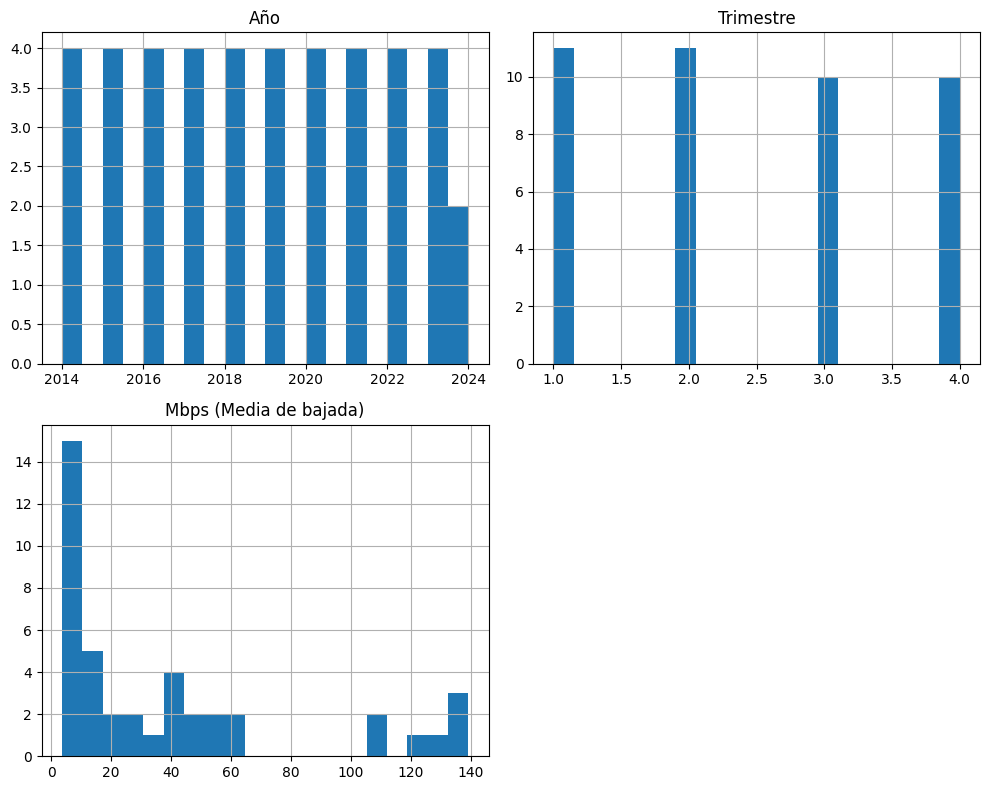

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                             Año  Trimestre  Mbps (Media de bajada)
Año                     1.000000  -0.073505                0.879146
Trimestre              -0.073505   1.000000               -0.007557
Mbps (Media de bajada)  0.879146  -0.007557                1.000000

Correlaciones fuertes:
                             Año  Trimestre  Mbps (Media de bajada)
Año                     1.000000        NaN                0.879146
Trimestre                    NaN        1.0                     NaN
Mbps (Media de bajada)  0.879146        NaN                1.000000


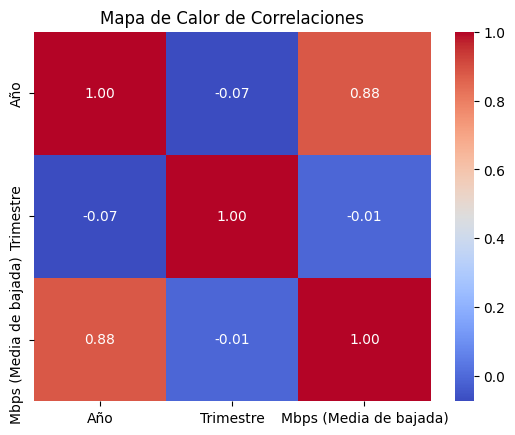

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Periodo y Año_Trimestre:
Año_Trimestre  Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  Q1-2020  \
Periodo                                                                        
Abr-Jun 2014         0        0        0        0        0        0        0   
Abr-Jun 2015         0        0        0        0        0        0        0   
Abr-Jun 2016         0        0        0        0        0        0        0   
Abr-Jun 2017         0        0        0        0        0        0        0   
Abr-Jun 2018         0        0        0        0        0        0        0   
Abr-Jun 2019         0        0        0        0        0        0        0   
Abr-Jun 2020         0        0        0        0        0        0        0   
Abr-Jun 2021         0        0        0        0        0        0        0   
Abr-Jun 2022         0        0        0        0        0        0        0   
Abr-Jun 2023         0        0        0        0        0        

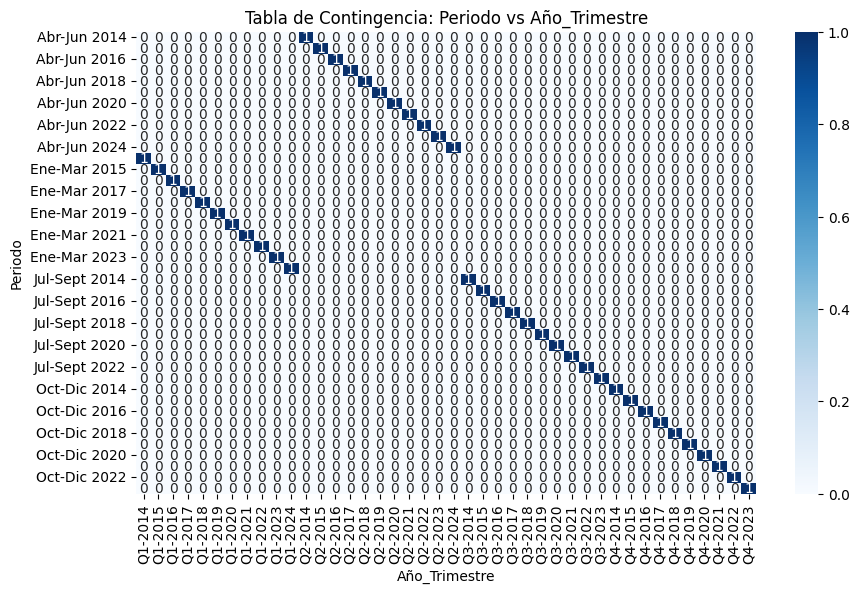


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
Abr-Jun 2014           1          0          0          0
Abr-Jun 2015           1          0          0          0
Abr-Jun 2016           1          0          0          0
Abr-Jun 2017           1          0          0          0
Abr-Jun 2018           1          0          0          0
Abr-Jun 2019           1          0          0          0
Abr-Jun 2020           1          0          0          0
Abr-Jun 2021           1          0          0          0
Abr-Jun 2022           1          0          0          0
Abr-Jun 2023           1          0          0          0
Abr-Jun 2024           1          0          0          0
Ene-Mar 2014           0          1          0          0
Ene-Mar 2015           0          1          0          0
Ene-Mar 2016           0          1          0          0
Ene-Mar 2017      

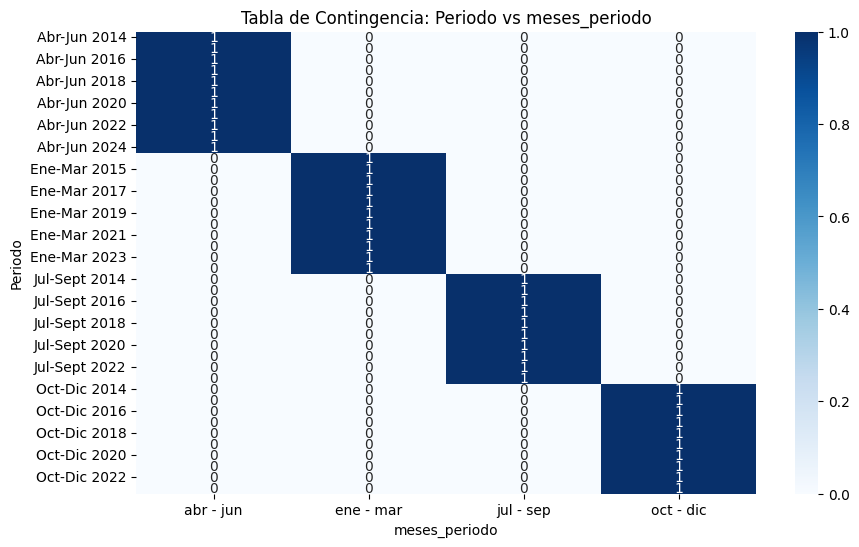


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2023                0          1          0          0
Q1-2024                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

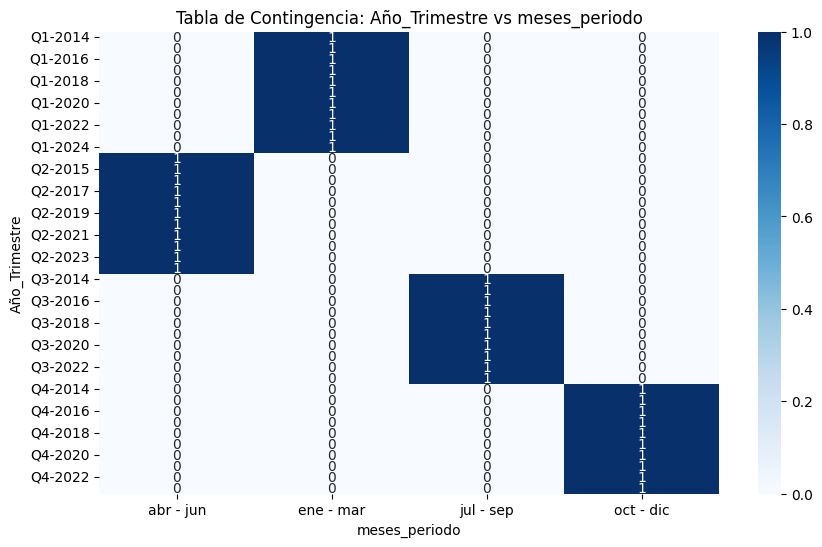

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
               count    mean  std     min     25%     50%     75%     max
Periodo                                                                  
Abr-Jun 2014     1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Abr-Jun 2015     1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Abr-Jun 2016     1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Abr-Jun 2017     1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Abr-Jun 2018     1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Abr-Jun 2019     1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Abr-Jun 2020     1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Abr-Jun 2021     1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Abr-Jun 2022     1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Abr-Jun 2023     1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Abr-Jun 2024     1.0  2024.0  NaN  2024.0  2024.0  

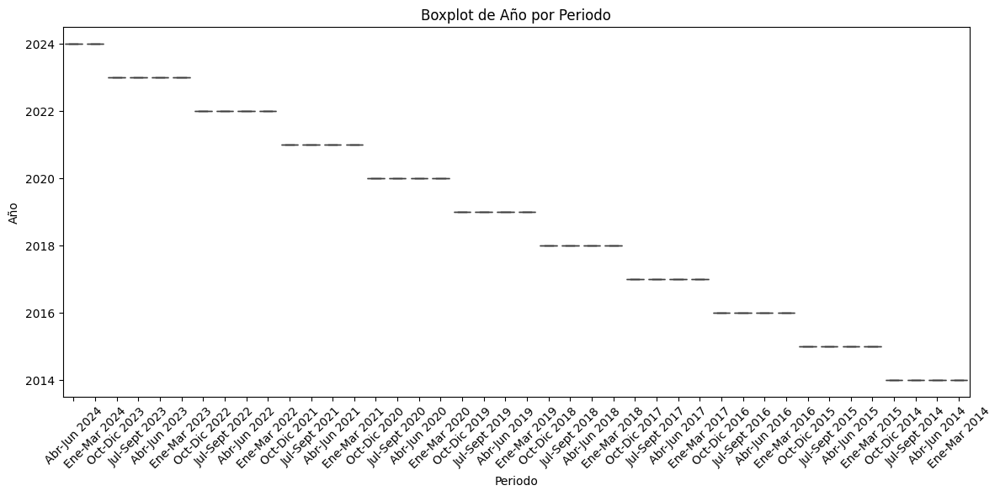


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
               count  mean  std  min  25%  50%  75%  max
Periodo                                                 
Abr-Jun 2014     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2015     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2016     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2017     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2018     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2019     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2020     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2021     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2022     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2023     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Abr-Jun 2024     1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Ene-Mar 2014     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2015     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2016     1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Ene-Mar 2017     1.0 

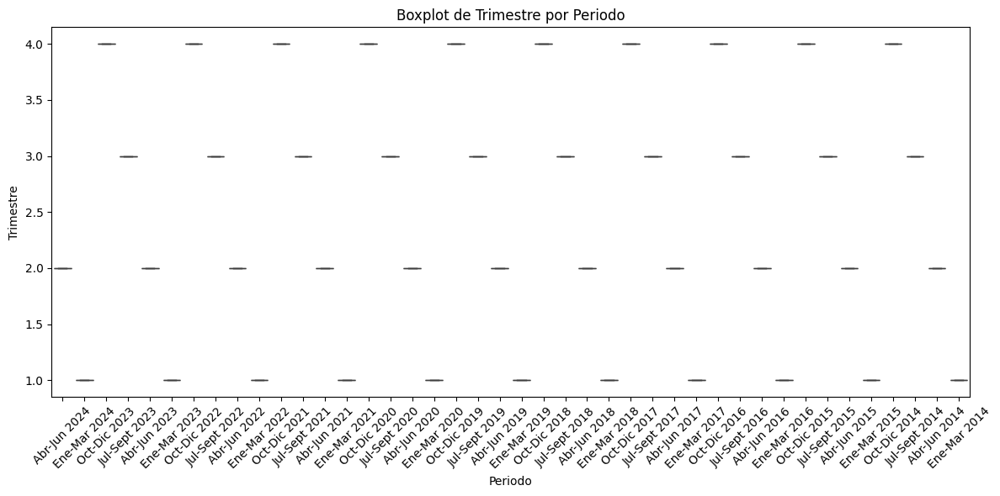


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'Periodo':
               count        mean  std         min         25%         50%  \
Periodo                                                                     
Abr-Jun 2014     1.0    3.758712  NaN    3.758712    3.758712    3.758712   
Abr-Jun 2015     1.0    4.545381  NaN    4.545381    4.545381    4.545381   
Abr-Jun 2016     1.0    5.423531  NaN    5.423531    5.423531    5.423531   
Abr-Jun 2017     1.0    7.159956  NaN    7.159956    7.159956    7.159956   
Abr-Jun 2018     1.0   13.849540  NaN   13.849540   13.849540   13.849540   
Abr-Jun 2019     1.0   20.330000  NaN   20.330000   20.330000   20.330000   
Abr-Jun 2020     1.0   38.320000  NaN   38.320000   38.320000   38.320000   
Abr-Jun 2021     1.0   45.630000  NaN   45.630000   45.630000   45.630000   
Abr-Jun 2022     1.0   58.440000  NaN   58.440000   58.440000   58.440000   
Abr-Jun 2023     1.0  123.950000  NaN  123.950000  123.950000  123.950000

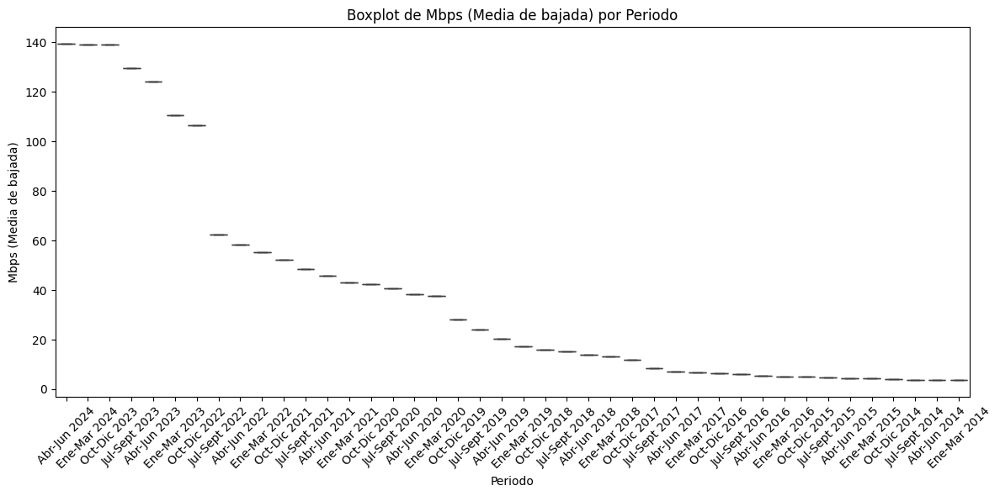


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023          1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024          1.0  2024.0  NaN  2024.0  20

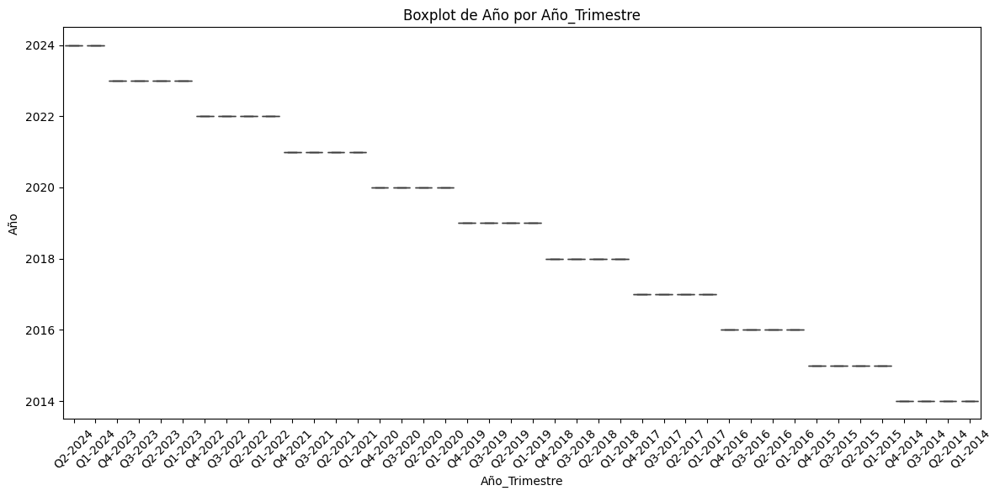


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2023          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

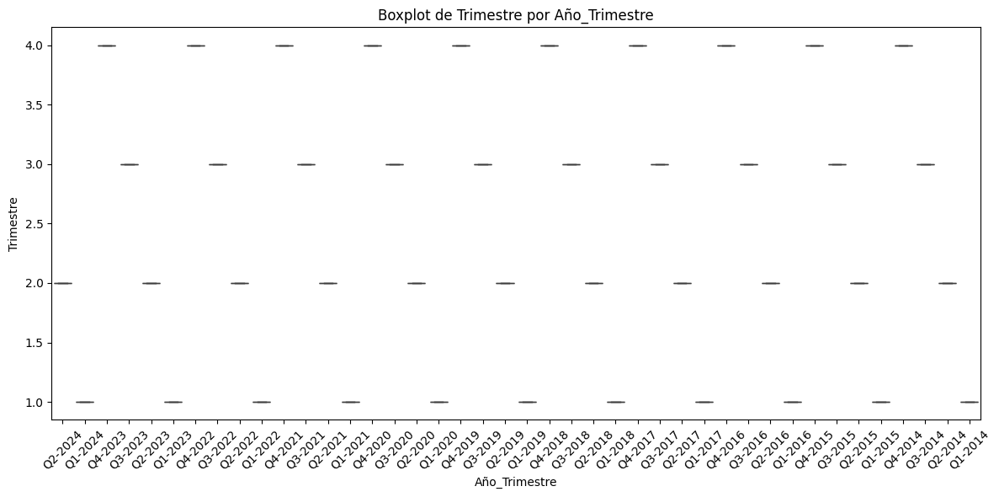


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'Año_Trimestre':
               count        mean  std         min         25%         50%  \
Año_Trimestre                                                               
Q1-2014          1.0    3.617127  NaN    3.617127    3.617127    3.617127   
Q1-2015          1.0    4.350279  NaN    4.350279    4.350279    4.350279   
Q1-2016          1.0    5.083702  NaN    5.083702    5.083702    5.083702   
Q1-2017          1.0    6.624079  NaN    6.624079    6.624079    6.624079   
Q1-2018          1.0   13.221340  NaN   13.221340   13.221340   13.221340   
Q1-2019          1.0   17.380000  NaN   17.380000   17.380000   17.380000   
Q1-2020          1.0   37.520000  NaN   37.520000   37.520000   37.520000   
Q1-2021          1.0   43.110000  NaN   43.110000   43.110000   43.110000   
Q1-2022          1.0   55.110000  NaN   55.110000   55.110000   55.110000   
Q1-2023          1.0  110.500000  NaN  110.500000  110.500000  110.

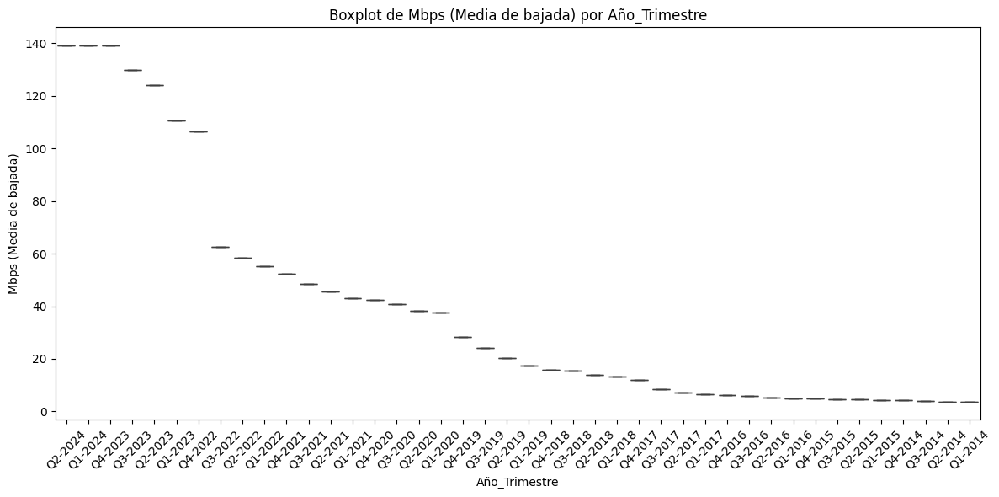


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min      25%     50%      75%  \
meses_periodo                                                              
abr - jun       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


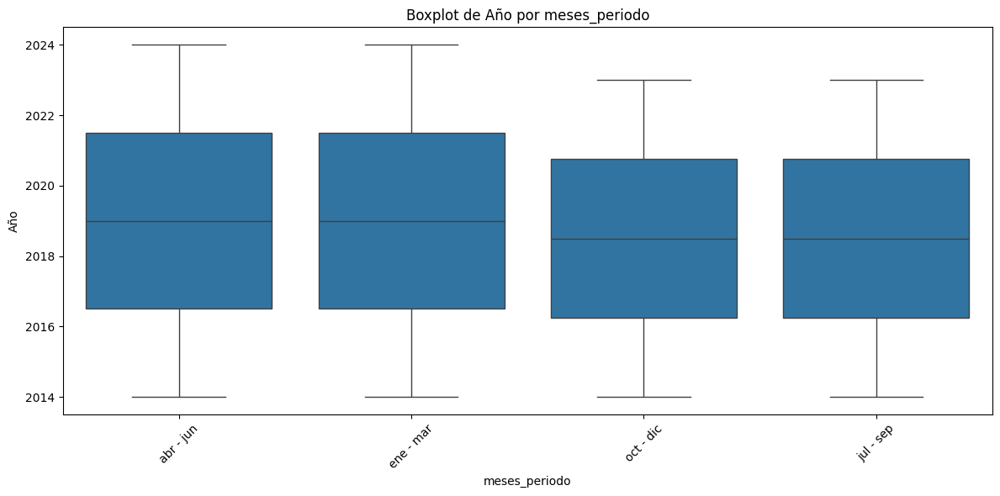


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


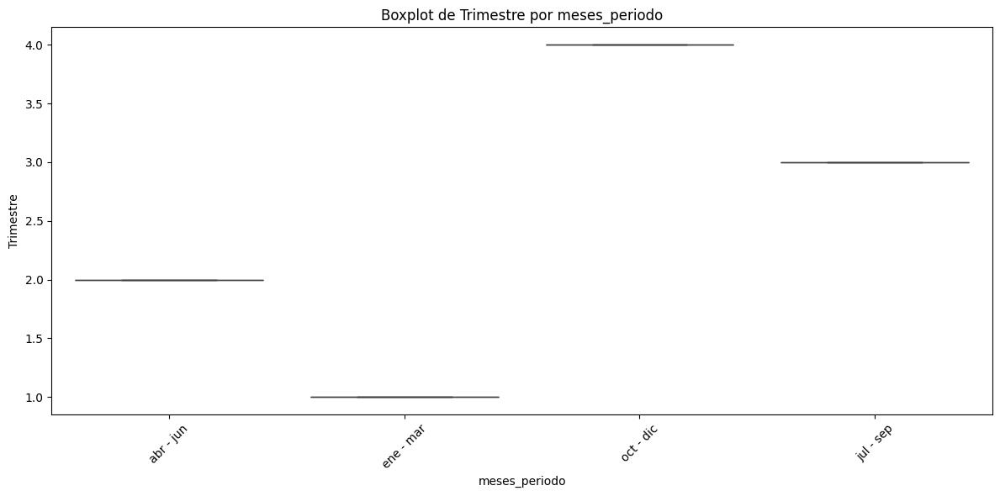


Estadísticas descriptivas de 'Mbps (Media de bajada)' agrupadas por 'meses_periodo':
               count       mean        std       min       25%     50%  \
meses_periodo                                                            
abr - jun       11.0  41.877920  48.113556  3.758712  6.291743  20.330   
ene - mar       11.0  39.606048  46.043324  3.617127  5.853890  17.380   
jul - sep       10.0  34.373400  39.251291  3.867265  6.538844  19.770   
oct - dic       10.0  41.200235  46.578449  4.156888  7.754945  22.105   

                   75%     max  
meses_periodo                   
abr - jun      52.0350  139.25  
ene - mar      49.1100  139.15  
jul - sep      46.5125  129.67  
oct - dic      49.8450  139.04  


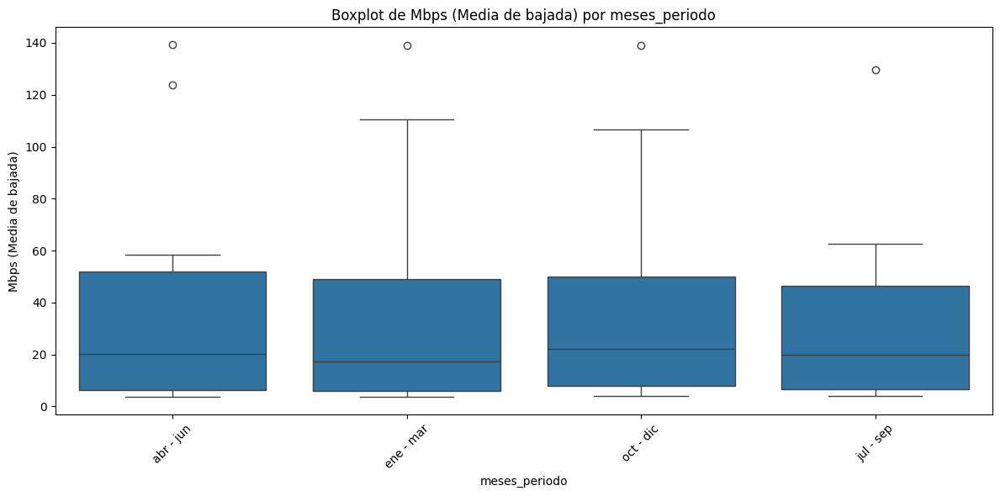

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [26]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
         Año  Trimestre  Mbps (Media de bajada)
0   1.724231  -0.404989                2.317117
1   1.724231  -1.300229                2.314798
2   1.395060   1.385490                2.312247
3   1.395060   0.490250                2.094949
4   1.395060  -0.404989                1.962297
5   1.395060  -1.300229                1.650381
6   1.065888   1.385490                1.559009
7   1.065888   0.490250                0.536293
8   1.065888  -0.404989                0.443066
9   1.065888  -1.300229                0.365841
10  0.736717   1.385490                0.301602
11  0.736717   0.490250                0.211622
12  0.736717  -0.404989                0.145992
13  0.736717  -1.300229                0.087551
14  0.407546   1.385490                0.070158
15  0.407546   0.490250                0.030965
16  0.407546  -0.404989               -0.023533
17  0.407546  -1.300229               -0.042086
18  0.078374   1.385490               -0.256833
19 

In [27]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Periodo':
Periodo
Abr-Jun 2024     1
Ene-Mar 2024     1
Oct-Dic 2023     1
Jul-Sept 2023    1
Abr-Jun 2023     1
Ene-Mar 2023     1
Oct-Dic 2022     1
Jul-Sept 2022    1
Abr-Jun 2022     1
Ene-Mar 2022     1
Oct-Dic 2021     1
Jul-Sept 2021    1
Abr-Jun 2021     1
Ene-Mar 2021     1
Oct-Dic 2020     1
Jul-Sept 2020    1
Abr-Jun 2020     1
Ene-Mar 2020     1
Oct-Dic 2019     1
Jul-Sept 2019    1
Abr-Jun 2019     1
Ene-Mar 2019     1
Oct-Dic 2018     1
Jul-Sept 2018    1
Abr-Jun 2018     1
Ene-Mar 2018     1
Oct-Dic 2017     1
Jul-Sept 2017    1
Abr-Jun 2017     1
Ene-Mar 2017     1
Oct-Dic 2016     1
Jul-Sept 2016    1
Abr-Jun 2016     1
Ene-Mar 2016     1
Oct-Dic 2015     1
Jul-Sept 2015    1
Abr-Jun 2015     1
Ene-Mar 2015     1
Oct-Dic 2014     1
Jul-Sept 2014    1
Abr-Jun 2014     1
Ene-Mar 2014     1
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    1
Q1-2024    1
Q4-2023    1
Q3-2023    1
Q2

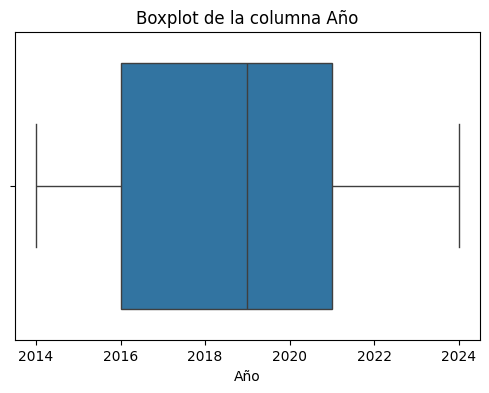

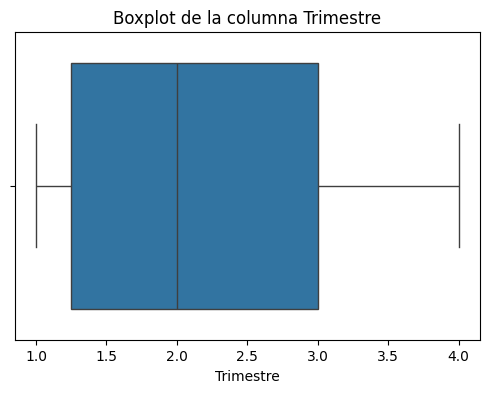

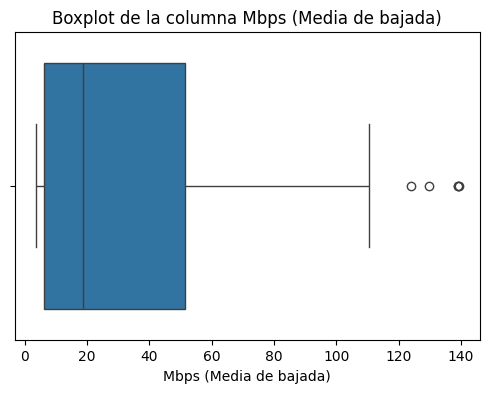

In [28]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [29]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales VMD.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales VMD.csv


In [30]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [31]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                       0.024172
Trimestre                 0.070729
Mbps (Media de bajada)    1.330087
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                      -1.186795
Trimestre                -1.371727
Mbps (Media de bajada)    0.542731
dtype: float64


In [32]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                 Variable           VIF
0                   const  1.979579e+06
1                     Año  4.491726e+00
2               Trimestre  1.020139e+00
3  Mbps (Media de bajada)  4.467713e+00


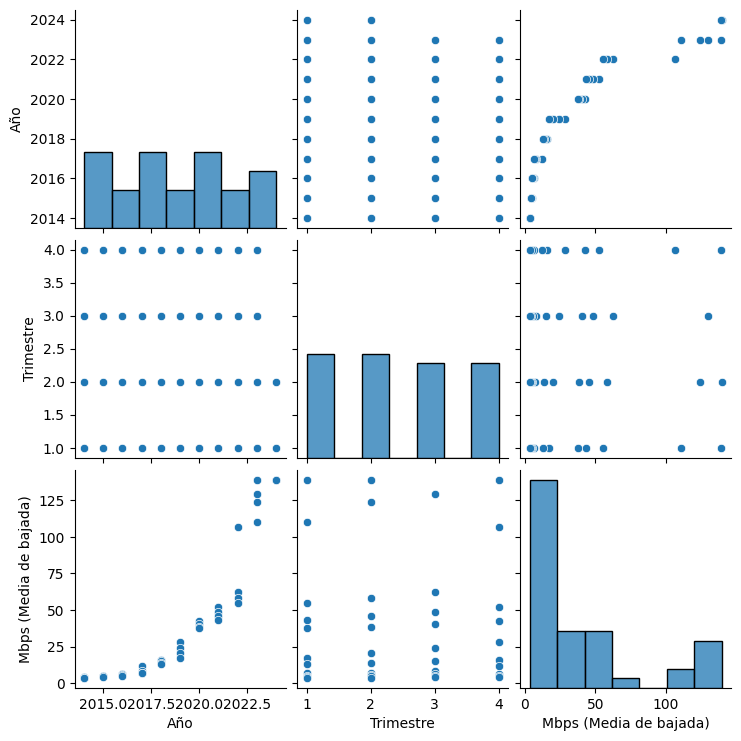

In [33]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [34]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Periodo':
                Año                                                      \
              count    mean std     min     25%     50%     75%     max   
Periodo                                                                   
Abr-Jun 2014    1.0  2014.0 NaN  2014.0  2014.0  2014.0  2014.0  2014.0   
Abr-Jun 2015    1.0  2015.0 NaN  2015.0  2015.0  2015.0  2015.0  2015.0   
Abr-Jun 2016    1.0  2016.0 NaN  2016.0  2016.0  2016.0  2016.0  2016.0   
Abr-Jun 2017    1.0  2017.0 NaN  2017.0  2017.0  2017.0  2017.0  2017.0   
Abr-Jun 2018    1.0  2018.0 NaN  2018.0  2018.0  2018.0  2018.0  2018.0   
Abr-Jun 2019    1.0  2019.0 NaN  2019.0  2019.0  2019.0  2019.0  2019.0   
Abr-Jun 2020    1.0  2020.0 NaN  2020.0  2020.0  2020.0  2020.0  2020.0   
Abr-Jun 2021    1.0  2021.0 NaN  2021.0  2021.0  2021.0  2021.0  2021.0   
Abr-Jun 2022    1.0  2022.0 NaN  2022.0  2022.0  2022.0  2022.0  2022.0   
Abr-Jun 2023    1.0  2023.0 NaN  2023.0  2023.0  2023.0  2023.

In [25]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Accesos por rangos.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [26]:
print(df.head())

    Año  Trimestre        Provincia  HASTA 512 kbps  + 512 Kbps - 1 Mbps  \
0  2024          2     Buenos Aires         25287.0              23034.0   
1  2024          2  Capital Federal           518.0               4122.0   
2  2024          2        Catamarca            72.0                164.0   
3  2024          2            Chaco           236.0                349.0   
4  2024          2           Chubut           125.0               1139.0   

   + 1 Mbps - 6 Mbps  + 6 Mbps - 10 Mbps  + 10 Mbps - 20 Mbps  \
0           222627.0            221660.0             244528.0   
1            24539.0             40296.0              33158.0   
2             2660.0              3093.0               3799.0   
3            14594.0              8336.0               6208.0   
4            43699.0             31971.0              22696.0   

   + 20 Mbps - 30 Mbps  + 30 Mbps     OTROS      Total  
0             106302.0  4020395.0  125547.0  4989380.0  
1               5633.0  1355333.0     

In [27]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Año                  1000 non-null   int64  
 1   Trimestre            1000 non-null   int64  
 2   Provincia            1000 non-null   object 
 3   HASTA 512 kbps       1000 non-null   float64
 4   + 512 Kbps - 1 Mbps  1000 non-null   float64
 5   + 1 Mbps - 6 Mbps    1000 non-null   float64
 6   + 6 Mbps - 10 Mbps   1000 non-null   float64
 7   + 10 Mbps - 20 Mbps  1000 non-null   float64
 8   + 20 Mbps - 30 Mbps  1000 non-null   float64
 9   + 30 Mbps            1000 non-null   float64
 10  OTROS                994 non-null    float64
 11  Total                1000 non-null   float64
dtypes: float64(9), int64(2), object(1)
memory usage: 93.9+ KB
None


In [28]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

      Año  Trimestre Año_Trimestre meses_periodo
0    2024          2       Q2-2024     abr - jun
1    2024          2       Q2-2024     abr - jun
2    2024          2       Q2-2024     abr - jun
3    2024          2       Q2-2024     abr - jun
4    2024          2       Q2-2024     abr - jun
..    ...        ...           ...           ...
995  2014          1       Q1-2014     ene - mar
996  2014          1       Q1-2014     ene - mar
997  2014          1       Q1-2014     ene - mar
998  2014          1       Q1-2014     ene - mar
999  2014          1       Q1-2014     ene - mar

[1000 rows x 4 columns]


In [29]:
print(df.head())

    Año  Trimestre        Provincia  HASTA 512 kbps  + 512 Kbps - 1 Mbps  \
0  2024          2     Buenos Aires         25287.0              23034.0   
1  2024          2  Capital Federal           518.0               4122.0   
2  2024          2        Catamarca            72.0                164.0   
3  2024          2            Chaco           236.0                349.0   
4  2024          2           Chubut           125.0               1139.0   

   + 1 Mbps - 6 Mbps  + 6 Mbps - 10 Mbps  + 10 Mbps - 20 Mbps  \
0           222627.0            221660.0             244528.0   
1            24539.0             40296.0              33158.0   
2             2660.0              3093.0               3799.0   
3            14594.0              8336.0               6208.0   
4            43699.0             31971.0              22696.0   

   + 20 Mbps - 30 Mbps  + 30 Mbps     OTROS      Total Año_Trimestre  \
0             106302.0  4020395.0  125547.0  4989380.0       Q2-2024   
1       

In [30]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Error al convertir la columna 'OTROS' a <class 'int'>: Cannot convert non-finite values (NA or inf) to integer
Año                      int64
Trimestre                int64
Provincia               object
HASTA 512 kbps         float64
+ 512 Kbps - 1 Mbps    float64
+ 1 Mbps - 6 Mbps      float64
+ 6 Mbps - 10 Mbps     float64
+ 10 Mbps - 20 Mbps    float64
+ 20 Mbps - 30 Mbps    float64
+ 30 Mbps              float64
OTROS                  float64
Total                    int64
Año_Trimestre           object
Periodo                 object
meses_periodo           object
dtype: object


In [31]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Año                  1000 non-null   int64  
 1   Trimestre            1000 non-null   int64  
 2   Provincia            1000 non-null   object 
 3   HASTA 512 kbps       1000 non-null   float64
 4   + 512 Kbps - 1 Mbps  1000 non-null   float64
 5   + 1 Mbps - 6 Mbps    1000 non-null   float64
 6   + 6 Mbps - 10 Mbps   1000 non-null   float64
 7   + 10 Mbps - 20 Mbps  1000 non-null   float64
 8   + 20 Mbps - 30 Mbps  1000 non-null   float64
 9   + 30 Mbps            1000 non-null   float64
 10  OTROS                994 non-null    float64
 11  Total                1000 non-null   int64  
 12  Año_Trimestre        1000 non-null   object 
 13  Periodo              1000 non-null   object 
 14  meses_periodo        1000 non-null   object 
dtypes: float64(8), int64(3), object(4)
memo

In [32]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [33]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [34]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Año                  1000 non-null   int64  
 1   Trimestre            1000 non-null   int64  
 2   Provincia            1000 non-null   object 
 3   HASTA 512 kbps       1000 non-null   float64
 4   + 512 Kbps - 1 Mbps  1000 non-null   float64
 5   + 1 Mbps - 6 Mbps    1000 non-null   float64
 6   + 6 Mbps - 10 Mbps   1000 non-null   float64
 7   + 10 Mbps - 20 Mbps  1000 non-null   float64
 8   + 20 Mbps - 30 Mbps  1000 non-null   float64
 9   + 30 Mbps            1000 non-null   float64
 10  OTROS                994 non-null    float64
 11  Total                1000 non-null   int64  
 12  Año_Trimestre        1000 non-null   object 
 13  Periodo              1000 non-null   object 
 14  meses_periodo        1000 non-null   object 
dtypes: float64(8), int64(3), object(4)
memo

In [35]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [36]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Año                  1000 non-null   int64  
 1   Trimestre            1000 non-null   int64  
 2   Provincia            1000 non-null   object 
 3   HASTA 512 kbps       1000 non-null   float64
 4   + 512 Kbps - 1 Mbps  1000 non-null   float64
 5   + 1 Mbps - 6 Mbps    1000 non-null   float64
 6   + 6 Mbps - 10 Mbps   1000 non-null   float64
 7   + 10 Mbps - 20 Mbps  1000 non-null   float64
 8   + 20 Mbps - 30 Mbps  1000 non-null   float64
 9   + 30 Mbps            1000 non-null   float64
 10  OTROS                994 non-null    float64
 11  Total                1000 non-null   int64  
 12  Año_Trimestre        1000 non-null   object 
 13  Periodo              1000 non-null   object 
 14  meses_periodo        1000 non-null   object 
dtypes: float64(8), int64(3), object(4)
memo

In [37]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index(['OTROS'], dtype='object')


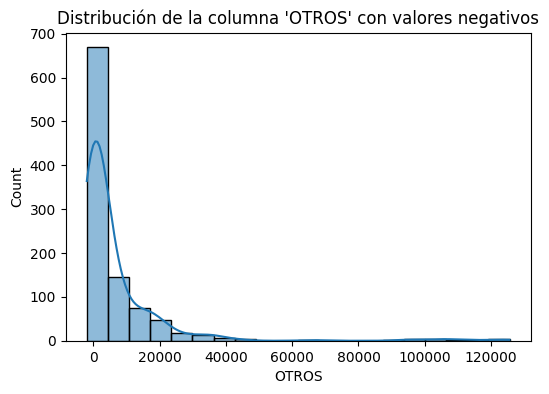

In [38]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [39]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")


Valores negativos en la columna 'OTROS': 2


In [40]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [41]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                    0
Trimestre              0
Provincia              0
HASTA 512 kbps         0
+ 512 Kbps - 1 Mbps    0
+ 1 Mbps - 6 Mbps      0
+ 6 Mbps - 10 Mbps     0
+ 10 Mbps - 20 Mbps    0
+ 20 Mbps - 30 Mbps    0
+ 30 Mbps              0
OTROS                  8
Total                  0
Año_Trimestre          0
Periodo                0
meses_periodo          0
dtype: int64


In [42]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                    0
Trimestre              0
Provincia              0
HASTA 512 kbps         0
+ 512 Kbps - 1 Mbps    0
+ 1 Mbps - 6 Mbps      0
+ 6 Mbps - 10 Mbps     0
+ 10 Mbps - 20 Mbps    0
+ 20 Mbps - 30 Mbps    0
+ 30 Mbps              0
OTROS                  8
Total                  0
Año_Trimestre          0
Periodo                0
meses_periodo          0
dtype: int64


In [43]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                    0
Trimestre              0
Provincia              0
HASTA 512 kbps         0
+ 512 Kbps - 1 Mbps    0
+ 1 Mbps - 6 Mbps      0
+ 6 Mbps - 10 Mbps     0
+ 10 Mbps - 20 Mbps    0
+ 20 Mbps - 30 Mbps    0
+ 30 Mbps              0
OTROS                  8
Total                  0
Año_Trimestre          0
Periodo                0
meses_periodo          0
dtype: int64

Columna 'OTROS' tiene 8 valores nulos (0.80%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_10624\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [44]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Año                  1000 non-null   int64  
 1   Trimestre            1000 non-null   int64  
 2   Provincia            1000 non-null   object 
 3   HASTA 512 kbps       1000 non-null   float64
 4   + 512 Kbps - 1 Mbps  1000 non-null   float64
 5   + 1 Mbps - 6 Mbps    1000 non-null   float64
 6   + 6 Mbps - 10 Mbps   1000 non-null   float64
 7   + 10 Mbps - 20 Mbps  1000 non-null   float64
 8   + 20 Mbps - 30 Mbps  1000 non-null   float64
 9   + 30 Mbps            1000 non-null   float64
 10  OTROS                1000 non-null   float64
 11  Total                1000 non-null   int64  
 12  Año_Trimestre        1000 non-null   object 
 13  Periodo              1000 non-null   object 
 14  meses_periodo        1000 non-null   object 
dtypes: float64(8), int64(3), object(4)
memo


Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia  HASTA 512 kbps  \
count   1000.000000  1000.000000          1000     1000.000000   
unique          NaN          NaN            23             NaN   
top             NaN          NaN  BUENOS AIRES             NaN   
freq            NaN          NaN            84             NaN   
mean    2018.824000     2.464000           NaN     1953.317000   
std        3.058493     1.114426           NaN    12676.575806   
min     2014.000000     1.000000           NaN        6.000000   
25%     2016.000000     1.000000           NaN       43.250000   
50%     2019.000000     2.000000           NaN      107.000000   
75%     2021.000000     3.000000           NaN      466.250000   
max     2024.000000     4.000000           NaN   238920.000000   

        + 512 Kbps - 1 Mbps  + 1 Mbps - 6 Mbps  + 6 Mbps - 10 Mbps  \
count           1000.000000       1.000000e+03         1000.000

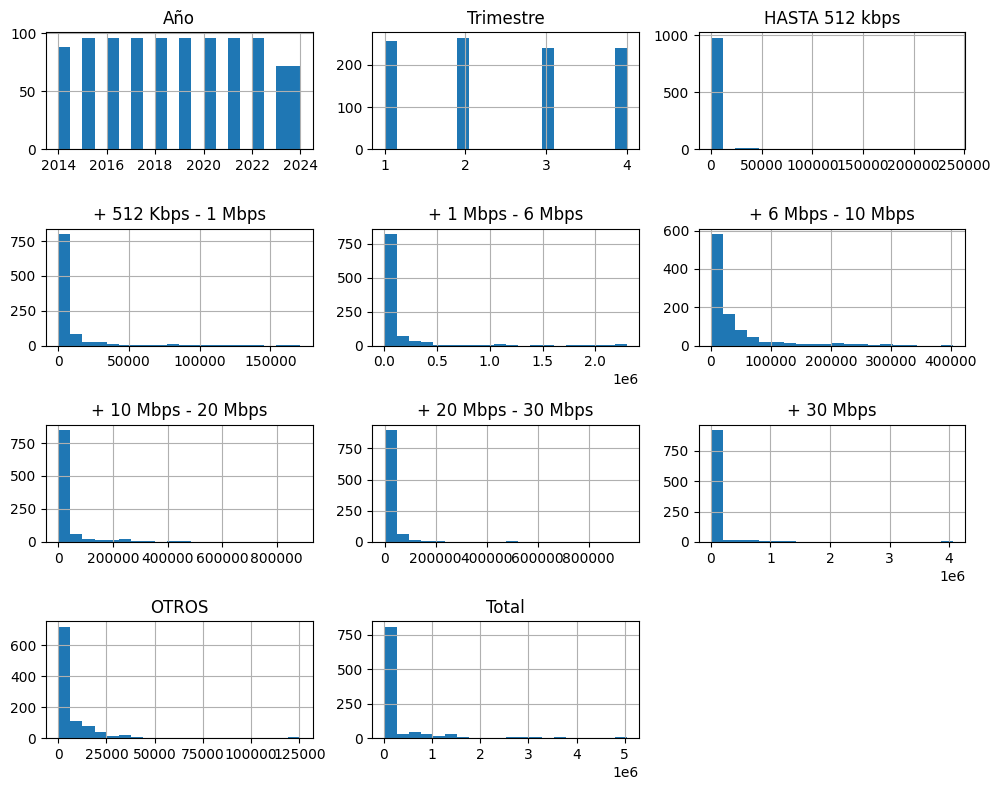

In [45]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                          Año  Trimestre  HASTA 512 kbps  + 512 Kbps - 1 Mbps  \
Año                  1.000000  -0.079393       -0.001343            -0.330976   
Trimestre           -0.079393   1.000000       -0.001507            -0.026326   
HASTA 512 kbps      -0.001343  -0.001507        1.000000             0.257982   
+ 512 Kbps - 1 Mbps -0.330976  -0.026326        0.257982             1.000000   
+ 1 Mbps - 6 Mbps   -0.198674  -0.003507        0.381098             0.815952   
+ 6 Mbps - 10 Mbps   0.104317   0.010679        0.356521             0.514887   
+ 10 Mbps - 20 Mbps  0.018461   0.002718        0.395033             0.465219   
+ 20 Mbps - 30 Mbps  0.075515   0.022964        0.590414             0.255430   
+ 30 Mbps            0.262288  -0.003537        0.378835             0.099451   
OTROS                0.318001  -0.010643        0.219484             0.080258   
Total                0.088366  -0.001192        0.530679             0

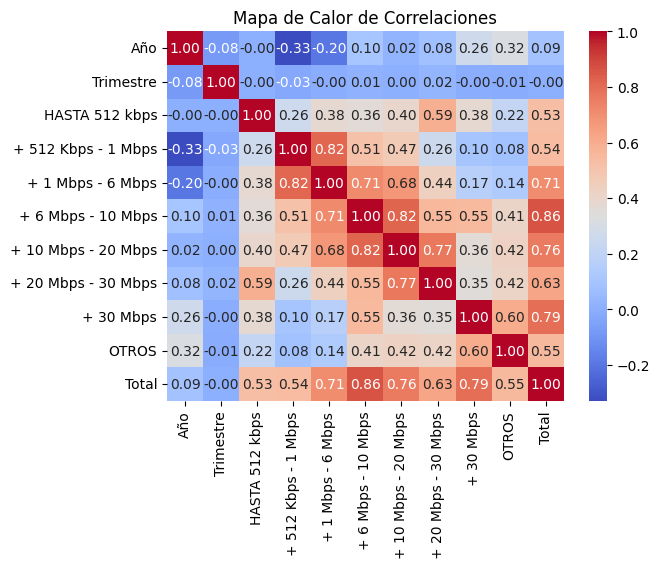

In [46]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               2        2        2        2        2        2   
CATAMARCA                  1        1        1        1        1        1   
CHACO                      1        1        1        1        1        1   
CHUBUT                     1        1        1        1        1        1   
CORRIENTES                 1        1        1        1        1        1   
CÓRDOBA                    1        1        1        1        1        1   
ENTRE RÍOS                 1        1        1        1        1        1   
FORMOSA                    1        1        1        1        1        1   
JUJUY                      1        1        1        1        1        1   
LA PAMPA                   1        1        1        1        1        1   
LA RIOJA            

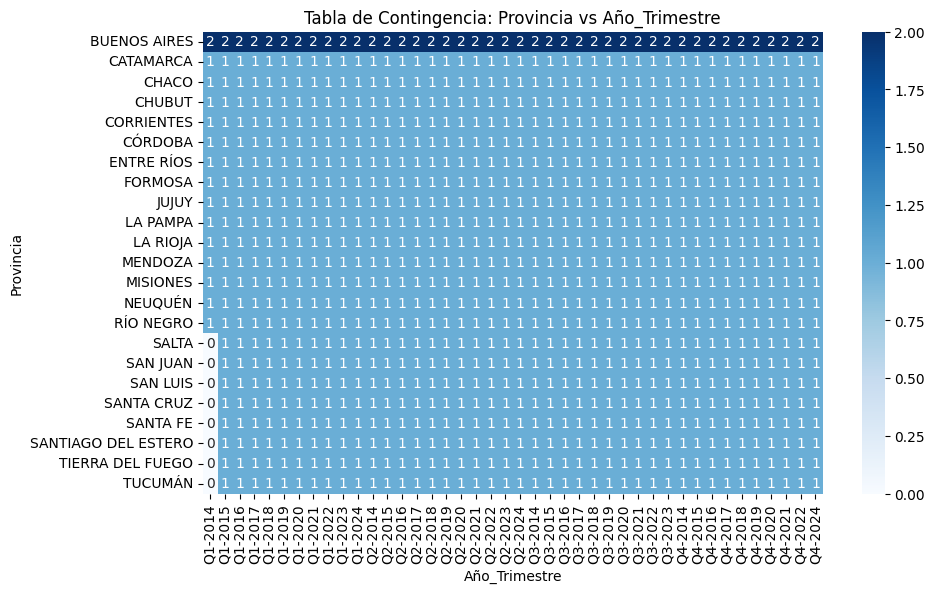


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                 84
CATAMARCA                    42
CHACO                        42
CHUBUT                       42
CORRIENTES                   42
CÓRDOBA                      42
ENTRE RÍOS                   42
FORMOSA                      42
JUJUY                        42
LA PAMPA                     42
LA RIOJA                     42
MENDOZA                      42
MISIONES                     42
NEUQUÉN                      42
RÍO NEGRO                    42
SALTA                        41
SAN JUAN                     41
SAN LUIS                     41
SANTA CRUZ                   41
SANTA FE                     41
SANTIAGO DEL ESTERO          41
TIERRA DEL FUEGO             41
TUCUMÁN                      41


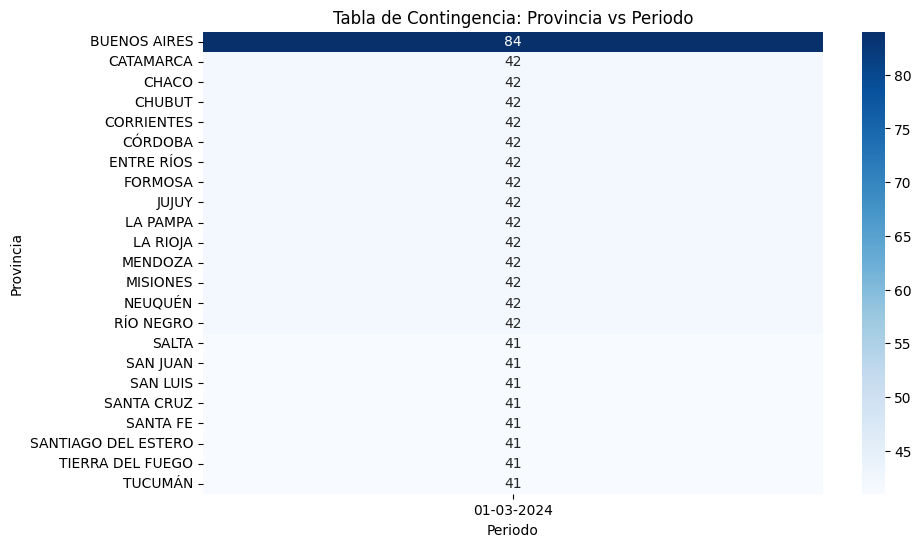


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                22         22         20         20
CATAMARCA                   11         11         10         10
CHACO                       11         11         10         10
CHUBUT                      11         11         10         10
CORRIENTES                  11         11         10         10
CÓRDOBA                     11         11         10         10
ENTRE RÍOS                  11         11         10         10
FORMOSA                     11         11         10         10
JUJUY                       11         11         10         10
LA PAMPA                    11         11         10         10
LA RIOJA                    11         11         10         10
MENDOZA                     11         11         10         10
MISIONES                    11         11       

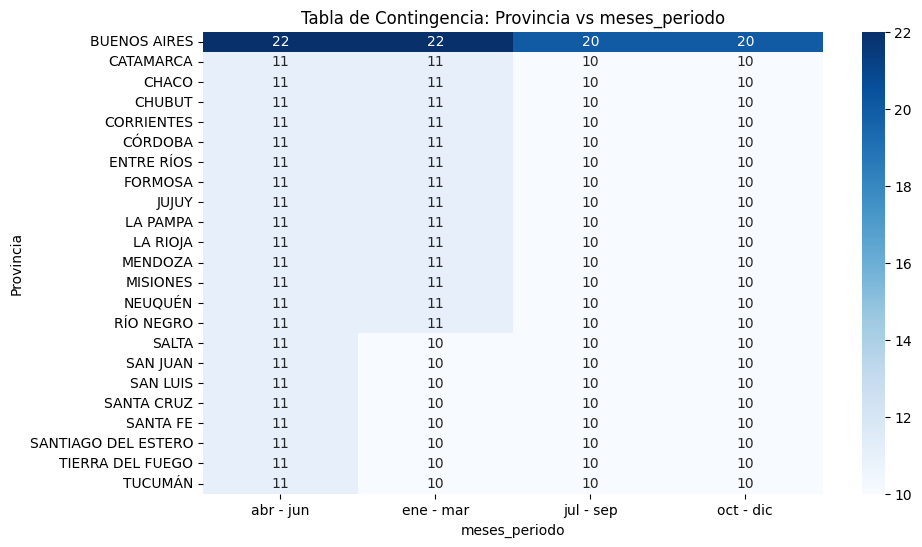


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                16
Q1-2015                24
Q1-2016                24
Q1-2017                24
Q1-2018                24
Q1-2019                24
Q1-2020                24
Q1-2021                24
Q1-2022                24
Q1-2023                24
Q1-2024                24
Q2-2014                24
Q2-2015                24
Q2-2016                24
Q2-2017                24
Q2-2018                24
Q2-2019                24
Q2-2020                24
Q2-2021                24
Q2-2022                24
Q2-2023                24
Q2-2024                24
Q3-2014                24
Q3-2015                24
Q3-2016                24
Q3-2017                24
Q3-2018                24
Q3-2019                24
Q3-2020                24
Q3-2021                24
Q3-2022                24
Q3-2023                24
Q4-2014                24
Q4-2015                24
Q4-2016   

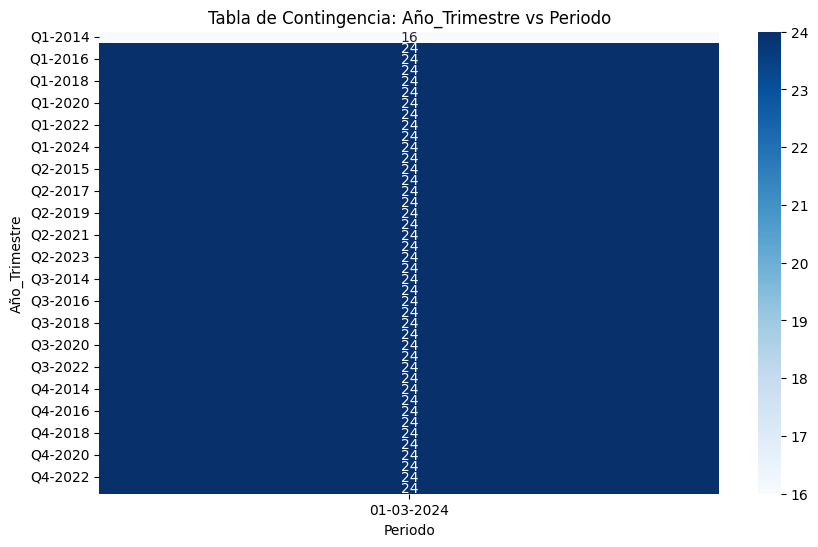


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         16          0          0
Q1-2015                0         24          0          0
Q1-2016                0         24          0          0
Q1-2017                0         24          0          0
Q1-2018                0         24          0          0
Q1-2019                0         24          0          0
Q1-2020                0         24          0          0
Q1-2021                0         24          0          0
Q1-2022                0         24          0          0
Q1-2023                0         24          0          0
Q1-2024                0         24          0          0
Q2-2014               24          0          0          0
Q2-2015               24          0          0          0
Q2-2016               24          0          0          0
Q2-2017     

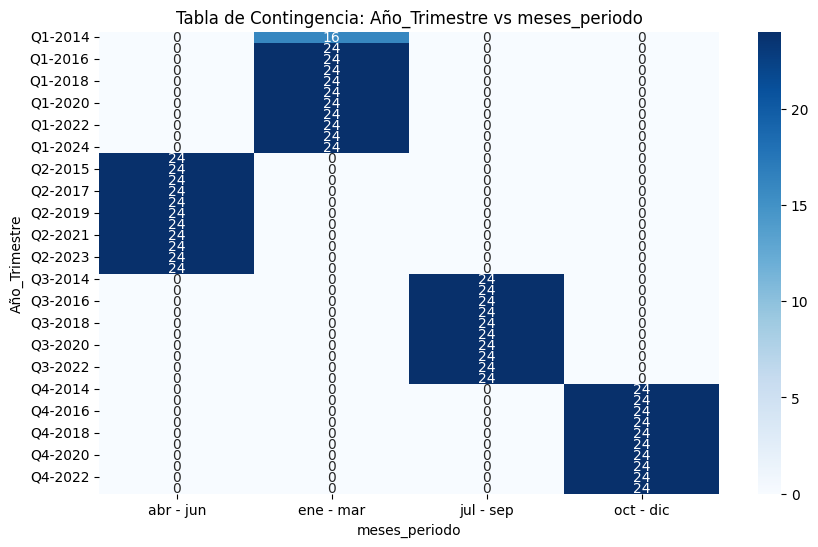


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           264        256        240        240


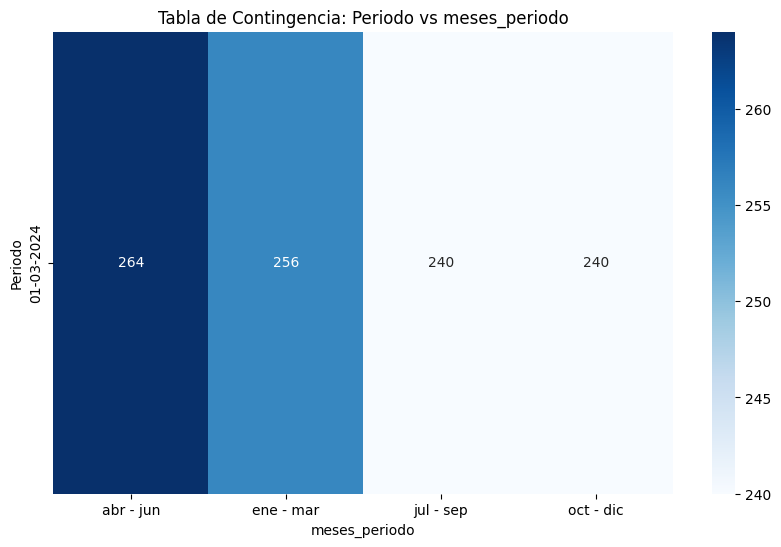

In [47]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES          84.0  2018.785714  3.093216  2014.0  2016.0  2019.0   
CATAMARCA             42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CHACO                 42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CHUBUT                42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CORRIENTES            42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CÓRDOBA               42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
ENTRE RÍOS            42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
FORMOSA               42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
JUJUY                 42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
LA PAMPA              42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
LA RIOJA     

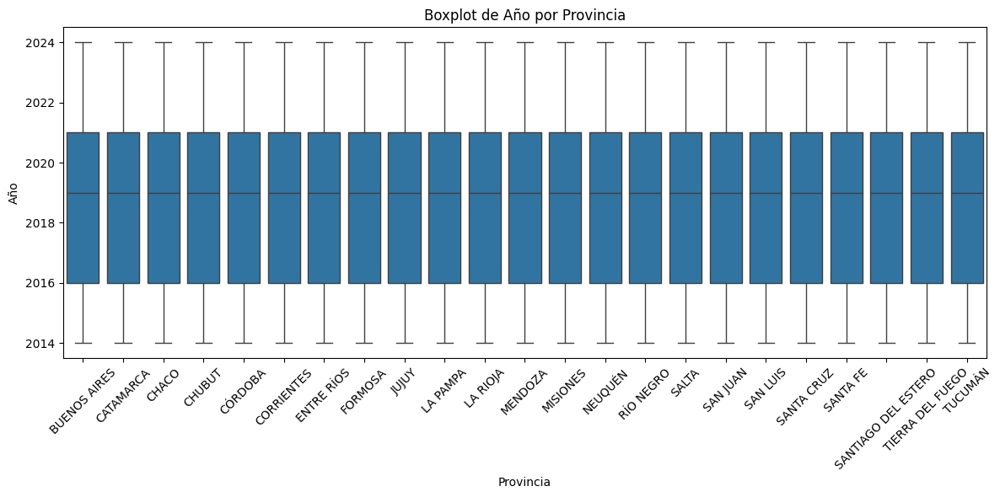


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min   25%  50%  75%  max
Provincia                                                               
BUENOS AIRES          84.0  2.452381  1.123728  1.0  1.00  2.0  3.0  4.0
CATAMARCA             42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHACO                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHUBUT                42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CORRIENTES            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CÓRDOBA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
ENTRE RÍOS            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
FORMOSA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
JUJUY                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA PAMPA              42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA RIOJA              42.0  2.452381  1.130560  1.0  1.

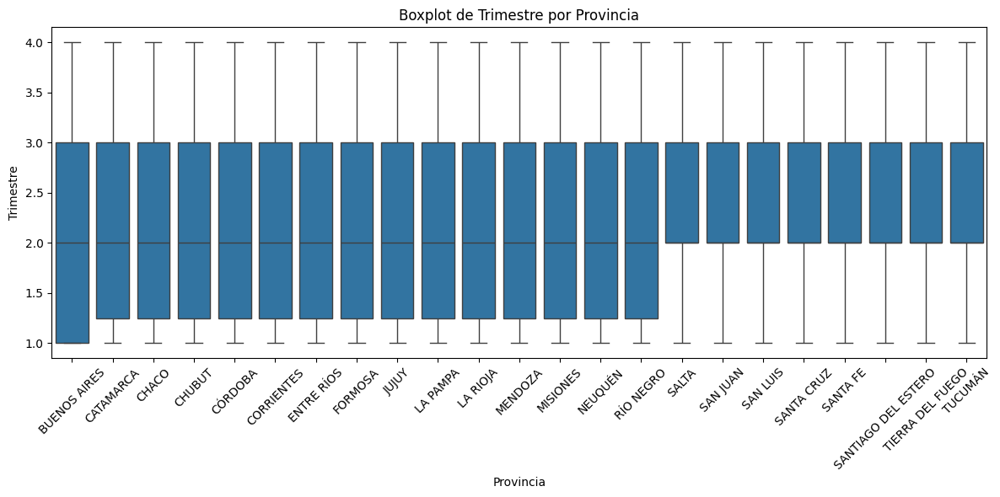


Estadísticas descriptivas de 'HASTA 512 kbps' agrupadas por 'Provincia':
                     count          mean           std    min     25%     50%  \
Provincia                                                                       
BUENOS AIRES          84.0  17942.714286  40461.088210   73.0  516.00  2519.0   
CATAMARCA             42.0     44.476190     24.306215   13.0   19.00    34.0   
CHACO                 42.0    243.238095    136.822800   26.0  118.75   236.0   
CHUBUT                42.0    513.500000   1203.917412   66.0  104.50   112.0   
CORRIENTES            42.0     42.000000     25.224843   10.0   15.00    38.0   
CÓRDOBA               42.0    277.904762    502.790691   48.0   99.00   100.0   
ENTRE RÍOS            42.0    947.380952   1220.212635   18.0  107.00   107.0   
FORMOSA               42.0    952.785714    730.607850   56.0   97.00  1110.0   
JUJUY                 42.0    594.309524    921.670553   27.0   55.00    58.0   
LA PAMPA              42.0   1153.0

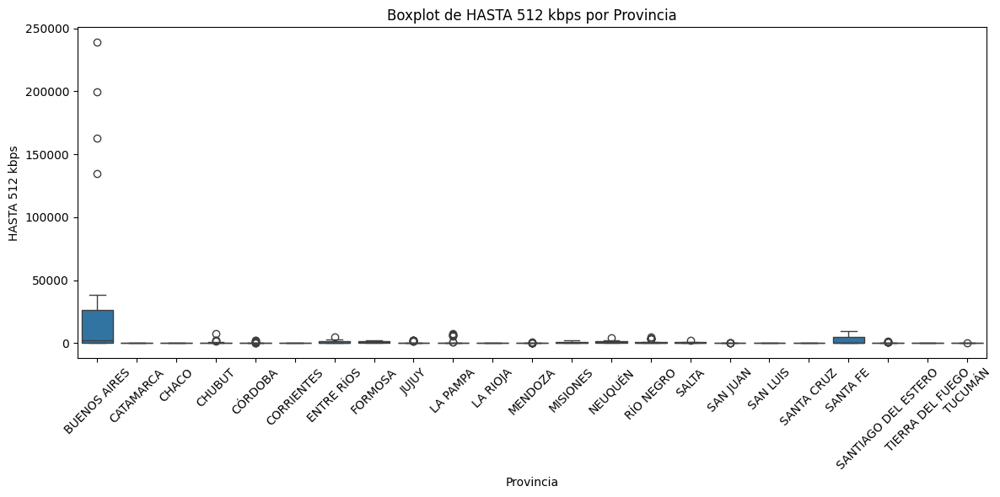


Estadísticas descriptivas de '+ 512 Kbps - 1 Mbps' agrupadas por 'Provincia':
                     count          mean           std    min      25%  \
Provincia                                                                
BUENOS AIRES          84.0  41475.857143  42767.451413   15.0  5337.50   
CATAMARCA             42.0   2597.500000   3075.468517    0.0    73.25   
CHACO                 42.0   4060.571429   4771.478061    0.0   475.50   
CHUBUT                42.0   2887.809524   2257.440221    4.0  1084.25   
CORRIENTES            42.0   5699.523810   4784.033991    0.0  2558.00   
CÓRDOBA               42.0  29089.785714  31131.424434    0.0  7842.25   
ENTRE RÍOS            42.0  10101.714286   8978.246823    0.0  4311.75   
FORMOSA               42.0   2718.833333   2904.832365    0.0   187.25   
JUJUY                 42.0   4052.357143   3812.818955    0.0  1008.25   
LA PAMPA              42.0   5111.857143   4093.438525  313.0  1337.00   
LA RIOJA              42.0   1508

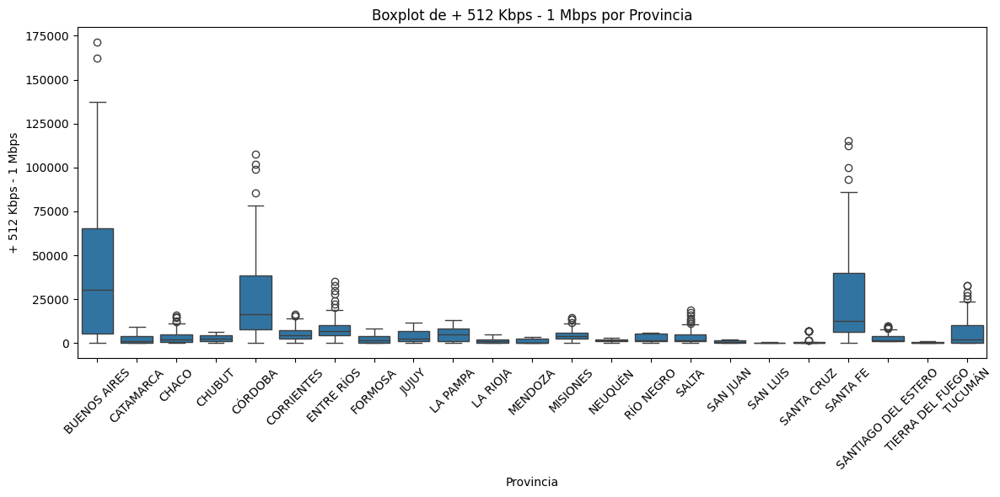


Estadísticas descriptivas de '+ 1 Mbps - 6 Mbps' agrupadas por 'Provincia':
                     count           mean            std       min        25%  \
Provincia                                                                       
BUENOS AIRES          84.0  876111.178571  758200.503605   24539.0  226951.50   
CATAMARCA             42.0   10827.785714    5383.444262    2192.0    6217.25   
CHACO                 42.0   31499.142857   12121.387539   14076.0   19770.00   
CHUBUT                42.0   66845.666667   14699.528112   43699.0   58097.75   
CORRIENTES            42.0   35941.261905    9968.715371   17264.0   28977.25   
CÓRDOBA               42.0  269930.928571  116004.890869  104023.0  188850.25   
ENTRE RÍOS            42.0   79097.500000   25950.392777   33357.0   57370.75   
FORMOSA               42.0   19465.904762    4592.655743   10092.0   14358.00   
JUJUY                 42.0   23661.642857    5523.438991   11836.0   19528.50   
LA PAMPA              42.0   582

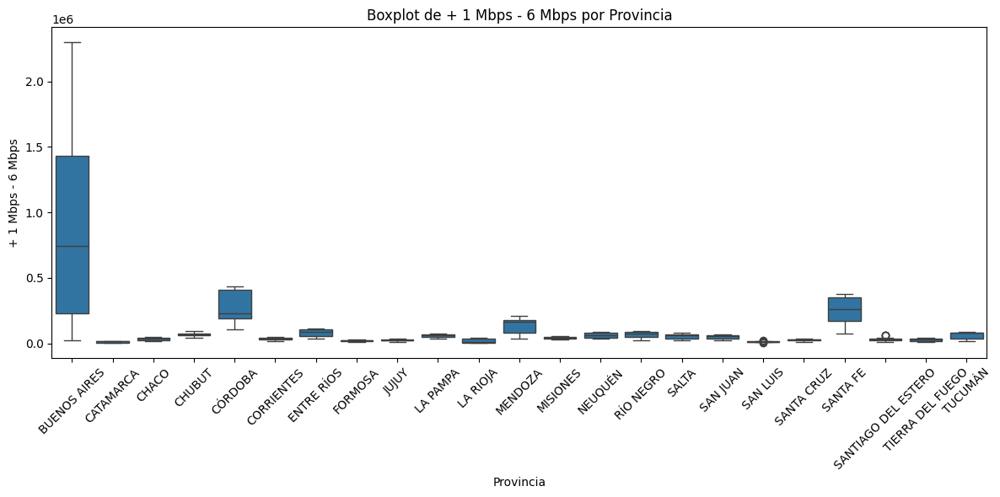


Estadísticas descriptivas de '+ 6 Mbps - 10 Mbps' agrupadas por 'Provincia':
                     count           mean           std      min        25%  \
Provincia                                                                     
BUENOS AIRES          84.0  193127.095238  93881.902900  40296.0  108227.00   
CATAMARCA             42.0    5591.642857   2142.089757   1672.0    4083.50   
CHACO                 42.0   18737.238095   6103.649427   4644.0   16331.00   
CHUBUT                42.0   13898.785714  13257.691431      0.0    1137.50   
CORRIENTES            42.0   20938.452381   6190.683256   4486.0   18219.75   
CÓRDOBA               42.0   93238.738095  30824.234885  24112.0   76482.50   
ENTRE RÍOS            42.0   43133.880952  12023.797339  10828.0   38534.50   
FORMOSA               42.0    6635.571429   4287.980491   1133.0    4001.50   
JUJUY                 42.0    9417.285714   4462.056790   2002.0    5993.00   
LA PAMPA              42.0    5685.380952   5819.6344

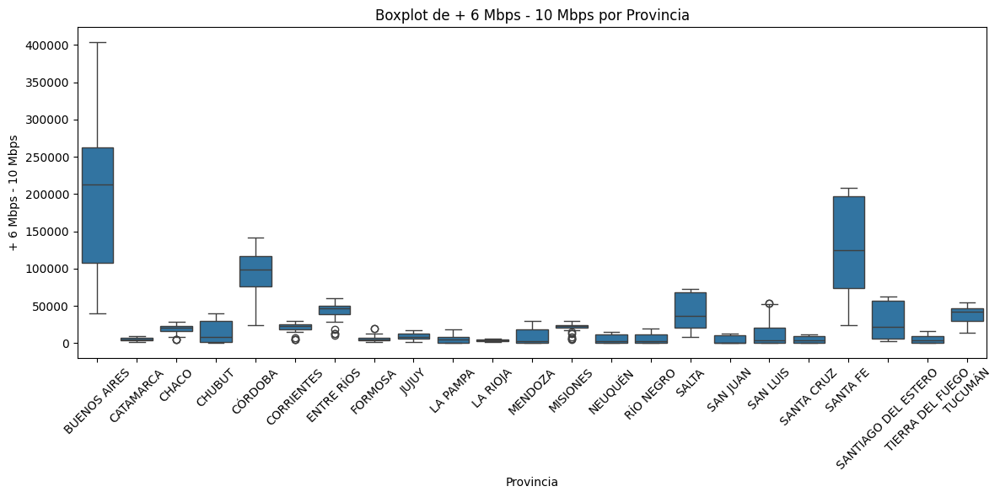


Estadísticas descriptivas de '+ 10 Mbps - 20 Mbps' agrupadas por 'Provincia':
                     count           mean            std      min       25%  \
Provincia                                                                     
BUENOS AIRES          84.0  241474.619048  193742.811931  33158.0  70417.04   
CATAMARCA             42.0    4706.357143    3451.853061     64.0   1909.00   
CHACO                 42.0   14752.928571    8846.616276    741.0   7032.75   
CHUBUT                42.0   10046.952381   12345.832821      0.0      0.00   
CORRIENTES            42.0   13087.285714    8377.261894    630.0   7033.25   
CÓRDOBA               42.0   96565.380952   64651.435462   9818.0  53615.00   
ENTRE RÍOS            42.0   23634.571429   12858.911687    746.0  15672.00   
FORMOSA               42.0    5341.523810    2788.450529     67.0   3707.25   
JUJUY                 42.0   17690.261905   16442.102364     56.0   2017.00   
LA PAMPA              42.0    4723.809524    5541.17

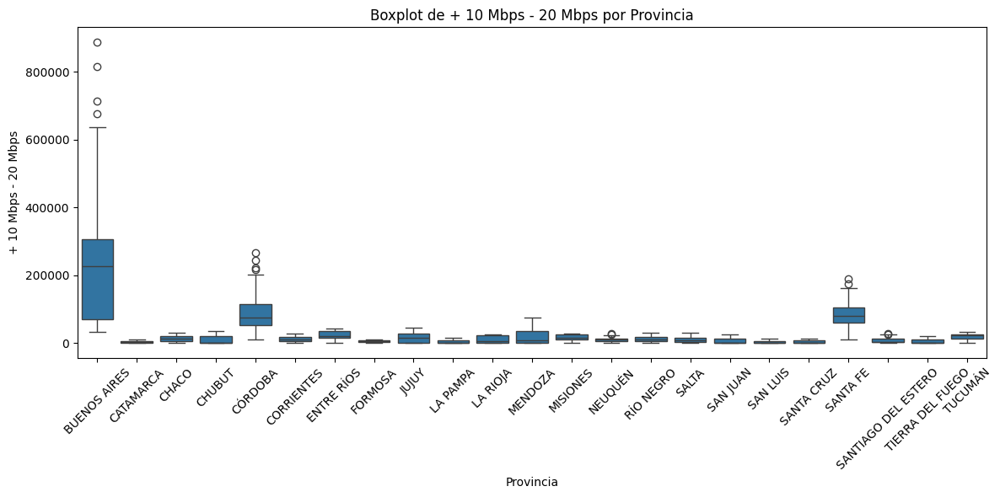


Estadísticas descriptivas de '+ 20 Mbps - 30 Mbps' agrupadas por 'Provincia':
                     count           mean            std    min       25%  \
Provincia                                                                   
BUENOS AIRES          84.0  147090.392857  190220.236054  54.84   6480.00   
CATAMARCA             42.0     954.928571    1360.603890   0.00     37.50   
CHACO                 42.0    7352.619048    5793.898355   5.00   2163.00   
CHUBUT                42.0    4877.476190    7356.033857   0.00      0.00   
CORRIENTES            42.0    5786.952381    5293.815222   0.00   1358.50   
CÓRDOBA               42.0   44441.190476   43598.656225  40.00  12632.75   
ENTRE RÍOS            42.0   11642.857143    9763.141267   0.00   1430.50   
FORMOSA               42.0     831.023810     655.216609   0.00    292.50   
JUJUY                 42.0     193.976190     222.792859   0.00     27.75   
LA PAMPA              42.0    1981.095238    2023.262480   4.00    118.50 

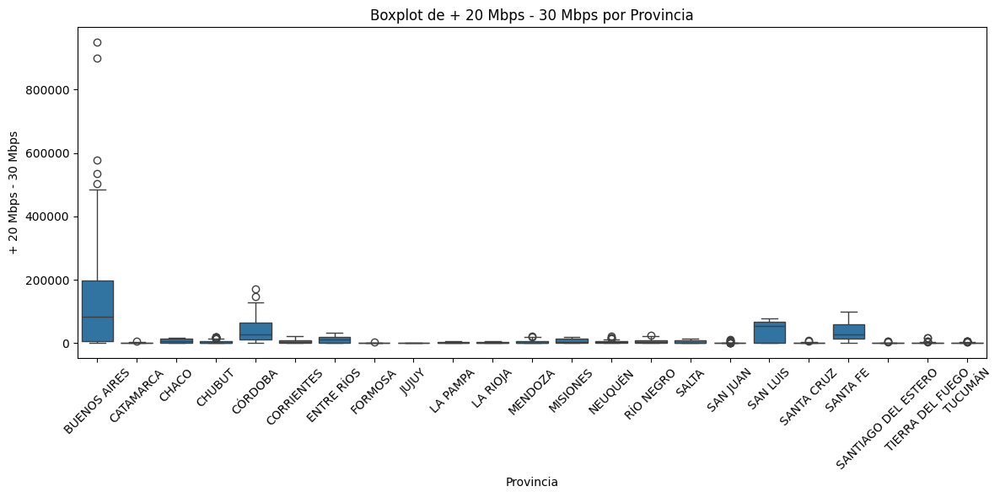


Estadísticas descriptivas de '+ 30 Mbps' agrupadas por 'Provincia':
                     count          mean           std     min       25%  \
Provincia                                                                  
BUENOS AIRES          84.0  1.028170e+06  1.260774e+06  4037.0  13783.75   
CATAMARCA             42.0  1.720867e+04  2.310518e+04     0.0      1.00   
CHACO                 42.0  3.239281e+04  3.901410e+04     0.0    225.25   
CHUBUT                42.0  6.466643e+03  1.176155e+04     0.0      0.00   
CORRIENTES            42.0  2.673836e+04  3.523398e+04     0.0    216.00   
CÓRDOBA               42.0  2.612785e+05  2.944683e+05   588.0   1393.00   
ENTRE RÍOS            42.0  4.520712e+04  5.677975e+04    43.0    256.00   
FORMOSA               42.0  7.206286e+03  8.463974e+03     0.0     11.75   
JUJUY                 42.0  1.661090e+04  2.202179e+04     0.0      0.00   
LA PAMPA              42.0  7.800429e+03  1.176376e+04    10.0     11.00   
LA RIOJA           

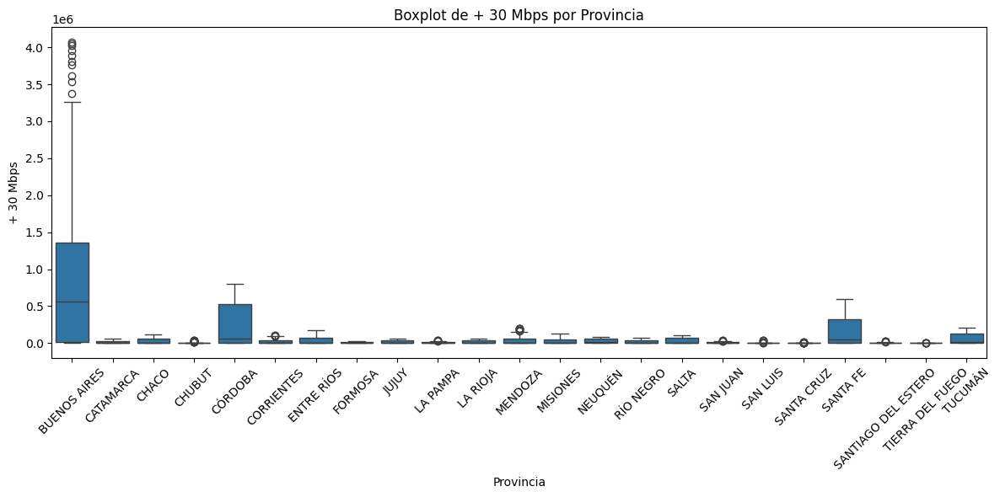


Estadísticas descriptivas de 'OTROS' agrupadas por 'Provincia':
                     count          mean           std  min  25%      50%  \
Provincia                                                                   
BUENOS AIRES          84.0  24609.018517  41896.367157  0.0  0.0      0.0   
CATAMARCA             42.0   1408.547619   1618.098661  0.0  0.0   2077.0   
CHACO                 42.0   2940.404762   3111.132882  0.0  0.0   1263.5   
CHUBUT                42.0   6148.142857   7462.051054  0.0  0.0   4060.0   
CORRIENTES            42.0   3101.357143   3268.059690  0.0  0.0   2390.0   
CÓRDOBA               42.0   8678.690476   9146.100743  0.0  0.0   8920.5   
ENTRE RÍOS            42.0   6712.261905   7543.636698  0.0  0.0      0.0   
FORMOSA               42.0    411.119048    625.086538  0.0  0.0     50.0   
JUJUY                 42.0   4729.023810   9767.142747  0.0  0.0    971.5   
LA PAMPA              42.0   2120.404762   3527.720331  0.0  0.0   1582.5   
LA RIOJA   

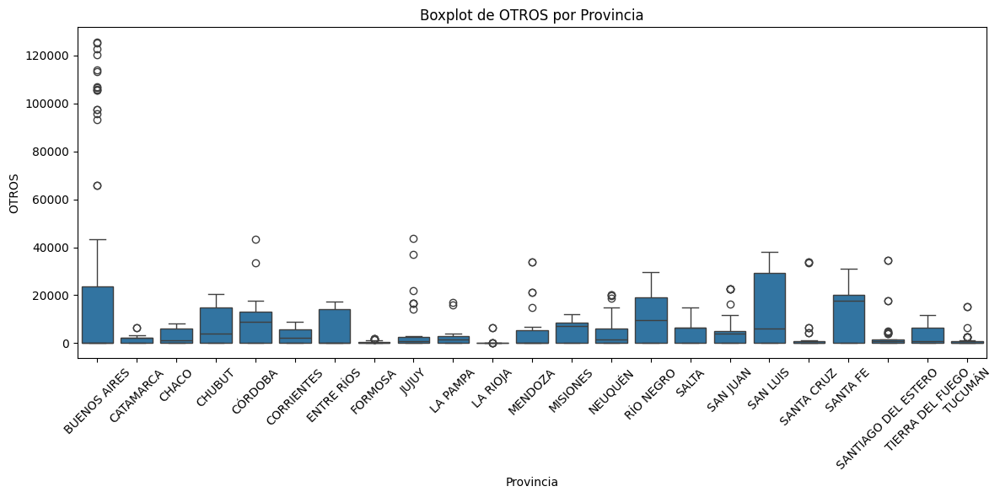


Estadísticas descriptivas de 'Total' agrupadas por 'Provincia':
                     count          mean           std        min         25%  \
Provincia                                                                       
BUENOS AIRES          84.0  2.569923e+06  1.300278e+06  1257301.0  1386683.25   
CATAMARCA             42.0  4.333990e+04  1.862833e+04    24232.0    26628.75   
CHACO                 42.0  1.119790e+05  2.832147e+04    62546.0    88902.25   
CHUBUT                42.0  1.116850e+05  3.952054e+04    62647.0    79003.00   
CORRIENTES            42.0  1.113352e+05  3.019081e+04    62235.0    88156.25   
CÓRDOBA               42.0  8.035011e+05  1.778586e+05   567453.0   642743.00   
ENTRE RÍOS            42.0  2.204773e+05  4.859007e+04   134248.0   180620.00   
FORMOSA               42.0  4.356305e+04  1.399342e+04    25422.0    29565.25   
JUJUY                 42.0  7.694976e+04  3.495804e+04    33709.0    42634.00   
LA PAMPA              42.0  8.681012e+04  2.

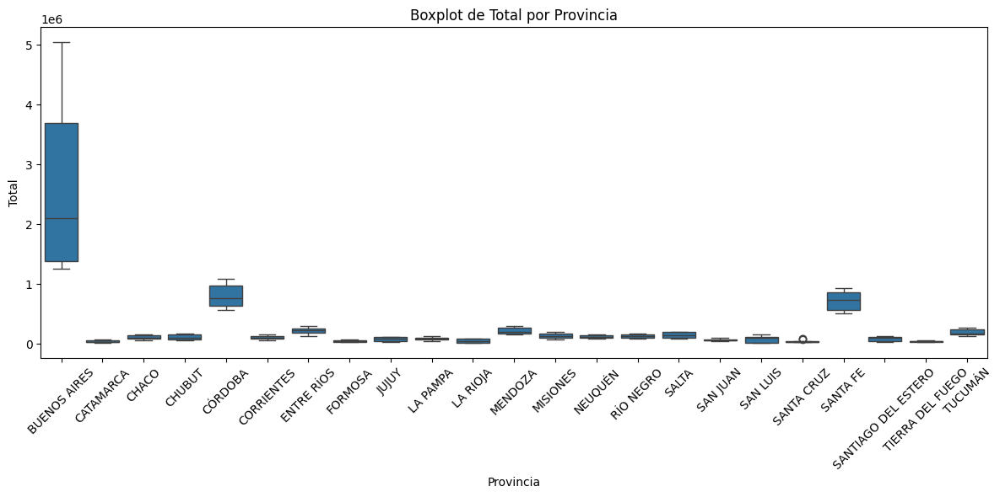


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         16.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         24.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         24.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         24.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         24.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         24.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         24.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         24.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         24.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         24.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         24.0  2024.0  0.0  2024.0  20

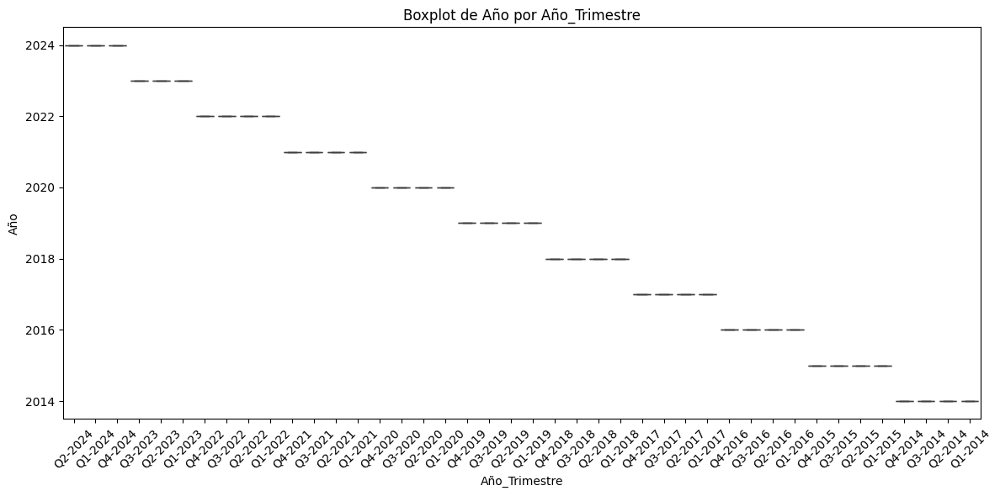


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         16.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

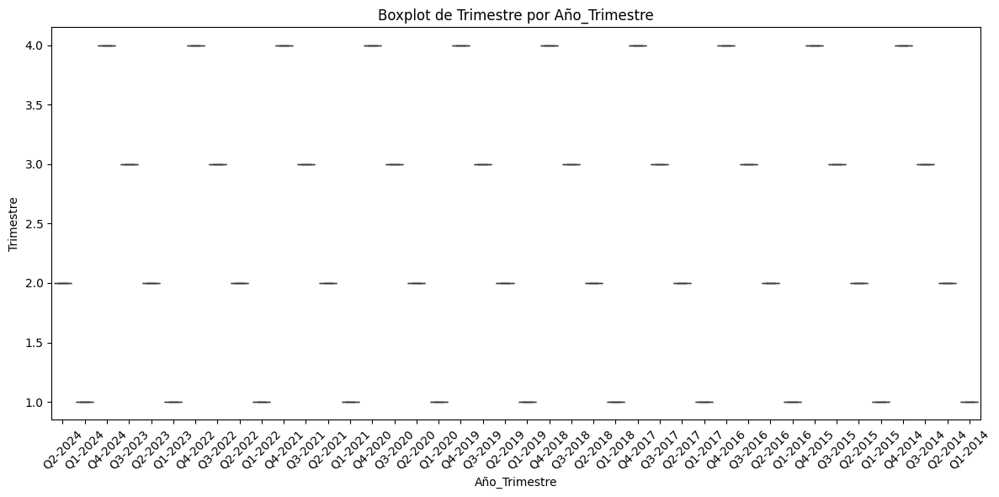


Estadísticas descriptivas de 'HASTA 512 kbps' agrupadas por 'Año_Trimestre':
               count          mean           std   min     25%     50%  \
Año_Trimestre                                                            
Q1-2014         16.0   2639.000000   2919.544554  10.0  337.25  1947.0   
Q1-2015         24.0   1714.916667   2422.007682   8.0   33.50   676.0   
Q1-2016         24.0   1267.833333   1955.735276   8.0   77.75   330.5   
Q1-2017         24.0    860.541667   1528.710994   8.0   23.50   260.5   
Q1-2018         24.0    304.541667    491.710588   6.0   21.50    62.0   
Q1-2019         24.0   6940.541667  33138.518749   6.0   21.50    48.0   
Q1-2020         24.0   1772.916667   7766.013246  11.0   61.75   121.5   
Q1-2021         24.0   1645.291667   7518.387428  17.0   49.75    82.0   
Q1-2022         24.0   1453.750000   6420.850074  18.0   56.25   103.5   
Q1-2023         24.0   1309.875000   5817.312642  18.0   56.25    91.5   
Q1-2024         24.0   1200.041667

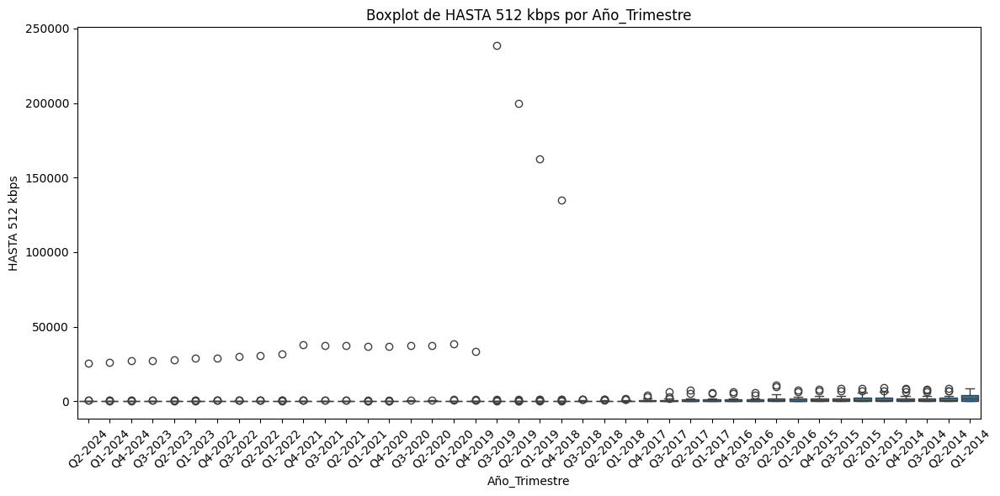


Estadísticas descriptivas de '+ 512 Kbps - 1 Mbps' agrupadas por 'Año_Trimestre':
               count          mean           std    min      25%      50%  \
Año_Trimestre                                                               
Q1-2014         16.0  31002.125000  48841.939755    6.0  4987.75  10322.5   
Q1-2015         24.0  21538.291667  32870.287866    8.0  3795.00   8645.0   
Q1-2016         24.0  16867.083333  25379.231566    4.0  2970.75   7860.5   
Q1-2017         24.0   9589.958333  18287.539705    4.0  1415.75   4008.5   
Q1-2018         24.0   8975.250000  15951.646916  101.0  2190.75   4386.5   
Q1-2019         24.0   8154.416667  15205.413675  120.0  1676.75   3586.5   
Q1-2020         24.0   2340.416667   7462.874472    0.0    82.75    334.5   
Q1-2021         24.0   1736.416667   6315.610604    0.0    15.25    184.5   
Q1-2022         24.0   4368.333333   6426.832357  448.0  1117.00   1986.5   
Q1-2023         24.0   3418.666667   5210.477076  192.0   947.25   149

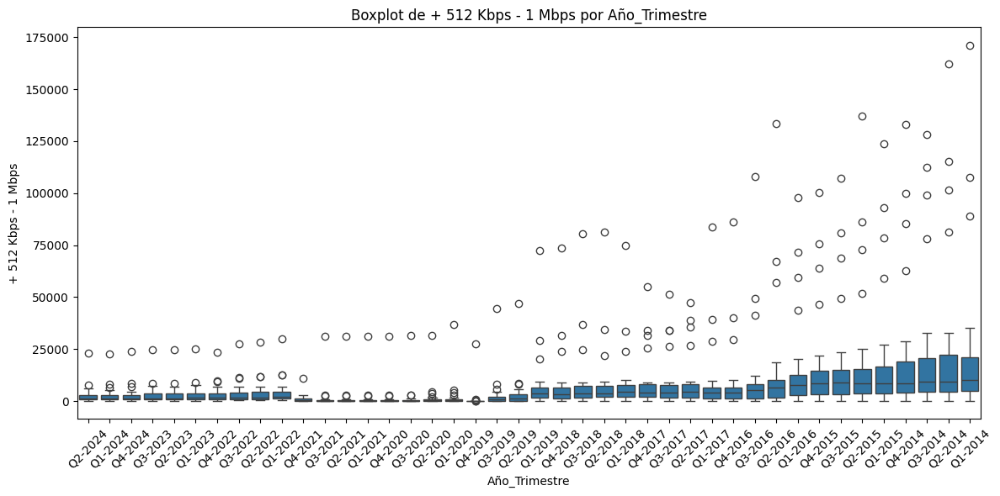


Estadísticas descriptivas de '+ 1 Mbps - 6 Mbps' agrupadas por 'Año_Trimestre':
               count           mean            std      min       25%  \
Año_Trimestre                                                           
Q1-2014         16.0  280969.187500  598604.797180   9390.0  28979.50   
Q1-2015         24.0  213392.625000  488063.425943   9379.0  25320.00   
Q1-2016         24.0  206014.916667  467601.663037   9060.0  29842.25   
Q1-2017         24.0  191022.250000  426414.777356   9486.0  30264.50   
Q1-2018         24.0  136363.500000  289448.211136  10092.0  33619.25   
Q1-2019         24.0  142864.958333  286292.292847  18761.0  38639.75   
Q1-2020         24.0  110409.125000  223540.342240   8838.0  31676.25   
Q1-2021         24.0  108061.541667  220440.226847   7423.0  29080.50   
Q1-2022         24.0   52636.375000   67693.219720   3576.0  20827.75   
Q1-2023         24.0   41731.375000   52820.624852   1892.0  16409.75   
Q1-2024         24.0   36089.666667   46076

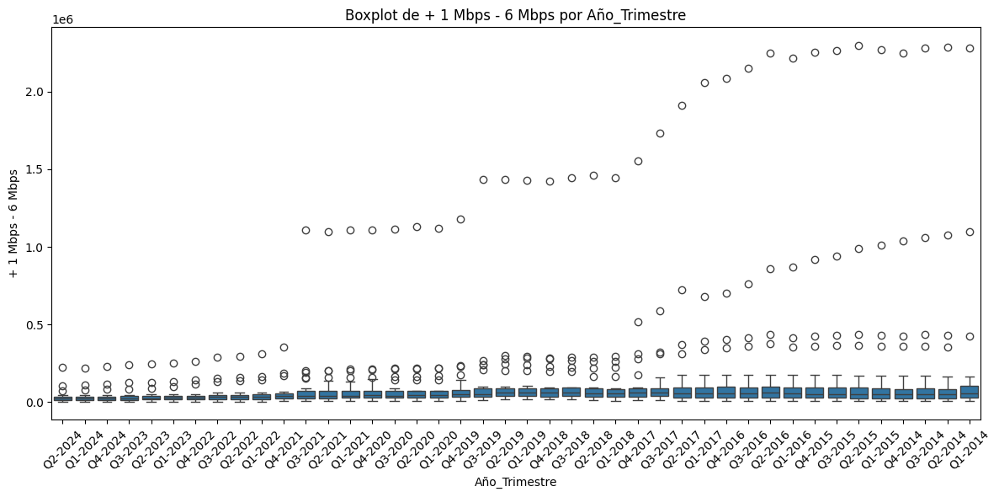


Estadísticas descriptivas de '+ 6 Mbps - 10 Mbps' agrupadas por 'Año_Trimestre':
               count          mean           std     min       25%      50%  \
Año_Trimestre                                                                 
Q1-2014         16.0  15465.875000  33388.911196     0.0     81.25   1837.0   
Q1-2015         24.0  23817.500000  50756.721630     0.0     80.00   3570.5   
Q1-2016         24.0  31791.625000  67204.617332     0.0    164.00   4714.5   
Q1-2017         24.0  40626.125000  90357.890424     0.0    438.25   5559.5   
Q1-2018         24.0  40706.500000  73933.282039     2.0   1147.00   7094.5   
Q1-2019         24.0  36784.833333  51684.907613   266.0   3971.75  14251.0   
Q1-2020         24.0  42583.916667  62582.500648  1594.0   5232.25  12621.0   
Q1-2021         24.0  44696.750000  63591.872234   858.0   7790.25  19347.0   
Q1-2022         24.0  50381.166667  73983.238457  3837.0  11811.00  21748.0   
Q1-2023         24.0  44180.041667  61192.163589 

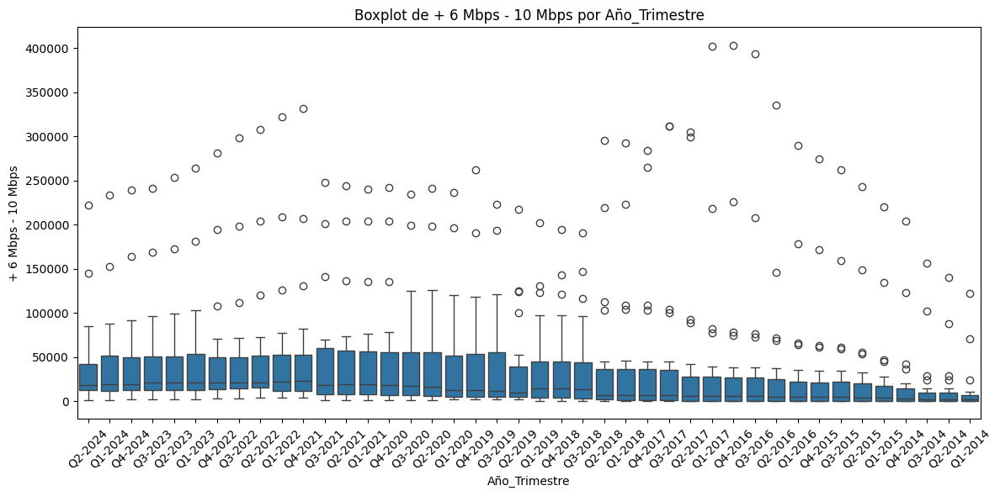


Estadísticas descriptivas de '+ 10 Mbps - 20 Mbps' agrupadas por 'Año_Trimestre':
               count          mean            std     min       25%      50%  \
Año_Trimestre                                                                  
Q1-2014         16.0   5843.437500   13105.748480     0.0     50.75    685.5   
Q1-2015         24.0  14504.250000   33991.229789     0.0     14.50   1723.5   
Q1-2016         24.0  26735.250000   62202.887956     0.0     69.25   3576.0   
Q1-2017         24.0  47082.791667  118049.980875     0.0    161.00   5398.0   
Q1-2018         24.0  86170.291667  204144.047079     0.0    873.50  14029.0   
Q1-2019         24.0  61031.166667  135047.459506   345.0   3234.50  11321.0   
Q1-2020         24.0  33936.250000   54650.493040   525.0   5036.75  13523.5   
Q1-2021         24.0  30747.083333   36956.008534  4317.0   7839.75  14218.5   
Q1-2022         24.0  40312.833333   57790.979008  6313.0  12218.75  24384.0   
Q1-2023         24.0  30383.083333   

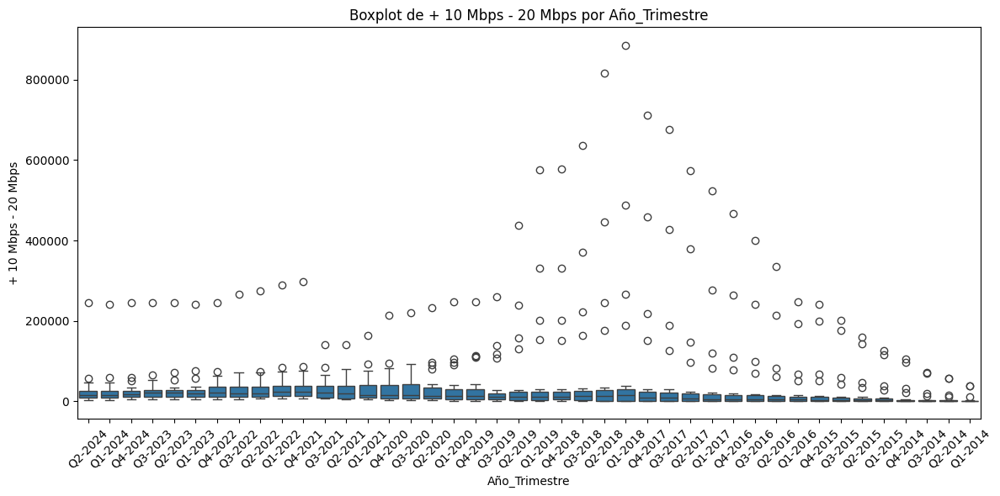


Estadísticas descriptivas de '+ 20 Mbps - 30 Mbps' agrupadas por 'Año_Trimestre':
               count          mean            std    min      25%      50%  \
Año_Trimestre                                                                
Q1-2014         16.0     19.937500      52.173626    0.0     0.00      0.5   
Q1-2015         24.0    318.458333     550.109740    0.0     0.00     11.0   
Q1-2016         24.0   1152.666667    2240.852995    0.0     0.75     98.0   
Q1-2017         24.0   8777.833333   22367.149589    0.0    20.75    451.0   
Q1-2018         24.0  35917.083333  105688.882143    0.0    19.00   1154.5   
Q1-2019         24.0  51842.291667  135983.790070    3.0    63.00   1726.5   
Q1-2020         24.0  22179.541667   45944.113427   22.0   498.75   3029.5   
Q1-2021         24.0  24830.000000   49244.999540  215.0  1089.25   4124.5   
Q1-2022         24.0  21242.916667   35075.360017  576.0  2524.50   8048.5   
Q1-2023         24.0  14907.041667   24844.835235  104.0  2

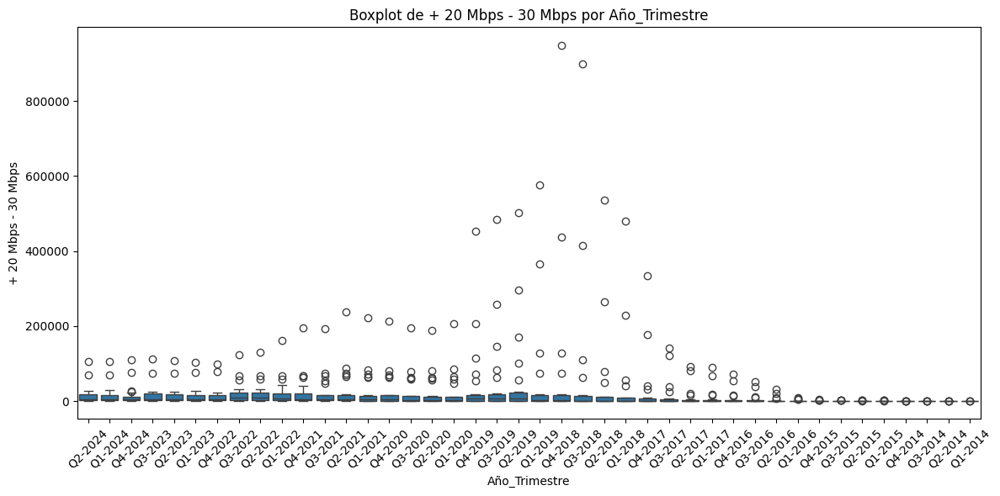


Estadísticas descriptivas de '+ 30 Mbps' agrupadas por 'Año_Trimestre':
               count           mean            std     min       25%      50%  \
Año_Trimestre                                                                   
Q1-2014         16.0     682.812500    1783.726968     0.0      0.00      4.0   
Q1-2015         24.0     681.125000    2015.776327     0.0      0.75      7.5   
Q1-2016         24.0     974.166667    2857.710345     0.0      0.75     14.0   
Q1-2017         24.0    1999.583333    5915.183601     0.0      1.50     22.0   
Q1-2018         24.0   16582.375000   44286.394304     0.0      3.75    572.0   
Q1-2019         24.0   47447.000000  151638.132434     2.0    158.75   1948.0   
Q1-2020         24.0  145870.083333  400536.079728     5.0   1908.25  14883.0   
Q1-2021         24.0  182498.541667  488833.206829    22.0   5022.50  26625.0   
Q1-2022         24.0  264007.791667  712693.529270    13.0  14313.75  44800.5   
Q1-2023         24.0  315200.791667 

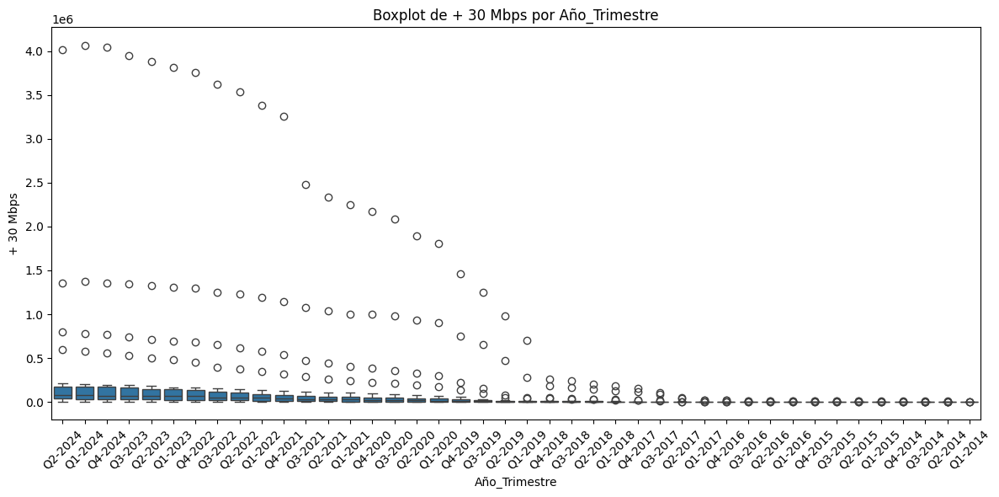


Estadísticas descriptivas de 'OTROS' agrupadas por 'Año_Trimestre':
               count          mean           std    min      25%          50%  \
Año_Trimestre                                                                   
Q1-2014         16.0      0.000000      0.000000    0.0     0.00     0.000000   
Q1-2015         24.0      0.000000      0.000000    0.0     0.00     0.000000   
Q1-2016         24.0      0.000000      0.000000    0.0     0.00     0.000000   
Q1-2017         24.0      0.000000      0.000000    0.0     0.00     0.000000   
Q1-2018         24.0   9857.666667  22086.971339    0.0     0.00  3739.000000   
Q1-2019         24.0   5273.750000   9244.303559    0.0     0.00   629.000000   
Q1-2020         24.0   8092.166667   9561.839520    0.0    75.00  4779.500000   
Q1-2021         24.0   8408.087954   8495.309759   44.0  2616.00  6038.500000   
Q1-2022         24.0   8263.875000   8712.111451    0.0  2084.50  4888.000000   
Q1-2023         24.0  17281.416667  2759

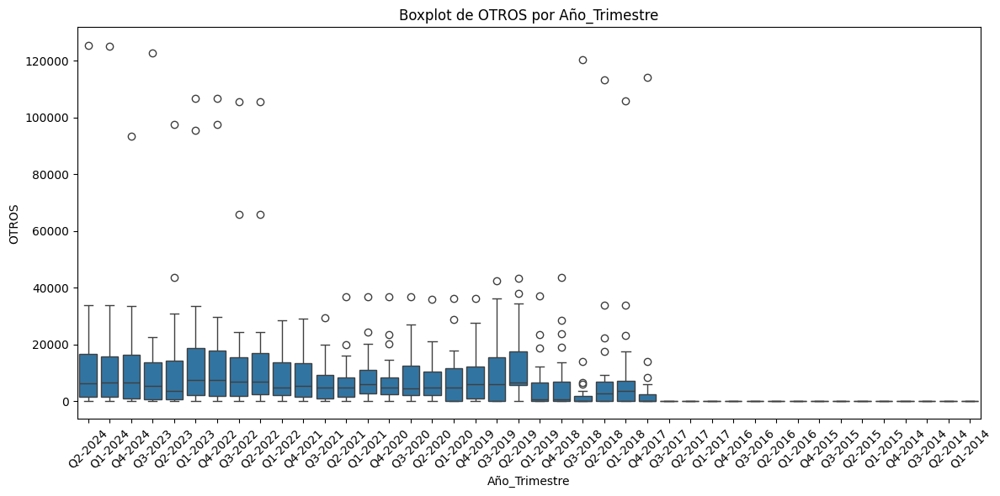


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count           mean           std      min        25%  \
Año_Trimestre                                                           
Q1-2014         16.0  336622.312500  6.915982e+05  15711.0   43330.25   
Q1-2015         24.0  275967.125000  6.015655e+05  12741.0   36861.00   
Q1-2016         24.0  284803.500000  6.204978e+05  13660.0   37121.50   
Q1-2017         24.0  299959.041667  6.752906e+05  14029.0   35402.00   
Q1-2018         24.0  334877.208333  7.349661e+05  21382.0   50279.75   
Q1-2019         24.0  360338.958333  7.841147e+05  25606.0   78004.00   
Q1-2020         24.0  367184.416667  7.790271e+05  37606.0   83824.00   
Q1-2021         24.0  401998.833333  8.444320e+05  40422.0   92395.50   
Q1-2022         24.0  442667.041667  9.394311e+05  49102.0  104343.50   
Q1-2023         24.0  468412.291667  9.954044e+05  50361.0  112819.75   
Q1-2024         24.0  484714.833333  1.035493e+06  6155

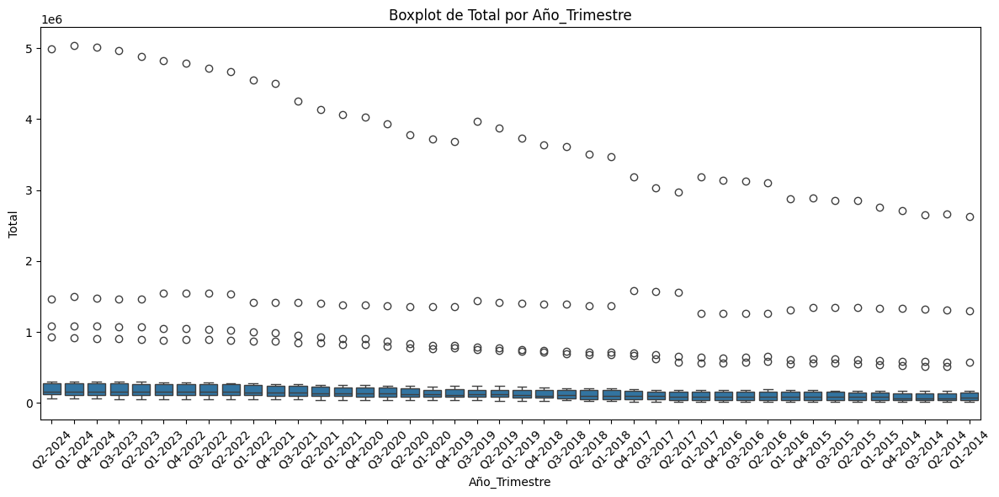


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count      mean       std     min     25%     50%     75%     max
Periodo                                                                       
01-03-2024  1000.0  2018.824  3.058493  2014.0  2016.0  2019.0  2021.0  2024.0


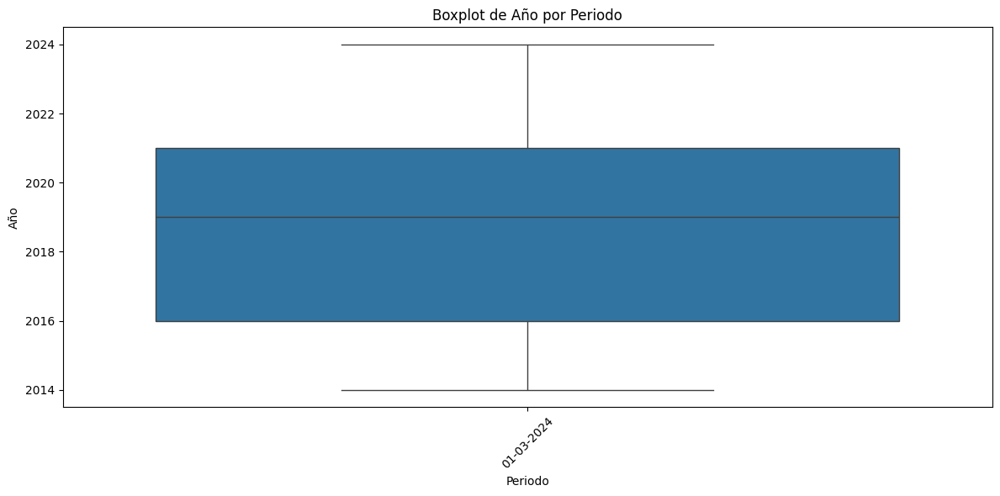


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count   mean       std  min  25%  50%  75%  max
Periodo                                                     
01-03-2024  1000.0  2.464  1.114426  1.0  1.0  2.0  3.0  4.0


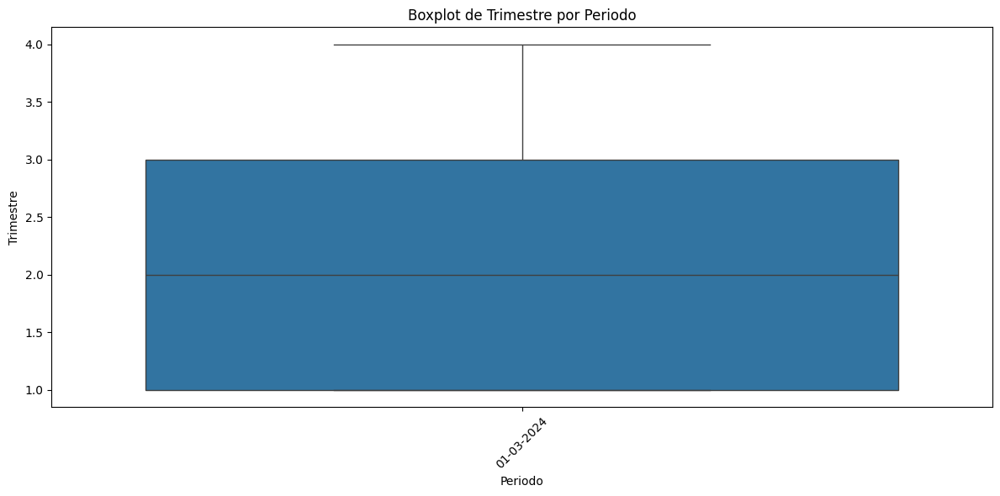


Estadísticas descriptivas de 'HASTA 512 kbps' agrupadas por 'Periodo':
             count      mean           std  min    25%    50%     75%  \
Periodo                                                                 
01-03-2024  1000.0  1953.317  12676.575806  6.0  43.25  107.0  466.25   

                 max  
Periodo               
01-03-2024  238920.0  


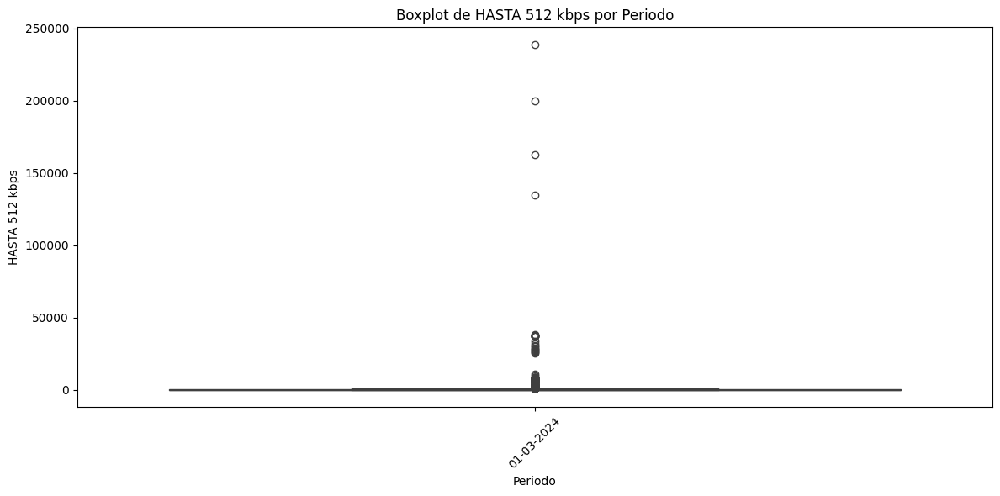


Estadísticas descriptivas de '+ 512 Kbps - 1 Mbps' agrupadas por 'Periodo':
             count      mean           std  min     25%     50%     75%  \
Periodo                                                                   
01-03-2024  1000.0  8864.257  20312.520997  0.0  389.75  2061.0  6851.5   

                  max  
Periodo                
01-03-2024  171244.48  


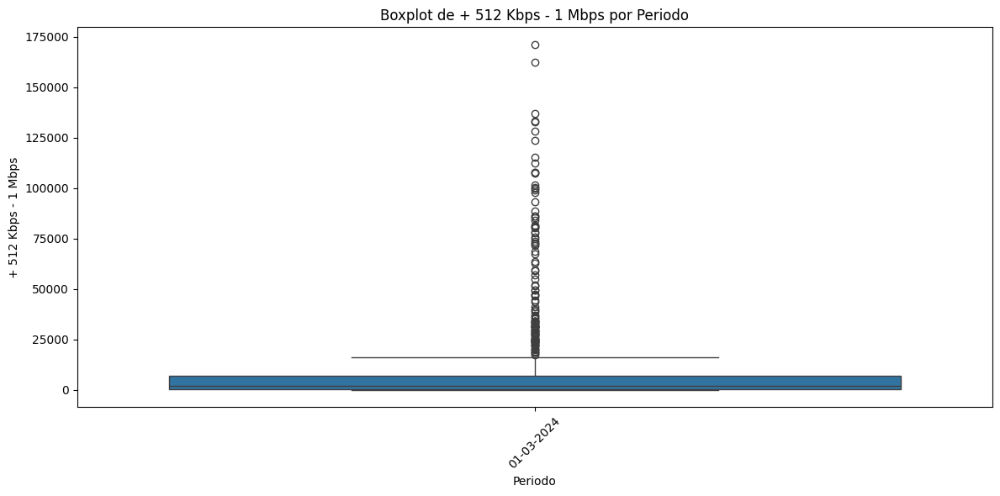


Estadísticas descriptivas de '+ 1 Mbps - 6 Mbps' agrupadas por 'Periodo':
             count        mean            std     min      25%      50%  \
Periodo                                                                   
01-03-2024  1000.0  132772.534  322256.911138  1124.0  23812.5  42132.5   

                 75%         max  
Periodo                           
01-03-2024  83710.25  2299705.32  


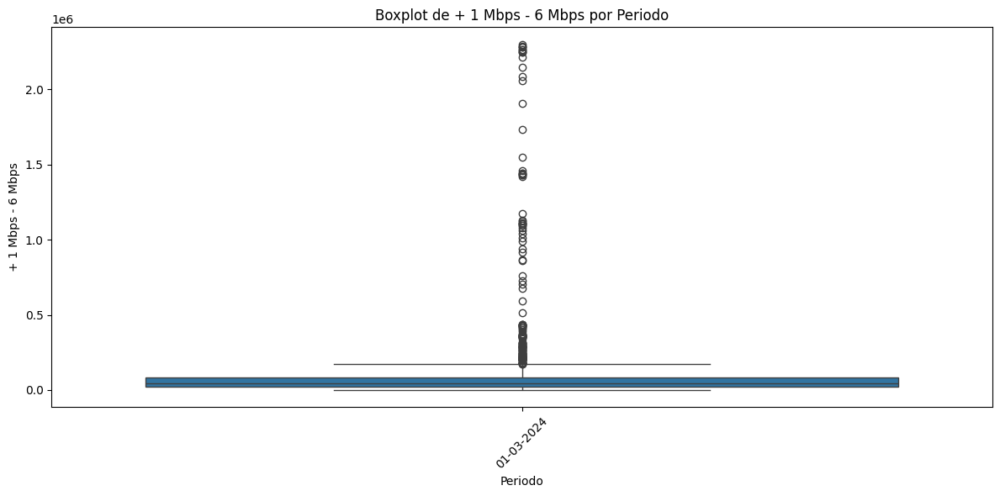


Estadísticas descriptivas de '+ 6 Mbps - 10 Mbps' agrupadas por 'Periodo':
             count      mean           std  min      25%      50%      75%  \
Periodo                                                                      
01-03-2024  1000.0  38408.51  64156.365883  0.0  3876.75  13932.0  42593.5   

                 max  
Periodo               
01-03-2024  403575.0  


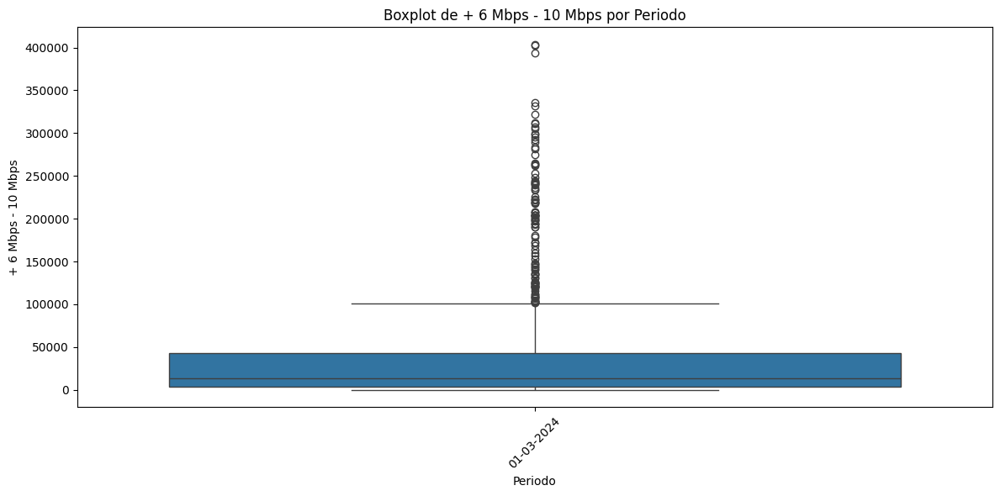


Estadísticas descriptivas de '+ 10 Mbps - 20 Mbps' agrupadas por 'Periodo':
             count       mean           std  min      25%      50%       75%  \
Periodo                                                                        
01-03-2024  1000.0  37138.329  88290.744464  0.0  2706.75  10503.0  26463.75   

                 max  
Periodo               
01-03-2024  886678.0  


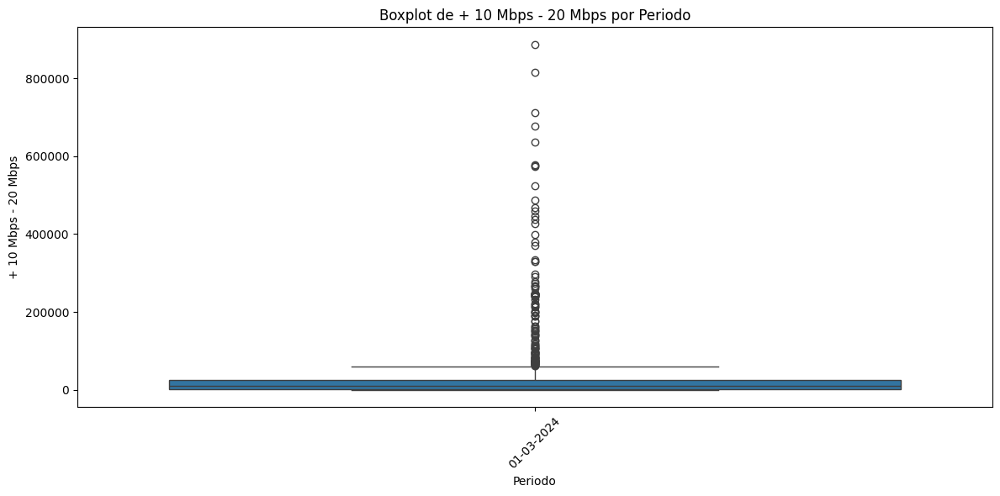


Estadísticas descriptivas de '+ 20 Mbps - 30 Mbps' agrupadas por 'Periodo':
             count      mean           std  min    25%     50%       75%  \
Periodo                                                                    
01-03-2024  1000.0  20091.33  69299.281156  0.0  43.75  1658.0  10109.25   

                 max  
Periodo               
01-03-2024  949093.0  


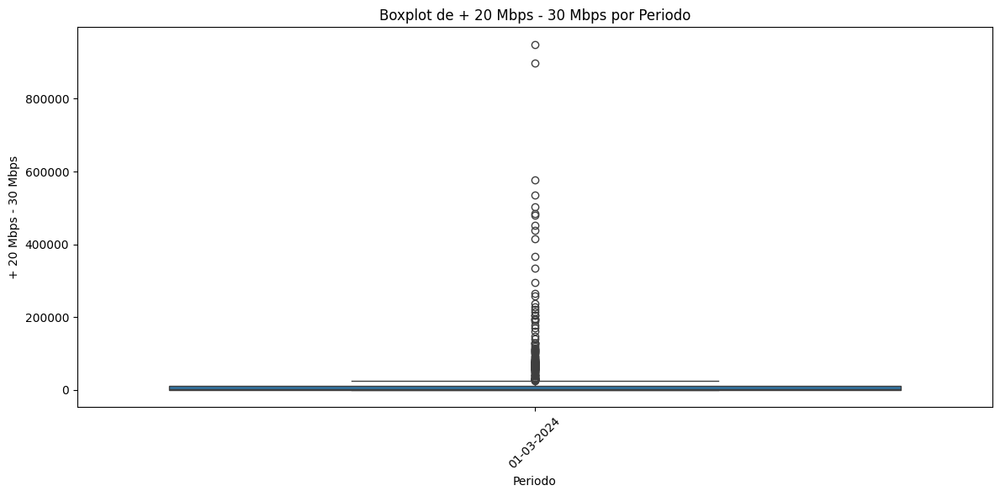


Estadísticas descriptivas de '+ 30 Mbps' agrupadas por 'Periodo':
             count        mean            std  min   25%     50%       75%  \
Periodo                                                                      
01-03-2024  1000.0  122209.765  465749.959124  0.0  15.0  4253.5  43399.25   

                  max  
Periodo                
01-03-2024  4068292.0  


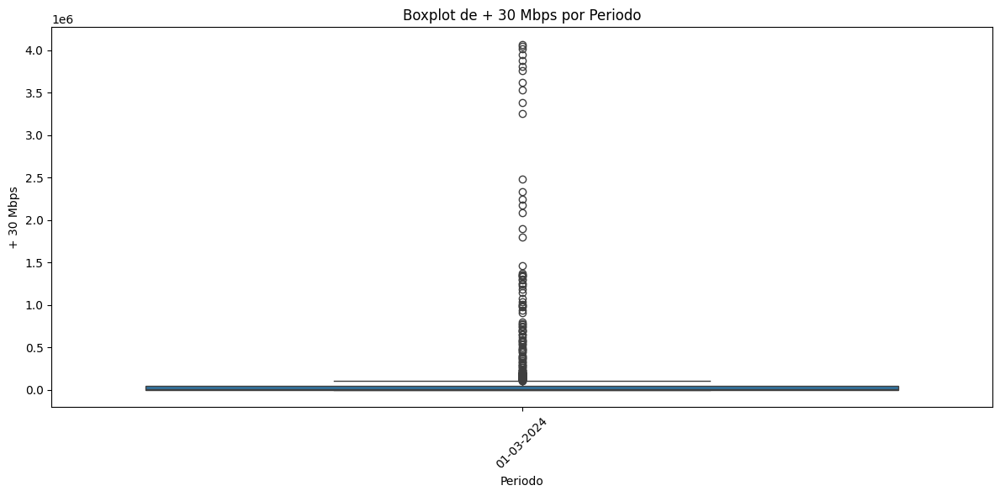


Estadísticas descriptivas de 'OTROS' agrupadas por 'Periodo':
             count         mean           std  min  25%    50%      75%  \
Periodo                                                                   
01-03-2024  1000.0  6525.555444  15294.582991  0.0  0.0  401.5  6800.75   

                 max  
Periodo               
01-03-2024  125547.0  


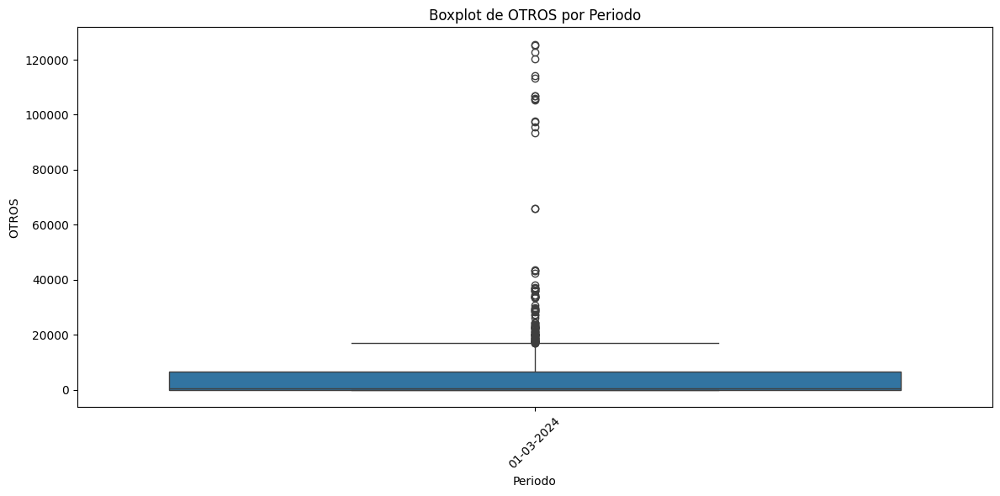


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
             count        mean           std      min       25%       50%  \
Periodo                                                                     
01-03-2024  1000.0  367909.434  789934.81386  12406.0  62342.25  113620.5   

                  75%        max  
Periodo                           
01-03-2024  196919.75  5044557.0  


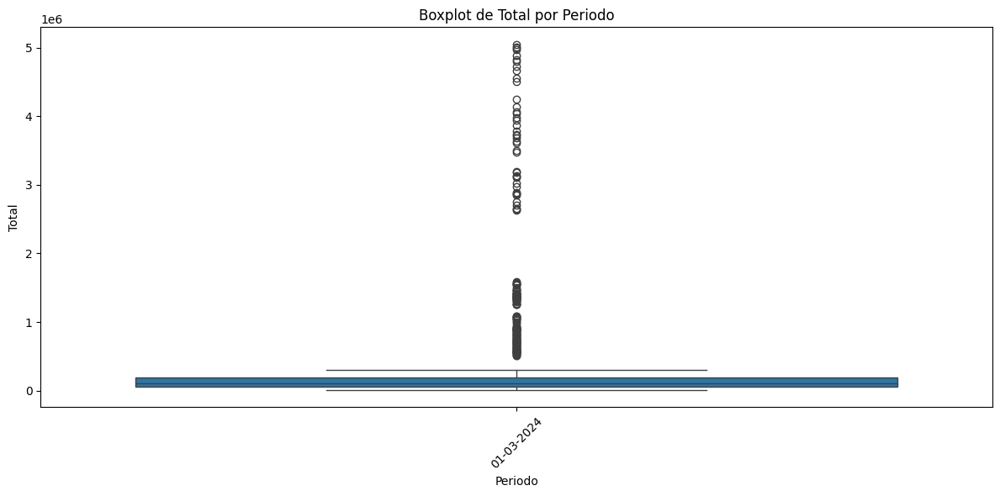


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count        mean       std     min      25%     50%     75%  \
meses_periodo                                                                 
abr - jun      264.0  2019.00000  3.168284  2014.0  2016.00  2019.0  2022.0   
ene - mar      256.0  2019.15625  3.089356  2014.0  2016.75  2019.0  2022.0   
jul - sep      240.0  2018.50000  2.878284  2014.0  2016.00  2018.5  2021.0   
oct - dic      240.0  2018.60000  3.046089  2014.0  2016.00  2018.5  2021.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2024.0  


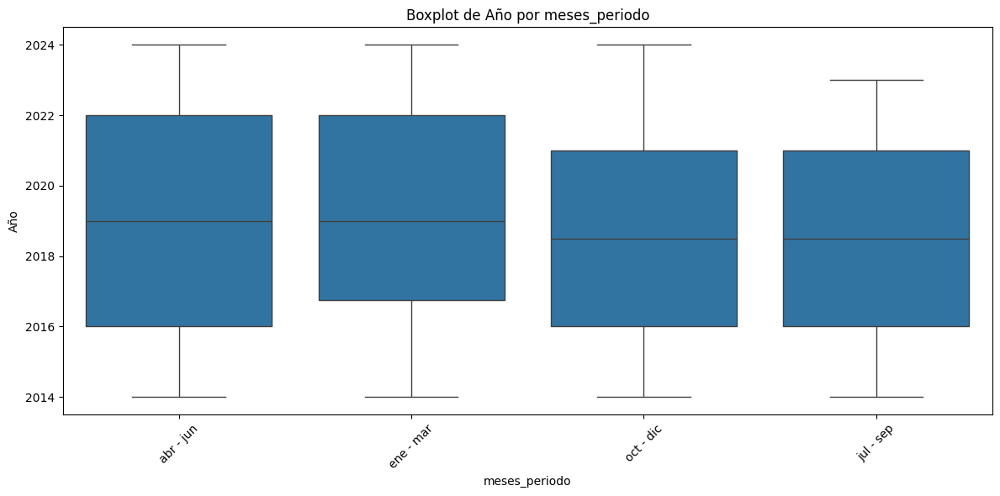


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      264.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      256.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      240.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      240.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


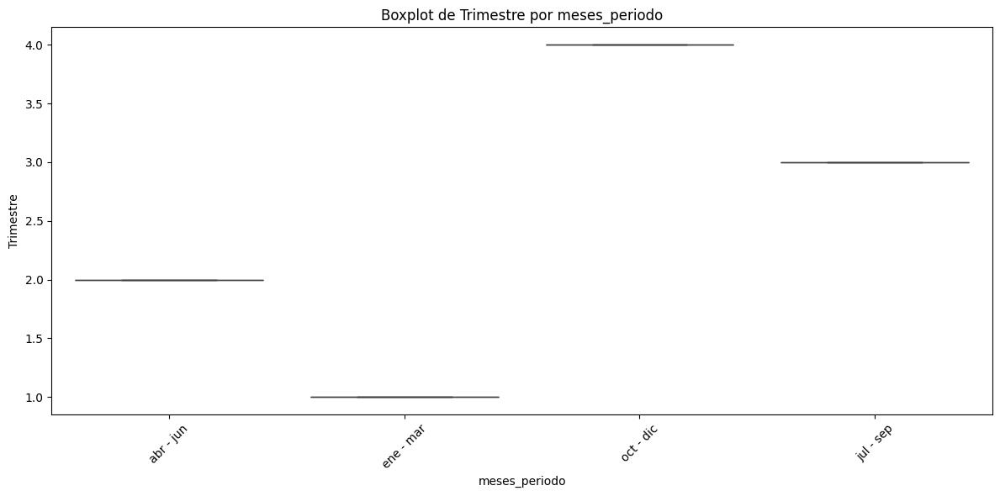


Estadísticas descriptivas de 'HASTA 512 kbps' agrupadas por 'meses_periodo':
               count         mean           std  min    25%    50%     75%  \
meses_periodo                                                                
abr - jun      264.0  2010.522727  13048.001312  6.0  41.00  107.0  462.50   
ene - mar      256.0  1896.523438  11108.488620  6.0  45.50  106.5  468.00   
jul - sep      240.0  2097.804167  15970.394944  6.0  39.00  104.5  442.25   
oct - dic      240.0  1806.483333   9878.498841  6.0  47.75  107.0  467.25   

                    max  
meses_periodo            
abr - jun      199768.0  
ene - mar      162513.0  
jul - sep      238920.0  
oct - dic      134673.0  


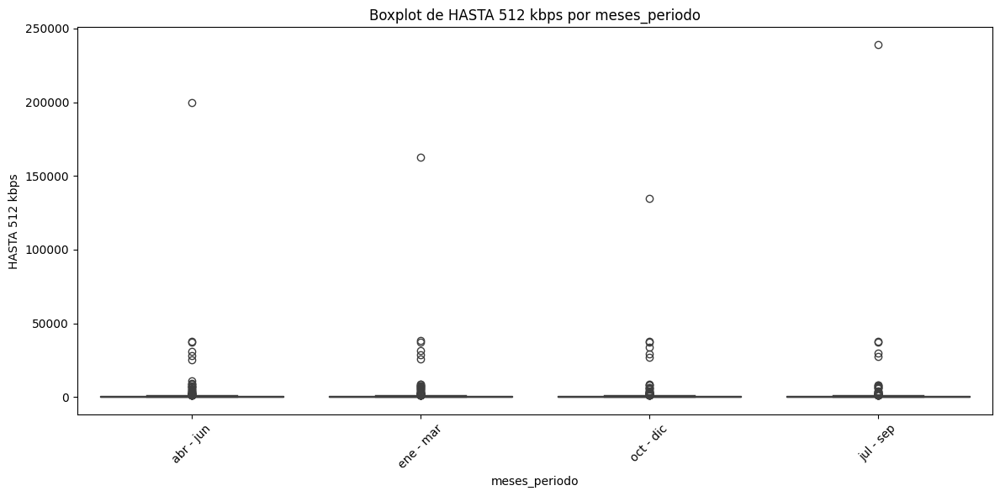


Estadísticas descriptivas de '+ 512 Kbps - 1 Mbps' agrupadas por 'meses_periodo':
               count         mean           std  min     25%     50%      75%  \
meses_periodo                                                                   
abr - jun      264.0  9150.219697  21671.511481  0.0  428.75  2210.5  6935.50   
ene - mar      256.0  9426.253906  21333.638120  0.0  521.50  2856.5  7430.75   
jul - sep      240.0  8917.379167  19851.014921  0.0  345.75  2037.0  6848.50   
oct - dic      240.0  7897.112500  18077.186265  0.0  278.25  1630.0  6219.75   

                     max  
meses_periodo             
abr - jun      162273.72  
ene - mar      171244.48  
jul - sep      128186.72  
oct - dic      132937.20  


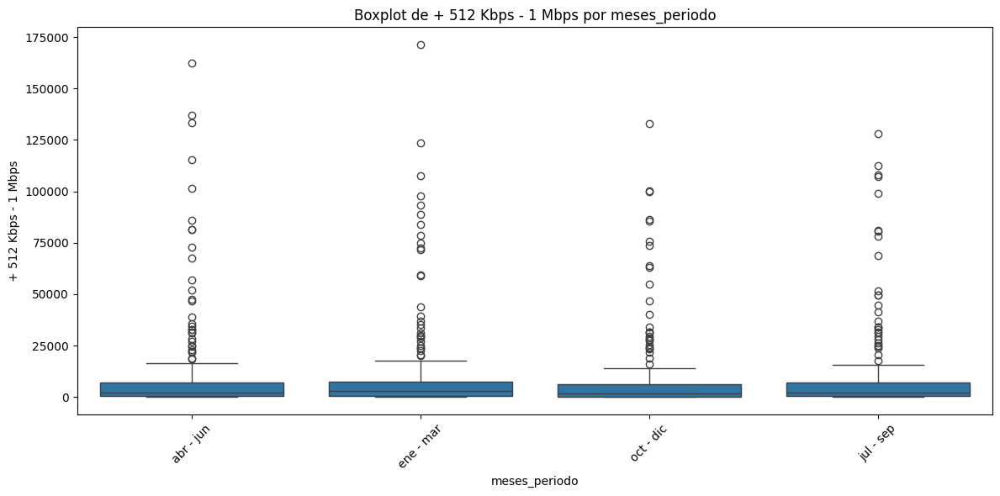


Estadísticas descriptivas de '+ 1 Mbps - 6 Mbps' agrupadas por 'meses_periodo':
               count           mean            std     min       25%      50%  \
meses_periodo                                                                   
abr - jun      264.0  131452.462121  323943.510688  1124.0  23514.50  41722.0   
ene - mar      256.0  133678.042969  329505.513211  1336.0  23252.25  41082.0   
jul - sep      240.0  138021.462500  327340.597213  1617.0  26362.00  43881.0   
oct - dic      240.0  128009.808333  309123.764414  1483.0  24051.75  42132.5   

                    75%         max  
meses_periodo                        
abr - jun      82880.75  2299705.32  
ene - mar      83324.00  2279875.00  
jul - sep      86139.75  2281523.60  
oct - dic      82610.25  2253196.96  


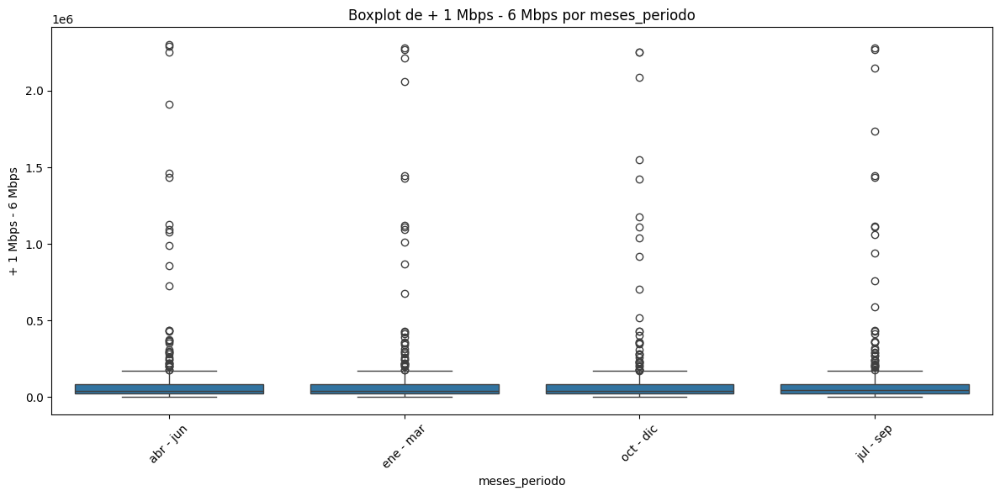


Estadísticas descriptivas de '+ 6 Mbps - 10 Mbps' agrupadas por 'meses_periodo':
               count          mean           std  min      25%      50%  \
meses_periodo                                                             
abr - jun      264.0  37481.083333  62724.529935  0.0  3747.75  14124.5   
ene - mar      256.0  38015.730469  63721.203949  0.0  3783.50  13265.0   
jul - sep      240.0  38527.475000  64557.530539  0.0  3641.25  13215.0   
oct - dic      240.0  39728.679167  66124.720027  0.0  4161.25  13945.5   

                    75%       max  
meses_periodo                      
abr - jun      37766.25  335296.0  
ene - mar      43475.25  402315.0  
jul - sep      43030.75  393530.0  
oct - dic      43202.25  403575.0  


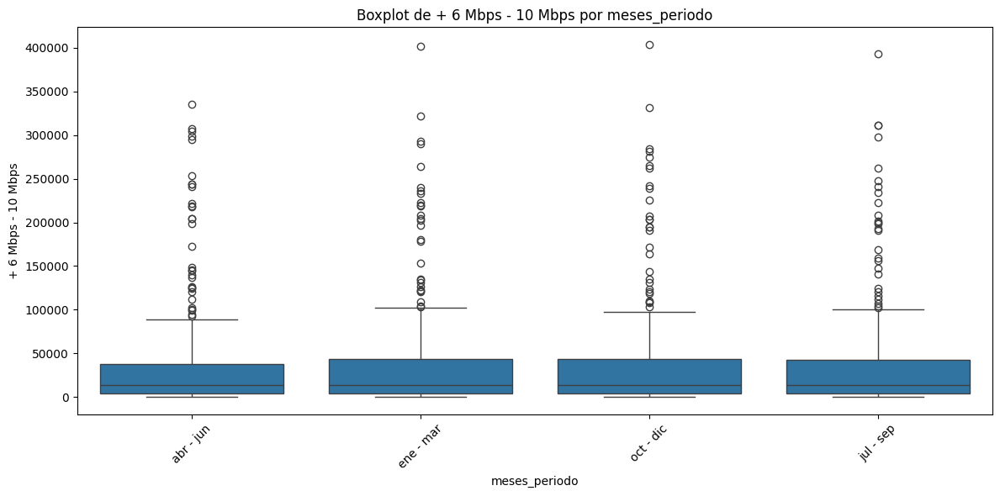


Estadísticas descriptivas de '+ 10 Mbps - 20 Mbps' agrupadas por 'meses_periodo':
               count          mean           std  min      25%      50%  \
meses_periodo                                                             
abr - jun      264.0  36127.473485  87589.296843  0.0  2489.00  10325.0   
ene - mar      256.0  37762.976562  93043.632706  0.0  2747.50  10088.0   
jul - sep      240.0  36250.304167  85006.039802  0.0  2546.50  10104.5   
oct - dic      240.0  38472.004167  87603.695419  0.0  3257.25  11802.0   

                    75%       max  
meses_periodo                      
abr - jun      25860.50  816056.0  
ene - mar      26872.75  886678.0  
jul - sep      25537.75  676137.0  
oct - dic      26927.75  712513.0  


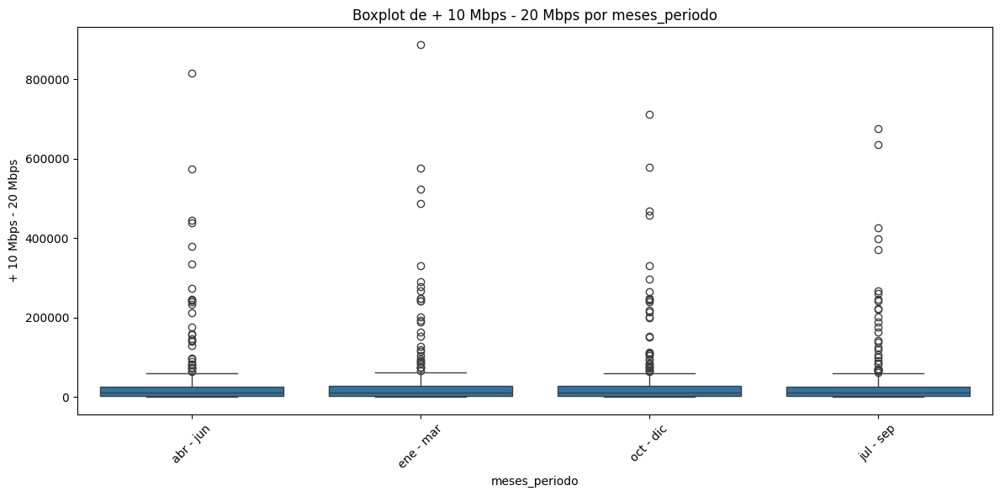


Estadísticas descriptivas de '+ 20 Mbps - 30 Mbps' agrupadas por 'meses_periodo':
               count          mean           std  min    25%     50%  \
meses_periodo                                                          
abr - jun      264.0  18695.636364  57810.836971  0.0  39.25  1616.0   
ene - mar      256.0  18368.136719  59863.343650  0.0  47.75  1588.0   
jul - sep      240.0  21294.000000  77095.105864  0.0  41.00  1596.0   
oct - dic      240.0  22261.995833  81346.113440  0.0  54.00  1814.0   

                    75%       max  
meses_periodo                      
abr - jun      11949.00  536049.0  
ene - mar       9693.25  576859.0  
jul - sep      10562.25  897964.0  
oct - dic       9598.75  949093.0  


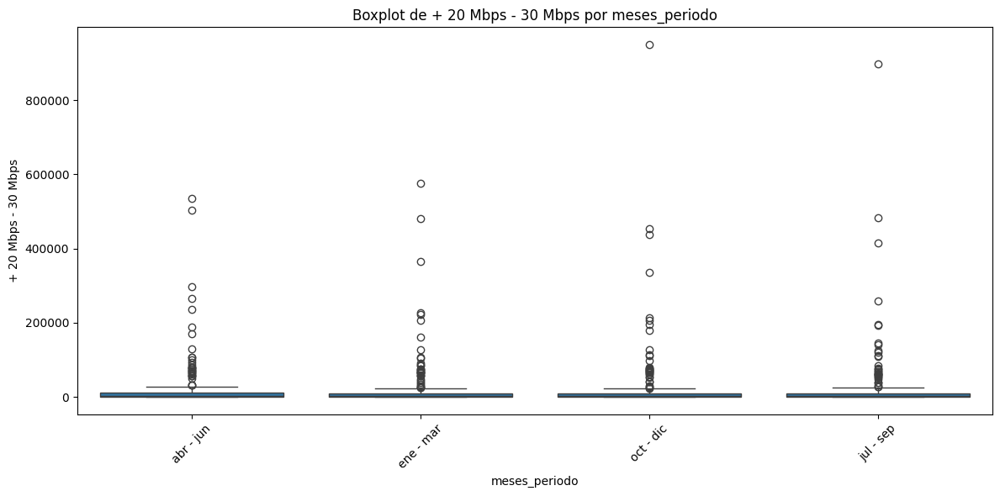


Estadísticas descriptivas de '+ 30 Mbps' agrupadas por 'meses_periodo':
               count           mean            std  min    25%     50%  \
meses_periodo                                                            
abr - jun      264.0  126998.329545  477752.841365  0.0  14.50  4322.5   
ene - mar      256.0  124144.117188  473560.689452  0.0  20.75  3967.0   
jul - sep      240.0  113126.008333  438659.744050  0.0  13.00  3034.0   
oct - dic      240.0  123962.791667  473013.159934  0.0  21.50  4749.5   

                    75%        max  
meses_periodo                       
abr - jun      46241.50  4020395.0  
ene - mar      42754.25  4068292.0  
jul - sep      39010.25  3951660.0  
oct - dic      46750.25  4042646.0  


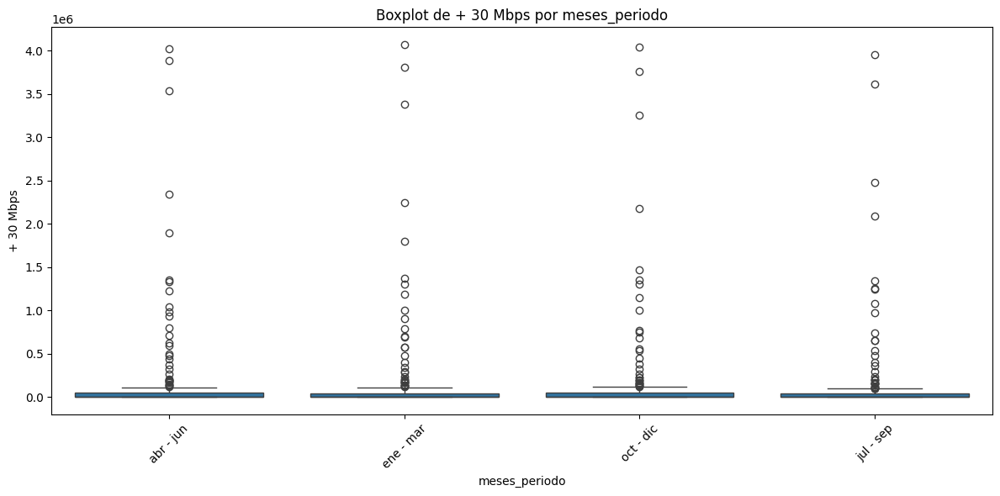


Estadísticas descriptivas de 'OTROS' agrupadas por 'meses_periodo':
               count         mean           std  min  25%    50%      75%  \
meses_periodo                                                               
abr - jun      264.0  7029.868684  15907.716494  0.0  0.0  763.5  6871.50   
ene - mar      256.0  6642.266058  15236.798000  0.0  0.0  574.0  6833.75   
jul - sep      240.0  5797.683333  15054.144591  0.0  0.0    0.0  5710.50   
oct - dic      240.0  6574.191667  14971.897269  0.0  0.0  584.0  7021.25   

                    max  
meses_periodo            
abr - jun      125547.0  
ene - mar      125147.0  
jul - sep      122762.0  
oct - dic      114182.0  


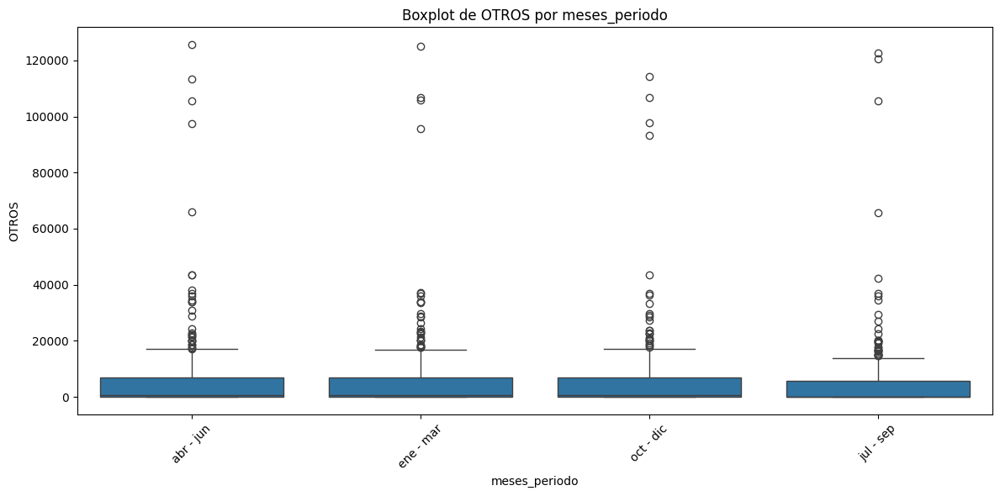


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count           mean            std      min       25%  \
meses_periodo                                                           
abr - jun      264.0  368797.276515  794317.998796  13055.0  62874.25   
ene - mar      256.0  369875.449219  794017.536318  12741.0  62504.00   
jul - sep      240.0  364032.104167  783227.063198  12406.0  60693.50   
oct - dic      240.0  368713.054167  792350.982967  13147.0  62299.00   

                    50%        75%        max  
meses_periodo                                  
abr - jun      114021.0  199812.25  4989380.0  
ene - mar      111440.0  197014.75  5044557.0  
jul - sep      111692.5  188084.00  4968237.0  
oct - dic      114039.5  194785.25  5011620.0  


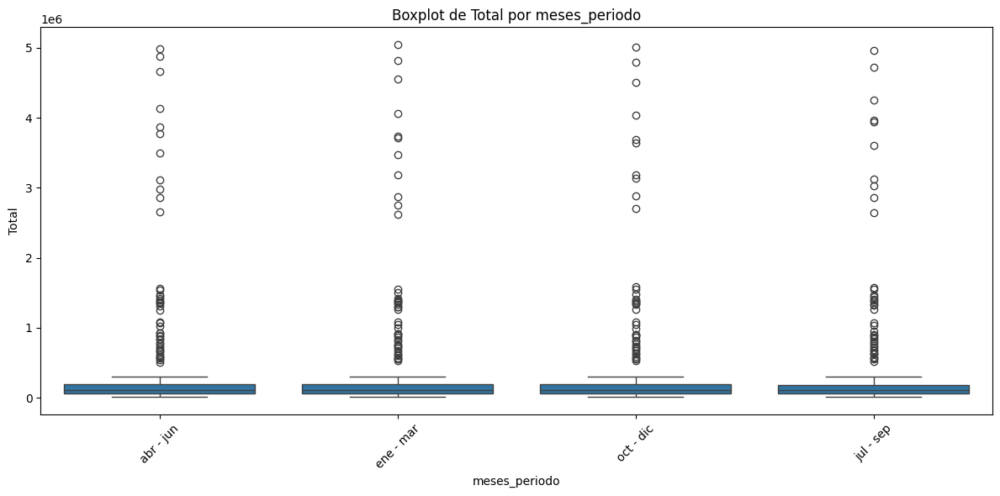

In [49]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [50]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
          Año  Trimestre  HASTA 512 kbps  + 512 Kbps - 1 Mbps  \
0    1.693184  -0.416566        1.841614             0.697936   
1    1.693184  -0.416566       -0.113283            -0.233582   
2    1.693184  -0.416566       -0.148483            -0.428534   
3    1.693184  -0.416566       -0.135539            -0.419422   
4    1.693184  -0.416566       -0.144300            -0.380510   
..        ...        ...             ...                  ...   
995 -1.578037  -1.314338       -0.153377            -0.184868   
996 -1.578037  -1.314338       -0.151403            -0.436317   
997 -1.578037  -1.314338       -0.111152             0.275620   
998 -1.578037  -1.314338        0.172032            -0.387997   
999 -1.578037  -1.314338        0.214415            -0.209151   

     + 1 Mbps - 6 Mbps  + 6 Mbps - 10 Mbps  + 10 Mbps - 20 Mbps  \
0             0.278968            2.857755             2.350115   
1            -0.336029            0.029435      

In [51]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           84
CATAMARCA              42
CHACO                  42
CHUBUT                 42
CÓRDOBA                42
CORRIENTES             42
ENTRE RÍOS             42
FORMOSA                42
JUJUY                  42
LA PAMPA               42
LA RIOJA               42
MENDOZA                42
MISIONES               42
NEUQUÉN                42
RÍO NEGRO              42
SALTA                  41
SAN JUAN               41
SAN LUIS               41
SANTA CRUZ             41
SANTA FE               41
SANTIAGO DEL ESTERO    41
TIERRA DEL FUEGO       41
TUCUMÁN                41
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    24
Q1-2024    24
Q4-2024    24
Q3-2023    24
Q2-2023    24
Q1-2023    24
Q4-2022    24
Q3-2022    24
Q2-2022    24
Q1-2022    24
Q4-2021    24
Q3-2021    24
Q2-2021    24
Q1-2021    24
Q4-2020    24
Q3-2020    24
Q2-2020    24
Q1-2020    2

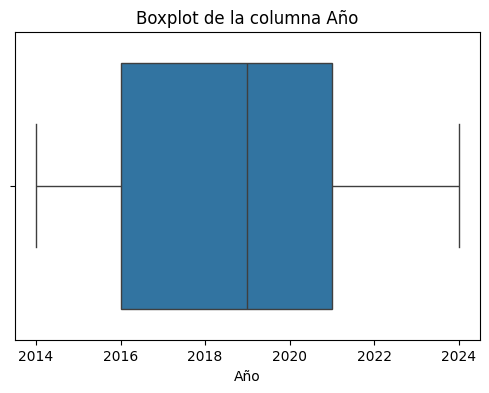

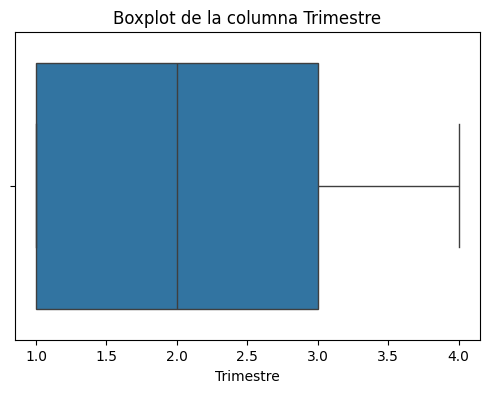

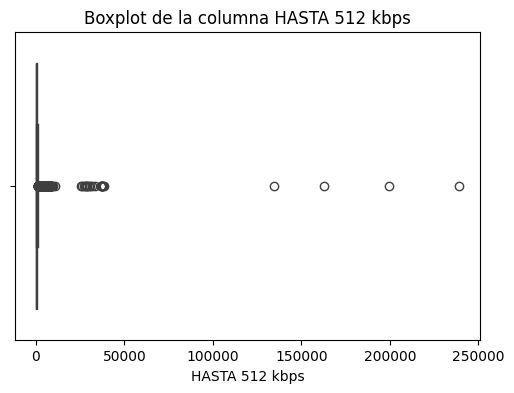

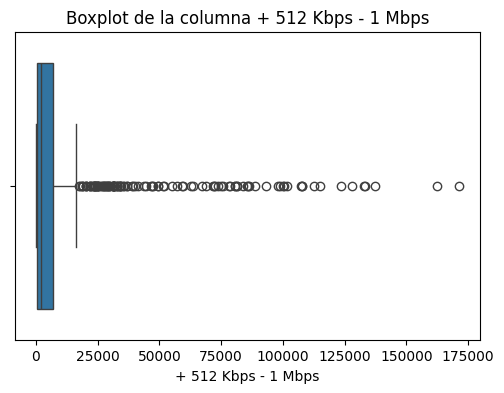

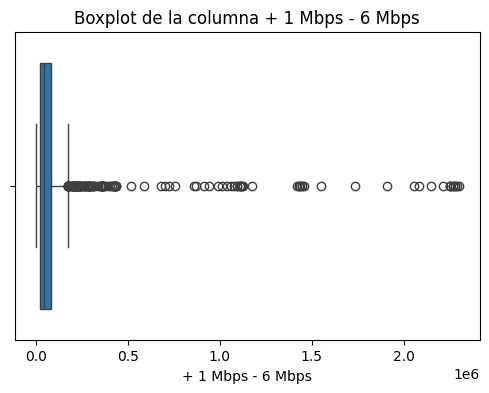

...

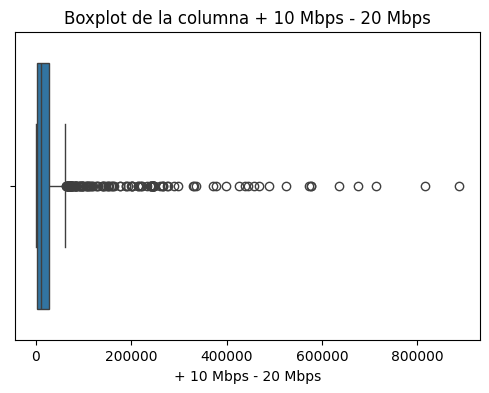

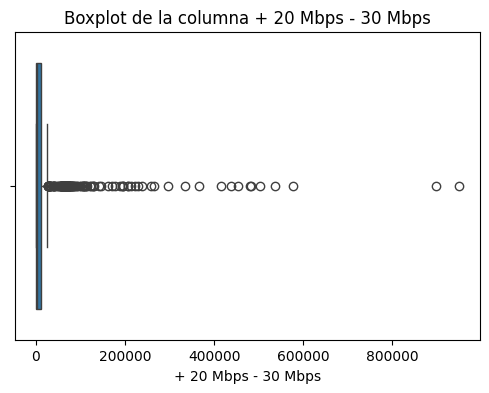

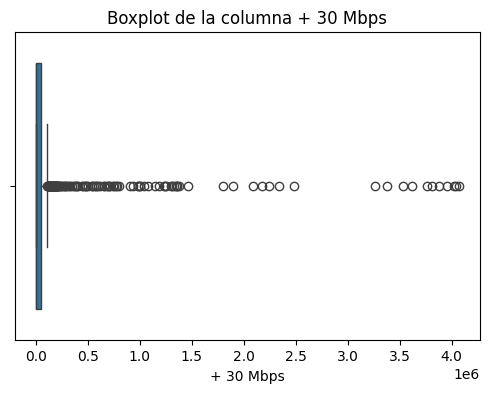

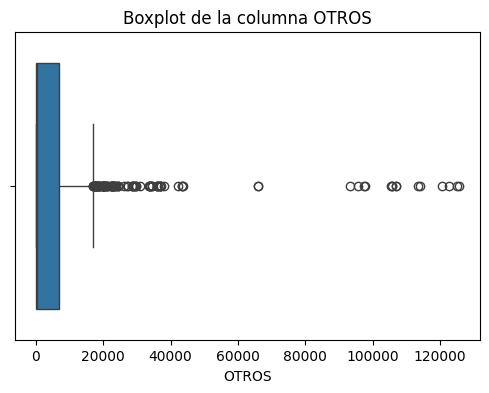

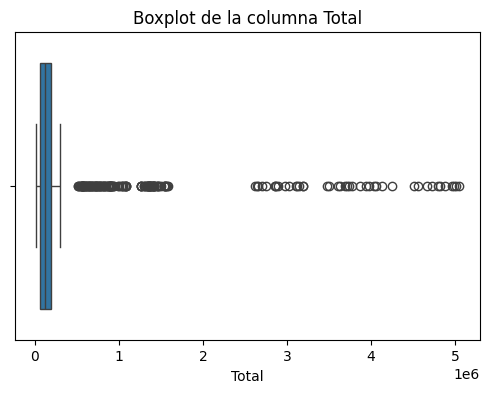

In [52]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [53]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos por rangos.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos por rangos.csv


In [54]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [55]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                     0.049208
Trimestre               0.055832
HASTA 512 kbps         13.835871
+ 512 Kbps - 1 Mbps     4.155821
+ 1 Mbps - 6 Mbps       4.881266
+ 6 Mbps - 10 Mbps      2.757707
+ 10 Mbps - 20 Mbps     4.956438
+ 20 Mbps - 30 Mbps     7.631491
+ 30 Mbps               6.213321
OTROS                   5.020954
Total                   3.880623
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                     -1.155330
Trimestre               -1.348124
HASTA 512 kbps         218.415976
+ 512 Kbps - 1 Mbps     19.680779
+ 1 Mbps - 6 Mbps       25.635111
+ 6 Mbps - 10 Mbps       7.978694
+ 10 Mbps - 20 Mbps     30.424872
+ 20 Mbps - 30 Mbps     75.327419
+ 30 Mbps               42.753053
OTROS                   30.382740
Total                   15.869645
dtype: float64


In [56]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
               Variable           VIF
0                 const  6.154423e+05
1                   Año  1.410564e+00
2             Trimestre  1.020584e+00
3        HASTA 512 kbps  4.454965e+02
4   + 512 Kbps - 1 Mbps  1.142795e+03
5     + 1 Mbps - 6 Mbps  2.852355e+05
6    + 6 Mbps - 10 Mbps  1.132758e+04
7   + 10 Mbps - 20 Mbps  2.143171e+04
8   + 20 Mbps - 30 Mbps  1.318109e+04
9             + 30 Mbps  5.959986e+05
10                OTROS  6.448984e+02
11                Total  1.714489e+06


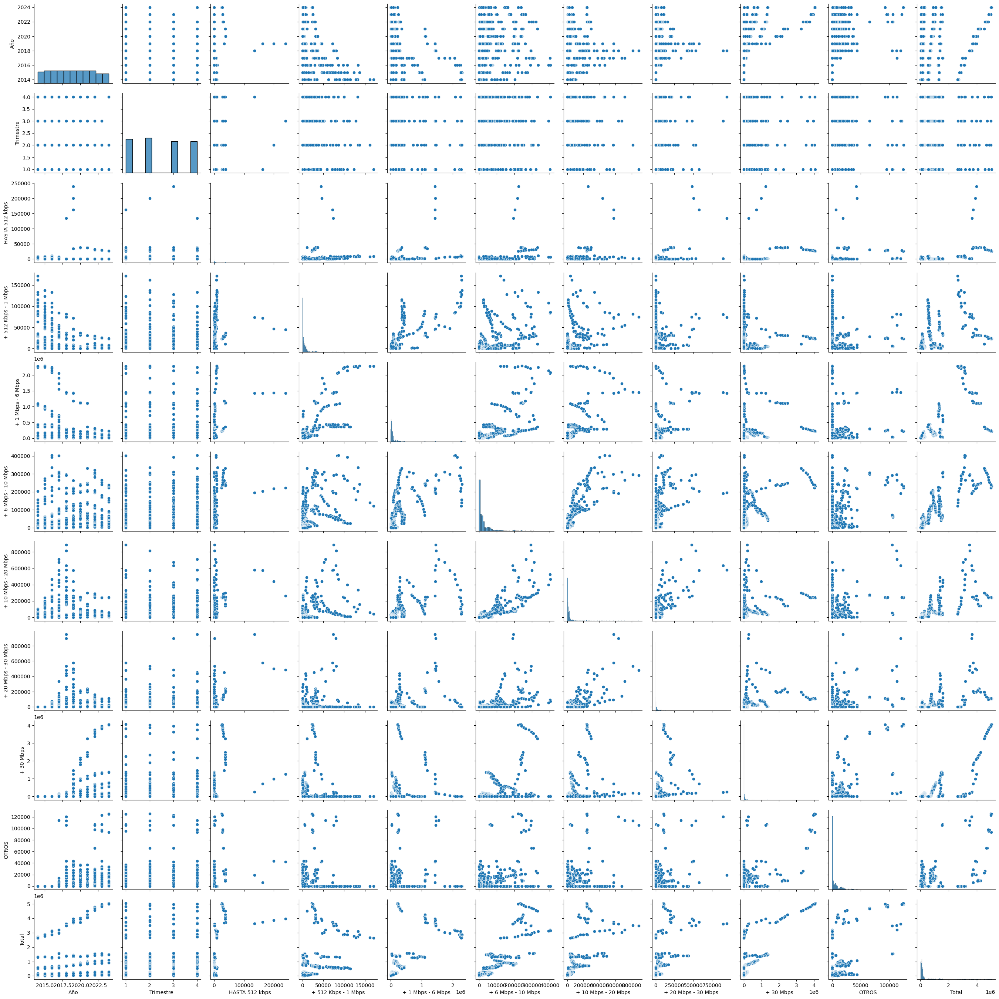

In [57]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [58]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                      Año                                                 \
                    count         mean       std     min     25%     50%   
Provincia                                                                  
BUENOS AIRES         84.0  2018.785714  3.093216  2014.0  2016.0  2019.0   
CATAMARCA            42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CHACO                42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CHUBUT               42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CORRIENTES           42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
CÓRDOBA              42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
ENTRE RÍOS           42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
FORMOSA              42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
JUJUY                42.0  2018.785714  3.112020  2014.0  2016.0  2019.0   
LA PAMPA             42.0  2018.785714  3.112020

In [2]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Acc_vel_loc_sinrangos.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [3]:
print(df.head())

      Provincia     Partido   Localidad link Indec  Velocidad (Mbps)  Accesos
0  BUENOS AIRES  25 de Mayo  25 de Mayo    6854100              0.00      1.0
1  BUENOS AIRES  25 de Mayo  25 de Mayo    6854100              0.50      2.0
2  BUENOS AIRES  25 de Mayo  25 de Mayo    6854100              0.75     19.0
3  BUENOS AIRES  25 de Mayo  25 de Mayo    6854100              3.00     85.0
4  BUENOS AIRES  25 de Mayo  25 de Mayo    6854100              3.50    145.0


In [11]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18857 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None


In [6]:
## Verificar si las columnas "Año" y "Trimestre" existen
#if 'Año' in df.columns and 'Trimestre' in df.columns:
#    # Crear una nueva columna con el formato "Qx-YYYY"
#    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)
#
## Verificar si la columna "Periodo" existe
#if 'Periodo' in df.columns:
#    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
#    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
#    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
#else:
#    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
#    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
#    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2
#
## Asignar la abreviación de los meses según el trimestre
#def obtener_meses_periodo(trimestre):
#    if trimestre == 1:
#        return 'ene - mar'
#    elif trimestre == 2:
#        return 'abr - jun'
#    elif trimestre == 3:
#        return 'jul - sep'
#    elif trimestre == 4:
#        return 'oct - dic'
#    else:
#        return 'N/A'  # Para trimestres no válidos
#
## Aplicar la función para crear la columna "meses_periodo"
#df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)
#
## Mostrar el DataFrame con las nuevas columnas
#print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

In [12]:
print(df.head())

      Provincia     Partido   Localidad link Indec  Velocidad (Mbps)  Accesos
0  BUENOS AIRES  25 DE MAYO  25 DE MAYO    6854100              0.00      1.0
1  BUENOS AIRES  25 DE MAYO  25 DE MAYO    6854100              0.50      2.0
2  BUENOS AIRES  25 DE MAYO  25 DE MAYO    6854100              0.75     19.0
3  BUENOS AIRES  25 DE MAYO  25 DE MAYO    6854100              3.00     85.0
4  BUENOS AIRES  25 DE MAYO  25 DE MAYO    6854100              3.50    145.0


In [14]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)

# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")


Columnas con valores negativos:
Index(['Accesos'], dtype='object')

Valores negativos en la columna 'Accesos': 4


In [15]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [16]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Provincia            0
Partido              0
Localidad            0
link Indec           0
Velocidad (Mbps)     0
Accesos             11
dtype: int64


In [17]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Provincia            0
Partido              0
Localidad            0
link Indec           0
Velocidad (Mbps)     0
Accesos             11
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Provincia            0
Partido              0
Localidad            0
link Indec           0
Velocidad (Mbps)     0
Accesos             11
dtype: int64

Columna 'Accesos' tiene 11 valores nulos (0.06%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_3000\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [19]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Provincia            object
Partido              object
Localidad            object
link Indec           object
Velocidad (Mbps)    float64
Accesos             float64
dtype: object


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18864 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None


In [21]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [22]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CABA' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CORDOBA' 'CORRIENTES'
 'ENTRE RIOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUEN' 'RIO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMAN']

Valores únicos en 'Partido' después de la normalización:
['25 DE MAYO' '9 DE JULIO' 'ADOLFO ALSINA' 'ADOLFO GONZALES CHAVES'
 'ALBERTI' 'ALMIRANTE BROWN' 'AMBA' 'ARRECIFES' 'AVELLANEDA' 'AYACUCHO'
 'AZUL' 'BAHÍA BLANCA' 'BALCARCE' 'BARADERO' 'BENITO JUÁREZ' 'BERAZATEGUI'
 'BERISSO' 'BOLÍVAR' 'BRAGADO' 'BRANDSEN' 'CAMPANA' 'CAÑUELAS'
 'CAPITÁN SARMIENTO' 'CARLOS CASARES' 'CARLOS TEJEDOR' 'CARMEN DE ARECO'
 'CASTELLI' 'CHACABUCO' 'CHASCOMÚS' 'CHIVILCOY' 'COLÓN'
 'CORONEL DE MARINA L. ROSALES' 'CORONEL DORREGO' 'CORONEL PRINGLES'
 'CORONEL SUÁREZ' 'DAIREAUX' 'DOLORES' 'ENSENADA' 'ESCOBAR'
 'ESTEBAN ECHEVERRÍA' 'EXALTACIÓN DE LA CRUZ' 'EZEIZA' 'FLORENCIO 

In [23]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18864 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None


In [24]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

Valores únicos en 'Partido' después de los reemplazos:
['25 DE MAYO' '9 DE JULIO' 'ADOLFO ALSINA' 'ADOLFO GONZALES CHAVES'
 'ALBERTI' 'ALMIRANTE BROWN' 'AMBA' 'ARRECIFES' 'AVELLANEDA' 'AYACUCHO'
 'AZUL' 'BAHÍA BLANCA' 'BALCARCE' 'BARADERO' 'BENITO JUÁREZ' 'BERAZATEGUI'
 'BERISSO' 'BOLÍVAR' 'BRAGADO' 'BRANDSEN' 'CAMPANA' 'CAÑUELAS'
 'CAPITÁN SARMIENTO' 'CARLOS CASARES' 'CARLOS TEJEDOR' 'CARMEN DE ARECO'
 'CASTELLI' 'CHACABUCO' 'CHASCOMÚS' 'CHIVILCOY' 'COLÓN'
 'CORONEL DE MARINA L. ROSALES' 'CORONEL DORREGO' 'CORONEL PRINGLES'
 'CORONEL SUÁREZ' 'DAIREAUX' 'DOLORES' 'ENSENADA' 'ESCOBAR'
 'ESTEBAN ECHEVERRÍA' 'EXALTACIÓN DE LA CRUZ' 'EZEIZA' 'FLORENCIO VARELA'
 'F

In [25]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18864 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None


In [26]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [27]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [28]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [29]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [30]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Provincia           0
Partido             0
Localidad           0
link Indec          0
Velocidad (Mbps)    0
Accesos             0
dtype: int64


In [31]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Provincia           0
Partido             0
Localidad           0
link Indec          0
Velocidad (Mbps)    0
Accesos             0
dtype: int64


In [21]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Provincia            0
Partido              0
Localidad            0
link Indec           0
Velocidad (Mbps)     0
Accesos             11
dtype: int64

Columna 'Accesos' tiene 11 valores nulos (0.06%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_10056\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [32]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18864 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None


In [34]:
# Cambiar el tipo de dato de la columna "link Indec" a numérico entero si es posible
if 'link Indec' in df.columns:
    try:
        # Verificar si todos los valores pueden ser convertidos a enteros
        if df['link Indec'].apply(lambda x: x.isdigit()).all():
            df['link Indec'] = df['link Indec'].astype(int)
            print("Tipo de dato de la columna 'link Indec' cambiado a entero.")
        else:
            print("No todos los valores en la columna 'link Indec' pueden ser convertidos a enteros. Se mantendrá como string.")
    except ValueError as e:
        print(f"Error al convertir la columna 'link Indec' a entero: {e}")
else:
    print("La columna 'link Indec' no existe en el DataFrame.")

No todos los valores en la columna 'link Indec' pueden ser convertidos a enteros. Se mantendrá como string.



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
           Provincia             Partido Localidad link Indec  \
count          18864               18864     18864      18864   
unique            23                 432      2776       2665   
top     BUENOS AIRES  GENERAL SAN MARTÍN     OTROS    6371010   
freq            7227                 460       132        367   
mean             NaN                 NaN       NaN        NaN   
std              NaN                 NaN       NaN        NaN   
min              NaN                 NaN       NaN        NaN   
25%              NaN                 NaN       NaN        NaN   
50%              NaN                 NaN       NaN        NaN   
75%              NaN                 NaN       NaN        NaN   
max              NaN                 NaN       NaN        NaN   

        Velocidad (Mbps)        Accesos  
count       18864.000000   18864.000000  
unique               NaN            NaN  
top                

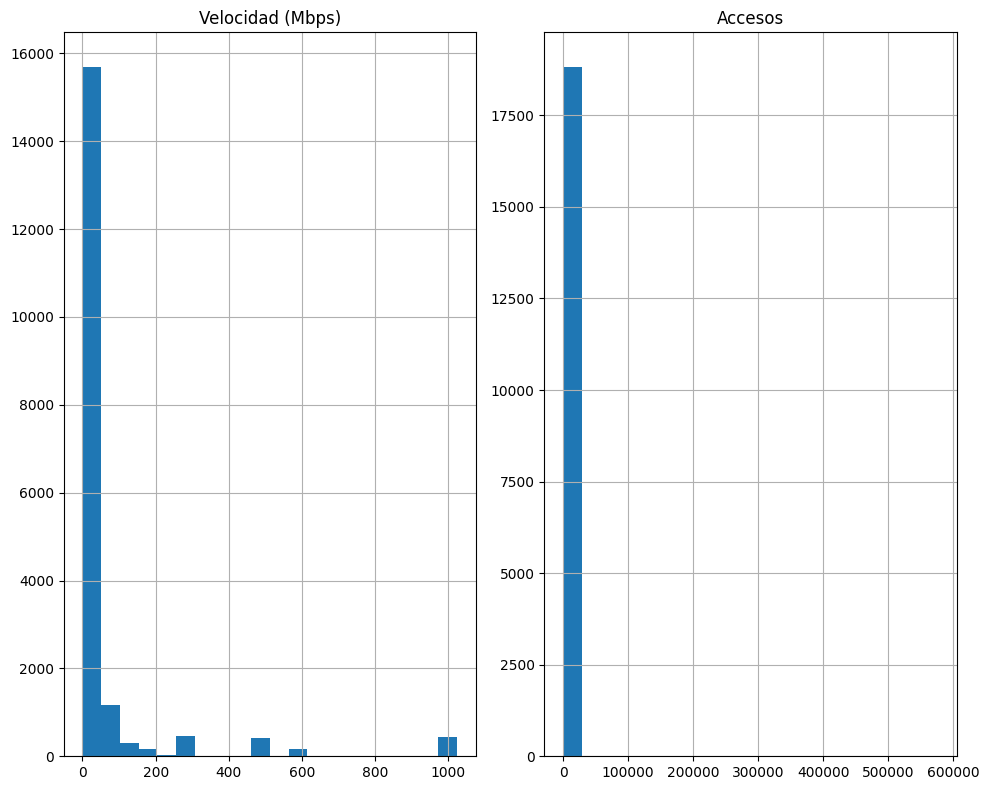

In [35]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()

In [36]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18864 entries, 0 to 18863
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Provincia         18864 non-null  object 
 1   Partido           18864 non-null  object 
 2   Localidad         18864 non-null  object 
 3   link Indec        18864 non-null  object 
 4   Velocidad (Mbps)  18864 non-null  float64
 5   Accesos           18864 non-null  float64
dtypes: float64(2), object(4)
memory usage: 884.4+ KB
None



Correlación entre columnas numéricas:
                  Velocidad (Mbps)  Accesos
Velocidad (Mbps)            1.0000   0.0372
Accesos                     0.0372   1.0000

Correlaciones fuertes:
                  Velocidad (Mbps)  Accesos
Velocidad (Mbps)               1.0      NaN
Accesos                        NaN      1.0


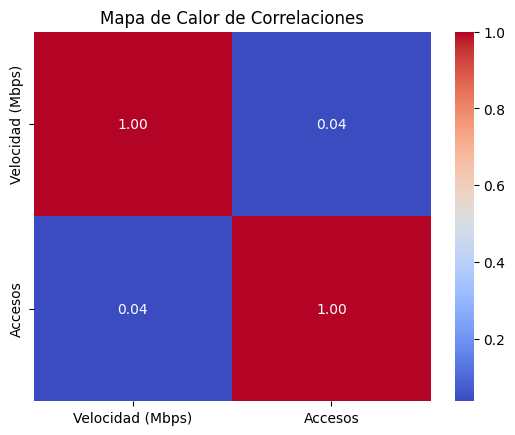

In [37]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Partido:
Partido              12 DE OCTUBRE  1º DE MAYO  2 DE ABRIL  25 DE MAYO  \
Provincia                                                                
BUENOS AIRES                     0           0           0          49   
CATAMARCA                        0           0           0           0   
CHACO                           15          18           7          11   
CHUBUT                           0           0           0           0   
CORRIENTES                       0           0           0           0   
CÓRDOBA                          0           0           0           0   
ENTRE RÍOS                       0           0           0           0   
FORMOSA                          0           0           0           0   
JUJUY                            0           0           0           0   
LA PAMPA                         0           0           0           0   
LA RIOJA                         0           0           0    

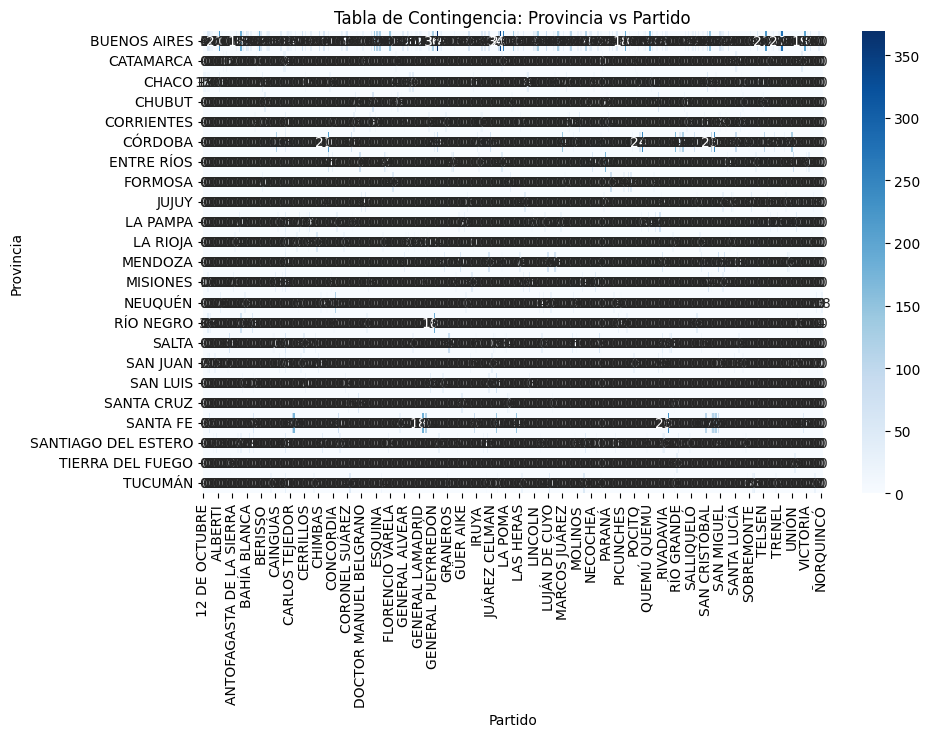


Tabla de contingencia entre Provincia y Localidad:
Localidad            11 DE OCTUBRE  11 DE SEPTIEMBRE  12 DE OCTUBRE  \
Provincia                                                             
BUENOS AIRES                     0                14              1   
CATAMARCA                        0                 0              0   
CHACO                            0                 0              0   
CHUBUT                           0                 0              0   
CORRIENTES                       0                 0              0   
CÓRDOBA                          0                 0              0   
ENTRE RÍOS                       0                 0              0   
FORMOSA                          0                 0              0   
JUJUY                            0                 0              0   
LA PAMPA                         0                 0              0   
LA RIOJA                         0                 0              0   
MENDOZA                  

KeyboardInterrupt: 

: 

: 

In [26]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()

In [ ]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [38]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
       Velocidad (Mbps)   Accesos
0             -0.373590 -0.097476
1             -0.370796 -0.097317
2             -0.369400 -0.094611
3             -0.356829 -0.084104
4             -0.354035 -0.074553
...                 ...       ...
18859          0.185124  0.822317
18860          1.302552  0.629858
18861          2.419981 -0.027274
18862          2.978695 -0.062136
18863          5.213552 -0.091904

[18864 rows x 2 columns]


In [39]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           7227
CÓRDOBA                2211
SANTA FE               1892
ENTRE RÍOS              747
MENDOZA                 706
SALTA                   612
RÍO NEGRO               510
SANTIAGO DEL ESTERO     500
LA PAMPA                474
MISIONES                403
CHACO                   398
TUCUMÁN                 377
NEUQUÉN                 342
CORRIENTES              325
SAN JUAN                311
CHUBUT                  304
FORMOSA                 302
JUJUY                   300
SAN LUIS                247
LA RIOJA                239
CATAMARCA               217
SANTA CRUZ              154
TIERRA DEL FUEGO         66
Name: count, dtype: int64

Conteo de categorías en la columna 'Partido':
Partido
GENERAL SAN MARTÍN     460
CAPITAL                373
LA MATANZA             340
SAN JUSTO              306
COLÓN                  286
                      ... 
LIHUEL CALEL             2
SAN LUIS DEL PALMAR      1


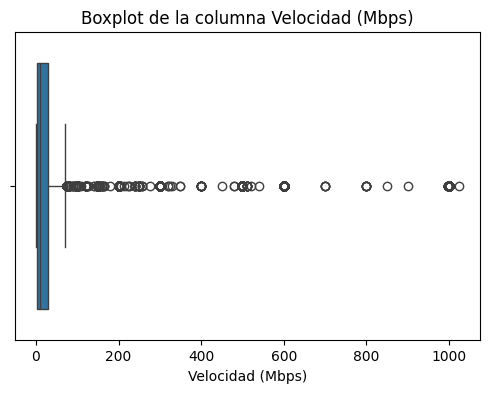

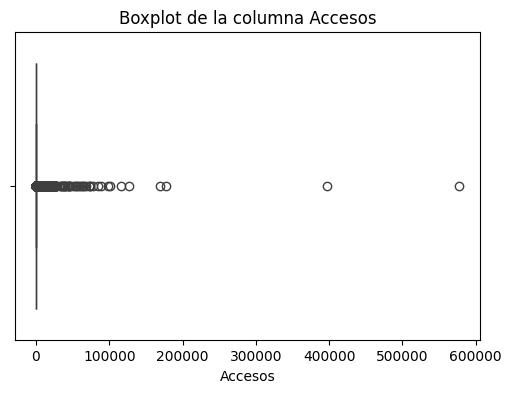

In [40]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [41]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Acc_vel_loc_sinrangos.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Acc_vel_loc_sinrangos.csv


In [33]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [42]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Velocidad (Mbps)     3.956047
Accesos             59.007804
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Velocidad (Mbps)      16.055486
Accesos             4684.948724
dtype: float64


In [43]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
           Variable       VIF
0             const  1.146591
1  Velocidad (Mbps)  1.001386
2           Accesos  1.001386


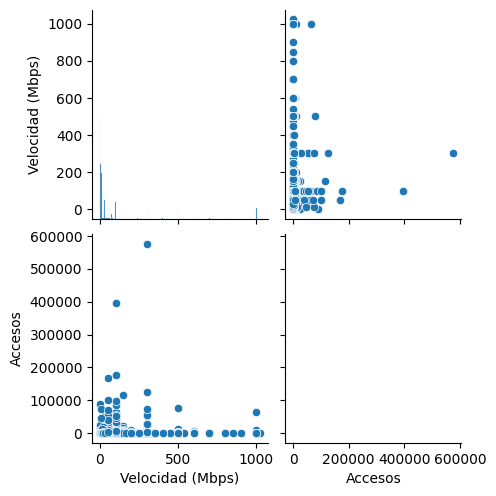

In [44]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [45]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                    Velocidad (Mbps)                                       \
                               count        mean         std  min     25%   
Provincia                                                                   
BUENOS AIRES                  7227.0  110.431569  227.484573  0.0  4.0000   
CATAMARCA                      217.0   46.487097  132.032862  0.0  0.5120   
CHACO                          398.0   33.826693  119.344626  0.0  3.0000   
CHUBUT                         304.0   24.765961   97.345295  0.0  0.7500   
CORRIENTES                     325.0   28.174043  100.540561  0.0  1.0000   
CÓRDOBA                       2211.0   42.279112  137.712804  0.0  3.0000   
ENTRE RÍOS                     747.0   33.932182  125.458176  0.0  3.0000   
FORMOSA                        302.0   13.814079   66.801800  0.0  3.0000   
JUJUY                          300.0   26.930880   95.813400  0.0  3.0000   
LA PAMPA                       474.0

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Totales Accesos por rango.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre  Hasta 512 kbps  Entre 512 Kbps y 1 Mbps  \
0  2024          2           28151                    67024   
1  2024          1           28801                    69355   
2  2023          4           29708                    71742   
3  2023          3           30274                    80609   
4  2023          2           30827                    79405   

   Entre 1 Mbps y 6 Mbps  Entre 6 Mbps y 10 Mbps  Entre 10 Mbps y 20 Mbps  \
0                 840200                  911374                   662649   
1                 866152                  950930                   672155   
2                 900253                  978108                   697232   
3                 945608                  998725                   720084   
4                 963510                 1028250                   734125   

   Entre 20 Mbps y 30 Mbps  Más de 30 Mbps   OTROS     Total  
0                   348253         8357088  341368  11556107  
1                   353896      

In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   Año                      42 non-null     int64
 1   Trimestre                42 non-null     int64
 2   Hasta 512 kbps           42 non-null     int64
 3   Entre 512 Kbps y 1 Mbps  42 non-null     int64
 4   Entre 1 Mbps y 6 Mbps    42 non-null     int64
 5   Entre 6 Mbps y 10 Mbps   42 non-null     int64
 6   Entre 10 Mbps y 20 Mbps  42 non-null     int64
 7   Entre 20 Mbps y 30 Mbps  42 non-null     int64
 8   Más de 30 Mbps           42 non-null     int64
 9   OTROS                    42 non-null     int64
 10  Total                    42 non-null     int64
dtypes: int64(11)
memory usage: 3.7 KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

     Año  Trimestre Año_Trimestre meses_periodo
0   2024          2       Q2-2024     abr - jun
1   2024          1       Q1-2024     ene - mar
2   2023          4       Q4-2023     oct - dic
3   2023          3       Q3-2023     jul - sep
4   2023          2       Q2-2023     abr - jun
5   2023          1       Q1-2023     ene - mar
6   2022          4       Q4-2022     oct - dic
7   2022          3       Q3-2022     jul - sep
8   2022          2       Q2-2022     abr - jun
9   2022          1       Q1-2022     ene - mar
10  2021          4       Q4-2021     oct - dic
11  2021          3       Q3-2021     jul - sep
12  2021          2       Q2-2021     abr - jun
13  2021          1       Q1-2021     ene - mar
14  2020          4       Q4-2020     oct - dic
15  2020          3       Q3-2020     jul - sep
16  2020          2       Q2-2020     abr - jun
17  2020          1       Q1-2020     ene - mar
18  2019          4       Q4-2019     oct - dic
19  2019          3       Q3-2019     ju

In [5]:
print(df.head())

    Año  Trimestre  Hasta 512 kbps  Entre 512 Kbps y 1 Mbps  \
0  2024          2           28151                    67024   
1  2024          1           28801                    69355   
2  2023          4           29708                    71742   
3  2023          3           30274                    80609   
4  2023          2           30827                    79405   

   Entre 1 Mbps y 6 Mbps  Entre 6 Mbps y 10 Mbps  Entre 10 Mbps y 20 Mbps  \
0                 840200                  911374                   662649   
1                 866152                  950930                   672155   
2                 900253                  978108                   697232   
3                 945608                  998725                   720084   
4                 963510                 1028250                   734125   

   Entre 20 Mbps y 30 Mbps  Más de 30 Mbps   OTROS     Total Año_Trimestre  \
0                   348253         8357088  341368  11556107       Q2-2024   
1 

In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                         int64
Trimestre                   int64
Hasta 512 kbps              int64
Entre 512 Kbps y 1 Mbps     int64
Entre 1 Mbps y 6 Mbps       int64
Entre 6 Mbps y 10 Mbps      int64
Entre 10 Mbps y 20 Mbps     int64
Entre 20 Mbps y 30 Mbps     int64
Más de 30 Mbps              int64
OTROS                       int64
Total                       int64
Año_Trimestre              object
Periodo                    object
meses_periodo              object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Año                      42 non-null     int64 
 1   Trimestre                42 non-null     int64 
 2   Hasta 512 kbps           42 non-null     int64 
 3   Entre 512 Kbps y 1 Mbps  42 non-null     int64 
 4   Entre 1 Mbps y 6 Mbps    42 non-null     int64 
 5   Entre 6 Mbps y 10 Mbps   42 non-null     int64 
 6   Entre 10 Mbps y 20 Mbps  42 non-null     int64 
 7   Entre 20 Mbps y 30 Mbps  42 non-null     int64 
 8   Más de 30 Mbps           42 non-null     int64 
 9   OTROS                    42 non-null     int64 
 10  Total                    42 non-null     int64 
 11  Año_Trimestre            42 non-null     object
 12  Periodo                  42 non-null     object
 13  meses_periodo            42 non-null     object
dtypes: int64(11), object(3)
memory usage: 4.7+ K

In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Año                      42 non-null     int64 
 1   Trimestre                42 non-null     int64 
 2   Hasta 512 kbps           42 non-null     int64 
 3   Entre 512 Kbps y 1 Mbps  42 non-null     int64 
 4   Entre 1 Mbps y 6 Mbps    42 non-null     int64 
 5   Entre 6 Mbps y 10 Mbps   42 non-null     int64 
 6   Entre 10 Mbps y 20 Mbps  42 non-null     int64 
 7   Entre 20 Mbps y 30 Mbps  42 non-null     int64 
 8   Más de 30 Mbps           42 non-null     int64 
 9   OTROS                    42 non-null     int64 
 10  Total                    42 non-null     int64 
 11  Año_Trimestre            42 non-null     object
 12  Periodo                  42 non-null     object
 13  meses_periodo            42 non-null     object
dtypes: int64(11), object(3)
memory usage: 4.7+ K

In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


La columna 'Provincia' no existe en el DataFrame.

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Año                      42 non-null     int64 
 1   Trimestre                42 non-null     int64 
 2   Hasta 512 kbps           42 non-null     int64 
 3   Entre 512 Kbps y 1 Mbps  42 non-null     int64 
 4   Entre 1 Mbps y 6 Mbps    42 non-null     int64 
 5   Entre 6 Mbps y 10 Mbps   42 non-null     int64 
 6   Entre 10 Mbps y 20 Mbps  42 non-null     int64 
 7   Entre 20 Mbps y 30 Mbps  42 non-null     int64 
 8   Más de 30 Mbps           42 non-null     int64 
 9   OTROS                    42 non-null     int64 
 10  Total                    42 non-null     int64 
 11  Año_Trimestre            42 non-null     object
 12  Periodo                  42 non-null     object
 13  meses_periodo            42 non-null     object
dtypes: int64(11), object(3)
memory usage: 4.7+ K

In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                        0
Trimestre                  0
Hasta 512 kbps             0
Entre 512 Kbps y 1 Mbps    0
Entre 1 Mbps y 6 Mbps      0
Entre 6 Mbps y 10 Mbps     0
Entre 10 Mbps y 20 Mbps    0
Entre 20 Mbps y 30 Mbps    0
Más de 30 Mbps             0
OTROS                      0
Total                      0
Año_Trimestre              0
Periodo                    0
meses_periodo              0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                        0
Trimestre                  0
Hasta 512 kbps             0
Entre 512 Kbps y 1 Mbps    0
Entre 1 Mbps y 6 Mbps      0
Entre 6 Mbps y 10 Mbps     0
Entre 10 Mbps y 20 Mbps    0
Entre 20 Mbps y 30 Mbps    0
Más de 30 Mbps             0
OTROS                      0
Total                      0
Año_Trimestre              0
Periodo                    0
meses_periodo              0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                        0
Trimestre                  0
Hasta 512 kbps             0
Entre 512 Kbps y 1 Mbps    0
Entre 1 Mbps y 6 Mbps      0
Entre 6 Mbps y 10 Mbps     0
Entre 10 Mbps y 20 Mbps    0
Entre 20 Mbps y 30 Mbps    0
Más de 30 Mbps             0
OTROS                      0
Total                      0
Año_Trimestre              0
Periodo                    0
meses_periodo              0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Año                      42 non-null     int64 
 1   Trimestre                42 non-null     int64 
 2   Hasta 512 kbps           42 non-null     int64 
 3   Entre 512 Kbps y 1 Mbps  42 non-null     int64 
 4   Entre 1 Mbps y 6 Mbps    42 non-null     int64 
 5   Entre 6 Mbps y 10 Mbps   42 non-null     int64 
 6   Entre 10 Mbps y 20 Mbps  42 non-null     int64 
 7   Entre 20 Mbps y 30 Mbps  42 non-null     int64 
 8   Más de 30 Mbps           42 non-null     int64 
 9   OTROS                    42 non-null     int64 
 10  Total                    42 non-null     int64 
 11  Año_Trimestre            42 non-null     object
 12  Periodo                  42 non-null     object
 13  meses_periodo            42 non-null     object
dtypes: int64(11), object(3)
memory usage: 4.7+ K


Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año  Trimestre  Hasta 512 kbps  Entre 512 Kbps y 1 Mbps  \
count     42.000000  42.000000       42.000000                42.000000   
unique          NaN        NaN             NaN                      NaN   
top             NaN        NaN             NaN                      NaN   
freq            NaN        NaN             NaN                      NaN   
mean    2018.761905   2.452381    46756.595238            215615.285714   
std        3.074756   1.130560    48922.973593            192134.704593   
min     2014.000000   1.000000     5675.000000             28521.000000   
25%     2016.000000   1.250000    29027.750000             69951.750000   
50%     2019.000000   2.000000    34960.000000            150273.000000   
75%     2021.000000   3.000000    41057.500000            279159.250000   
max     2024.000000   4.000000   241713.000000            687619.000000   

        Entre 1 Mbps y 6 

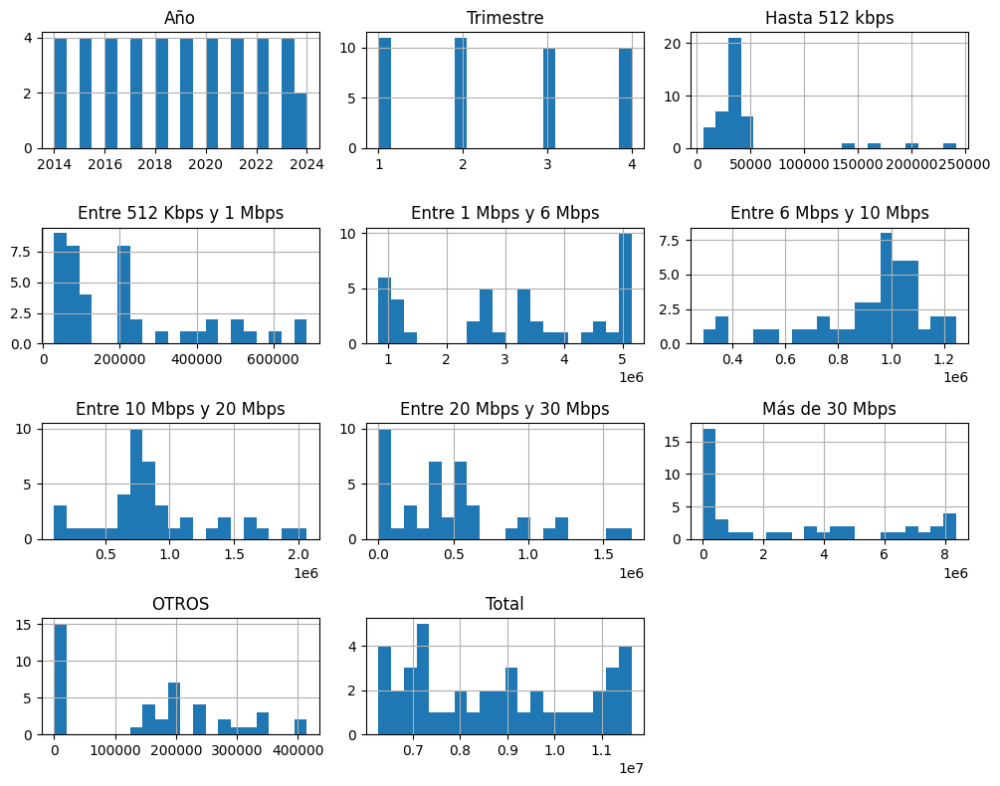

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                              Año  Trimestre  Hasta 512 kbps  \
Año                      1.000000  -0.073505       -0.001661   
Trimestre               -0.073505   1.000000       -0.006068   
Hasta 512 kbps          -0.001661  -0.006068        1.000000   
Entre 512 Kbps y 1 Mbps -0.865975  -0.086527       -0.099703   
Entre 1 Mbps y 6 Mbps   -0.977664  -0.008860        0.047988   
Entre 6 Mbps y 10 Mbps   0.748953   0.108016       -0.043408   
Entre 10 Mbps y 20 Mbps  0.115103   0.032846        0.018232   
Entre 20 Mbps y 30 Mbps  0.309049   0.099801        0.502356   
Más de 30 Mbps           0.941703  -0.002851       -0.095905   
OTROS                    0.893975  -0.010735        0.090413   
Total                    0.986057   0.023592        0.017614   

                         Entre 512 Kbps y 1 Mbps  Entre 1 Mbps y 6 Mbps  \
Año                                    -0.865975              -0.977664   
Trimestre                              -0.

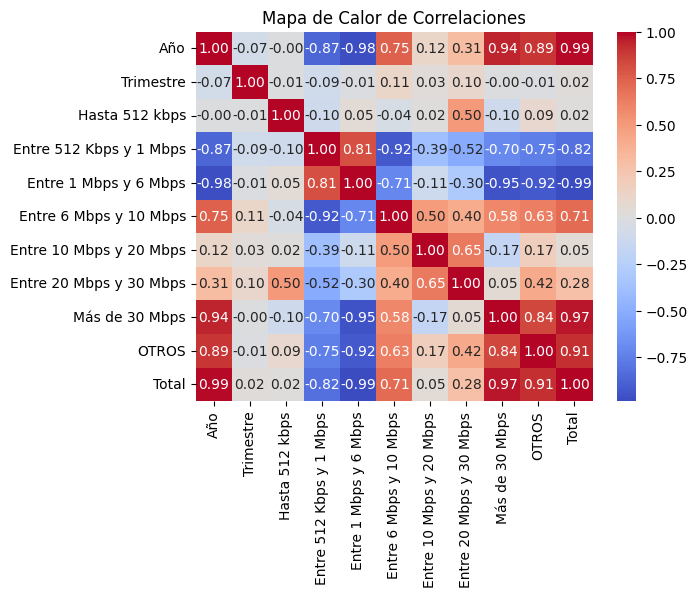

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                 1
Q1-2015                 1
Q1-2016                 1
Q1-2017                 1
Q1-2018                 1
Q1-2019                 1
Q1-2020                 1
Q1-2021                 1
Q1-2022                 1
Q1-2023                 1
Q1-2024                 1
Q2-2014                 1
Q2-2015                 1
Q2-2016                 1
Q2-2017                 1
Q2-2018                 1
Q2-2019                 1
Q2-2020                 1
Q2-2021                 1
Q2-2022                 1
Q2-2023                 1
Q2-2024                 1
Q3-2014                 1
Q3-2015                 1
Q3-2016                 1
Q3-2017                 1
Q3-2018                 1
Q3-2019                 1
Q3-2020                 1
Q3-2021                 1
Q3-2022                 1
Q3-2023                 1
Q4-2014                 1
Q4-2015                 1
Q4-2016   

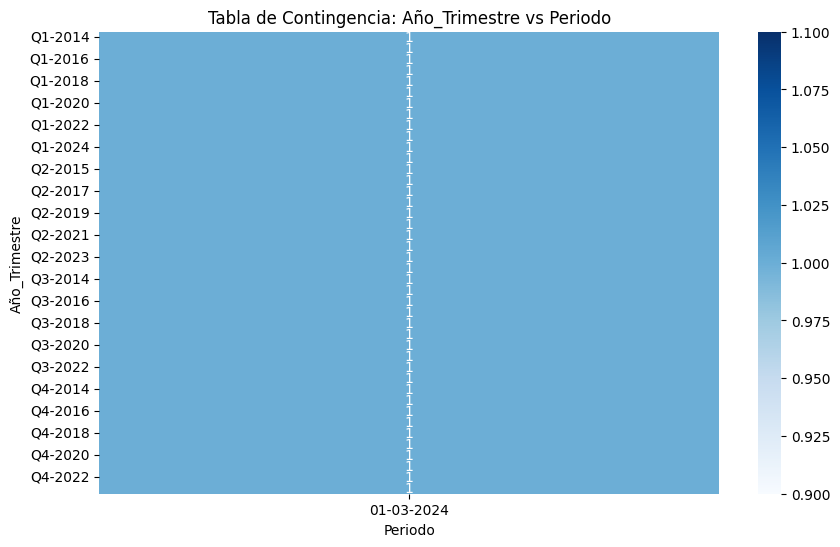


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0          1          0          0
Q1-2015                0          1          0          0
Q1-2016                0          1          0          0
Q1-2017                0          1          0          0
Q1-2018                0          1          0          0
Q1-2019                0          1          0          0
Q1-2020                0          1          0          0
Q1-2021                0          1          0          0
Q1-2022                0          1          0          0
Q1-2023                0          1          0          0
Q1-2024                0          1          0          0
Q2-2014                1          0          0          0
Q2-2015                1          0          0          0
Q2-2016                1          0          0          0
Q2-2017     

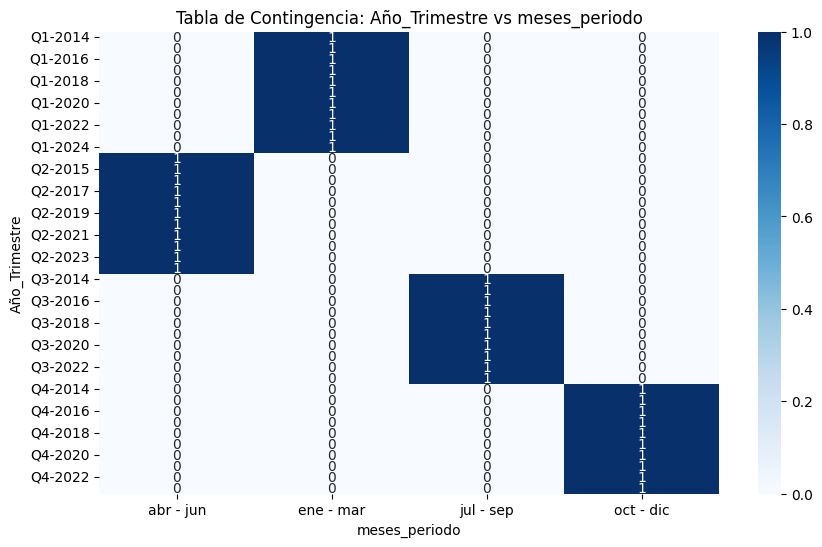


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024            11         11         10         10


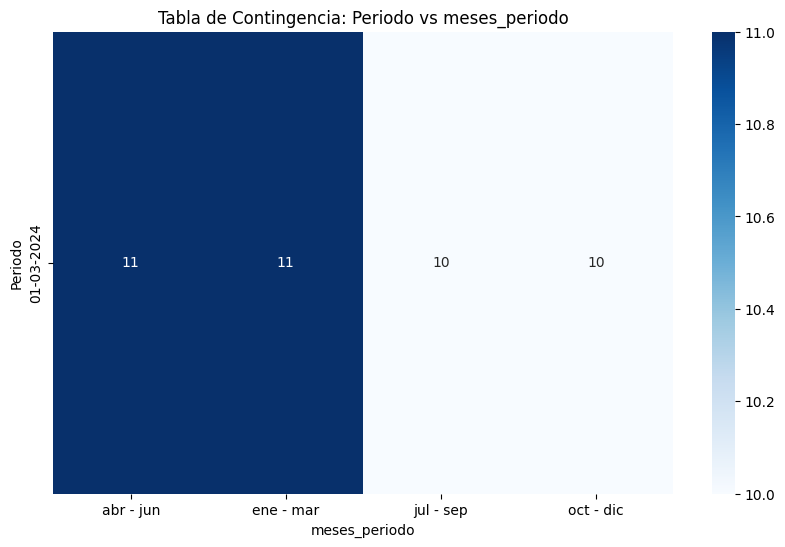

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014          1.0  2014.0  NaN  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015          1.0  2015.0  NaN  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016          1.0  2016.0  NaN  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017          1.0  2017.0  NaN  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018          1.0  2018.0  NaN  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019          1.0  2019.0  NaN  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020          1.0  2020.0  NaN  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021          1.0  2021.0  NaN  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022          1.0  2022.0  NaN  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023          1.0  2023.0  NaN  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024          1.0  2024.0  NaN  2024.0  20

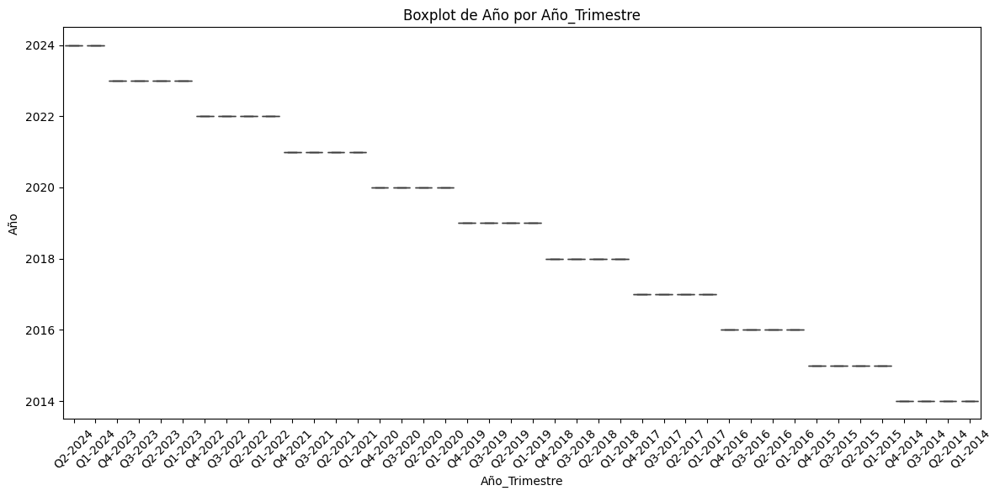


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2015          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2016          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2017          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2018          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2019          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2020          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2021          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2022          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2023          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q1-2024          1.0   1.0  NaN  1.0  1.0  1.0  1.0  1.0
Q2-2014          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2015          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2016          1.0   2.0  NaN  2.0  2.0  2.0  2.0  2.0
Q2-2017        

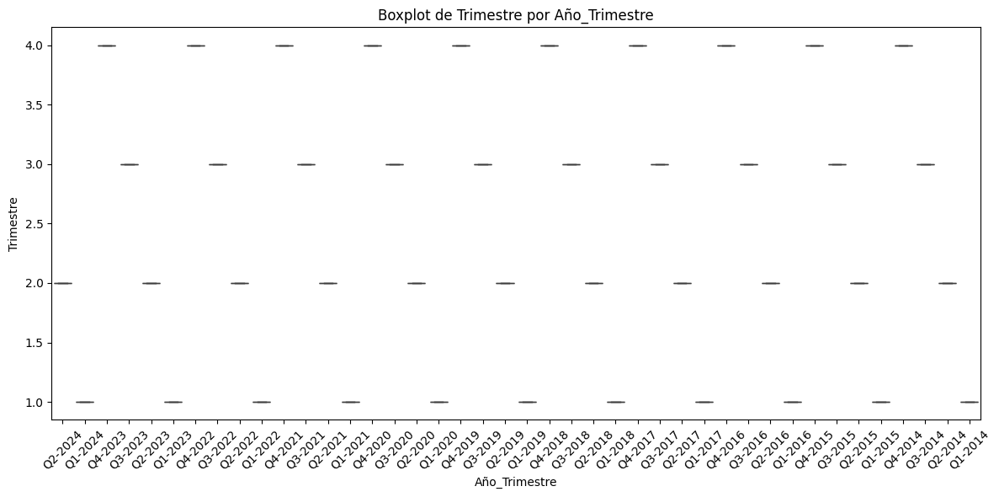


Estadísticas descriptivas de 'Hasta 512 kbps' agrupadas por 'Año_Trimestre':
               count      mean  std       min       25%       50%       75%  \
Año_Trimestre                                                                 
Q1-2014          1.0   52684.0  NaN   52684.0   52684.0   52684.0   52684.0   
Q1-2015          1.0   41158.0  NaN   41158.0   41158.0   41158.0   41158.0   
Q1-2016          1.0   30428.0  NaN   30428.0   30428.0   30428.0   30428.0   
Q1-2017          1.0   20653.0  NaN   20653.0   20653.0   20653.0   20653.0   
Q1-2018          1.0    7309.0  NaN    7309.0    7309.0    7309.0    7309.0   
Q1-2019          1.0  166573.0  NaN  166573.0  166573.0  166573.0  166573.0   
Q1-2020          1.0   42550.0  NaN   42550.0   42550.0   42550.0   42550.0   
Q1-2021          1.0   39487.0  NaN   39487.0   39487.0   39487.0   39487.0   
Q1-2022          1.0   34890.0  NaN   34890.0   34890.0   34890.0   34890.0   
Q1-2023          1.0   31437.0  NaN   31437.0   31437

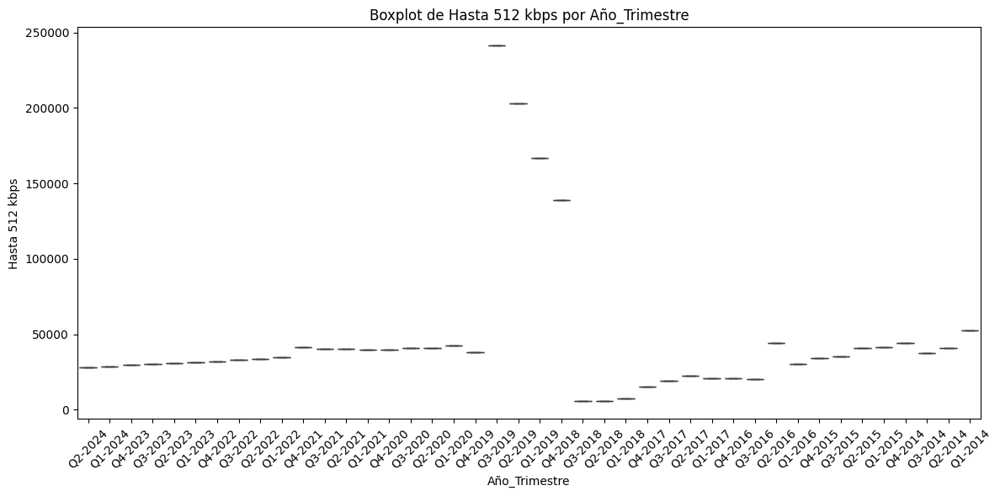


Estadísticas descriptivas de 'Entre 512 Kbps y 1 Mbps' agrupadas por 'Año_Trimestre':
               count      mean  std       min       25%       50%       75%  \
Año_Trimestre                                                                 
Q1-2014          1.0  687619.0  NaN  687619.0  687619.0  687619.0  687619.0   
Q1-2015          1.0  516919.0  NaN  516919.0  516919.0  516919.0  516919.0   
Q1-2016          1.0  404810.0  NaN  404810.0  404810.0  404810.0  404810.0   
Q1-2017          1.0  230159.0  NaN  230159.0  230159.0  230159.0  230159.0   
Q1-2018          1.0  215406.0  NaN  215406.0  215406.0  215406.0  215406.0   
Q1-2019          1.0  195706.0  NaN  195706.0  195706.0  195706.0  195706.0   
Q1-2020          1.0   56170.0  NaN   56170.0   56170.0   56170.0   56170.0   
Q1-2021          1.0   41674.0  NaN   41674.0   41674.0   41674.0   41674.0   
Q1-2022          1.0  104840.0  NaN  104840.0  104840.0  104840.0  104840.0   
Q1-2023          1.0   82048.0  NaN   82048.

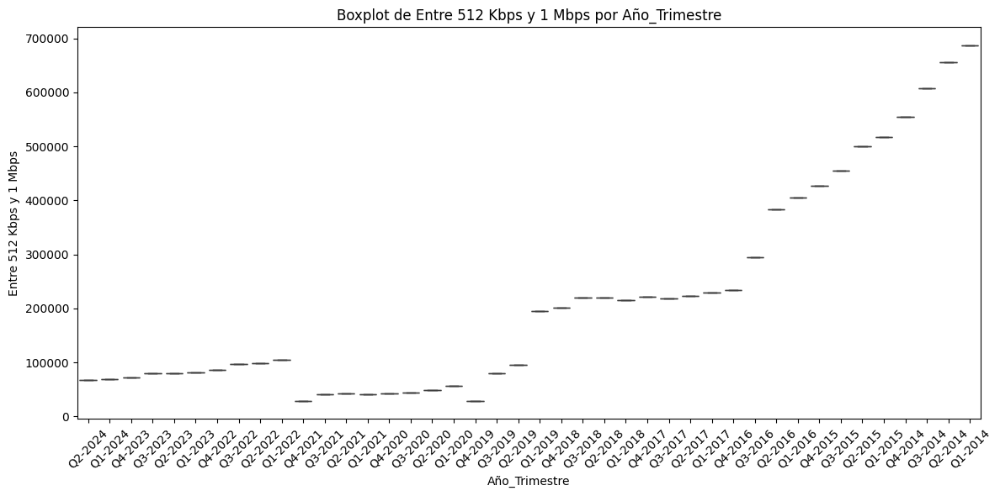


Estadísticas descriptivas de 'Entre 1 Mbps y 6 Mbps' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0  5130294.0  NaN  5130294.0  5130294.0  5130294.0   
Q1-2015          1.0  5121423.0  NaN  5121423.0  5121423.0  5121423.0   
Q1-2016          1.0  4944358.0  NaN  4944358.0  4944358.0  4944358.0   
Q1-2017          1.0  4584534.0  NaN  4584534.0  4584534.0  4584534.0   
Q1-2018          1.0  3272724.0  NaN  3272724.0  3272724.0  3272724.0   
Q1-2019          1.0  3428759.0  NaN  3428759.0  3428759.0  3428759.0   
Q1-2020          1.0  2649819.0  NaN  2649819.0  2649819.0  2649819.0   
Q1-2021          1.0  2593477.0  NaN  2593477.0  2593477.0  2593477.0   
Q1-2022          1.0  1263273.0  NaN  1263273.0  1263273.0  1263273.0   
Q1-2023          1.0  1001553.0  NaN  1001553.0  1001553.0  1001553.0   
Q1-2024          1.0   866152.0  NaN   

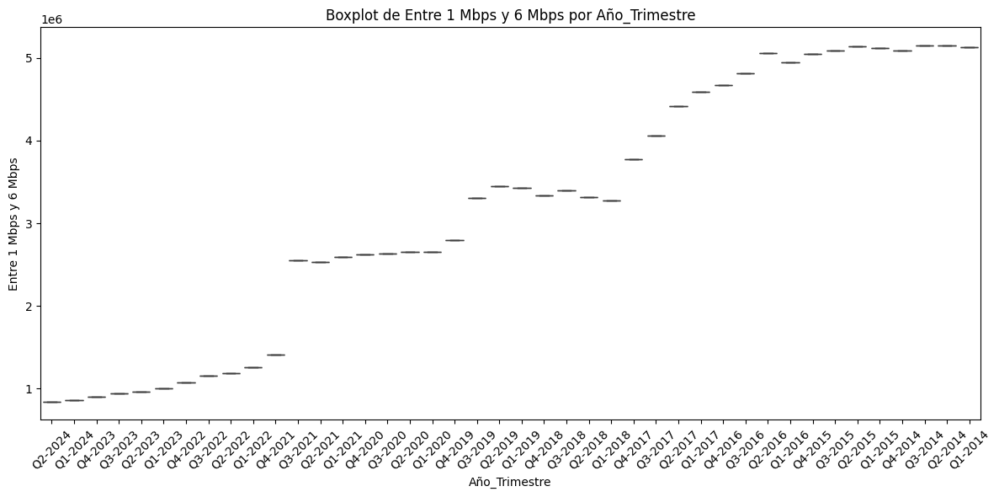


Estadísticas descriptivas de 'Entre 6 Mbps y 10 Mbps' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0   289182.0  NaN   289182.0   289182.0   289182.0   
Q1-2015          1.0   571620.0  NaN   571620.0   571620.0   571620.0   
Q1-2016          1.0   762999.0  NaN   762999.0   762999.0   762999.0   
Q1-2017          1.0   975027.0  NaN   975027.0   975027.0   975027.0   
Q1-2018          1.0   976956.0  NaN   976956.0   976956.0   976956.0   
Q1-2019          1.0   882836.0  NaN   882836.0   882836.0   882836.0   
Q1-2020          1.0  1022014.0  NaN  1022014.0  1022014.0  1022014.0   
Q1-2021          1.0  1072722.0  NaN  1072722.0  1072722.0  1072722.0   
Q1-2022          1.0  1209148.0  NaN  1209148.0  1209148.0  1209148.0   
Q1-2023          1.0  1060321.0  NaN  1060321.0  1060321.0  1060321.0   
Q1-2024          1.0   950930.0  NaN  

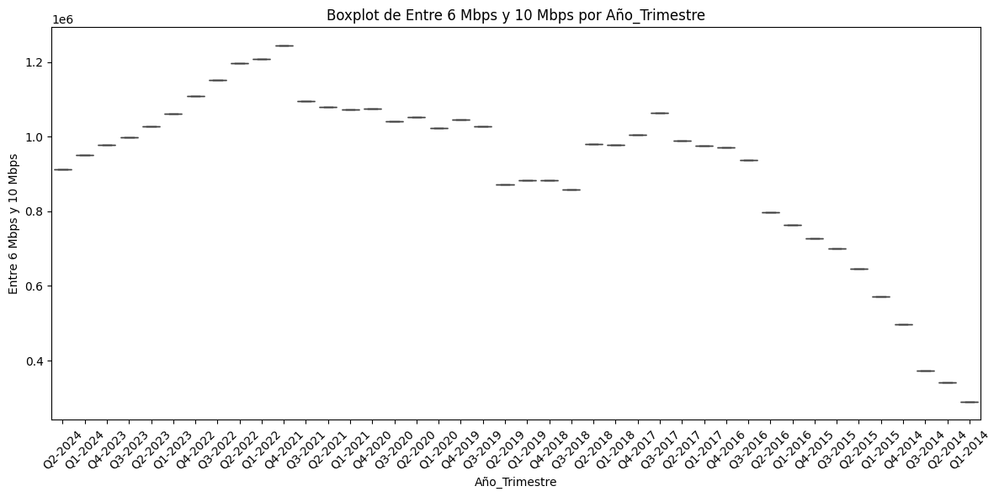


Estadísticas descriptivas de 'Entre 10 Mbps y 20 Mbps' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0   101127.0  NaN   101127.0   101127.0   101127.0   
Q1-2015          1.0   348102.0  NaN   348102.0   348102.0   348102.0   
Q1-2016          1.0   641646.0  NaN   641646.0   641646.0   641646.0   
Q1-2017          1.0  1129987.0  NaN  1129987.0  1129987.0  1129987.0   
Q1-2018          1.0  2068087.0  NaN  2068087.0  2068087.0  2068087.0   
Q1-2019          1.0  1464748.0  NaN  1464748.0  1464748.0  1464748.0   
Q1-2020          1.0   814470.0  NaN   814470.0   814470.0   814470.0   
Q1-2021          1.0   737930.0  NaN   737930.0   737930.0   737930.0   
Q1-2022          1.0   967508.0  NaN   967508.0   967508.0   967508.0   
Q1-2023          1.0   729194.0  NaN   729194.0   729194.0   729194.0   
Q1-2024          1.0   672155.0  NaN 

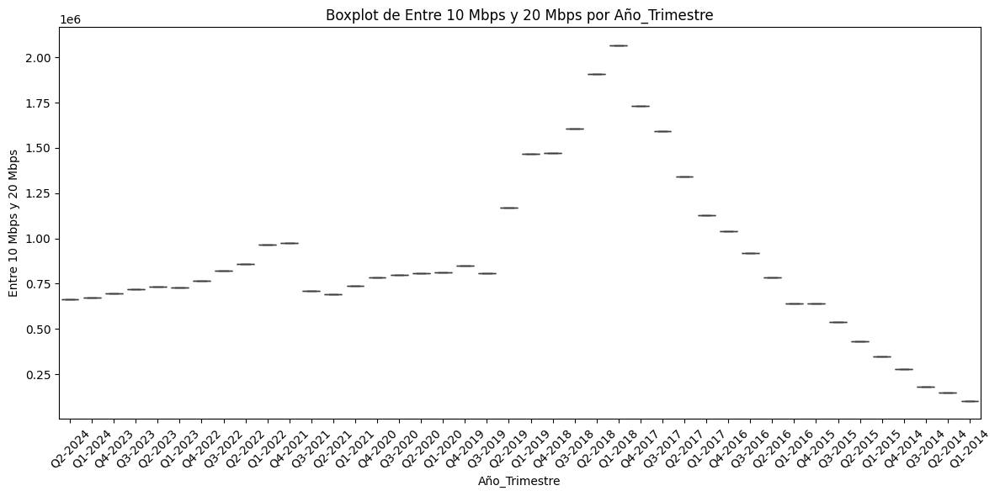


Estadísticas descriptivas de 'Entre 20 Mbps y 30 Mbps' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0      345.0  NaN      345.0      345.0      345.0   
Q1-2015          1.0     7643.0  NaN     7643.0     7643.0     7643.0   
Q1-2016          1.0    27664.0  NaN    27664.0    27664.0    27664.0   
Q1-2017          1.0   210668.0  NaN   210668.0   210668.0   210668.0   
Q1-2018          1.0   862010.0  NaN   862010.0   862010.0   862010.0   
Q1-2019          1.0  1244215.0  NaN  1244215.0  1244215.0  1244215.0   
Q1-2020          1.0   532309.0  NaN   532309.0   532309.0   532309.0   
Q1-2021          1.0   595920.0  NaN   595920.0   595920.0   595920.0   
Q1-2022          1.0   509830.0  NaN   509830.0   509830.0   509830.0   
Q1-2023          1.0   357769.0  NaN   357769.0   357769.0   357769.0   
Q1-2024          1.0   353896.0  NaN 

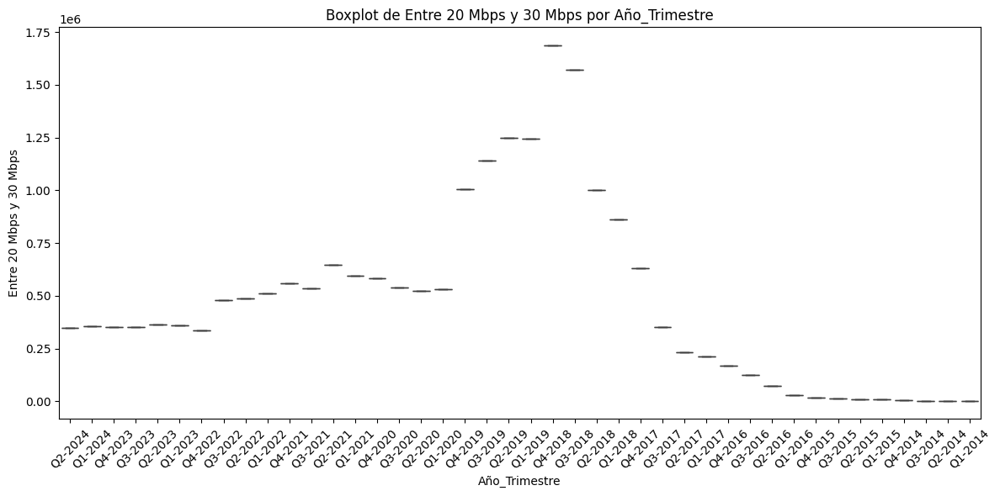


Estadísticas descriptivas de 'Más de 30 Mbps' agrupadas por 'Año_Trimestre':
               count       mean  std        min        25%        50%  \
Año_Trimestre                                                           
Q1-2014          1.0    11595.0  NaN    11595.0    11595.0    11595.0   
Q1-2015          1.0    16347.0  NaN    16347.0    16347.0    16347.0   
Q1-2016          1.0    23380.0  NaN    23380.0    23380.0    23380.0   
Q1-2017          1.0    47990.0  NaN    47990.0    47990.0    47990.0   
Q1-2018          1.0   397977.0  NaN   397977.0   397977.0   397977.0   
Q1-2019          1.0  1138728.0  NaN  1138728.0  1138728.0  1138728.0   
Q1-2020          1.0  3500882.0  NaN  3500882.0  3500882.0  3500882.0   
Q1-2021          1.0  4379965.0  NaN  4379965.0  4379965.0  4379965.0   
Q1-2022          1.0  6336187.0  NaN  6336187.0  6336187.0  6336187.0   
Q1-2023          1.0  7564819.0  NaN  7564819.0  7564819.0  7564819.0   
Q1-2024          1.0  8363694.0  NaN  8363694.

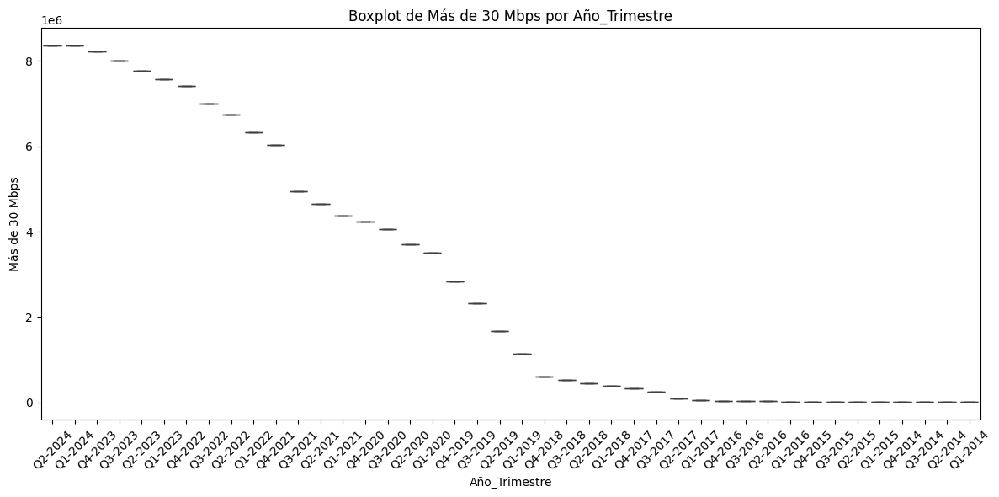


Estadísticas descriptivas de 'OTROS' agrupadas por 'Año_Trimestre':
               count      mean  std       min       25%       50%       75%  \
Año_Trimestre                                                                 
Q1-2014          1.0       0.0  NaN       0.0       0.0       0.0       0.0   
Q1-2015          1.0       0.0  NaN       0.0       0.0       0.0       0.0   
Q1-2016          1.0       0.0  NaN       0.0       0.0       0.0       0.0   
Q1-2017          1.0       0.0  NaN       0.0       0.0       0.0       0.0   
Q1-2018          1.0  236584.0  NaN  236584.0  236584.0  236584.0  236584.0   
Q1-2019          1.0  126570.0  NaN  126570.0  126570.0  126570.0  126570.0   
Q1-2020          1.0  194212.0  NaN  194212.0  194212.0  194212.0  194212.0   
Q1-2021          1.0  186797.0  NaN  186797.0  186797.0  186797.0  186797.0   
Q1-2022          1.0  198333.0  NaN  198333.0  198333.0  198333.0  198333.0   
Q1-2023          1.0  414754.0  NaN  414754.0  414754.0  41475

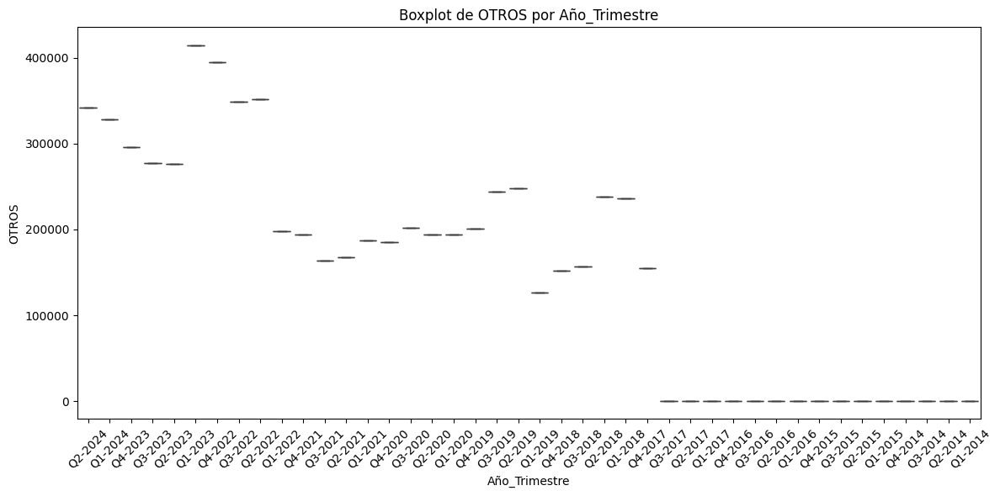


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count        mean  std         min         25%         50%  \
Año_Trimestre                                                               
Q1-2014          1.0   6272846.0  NaN   6272846.0   6272846.0   6272846.0   
Q1-2015          1.0   6623212.0  NaN   6623212.0   6623212.0   6623212.0   
Q1-2016          1.0   6835285.0  NaN   6835285.0   6835285.0   6835285.0   
Q1-2017          1.0   7199018.0  NaN   7199018.0   7199018.0   7199018.0   
Q1-2018          1.0   8037053.0  NaN   8037053.0   8037053.0   8037053.0   
Q1-2019          1.0   8648135.0  NaN   8648135.0   8648135.0   8648135.0   
Q1-2020          1.0   8812426.0  NaN   8812426.0   8812426.0   8812426.0   
Q1-2021          1.0   9647972.0  NaN   9647972.0   9647972.0   9647972.0   
Q1-2022          1.0  10624009.0  NaN  10624009.0  10624009.0  10624009.0   
Q1-2023          1.0  11241895.0  NaN  11241895.0  11241895.0  11241895.0   
Q1-2024

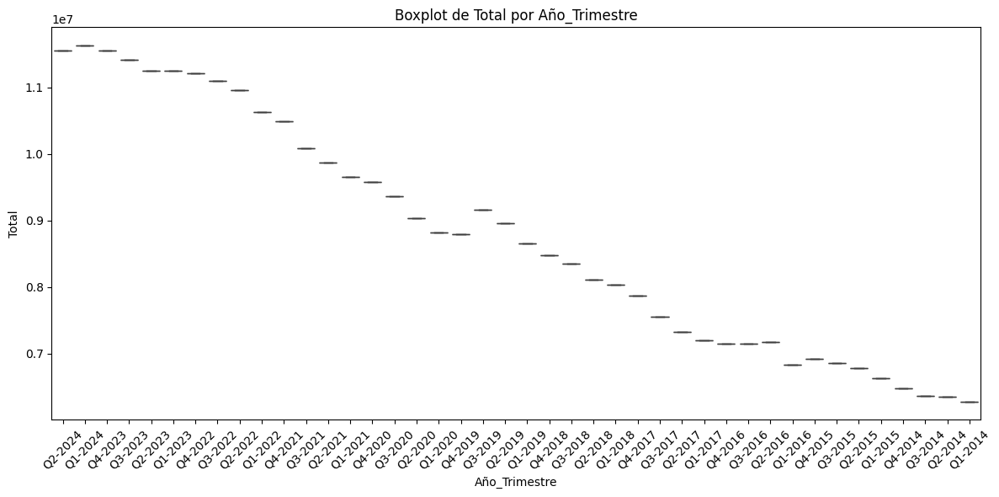


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
            count         mean       std     min     25%     50%     75%  \
Periodo                                                                    
01-03-2024   42.0  2018.761905  3.074756  2014.0  2016.0  2019.0  2021.0   

               max  
Periodo             
01-03-2024  2024.0  


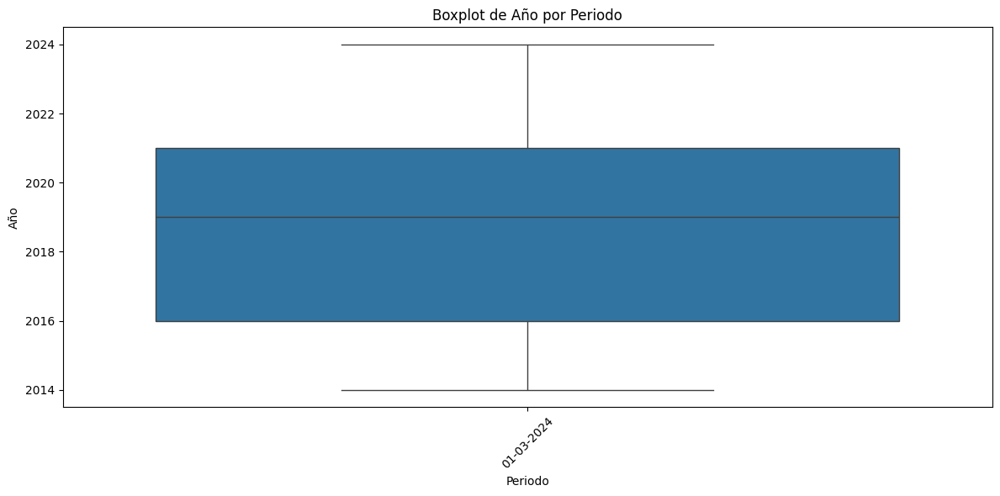


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
            count      mean      std  min   25%  50%  75%  max
Periodo                                                       
01-03-2024   42.0  2.452381  1.13056  1.0  1.25  2.0  3.0  4.0


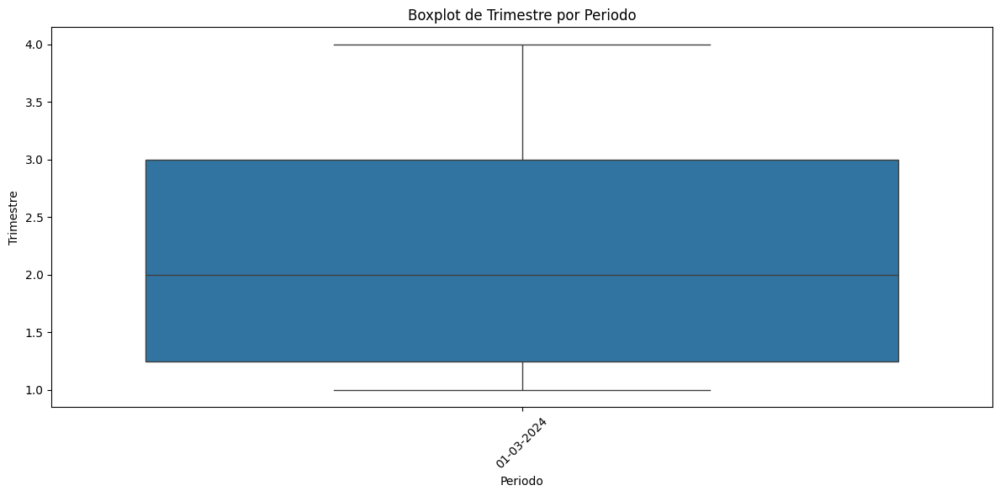


Estadísticas descriptivas de 'Hasta 512 kbps' agrupadas por 'Periodo':
            count          mean           std     min       25%      50%  \
Periodo                                                                    
01-03-2024   42.0  46756.595238  48922.973593  5675.0  29027.75  34960.0   

                75%       max  
Periodo                        
01-03-2024  41057.5  241713.0  


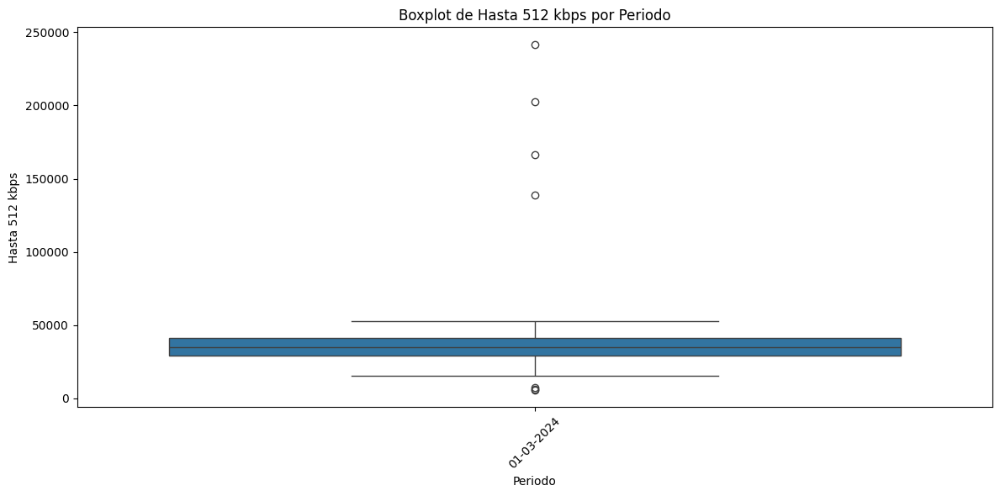


Estadísticas descriptivas de 'Entre 512 Kbps y 1 Mbps' agrupadas por 'Periodo':
            count           mean            std      min       25%       50%  \
Periodo                                                                        
01-03-2024   42.0  215615.285714  192134.704593  28521.0  69951.75  150273.0   

                  75%       max  
Periodo                          
01-03-2024  279159.25  687619.0  


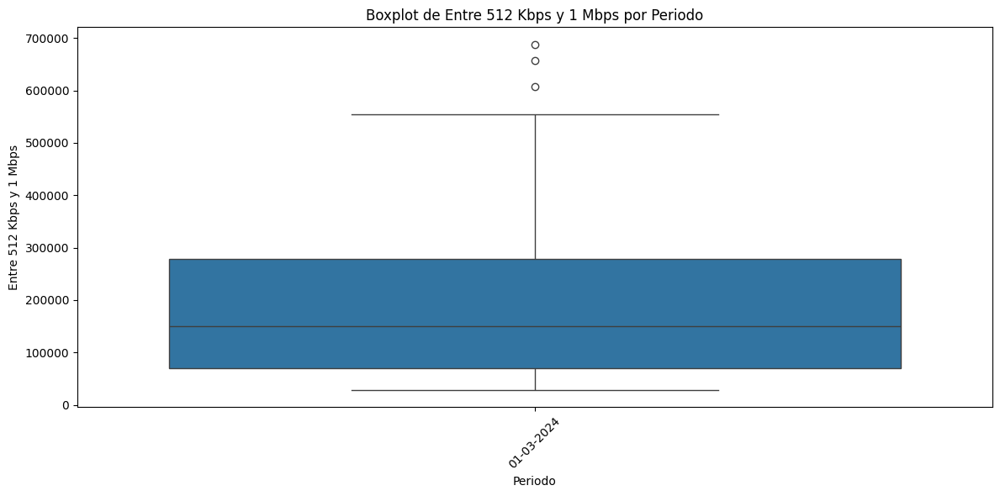


Estadísticas descriptivas de 'Entre 1 Mbps y 6 Mbps' agrupadas por 'Periodo':
            count          mean           std       min         25%  \
Periodo                                                               
01-03-2024   42.0  3.176365e+06  1.552136e+06  840200.0  1692723.75   

                  50%        75%        max  
Periodo                                      
01-03-2024  3313002.5  4780395.5  5153437.0  


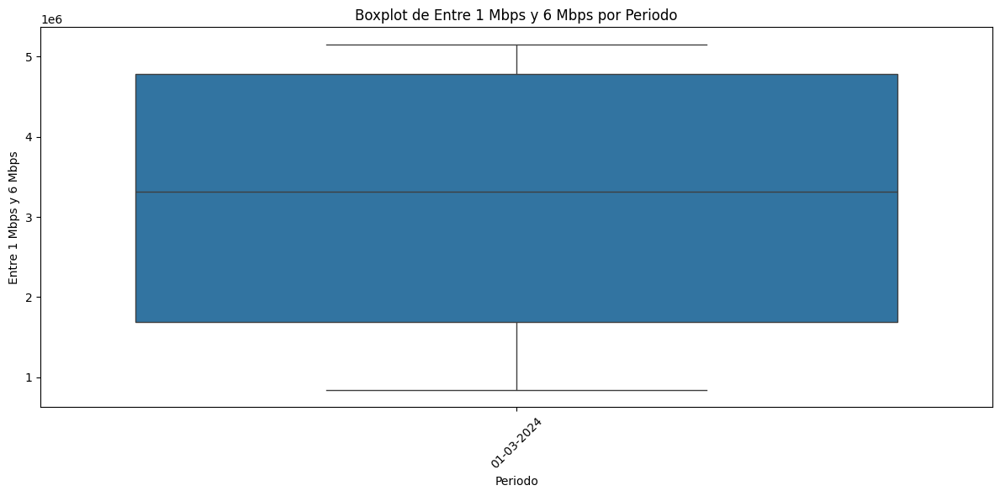


Estadísticas descriptivas de 'Entre 6 Mbps y 10 Mbps' agrupadas por 'Periodo':
            count           mean            std       min        25%  \
Periodo                                                                
01-03-2024   42.0  915481.857143  229375.825017  289182.0  862345.25   

                 50%        75%        max  
Periodo                                     
01-03-2024  978762.0  1058517.5  1245333.0  


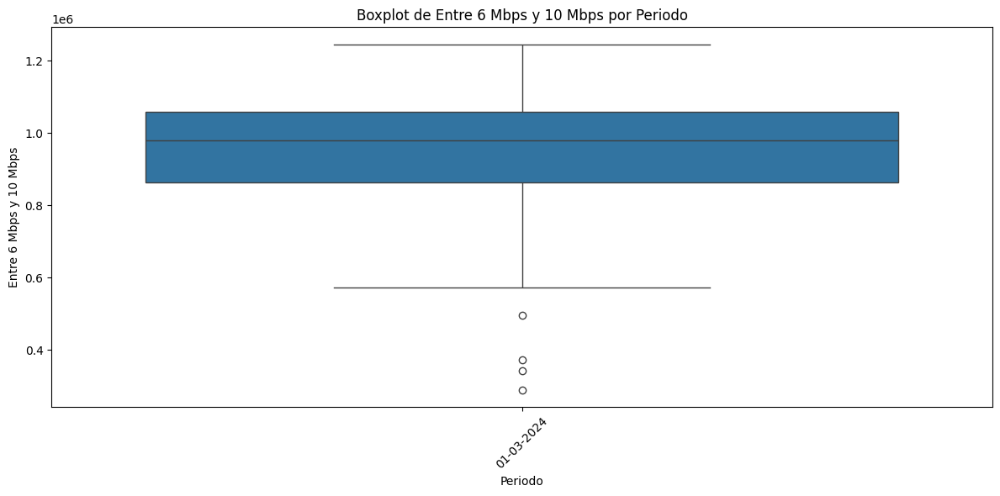


Estadísticas descriptivas de 'Entre 10 Mbps y 20 Mbps' agrupadas por 'Periodo':
            count           mean           std       min       25%       50%  \
Periodo                                                                        
01-03-2024   42.0  884427.642857  451590.03078  101127.0  677435.5  792972.5   

                  75%        max  
Periodo                           
01-03-2024  1022656.5  2068087.0  


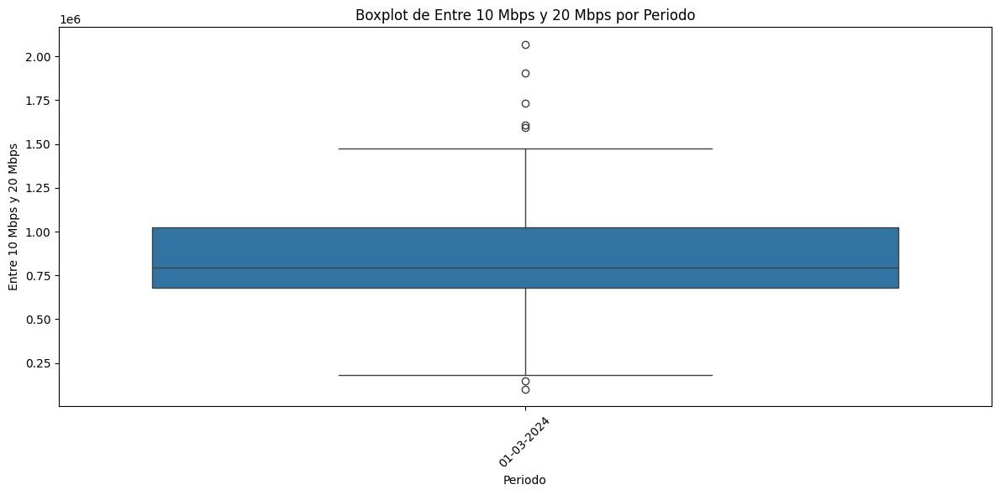


Estadísticas descriptivas de 'Entre 20 Mbps y 30 Mbps' agrupadas por 'Periodo':
            count           mean            std    min       25%       50%  \
Periodo                                                                      
01-03-2024   42.0  478365.619048  433434.313766  345.0  135803.5  361249.5   

                 75%        max  
Periodo                          
01-03-2024  592545.0  1688748.0  


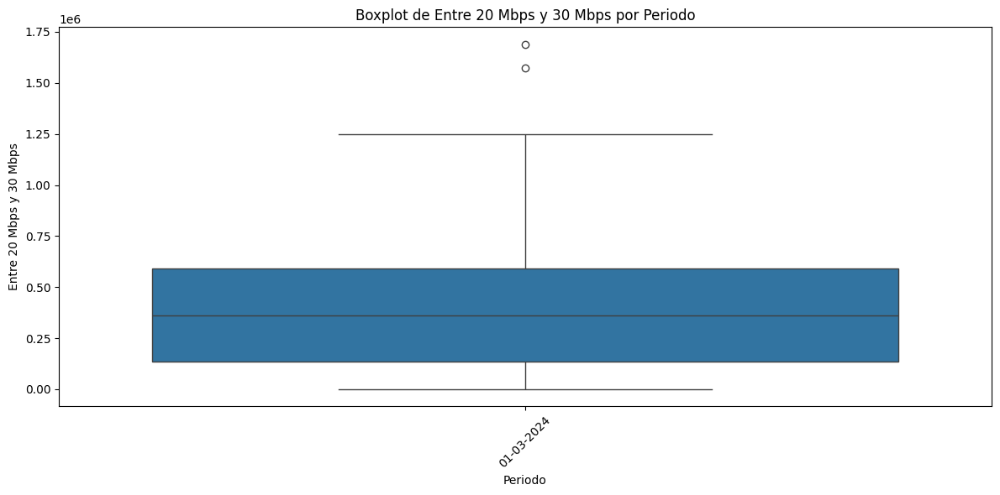


Estadísticas descriptivas de 'Más de 30 Mbps' agrupadas por 'Periodo':
            count          mean           std      min      25%        50%  \
Periodo                                                                      
01-03-2024   42.0  2.909772e+06  3.138715e+06  11595.0  32914.0  1408279.0   

                  75%        max  
Periodo                           
01-03-2024  5761285.0  8363694.0  


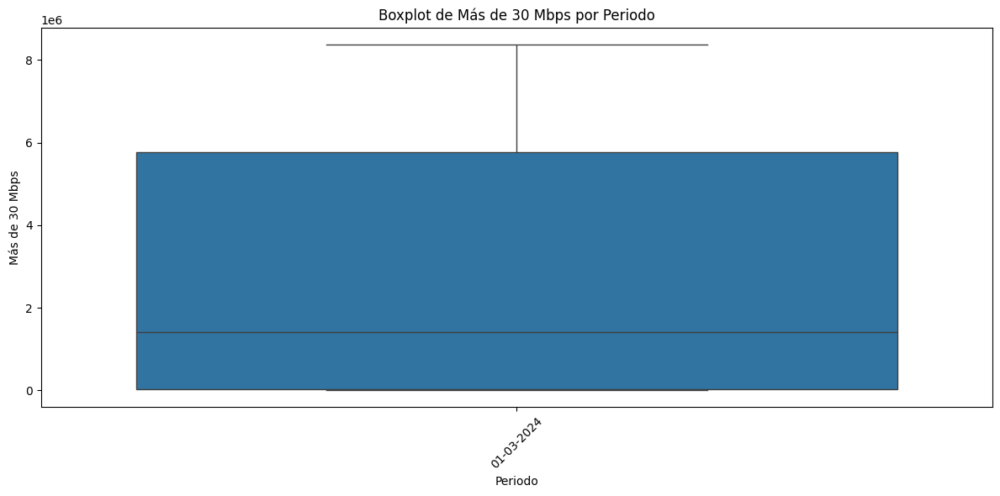


Estadísticas descriptivas de 'OTROS' agrupadas por 'Periodo':
            count           mean            std  min  25%       50%       75%  \
Periodo                                                                         
01-03-2024   42.0  154081.071429  132453.955052  0.0  0.0  176235.5  242214.0   

                 max  
Periodo               
01-03-2024  414754.0  


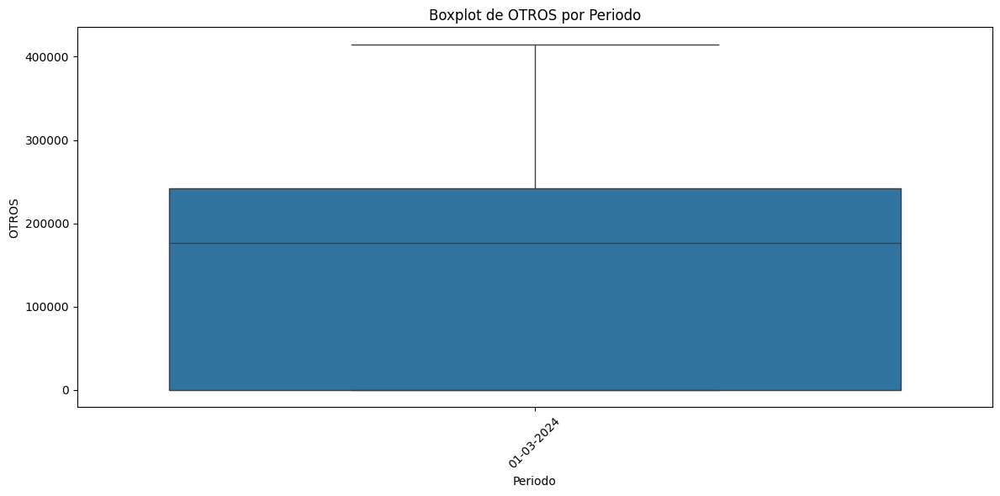


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
            count          mean           std        min        25%  \
Periodo                                                               
01-03-2024   42.0  8.780865e+06  1.772655e+06  6272846.0  7151638.0   

                  50%          75%         max  
Periodo                                         
01-03-2024  8720658.0  10388730.75  11633156.0  


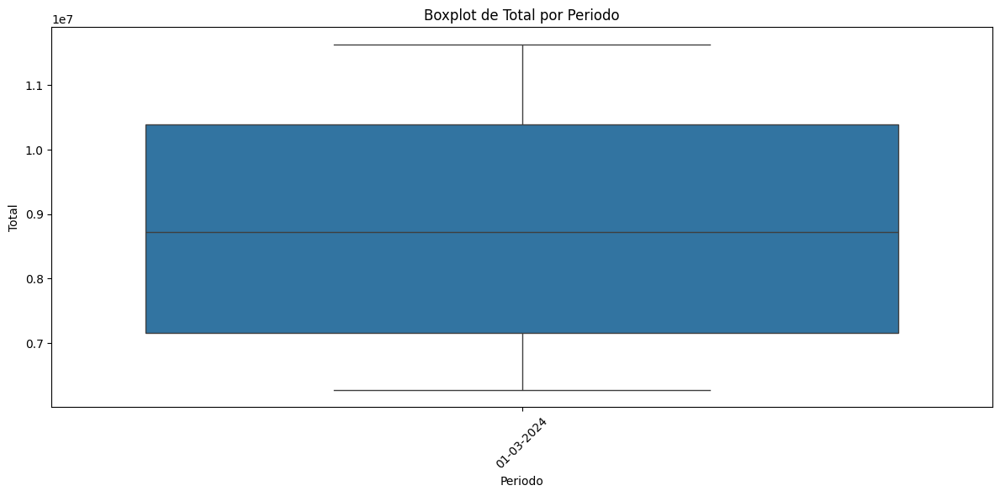


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count    mean       std     min      25%     50%      75%  \
meses_periodo                                                              
abr - jun       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
ene - mar       11.0  2019.0  3.316625  2014.0  2016.50  2019.0  2021.50   
jul - sep       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   
oct - dic       10.0  2018.5  3.027650  2014.0  2016.25  2018.5  2020.75   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


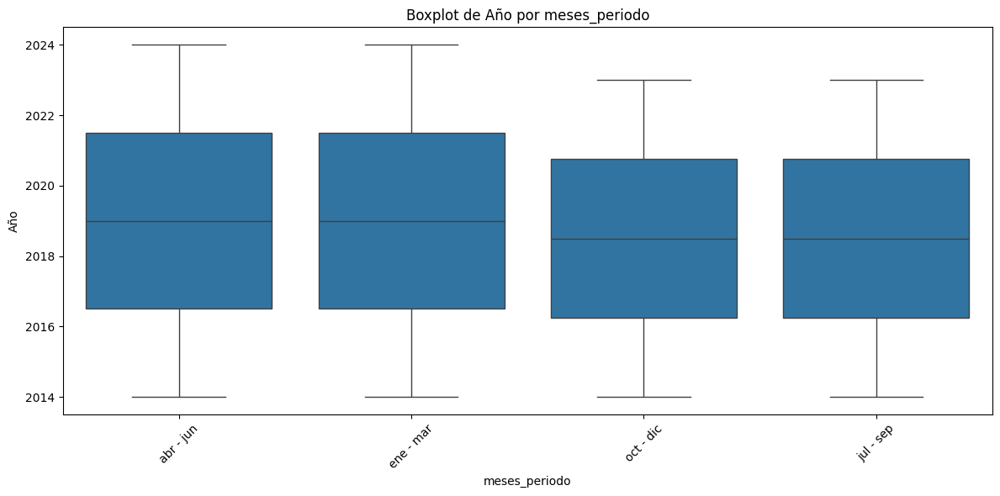


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun       11.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar       11.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep       10.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic       10.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


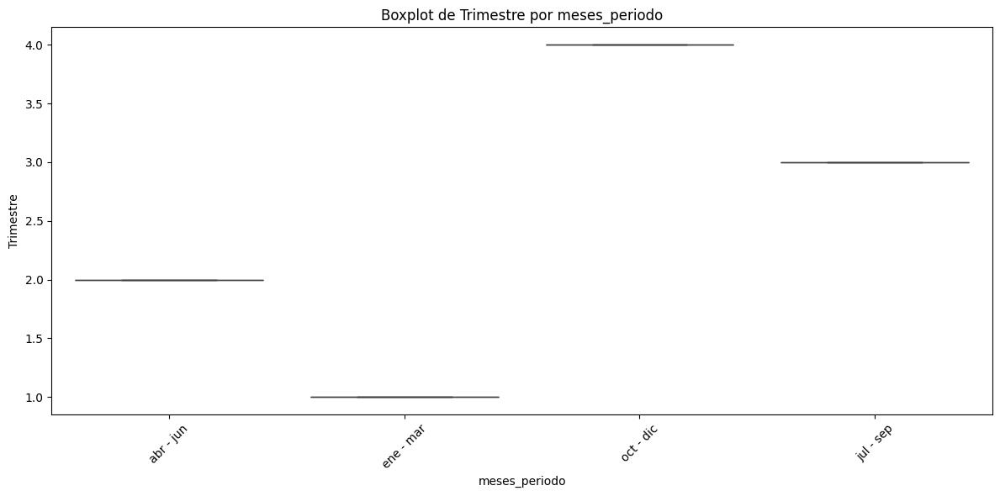


Estadísticas descriptivas de 'Hasta 512 kbps' agrupadas por 'meses_periodo':
               count          mean           std      min       25%      50%  \
meses_periodo                                                                  
abr - jun       11.0  48252.545455  52444.039513   5972.0  29489.00  40172.0   
ene - mar       11.0  45088.181818  42029.055456   7309.0  29614.50  34890.0   
jul - sep       10.0  50347.300000  68156.215895   5675.0  22646.50  34021.5   
oct - dic       10.0  43355.600000  34731.189906  15041.0  30276.25  36257.5   

                   75%       max  
meses_periodo                     
abr - jun      41051.0  202790.0  
ene - mar      41854.0  166573.0  
jul - sep      39488.0  241713.0  
oct - dic      40824.0  138740.0  


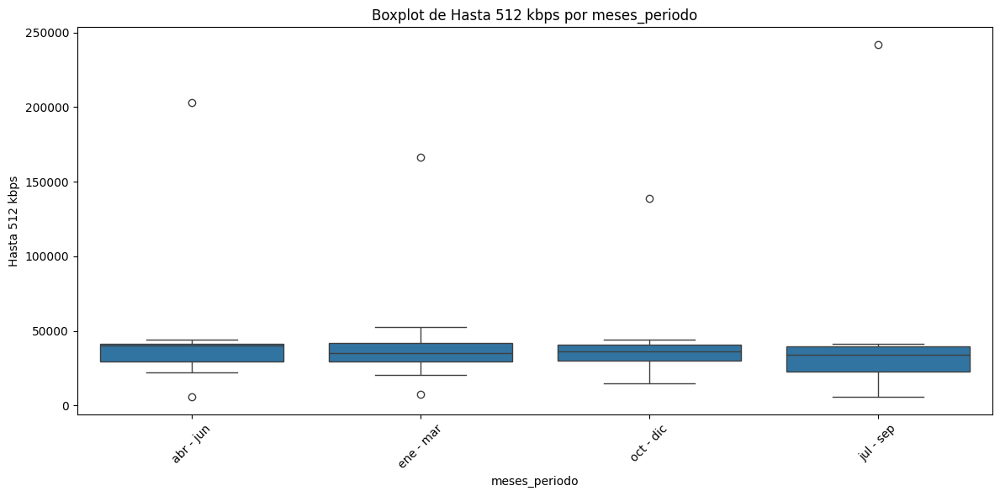


Estadísticas descriptivas de 'Entre 512 Kbps y 1 Mbps' agrupadas por 'meses_periodo':
               count           mean            std      min       25%  \
meses_periodo                                                           
abr - jun       11.0  219605.272727  207368.658806  42024.0  73214.50   
ene - mar       11.0  236791.454545  212655.381093  41674.0  75701.50   
jul - sep       10.0  214017.100000  190977.070128  41437.0  80601.50   
oct - dic       10.0  189530.700000  179850.924120  28521.0  49574.25   

                    50%       75%       max  
meses_periodo                                
abr - jun       99498.0  303493.5  656408.0  
ene - mar      195706.0  317484.5  687619.0  
jul - sep      157362.0  275957.0  608018.0  
oct - dic      143432.0  230417.0  554749.0  


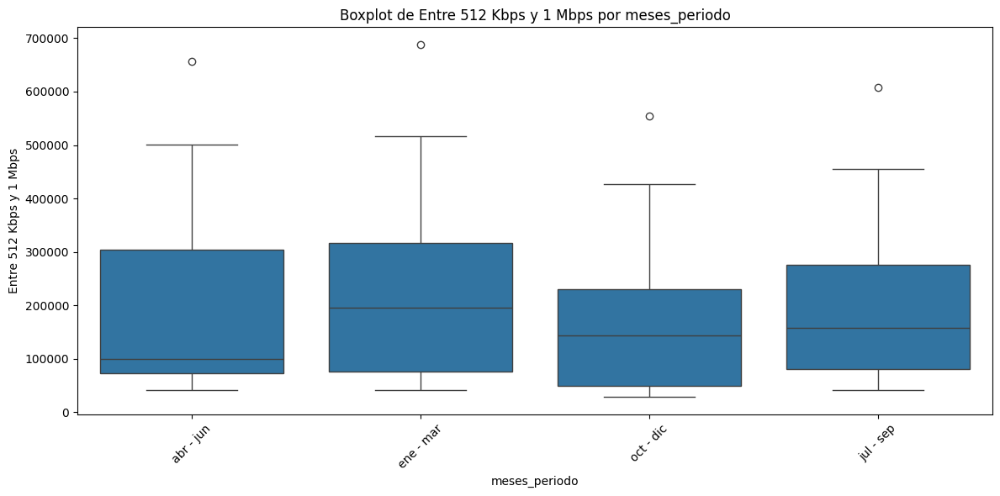


Estadísticas descriptivas de 'Entre 1 Mbps y 6 Mbps' agrupadas por 'meses_periodo':
               count          mean           std       min         25%  \
meses_periodo                                                            
abr - jun       11.0  3.154859e+06  1.669982e+06  840200.0  1862180.50   
ene - mar       11.0  3.168761e+06  1.646997e+06  866152.0  1928375.00   
jul - sep       10.0  3.312515e+06  1.514267e+06  945608.0  2572167.75   
oct - dic       10.0  3.072235e+06  1.592456e+06  900253.0  1715565.50   

                     50%         75%        max  
meses_periodo                                    
abr - jun      3316868.0  4737273.00  5149574.0  
ene - mar      3272724.0  4764446.00  5130294.0  
jul - sep      3355207.0  4627617.25  5153437.0  
oct - dic      3065144.5  4448294.00  5084556.0  


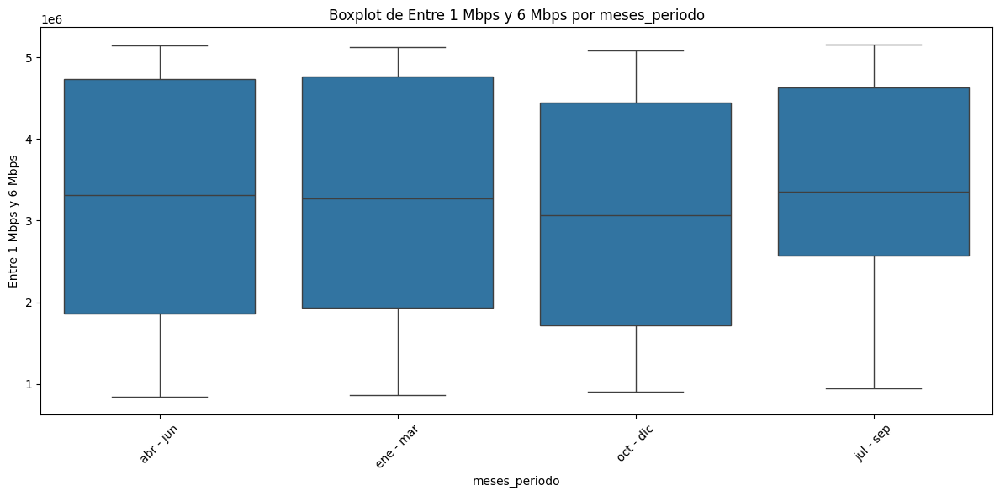


Estadísticas descriptivas de 'Entre 6 Mbps y 10 Mbps' agrupadas por 'meses_periodo':
               count           mean            std       min       25%  \
meses_periodo                                                            
abr - jun       11.0  899546.000000  237309.076480  341689.0  834070.0   
ene - mar       11.0  888523.181818  260516.370983  289182.0  822917.5   
jul - sep       10.0  924659.400000  232737.276927  373372.0  878693.0   
oct - dic       10.0  953488.300000  211272.701723  496251.0  904564.5   

                     50%         75%        max  
meses_periodo                                    
abr - jun       979416.0  1040678.50  1197030.0  
ene - mar       975027.0  1041167.50  1209148.0  
jul - sep      1012792.0  1057111.75  1151906.0  
oct - dic       991826.5  1066938.25  1245333.0  


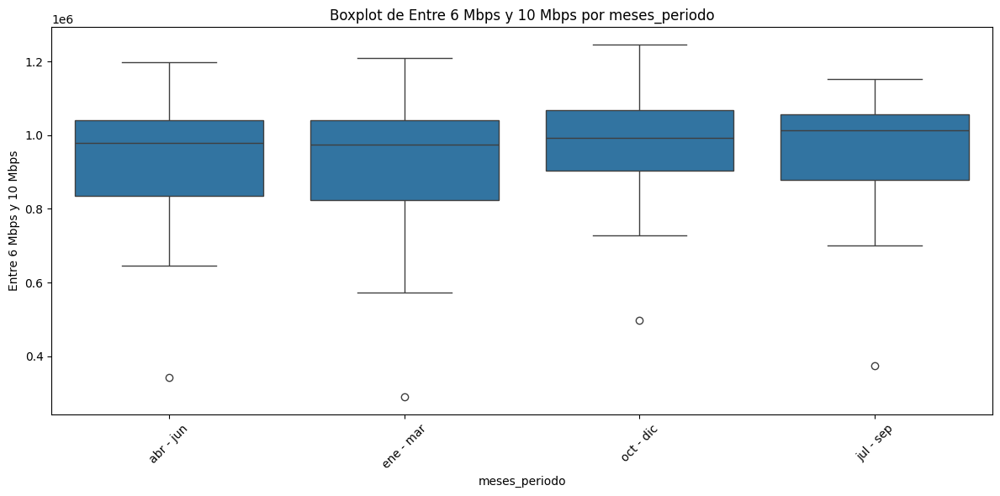


Estadísticas descriptivas de 'Entre 10 Mbps y 20 Mbps' agrupadas por 'meses_periodo':
               count           mean            std       min        25%  \
meses_periodo                                                             
abr - jun       11.0  867059.363636  469337.680339  147273.0  677963.00   
ene - mar       11.0  879541.272727  534829.047442  101127.0  656900.50   
jul - sep       10.0  870007.300000  435725.160473  182483.0  712612.50   
oct - dic       10.0  923328.100000  417475.958230  276254.0  714177.75   

                    50%         75%        max  
meses_periodo                                   
abr - jun      785759.0  1013097.00  1905839.0  
ene - mar      737930.0  1048747.50  2068087.0  
jul - sep      802908.0   895282.25  1607137.0  
oct - dic      819107.0  1022656.50  1730353.0  


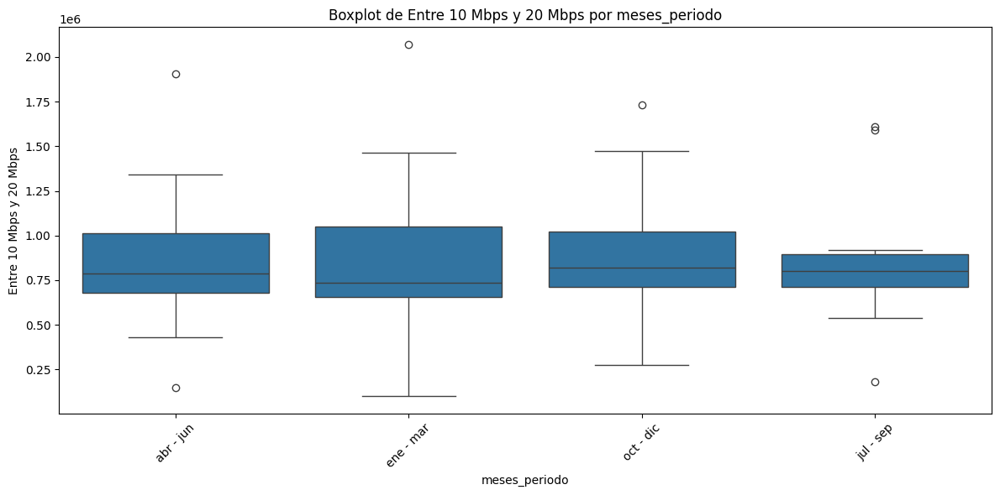


Estadísticas descriptivas de 'Entre 20 Mbps y 30 Mbps' agrupadas por 'meses_periodo':
               count           mean            std     min        25%  \
meses_periodo                                                           
abr - jun       11.0  448695.272727  398880.720941   478.0  152790.50   
ene - mar       11.0  427479.000000  384429.054186   345.0  119166.00   
jul - sep       10.0  511056.000000  498141.871879   507.0  181152.50   
oct - dic       10.0  534287.900000  507732.115303  4371.0  211034.75   

                    50%        75%        max  
meses_periodo                                  
abr - jun      364730.0  585419.00  1250366.0  
ene - mar      357769.0  564114.50  1244215.0  
jul - sep      416651.0  538016.25  1571692.0  
oct - dic      454324.0  619564.50  1688748.0  


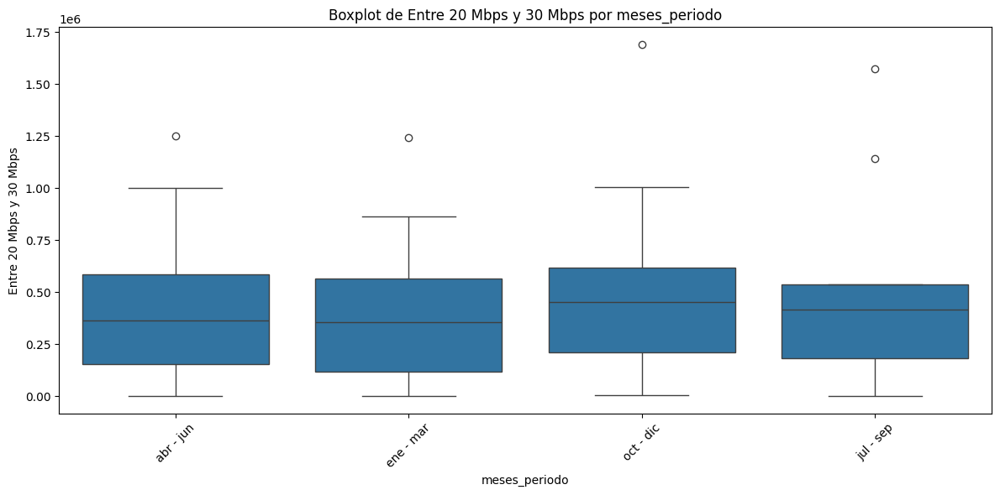


Estadísticas descriptivas de 'Más de 30 Mbps' agrupadas por 'meses_periodo':
               count          mean           std      min        25%  \
meses_periodo                                                          
abr - jun       11.0  3.047960e+06  3.347871e+06  12259.0   63827.50   
ene - mar       11.0  2.889233e+06  3.292406e+06  11595.0   35685.00   
jul - sep       10.0  2.715024e+06  3.089235e+06  12424.0   84714.00   
oct - dic       10.0  2.975107e+06  3.281327e+06  15229.0  113332.25   

                     50%         75%        max  
meses_periodo                                    
abr - jun      1677830.0  5701606.50  8357088.0  
ene - mar      1138728.0  5358076.00  8363694.0  
jul - sep      1419837.5  4724495.75  8003269.0  
oct - dic      1715162.5  5584050.75  8224736.0  


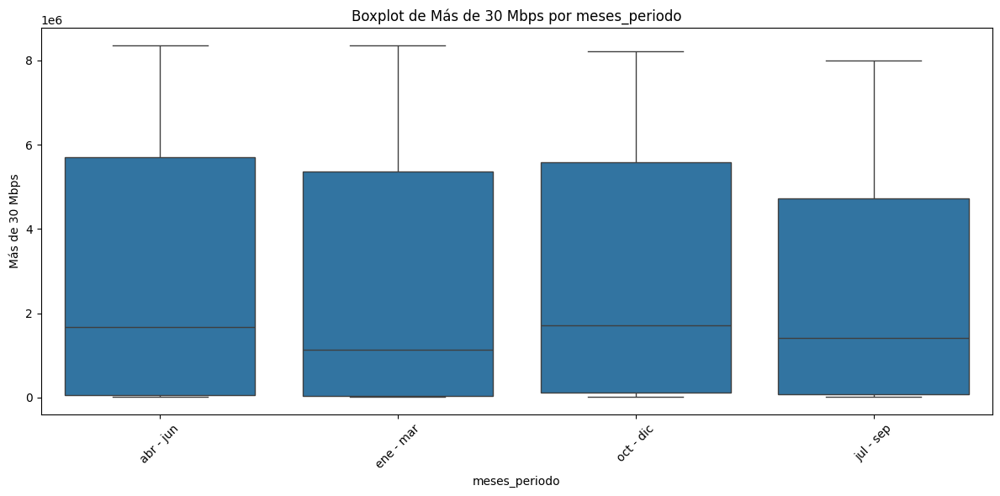


Estadísticas descriptivas de 'OTROS' agrupadas por 'meses_periodo':
               count           mean            std  min      25%       50%  \
meses_periodo                                                                
abr - jun       11.0  165157.454545  141514.177068  0.0      0.0  194008.0   
ene - mar       11.0  153220.272727  143323.682524  0.0      0.0  186797.0   
jul - sep       10.0  139144.400000  131785.824460  0.0      0.0  159872.0   
oct - dic       10.0  157780.600000  130636.696271  0.0  38097.0  170123.5   

                     75%       max  
meses_periodo                       
abr - jun      261969.00  351594.0  
ene - mar      217458.50  414754.0  
jul - sep      233044.50  349035.0  
oct - dic      199347.25  394282.0  


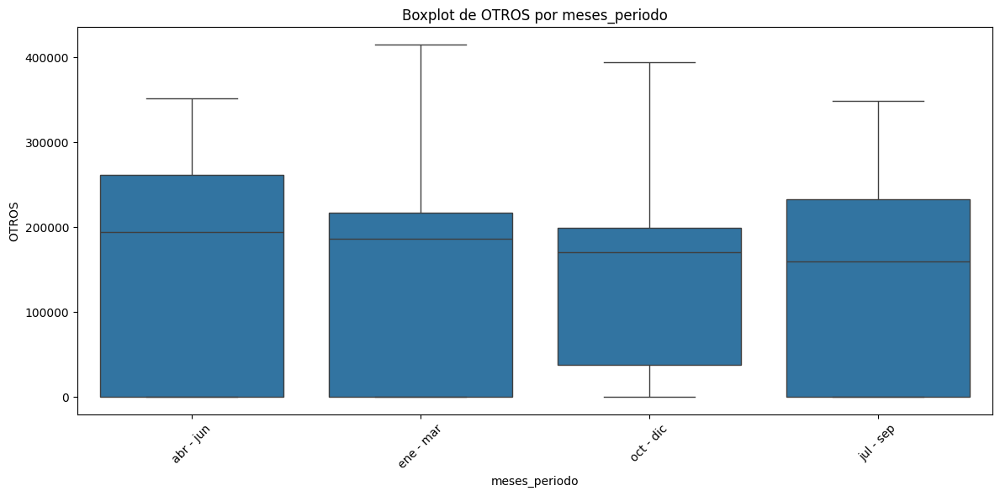


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count          mean           std        min        25%  \
meses_periodo                                                            
abr - jun       11.0  8.851135e+06  1.865917e+06  6348745.0  7248090.5   
ene - mar       11.0  8.688637e+06  1.898756e+06  6272846.0  7017151.5   
jul - sep       10.0  8.736771e+06  1.773732e+06  6367671.0  7244851.0   
oct - dic       10.0  8.849114e+06  1.808506e+06  6475485.0  7326077.5   

                     50%         75%         max  
meses_periodo                                     
abr - jun      8960181.0  10410884.0  11556107.0  
ene - mar      8648135.0  10135990.5  11633156.0  
jul - sep      8755859.5   9903205.5  11406908.0  
oct - dic      8633418.0  10260236.0  11547661.0  


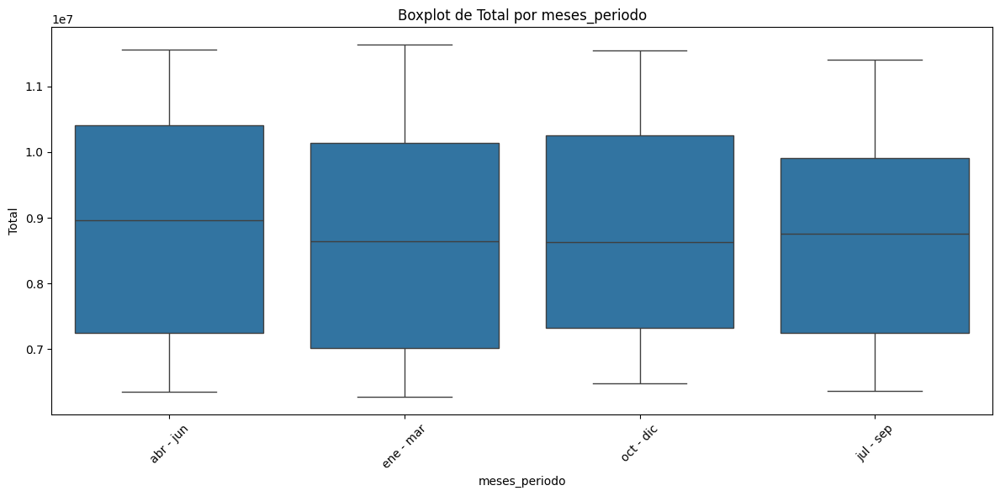

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [26]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
         Año  Trimestre  Hasta 512 kbps  Entre 512 Kbps y 1 Mbps  \
0   1.724231  -0.404989       -0.384914                -0.782745   
1   1.724231  -1.300229       -0.371467                -0.770466   
2   1.395060   1.385490       -0.352702                -0.757892   
3   1.395060   0.490250       -0.340993                -0.711182   
4   1.395060  -0.404989       -0.329553                -0.717525   
5   1.395060  -1.300229       -0.316933                -0.703602   
6   1.065888   1.385490       -0.305678                -0.684533   
7   1.065888   0.490250       -0.284328                -0.626276   
8   1.065888  -0.404989       -0.270798                -0.611679   
9   1.065888  -1.300229       -0.245497                -0.583539   
10  0.736717   1.385490       -0.113673                -0.985570   
11  0.736717   0.490250       -0.136181                -0.917531   
12  0.736717  -0.404989       -0.136223                -0.914439   
13  0.73671

In [27]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    1
Q1-2024    1
Q4-2023    1
Q3-2023    1
Q2-2023    1
Q1-2023    1
Q4-2022    1
Q3-2022    1
Q2-2022    1
Q1-2022    1
Q4-2021    1
Q3-2021    1
Q2-2021    1
Q1-2021    1
Q4-2020    1
Q3-2020    1
Q2-2020    1
Q1-2020    1
Q4-2019    1
Q3-2019    1
Q2-2019    1
Q1-2019    1
Q4-2018    1
Q3-2018    1
Q2-2018    1
Q1-2018    1
Q4-2017    1
Q3-2017    1
Q2-2017    1
Q1-2017    1
Q4-2016    1
Q3-2016    1
Q2-2016    1
Q1-2016    1
Q4-2015    1
Q3-2015    1
Q2-2015    1
Q1-2015    1
Q4-2014    1
Q3-2014    1
Q2-2014    1
Q1-2014    1
Name: count, dtype: int64

Conteo de categorías en la columna 'Periodo':
Periodo
01-03-2024    42
Name: count, dtype: int64

Conteo de categorías en la columna 'meses_periodo':
meses_periodo
abr - jun    11
ene - mar    11
oct - dic    10
jul - sep    10
Name: count, dtype: int64


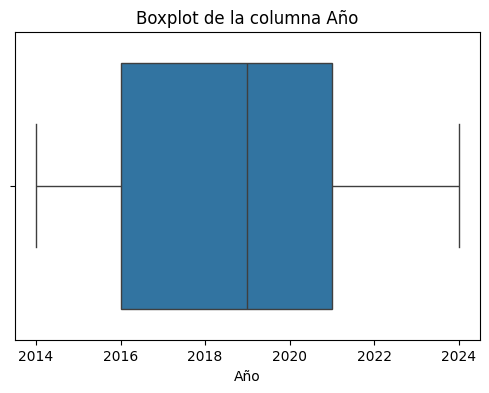

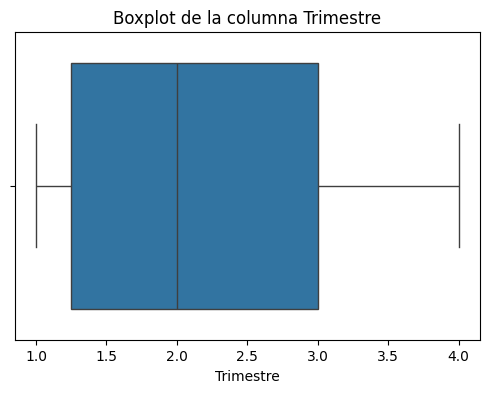

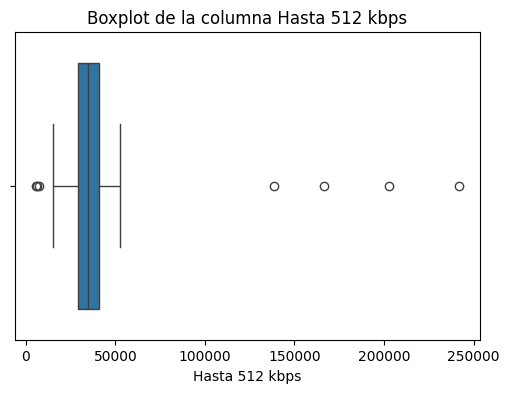

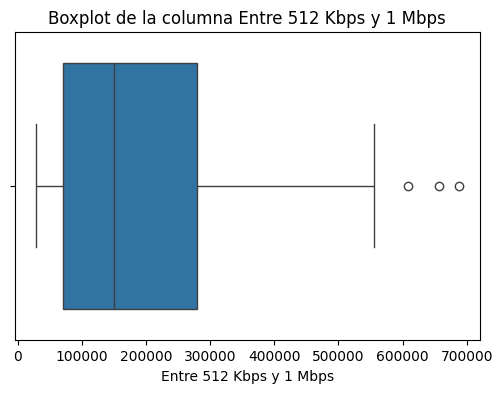

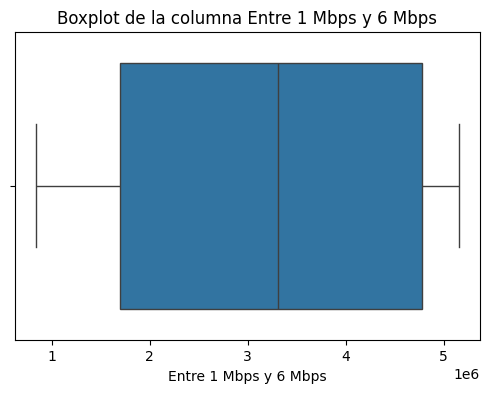

...

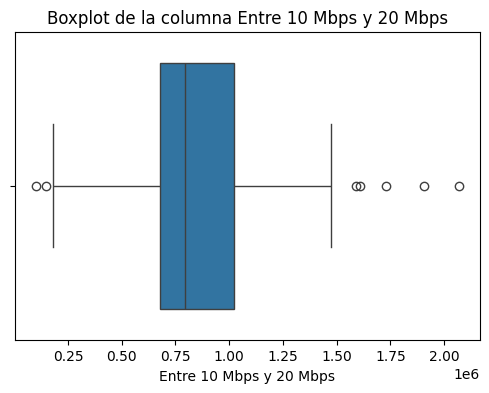

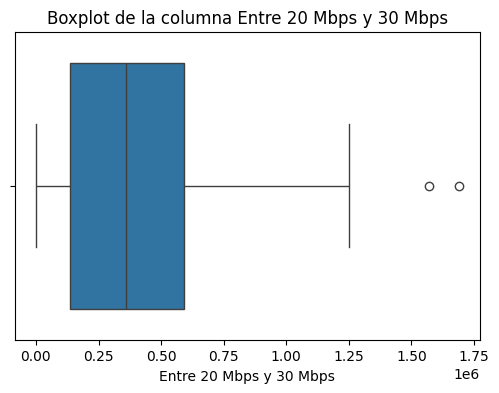

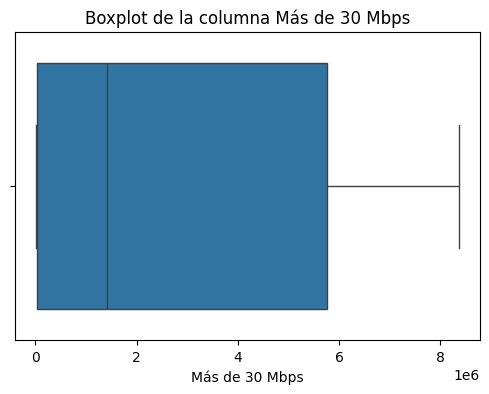

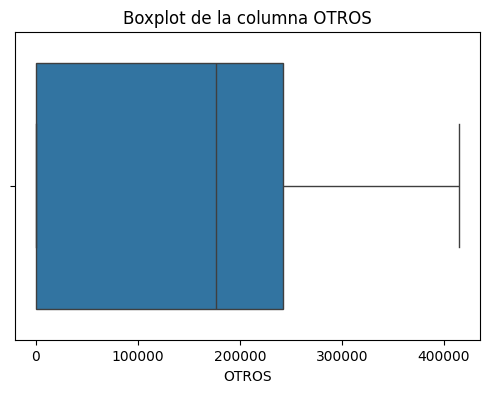

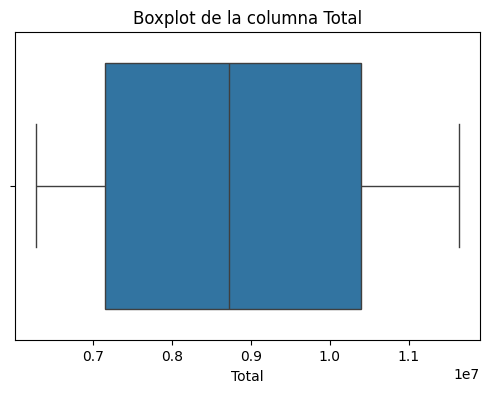

In [28]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [29]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Accesos por rango.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Totales Accesos por rango.csv


In [30]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [31]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                        0.024172
Trimestre                  0.070729
Hasta 512 kbps             2.916638
Entre 512 Kbps y 1 Mbps    1.084979
Entre 1 Mbps y 6 Mbps     -0.166518
Entre 6 Mbps y 10 Mbps    -1.289947
Entre 10 Mbps y 20 Mbps    0.770545
Entre 20 Mbps y 30 Mbps    1.105722
Más de 30 Mbps             0.575531
OTROS                      0.147958
Total                      0.221127
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                       -1.186795
Trimestre                 -1.371727
Hasta 512 kbps             8.238244
Entre 512 Kbps y 1 Mbps    0.055308
Entre 1 Mbps y 6 Mbps     -1.353750
Entre 6 Mbps y 10 Mbps     1.240613
Entre 10 Mbps y 20 Mbps    0.557800
Entre 20 Mbps y 30 Mbps    0.880793
Más de 30 Mbps            -1.297937
OTROS                     -1.156481
Total                     -1.326602
dtype: float64


In [32]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                   Variable           VIF
0                     const  2.942158e+08
1                       Año  6.713369e+02
2                 Trimestre  8.595953e+00
3            Hasta 512 kbps           inf
4   Entre 512 Kbps y 1 Mbps           inf
5     Entre 1 Mbps y 6 Mbps           inf
6    Entre 6 Mbps y 10 Mbps           inf
7   Entre 10 Mbps y 20 Mbps           inf
8   Entre 20 Mbps y 30 Mbps           inf
9            Más de 30 Mbps           inf
10                    OTROS           inf
11                    Total           inf


c:\Program Files\Python313\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


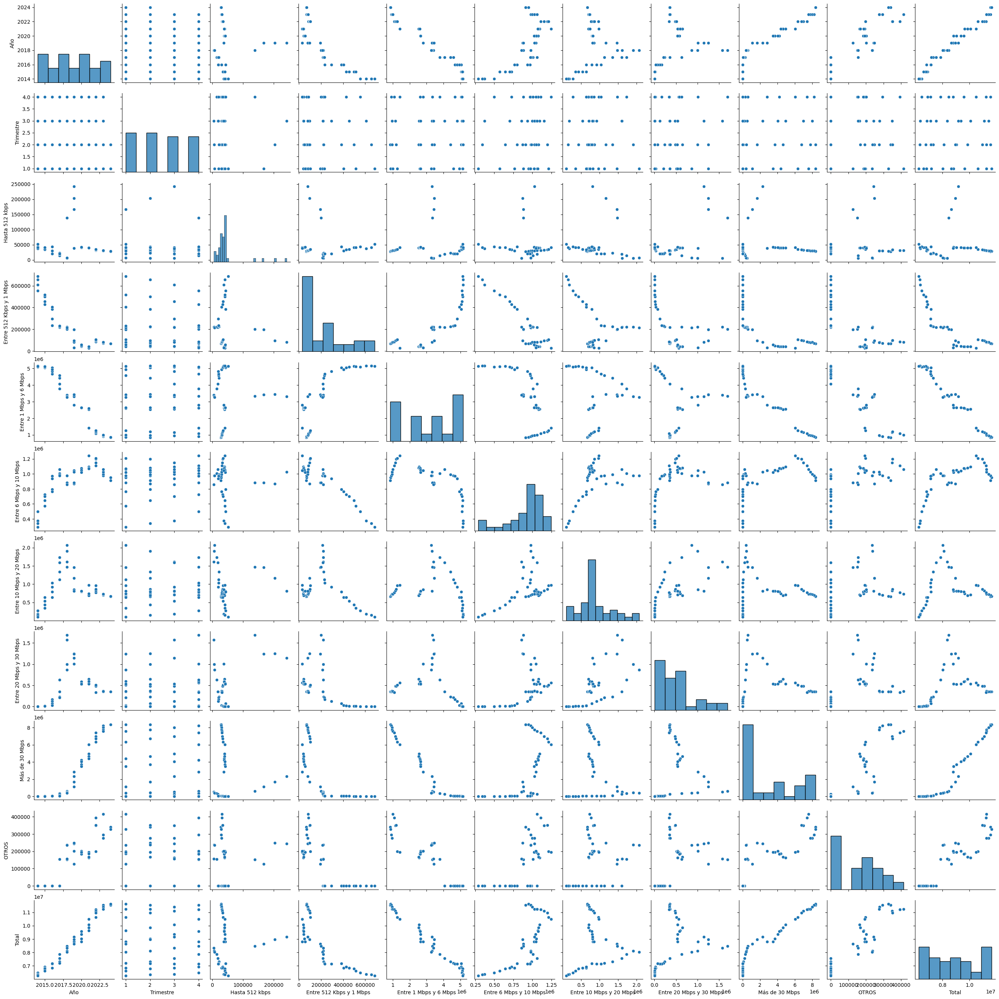

In [33]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [34]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Año_Trimestre':
                Año                                                      \
              count    mean std     min     25%     50%     75%     max   
Año_Trimestre                                                             
Q1-2014         1.0  2014.0 NaN  2014.0  2014.0  2014.0  2014.0  2014.0   
Q1-2015         1.0  2015.0 NaN  2015.0  2015.0  2015.0  2015.0  2015.0   
Q1-2016         1.0  2016.0 NaN  2016.0  2016.0  2016.0  2016.0  2016.0   
Q1-2017         1.0  2017.0 NaN  2017.0  2017.0  2017.0  2017.0  2017.0   
Q1-2018         1.0  2018.0 NaN  2018.0  2018.0  2018.0  2018.0  2018.0   
Q1-2019         1.0  2019.0 NaN  2019.0  2019.0  2019.0  2019.0  2019.0   
Q1-2020         1.0  2020.0 NaN  2020.0  2020.0  2020.0  2020.0  2020.0   
Q1-2021         1.0  2021.0 NaN  2021.0  2021.0  2021.0  2021.0  2021.0   
Q1-2022         1.0  2022.0 NaN  2022.0  2022.0  2022.0  2022.0  2022.0   
Q1-2023         1.0  2023.0 NaN  2023.0  2023.0  2023.0 

In [4]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Accesos_tecnologia_localidad.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [5]:
print(df.head())

      Provincia     Partido   Localidad    Tecnologia Link Indec  Accesos
0  BUENOS AIRES  25 de Mayo  25 de Mayo          ADSL    6854100    755.0
1  BUENOS AIRES  25 de Mayo  25 de Mayo    CABLEMODEM    6854100   4600.0
2  BUENOS AIRES  25 de Mayo  25 de Mayo  FIBRA OPTICA    6854100      2.0
3  BUENOS AIRES  25 de Mayo  25 de Mayo     SATELITAL    6854100    742.0
4  BUENOS AIRES  25 de Mayo  25 de Mayo      WIRELESS    6854100    727.0


In [6]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7753 entries, 0 to 7752
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provincia   7753 non-null   object 
 1   Partido     7753 non-null   object 
 2   Localidad   7753 non-null   object 
 3   Tecnologia  7753 non-null   object 
 4   Link Indec  7753 non-null   object 
 5   Accesos     7747 non-null   float64
dtypes: float64(1), object(5)
memory usage: 363.6+ KB
None


In [7]:
## Verificar si las columnas "Año" y "Trimestre" existen
#if 'Año' in df.columns and 'Trimestre' in df.columns:
#    # Crear una nueva columna con el formato "Qx-YYYY"
#    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)
#
## Verificar si la columna "Periodo" existe
#if 'Periodo' in df.columns:
#    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
#    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
#    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
#else:
#    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
#    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
#    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2
#
## Asignar la abreviación de los meses según el trimestre
#def obtener_meses_periodo(trimestre):
#    if trimestre == 1:
#        return 'ene - mar'
#    elif trimestre == 2:
#        return 'abr - jun'
#    elif trimestre == 3:
#        return 'jul - sep'
#    elif trimestre == 4:
#        return 'oct - dic'
#    else:
#        return 'N/A'  # Para trimestres no válidos
#
## Aplicar la función para crear la columna "meses_periodo"
#df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)
#
## Mostrar el DataFrame con las nuevas columnas
#print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

In [8]:
print(df.head())

      Provincia     Partido   Localidad    Tecnologia Link Indec  Accesos
0  BUENOS AIRES  25 de Mayo  25 de Mayo          ADSL    6854100    755.0
1  BUENOS AIRES  25 de Mayo  25 de Mayo    CABLEMODEM    6854100   4600.0
2  BUENOS AIRES  25 de Mayo  25 de Mayo  FIBRA OPTICA    6854100      2.0
3  BUENOS AIRES  25 de Mayo  25 de Mayo     SATELITAL    6854100    742.0
4  BUENOS AIRES  25 de Mayo  25 de Mayo      WIRELESS    6854100    727.0


In [9]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Error al convertir la columna 'Link Indec' a <class 'int'>: invalid literal for int() with base 10: 'Sin Datos'
Provincia      object
Partido        object
Localidad      object
Tecnologia     object
Link Indec     object
Accesos       float64
dtype: object


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7753 entries, 0 to 7752
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provincia   7753 non-null   object 
 1   Partido     7753 non-null   object 
 2   Localidad   7753 non-null   object 
 3   Tecnologia  7753 non-null   object 
 4   Link Indec  7753 non-null   object 
 5   Accesos     7747 non-null   float64
dtypes: float64(1), object(5)
memory usage: 363.6+ KB
None


In [11]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [12]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CABA' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CORDOBA' 'CORRIENTES'
 'ENTRE RIOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUEN' 'RIO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMAN']

Valores únicos en 'Partido' después de la normalización:
['25 DE MAYO' '9 DE JULIO' 'ADOLFO ALSINA' 'ADOLFO GONZALES CHAVES'
 'ALBERTI' 'ALMIRANTE BROWN' 'AMBA' 'ARRECIFES' 'AVELLANEDA' 'AYACUCHO'
 'AZUL' 'BAHÍA BLANCA' 'BALCARCE' 'BARADERO' 'BENITO JUÁREZ' 'BERAZATEGUI'
 'BERISSO' 'BOLÍVAR' 'BRAGADO' 'BRANDSEN' 'CAMPANA' 'CAÑUELAS'
 'CAPITÁN SARMIENTO' 'CARLOS CASARES' 'CARLOS TEJEDOR' 'CARMEN DE ARECO'
 'CASTELLI' 'CHACABUCO' 'CHASCOMÚS' 'CHIVILCOY' 'COLÓN'
 'CORONEL DE MARINA L. ROSALES' 'CORONEL DORREGO' 'CORONEL PRINGLES'
 'CORONEL SUÁREZ' 'DAIREAUX' 'DOLORES' 'ENSENADA' 'ESCOBAR'
 'ESTEBAN ECHEVERRÍA' 'EXALTACIÓN DE LA CRUZ' 'EZEIZA' 'FLORENCIO 

In [13]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7753 entries, 0 to 7752
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provincia   7753 non-null   object 
 1   Partido     7753 non-null   object 
 2   Localidad   7753 non-null   object 
 3   Tecnologia  7753 non-null   object 
 4   Link Indec  7753 non-null   object 
 5   Accesos     7747 non-null   float64
dtypes: float64(1), object(5)
memory usage: 363.6+ KB
None


In [14]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

Valores únicos en 'Partido' después de los reemplazos:
['25 DE MAYO' '9 DE JULIO' 'ADOLFO ALSINA' 'ADOLFO GONZALES CHAVES'
 'ALBERTI' 'ALMIRANTE BROWN' 'AMBA' 'ARRECIFES' 'AVELLANEDA' 'AYACUCHO'
 'AZUL' 'BAHÍA BLANCA' 'BALCARCE' 'BARADERO' 'BENITO JUÁREZ' 'BERAZATEGUI'
 'BERISSO' 'BOLÍVAR' 'BRAGADO' 'BRANDSEN' 'CAMPANA' 'CAÑUELAS'
 'CAPITÁN SARMIENTO' 'CARLOS CASARES' 'CARLOS TEJEDOR' 'CARMEN DE ARECO'
 'CASTELLI' 'CHACABUCO' 'CHASCOMÚS' 'CHIVILCOY' 'COLÓN'
 'CORONEL DE MARINA L. ROSALES' 'CORONEL DORREGO' 'CORONEL PRINGLES'
 'CORONEL SUÁREZ' 'DAIREAUX' 'DOLORES' 'ENSENADA' 'ESCOBAR'
 'ESTEBAN ECHEVERRÍA' 'EXALTACIÓN DE LA CRUZ' 'EZEIZA' 'FLORENCIO VARELA'
 'F

In [15]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7753 entries, 0 to 7752
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provincia   7753 non-null   object 
 1   Partido     7753 non-null   object 
 2   Localidad   7753 non-null   object 
 3   Tecnologia  7753 non-null   object 
 4   Link Indec  7753 non-null   object 
 5   Accesos     7747 non-null   float64
dtypes: float64(1), object(5)
memory usage: 363.6+ KB
None


In [16]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [17]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [18]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [19]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [20]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Provincia     0
Partido       0
Localidad     0
Tecnologia    0
Link Indec    0
Accesos       6
dtype: int64


In [21]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Provincia     0
Partido       0
Localidad     0
Tecnologia    0
Link Indec    0
Accesos       6
dtype: int64


In [22]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Provincia     0
Partido       0
Localidad     0
Tecnologia    0
Link Indec    0
Accesos       6
dtype: int64

Columna 'Accesos' tiene 6 valores nulos (0.08%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_3732\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [23]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7753 entries, 0 to 7752
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Provincia   7753 non-null   object 
 1   Partido     7753 non-null   object 
 2   Localidad   7753 non-null   object 
 3   Tecnologia  7753 non-null   object 
 4   Link Indec  7753 non-null   object 
 5   Accesos     7753 non-null   float64
dtypes: float64(1), object(5)
memory usage: 363.6+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
           Provincia    Partido Localidad Tecnologia Link Indec       Accesos
count           7753       7753      7753       7753       7753  7.753000e+03
unique            23        432      2788         10       2671           NaN
top     BUENOS AIRES  SAN JUSTO     OTROS   WIRELESS    6427010           NaN
freq            2320        136        76       2223         89           NaN
mean             NaN        NaN       NaN        NaN        NaN  1.491688e+03
std              NaN        NaN       NaN        NaN        NaN  1.519585e+04
min              NaN        NaN       NaN        NaN        NaN  0.000000e+00
25%              NaN        NaN       NaN        NaN        NaN  3.000000e+00
50%              NaN        NaN       NaN        NaN        NaN  5.900000e+01
75%              NaN        NaN       NaN        NaN        NaN  4.030000e+02
max              NaN        NaN       NaN        NaN        NaN  1.1

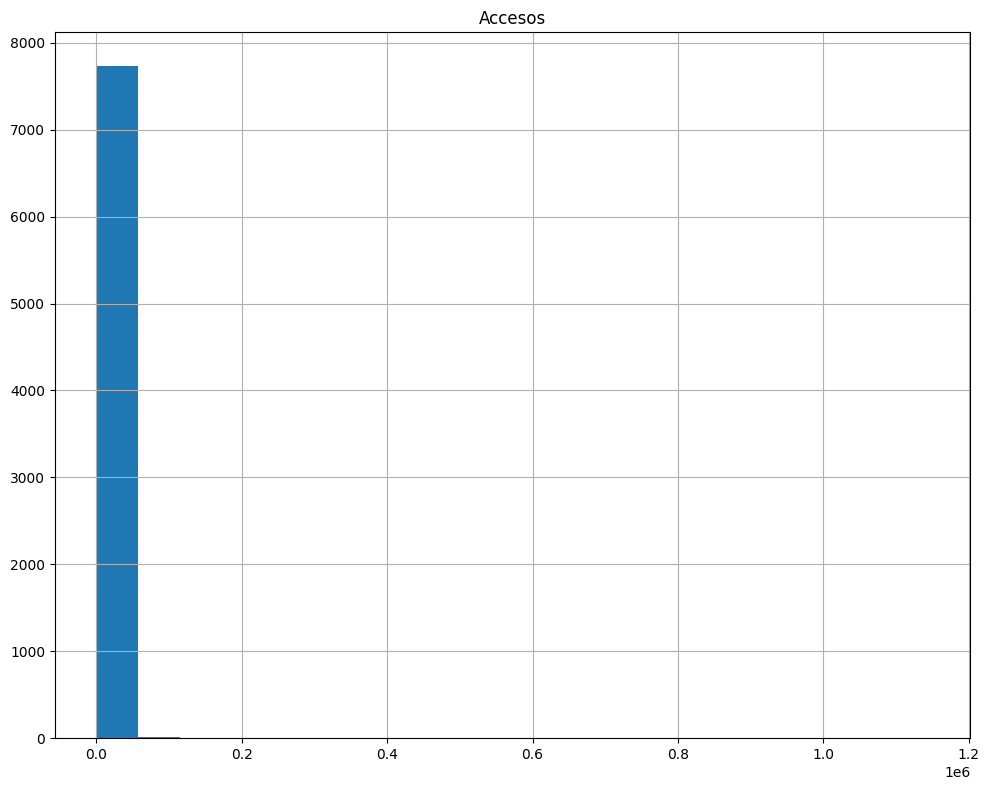

In [24]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
         Accesos
Accesos      1.0

Correlaciones fuertes:
         Accesos
Accesos      1.0


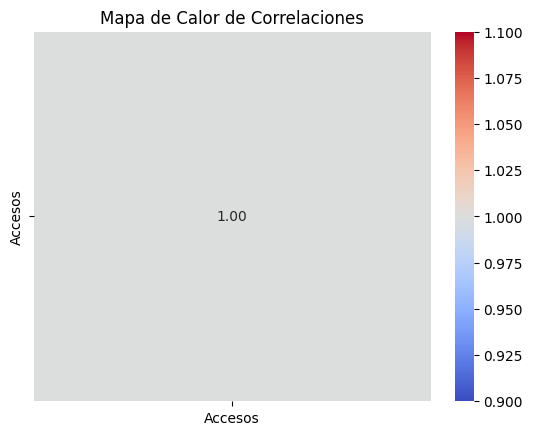

In [25]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()

In [26]:
## Correlación entre columnas no numéricas usando tablas de contingencia
#categorical_columns = df.select_dtypes(include=['object']).columns
#
#for i in range(len(categorical_columns)):
#    for j in range(i + 1, len(categorical_columns)):
#        col1 = categorical_columns[i]
#        col2 = categorical_columns[j]
#        
#        # Crear tabla de contingencia
#        tabla_contingencia = pd.crosstab(df[col1], df[col2])
#        
#        # Mostrar tabla de contingencia solo si tiene datos
#        if not tabla_contingencia.empty:
#            print(f"\nTabla de contingencia entre {col1} y {col2}:")
#            print(tabla_contingencia)
#            
#            # Visualización de la tabla de contingencia
#            plt.figure(figsize=(10, 6))
#            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
#            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
#            plt.xlabel(col2)
#            plt.ylabel(col1)
#            plt.show()


Estadísticas descriptivas de 'Accesos' agrupadas por 'Provincia':
                      count         mean           std  min    25%    50%  \
Provincia                                                                   
BUENOS AIRES         2320.0  2781.456466  25317.271522  0.0   7.00  109.5   
CATAMARCA             130.0   577.492308   4420.528525  1.0   1.00    5.5   
CHACO                 201.0   731.800995   4512.900189  1.0   3.00   57.0   
CHUBUT                140.0  1244.450000   3951.664333  1.0   1.00   21.0   
CORRIENTES            168.0   940.277905   5602.301779  0.0   1.00   10.0   
CÓRDOBA               889.0  1221.343082  12125.675237  1.0   8.00   81.0   
ENTRE RÍOS            310.0   954.202219   5058.705571  0.0  15.00   93.0   
FORMOSA               127.0   495.669291   2131.095646  0.0   3.00   31.0   
JUJUY                 166.0   720.987952   4557.098180  1.0   3.00   10.0   
LA PAMPA              237.0   520.097046   3210.622812  1.0   1.00   26.0   
LA RIOJA 

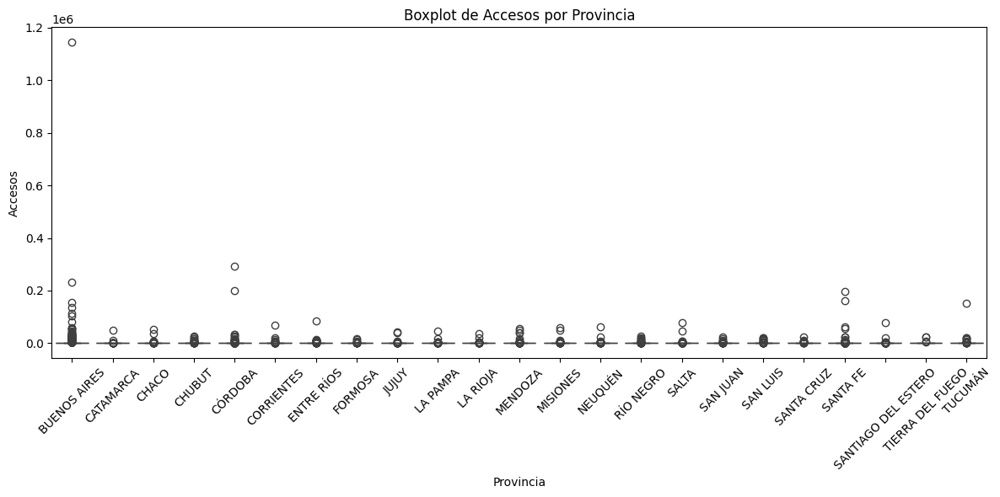


Estadísticas descriptivas de 'Accesos' agrupadas por 'Partido':
               count         mean          std    min    25%    50%      75%  \
Partido                                                                        
12 DE OCTUBRE    9.0   105.666667   202.551228    1.0    2.0   26.0   113.00   
1º DE MAYO       7.0   101.857143   120.258650    1.0    6.5   77.0   148.50   
2 DE ABRIL       5.0   160.600000   201.585714    1.0   28.0   52.0   244.00   
25 DE MAYO      63.0   232.555556   605.289048    1.0    9.5   58.0   194.50   
9 DE JULIO      57.0   384.368421  1095.659107    1.0    2.0   40.0   130.00   
...              ...          ...          ...    ...    ...    ...      ...   
ZAPALA          10.0   633.300000  1050.272563    1.0    5.5   25.5   953.75   
ZONDA            1.0   386.000000          NaN  386.0  386.0  386.0   386.00   
ZÁRATE          10.0  3215.300000  8458.973789    1.0   22.5  616.5  1157.25   
ÑORQUINCÓ        3.0     3.333333     3.214550    1.0  

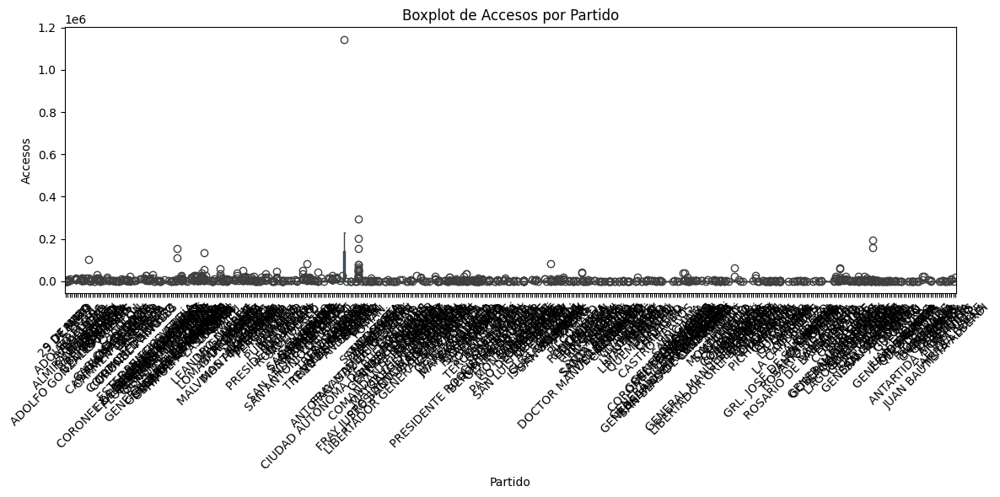


Estadísticas descriptivas de 'Accesos' agrupadas por 'Localidad':
                  count     mean           std    min     25%    50%      75%  \
Localidad                                                                       
11 DE OCTUBRE       2.0   225.00    272.943218   32.0  128.50  225.0   321.50   
11 DE SEPTIEMBRE    4.0   324.75    642.169954    1.0    3.25    5.0   326.50   
12 DE OCTUBRE       1.0    19.00           NaN   19.0   19.00   19.0    19.00   
1º DE MAYO          1.0   139.00           NaN  139.0  139.00  139.0   139.00   
20 DE JUNIO         5.0   373.00    523.613407    2.0    2.00    4.0   744.00   
...                 ...      ...           ...    ...     ...    ...      ...   
ZÁRATE              6.0  5195.50  10812.856436    5.0  574.75  971.0  1398.75   
ÁLVAREZ             4.0   383.00    676.180942    2.0    2.75   68.5   448.75   
ÁRRAGA              4.0    21.75     40.836054    1.0    1.00    1.5    22.25   
ÑANDUCITA           1.0    37.00          

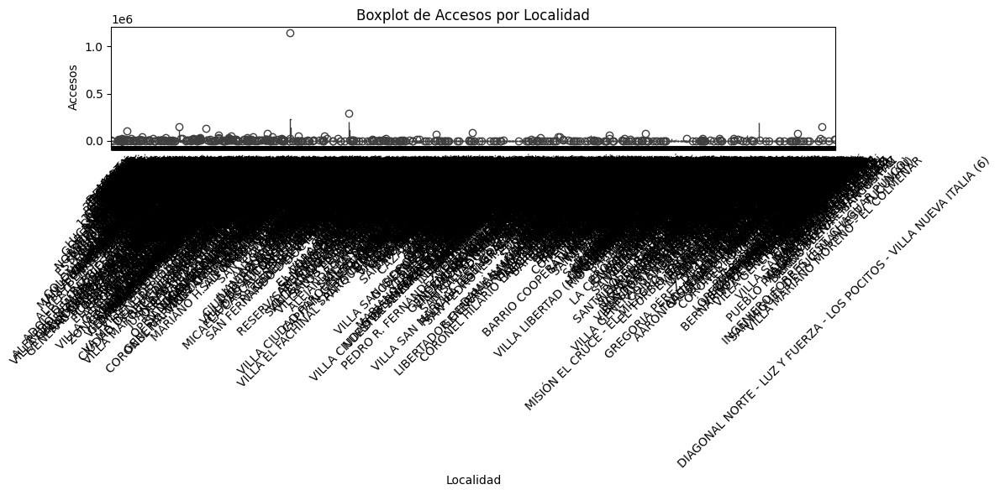


Estadísticas descriptivas de 'Accesos' agrupadas por 'Tecnologia':
               count          mean           std     min       25%      50%  \
Tecnologia                                                                    
ADSL          1107.0    662.593496   2213.769428     0.0     47.50    199.0   
CABLEMODEM     834.0   6792.461631  42052.063201     0.0    162.25   1047.5   
Cablemodem       6.0  33765.166667  28224.175343  6267.0  14800.75  24778.5   
DIAL UP        376.0     31.364362    120.019566     0.0      1.00      4.0   
FIBRA OPTICA  1576.0   2645.912437  12956.388868     1.0      6.00    152.0   
OTROS           27.0   1322.666667   5442.703302     0.0      1.00      1.0   
Otros          597.0    248.298372   1310.375452     0.0      2.00     13.0   
SATELITAL      993.0      2.950655     23.824683     1.0      1.00      1.0   
WIMAX           14.0    159.857143    164.686115     2.0     26.75     91.0   
WIRELESS      2223.0    266.845254    838.618638     0.0     19

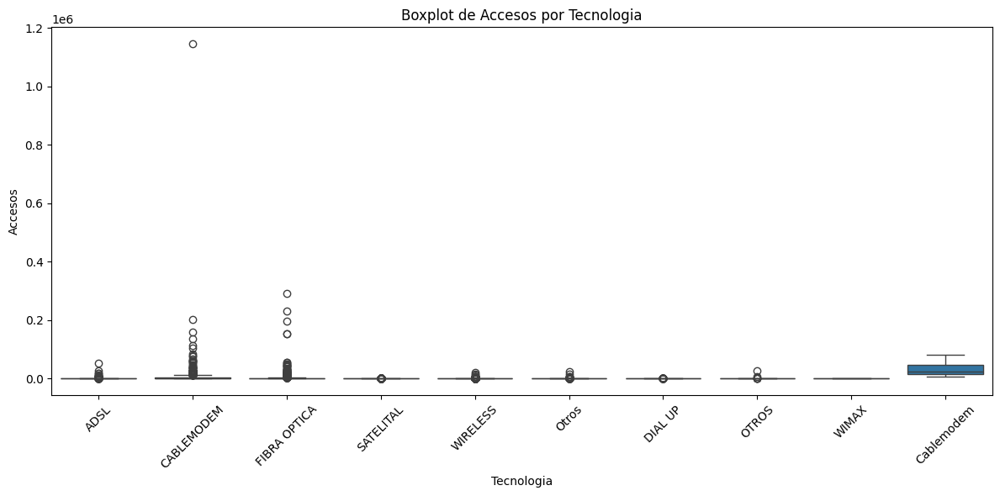


Estadísticas descriptivas de 'Accesos' agrupadas por 'Link Indec':
            count         mean          std   min    25%    50%      75%  \
Link Indec                                                                 
10007030      1.0     1.000000          NaN   1.0   1.00    1.0     1.00   
10007040      2.0    76.500000   106.773124   1.0  38.75   76.5   114.25   
10007060      1.0     5.000000          NaN   5.0   5.00    5.0     5.00   
10007070      1.0     1.000000          NaN   1.0   1.00    1.0     1.00   
10007100      1.0    66.000000          NaN  66.0  66.00   66.0    66.00   
...           ...          ...          ...   ...    ...    ...      ...   
94007010      7.0  4686.571429  8817.864667   1.0   8.50  135.0  4331.00   
94007020      4.0    80.000000   117.629361   2.0   2.75   33.5   110.75   
94014010      1.0     1.000000          NaN   1.0   1.00    1.0     1.00   
94014020      7.0  4039.857143  8806.478003   3.0  57.00  170.0  2062.00   
Sin Datos    81.0   

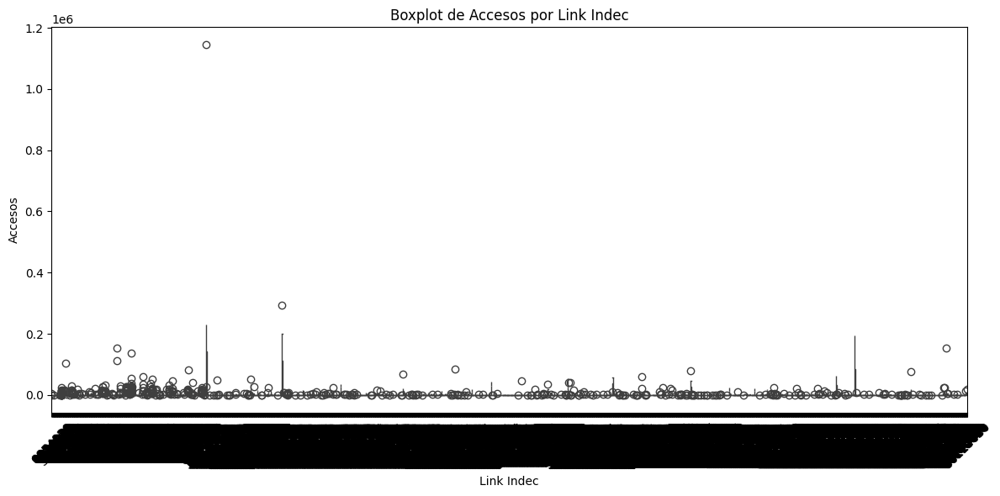

In [27]:
# Definir columnas categóricas y numéricas
categorical_columns = df.select_dtypes(include=['object']).columns
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [28]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
       Accesos
0    -0.048483
1     0.204563
2    -0.098039
3    -0.049338
4    -0.050325
...        ...
7748 -0.089681
7749 -0.093169
7750  1.083149
7751 -0.095999
7752 -0.098105

[7753 rows x 1 columns]


In [29]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           2320
CÓRDOBA                 889
SANTA FE                852
SANTIAGO DEL ESTERO     334
SALTA                   322
ENTRE RÍOS              310
MENDOZA                 272
LA PAMPA                237
RÍO NEGRO               234
MISIONES                201
CHACO                   201
CORRIENTES              168
JUJUY                   166
SAN LUIS                166
NEUQUÉN                 155
LA RIOJA                152
CHUBUT                  140
TUCUMÁN                 140
SAN JUAN                134
CATAMARCA               130
FORMOSA                 127
SANTA CRUZ               81
TIERRA DEL FUEGO         22
Name: count, dtype: int64

Conteo de categorías en la columna 'Partido':
Partido
SAN JUSTO                   136
CAPITAL                     124
GENERAL SAN MARTÍN          118
COLÓN                       100
GENERAL ROCA                 94
                           ... 
ANTOFAGASTA DE LA SIERRA

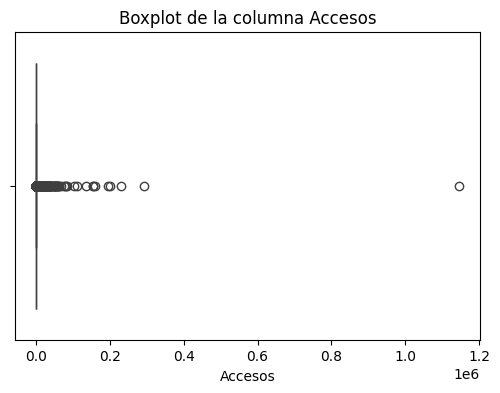

In [30]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [31]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos_tecnologia_localidad.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos_tecnologia_localidad.csv


In [32]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [33]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Accesos    57.668872
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Accesos    4171.27555
dtype: float64


In [34]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
  Variable       VIF
0    const  1.009637
1  Accesos  1.000000


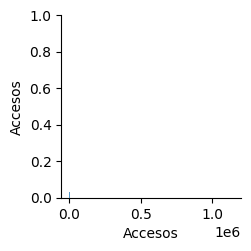

In [35]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [36]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                    Accesos                                                \
                      count         mean           std  min    25%    50%   
Provincia                                                                   
BUENOS AIRES         2320.0  2781.456466  25317.271522  0.0   7.00  109.5   
CATAMARCA             130.0   577.492308   4420.528525  1.0   1.00    5.5   
CHACO                 201.0   731.800995   4512.900189  1.0   3.00   57.0   
CHUBUT                140.0  1244.450000   3951.664333  1.0   1.00   21.0   
CORRIENTES            168.0   940.277905   5602.301779  0.0   1.00   10.0   
CÓRDOBA               889.0  1221.343082  12125.675237  1.0   8.00   81.0   
ENTRE RÍOS            310.0   954.202219   5058.705571  0.0  15.00   93.0   
FORMOSA               127.0   495.669291   2131.095646  0.0   3.00   31.0   
JUJUY                 166.0   720.987952   4557.098180  1.0   3.00   10.0   
LA PAMPA              237.0   520.09

In [72]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Velocidad_sin_Rangos.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [73]:
print(df.head())

    Año  Trimestre     Provincia  Velocidad  Accesos
0  2024          2  BUENOS AIRES       75.0     1062
1  2024          2  BUENOS AIRES       59.0       59
2  2024          2  BUENOS AIRES      480.0        5
3  2024          2  BUENOS AIRES        3.5    41735
4  2024          2  BUENOS AIRES       18.0     1042


In [74]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18884 entries, 0 to 18883
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Año        18884 non-null  int64  
 1   Trimestre  18884 non-null  int64  
 2   Provincia  18884 non-null  object 
 3   Velocidad  18874 non-null  float64
 4   Accesos    18884 non-null  int64  
dtypes: float64(1), int64(3), object(1)
memory usage: 737.8+ KB
None


In [75]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

        Año  Trimestre Año_Trimestre meses_periodo
0      2024          2       Q2-2024     abr - jun
1      2024          2       Q2-2024     abr - jun
2      2024          2       Q2-2024     abr - jun
3      2024          2       Q2-2024     abr - jun
4      2024          2       Q2-2024     abr - jun
...     ...        ...           ...           ...
18879  2017          4       Q4-2017     oct - dic
18880  2017          4       Q4-2017     oct - dic
18881  2017          4       Q4-2017     oct - dic
18882  2017          4       Q4-2017     oct - dic
18883  2017          4       Q4-2017     oct - dic

[18884 rows x 4 columns]


In [76]:
print(df.head())

    Año  Trimestre     Provincia  Velocidad  Accesos Año_Trimestre  \
0  2024          2  BUENOS AIRES       75.0     1062       Q2-2024   
1  2024          2  BUENOS AIRES       59.0       59       Q2-2024   
2  2024          2  BUENOS AIRES      480.0        5       Q2-2024   
3  2024          2  BUENOS AIRES        3.5    41735       Q2-2024   
4  2024          2  BUENOS AIRES       18.0     1042       Q2-2024   

      Periodo meses_periodo  
0  01-03-2024     abr - jun  
1  01-03-2024     abr - jun  
2  01-03-2024     abr - jun  
3  01-03-2024     abr - jun  
4  01-03-2024     abr - jun  


In [77]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                int64
Trimestre          int64
Provincia         object
Velocidad        float64
Accesos          float64
Año_Trimestre     object
Periodo           object
meses_periodo     object
dtype: object


In [78]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18884 entries, 0 to 18883
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Año            18884 non-null  int64  
 1   Trimestre      18884 non-null  int64  
 2   Provincia      18884 non-null  object 
 3   Velocidad      18874 non-null  float64
 4   Accesos        18884 non-null  float64
 5   Año_Trimestre  18884 non-null  object 
 6   Periodo        18884 non-null  object 
 7   meses_periodo  18884 non-null  object 
dtypes: float64(2), int64(2), object(4)
memory usage: 1.2+ MB
None


In [79]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [80]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CABA' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CORDOBA' 'CORRIENTES'
 'ENTRE RIOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUEN' 'RIO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMAN'
 'CAPITAL FEDERAL' 'CÓRDOBA' 'ENTRE RÍOS' 'NEUQUÉN' 'RÍO NEGRO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [81]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18884 entries, 0 to 18883
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Año            18884 non-null  int64  
 1   Trimestre      18884 non-null  int64  
 2   Provincia      18884 non-null  object 
 3   Velocidad      18874 non-null  float64
 4   Accesos        18884 non-null  float64
 5   Año_Trimestre  18884 non-null  object 
 6   Periodo        18884 non-null  object 
 7   meses_periodo  18884 non-null  object 
dtypes: float64(2), int64(2), object(4)
memory usage: 1.2+ MB
None


In [82]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [83]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18884 entries, 0 to 18883
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Año            18884 non-null  int64  
 1   Trimestre      18884 non-null  int64  
 2   Provincia      18884 non-null  object 
 3   Velocidad      18874 non-null  float64
 4   Accesos        18884 non-null  float64
 5   Año_Trimestre  18884 non-null  object 
 6   Periodo        18884 non-null  object 
 7   meses_periodo  18884 non-null  object 
dtypes: float64(2), int64(2), object(4)
memory usage: 1.2+ MB
None


In [84]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [85]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [86]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [87]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [88]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año               0
Trimestre         0
Provincia         0
Velocidad        10
Accesos           0
Año_Trimestre     0
Periodo           0
meses_periodo     0
dtype: int64


In [89]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año               0
Trimestre         0
Provincia         0
Velocidad        10
Accesos           0
Año_Trimestre     0
Periodo           0
meses_periodo     0
dtype: int64


In [90]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año               0
Trimestre         0
Provincia         0
Velocidad        10
Accesos           0
Año_Trimestre     0
Periodo           0
meses_periodo     0
dtype: int64

Columna 'Velocidad' tiene 10 valores nulos (0.05%)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_15952\1176771631.py:15: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[column].fillna(df[column].mean(), inplace=True)


In [91]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18884 entries, 0 to 18883
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Año            18884 non-null  int64  
 1   Trimestre      18884 non-null  int64  
 2   Provincia      18884 non-null  object 
 3   Velocidad      18884 non-null  float64
 4   Accesos        18884 non-null  float64
 5   Año_Trimestre  18884 non-null  object 
 6   Periodo        18884 non-null  object 
 7   meses_periodo  18884 non-null  object 
dtypes: float64(2), int64(2), object(4)
memory usage: 1.2+ MB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                 Año     Trimestre     Provincia     Velocidad       Accesos  \
count   18884.000000  18884.000000         18884  18884.000000  1.888400e+04   
unique           NaN           NaN            23           NaN           NaN   
top              NaN           NaN  BUENOS AIRES           NaN           NaN   
freq             NaN           NaN          3046           NaN           NaN   
mean     2021.017104      2.477653           NaN     96.171156  1.412328e+04   
std         1.919740      1.126947           NaN    379.622345  6.856387e+04   
min      2017.000000      1.000000           NaN      0.000000  0.000000e+00   
25%      2019.000000      1.000000           NaN      4.000000  2.600000e+01   
50%      2021.000000      2.000000           NaN     12.300000  6.725000e+02   
75%      2023.000000      4.000000           NaN     50.100000  6.114000e+03   
max      2024.000000      4.000000           N

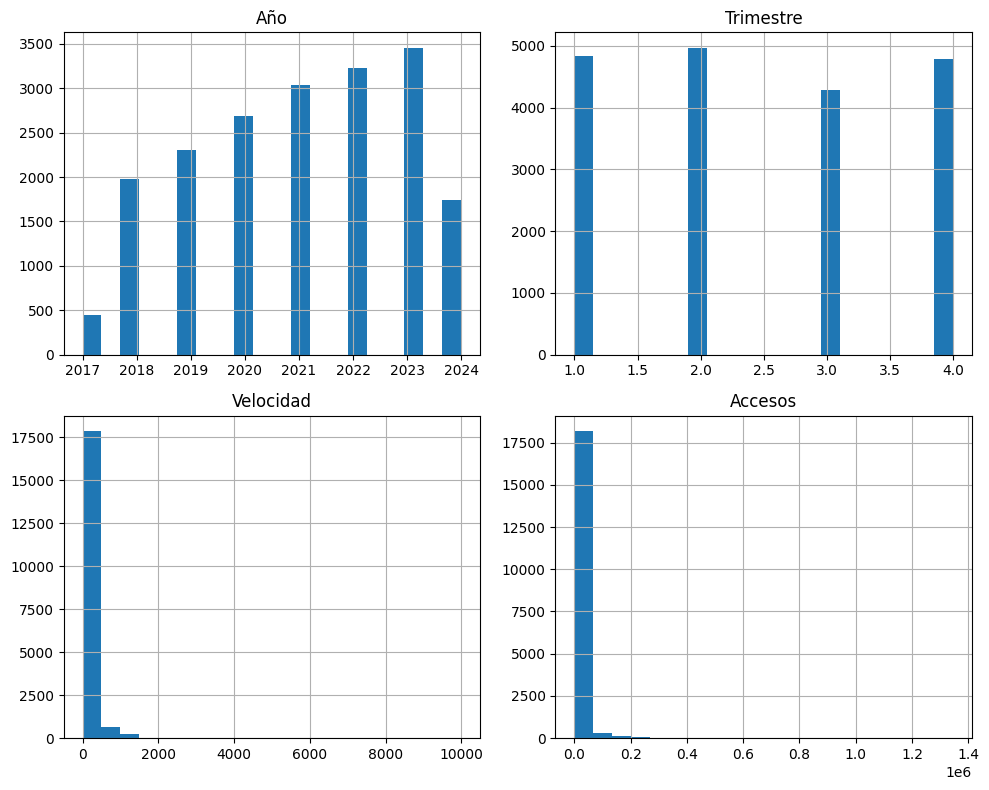

In [92]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                Año  Trimestre  Velocidad   Accesos
Año        1.000000  -0.208269   0.073159 -0.014967
Trimestre -0.208269   1.000000   0.000839 -0.000093
Velocidad  0.073159   0.000839   1.000000 -0.015584
Accesos   -0.014967  -0.000093  -0.015584  1.000000

Correlaciones fuertes:
           Año  Trimestre  Velocidad  Accesos
Año        1.0        NaN        NaN      NaN
Trimestre  NaN        1.0        NaN      NaN
Velocidad  NaN        NaN        1.0      NaN
Accesos    NaN        NaN        NaN      1.0


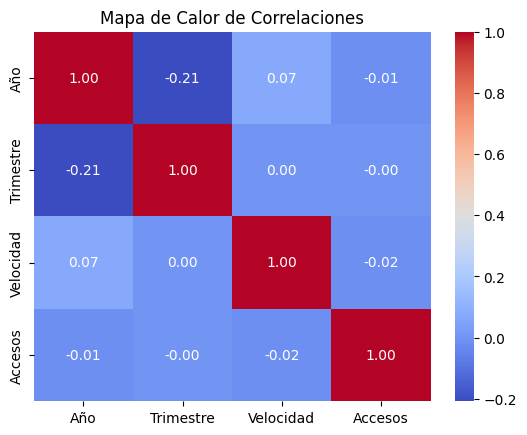

In [93]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2018  Q1-2019  Q1-2020  Q1-2021  Q1-2022  Q1-2023  \
Provincia                                                                   
BUENOS AIRES              70       73      101      131      130      142   
CATAMARCA                 11       14       18       21       21       22   
CHACO                     22       23       28       28       27       31   
CHUBUT                    16       19       21       25       28       31   
CORRIENTES                21       19       21       22       24       28   
CÓRDOBA                   25       32       44       53       53       61   
ENTRE RÍOS                24       23       26       32       27       32   
FORMOSA                   19       19       22       21       23       24   
JUJUY                     12       22       23       27       25       29   
LA PAMPA                  20       36       32       27       28       31   
LA RIOJA            

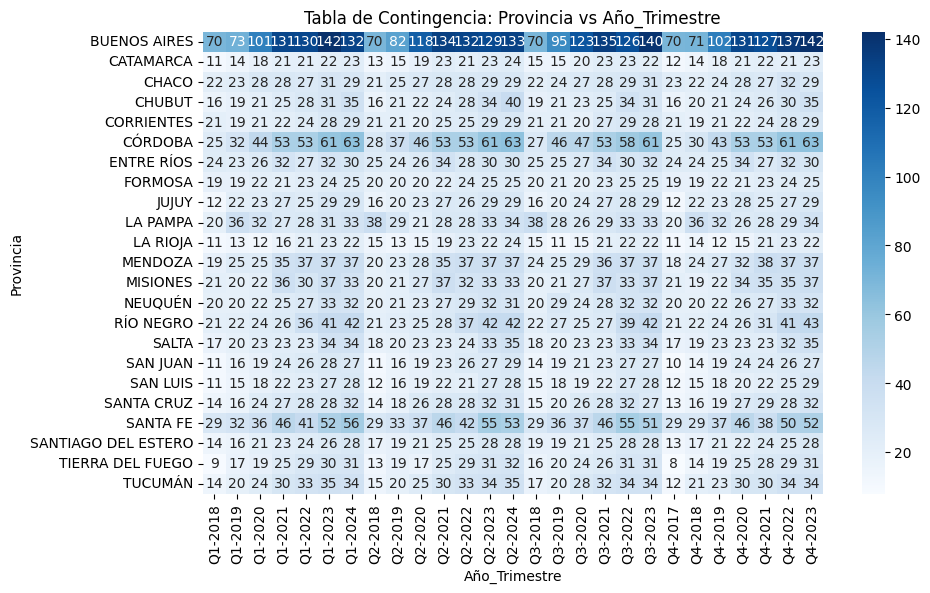


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES               3046
CATAMARCA                   517
CHACO                       721
CHUBUT                      685
CORRIENTES                  644
CÓRDOBA                    1292
ENTRE RÍOS                  760
FORMOSA                     596
JUJUY                       647
LA PAMPA                    810
LA RIOJA                    473
MENDOZA                     833
MISIONES                    780
NEUQUÉN                     707
RÍO NEGRO                   820
SALTA                       673
SAN JUAN                    577
SAN LUIS                    559
SANTA CRUZ                  658
SANTA FE                   1122
SANTIAGO DEL ESTERO         605
TIERRA DEL FUEGO            628
TUCUMÁN                     731


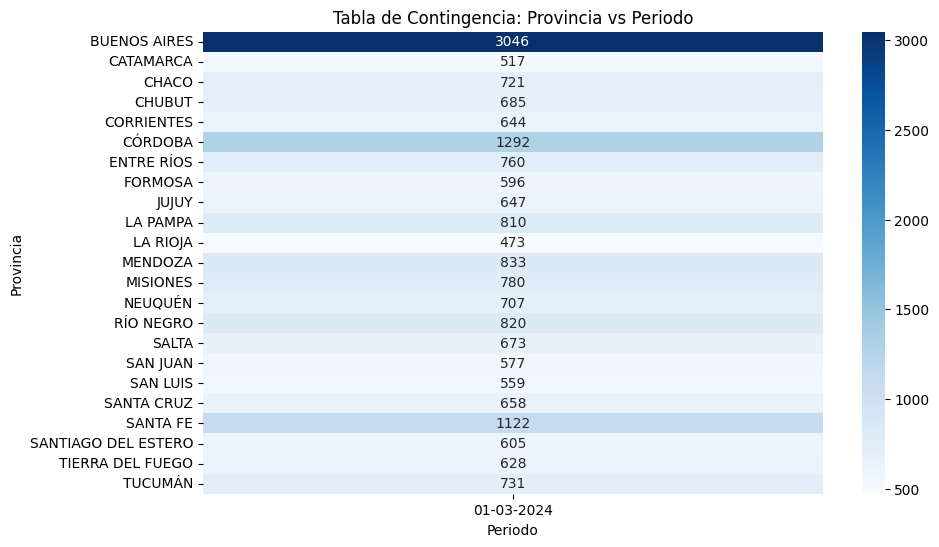


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES               798        779        689        780
CATAMARCA                  138        130        118        131
CHACO                      187        188        161        185
CHUBUT                     185        175        153        172
CORRIENTES                 170        164        146        164
CÓRDOBA                    341        331        292        328
ENTRE RÍOS                 197        194        173        196
FORMOSA                    156        153        134        153
JUJUY                      170        167        144        166
LA PAMPA                   211        207        187        205
LA RIOJA                   131        118        106        118
MENDOZA                    217        215        188        213
MISIONES                   203        199       

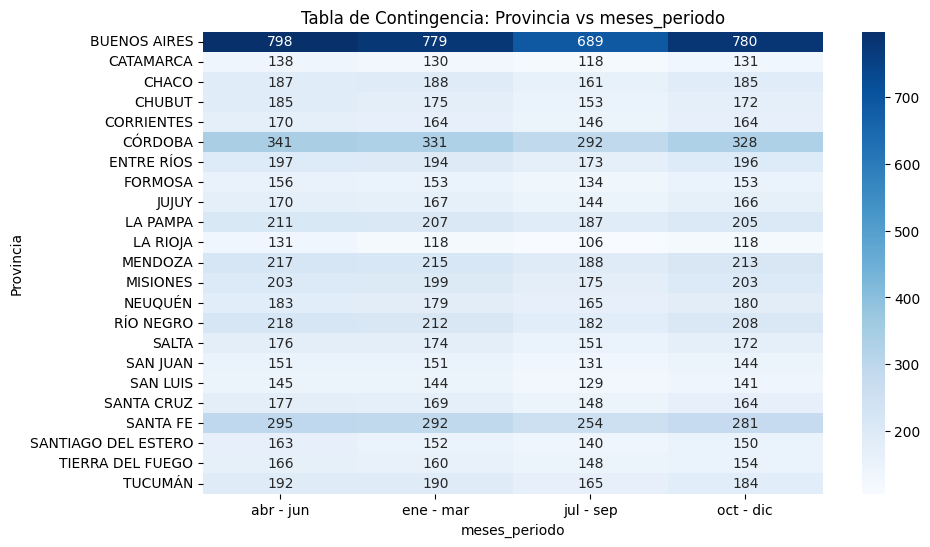


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2018               451
Q1-2019               532
Q1-2020               625
Q1-2021               745
Q1-2022               764
Q1-2023               862
Q1-2024               864
Q2-2018               493
Q2-2019               556
Q2-2020               647
Q2-2021               766
Q2-2022               779
Q2-2023               855
Q2-2024               874
Q3-2018               517
Q3-2019               601
Q3-2020               676
Q3-2021               778
Q3-2022               845
Q3-2023               862
Q4-2017               447
Q4-2018               521
Q4-2019               617
Q4-2020               738
Q4-2021               752
Q4-2022               839
Q4-2023               878


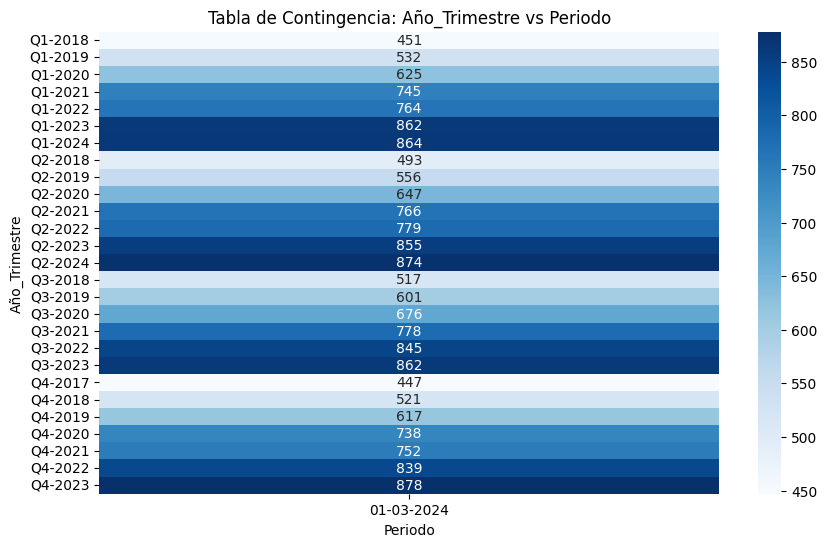


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2018                0        451          0          0
Q1-2019                0        532          0          0
Q1-2020                0        625          0          0
Q1-2021                0        745          0          0
Q1-2022                0        764          0          0
Q1-2023                0        862          0          0
Q1-2024                0        864          0          0
Q2-2018              493          0          0          0
Q2-2019              556          0          0          0
Q2-2020              647          0          0          0
Q2-2021              766          0          0          0
Q2-2022              779          0          0          0
Q2-2023              855          0          0          0
Q2-2024              874          0          0          0
Q3-2018     

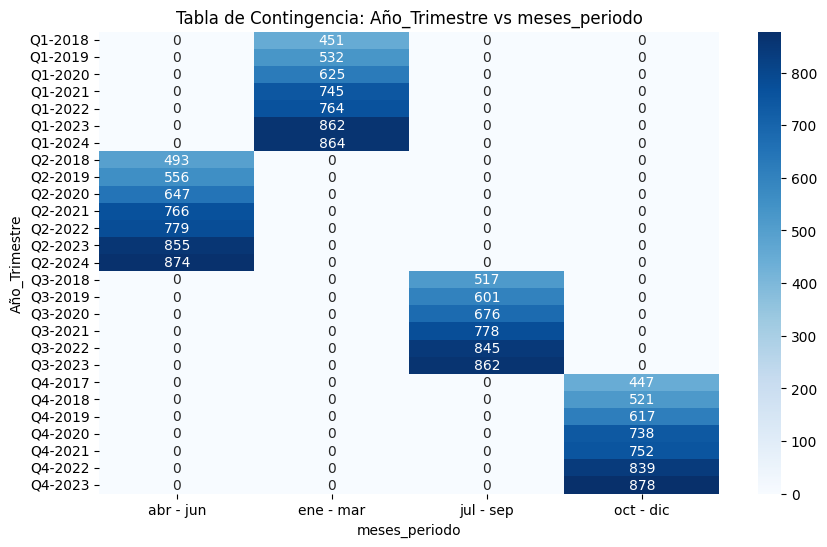


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024          4970       4843       4279       4792


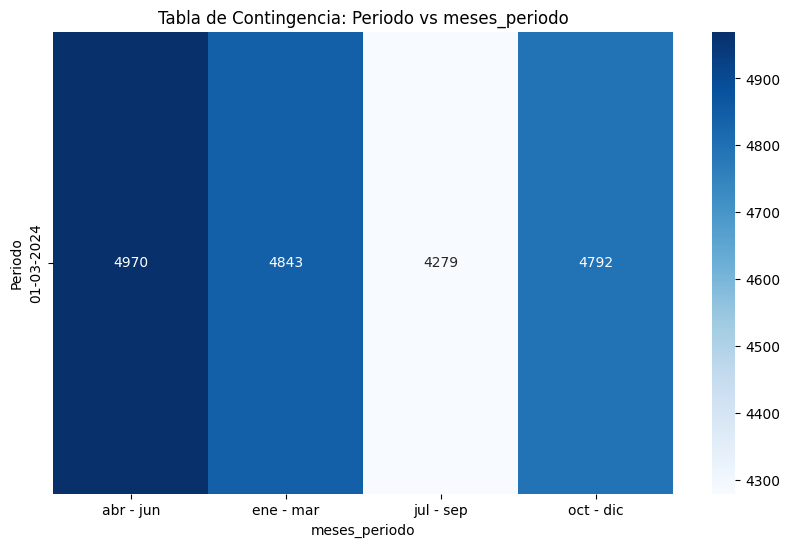

In [94]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                      count         mean       std     min     25%     50%  \
Provincia                                                                    
BUENOS AIRES         3046.0  2021.041366  1.869888  2017.0  2020.0  2021.0   
CATAMARCA             517.0  2020.996132  1.900628  2017.0  2020.0  2021.0   
CHACO                 721.0  2020.826630  1.951256  2017.0  2019.0  2021.0   
CHUBUT                685.0  2021.110949  1.958475  2017.0  2020.0  2021.0   
CORRIENTES            644.0  2020.892857  1.995955  2017.0  2019.0  2021.0   
CÓRDOBA              1292.0  2021.123065  1.874331  2017.0  2020.0  2021.0   
ENTRE RÍOS            760.0  2020.800000  1.951183  2017.0  2019.0  2021.0   
FORMOSA               596.0  2020.810403  1.982094  2017.0  2019.0  2021.0   
JUJUY                 647.0  2020.996909  1.893444  2017.0  2019.0  2021.0   
LA PAMPA              810.0  2020.691358  2.013809  2017.0  2019.0  2021.0   
L

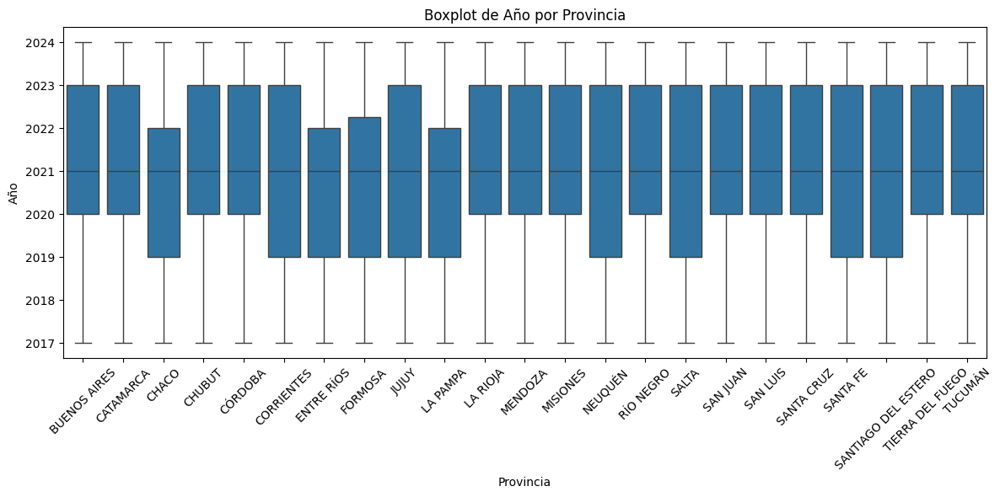


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                      count      mean       std  min  25%  50%   75%  max
Provincia                                                                
BUENOS AIRES         3046.0  2.482600  1.128607  1.0  1.0  2.0  4.00  4.0
CATAMARCA             517.0  2.483559  1.123317  1.0  1.0  2.0  4.00  4.0
CHACO                 721.0  2.475728  1.133961  1.0  1.0  2.0  4.00  4.0
CHUBUT                685.0  2.470073  1.124317  1.0  1.0  2.0  4.00  4.0
CORRIENTES            644.0  2.481366  1.127058  1.0  1.0  2.0  4.00  4.0
CÓRDOBA              1292.0  2.477554  1.127210  1.0  1.0  2.0  4.00  4.0
ENTRE RÍOS            760.0  2.488158  1.130423  1.0  1.0  2.0  4.00  4.0
FORMOSA               596.0  2.481544  1.130774  1.0  1.0  2.0  4.00  4.0
JUJUY                 647.0  2.477589  1.131744  1.0  1.0  2.0  4.00  4.0
LA PAMPA              810.0  2.481481  1.126280  1.0  1.0  2.0  4.00  4.0
LA RIOJA              473.0  2.473573  1.11

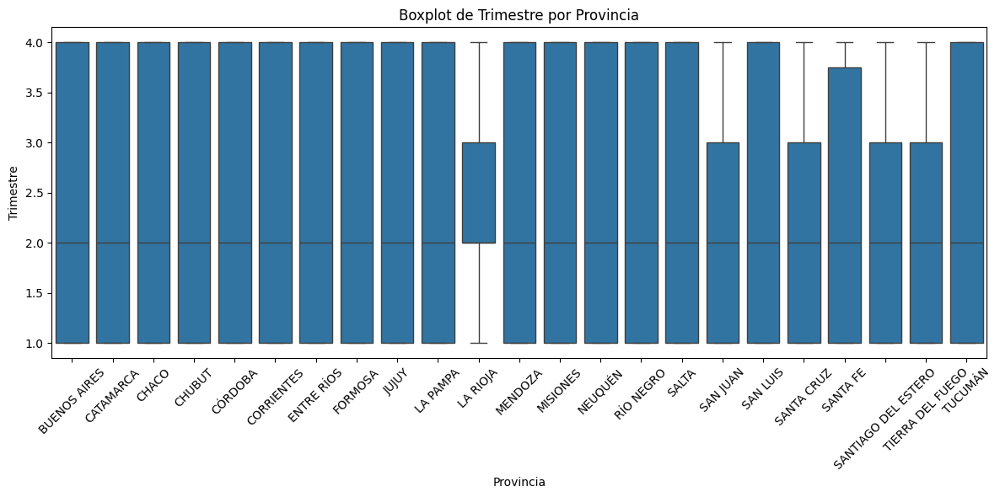


Estadísticas descriptivas de 'Velocidad' agrupadas por 'Provincia':
                      count        mean         std  min    25%   50%    75%  \
Provincia                                                                      
BUENOS AIRES         3046.0  147.541745  455.182201  0.0  9.000  35.0  122.0   
CATAMARCA             517.0  106.195621  463.350935  0.0  2.200  10.1   31.0   
CHACO                 721.0  103.959153  593.058781  0.0  3.200  10.0   31.0   
CHUBUT                685.0   39.750218  113.839888  0.0  3.200   9.0   25.1   
CORRIENTES            644.0   66.277009  171.624870  0.0  3.425  12.3   31.0   
CÓRDOBA              1292.0  105.227217  235.205257  0.0  6.000  17.0   71.0   
ENTRE RÍOS            760.0  106.936225  333.933242  0.0  4.000  12.3   46.0   
FORMOSA               596.0   49.587730  145.239023  0.0  3.200  10.1   25.1   
JUJUY                 647.0  128.456587  627.203125  0.0  4.250  12.3   50.1   
LA PAMPA              810.0   49.111742  113.416236

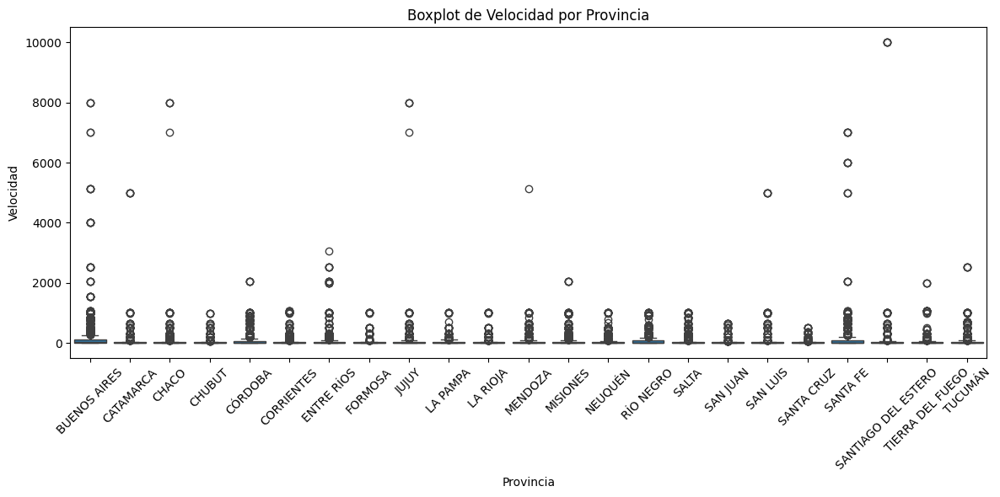


Estadísticas descriptivas de 'Accesos' agrupadas por 'Provincia':
                      count          mean            std  min     25%     50%  \
Provincia                                                                       
BUENOS AIRES         3046.0  50159.537098  158847.690088  0.0    5.00   238.0   
CATAMARCA             517.0   2779.982592    5481.953539  1.0   42.00   566.0   
CHACO                 721.0   4866.679612    8353.002655  1.0  225.00  1150.0   
CHUBUT                685.0   5231.179562   10596.360284  1.0   62.00   778.0   
CORRIENTES            644.0   5405.177019    7572.683795  1.0  480.00  2171.0   
CÓRDOBA              1292.0  18963.206656   48951.119422  1.0    8.00   311.0   
ENTRE RÍOS            760.0   8958.994737   14320.770914  1.0  113.00  2567.5   
FORMOSA               596.0   2358.753356    3245.103047  1.0  112.75   826.0   
JUJUY                 647.0   4079.893354    7551.845872  1.0   17.00   644.0   
LA PAMPA              810.0   3368.332099 

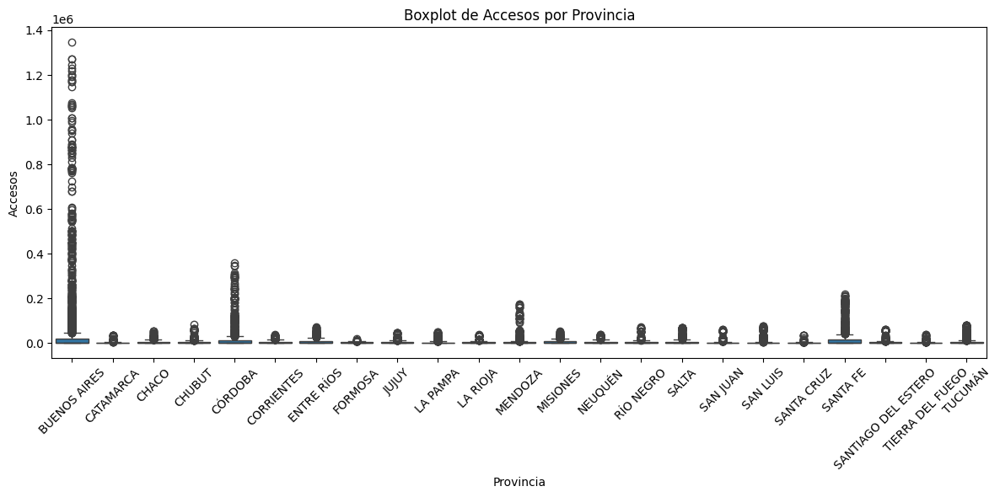


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2018        451.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019        532.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020        625.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021        745.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022        764.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023        862.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024        864.0  2024.0  0.0  2024.0  2024.0  2024.0  2024.0  2024.0
Q2-2018        493.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q2-2019        556.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q2-2020        647.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q2-2021        766.0  2021.0  0.0  2021.0  20

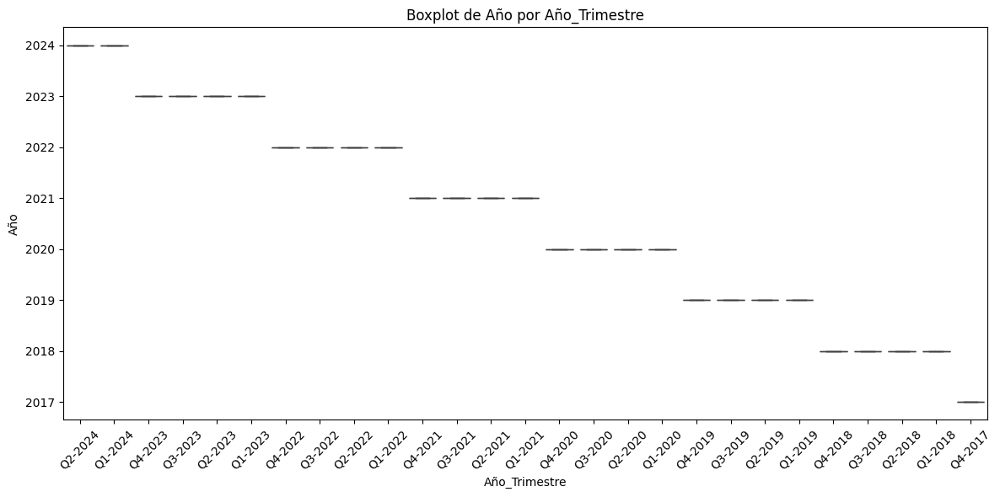


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2018        451.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019        532.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020        625.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021        745.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022        764.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023        862.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024        864.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2018        493.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2019        556.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2020        647.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2021        766.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2022        779.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2023        855.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2024        874.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q3-2018        

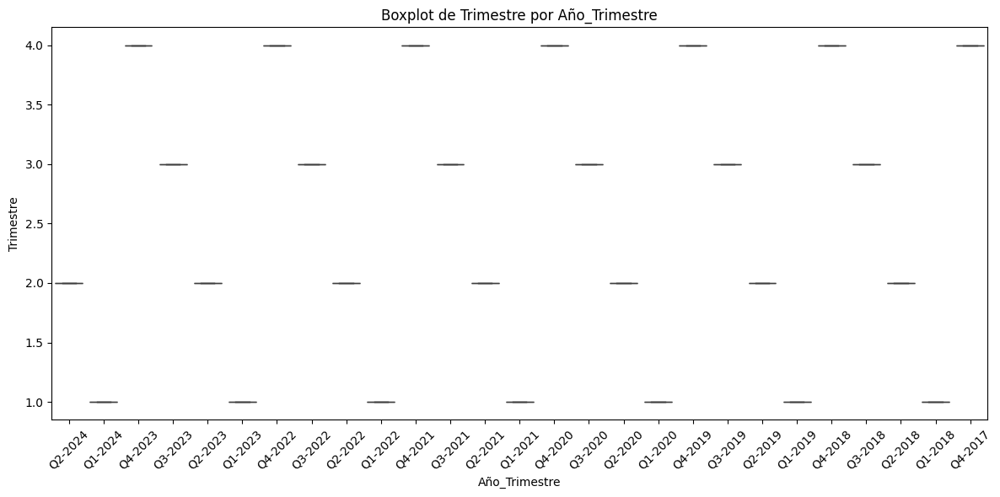


Estadísticas descriptivas de 'Velocidad' agrupadas por 'Año_Trimestre':
               count        mean         std    min    25%   50%         75%  \
Año_Trimestre                                                                  
Q1-2018        451.0   21.685552   33.034727  0.256  3.200   9.0   25.100000   
Q1-2019        532.0   25.452767   34.833126  0.256  4.000  10.1   31.000000   
Q1-2020        625.0   56.473754  134.578270  0.256  3.200  10.1   36.000000   
Q1-2021        745.0  195.284498  833.976577  0.256  4.500  15.0   55.000000   
Q1-2022        764.0   64.757050  148.365262  0.256  4.000  12.3   47.750000   
Q1-2023        862.0  107.377384  213.825408  0.256  4.625  19.0   81.000000   
Q1-2024        864.0  124.413307  284.793138  0.256  4.500  19.0  100.100000   
Q2-2018        493.0   22.608333   32.046884  0.256  3.200  10.0   25.100000   
Q2-2019        556.0   36.580209   86.654873  0.256  4.000  10.1   31.000000   
Q2-2020        647.0   62.575697  152.859572  0

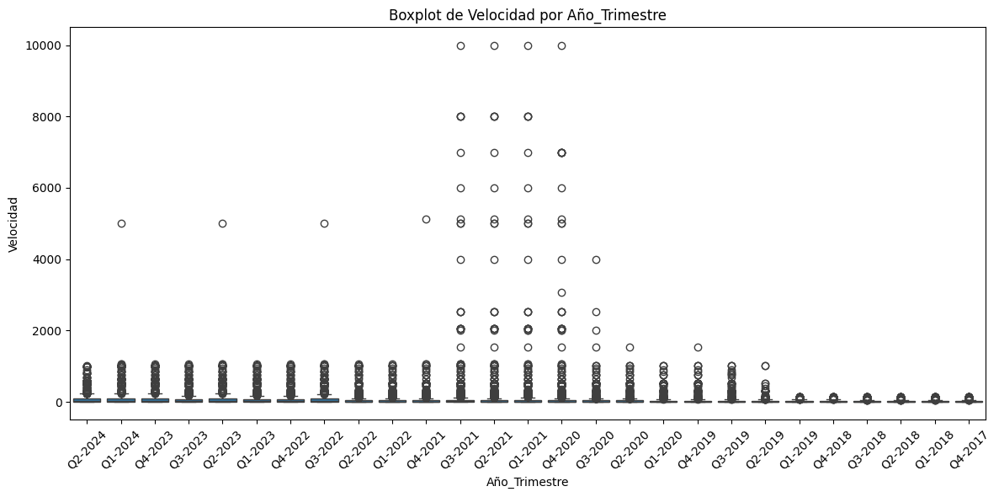


Estadísticas descriptivas de 'Accesos' agrupadas por 'Año_Trimestre':
               count          mean           std  min    25%     50%      75%  \
Año_Trimestre                                                                   
Q1-2018        451.0  17820.516630  75238.509338  1.0  33.00  1026.0  7640.00   
Q1-2019        532.0  16255.892857  69839.335190  1.0  22.00   710.5  7324.75   
Q1-2020        625.0  14099.881600  68882.047486  1.0  26.00   748.0  5604.00   
Q1-2021        745.0  12950.297987  71147.025069  1.0  14.00   439.0  4882.00   
Q1-2022        764.0  13905.770942  65600.249362  1.0  33.00   880.0  6968.25   
Q1-2023        862.0  13041.641531  60713.791051  1.0  30.00   569.5  5581.25   
Q1-2024        864.0  13464.300926  66860.950284  1.0  31.00   663.5  5637.50   
Q2-2018        493.0  16451.204868  69636.714957  1.0  23.00  1009.0  7880.00   
Q2-2019        556.0  16115.433453  73215.383592  1.0  34.00   885.0  6991.25   
Q2-2020        647.0  13958.355487  69

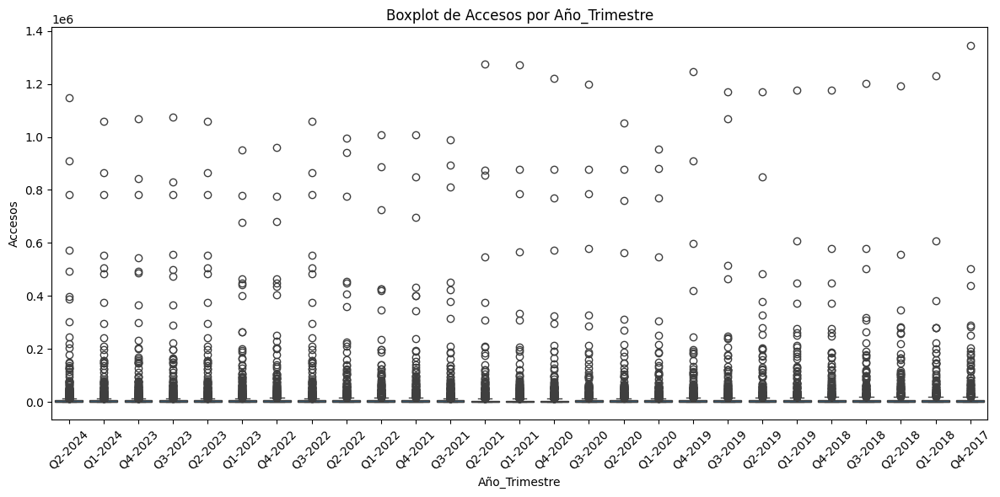


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
              count         mean      std     min     25%     50%     75%  \
Periodo                                                                     
01-03-2024  18884.0  2021.017104  1.91974  2017.0  2019.0  2021.0  2023.0   

               max  
Periodo             
01-03-2024  2024.0  


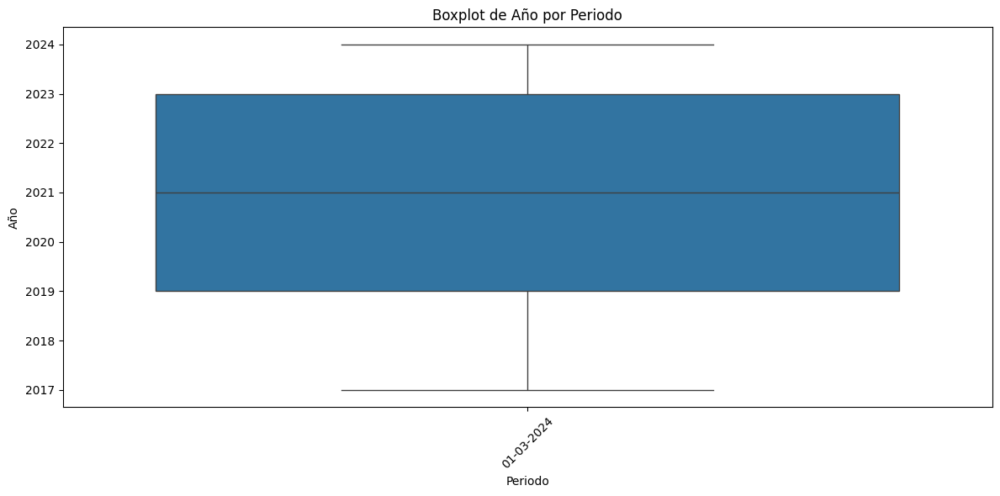


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
              count      mean       std  min  25%  50%  75%  max
Periodo                                                         
01-03-2024  18884.0  2.477653  1.126947  1.0  1.0  2.0  4.0  4.0


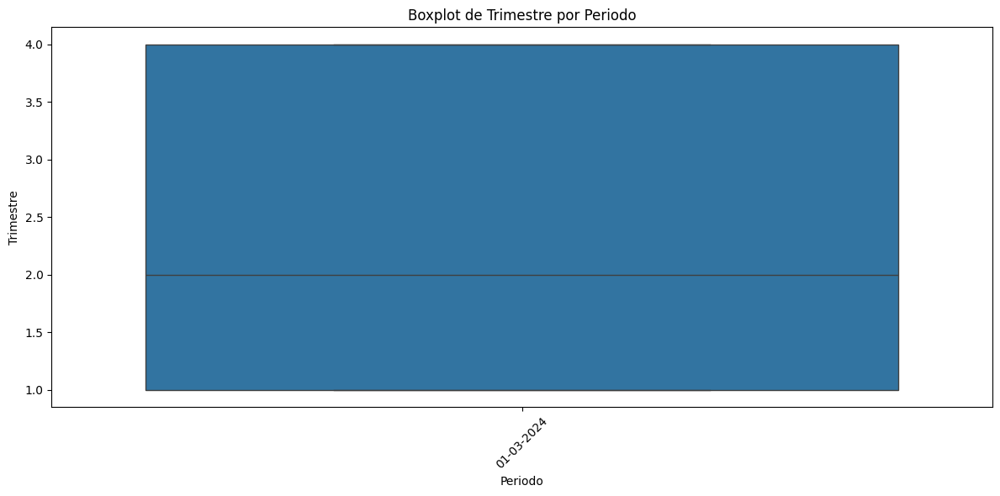


Estadísticas descriptivas de 'Velocidad' agrupadas por 'Periodo':
              count       mean         std  min  25%   50%   75%      max
Periodo                                                                  
01-03-2024  18884.0  96.171156  379.622345  0.0  4.0  12.3  50.1  10000.0


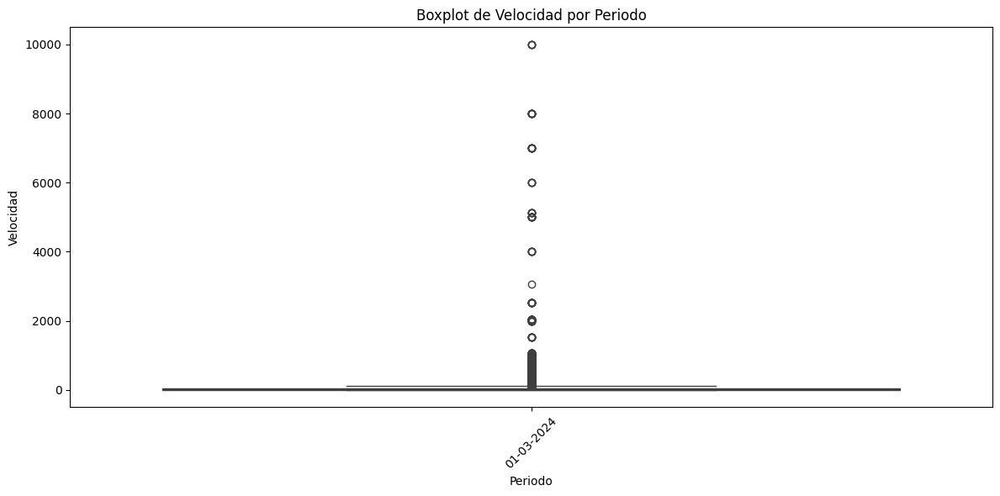


Estadísticas descriptivas de 'Accesos' agrupadas por 'Periodo':
              count          mean           std  min   25%    50%     75%  \
Periodo                                                                     
01-03-2024  18884.0  14123.280979  68563.873818  0.0  26.0  672.5  6114.0   

                  max  
Periodo                
01-03-2024  1346370.0  


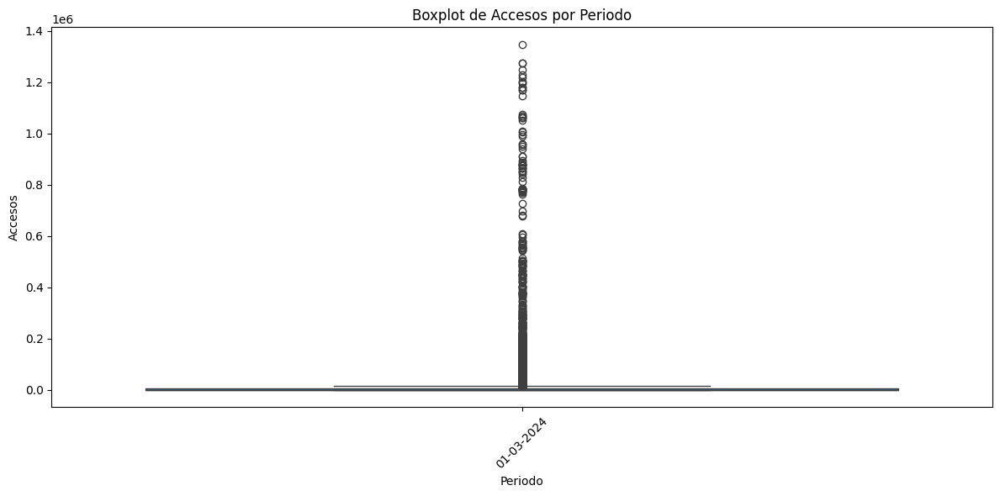


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
                count         mean       std     min     25%     50%     75%  \
meses_periodo                                                                  
abr - jun      4970.0  2021.376861  1.938226  2018.0  2020.0  2022.0  2023.0   
ene - mar      4843.0  2021.420814  1.924986  2018.0  2020.0  2022.0  2023.0   
jul - sep      4279.0  2020.799018  1.664549  2018.0  2019.0  2021.0  2022.0   
oct - dic      4792.0  2020.430718  1.929946  2017.0  2019.0  2021.0  2022.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


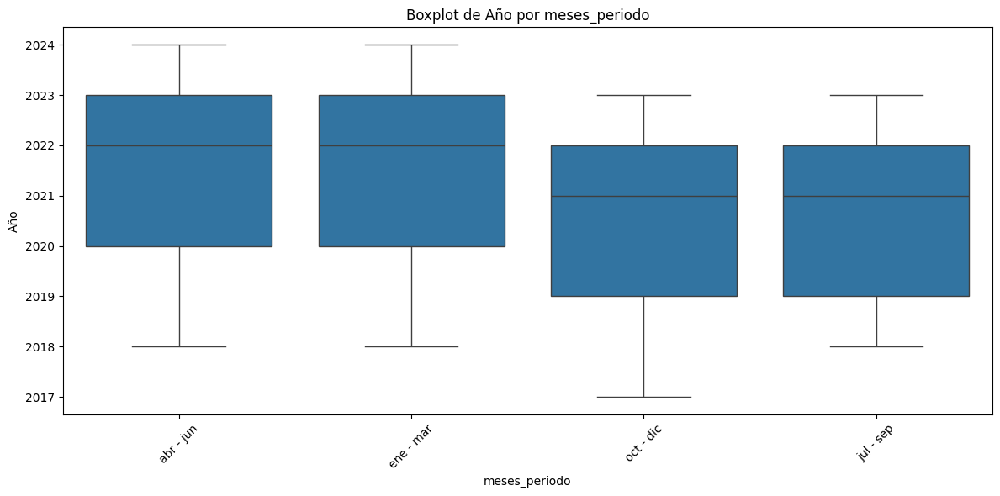


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
                count  mean  std  min  25%  50%  75%  max
meses_periodo                                            
abr - jun      4970.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      4843.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      4279.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      4792.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


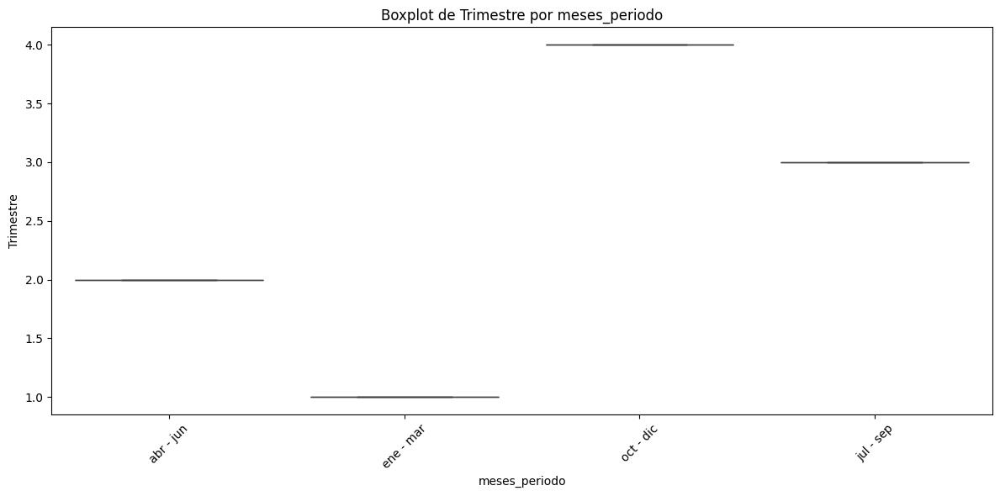


Estadísticas descriptivas de 'Velocidad' agrupadas por 'meses_periodo':
                count        mean         std    min  25%   50%   75%      max
meses_periodo                                                                 
abr - jun      4970.0   96.655316  371.526988  0.000  4.0  12.3  50.1  10000.0
ene - mar      4843.0   93.667333  372.274739  0.256  4.0  12.3  50.1  10000.0
jul - sep      4279.0  101.963920  400.244170  0.256  4.0  14.0  50.1  10000.0
oct - dic      4792.0   93.026852  376.413168  0.256  4.0  12.3  50.1  10000.0


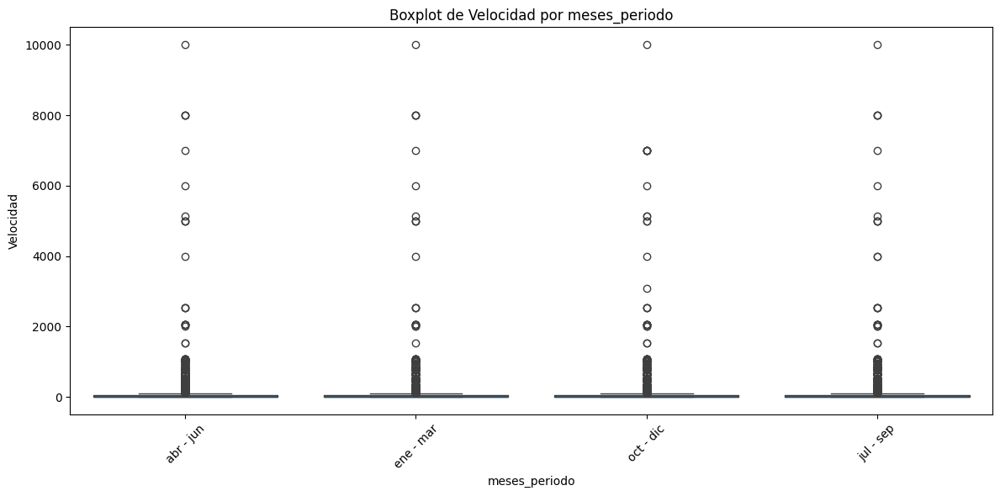


Estadísticas descriptivas de 'Accesos' agrupadas por 'meses_periodo':
                count          mean           std  min    25%    50%      75%  \
meses_periodo                                                                   
abr - jun      4970.0  14107.164588  69265.448613  0.0  27.25  699.5  6113.50   
ene - mar      4843.0  14173.992567  67697.041479  1.0  26.00  688.0  6145.50   
jul - sep      4279.0  14020.237205  69201.133905  1.0  27.00  650.0  5918.50   
oct - dic      4792.0  14180.757304  68151.475198  1.0  25.00  668.5  6287.25   

                     max  
meses_periodo             
abr - jun      1273506.0  
ene - mar      1272373.0  
jul - sep      1200804.0  
oct - dic      1346370.0  


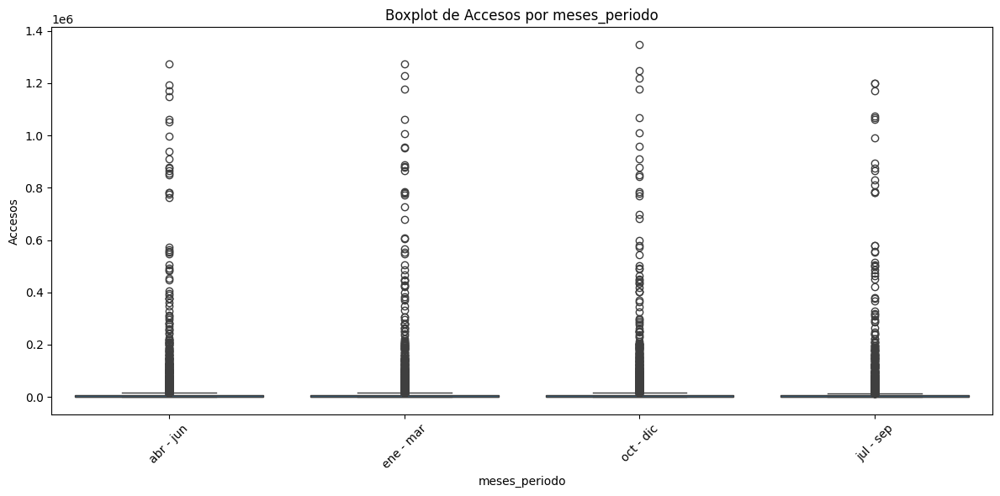

In [95]:
# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [96]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
            Año  Trimestre  Velocidad   Accesos
0      1.553843  -0.423858  -0.055770 -0.190503
1      1.553843  -0.423858  -0.097919 -0.205132
2      1.553843  -0.423858   1.011108 -0.205920
3      1.553843  -0.423858  -0.244121  0.402726
4      1.553843  -0.423858  -0.205924 -0.190795
...         ...        ...        ...       ...
18879 -2.092580   1.350896  -0.226734  0.453862
18880 -2.092580   1.350896  -0.211192 -0.204884
18881 -2.092580   1.350896  -0.199338  0.147585
18882 -2.092580   1.350896  -0.171678 -0.186988
18883 -2.092580   1.350896   0.154971 -0.142299

[18884 rows x 4 columns]


In [97]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           3046
CÓRDOBA                1292
SANTA FE               1122
MENDOZA                 833
RÍO NEGRO               820
LA PAMPA                810
MISIONES                780
ENTRE RÍOS              760
TUCUMÁN                 731
CHACO                   721
NEUQUÉN                 707
CHUBUT                  685
SALTA                   673
SANTA CRUZ              658
JUJUY                   647
CORRIENTES              644
TIERRA DEL FUEGO        628
SANTIAGO DEL ESTERO     605
FORMOSA                 596
SAN JUAN                577
SAN LUIS                559
CATAMARCA               517
LA RIOJA                473
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q4-2023    878
Q2-2024    874
Q1-2024    864
Q3-2023    862
Q1-2023    862
Q2-2023    855
Q3-2022    845
Q4-2022    839
Q2-2022    779
Q3-2021    778
Q2-2021    766
Q1-2022    764
Q4-2021    752
Q1-2021  

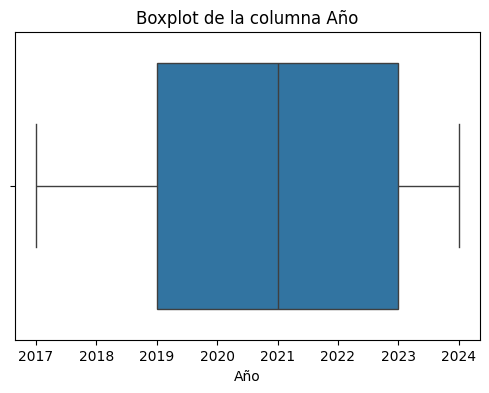

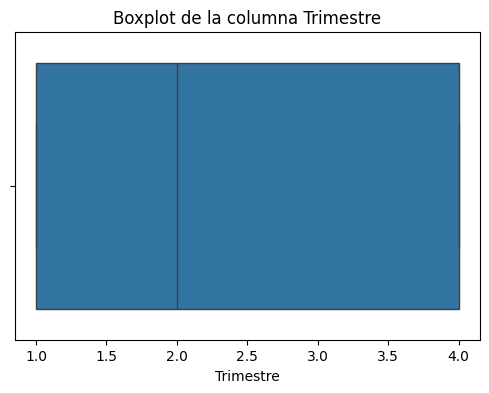

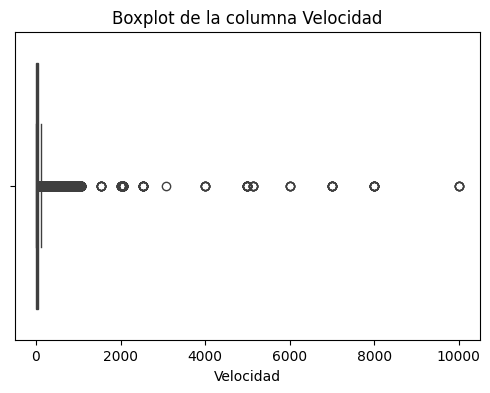

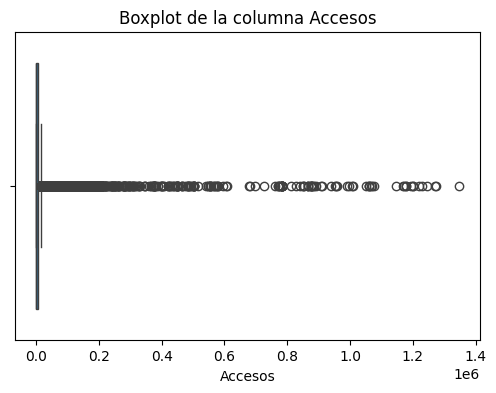

In [98]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [99]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Velocidad_sin_Rangos.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Velocidad_sin_Rangos.csv


In [100]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [102]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año          -0.217228
Trimestre     0.049937
Velocidad    14.308727
Accesos      11.228155
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año           -0.988956
Trimestre     -1.377860
Velocidad    273.964527
Accesos      152.041174
dtype: float64


In [103]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
    Variable           VIF
0      const  1.166379e+06
1        Año  1.051464e+00
2  Trimestre  1.045637e+00
3  Velocidad  1.005865e+00
4    Accesos  1.000445e+00


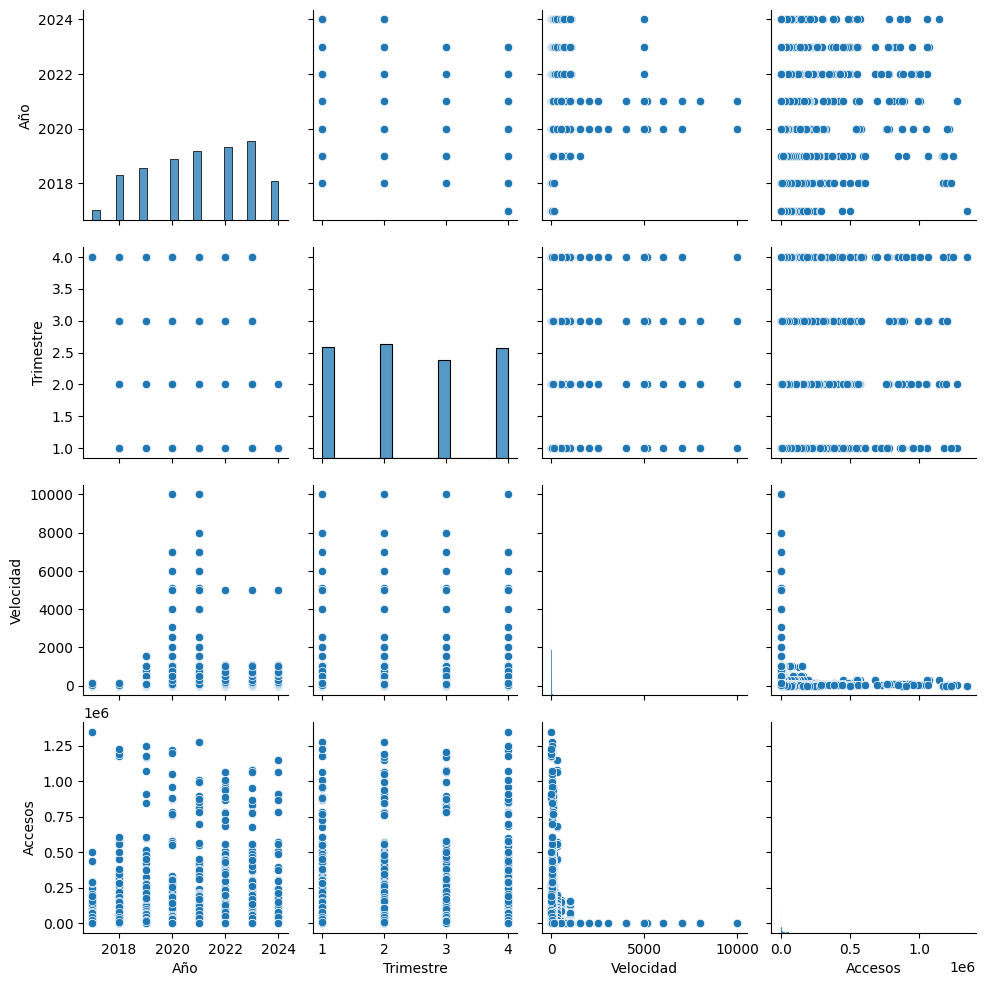

In [104]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [105]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                        Año                                                 \
                      count         mean       std     min     25%     50%   
Provincia                                                                    
BUENOS AIRES         3046.0  2021.041366  1.869888  2017.0  2020.0  2021.0   
CATAMARCA             517.0  2020.996132  1.900628  2017.0  2020.0  2021.0   
CHACO                 721.0  2020.826630  1.951256  2017.0  2019.0  2021.0   
CHUBUT                685.0  2021.110949  1.958475  2017.0  2020.0  2021.0   
CORRIENTES            644.0  2020.892857  1.995955  2017.0  2019.0  2021.0   
CÓRDOBA              1292.0  2021.123065  1.874331  2017.0  2020.0  2021.0   
ENTRE RÍOS            760.0  2020.800000  1.951183  2017.0  2019.0  2021.0   
FORMOSA               596.0  2020.810403  1.982094  2017.0  2019.0  2021.0   
JUJUY                 647.0  2020.996909  1.893444  2017.0  2019.0  2021.0   
LA PAMPA              81

In [1]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Penetracion-hogares.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [2]:
print(df.head())

    Año  Trimestre        Provincia  Accesos por cada 100 hogares
0  2024          2     Buenos Aires                         79.84
1  2024          2  Capital Federal                        116.37
2  2024          2        Catamarca                         68.81
3  2024          2            Chaco                         44.06
4  2024          2           Chubut                         86.33


In [3]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           1000 non-null   int64  
 1   Trimestre                     1000 non-null   int64  
 2   Provincia                     1000 non-null   object 
 3   Accesos por cada 100 hogares  1000 non-null   float64
dtypes: float64(1), int64(2), object(1)
memory usage: 31.4+ KB
None


In [4]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

      Año  Trimestre Año_Trimestre meses_periodo
0    2024          2       Q2-2024     abr - jun
1    2024          2       Q2-2024     abr - jun
2    2024          2       Q2-2024     abr - jun
3    2024          2       Q2-2024     abr - jun
4    2024          2       Q2-2024     abr - jun
..    ...        ...           ...           ...
995  2014          1       Q1-2014     ene - mar
996  2014          1       Q1-2014     ene - mar
997  2014          1       Q1-2014     ene - mar
998  2014          1       Q1-2014     ene - mar
999  2014          1       Q1-2014     ene - mar

[1000 rows x 4 columns]


In [5]:
print(df.head())

    Año  Trimestre        Provincia  Accesos por cada 100 hogares  \
0  2024          2     Buenos Aires                         79.84   
1  2024          2  Capital Federal                        116.37   
2  2024          2        Catamarca                         68.81   
3  2024          2            Chaco                         44.06   
4  2024          2           Chubut                         86.33   

  Año_Trimestre     Periodo meses_periodo  
0       Q2-2024  01-03-2024     abr - jun  
1       Q2-2024  01-03-2024     abr - jun  
2       Q2-2024  01-03-2024     abr - jun  
3       Q2-2024  01-03-2024     abr - jun  
4       Q2-2024  01-03-2024     abr - jun  


In [6]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año                               int64
Trimestre                         int64
Provincia                        object
Accesos por cada 100 hogares    float64
Año_Trimestre                    object
Periodo                          object
meses_periodo                    object
dtype: object


In [7]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           1000 non-null   int64  
 1   Trimestre                     1000 non-null   int64  
 2   Provincia                     1000 non-null   object 
 3   Accesos por cada 100 hogares  1000 non-null   float64
 4   Año_Trimestre                 1000 non-null   object 
 5   Periodo                       1000 non-null   object 
 6   meses_periodo                 1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [8]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [9]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [10]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           1000 non-null   int64  
 1   Trimestre                     1000 non-null   int64  
 2   Provincia                     1000 non-null   object 
 3   Accesos por cada 100 hogares  1000 non-null   float64
 4   Año_Trimestre                 1000 non-null   object 
 5   Periodo                       1000 non-null   object 
 6   meses_periodo                 1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [11]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           1000 non-null   int64  
 1   Trimestre                     1000 non-null   int64  
 2   Provincia                     1000 non-null   object 
 3   Accesos por cada 100 hogares  1000 non-null   float64
 4   Año_Trimestre                 1000 non-null   object 
 5   Periodo                       1000 non-null   object 
 6   meses_periodo                 1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None


In [13]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [14]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [15]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [16]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [17]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año                             0
Trimestre                       0
Provincia                       0
Accesos por cada 100 hogares    0
Año_Trimestre                   0
Periodo                         0
meses_periodo                   0
dtype: int64


In [18]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año                             0
Trimestre                       0
Provincia                       0
Accesos por cada 100 hogares    0
Año_Trimestre                   0
Periodo                         0
meses_periodo                   0
dtype: int64


In [19]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año                             0
Trimestre                       0
Provincia                       0
Accesos por cada 100 hogares    0
Año_Trimestre                   0
Periodo                         0
meses_periodo                   0
dtype: int64


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Año                           1000 non-null   int64  
 1   Trimestre                     1000 non-null   int64  
 2   Provincia                     1000 non-null   object 
 3   Accesos por cada 100 hogares  1000 non-null   float64
 4   Año_Trimestre                 1000 non-null   object 
 5   Periodo                       1000 non-null   object 
 6   meses_periodo                 1000 non-null   object 
dtypes: float64(1), int64(2), object(4)
memory usage: 54.8+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia  Accesos por cada 100 hogares  \
count   1000.000000  1000.000000          1000                   1000.000000   
unique          NaN          NaN            23                           NaN   
top             NaN          NaN  BUENOS AIRES                           NaN   
freq            NaN          NaN            84                           NaN   
mean    2018.800000     2.464000           NaN                     52.794973   
std        3.021445     1.114426           NaN                     24.135063   
min     2014.000000     1.000000           NaN                      9.513970   
25%     2016.000000     1.000000           NaN                     33.957657   
50%     2019.000000     2.000000           NaN                     50.133004   
75%     2021.000000     3.000000           NaN                     67.010861   
max     2024.000000     4.000000           NaN

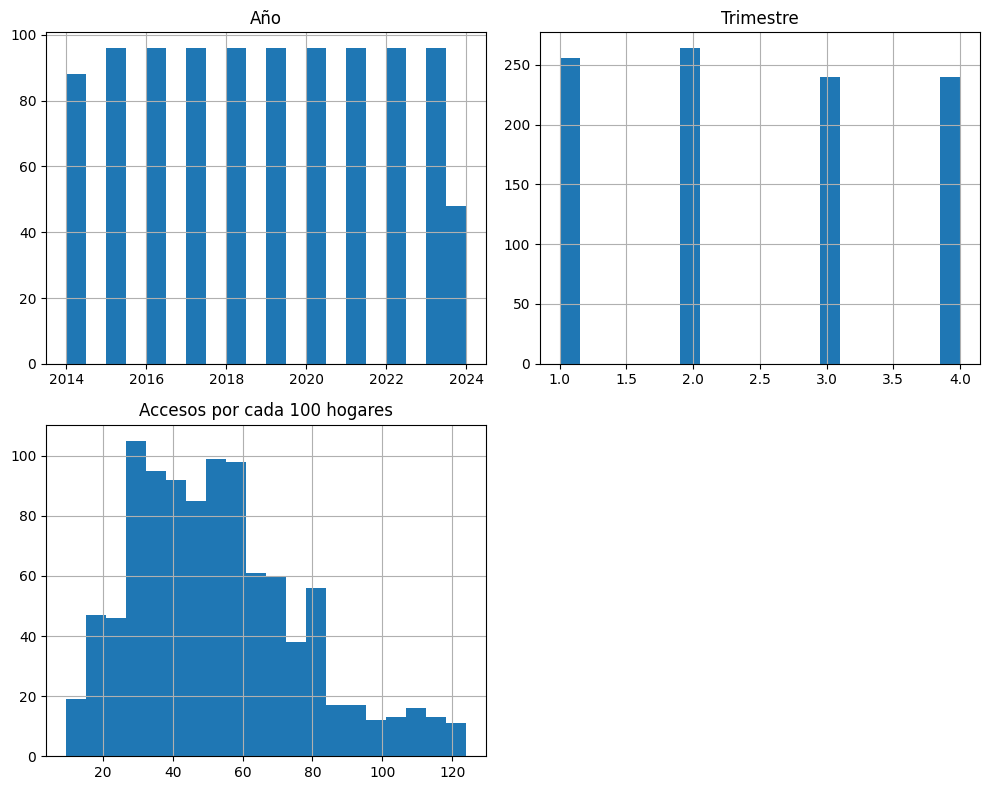

In [21]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                                   Año  Trimestre  \
Año                           1.000000  -0.091325   
Trimestre                    -0.091325   1.000000   
Accesos por cada 100 hogares  0.490964   0.007635   

                              Accesos por cada 100 hogares  
Año                                               0.490964  
Trimestre                                         0.007635  
Accesos por cada 100 hogares                      1.000000  

Correlaciones fuertes:
                              Año  Trimestre  Accesos por cada 100 hogares
Año                           1.0        NaN                           NaN
Trimestre                     NaN        1.0                           NaN
Accesos por cada 100 hogares  NaN        NaN                           1.0


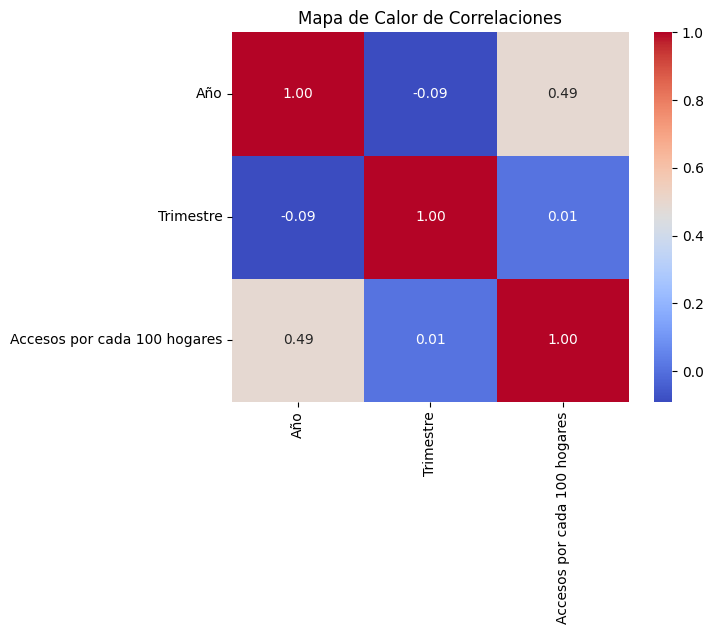

In [22]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               2        2        2        2        2        2   
CATAMARCA                  1        1        1        1        1        1   
CHACO                      1        1        1        1        1        1   
CHUBUT                     1        1        1        1        1        1   
CORRIENTES                 1        1        1        1        1        1   
CÓRDOBA                    1        1        1        1        1        1   
ENTRE RÍOS                 1        1        1        1        1        1   
FORMOSA                    1        1        1        1        1        1   
JUJUY                      1        1        1        1        1        1   
LA PAMPA                   1        1        1        1        1        1   
LA RIOJA            

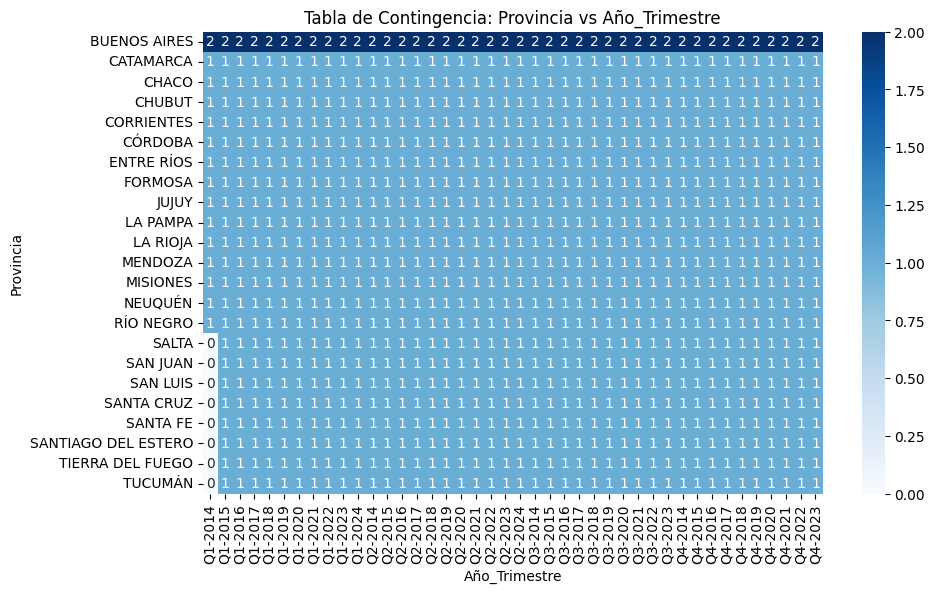


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                 84
CATAMARCA                    42
CHACO                        42
CHUBUT                       42
CORRIENTES                   42
CÓRDOBA                      42
ENTRE RÍOS                   42
FORMOSA                      42
JUJUY                        42
LA PAMPA                     42
LA RIOJA                     42
MENDOZA                      42
MISIONES                     42
NEUQUÉN                      42
RÍO NEGRO                    42
SALTA                        41
SAN JUAN                     41
SAN LUIS                     41
SANTA CRUZ                   41
SANTA FE                     41
SANTIAGO DEL ESTERO          41
TIERRA DEL FUEGO             41
TUCUMÁN                      41


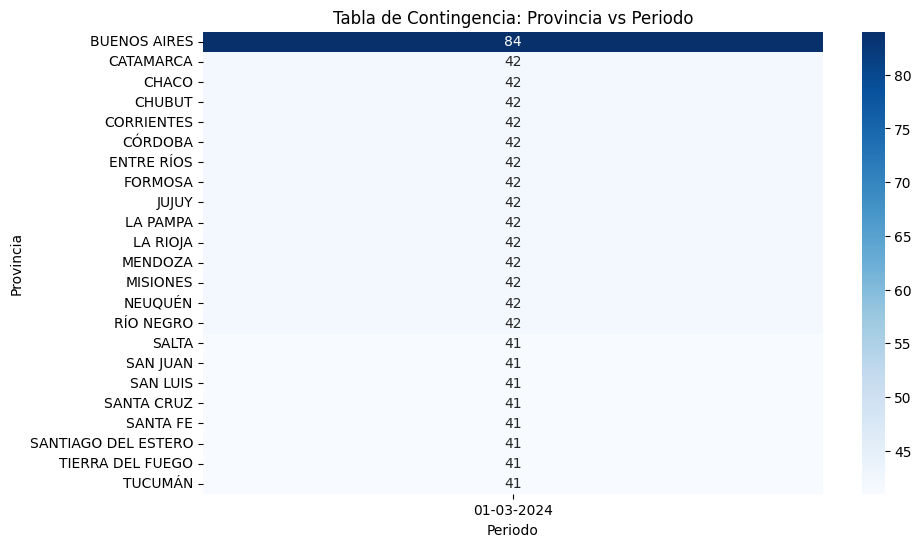


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                22         22         20         20
CATAMARCA                   11         11         10         10
CHACO                       11         11         10         10
CHUBUT                      11         11         10         10
CORRIENTES                  11         11         10         10
CÓRDOBA                     11         11         10         10
ENTRE RÍOS                  11         11         10         10
FORMOSA                     11         11         10         10
JUJUY                       11         11         10         10
LA PAMPA                    11         11         10         10
LA RIOJA                    11         11         10         10
MENDOZA                     11         11         10         10
MISIONES                    11         11       

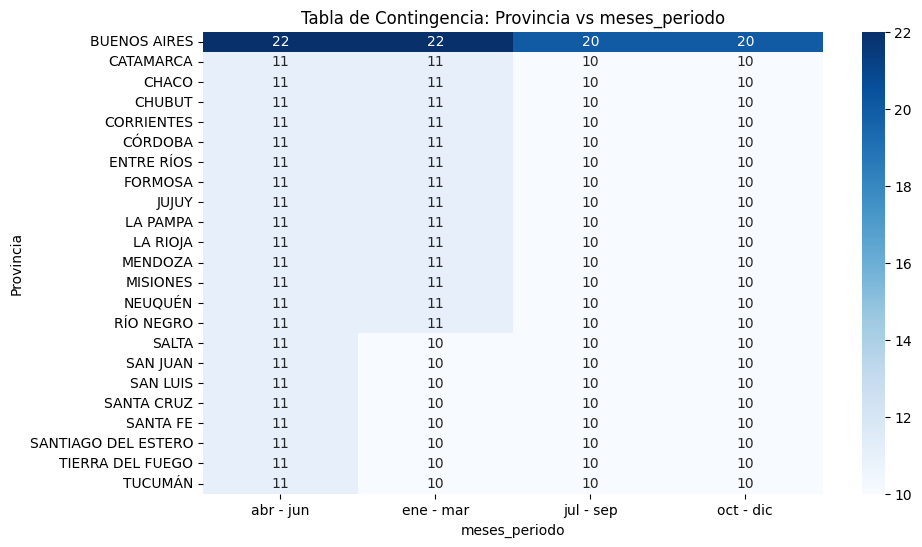


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                16
Q1-2015                24
Q1-2016                24
Q1-2017                24
Q1-2018                24
Q1-2019                24
Q1-2020                24
Q1-2021                24
Q1-2022                24
Q1-2023                24
Q1-2024                24
Q2-2014                24
Q2-2015                24
Q2-2016                24
Q2-2017                24
Q2-2018                24
Q2-2019                24
Q2-2020                24
Q2-2021                24
Q2-2022                24
Q2-2023                24
Q2-2024                24
Q3-2014                24
Q3-2015                24
Q3-2016                24
Q3-2017                24
Q3-2018                24
Q3-2019                24
Q3-2020                24
Q3-2021                24
Q3-2022                24
Q3-2023                24
Q4-2014                24
Q4-2015                24
Q4-2016   

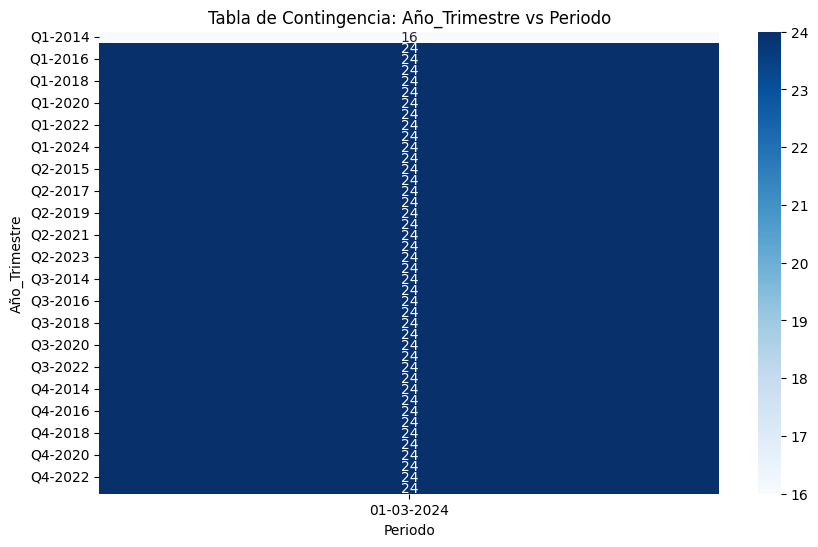


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         16          0          0
Q1-2015                0         24          0          0
Q1-2016                0         24          0          0
Q1-2017                0         24          0          0
Q1-2018                0         24          0          0
Q1-2019                0         24          0          0
Q1-2020                0         24          0          0
Q1-2021                0         24          0          0
Q1-2022                0         24          0          0
Q1-2023                0         24          0          0
Q1-2024                0         24          0          0
Q2-2014               24          0          0          0
Q2-2015               24          0          0          0
Q2-2016               24          0          0          0
Q2-2017     

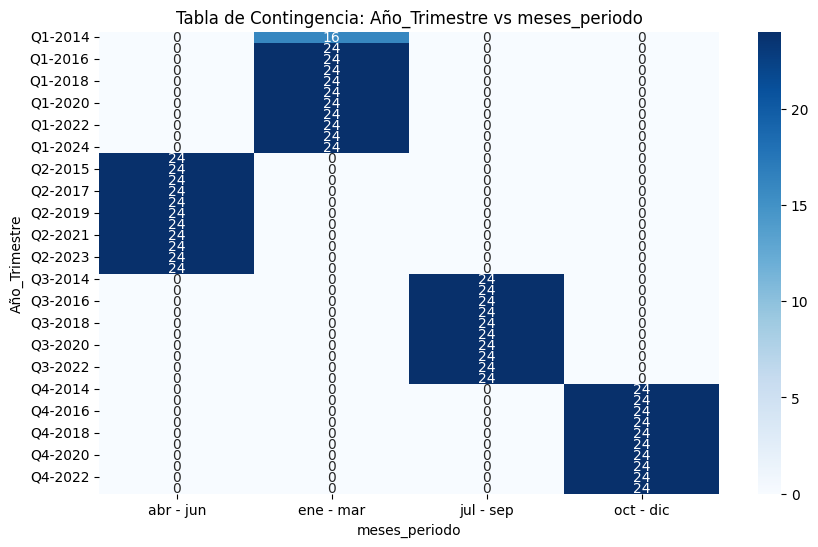


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           264        256        240        240


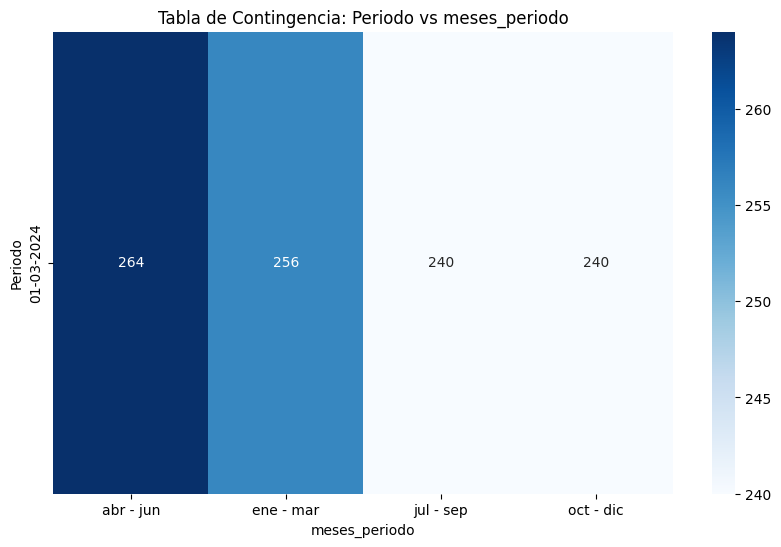

In [23]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES          84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA             42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA RIOJA     

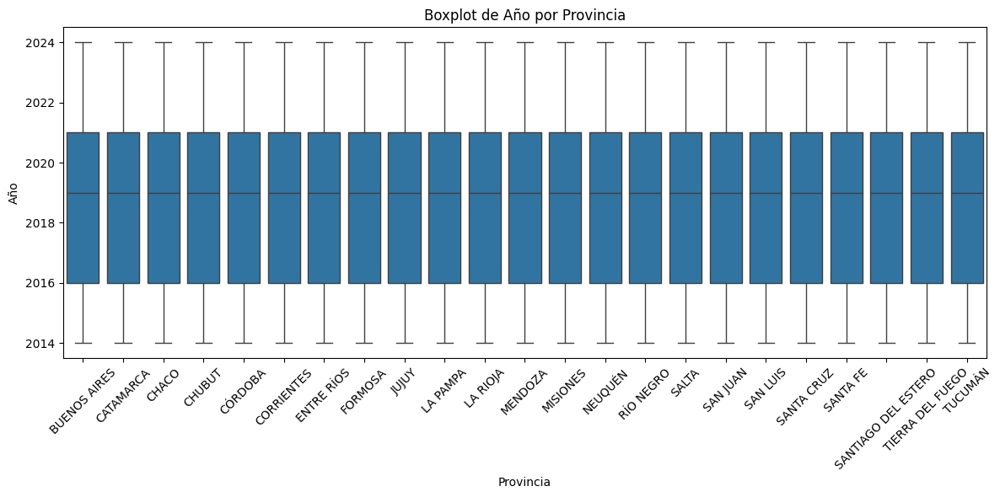


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min   25%  50%  75%  max
Provincia                                                               
BUENOS AIRES          84.0  2.452381  1.123728  1.0  1.00  2.0  3.0  4.0
CATAMARCA             42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHACO                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHUBUT                42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CORRIENTES            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CÓRDOBA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
ENTRE RÍOS            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
FORMOSA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
JUJUY                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA PAMPA              42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA RIOJA              42.0  2.452381  1.130560  1.0  1.

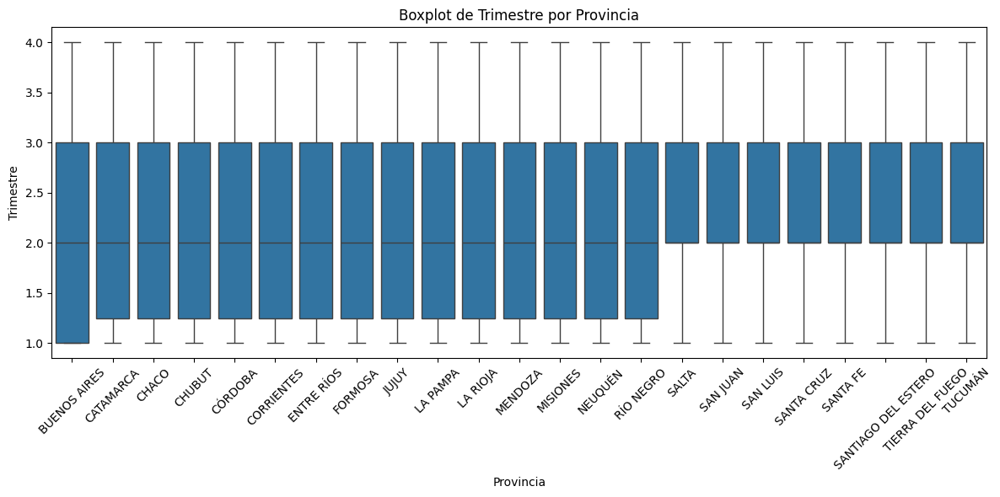


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'Provincia':
                     count       mean        std        min        25%  \
Provincia                                                                
BUENOS AIRES          84.0  90.272160  25.222722  54.570073  64.562277   
CATAMARCA             42.0  41.213171  16.479708  24.251751  26.115504   
CHACO                 42.0  34.976478   7.889080  20.718539  28.662909   
CHUBUT                42.0  57.641113  19.645611  35.546011  40.336624   
CORRIENTES            42.0  37.966266   9.297760  22.316717  30.950718   
CÓRDOBA               42.0  70.302257  13.383651  52.517848  57.664177   
ENTRE RÍOS            42.0  53.520019  10.431450  34.367122  44.982556   
FORMOSA               42.0  28.366984   8.490247  17.418451  19.488175   
JUJUY                 42.0  39.058077  16.750800  18.368534  22.453850   
LA PAMPA              42.0  75.274059  15.789592  48.425321  61.966159   
LA RIOJA              42

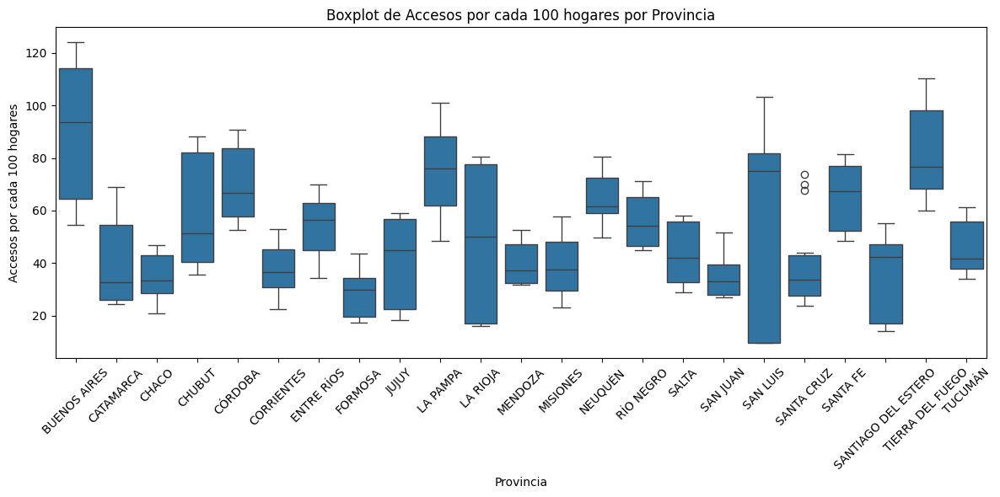


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         16.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         24.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         24.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         24.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         24.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         24.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         24.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         24.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         24.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         24.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         24.0  2024.0  0.0  2024.0  20

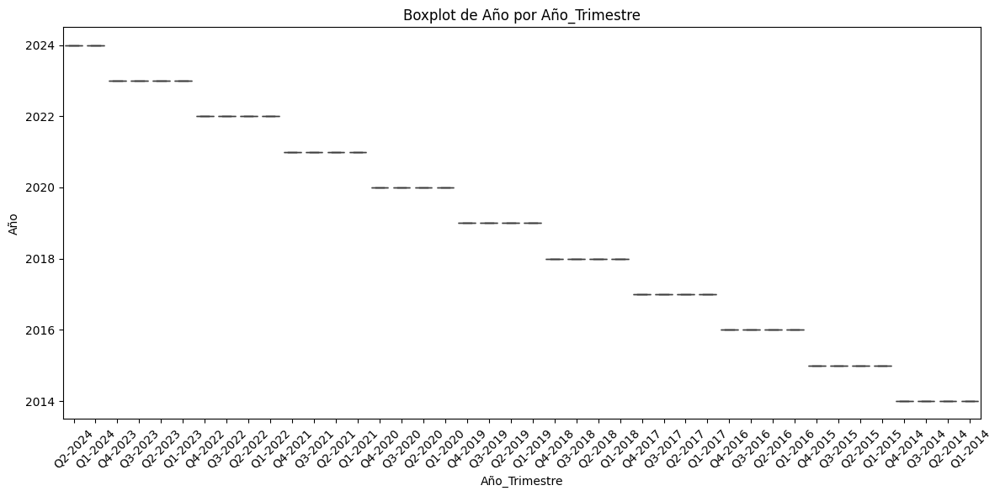


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         16.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

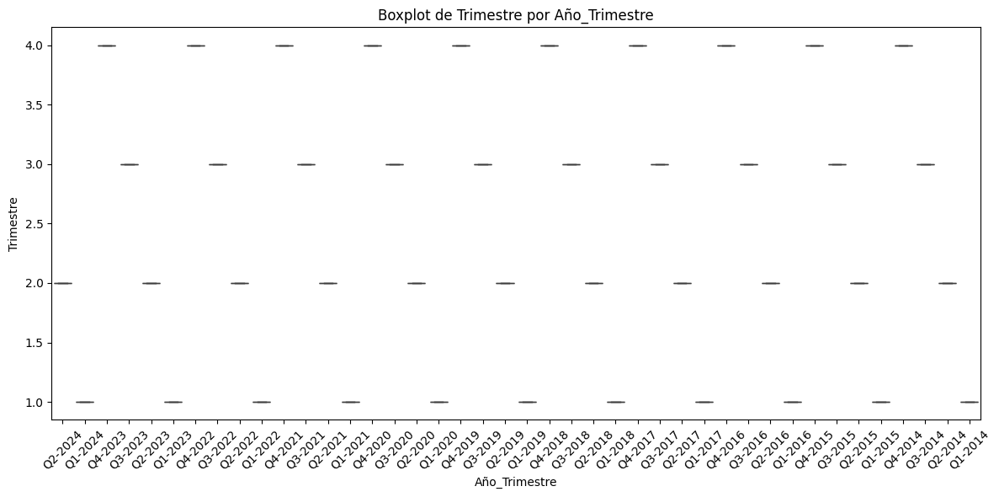


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'Año_Trimestre':
               count       mean        std        min        25%        50%  \
Año_Trimestre                                                                 
Q1-2014         16.0  38.283740  23.926030  16.294105  21.917172  33.140122   
Q1-2015         24.0  38.509014  22.657474   9.716049  26.006570  31.187838   
Q1-2016         24.0  38.922069  22.310723   9.586346  26.626951  31.719442   
Q1-2017         24.0  39.560191  22.048878   9.545500  26.308582  32.209251   
Q1-2018         24.0  45.953290  20.158354  15.148790  32.649890  40.475801   
Q1-2019         24.0  51.338738  21.132399  23.667655  35.976623  44.703088   
Q1-2020         24.0  53.355192  18.585636  30.228304  38.450667  48.721802   
Q1-2021         24.0  59.078071  18.223221  32.732956  43.163452  55.225685   
Q1-2022         24.0  65.900750  20.208955  34.955687  48.462589  60.953627   
Q1-2023         24.0  69.170833  21.491

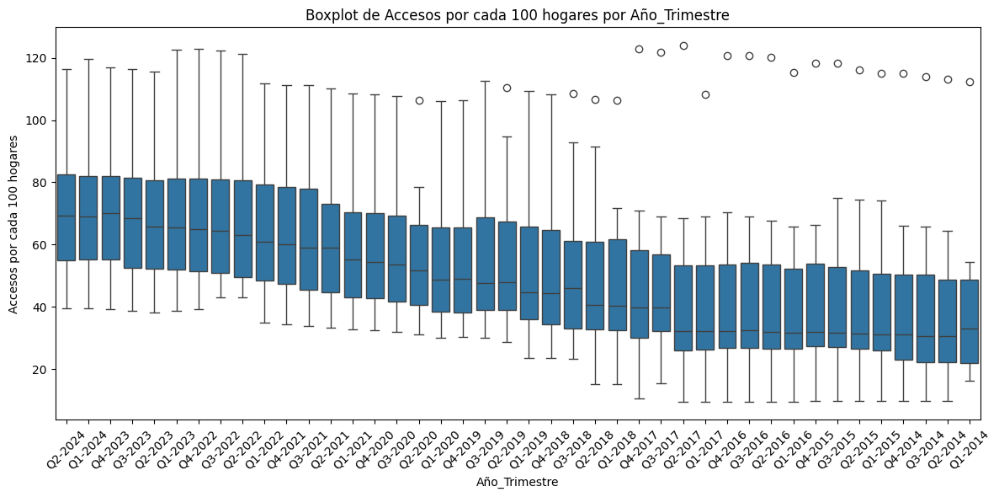


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count    mean       std     min     25%     50%     75%     max
Periodo                                                                     
01-03-2024  1000.0  2018.8  3.021445  2014.0  2016.0  2019.0  2021.0  2024.0


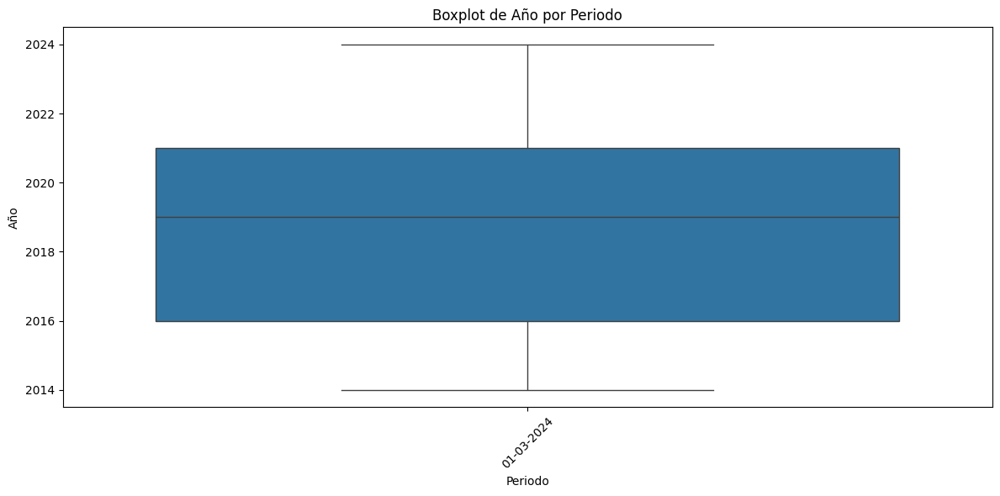


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count   mean       std  min  25%  50%  75%  max
Periodo                                                     
01-03-2024  1000.0  2.464  1.114426  1.0  1.0  2.0  3.0  4.0


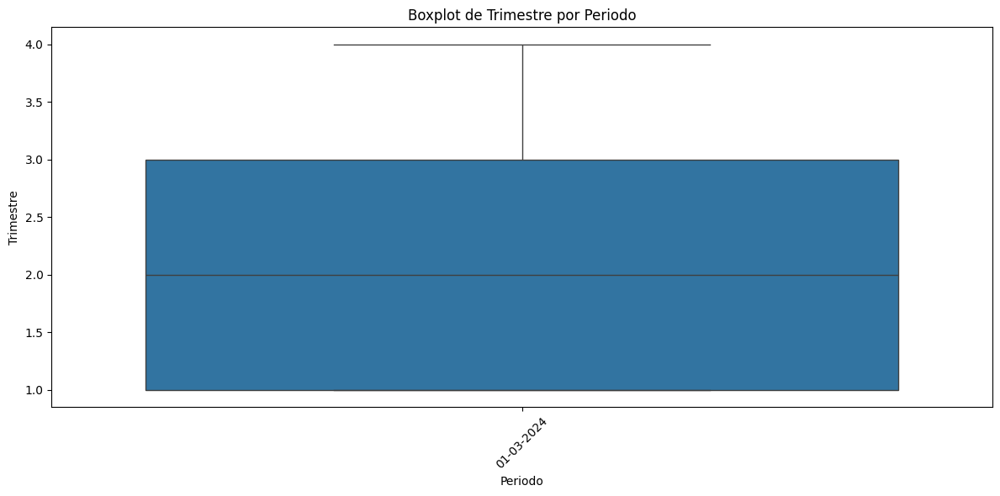


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'Periodo':
             count       mean        std      min        25%        50%  \
Periodo                                                                   
01-03-2024  1000.0  52.794973  24.135063  9.51397  33.957657  50.133004   

                  75%         max  
Periodo                            
01-03-2024  67.010861  124.061394  


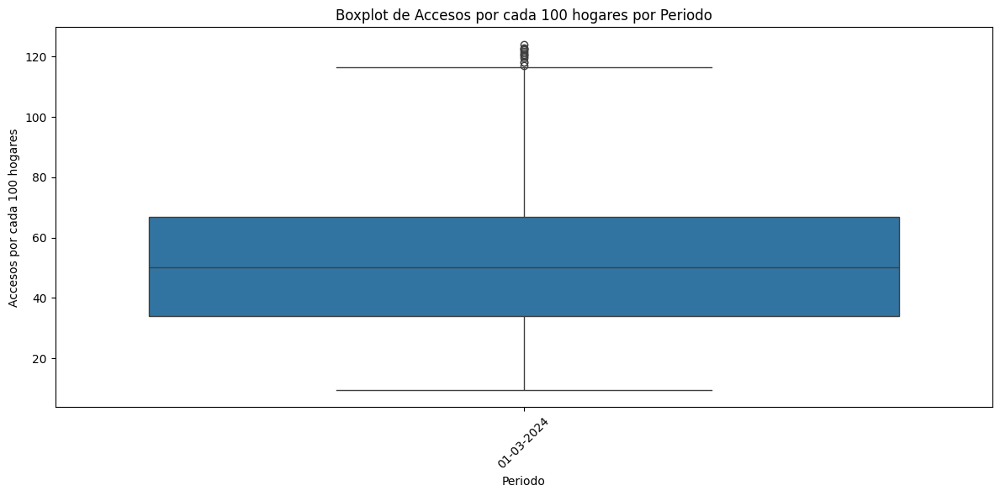


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count        mean       std     min      25%     50%     75%  \
meses_periodo                                                                 
abr - jun      264.0  2019.00000  3.168284  2014.0  2016.00  2019.0  2022.0   
ene - mar      256.0  2019.15625  3.089356  2014.0  2016.75  2019.0  2022.0   
jul - sep      240.0  2018.50000  2.878284  2014.0  2016.00  2018.5  2021.0   
oct - dic      240.0  2018.50000  2.878284  2014.0  2016.00  2018.5  2021.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


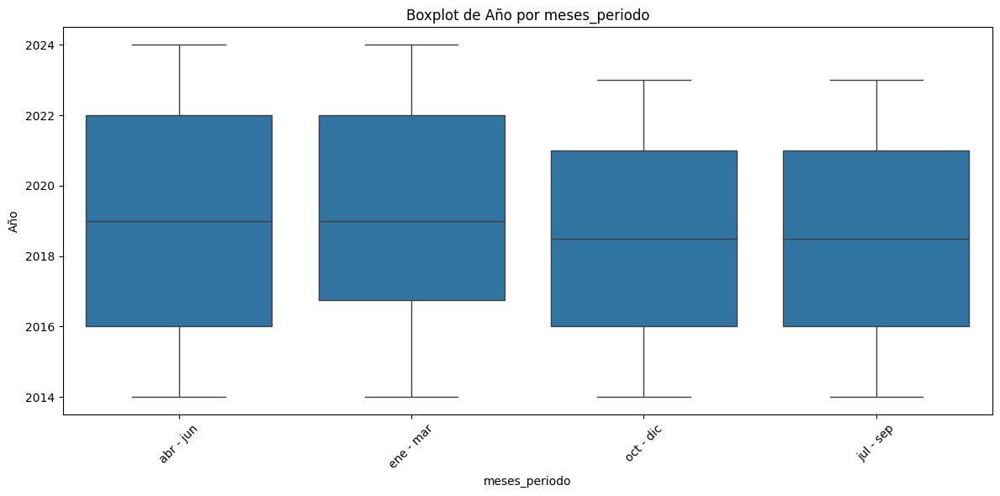


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      264.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      256.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      240.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      240.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


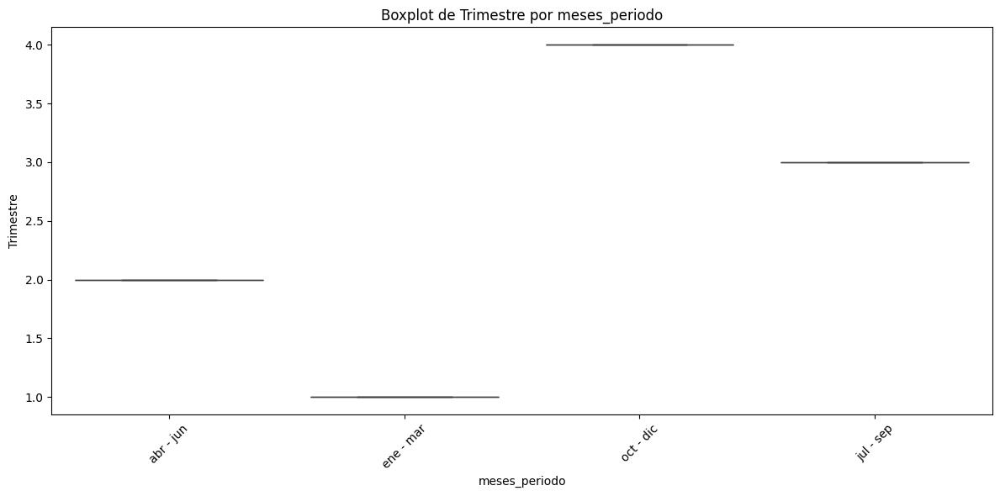


Estadísticas descriptivas de 'Accesos por cada 100 hogares' agrupadas por 'meses_periodo':
               count       mean        std       min        25%        50%  \
meses_periodo                                                                
abr - jun      264.0  52.981708  24.489797  9.513970  33.910834  50.495322   
ene - mar      256.0  52.439396  24.038964  9.545500  33.450089  49.770803   
jul - sep      240.0  52.667221  23.981895  9.630540  34.177963  50.170064   
oct - dic      240.0  53.096598  24.142488  9.640682  34.453618  50.617319   

                     75%         max  
meses_periodo                         
abr - jun      67.847855  124.061394  
ene - mar      66.392439  122.590000  
jul - sep      65.700028  122.280000  
oct - dic      66.597240  122.897424  


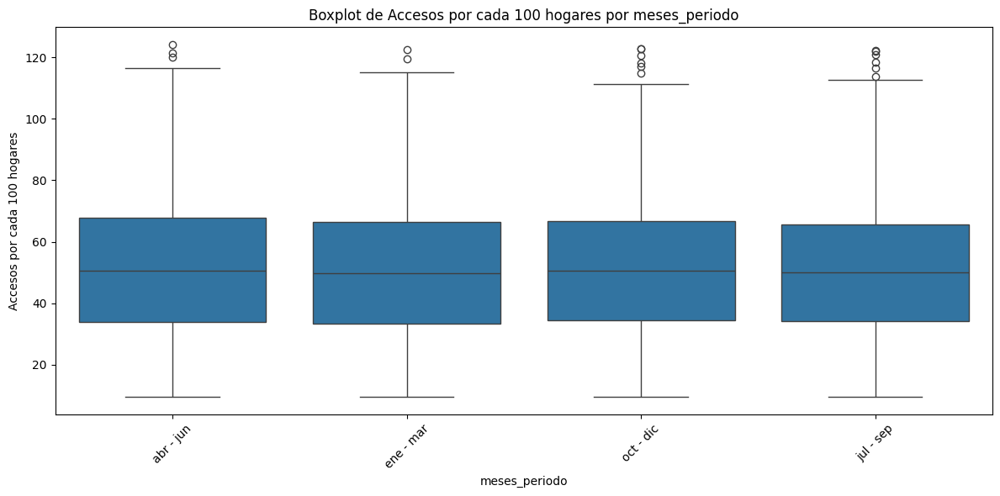

In [25]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [26]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
          Año  Trimestre  Accesos por cada 100 hogares
0    1.721892  -0.416566                      1.121131
1    1.721892  -0.416566                      2.635454
2    1.721892  -0.416566                      0.663891
3    1.721892  -0.416566                     -0.362102
4    1.721892  -0.416566                      1.390169
..        ...        ...                           ...
995 -1.589439  -1.314338                     -1.513115
996 -1.589439  -1.314338                     -0.865641
997 -1.589439  -1.314338                     -1.229467
998 -1.589439  -1.314338                     -0.124502
999 -1.589439  -1.314338                     -0.326701

[1000 rows x 3 columns]


In [27]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           84
CATAMARCA              42
CHACO                  42
CHUBUT                 42
CÓRDOBA                42
CORRIENTES             42
ENTRE RÍOS             42
FORMOSA                42
JUJUY                  42
LA PAMPA               42
LA RIOJA               42
MENDOZA                42
MISIONES               42
NEUQUÉN                42
RÍO NEGRO              42
SALTA                  41
SAN JUAN               41
SAN LUIS               41
SANTA CRUZ             41
SANTA FE               41
SANTIAGO DEL ESTERO    41
TIERRA DEL FUEGO       41
TUCUMÁN                41
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    24
Q1-2024    24
Q4-2023    24
Q3-2023    24
Q2-2023    24
Q1-2023    24
Q4-2022    24
Q3-2022    24
Q2-2022    24
Q1-2022    24
Q4-2021    24
Q3-2021    24
Q2-2021    24
Q1-2021    24
Q4-2020    24
Q3-2020    24
Q2-2020    24
Q1-2020    2

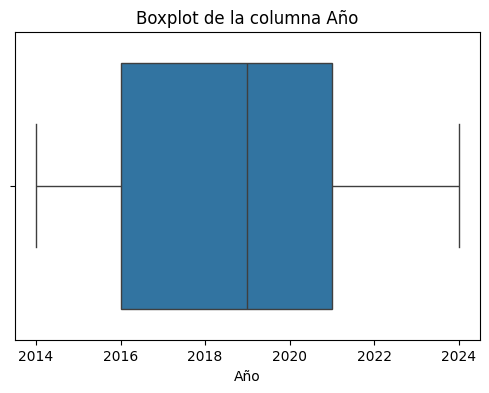

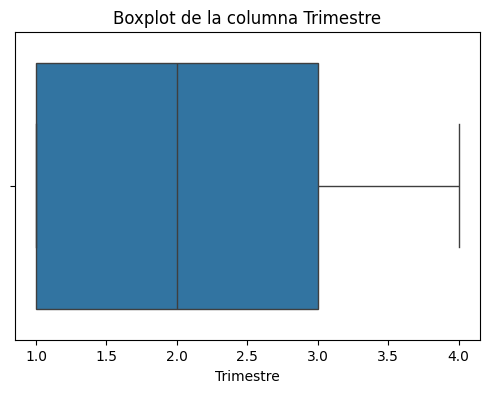

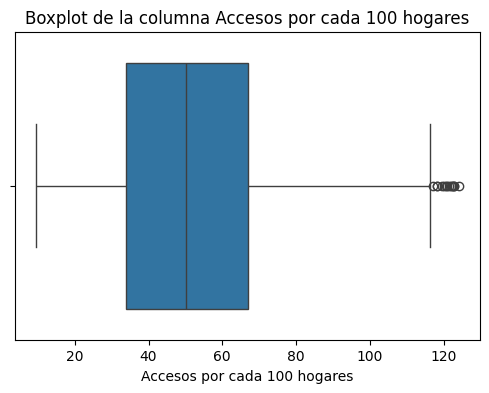

In [28]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [29]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Penetracion-hogares.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Penetracion-hogares.csv


In [30]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [31]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año                             0.017454
Trimestre                       0.055832
Accesos por cada 100 hogares    0.702706
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año                            -1.182505
Trimestre                      -1.348124
Accesos por cada 100 hogares    0.208253
dtype: float64


In [32]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
                       Variable            VIF
0                         const  594376.883444
1                           Año       1.333485
2                     Trimestre       1.012113
3  Accesos por cada 100 hogares       1.322440


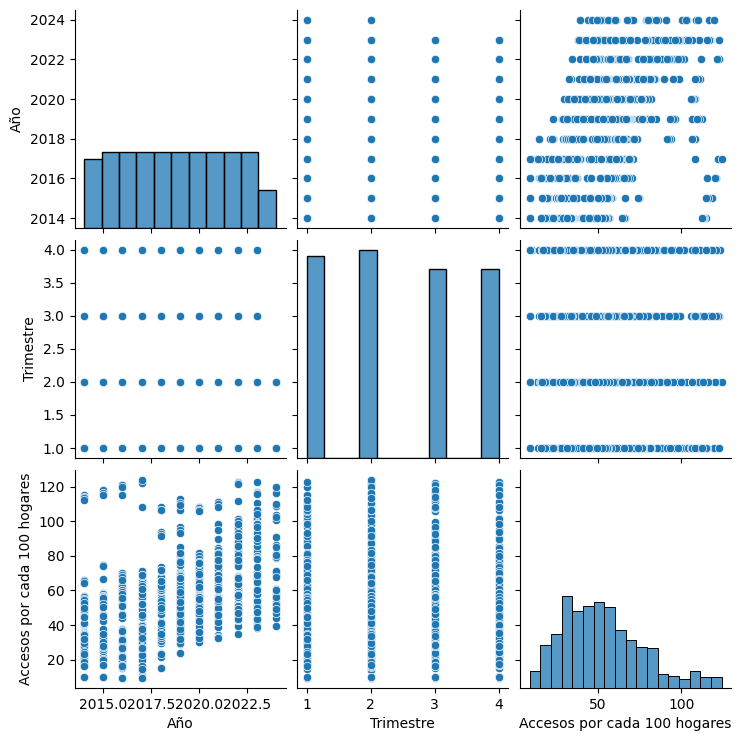

In [33]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [34]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                      Año                                                 \
                    count         mean       std     min     25%     50%   
Provincia                                                                  
BUENOS AIRES         84.0  2018.761905  3.056177  2014.0  2016.0  2019.0   
CATAMARCA            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA             42.0  2018.761905  3.074756

In [10]:
# 1 Cargar el archivo y normalizar los nombres
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Reemplaza el nombre del archivo con el que quieres evaluar y modificar
nombre_archivo = "Accesos Por Tecnología.csv"

# Ruta completa al archivo
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data" + "\\" + nombre_archivo

# Verificar si el archivo existe antes de cargarlo
if os.path.exists(ruta_completa):
	# Cargar el archivo CSV
	df = pd.read_csv(ruta_completa)
	print("Archivo cargado exitosamente.")
else:
	print(f"Error: El archivo '{ruta_completa}' no existe.")


# Cargar el archivo CSV
df = pd.read_csv(ruta_completa)

Archivo cargado exitosamente.


In [11]:
print(df.head())

    Año  Trimestre        Provincia      ADSL  Cablemodem  Fibra óptica  \
0  2024          2     Buenos Aires  214055.0   2722466.0     1849476.0   
1  2024          2  Capital Federal   54102.0   1144781.0      230402.0   
2  2024          2        Catamarca    4951.0     10303.0       58355.0   
3  2024          2            Chaco    9448.0     57935.0       68944.0   
4  2024          2           Chubut   25955.0     80704.0       26516.0   

   Wireless    Otros      Total  
0  138638.0  64745.0  4989380.0  
1    4493.0  29821.0  1463599.0  
2    1384.0     81.0    75074.0  
3    8407.0   2358.0   147092.0  
4   31118.0   9930.0   174223.0  


In [12]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1007 entries, 0 to 1006
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Año           1007 non-null   int64  
 1   Trimestre     1007 non-null   int64  
 2   Provincia     1007 non-null   object 
 3   ADSL          1007 non-null   float64
 4   Cablemodem    1007 non-null   float64
 5   Fibra óptica  1007 non-null   float64
 6   Wireless      1007 non-null   float64
 7   Otros         1007 non-null   float64
 8   Total         1007 non-null   float64
dtypes: float64(6), int64(2), object(1)
memory usage: 70.9+ KB
None


In [13]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año             0
Trimestre       0
Provincia       0
ADSL            0
Cablemodem      0
Fibra óptica    0
Wireless        0
Otros           0
Total           0
dtype: int64


In [14]:
print("\nCantidad de valores NaN por columna:")
print(df.isnull().sum())


Cantidad de valores NaN por columna:
Año             0
Trimestre       0
Provincia       0
ADSL            0
Cablemodem      0
Fibra óptica    0
Wireless        0
Otros           0
Total           0
dtype: int64


In [15]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())

# Manejo de valores nulos
for column in df.columns:
    null_count = df[column].isnull().sum()
    if null_count > 0:
        percentage = (null_count / len(df)) * 100
        print(f"\nColumna '{column}' tiene {null_count} valores nulos ({percentage:.2f}%)")
        
        if percentage < 5:
            # Imputar con la media (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].mean(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        elif percentage < 20:
            # Imputar con la mediana (para columnas numéricas)
            if df[column].dtype in ['float64', 'int64']:
                df[column].fillna(df[column].median(), inplace=True)
            else:
                # Imputar con la moda (para columnas categóricas)
                df[column].fillna(df[column].mode()[0], inplace=True)
        else:
            print(f"Columna '{column}' tiene más del 20% de valores nulos. Considera eliminarla o usar técnicas de imputación más avanzadas.")


Cantidad de valores nulos por columna:
Año             0
Trimestre       0
Provincia       0
ADSL            0
Cablemodem      0
Fibra óptica    0
Wireless        0
Otros           0
Total           0
dtype: int64


In [16]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año             0
Trimestre       0
Provincia       0
ADSL            0
Cablemodem      0
Fibra óptica    0
Wireless        0
Otros           0
Total           0
dtype: int64


In [17]:
# Verificar si las columnas "Año" y "Trimestre" existen
if 'Año' in df.columns and 'Trimestre' in df.columns:
    # Crear una nueva columna con el formato "Qx-YYYY"
    df['Año_Trimestre'] = 'Q' + df['Trimestre'].astype(str) + '-' + df['Año'].astype(str)

# Verificar si la columna "Periodo" existe
if 'Periodo' in df.columns:
    # Extraer los meses de la columna "Periodo" y crear la nueva columna "meses_periodo"
    # Suponiendo que el formato de "Periodo" es "mm-mm-YYYY"
    df['meses_periodo'] = df['Periodo'].str[:5]  # Extraer los primeros 5 caracteres (mm-mm)
else:
    # Crear una columna "Periodo" con valores de ejemplo para evitar el KeyError
    df['Periodo'] = '01-03-2024'  # Ejemplo de valor, ajustar según sea necesario
    df['meses_periodo'] = 'ene - mar'  # Asignar la abreviación de los meses correspondientes al trimestre 2

# Asignar la abreviación de los meses según el trimestre
def obtener_meses_periodo(trimestre):
    if trimestre == 1:
        return 'ene - mar'
    elif trimestre == 2:
        return 'abr - jun'
    elif trimestre == 3:
        return 'jul - sep'
    elif trimestre == 4:
        return 'oct - dic'
    else:
        return 'N/A'  # Para trimestres no válidos

# Aplicar la función para crear la columna "meses_periodo"
df['meses_periodo'] = df['Trimestre'].apply(obtener_meses_periodo)

# Mostrar el DataFrame con las nuevas columnas
print(df[['Año', 'Trimestre', 'Año_Trimestre', 'meses_periodo']])

       Año  Trimestre Año_Trimestre meses_periodo
0     2024          2       Q2-2024     abr - jun
1     2024          2       Q2-2024     abr - jun
2     2024          2       Q2-2024     abr - jun
3     2024          2       Q2-2024     abr - jun
4     2024          2       Q2-2024     abr - jun
...    ...        ...           ...           ...
1002  2014          1       Q1-2014     ene - mar
1003  2014          1       Q1-2014     ene - mar
1004  2014          1       Q1-2014     ene - mar
1005  2014          1       Q1-2014     ene - mar
1006  2014          1       Q1-2014     ene - mar

[1007 rows x 4 columns]


In [18]:
print(df.head())

    Año  Trimestre        Provincia      ADSL  Cablemodem  Fibra óptica  \
0  2024          2     Buenos Aires  214055.0   2722466.0     1849476.0   
1  2024          2  Capital Federal   54102.0   1144781.0      230402.0   
2  2024          2        Catamarca    4951.0     10303.0       58355.0   
3  2024          2            Chaco    9448.0     57935.0       68944.0   
4  2024          2           Chubut   25955.0     80704.0       26516.0   

   Wireless    Otros      Total Año_Trimestre     Periodo meses_periodo  
0  138638.0  64745.0  4989380.0       Q2-2024  01-03-2024     abr - jun  
1    4493.0  29821.0  1463599.0       Q2-2024  01-03-2024     abr - jun  
2    1384.0     81.0    75074.0       Q2-2024  01-03-2024     abr - jun  
3    8407.0   2358.0   147092.0       Q2-2024  01-03-2024     abr - jun  
4   31118.0   9930.0   174223.0       Q2-2024  01-03-2024     abr - jun  


In [19]:
# Lista de columnas a verificar y sus tipos de datos deseados
columnas_tipos = {
    "Año": int,
    "Trimestre": int,
    "Periodo": str,
    "Provincia": str,
    "Partido": str,
    "Localidad": str,
    "meses_periodo": str,
    "Año_Trimestre": str,
    "Tecnologia": str,
    "Link Indec": int,
    "Accesos": float,
    "Banda ancha fija": int,
    "Dial up": float,
    "Total": int,
    "Accesos por cada 100 hab": float,
    "Accesos por cada 100 hogares": float,
    "Ingresos (miles de pesos)": float,
    "Hasta 512 kbps": int,
    "Entre 512 Kbps y 1 Mbps": int,
    "Entre 1 Mbps y 6 Mbps": int,
    "Entre 6 Mbps y 10 Mbps": int,
    "Entre 10 Mbps y 20 Mbps": int,
    "Entre 20 Mbps y 30 Mbps": int,
    "Más de 30 Mbps": int,
    "OTROS": int,
    "ADSL": int,
    "Cablemodem": int,
    "Fibra óptica": int,
    "Wireless": int,
    "Otros": int,
    "Mbps (Media de bajada)": float,
    "Velocidad": float,
    "Velocidad (Mbps)": float
}

# Verificar si las columnas existen y convertir los tipos de datos
for columna, tipo in columnas_tipos.items():
    if columna in df.columns:
        try:
            df[columna] = df[columna].astype(tipo)
        except ValueError as e:
            print(f"Error al convertir la columna '{columna}' a {tipo}: {e}")

# Mostrar los tipos de datos después de la conversión
print(df.dtypes)

Año               int64
Trimestre         int64
Provincia        object
ADSL              int64
Cablemodem        int64
Fibra óptica      int64
Wireless          int64
Otros             int64
Total             int64
Año_Trimestre    object
Periodo          object
meses_periodo    object
dtype: object


In [20]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1007 entries, 0 to 1006
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            1007 non-null   int64 
 1   Trimestre      1007 non-null   int64 
 2   Provincia      1007 non-null   object
 3   ADSL           1007 non-null   int64 
 4   Cablemodem     1007 non-null   int64 
 5   Fibra óptica   1007 non-null   int64 
 6   Wireless       1007 non-null   int64 
 7   Otros          1007 non-null   int64 
 8   Total          1007 non-null   int64 
 9   Año_Trimestre  1007 non-null   object
 10  Periodo        1007 non-null   object
 11  meses_periodo  1007 non-null   object
dtypes: int64(8), object(4)
memory usage: 94.5+ KB
None


In [21]:
# Verificar duplicados

print("\nNúmero de filas duplicadas:")
print(df.duplicated().sum())


Número de filas duplicadas:
0


In [22]:
# Verificar si las columnas existen antes de normalizarlas
if 'Provincia' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Provincia'] = df['Provincia'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Provincia' después de la normalización:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

if 'Partido' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Partido'] = df['Partido'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Partido' después de la normalización:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

if 'Localidad' in df.columns:
    # Normalizar los nombres: eliminar espacios y convertir a mayúsculas
    df['Localidad'] = df['Localidad'].str.strip().str.upper()
    # Listar los valores únicos después de la normalización
    print("\nValores únicos en 'Localidad' después de la normalización:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de la normalización:
['BUENOS AIRES' 'CAPITAL FEDERAL' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA'
 'CORRIENTES' 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA'
 'MENDOZA' 'MISIONES' 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS'
 'SANTA CRUZ' 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO'
 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [23]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1007 entries, 0 to 1006
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            1007 non-null   int64 
 1   Trimestre      1007 non-null   int64 
 2   Provincia      1007 non-null   object
 3   ADSL           1007 non-null   int64 
 4   Cablemodem     1007 non-null   int64 
 5   Fibra óptica   1007 non-null   int64 
 6   Wireless       1007 non-null   int64 
 7   Otros          1007 non-null   int64 
 8   Total          1007 non-null   int64 
 9   Año_Trimestre  1007 non-null   object
 10  Periodo        1007 non-null   object
 11  meses_periodo  1007 non-null   object
dtypes: int64(8), object(4)
memory usage: 94.5+ KB
None


In [24]:
# Reemplazar variaciones específicas en 'Provincia' si la columna existe
if 'Provincia' in df.columns:
    df['Provincia'] = df['Provincia'].replace({
        'BS AS': 'BUENOS AIRES',
        'CAPITAL FEDERAL': 'BUENOS AIRES',
        'CABA': 'BUENOS AIRES',
        'TUCUMAN': 'TUCUMÁN',
        'CORDOBA': 'CÓRDOBA',
        'ENTRE RIOS': 'ENTRE RÍOS',
        'RIO NEGRO': 'RÍO NEGRO',
        'NEUQUEN': 'NEUQUÉN'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Provincia' después de los reemplazos:")
    print(df['Provincia'].unique())
else:
    print("\nLa columna 'Provincia' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Partido' si la columna existe
if 'Partido' in df.columns:
    df['Partido'] = df['Partido'].replace({
        'SAN ISIDRO': 'SAN ISIDRO',
        'TIGRE': 'TIGRE'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Partido' después de los reemplazos:")
    print(df['Partido'].unique())
else:
    print("\nLa columna 'Partido' no existe en el DataFrame.")

# Reemplazar variaciones específicas en 'Localidad' si la columna existe
if 'Localidad' in df.columns:
    df['Localidad'] = df['Localidad'].replace({
        'VICENTE LOPEZ': 'VICENTE LÓPEZ',
        'SAN FERNANDO': 'SAN FERNANDO'
        # Agrega más reemplazos según sea necesario
    })
    # Listar los valores únicos de nuevo después de los reemplazos
    print("\nValores únicos en 'Localidad' después de los reemplazos:")
    print(df['Localidad'].unique())
else:
    print("\nLa columna 'Localidad' no existe en el DataFrame.")


Valores únicos en 'Provincia' después de los reemplazos:
['BUENOS AIRES' 'CATAMARCA' 'CHACO' 'CHUBUT' 'CÓRDOBA' 'CORRIENTES'
 'ENTRE RÍOS' 'FORMOSA' 'JUJUY' 'LA PAMPA' 'LA RIOJA' 'MENDOZA' 'MISIONES'
 'NEUQUÉN' 'RÍO NEGRO' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA CRUZ'
 'SANTA FE' 'SANTIAGO DEL ESTERO' 'TIERRA DEL FUEGO' 'TUCUMÁN']

La columna 'Partido' no existe en el DataFrame.

La columna 'Localidad' no existe en el DataFrame.


In [25]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1007 entries, 0 to 1006
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            1007 non-null   int64 
 1   Trimestre      1007 non-null   int64 
 2   Provincia      1007 non-null   object
 3   ADSL           1007 non-null   int64 
 4   Cablemodem     1007 non-null   int64 
 5   Fibra óptica   1007 non-null   int64 
 6   Wireless       1007 non-null   int64 
 7   Otros          1007 non-null   int64 
 8   Total          1007 non-null   int64 
 9   Año_Trimestre  1007 non-null   object
 10  Periodo        1007 non-null   object
 11  meses_periodo  1007 non-null   object
dtypes: int64(8), object(4)
memory usage: 94.5+ KB
None


In [26]:
# Revisar columnas con valores negativos
columnas_negativas = df.select_dtypes(include=[np.number]).columns[df.select_dtypes(include=[np.number]).lt(0).any()]
print("\nColumnas con valores negativos:")
print(columnas_negativas)


Columnas con valores negativos:
Index([], dtype='object')


In [27]:
# Visualizar distribuciones de columnas con valores negativos
for columna in columnas_negativas:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[columna], kde=True, bins=20)
    plt.title(f"Distribución de la columna '{columna}' con valores negativos")
    plt.show()

In [28]:
# Contar cuántos valores negativos hay en cada columna
for columna in columnas_negativas:
    negativos = df[columna] < 0
    print(f"\nValores negativos en la columna '{columna}': {negativos.sum()}")

In [29]:
# Reemplazar valores negativos por NaN
df.loc[df.select_dtypes(include=[np.number]).lt(0).any(axis=1), columnas_negativas] = np.nan
print("\nValores negativos reemplazados por NaN.")


Valores negativos reemplazados por NaN.


In [30]:
# Confirmar que los valores negativos han sido reemplazados por NaN
print("\nConfirmando reemplazo de valores negativos por NaN:")
print(df.isnull().sum())


Confirmando reemplazo de valores negativos por NaN:
Año              0
Trimestre        0
Provincia        0
ADSL             0
Cablemodem       0
Fibra óptica     0
Wireless         0
Otros            0
Total            0
Año_Trimestre    0
Periodo          0
meses_periodo    0
dtype: int64


In [31]:
# Mostrar la cantidad de valores nulos por columna
print("\nCantidad de valores nulos por columna:")
print(df.isnull().sum())


Cantidad de valores nulos por columna:
Año              0
Trimestre        0
Provincia        0
ADSL             0
Cablemodem       0
Fibra óptica     0
Wireless         0
Otros            0
Total            0
Año_Trimestre    0
Periodo          0
meses_periodo    0
dtype: int64


In [32]:
# Mostrar tipo de datos y cantidad de registros
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1007 entries, 0 to 1006
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Año            1007 non-null   int64 
 1   Trimestre      1007 non-null   int64 
 2   Provincia      1007 non-null   object
 3   ADSL           1007 non-null   int64 
 4   Cablemodem     1007 non-null   int64 
 5   Fibra óptica   1007 non-null   int64 
 6   Wireless       1007 non-null   int64 
 7   Otros          1007 non-null   int64 
 8   Total          1007 non-null   int64 
 9   Año_Trimestre  1007 non-null   object
 10  Periodo        1007 non-null   object
 11  meses_periodo  1007 non-null   object
dtypes: int64(8), object(4)
memory usage: 94.5+ KB
None



Estadísticas descriptivas del DataFrame (incluyendo todas las columnas):
                Año    Trimestre     Provincia          ADSL    Cablemodem  \
count   1007.000000  1007.000000          1007  1.007000e+03  1.007000e+03   
unique          NaN          NaN            23           NaN           NaN   
top             NaN          NaN  BUENOS AIRES           NaN           NaN   
freq            NaN          NaN            83           NaN           NaN   
mean    2018.756703     2.453823           NaN  1.129309e+05  1.821583e+05   
std        3.036457     1.117190           NaN  2.362922e+05  4.460058e+05   
min     2014.000000     1.000000           NaN  2.230000e+03  0.000000e+00   
25%     2016.000000     1.000000           NaN  1.978950e+04  1.102050e+04   
50%     2019.000000     2.000000           NaN  4.396700e+04  4.075000e+04   
75%     2021.000000     3.000000           NaN  8.722000e+04  7.678350e+04   
max     2024.000000     4.000000           NaN  1.586343e+06  2.7977

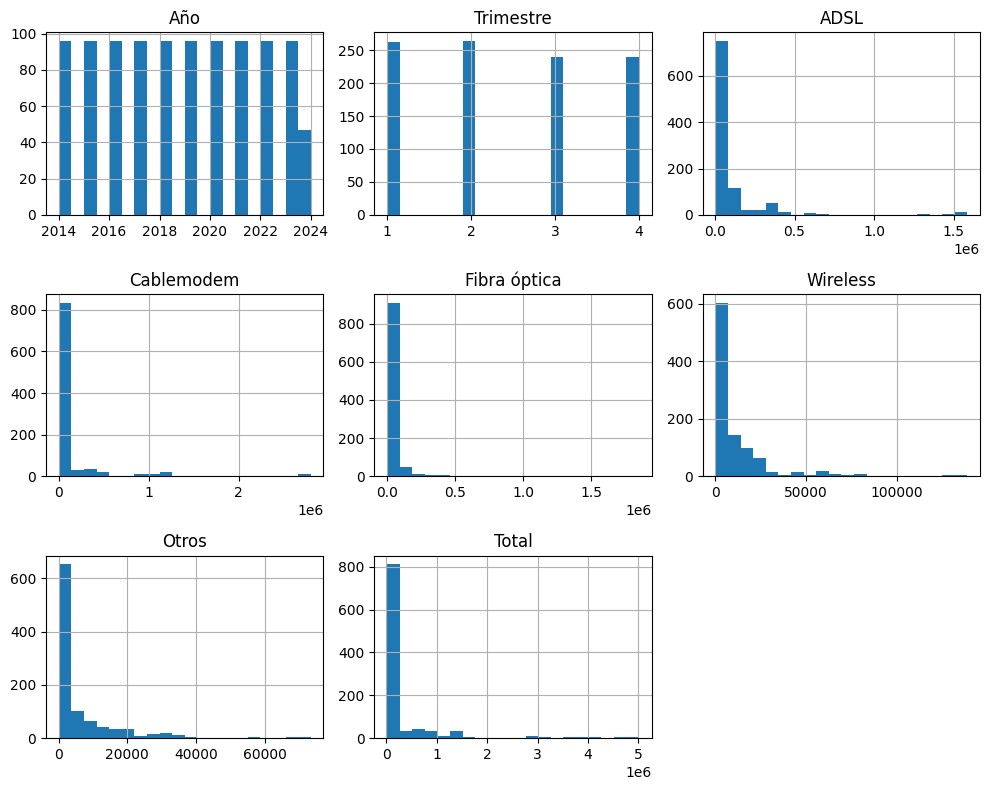

In [33]:
# 3: Estadísticas descriptivas y análisis exploratorio

# Estadísticas descriptivas para columnas numéricas y de tipo object
print("\nEstadísticas descriptivas del DataFrame (incluyendo todas las columnas):")
print(df.describe(include='all'))

# Histogramas de las columnas numéricas
df.select_dtypes(include=[np.number]).hist(bins=20, figsize=(10, 8))
plt.tight_layout()
plt.show()


Correlación entre columnas numéricas:
                   Año  Trimestre      ADSL  Cablemodem  Fibra óptica  \
Año           1.000000  -0.071444 -0.182299    0.109253      0.262781   
Trimestre    -0.071444   1.000000  0.000640    0.012193      0.009712   
ADSL         -0.182299   0.000640  1.000000    0.661300      0.258930   
Cablemodem    0.109253   0.012193  0.661300    1.000000      0.782609   
Fibra óptica  0.262781   0.009712  0.258930    0.782609      1.000000   
Wireless      0.377288   0.015224  0.297446    0.654825      0.770046   
Otros         0.236925   0.018700  0.447779    0.798114      0.697462   
Total         0.080300   0.010068  0.756485    0.981026      0.784807   

              Wireless     Otros     Total  
Año           0.377288  0.236925  0.080300  
Trimestre     0.015224  0.018700  0.010068  
ADSL          0.297446  0.447779  0.756485  
Cablemodem    0.654825  0.798114  0.981026  
Fibra óptica  0.770046  0.697462  0.784807  
Wireless      1.000000  0.711030 

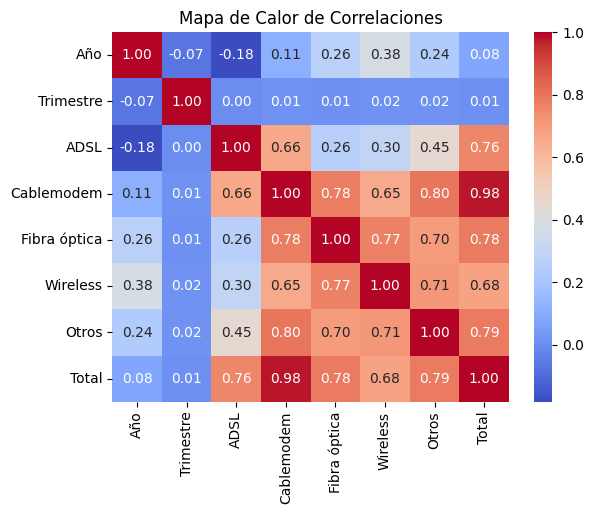

In [34]:
# Correlación entre columnas numéricas
correlacion = df.select_dtypes(include=[np.number]).corr()
print("\nCorrelación entre columnas numéricas:")
print(correlacion)

# Identificación de correlaciones fuertes
correlaciones_fuertes = correlacion[(correlacion > 0.7) | (correlacion < -0.7)]
print("\nCorrelaciones fuertes:")
print(correlaciones_fuertes)

# Visualización de la matriz de correlación
sns.heatmap(correlacion, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Mapa de Calor de Correlaciones")
plt.show()


Tabla de contingencia entre Provincia y Año_Trimestre:
Año_Trimestre        Q1-2014  Q1-2015  Q1-2016  Q1-2017  Q1-2018  Q1-2019  \
Provincia                                                                   
BUENOS AIRES               2        2        2        2        2        2   
CATAMARCA                  1        1        1        1        1        1   
CHACO                      1        1        1        1        1        1   
CHUBUT                     1        1        1        1        1        1   
CORRIENTES                 1        1        1        1        1        1   
CÓRDOBA                    1        1        1        1        1        1   
ENTRE RÍOS                 1        1        1        1        1        1   
FORMOSA                    1        1        1        1        1        1   
JUJUY                      1        1        1        1        1        1   
LA PAMPA                   1        1        1        1        1        1   
LA RIOJA            

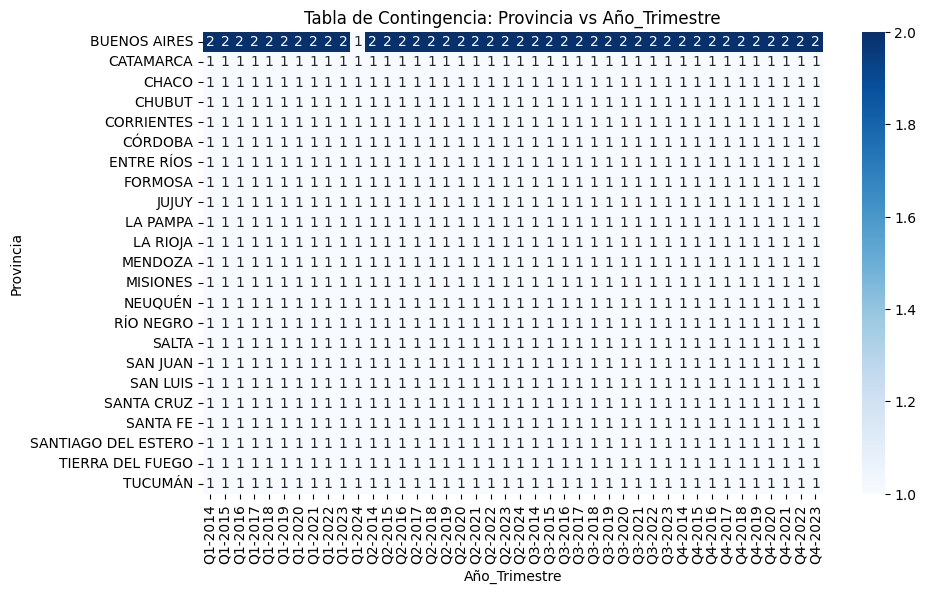


Tabla de contingencia entre Provincia y Periodo:
Periodo              01-03-2024
Provincia                      
BUENOS AIRES                 83
CATAMARCA                    42
CHACO                        42
CHUBUT                       42
CORRIENTES                   42
CÓRDOBA                      42
ENTRE RÍOS                   42
FORMOSA                      42
JUJUY                        42
LA PAMPA                     42
LA RIOJA                     42
MENDOZA                      42
MISIONES                     42
NEUQUÉN                      42
RÍO NEGRO                    42
SALTA                        42
SAN JUAN                     42
SAN LUIS                     42
SANTA CRUZ                   42
SANTA FE                     42
SANTIAGO DEL ESTERO          42
TIERRA DEL FUEGO             42
TUCUMÁN                      42


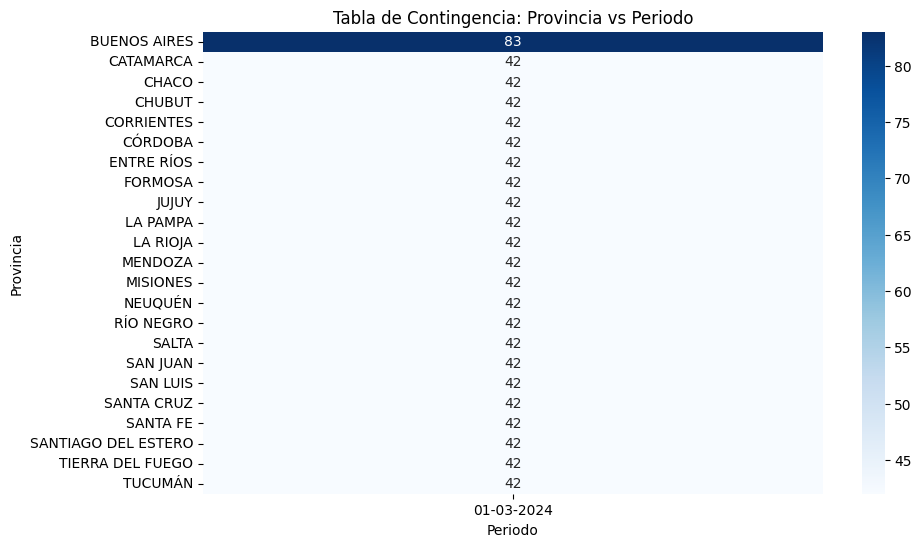


Tabla de contingencia entre Provincia y meses_periodo:
meses_periodo        abr - jun  ene - mar  jul - sep  oct - dic
Provincia                                                      
BUENOS AIRES                22         21         20         20
CATAMARCA                   11         11         10         10
CHACO                       11         11         10         10
CHUBUT                      11         11         10         10
CORRIENTES                  11         11         10         10
CÓRDOBA                     11         11         10         10
ENTRE RÍOS                  11         11         10         10
FORMOSA                     11         11         10         10
JUJUY                       11         11         10         10
LA PAMPA                    11         11         10         10
LA RIOJA                    11         11         10         10
MENDOZA                     11         11         10         10
MISIONES                    11         11       

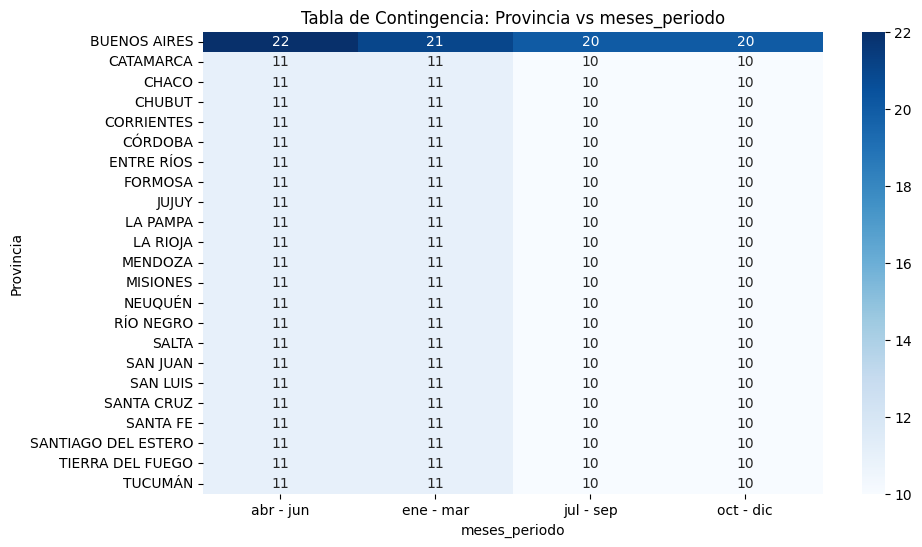


Tabla de contingencia entre Año_Trimestre y Periodo:
Periodo        01-03-2024
Año_Trimestre            
Q1-2014                24
Q1-2015                24
Q1-2016                24
Q1-2017                24
Q1-2018                24
Q1-2019                24
Q1-2020                24
Q1-2021                24
Q1-2022                24
Q1-2023                24
Q1-2024                23
Q2-2014                24
Q2-2015                24
Q2-2016                24
Q2-2017                24
Q2-2018                24
Q2-2019                24
Q2-2020                24
Q2-2021                24
Q2-2022                24
Q2-2023                24
Q2-2024                24
Q3-2014                24
Q3-2015                24
Q3-2016                24
Q3-2017                24
Q3-2018                24
Q3-2019                24
Q3-2020                24
Q3-2021                24
Q3-2022                24
Q3-2023                24
Q4-2014                24
Q4-2015                24
Q4-2016   

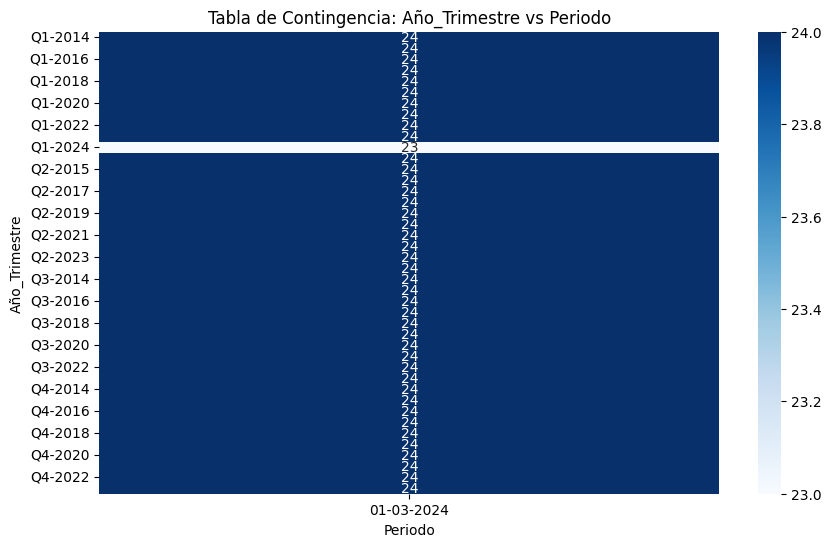


Tabla de contingencia entre Año_Trimestre y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Año_Trimestre                                            
Q1-2014                0         24          0          0
Q1-2015                0         24          0          0
Q1-2016                0         24          0          0
Q1-2017                0         24          0          0
Q1-2018                0         24          0          0
Q1-2019                0         24          0          0
Q1-2020                0         24          0          0
Q1-2021                0         24          0          0
Q1-2022                0         24          0          0
Q1-2023                0         24          0          0
Q1-2024                0         23          0          0
Q2-2014               24          0          0          0
Q2-2015               24          0          0          0
Q2-2016               24          0          0          0
Q2-2017     

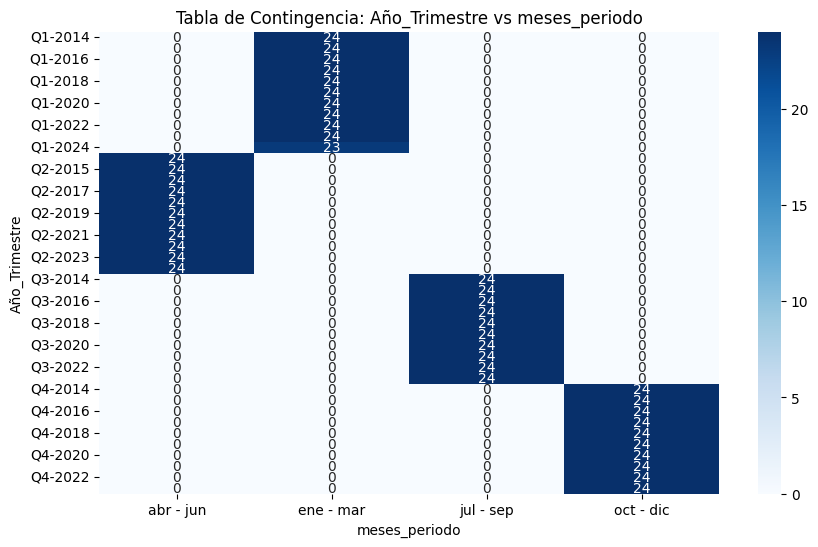


Tabla de contingencia entre Periodo y meses_periodo:
meses_periodo  abr - jun  ene - mar  jul - sep  oct - dic
Periodo                                                  
01-03-2024           264        263        240        240


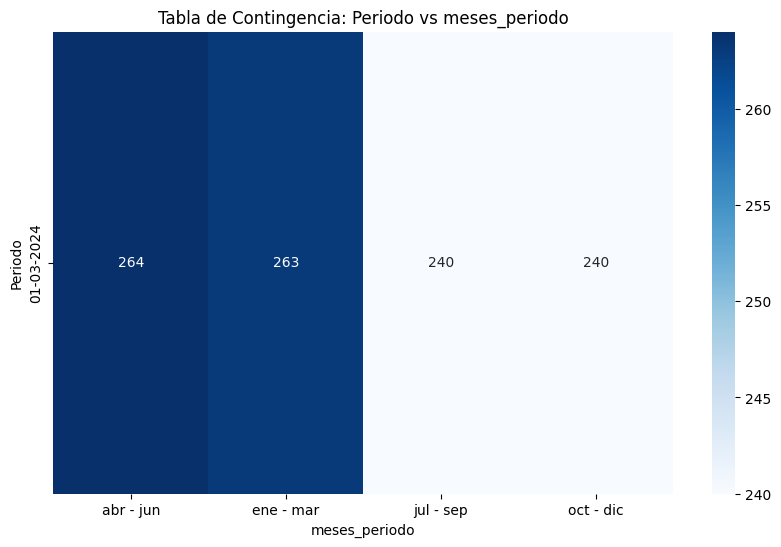

In [35]:
# Correlación entre columnas no numéricas usando tablas de contingencia
categorical_columns = df.select_dtypes(include=['object']).columns

for i in range(len(categorical_columns)):
    for j in range(i + 1, len(categorical_columns)):
        col1 = categorical_columns[i]
        col2 = categorical_columns[j]
        
        # Crear tabla de contingencia
        tabla_contingencia = pd.crosstab(df[col1], df[col2])
        
        # Mostrar tabla de contingencia solo si tiene datos
        if not tabla_contingencia.empty:
            print(f"\nTabla de contingencia entre {col1} y {col2}:")
            print(tabla_contingencia)
            
            # Visualización de la tabla de contingencia
            plt.figure(figsize=(10, 6))
            sns.heatmap(tabla_contingencia, annot=True, fmt='d', cmap='Blues')
            plt.title(f"Tabla de Contingencia: {col1} vs {col2}")
            plt.xlabel(col2)
            plt.ylabel(col1)
            plt.show()


Estadísticas descriptivas de 'Año' agrupadas por 'Provincia':
                     count         mean       std     min     25%     50%  \
Provincia                                                                   
BUENOS AIRES          83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CATAMARCA             42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                 42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA RIOJA     

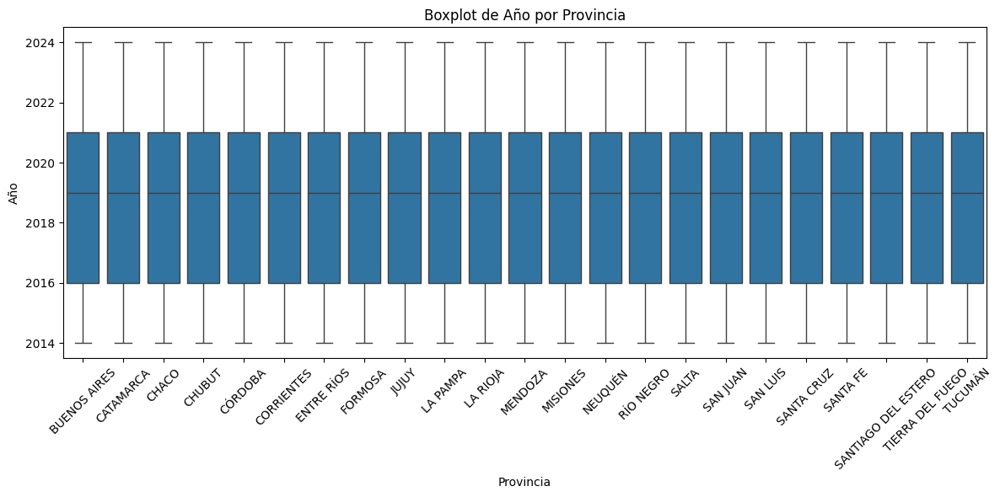


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Provincia':
                     count      mean       std  min   25%  50%  75%  max
Provincia                                                               
BUENOS AIRES          83.0  2.469880  1.118986  1.0  1.50  2.0  3.0  4.0
CATAMARCA             42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHACO                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CHUBUT                42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CORRIENTES            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
CÓRDOBA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
ENTRE RÍOS            42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
FORMOSA               42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
JUJUY                 42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA PAMPA              42.0  2.452381  1.130560  1.0  1.25  2.0  3.0  4.0
LA RIOJA              42.0  2.452381  1.130560  1.0  1.

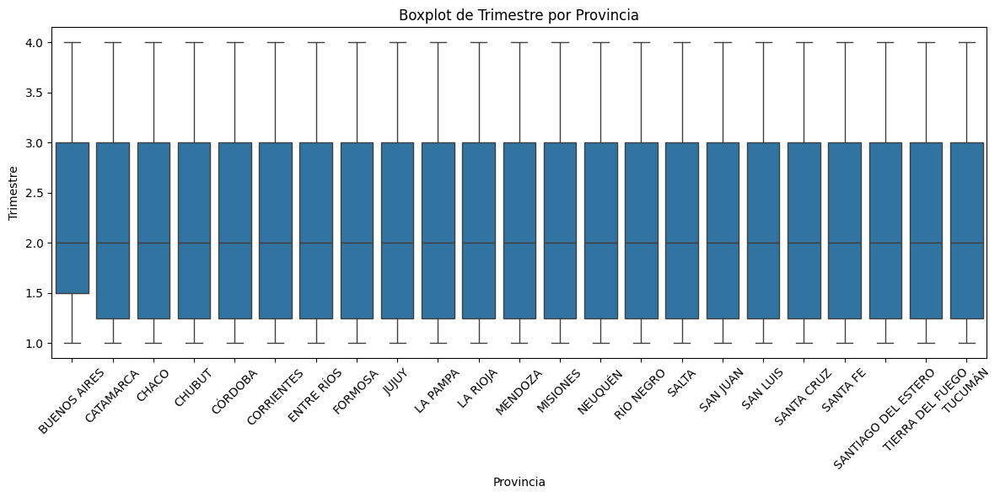


Estadísticas descriptivas de 'ADSL' agrupadas por 'Provincia':
                     count           mean            std      min        25%  \
Provincia                                                                      
BUENOS AIRES          83.0  656118.421687  537326.816748  54102.0  230548.00   
CATAMARCA             42.0   21196.000000    7689.566159   4951.0   16892.00   
CHACO                 42.0   43950.023810   14636.954270   9448.0   36225.50   
CHUBUT                42.0   44338.952381    8103.136646  25955.0   43964.75   
CORRIENTES            42.0   47442.904762   11878.964611  14849.0   43093.50   
CÓRDOBA               42.0  275394.380952   85868.451961  93483.0  216327.00   
ENTRE RÍOS            42.0   88889.738095   25214.100847  31335.0   71455.00   
FORMOSA               42.0   19377.214286    4326.592167   8488.0   17431.50   
JUJUY                 42.0   27923.904762    7894.817939   9509.0   22636.00   
LA PAMPA              42.0   11546.809524    3786.629193

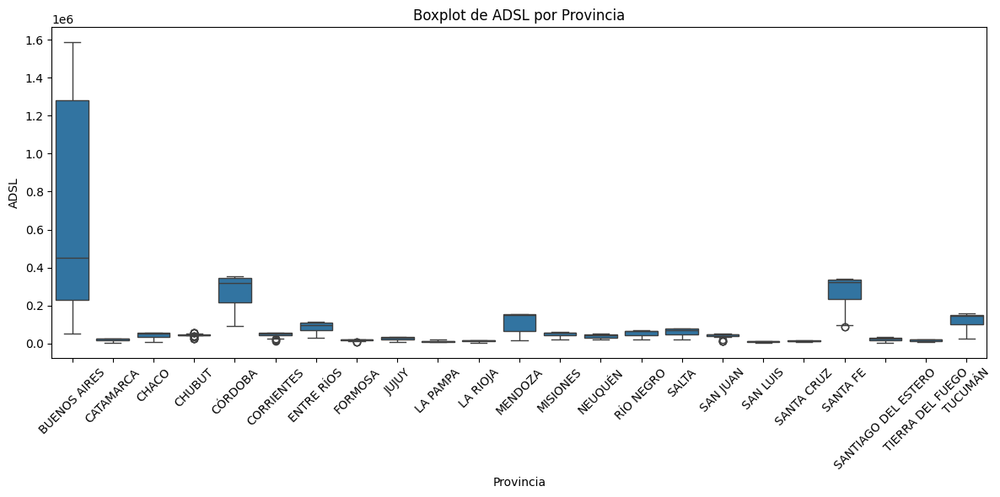


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'Provincia':
                     count          mean            std       min         25%  \
Provincia                                                                       
BUENOS AIRES          83.0  1.497288e+06  651978.269106  820161.0  1022490.00   
CATAMARCA             42.0  5.015857e+03    4672.185792      46.0      248.00   
CHACO                 42.0  4.467529e+04   16774.710687    9497.0    32931.00   
CHUBUT                42.0  3.097721e+04   29017.359309     539.0      940.00   
CORRIENTES            42.0  4.922371e+04   24111.466920    8279.0    30984.00   
CÓRDOBA               42.0  3.667386e+05   87847.192209  225769.0   286446.00   
ENTRE RÍOS            42.0  9.256955e+04   41007.976308   21379.0    62422.75   
FORMOSA               42.0  1.042748e+04    5806.648054    4548.0     5944.00   
JUJUY                 42.0  2.909938e+04   22397.635251    3541.0     8359.75   
LA PAMPA              42.0  5.133271e+0

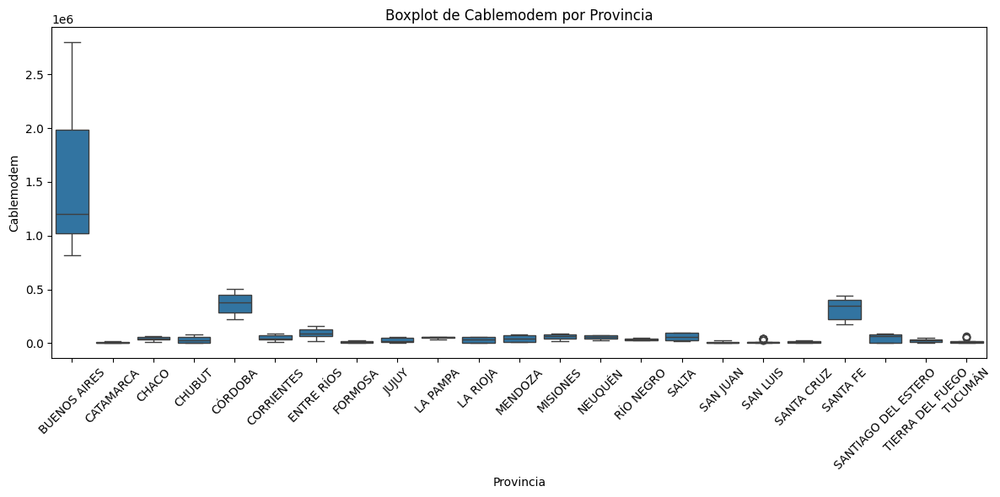


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'Provincia':
                     count           mean            std      min       25%  \
Provincia                                                                     
BUENOS AIRES          83.0  336438.638554  500567.064358  17155.0  37478.50   
CATAMARCA             42.0   15549.928571   20889.202320     11.0     15.00   
CHACO                 42.0   17697.380952   22176.279217     29.0    236.00   
CHUBUT                42.0    5533.833333    7744.925133    866.0    916.00   
CORRIENTES            42.0    8018.142857   12749.450166     31.0    205.25   
CÓRDOBA               42.0  122107.833333  160844.481957    347.0   2747.00   
ENTRE RÍOS            42.0   16365.928571   20353.125170     48.0    211.00   
FORMOSA               42.0    3956.690476    5813.775741      0.0     10.75   
JUJUY                 42.0   13271.904762   18886.411438     20.0     22.00   
LA PAMPA              42.0   12560.238095   10977.659704   

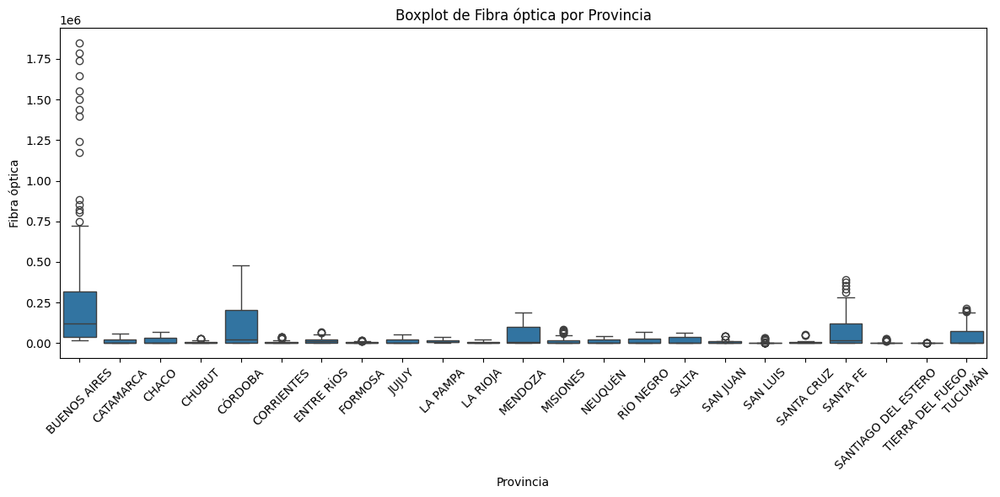


Estadísticas descriptivas de 'Wireless' agrupadas por 'Provincia':
                     count          mean           std      min       25%  \
Provincia                                                                   
BUENOS AIRES          83.0  37615.216867  46980.732066   1866.0   3912.50   
CATAMARCA             42.0    483.119048    630.380497      0.0      1.00   
CHACO                 42.0   4039.880952   3665.886997      0.0     52.00   
CHUBUT                42.0  19190.761905   7485.821743  10776.0  13310.75   
CORRIENTES            42.0   4117.928571   3471.149183   1306.0   1354.00   
CÓRDOBA               42.0  31580.119048  24412.657045   3585.0   5688.25   
ENTRE RÍOS            42.0  15446.166667   8159.692205   4795.0   6435.75   
FORMOSA               42.0   9627.619048   7436.229358      0.0   1023.00   
JUJUY                 42.0   1467.547619   1705.880807      0.0      5.75   
LA PAMPA              42.0  11755.214286   5463.863555   5848.0   6253.00   
LA RIOJA

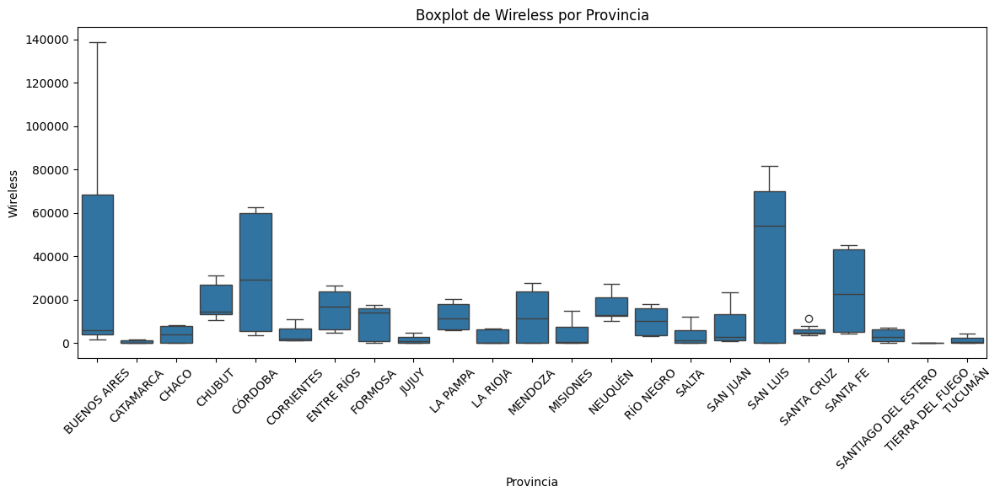


Estadísticas descriptivas de 'Otros' agrupadas por 'Provincia':
                     count          mean           std     min       25%  \
Provincia                                                                  
BUENOS AIRES          83.0  31159.939759  19107.760083  4257.0  15055.00   
CATAMARCA             42.0   1242.571429   1098.008666    18.0     43.00   
CHACO                 42.0   1513.904762   1977.584321    15.0     58.00   
CHUBUT                42.0   8740.095238   5059.380945  3045.0   4969.25   
CORRIENTES            42.0   2657.000000   2651.270418    22.0     43.50   
CÓRDOBA               42.0   7752.333333   5564.671426   368.0    864.00   
ENTRE RÍOS            42.0   7074.857143   6492.613096    63.0    133.50   
FORMOSA               42.0    132.500000    107.291090     2.0     52.25   
JUJUY                 42.0   5173.190476  10357.168822     8.0     35.00   
LA PAMPA              42.0   1200.714286    744.264190   374.0    655.25   
LA RIOJA              4

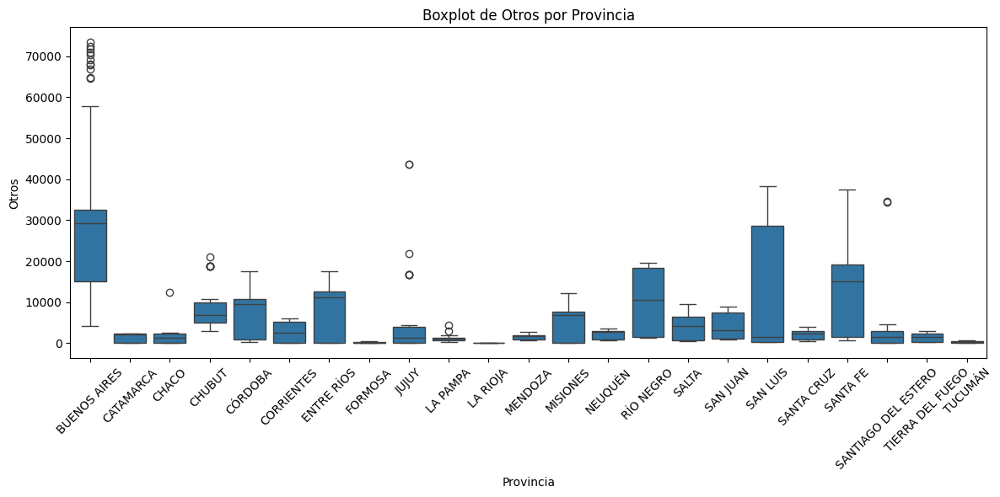


Estadísticas descriptivas de 'Total' agrupadas por 'Provincia':
                     count          mean           std        min         25%  \
Provincia                                                                       
BUENOS AIRES          83.0  2.558620e+06  1.273338e+06  1299918.0  1399323.00   
CATAMARCA             42.0  4.348748e+04  1.852289e+04    24232.0    26593.25   
CHACO                 42.0  1.118765e+05  2.835435e+04    62556.0    88897.75   
CHUBUT                42.0  1.087809e+05  4.230857e+04    63485.0    68690.75   
CORRIENTES            42.0  1.114597e+05  3.018395e+04    62236.0    88157.00   
CÓRDOBA               42.0  8.035733e+05  1.781102e+05   566910.0   637716.00   
ENTRE RÍOS            42.0  2.203462e+05  4.881106e+04   134331.0   180272.00   
FORMOSA               42.0  4.352150e+04  1.402682e+04    25422.0    28979.75   
JUJUY                 42.0  7.693593e+04  3.500853e+04    33741.0    42559.75   
LA PAMPA              42.0  8.839569e+04  2.

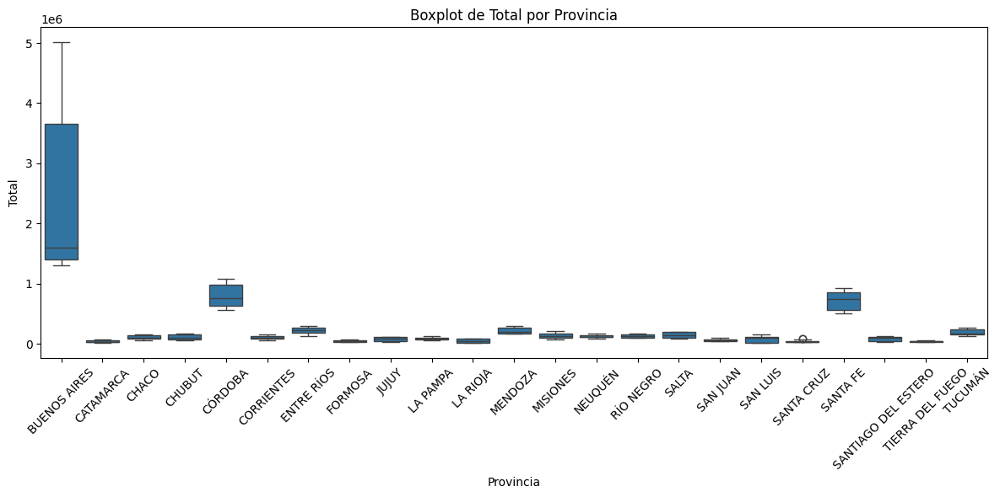


Estadísticas descriptivas de 'Año' agrupadas por 'Año_Trimestre':
               count    mean  std     min     25%     50%     75%     max
Año_Trimestre                                                            
Q1-2014         24.0  2014.0  0.0  2014.0  2014.0  2014.0  2014.0  2014.0
Q1-2015         24.0  2015.0  0.0  2015.0  2015.0  2015.0  2015.0  2015.0
Q1-2016         24.0  2016.0  0.0  2016.0  2016.0  2016.0  2016.0  2016.0
Q1-2017         24.0  2017.0  0.0  2017.0  2017.0  2017.0  2017.0  2017.0
Q1-2018         24.0  2018.0  0.0  2018.0  2018.0  2018.0  2018.0  2018.0
Q1-2019         24.0  2019.0  0.0  2019.0  2019.0  2019.0  2019.0  2019.0
Q1-2020         24.0  2020.0  0.0  2020.0  2020.0  2020.0  2020.0  2020.0
Q1-2021         24.0  2021.0  0.0  2021.0  2021.0  2021.0  2021.0  2021.0
Q1-2022         24.0  2022.0  0.0  2022.0  2022.0  2022.0  2022.0  2022.0
Q1-2023         24.0  2023.0  0.0  2023.0  2023.0  2023.0  2023.0  2023.0
Q1-2024         23.0  2024.0  0.0  2024.0  20

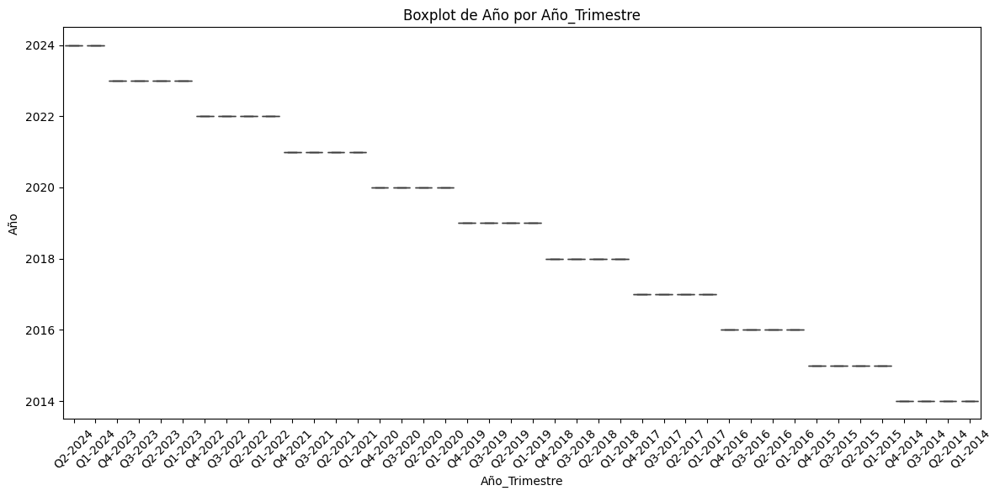


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Año_Trimestre':
               count  mean  std  min  25%  50%  75%  max
Año_Trimestre                                           
Q1-2014         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2015         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2016         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2017         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2018         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2019         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2020         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2021         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2022         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2023         24.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q1-2024         23.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
Q2-2014         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2015         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2016         24.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
Q2-2017        

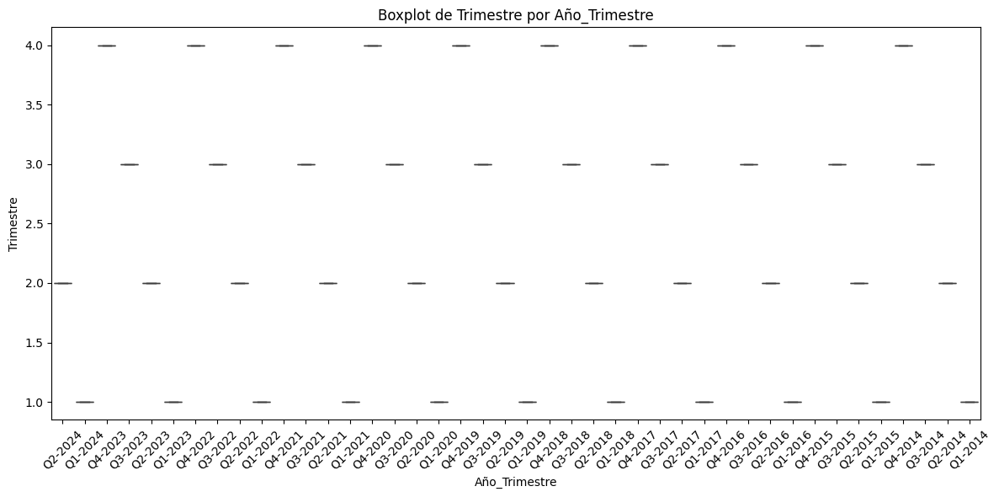


Estadísticas descriptivas de 'ADSL' agrupadas por 'Año_Trimestre':
               count           mean            std      min       25%  \
Año_Trimestre                                                           
Q1-2014         24.0  154044.416667  322007.060769  11306.0  23499.00   
Q1-2015         24.0  156506.375000  325542.230265  11414.0  24347.50   
Q1-2016         24.0  158020.541667  325812.337636  11432.0  25231.00   
Q1-2017         24.0  154537.416667  319666.756241  11432.0  25174.00   
Q1-2018         24.0  148928.916667  297153.123478  10807.0  25980.00   
Q1-2019         24.0  138595.166667  268277.052171  10659.0  24645.25   
Q1-2020         24.0   95810.708333  147224.223748   8301.0  21725.75   
Q1-2021         24.0   90633.791667  136210.336400   8417.0  24902.75   
Q1-2022         24.0   63885.000000   88204.854603   7987.0  15843.00   
Q1-2023         24.0   50184.041667   67495.953350   4652.0  12287.00   
Q1-2024         23.0   24833.826087   26552.363678   282

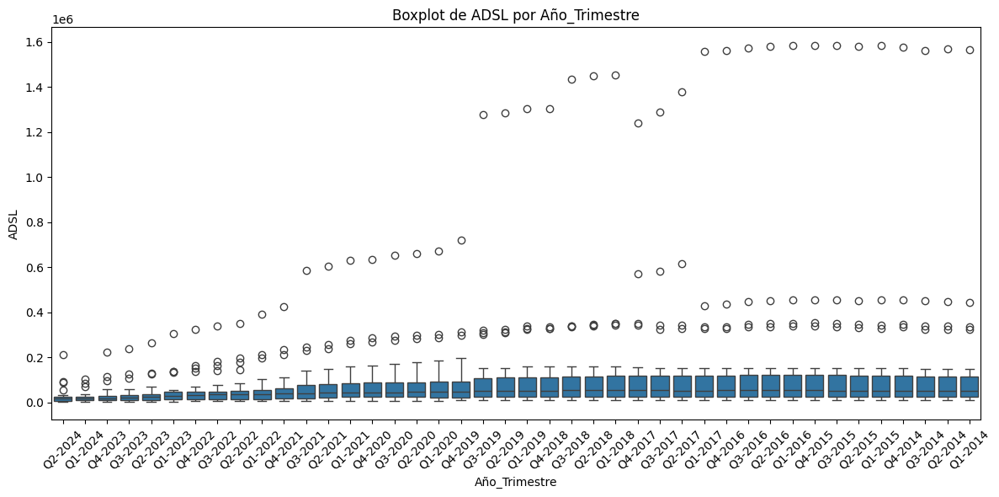


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'Año_Trimestre':
               count           mean            std      min       25%  \
Año_Trimestre                                                           
Q1-2014         24.0  100305.416667  256911.863821      0.0    512.75   
Q1-2015         24.0  111177.000000  273787.445393      0.0   2281.25   
Q1-2016         24.0  116931.625000  289109.045013      0.0   2583.50   
Q1-2017         24.0  136510.458333  342401.024327      0.0   3605.50   
Q1-2018         24.0  165880.375000  402126.312405   4415.0   9477.50   
Q1-2019         24.0  184809.958333  447653.915876   4443.0  12280.50   
Q1-2020         24.0  204319.750000  486646.071156   3146.0  23165.50   
Q1-2021         24.0  226032.583333  533158.039073   4409.0  26207.50   
Q1-2022         24.0  253059.416667  587230.225426  11296.0  43699.50   
Q1-2023         24.0  250107.583333  592637.147046  10655.0  43056.75   
Q1-2024         23.0  138969.304348  251909.334211

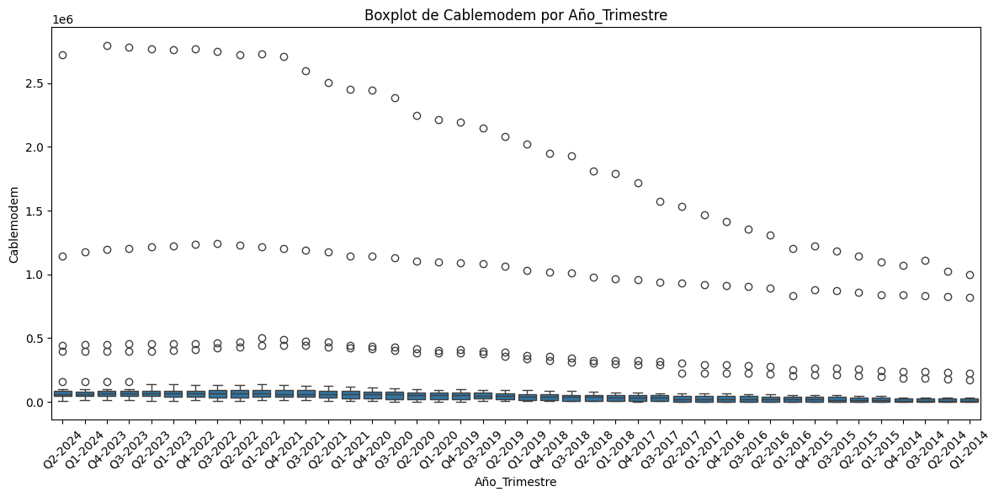


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'Año_Trimestre':
               count           mean            std     min       25%      50%  \
Año_Trimestre                                                                   
Q1-2014         24.0    6263.458333   24693.849636     0.0     28.25    350.5   
Q1-2015         24.0    7007.833333   27368.456435     1.0     42.75    371.5   
Q1-2016         24.0    6848.791667   23412.831523     5.0     72.25    375.0   
Q1-2017         24.0    7506.083333   24941.620867    14.0    110.75    509.5   
Q1-2018         24.0    9060.833333   27678.489604    13.0    115.25    857.0   
Q1-2019         24.0   18483.500000   68163.930808    12.0    381.00   1619.0   
Q1-2020         24.0   43659.041667  145263.749620     0.0   1298.00  10706.0   
Q1-2021         24.0   56790.666667  165800.288200     1.0   3417.25  16312.5   
Q1-2022         24.0   92480.541667  251082.360721    31.0  10461.00  24685.5   
Q1-2023         24.0  135142.1250

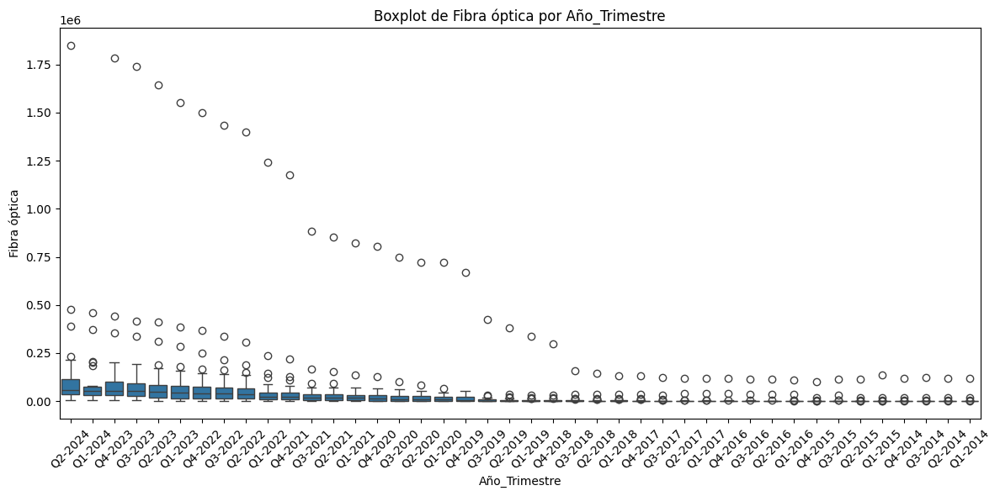


Estadísticas descriptivas de 'Wireless' agrupadas por 'Año_Trimestre':
               count          mean           std    min      25%      50%  \
Año_Trimestre                                                               
Q1-2014         24.0   2947.875000   4329.302969    0.0     6.25    861.5   
Q1-2015         24.0   3295.750000   4893.113344    0.0    28.50   1092.5   
Q1-2016         24.0   3557.083333   5338.641961    0.0    32.25   1109.0   
Q1-2017         24.0   3533.875000   5289.588686    0.0    23.00   1048.0   
Q1-2018         24.0   6887.500000  13220.521134    1.0   240.75   1924.5   
Q1-2019         24.0  11517.458333  16395.352507    0.0  1020.75   5246.0   
Q1-2020         24.0  14680.541667  20689.396303    0.0  2166.50   6949.5   
Q1-2021         24.0  18106.166667  23816.702403    0.0  4663.00   9743.0   
Q1-2022         24.0  22742.250000  28665.383404  124.0  5908.50  12489.5   
Q1-2023         24.0  24026.958333  29962.148944  157.0  5947.50  14876.5   
Q1-2

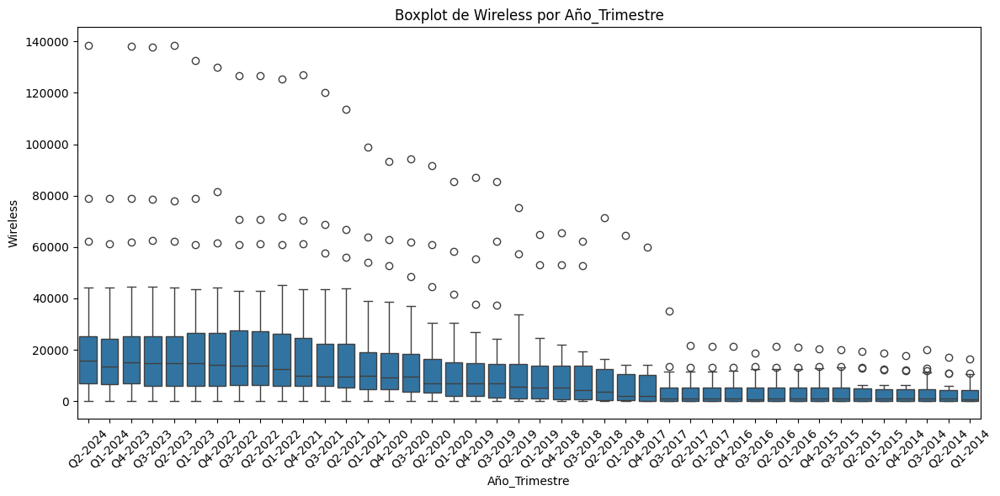


Estadísticas descriptivas de 'Otros' agrupadas por 'Año_Trimestre':
               count          mean           std   min      25%     50%  \
Año_Trimestre                                                             
Q1-2014         24.0   3038.750000   7289.569101   8.0    57.25   508.0   
Q1-2015         24.0   2751.875000   6376.910744  13.0    56.00   512.0   
Q1-2016         24.0   2448.458333   5646.172108  14.0    39.50   446.5   
Q1-2017         24.0   2322.750000   5245.826699   8.0    34.00   598.0   
Q1-2018         24.0   4119.583333   7002.324669  33.0    74.25  1889.0   
Q1-2019         24.0   6932.875000  10414.497973  41.0  1110.75  2311.5   
Q1-2020         24.0   8714.375000   9798.070608  29.0  1367.25  5052.5   
Q1-2021         24.0  10435.625000  14085.402644  30.0   809.75  4591.0   
Q1-2022         24.0  10499.833333  15100.946025  31.0  1018.00  4674.5   
Q1-2023         24.0   8951.583333  15317.214379  32.0  1177.00  3222.0   
Q1-2024         23.0   6810.739

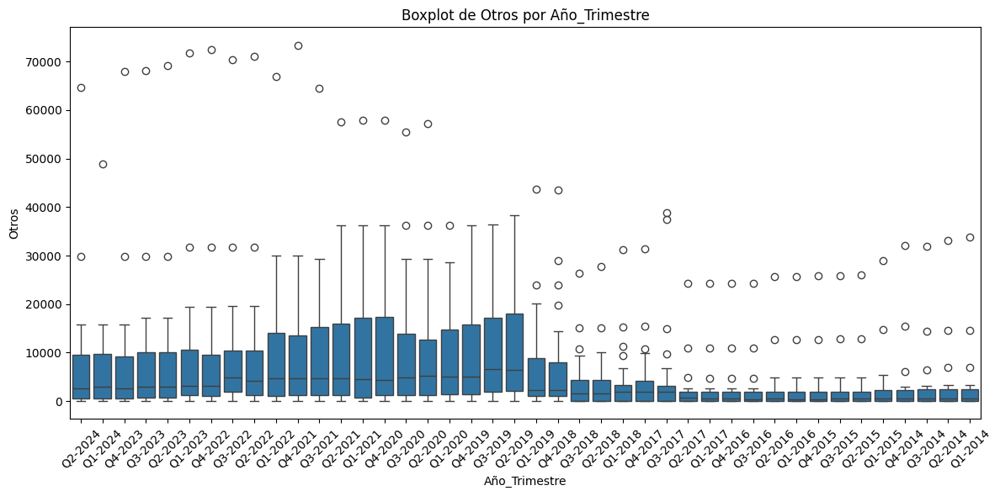


Estadísticas descriptivas de 'Total' agrupadas por 'Año_Trimestre':
               count           mean           std      min        25%  \
Año_Trimestre                                                           
Q1-2014         24.0  266599.916667  5.965974e+05  12557.0   32379.75   
Q1-2015         24.0  280738.833333  6.206739e+05  13232.0   35822.25   
Q1-2016         24.0  287806.500000  6.355708e+05  13232.0   35895.00   
Q1-2017         24.0  304410.583333  6.851751e+05  13307.0   33995.50   
Q1-2018         24.0  334877.208333  7.355703e+05  21396.0   50285.25   
Q1-2019         24.0  360338.958333  7.867979e+05  24905.0   75444.75   
Q1-2020         24.0  367184.416667  7.771887e+05  38794.0   82977.25   
Q1-2021         24.0  401998.833333  8.444320e+05  40422.0   92395.50   
Q1-2022         24.0  442667.041667  9.394311e+05  49102.0  104343.50   
Q1-2023         24.0  468412.291667  9.954044e+05  50361.0  112819.75   
Q1-2024         23.0  286460.826087  3.671431e+05  6155

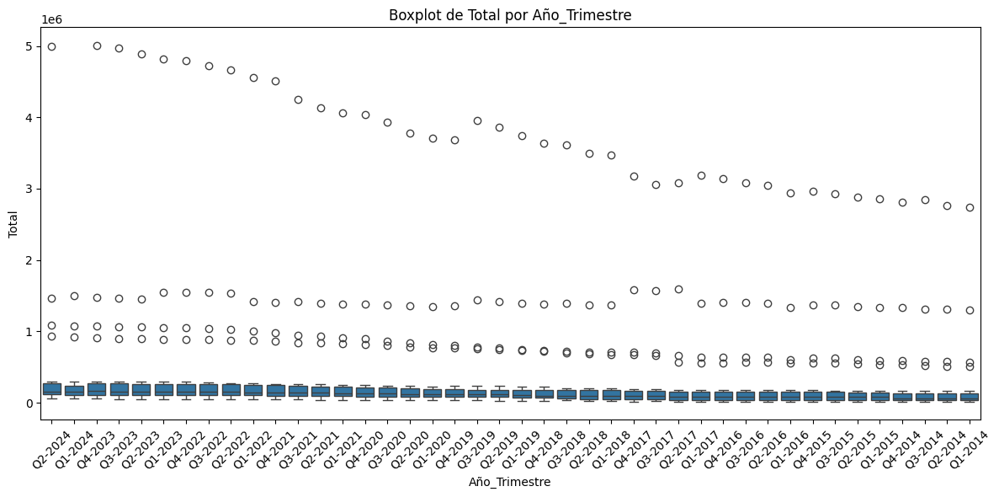


Estadísticas descriptivas de 'Año' agrupadas por 'Periodo':
             count         mean       std     min     25%     50%     75%  \
Periodo                                                                     
01-03-2024  1007.0  2018.756703  3.036457  2014.0  2016.0  2019.0  2021.0   

               max  
Periodo             
01-03-2024  2024.0  


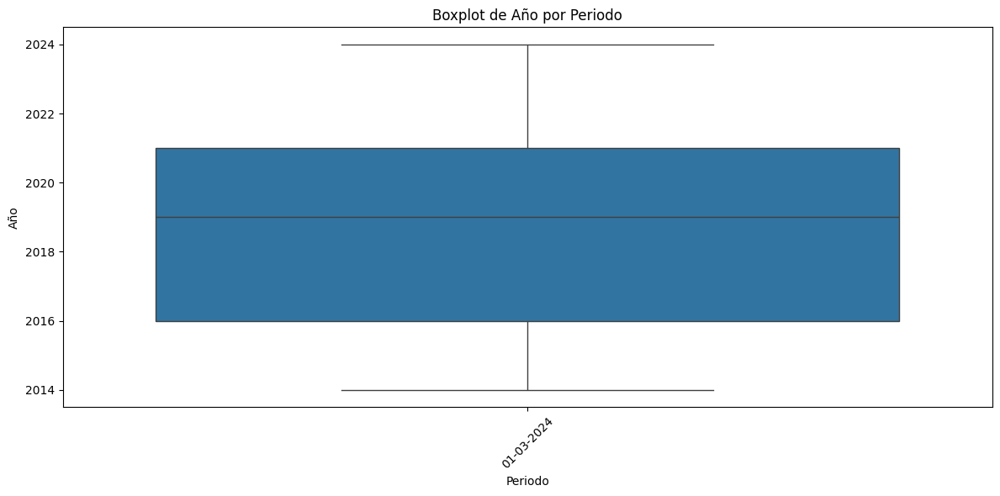


Estadísticas descriptivas de 'Trimestre' agrupadas por 'Periodo':
             count      mean      std  min  25%  50%  75%  max
Periodo                                                       
01-03-2024  1007.0  2.453823  1.11719  1.0  1.0  2.0  3.0  4.0


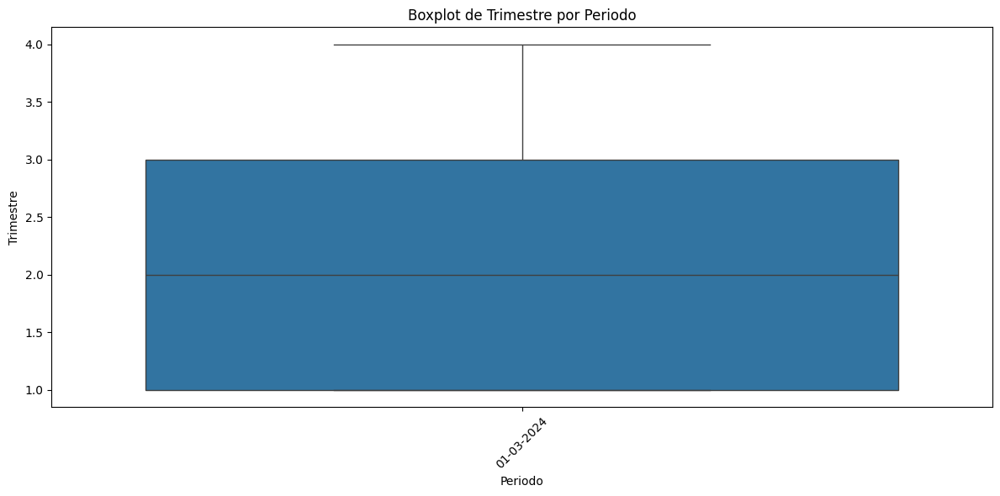


Estadísticas descriptivas de 'ADSL' agrupadas por 'Periodo':
             count           mean            std     min      25%      50%  \
Periodo                                                                      
01-03-2024  1007.0  112930.860973  236292.179471  2230.0  19789.5  43967.0   

                75%        max  
Periodo                         
01-03-2024  87220.0  1586343.0  


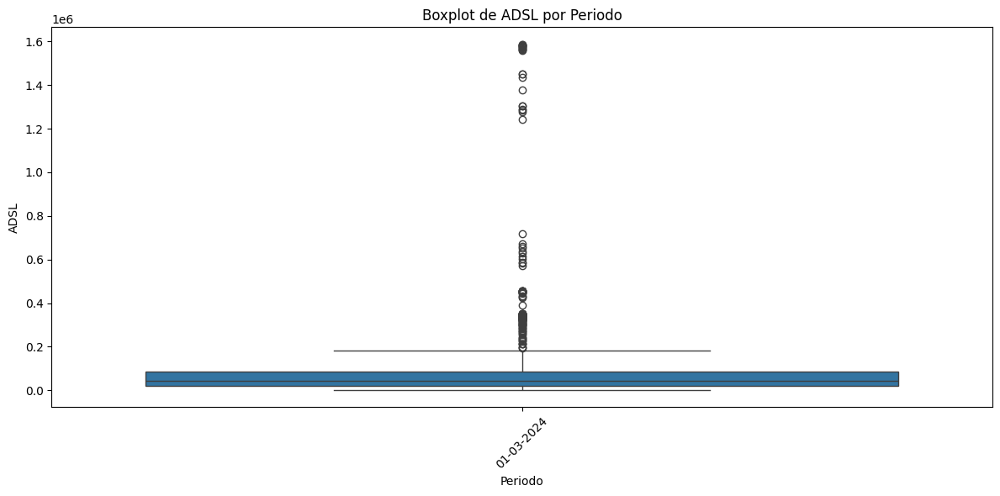


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'Periodo':
             count           mean            std  min      25%      50%  \
Periodo                                                                   
01-03-2024  1007.0  182158.281033  446005.777989  0.0  11020.5  40750.0   

                75%        max  
Periodo                         
01-03-2024  76783.5  2797700.0  


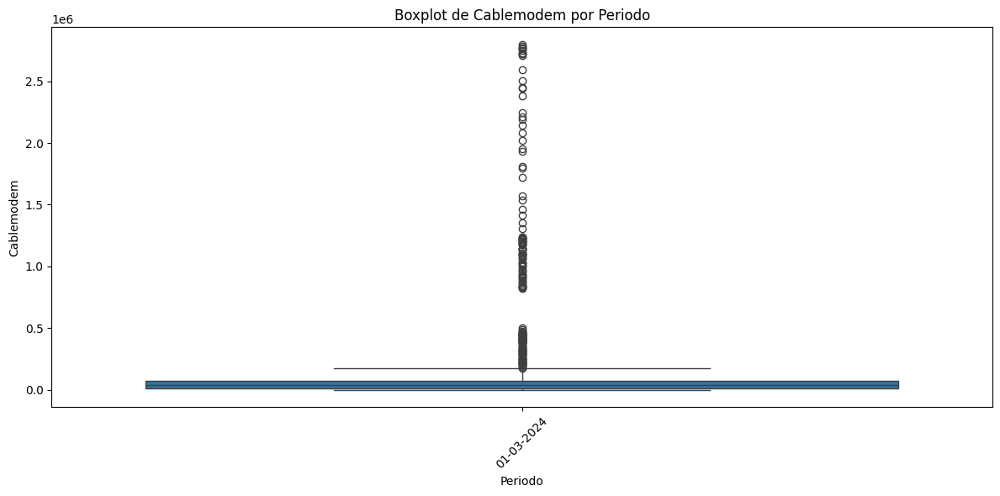


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'Periodo':
             count          mean           std  min    25%     50%      75%  \
Periodo                                                                       
01-03-2024  1007.0  48556.986097  175869.37569  0.0  354.0  3015.0  29257.0   

                  max  
Periodo                
01-03-2024  1849476.0  


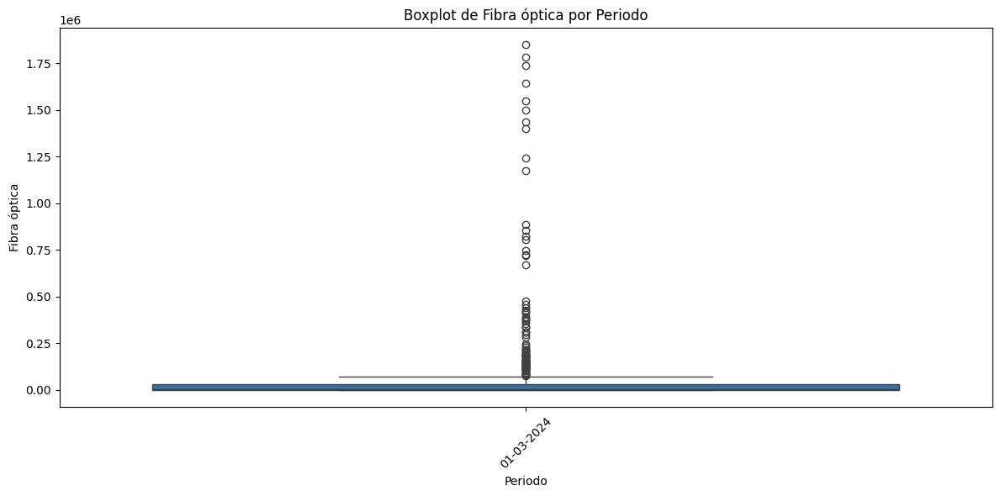


Estadísticas descriptivas de 'Wireless' agrupadas por 'Periodo':
             count          mean           std  min    25%     50%      75%  \
Periodo                                                                       
01-03-2024  1007.0  12542.229394  20909.412762  0.0  813.0  5224.0  14367.5   

                 max  
Periodo               
01-03-2024  138638.0  


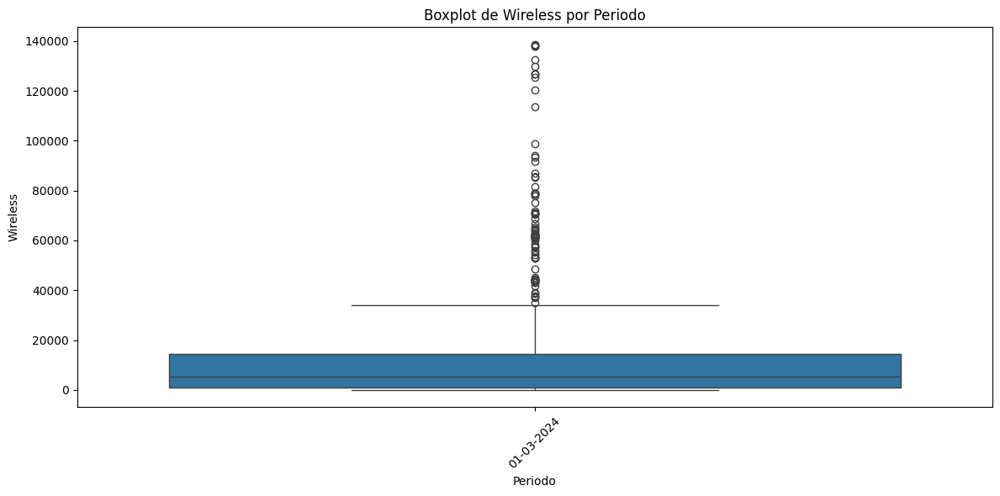


Estadísticas descriptivas de 'Otros' agrupadas por 'Periodo':
             count         mean           std  min    25%     50%     75%  \
Periodo                                                                     
01-03-2024  1007.0  6497.041708  11239.855091  2.0  334.5  1920.0  7548.0   

                max  
Periodo              
01-03-2024  73415.0  


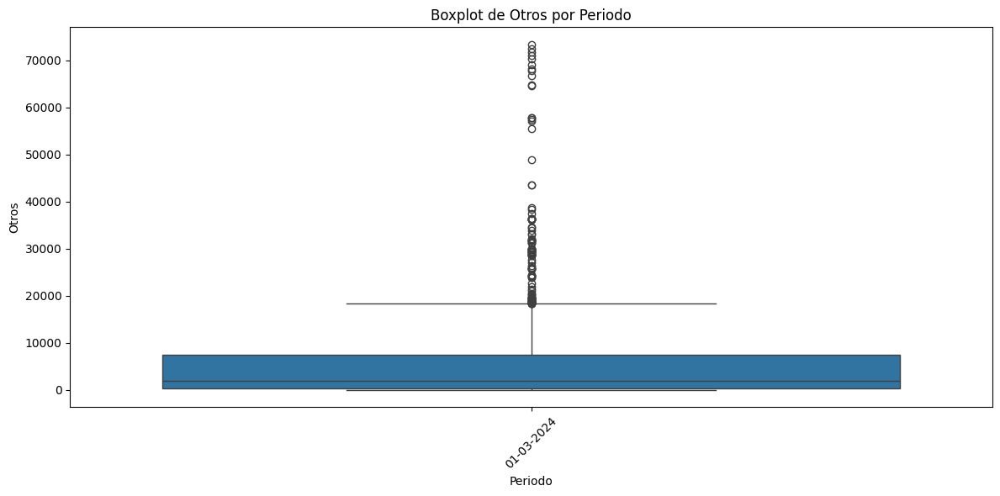


Estadísticas descriptivas de 'Total' agrupadas por 'Periodo':
             count           mean            std      min      25%       50%  \
Periodo                                                                        
01-03-2024  1007.0  362685.399206  777313.747461  12557.0  62411.5  113915.0   

                 75%        max  
Periodo                          
01-03-2024  195652.0  5011620.0  


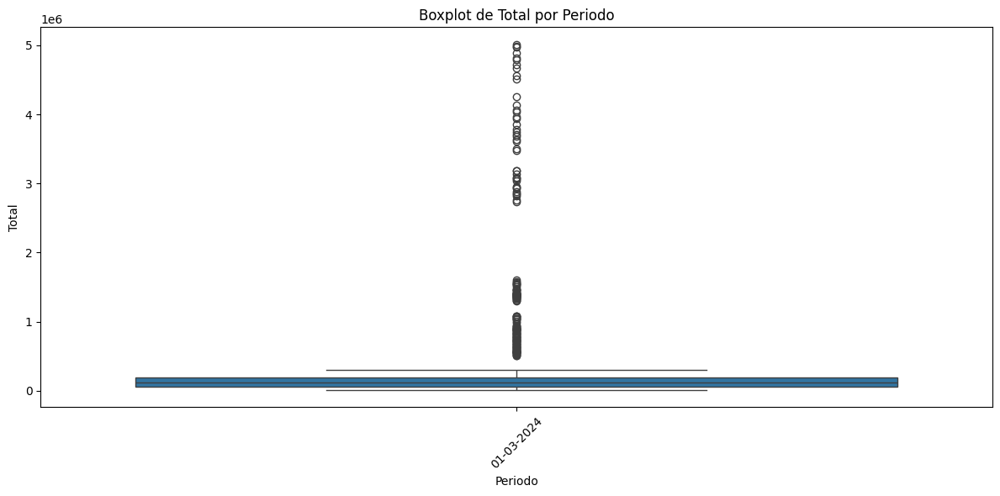


Estadísticas descriptivas de 'Año' agrupadas por 'meses_periodo':
               count         mean       std     min     25%     50%     75%  \
meses_periodo                                                                 
abr - jun      264.0  2019.000000  3.168284  2014.0  2016.0  2019.0  2022.0   
ene - mar      263.0  2018.980989  3.159201  2014.0  2016.0  2019.0  2022.0   
jul - sep      240.0  2018.500000  2.878284  2014.0  2016.0  2018.5  2021.0   
oct - dic      240.0  2018.500000  2.878284  2014.0  2016.0  2018.5  2021.0   

                  max  
meses_periodo          
abr - jun      2024.0  
ene - mar      2024.0  
jul - sep      2023.0  
oct - dic      2023.0  


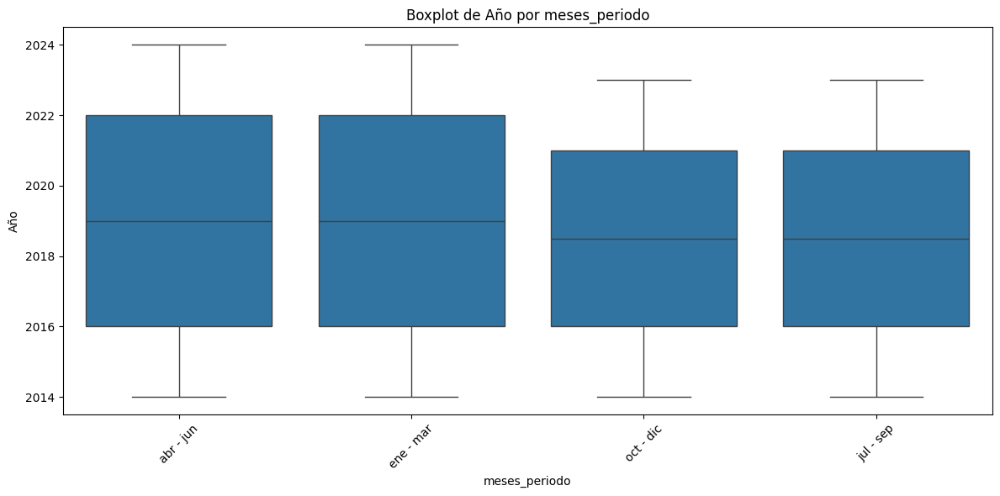


Estadísticas descriptivas de 'Trimestre' agrupadas por 'meses_periodo':
               count  mean  std  min  25%  50%  75%  max
meses_periodo                                           
abr - jun      264.0   2.0  0.0  2.0  2.0  2.0  2.0  2.0
ene - mar      263.0   1.0  0.0  1.0  1.0  1.0  1.0  1.0
jul - sep      240.0   3.0  0.0  3.0  3.0  3.0  3.0  3.0
oct - dic      240.0   4.0  0.0  4.0  4.0  4.0  4.0  4.0


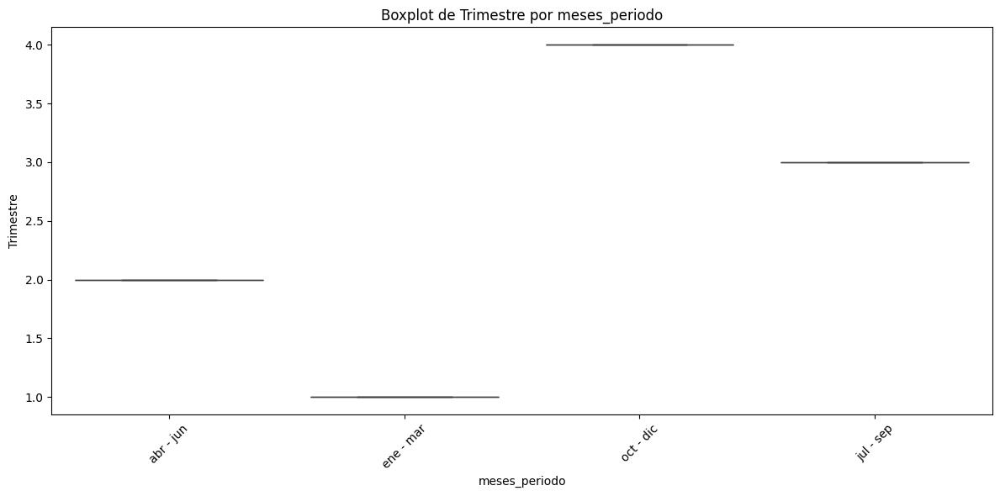


Estadísticas descriptivas de 'ADSL' agrupadas por 'meses_periodo':
               count           mean            std     min       25%      50%  \
meses_periodo                                                                   
abr - jun      264.0  111006.704545  235767.420631  2230.0  19546.00  41378.5   
ene - mar      263.0  112694.642586  240053.885290  2827.0  20226.00  43967.0   
jul - sep      240.0  117232.583333  242223.406502  3726.0  20750.50  45564.5   
oct - dic      240.0  111004.566667  227987.882400  3296.0  19684.75  42280.0   

                    75%        max  
meses_periodo                       
abr - jun      81611.25  1581770.0  
ene - mar      85118.00  1583560.0  
jul - sep      91582.50  1585467.0  
oct - dic      87222.75  1586343.0  


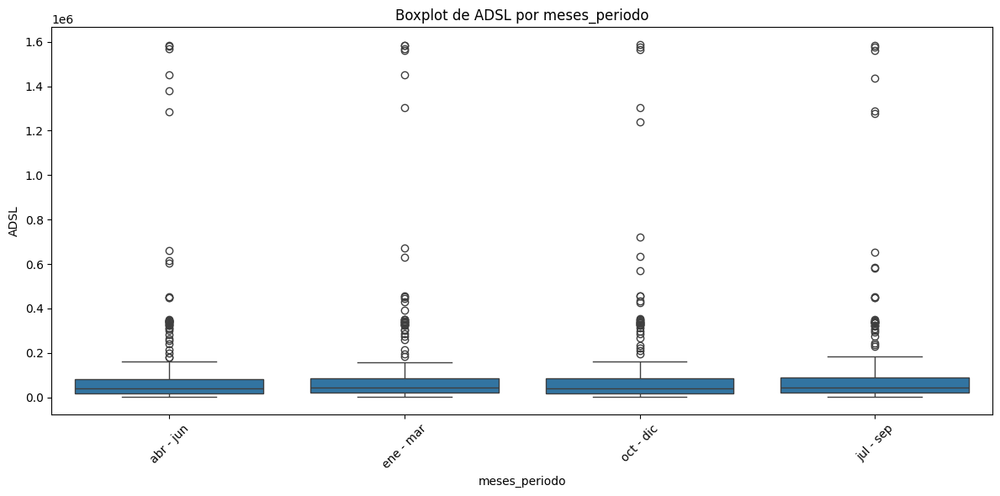


Estadísticas descriptivas de 'Cablemodem' agrupadas por 'meses_periodo':
               count           mean            std  min      25%      50%  \
meses_periodo                                                               
abr - jun      264.0  184852.647727  453657.698878  0.0  10817.0  41161.0   
ene - mar      263.0  171770.015209  420486.785820  0.0  10666.5  39571.0   
jul - sep      240.0  184915.912500  452045.888773  0.0  11013.5  40752.5   
oct - dic      240.0  187820.654167  460968.152934  0.0  11540.0  41657.5   

                    75%        max  
meses_periodo                       
abr - jun      78128.00  2766463.0  
ene - mar      75672.00  2761043.0  
jul - sep      76146.25  2784175.0  
oct - dic      77366.25  2797700.0  


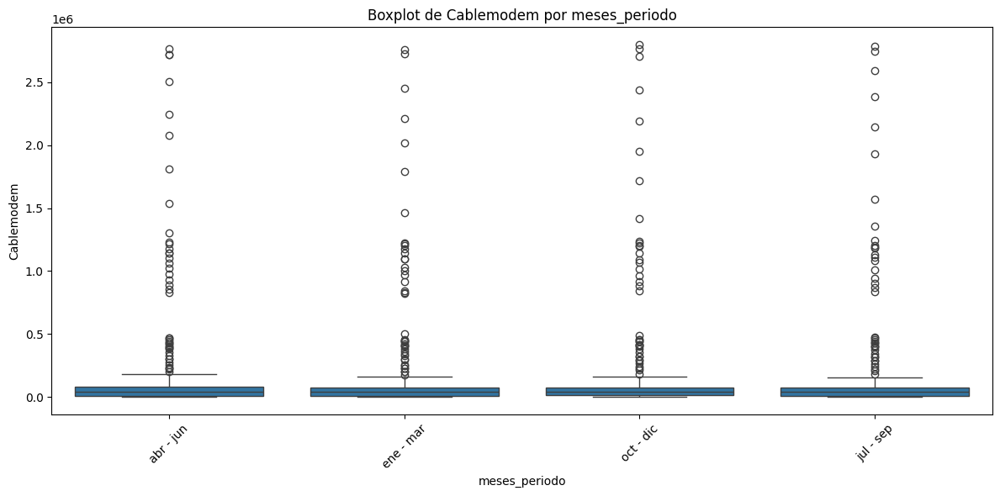


Estadísticas descriptivas de 'Fibra óptica' agrupadas por 'meses_periodo':
               count          mean            std  min    25%     50%  \
meses_periodo                                                           
abr - jun      264.0  54237.537879  194897.824147  0.0  354.0  3422.0   
ene - mar      263.0  43398.923954  149379.917197  0.0  349.0  2891.0   
jul - sep      240.0  45018.304167  170552.627605  0.0  354.0  2556.0   
oct - dic      240.0  51499.437500  186427.308101  0.0  386.5  3173.5   

                    75%        max  
meses_periodo                       
abr - jun      33782.75  1849476.0  
ene - mar      28092.50  1551074.0  
jul - sep      23794.50  1740239.0  
oct - dic      30252.25  1784593.0  


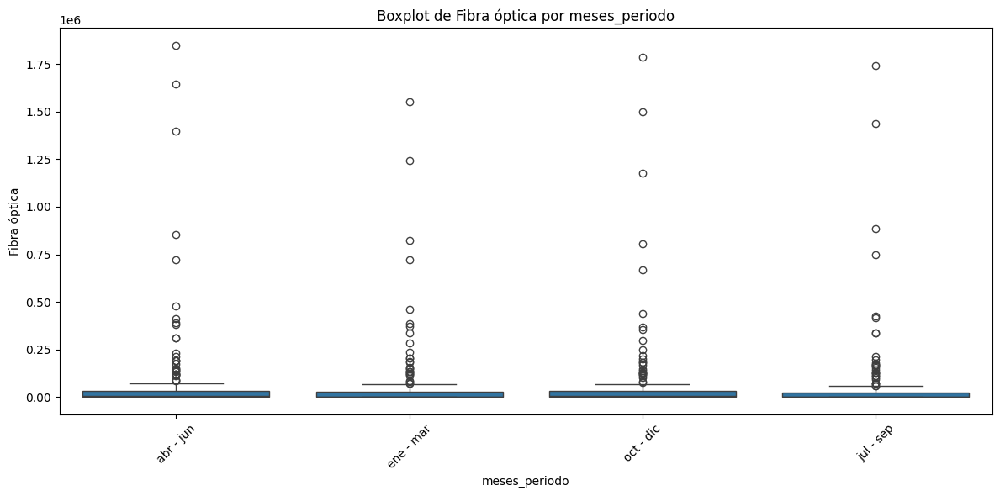


Estadísticas descriptivas de 'Wireless' agrupadas por 'meses_periodo':
               count          mean           std  min     25%     50%  \
meses_periodo                                                           
abr - jun      264.0  12927.799242  21757.634275  0.0  941.75  5258.0   
ene - mar      263.0  11861.152091  19504.800419  0.0  674.00  4887.0   
jul - sep      240.0  12442.358333  20921.368562  0.0  673.25  5225.0   
oct - dic      240.0  12964.320833  21534.427222  0.0  917.75  5619.5   

                    75%       max  
meses_periodo                      
abr - jun      14983.75  138638.0  
ene - mar      13569.50  132458.0  
jul - sep      14090.25  137921.0  
oct - dic      14465.00  137993.0  


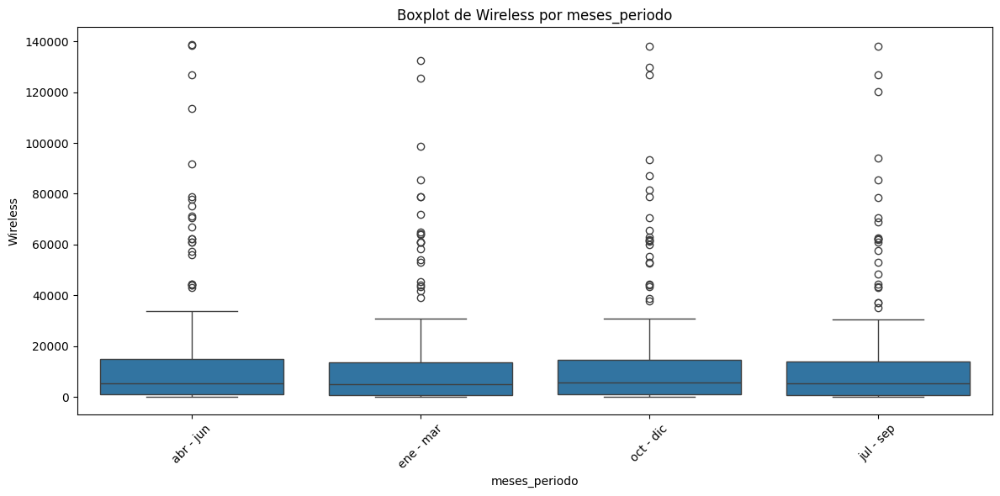


Estadísticas descriptivas de 'Otros' agrupadas por 'meses_periodo':
               count         mean           std  min     25%     50%      75%  \
meses_periodo                                                                   
abr - jun      264.0  6565.659091  11428.069498  8.0  319.75  1875.0  7564.25   
ene - mar      263.0  6090.585551  10616.574909  8.0  326.50  1580.0  6965.00   
jul - sep      240.0  6698.037500  11410.367630  2.0  361.25  2197.5  7726.00   
oct - dic      240.0  6665.975000  11577.588244  8.0  374.75  1937.5  7677.25   

                   max  
meses_periodo           
abr - jun      71028.0  
ene - mar      71770.0  
jul - sep      70416.0  
oct - dic      73415.0  


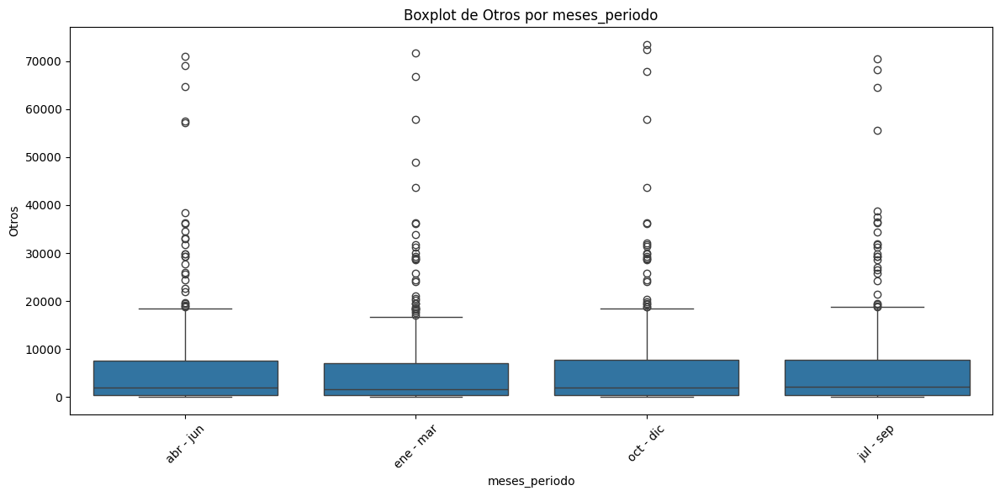


Estadísticas descriptivas de 'Total' agrupadas por 'meses_periodo':
               count           mean            std      min       25%  \
meses_periodo                                                           
abr - jun      264.0  369590.348485  796890.910394  13055.0  63198.75   
ene - mar      263.0  345815.319392  734377.815111  12557.0  61895.50   
jul - sep      240.0  366307.195833  787374.902986  13046.0  62443.00   
oct - dic      240.0  369954.954167  795528.233029  13147.0  62299.00   

                    50%        75%        max  
meses_periodo                                  
abr - jun      114702.0  200226.75  4989380.0  
ene - mar      110552.0  189129.50  4820928.0  
jul - sep      113971.5  193326.50  4968237.0  
oct - dic      114039.5  194938.25  5011620.0  


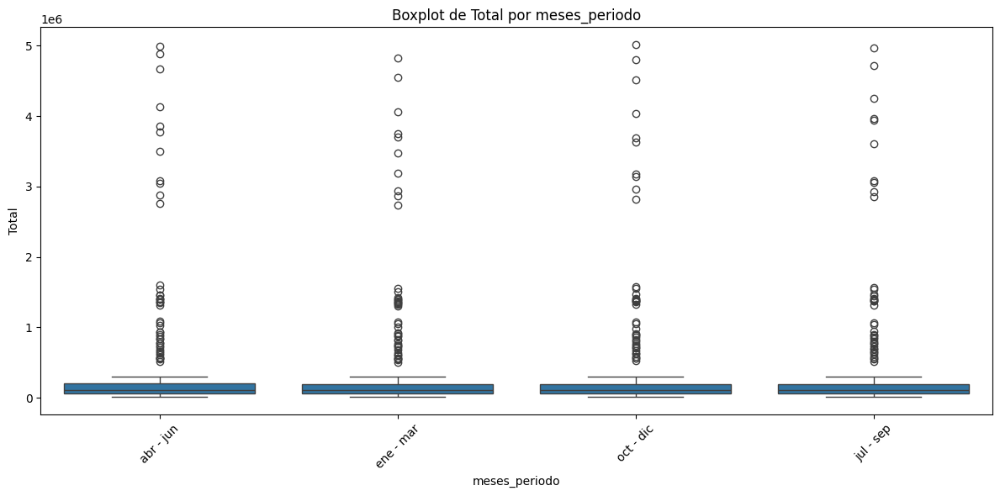

In [36]:
# Definir columnas numéricas
numerical_columns = df.select_dtypes(include=[np.number]).columns

# Análisis entre columnas numéricas y no numéricas
for cat_col in categorical_columns:
    for num_col in numerical_columns:
        # Calcular estadísticas descriptivas
        stats = df.groupby(cat_col)[num_col].describe()
        print(f"\nEstadísticas descriptivas de '{num_col}' agrupadas por '{cat_col}':")
        print(stats)

        # Visualización: Boxplot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f"Boxplot de {num_col} por {cat_col}")
        plt.xlabel(cat_col)
        plt.ylabel(num_col)
        plt.xticks(rotation=45)
        plt.tight_layout()  # Ajustar el layout para evitar solapamientos
        plt.show()

In [37]:
#  6: Cálculo de Z-scores

from scipy.stats import zscore

# Calcular Z-scores para columnas numéricas
z_scores = df.select_dtypes(include=[np.number]).apply(zscore)
print("\nZ-scores de las columnas numéricas:")
print(z_scores)


Z-scores de las columnas numéricas:
           Año  Trimestre      ADSL  Cablemodem  Fibra óptica  Wireless  \
0     1.727639  -0.406420  0.428175    5.698514     10.245183  6.033571   
1     1.727639  -0.406420 -0.249090    2.159391      1.034491 -0.385149   
2     1.727639  -0.406420 -0.457203   -0.385512      0.055740 -0.533911   
3     1.727639  -0.406420 -0.438162   -0.278662      0.115979 -0.197867   
4     1.727639  -0.406420 -0.368269   -0.227586     -0.125388  0.888834   
...        ...        ...       ...         ...           ...       ...   
1002 -1.567309  -1.301968 -0.398027   -0.408400     -0.274067 -0.404336   
1003 -1.567309  -1.301968  0.888033   -0.017637     -0.258832 -0.315384   
1004 -1.567309  -1.301968 -0.340273   -0.400553     -0.276126 -0.556353   
1005 -1.567309  -1.301968 -0.386632   -0.402260     -0.272548 -0.600087   
1006 -1.567309  -1.301968  0.071075   -0.408438     -0.275546 -0.599513   

         Otros     Total  
0     5.184845  5.955116  
1     2.

In [38]:
# Conteo de categorías en columnas de tipo object
for col in df.select_dtypes(include=['object']).columns:
    print(f"\nConteo de categorías en la columna '{col}':")
    print(df[col].value_counts())


Conteo de categorías en la columna 'Provincia':
Provincia
BUENOS AIRES           83
CATAMARCA              42
CHACO                  42
CHUBUT                 42
CÓRDOBA                42
CORRIENTES             42
ENTRE RÍOS             42
FORMOSA                42
JUJUY                  42
LA PAMPA               42
LA RIOJA               42
MENDOZA                42
MISIONES               42
NEUQUÉN                42
RÍO NEGRO              42
SALTA                  42
SAN JUAN               42
SAN LUIS               42
SANTA CRUZ             42
SANTA FE               42
SANTIAGO DEL ESTERO    42
TIERRA DEL FUEGO       42
TUCUMÁN                42
Name: count, dtype: int64

Conteo de categorías en la columna 'Año_Trimestre':
Año_Trimestre
Q2-2024    24
Q4-2023    24
Q4-2022    24
Q3-2023    24
Q2-2023    24
Q1-2023    24
Q2-2022    24
Q3-2022    24
Q1-2022    24
Q4-2021    24
Q4-2017    24
Q3-2021    24
Q2-2021    24
Q1-2021    24
Q4-2020    24
Q3-2020    24
Q2-2020    24
Q1-2020    2

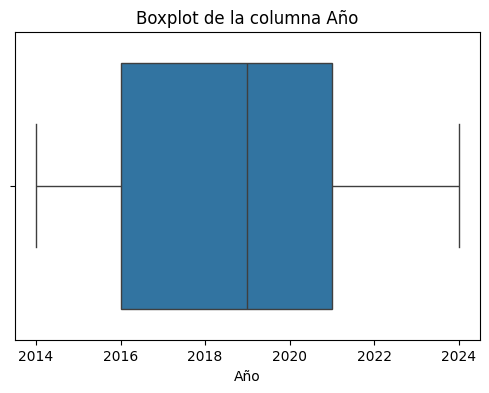

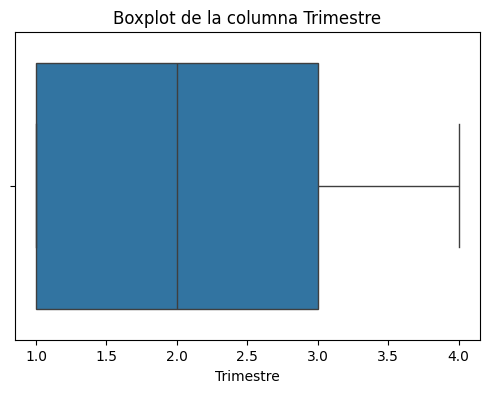

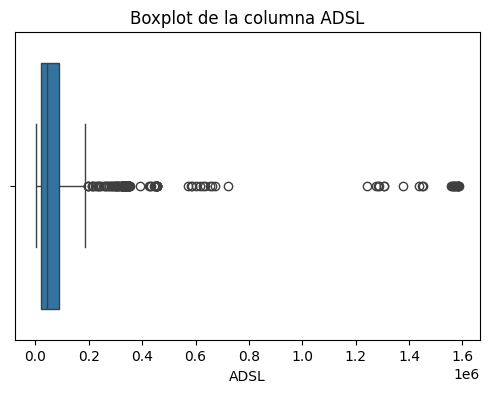

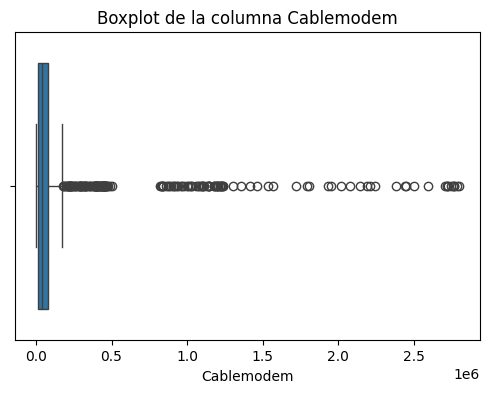

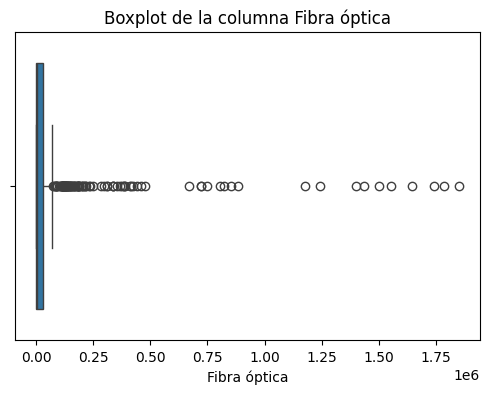

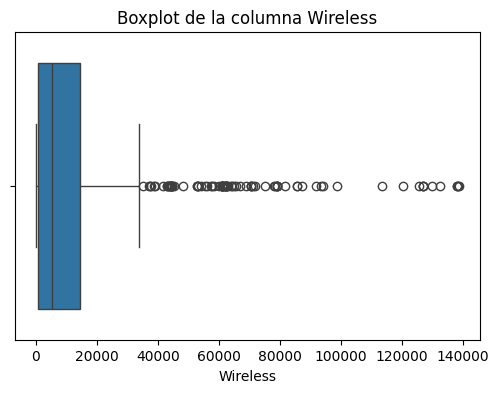

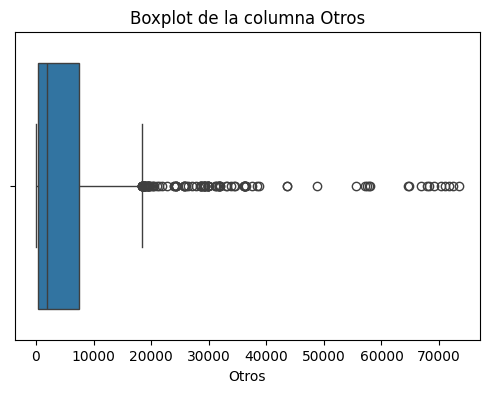

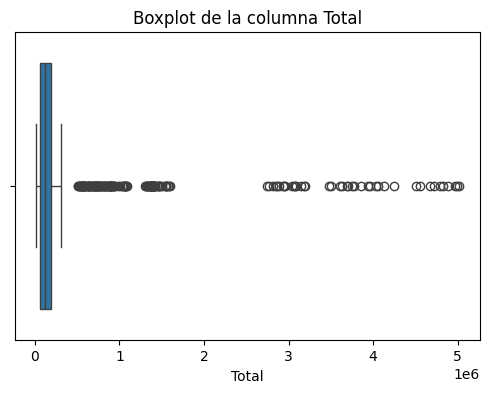

In [39]:
# Visualizar valores atípicos con un gráfico de caja
for columna in df.select_dtypes(include=[np.number]).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[columna])
    plt.title(f"Boxplot de la columna {columna}")
    plt.show()

In [40]:
# Definir la ruta completa donde deseas guardar el archivo CSV
ruta_completa = r"C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos Por Tecnología.csv"

# Guardar los cambios en el mismo archivo CSV
df.to_csv(ruta_completa, index=False)
print(f"\nArchivo guardado: {ruta_completa}")


Archivo guardado: C:\Users\USUARIO\OneDrive - Secretaria de Educacion del Distrito\Escritorio\SOYhENRY\proyecto individual 2\data_limpio\Accesos Por Tecnología.csv


In [41]:
## Guardar los cambios en el mismo archivo CSV
#df.to_csv(ruta_completa, index=False)
#print(f"\nArchivo guardado: {ruta_completa}")

In [42]:
# 16: Análisis de distribuciones (skewness y kurtosis)

# Seleccionar solo las columnas numéricas
numeric_df = df.select_dtypes(include=[np.number])

print("\nSkewness (Asimetría) de las columnas numéricas:")
print(numeric_df.skew())

print("\nKurtosis (Curtosis) de las columnas numéricas:")
print(numeric_df.kurtosis())


Skewness (Asimetría) de las columnas numéricas:
Año             0.023464
Trimestre       0.066726
ADSL            4.661572
Cablemodem      3.869341
Fibra óptica    7.075133
Wireless        3.262511
Otros           3.106073
Total           3.883395
dtype: float64

Kurtosis (Curtosis) de las columnas numéricas:
Año             -1.189360
Trimestre       -1.353366
ADSL            23.906101
Cablemodem      16.019831
Fibra óptica    56.751358
Wireless        12.686098
Otros           11.805812
Total           15.918066
dtype: float64


In [43]:
# 17: Verificar la existencia de multicolinealidad entre variables numéricas
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calcular VIF para variables numéricas
X = df.select_dtypes(include=[np.number])
X = add_constant(X)
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print("\nVIF (Factor de Inflación de la Varianza):")
print(vif)



VIF (Factor de Inflación de la Varianza):
       Variable           VIF
0         const  5.917075e+05
1           Año  1.337240e+00
2     Trimestre  1.009106e+00
3          ADSL           inf
4    Cablemodem           inf
5  Fibra óptica           inf
6      Wireless           inf
7         Otros           inf
8         Total           inf


c:\Program Files\Python313\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


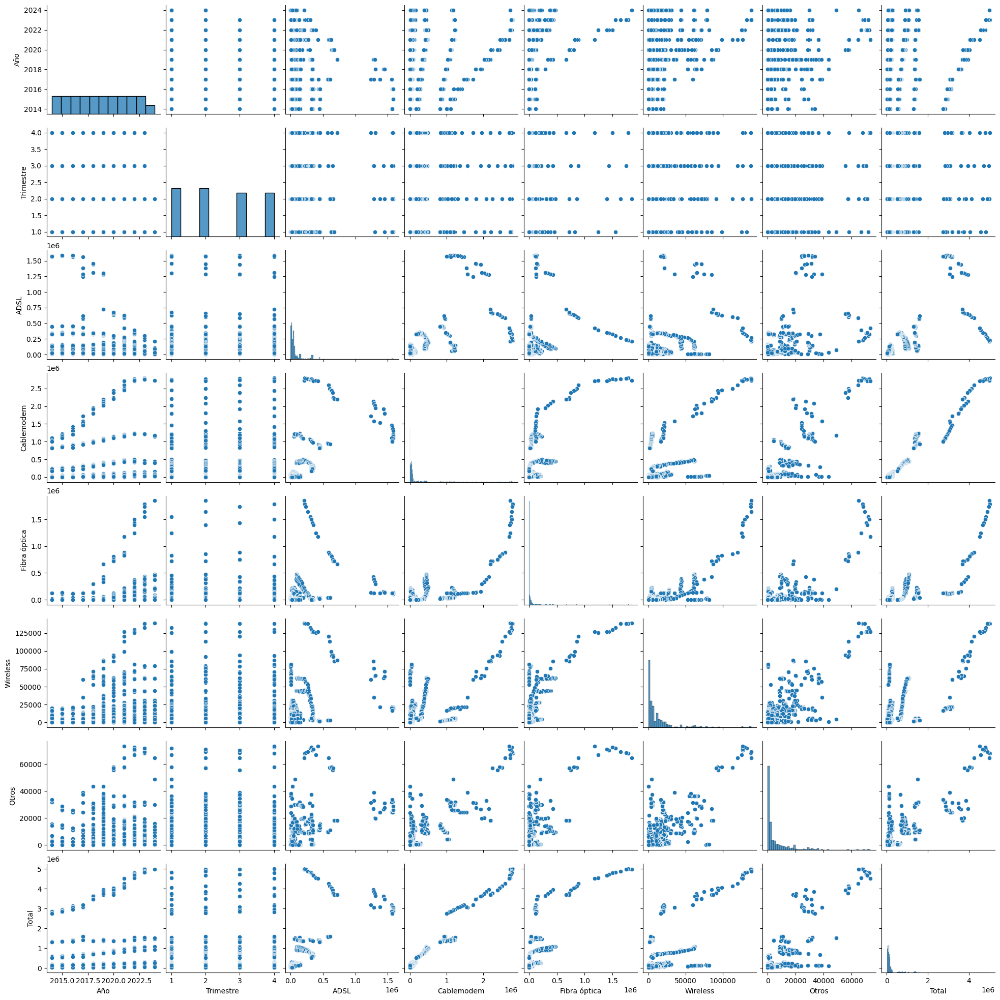

In [44]:
# 18: Visualizar la relación entre variables
sns.pairplot(df.select_dtypes(include=[np.number]))
plt.show()

In [45]:
# 19: Agrupamiento por categorías
for columna in df.select_dtypes(include=['object']).columns:
    print(f"\nEstadísticas por grupo de '{columna}':")
    print(df.groupby(columna).describe())


Estadísticas por grupo de 'Provincia':
                      Año                                                 \
                    count         mean       std     min     25%     50%   
Provincia                                                                  
BUENOS AIRES         83.0  2018.698795  3.019186  2014.0  2016.0  2019.0   
CATAMARCA            42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHACO                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CHUBUT               42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CORRIENTES           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
CÓRDOBA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
ENTRE RÍOS           42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
FORMOSA              42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
JUJUY                42.0  2018.761905  3.074756  2014.0  2016.0  2019.0   
LA PAMPA             42.0  2018.761905  3.074756